In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

Matplotlib is building the font cache; this may take a moment.


In [2]:
#Variables
FILE_PATH = '/Users/ailicic/Downloads/datasets_competencia_2023.csv.gz'
REMOTE_PATH = 'buckets/b1/datasets/competencia_2023.csv.gz'

In [3]:
df = pd.read_csv(REMOTE_PATH)
df

/tmp/ipykernel_2987/3097254967.py:1: DtypeWarning: Columns (154) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(REMOTE_PATH)


,numero_de_cliente,foto_mes,active_quarter,cliente_vip,internet,cliente_edad,cliente_antiguedad,mrentabilidad,mrentabilidad_annual,mcomisiones,...,Visa_fultimo_cierre,Visa_mpagado,Visa_mpagospesos,Visa_mpagosdolares,Visa_fechaalta,Visa_mconsumototal,Visa_cconsumos,Visa_cadelantosefectivo,Visa_mpagominimo,clase_ternaria
0,31116053,201901,1,0,1,48,171,8304.31,42993.54,2501.04,...,8.0,0.00,-35773.32,2.33,5148.0,36602.13,54.0,0.0,5008.71,CONTINUA
1,31116803,201901,1,0,1,57,296,18318.76,42597.26,14986.76,...,1.0,0.00,-67414.82,1149.57,3299.0,28503.06,10.0,0.0,1395.87,CONTINUA
2,31117908,201901,1,0,1,77,296,20862.84,85481.31,4228.40,...,1.0,0.00,0.00,0.00,6790.0,5170.25,2.0,0.0,0.00,CONTINUA
3,31117977,201901,1,0,1,58,231,25218.94,165317.78,4474.25,...,22.0,69653.59,-59422.00,0.00,7037.0,67991.90,31.0,0.0,2897.31,CONTINUA
4,31120119,201901,1,0,1,69,349,5307.54,32374.08,4706.22,...,8.0,0.00,-4802.21,0.00,7596.0,4851.93,3.0,0.0,492.66,CONTINUA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4893023,214798593,202109,1,0,0,31,1,53.80,53.80,0.00,...,1.0,0.00,0.00,0.00,23.0,807.91,2.0,0.0,35.19,NaN
4893024,214799441,202109,0,0,0,31,1,0.00,0.00,0.00,...,1.0,0.00,NaN,NaN,11.0,NaN,NaN,NaN,0.00,NaN
4893025,214802679,202109,0,0,0,51,1,0.53,0.53,0.00,...,1.0,0.00,NaN,NaN,7.0,NaN,NaN,NaN,0.00,NaN
4893026,214810851,202109,0,0,0,31,1,0.00,0.00,0.00,...,1.0,0.00,NaN,NaN,8.0,NaN,NaN,NaN,0.00,NaN


In [4]:
#drop rows where clase_ternaria is BAJA+1
df = df[df['clase_ternaria'] != 'BAJA+1']

In [5]:
#df is df minus 202108 and 202109
df_test = df[(df['foto_mes'] == 202108) | (df['foto_mes'] == 202109)]
df = df.loc[~(df['foto_mes'].isin([202108, 202109,202002,202003,202004,202005]))]

In [6]:
#yyyymm to date
df['foto_mes_date'] = pd.to_datetime(df['foto_mes'], format='%Y%m')
df

,numero_de_cliente,foto_mes,active_quarter,cliente_vip,internet,cliente_edad,cliente_antiguedad,mrentabilidad,mrentabilidad_annual,mcomisiones,...,Visa_mpagado,Visa_mpagospesos,Visa_mpagosdolares,Visa_fechaalta,Visa_mconsumototal,Visa_cconsumos,Visa_cadelantosefectivo,Visa_mpagominimo,clase_ternaria,foto_mes_date
0,31116053,201901,1,0,1,48,171,8304.31,42993.54,2501.04,...,0.00,-35773.32,2.33,5148.0,36602.13,54.0,0.0,5008.71,CONTINUA,2019-01-01
1,31116803,201901,1,0,1,57,296,18318.76,42597.26,14986.76,...,0.00,-67414.82,1149.57,3299.0,28503.06,10.0,0.0,1395.87,CONTINUA,2019-01-01
2,31117908,201901,1,0,1,77,296,20862.84,85481.31,4228.40,...,0.00,0.00,0.00,6790.0,5170.25,2.0,0.0,0.00,CONTINUA,2019-01-01
3,31117977,201901,1,0,1,58,231,25218.94,165317.78,4474.25,...,69653.59,-59422.00,0.00,7037.0,67991.90,31.0,0.0,2897.31,CONTINUA,2019-01-01
4,31120119,201901,1,0,1,69,349,5307.54,32374.08,4706.22,...,0.00,-4802.21,0.00,7596.0,4851.93,3.0,0.0,492.66,CONTINUA,2019-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4562805,214033382,202107,1,0,0,33,1,307.11,307.11,353.00,...,0.00,0.00,0.00,19.0,0.00,0.0,0.0,668.61,CONTINUA,2021-07-01
4562806,214034971,202107,0,0,0,32,1,161.22,161.22,0.00,...,0.00,NaN,NaN,11.0,NaN,NaN,NaN,0.00,CONTINUA,2021-07-01
4562807,214037429,202107,0,0,0,42,1,0.00,0.00,0.00,...,0.00,NaN,NaN,16.0,NaN,NaN,NaN,0.00,CONTINUA,2021-07-01
4562808,214042186,202107,0,0,0,24,1,0.01,0.01,0.00,...,0.00,NaN,NaN,3.0,NaN,NaN,NaN,0.00,CONTINUA,2021-07-01


In [7]:
#for i in df.columns: if values between 0 and 20 then print it
categorical_columns = []
for i in df.columns:
    if df[i].dtype == 'int64' or df[i].dtype == 'float64':
        if df[i].max() < 25:
            print(i, df[i].unique())
            categorical_columns.append(i)


active_quarter [1 0]
cliente_vip [0 1]
internet [1 0 2 3 4]
cproductos [ 9 11 10  5  7  8  6  4 12 14 17 13 18 16 15  3]
tcuentas [1 2]
ccuenta_corriente [1 2 5 3]
ccaja_ahorro [ 2  3  6  4  5 12  8  7 10  9]
cdescubierto_preacordado [1 0]
ctarjeta_visa [1 0 2 3]
ctarjeta_master [1 0 2 3]
cinversion1 [ 0  1  5  2  7  3  6  4 10 13  9  8 12 16 11 14 15 19 17 21 24 18]
cseguro_vida [0 2 1 3 4 5 6 7]
cseguro_auto [ 0  1  2  3  4  6  5  8  9 10]
cseguro_vivienda [0 1 2 3 5 6 7 4 8]
cseguro_accidentes_personales [0 1 2 3]
ccaja_seguridad [0 2 1 3 8 4 7 6 5]
cpayroll2_trx [ 0  1  4  2  3  5  8  6  7  9 10 15]
tcallcenter [0 1]
thomebanking [1 0]
ccajas_transacciones [0 1]
tmobile_app [nan  0.  1.]
Master_delinquency [ 0. nan  1.]
Master_status [ 0. nan  9.  7.  6.]
Visa_delinquency [ 0. nan  1.]
Visa_status [ 0. nan  9.  7.  6.]


In [8]:
numerical_columns = []
for i in df.columns:
    if df[i].dtype == 'int64' or df[i].dtype == 'float64':
        if i not in categorical_columns:
            numerical_columns.append(i)
numerical_columns
#append baja_2
numerical_columns.append('baja_2')

In [9]:
categorical_columns

['active_quarter',
 'cliente_vip',
 'internet',
 'cproductos',
 'tcuentas',
 'ccuenta_corriente',
 'ccaja_ahorro',
 'cdescubierto_preacordado',
 'ctarjeta_visa',
 'ctarjeta_master',
 'cinversion1',
 'cseguro_vida',
 'cseguro_auto',
 'cseguro_vivienda',
 'cseguro_accidentes_personales',
 'ccaja_seguridad',
 'cpayroll2_trx',
 'tcallcenter',
 'thomebanking',
 'ccajas_transacciones',
 'tmobile_app',
 'Master_delinquency',
 'Master_status',
 'Visa_delinquency',
 'Visa_status']

In [10]:
#plot time series for each  value of clase_ternaria, use a count aggregation
df['baja_2'] = df['clase_ternaria'].apply(lambda x: 1 if x == 'BAJA+2' else 0)



<AxesSubplot:xlabel='foto_mes_date'>

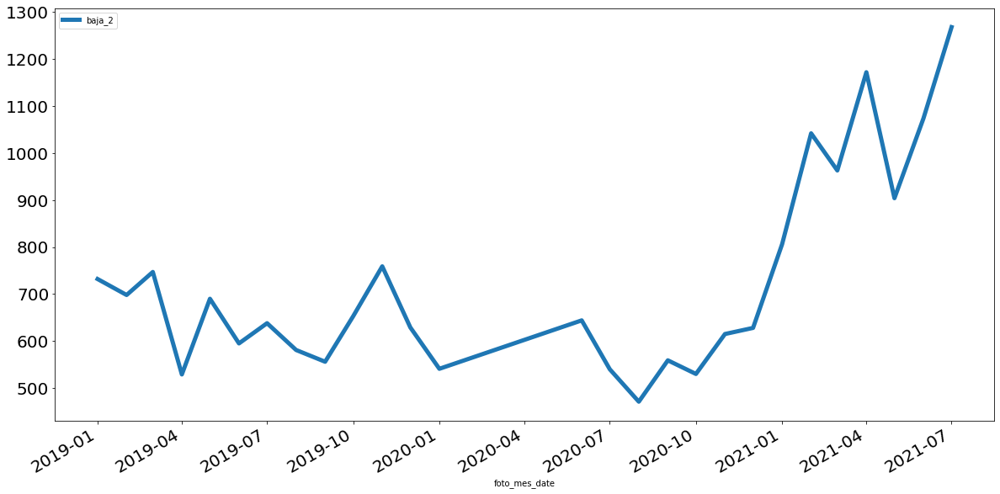

In [11]:
#plot
df.groupby('foto_mes_date').agg({'baja_2': 'sum'}).plot(figsize=(20,10), linewidth=5, fontsize=20)

In [12]:
#turn off scientific notation
pd.set_option('display.float_format', lambda x: '%.3f' % x)

In [13]:
#Create a dataframe 'df_bajas' that contains the numero_de_cliente where baja_2 is 1
df_bajas = df.merge(df[df['baja_2'] == 1][['numero_de_cliente']], on='numero_de_cliente', how='inner')
#create a df_continua that doesnt contains the numero_de_cliente in df_bajas
df_continua = df[~df['numero_de_cliente'].isin(df_bajas['numero_de_cliente'])]
df_continua


,numero_de_cliente,foto_mes,active_quarter,cliente_vip,internet,cliente_edad,cliente_antiguedad,mrentabilidad,mrentabilidad_annual,mcomisiones,...,Visa_mpagospesos,Visa_mpagosdolares,Visa_fechaalta,Visa_mconsumototal,Visa_cconsumos,Visa_cadelantosefectivo,Visa_mpagominimo,clase_ternaria,foto_mes_date,baja_2
0,31116053,201901,1,0,1,48,171,8304.310,42993.540,2501.040,...,-35773.320,2.330,5148.000,36602.130,54.000,0.000,5008.710,CONTINUA,2019-01-01,0
1,31116803,201901,1,0,1,57,296,18318.760,42597.260,14986.760,...,-67414.820,1149.570,3299.000,28503.060,10.000,0.000,1395.870,CONTINUA,2019-01-01,0
2,31117908,201901,1,0,1,77,296,20862.840,85481.310,4228.400,...,0.000,0.000,6790.000,5170.250,2.000,0.000,0.000,CONTINUA,2019-01-01,0
3,31117977,201901,1,0,1,58,231,25218.940,165317.780,4474.250,...,-59422.000,0.000,7037.000,67991.900,31.000,0.000,2897.310,CONTINUA,2019-01-01,0
4,31120119,201901,1,0,1,69,349,5307.540,32374.080,4706.220,...,-4802.210,0.000,7596.000,4851.930,3.000,0.000,492.660,CONTINUA,2019-01-01,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4562805,214033382,202107,1,0,0,33,1,307.110,307.110,353.000,...,0.000,0.000,19.000,0.000,0.000,0.000,668.610,CONTINUA,2021-07-01,0
4562806,214034971,202107,0,0,0,32,1,161.220,161.220,0.000,...,NaN,NaN,11.000,NaN,NaN,NaN,0.000,CONTINUA,2021-07-01,0
4562807,214037429,202107,0,0,0,42,1,0.000,0.000,0.000,...,NaN,NaN,16.000,NaN,NaN,NaN,0.000,CONTINUA,2021-07-01,0
4562808,214042186,202107,0,0,0,24,1,0.010,0.010,0.000,...,NaN,NaN,3.000,NaN,NaN,NaN,0.000,CONTINUA,2021-07-01,0


In [27]:
# #order by foto_mes descending
df = df.sort_values(by=['foto_mes_date'], ascending=False)
# #remove the last 2 rows for each numero_de_cliente where baja_2 is 0
clientes = df['numero_de_cliente'].unique().shape[0]
iter = 0
df_bajas_2 = pd.DataFrame()
for i in df['numero_de_cliente'].unique():
    print(iter, clientes)
    df_bajas_2 = pd.concat([df_bajas_2, df.loc[(df['numero_de_cliente'] == i) & (df['baja_2'] == 0)].iloc[:-2]])
    df_bajas_2 = pd.concat([df_bajas_2, df.loc[(df['numero_de_cliente'] == i) & (df['baja_2'] == 1)]])
    iter += 1


0 19537
1 19537
2 19537
3 19537
4 19537
5 19537
6 19537
7 19537
8 19537
9 19537
10 19537
11 19537
12 19537
13 19537
14 19537
15 19537
16 19537
17 19537
18 19537
19 19537
20 19537
21 19537
22 19537
23 19537
24 19537
25 19537
26 19537
27 19537
28 19537
29 19537
30 19537
31 19537
32 19537
33 19537
34 19537
35 19537
36 19537
37 19537
38 19537
39 19537
40 19537
41 19537
42 19537
43 19537
44 19537
45 19537
46 19537
47 19537
48 19537
49 19537
50 19537
51 19537
52 19537
53 19537
54 19537
55 19537
56 19537
57 19537
58 19537
59 19537
60 19537
61 19537
62 19537
63 19537
64 19537
65 19537
66 19537
67 19537
68 19537
69 19537
70 19537
71 19537
72 19537
73 19537
74 19537
75 19537
76 19537
77 19537
78 19537
79 19537
80 19537
81 19537
82 19537
83 19537
84 19537
85 19537
86 19537
87 19537
88 19537
89 19537
90 19537
91 19537
92 19537
93 19537
94 19537
95 19537
96 19537
97 19537
98 19537
99 19537
100 19537
101 19537
102 19537
103 19537
104 19537
105 19537
106 19537
107 19537
108 19537
109 19537
110 19537


IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



18106 19537
18107 19537
18108 19537
18109 19537
18110 19537
18111 19537
18112 19537
18113 19537
18114 19537
18115 19537
18116 19537
18117 19537
18118 19537
18119 19537
18120 19537
18121 19537
18122 19537
18123 19537
18124 19537
18125 19537
18126 19537
18127 19537
18128 19537
18129 19537
18130 19537
18131 19537
18132 19537
18133 19537
18134 19537
18135 19537
18136 19537
18137 19537
18138 19537
18139 19537
18140 19537
18141 19537
18142 19537
18143 19537
18144 19537
18145 19537
18146 19537
18147 19537
18148 19537
18149 19537
18150 19537
18151 19537
18152 19537
18153 19537
18154 19537
18155 19537
18156 19537
18157 19537
18158 19537
18159 19537
18160 19537
18161 19537
18162 19537
18163 19537
18164 19537
18165 19537
18166 19537
18167 19537
18168 19537
18169 19537
18170 19537
18171 19537
18172 19537
18173 19537
18174 19537
18175 19537
18176 19537
18177 19537
18178 19537
18179 19537
18180 19537
18181 19537
18182 19537
18183 19537
18184 19537
18185 19537
18186 19537
18187 19537
18188 19537
1818

In [28]:
df

,numero_de_cliente,foto_mes,active_quarter,cliente_vip,internet,cliente_edad,cliente_antiguedad,mrentabilidad,mrentabilidad_annual,mcomisiones,...,Visa_mpagospesos,Visa_mpagosdolares,Visa_fechaalta,Visa_mconsumototal,Visa_cconsumos,Visa_cadelantosefectivo,Visa_mpagominimo,clase_ternaria,foto_mes_date,baja_2
263840,213237379,202107,1,0,0,24,3,1085.780,2244.410,420.150,...,0.000,0.000,19.000,0.000,0.000,0.000,434.010,BAJA+2,2021-07-01,1
126326,109720057,202107,1,0,0,36,154,1177.660,-2955.920,2022.810,...,-7960.220,0.000,4132.000,1117.570,2.000,0.000,3284.400,BAJA+2,2021-07-01,1
255246,133844142,202107,1,0,0,27,14,1643.450,3740.050,1914.730,...,-86762.290,0.000,409.000,344.860,3.000,0.000,316.710,BAJA+2,2021-07-01,1
123666,108116769,202107,0,0,0,32,113,1980.050,5094.860,1910.640,...,NaN,NaN,3065.000,NaN,NaN,NaN,0.000,BAJA+2,2021-07-01,1
177918,145107147,202107,1,0,0,43,81,590.300,7370.470,1.060,...,-13827.190,0.000,2466.000,0.000,0.000,0.000,1384.140,BAJA+2,2021-07-01,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113,31194003,201901,0,0,0,55,20,1.030,14.920,0.000,...,NaN,NaN,596.000,NaN,NaN,NaN,0.000,CONTINUA,2019-01-01,0
110,31176988,201901,1,0,1,69,349,1599.800,51037.530,1561.770,...,-3516.600,0.000,7087.000,2230.640,3.000,0.000,164.220,CONTINUA,2019-01-01,0
101,31176129,201901,1,0,1,69,175,696.220,11146.840,242.470,...,-13958.710,0.000,5299.000,8847.080,7.000,0.000,527.850,CONTINUA,2019-01-01,0
92,31164019,201901,1,0,1,47,293,10647.940,16747.940,9717.060,...,-10434.520,278.990,6451.000,3507.900,6.000,0.000,469.200,CONTINUA,2019-01-01,0


In [29]:
df.describe()

,numero_de_cliente,foto_mes,active_quarter,cliente_vip,internet,cliente_edad,cliente_antiguedad,mrentabilidad,mrentabilidad_annual,mcomisiones,...,Visa_mpagado,Visa_mpagospesos,Visa_mpagosdolares,Visa_fechaalta,Visa_mconsumototal,Visa_cconsumos,Visa_cadelantosefectivo,Visa_mpagominimo,foto_mes_date,baja_2
count,263841.000,263841.000,263841.000,263841.000,263841.000,263841.000,263841.000,263841.000,263841.000,263841.000,...,229183.000,168004.000,168004.000,229183.000,168004.000,168004.000,168004.000,229183.000,263841,263841.000
mean,105409103.597,201959.144,0.876,0.003,0.590,47.403,104.550,1588.975,16605.855,710.659,...,2038.726,-15329.606,15.633,2496.215,10726.981,6.375,0.037,4629.675,2019-12-18 12:43:35.993723648,0.076
min,31128656.000,201901.000,0.000,0.000,0.000,0.000,1.000,-190816.590,-304103.180,-11703.050,...,0.000,-1250986.300,0.000,1.000,-93516.270,0.000,0.000,0.000,2019-01-01 00:00:00,0.000
25%,73234825.000,201905.000,1.000,0.000,0.000,36.000,38.000,0.000,957.050,0.000,...,0.000,-18204.390,0.000,825.000,401.213,1.000,0.000,0.000,2019-05-01 00:00:00,0.000
50%,102771895.000,201910.000,1.000,0.000,1.000,46.000,85.000,752.400,9104.500,255.310,...,0.000,-6995.880,0.000,1890.000,3361.795,4.000,0.000,281.520,2019-10-01 00:00:00,0.000
75%,140042678.000,202009.000,1.000,0.000,1.000,58.000,155.000,1855.560,19756.620,1126.130,...,0.000,-1642.838,0.000,3846.000,11400.237,8.000,0.000,1829.880,2020-09-01 00:00:00,0.000
max,213237379.000,202107.000,1.000,1.000,4.000,96.000,379.000,307416.020,1115398.150,160261.230,...,1244522.910,194943.120,13648.620,11546.000,1438900.560,242.000,27.000,6471100.830,2021-07-01 00:00:00,1.000
std,43557413.901,69.641,0.330,0.051,0.518,13.844,81.285,4930.410,36079.067,1702.397,...,12588.227,28587.644,175.930,2072.325,27256.113,8.658,0.442,31425.310,NaN,0.264


In [30]:
df.iloc[:, :-2].describe().T.sort_values(by='std' , ascending = False).head(20)

,count,mean,std,min,25%,50%,75%,max
numero_de_cliente,263841.000,105409103.597,43557413.901,31128656.000,73234825.000,102771895.000,140042678.000,213237379.000
Master_mfinanciacion_limite,198639.000,276365.960,2099930.861,0.000,63342.000,101347.200,253368.000,157559753.850
Visa_mfinanciacion_limite,229183.000,240223.337,1391796.643,0.000,63342.000,126684.000,253368.000,133955028.180
mcuentas_saldo,263841.000,53806.097,365613.626,-4297501.850,-1724.460,147.300,15791.570,35308140.400
Master_mlimitecompra,198639.000,241133.393,342731.733,985.320,70380.000,112608.000,281520.000,10033372.800
mcaja_ahorro_dolares,263841.000,39302.661,321004.727,-9731.880,0.000,0.000,69.350,31026956.880
Visa_mlimitecompra,229183.000,242176.103,313956.806,674.470,70380.000,140760.000,281520.000,11873106.000
minversion2,263841.000,9166.861,262037.842,0.000,0.000,0.000,0.000,23736021.770
mtransferencias_recibidas,263841.000,22146.495,225800.778,0.000,0.000,0.000,6260.300,43793411.660
mplazo_fijo_dolares,263841.000,25885.745,223818.277,0.000,0.000,0.000,0.000,15225809.590


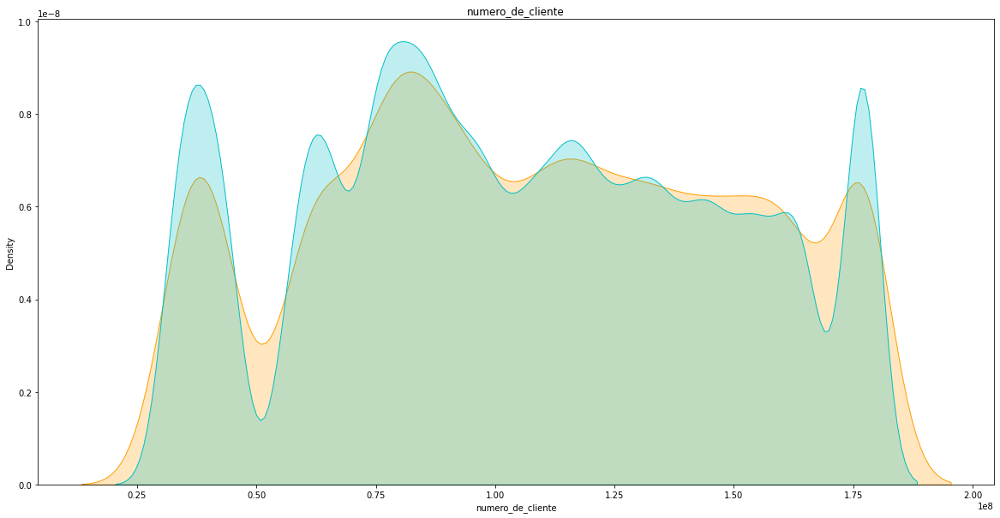

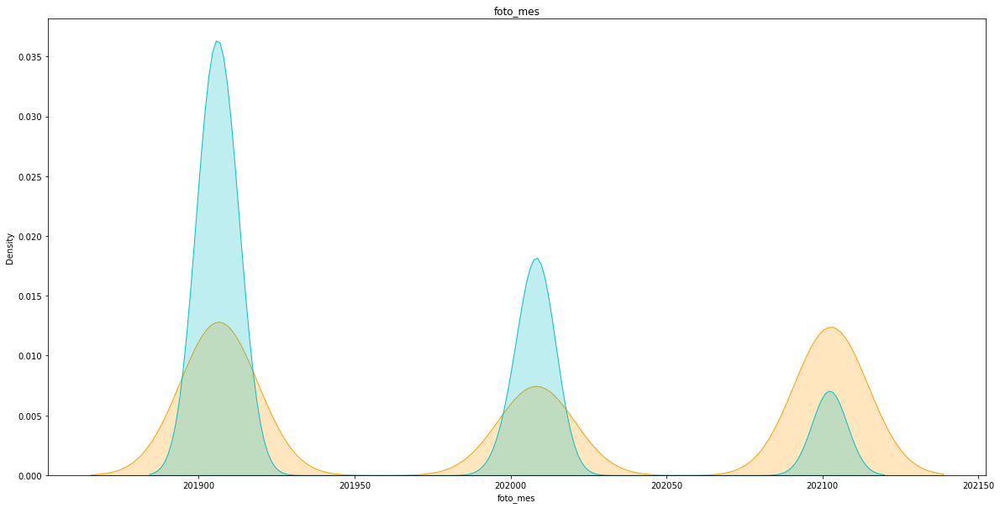

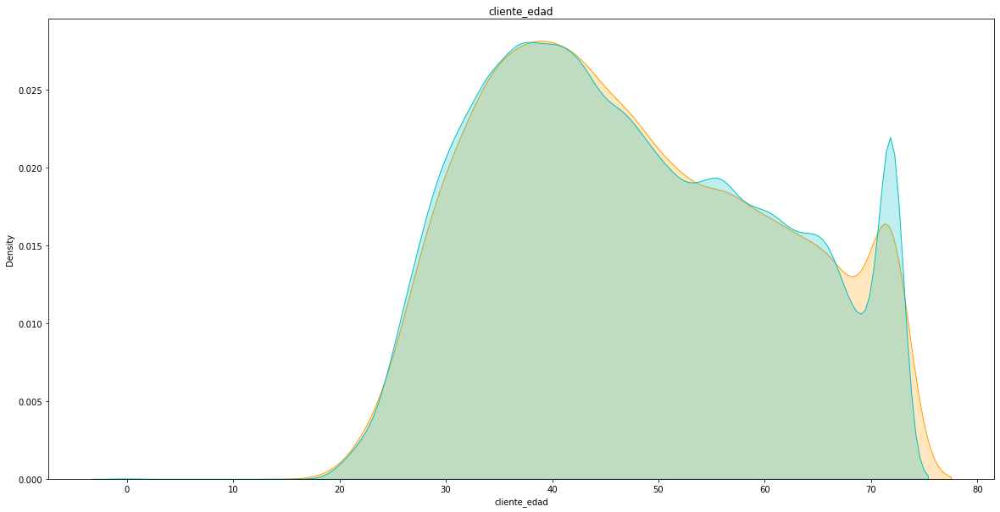

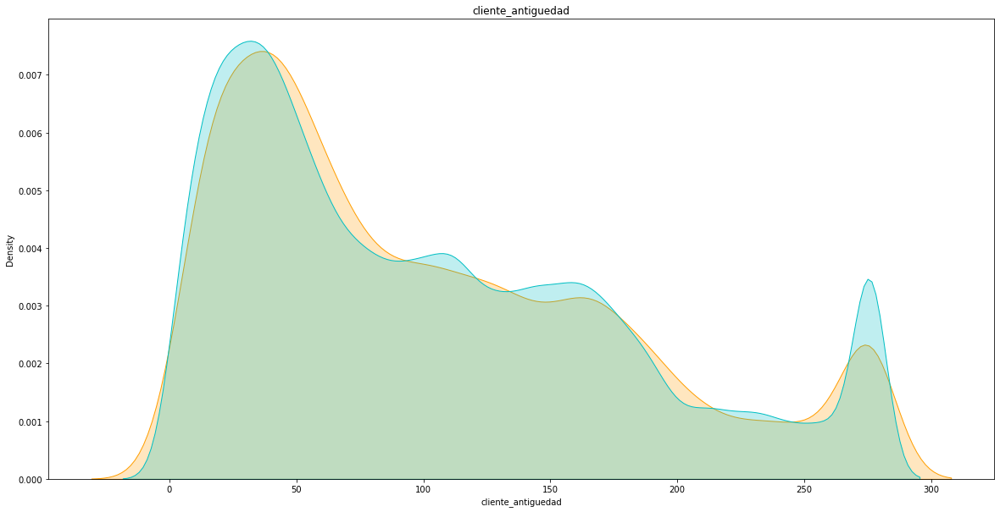

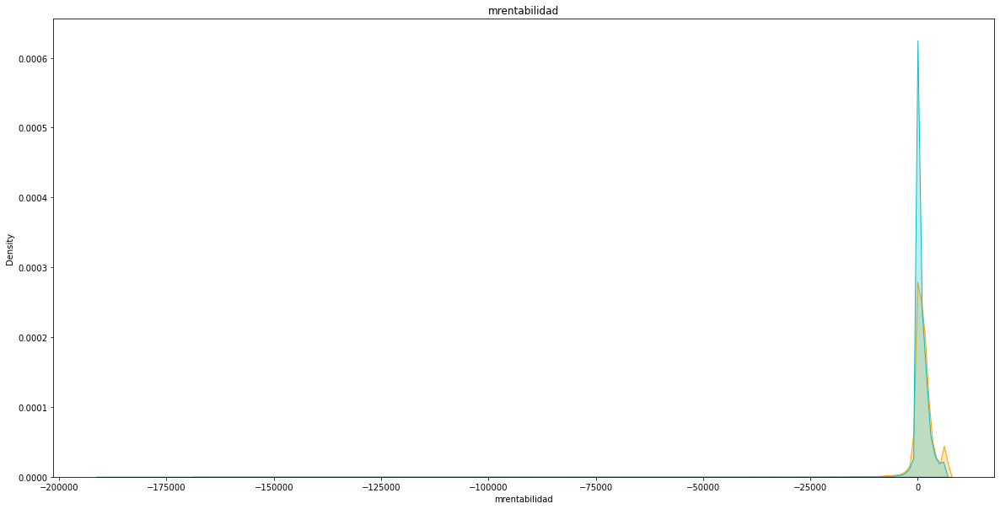

...

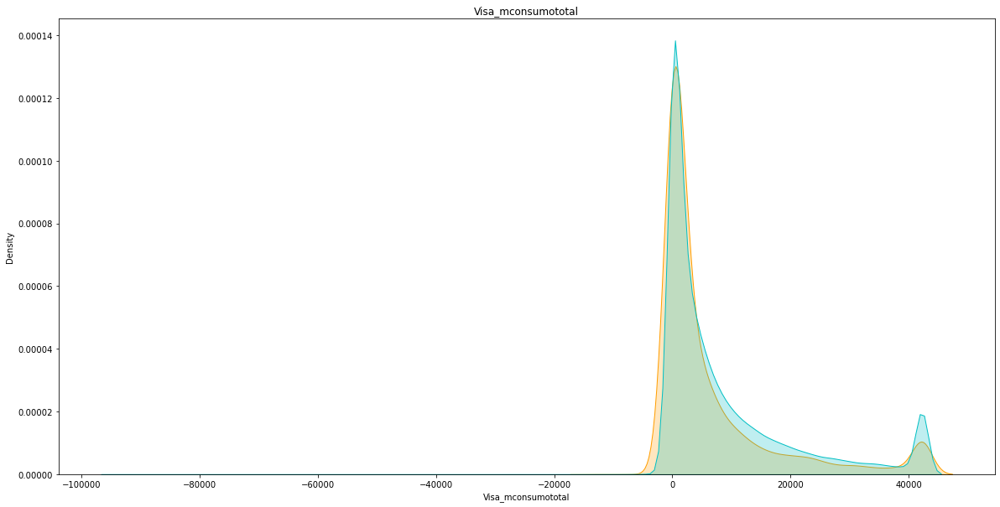

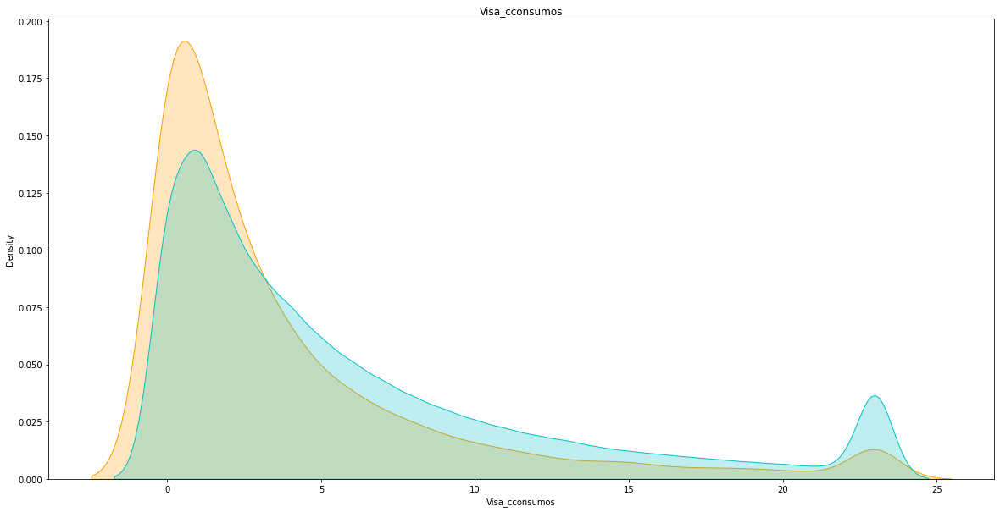

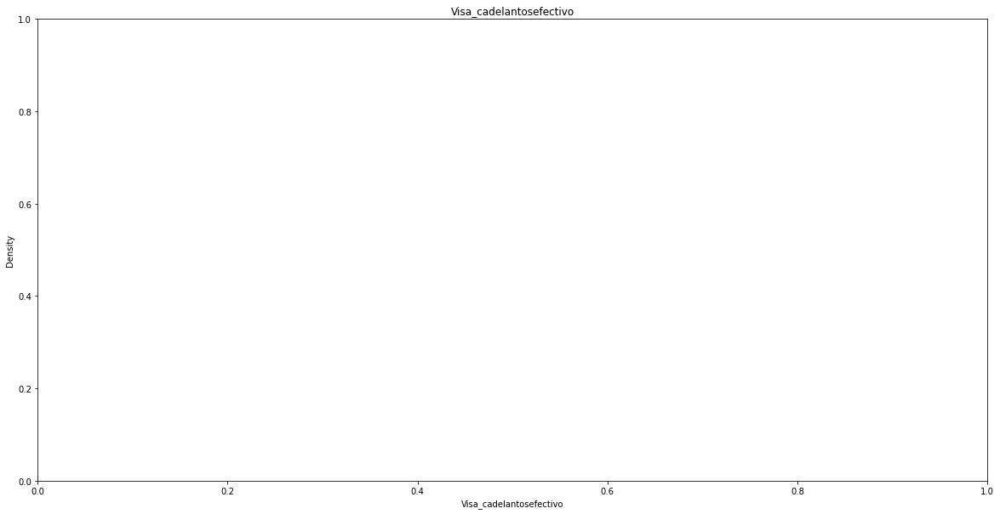

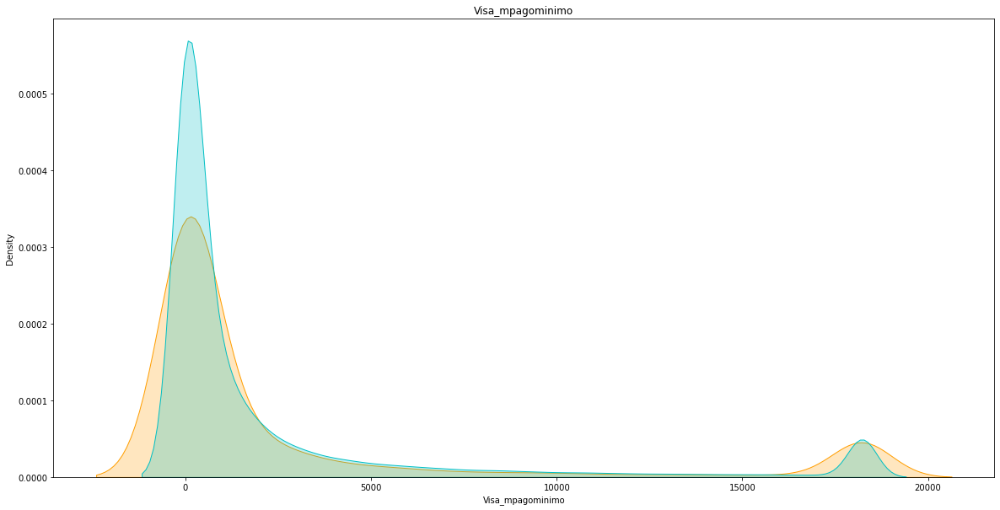

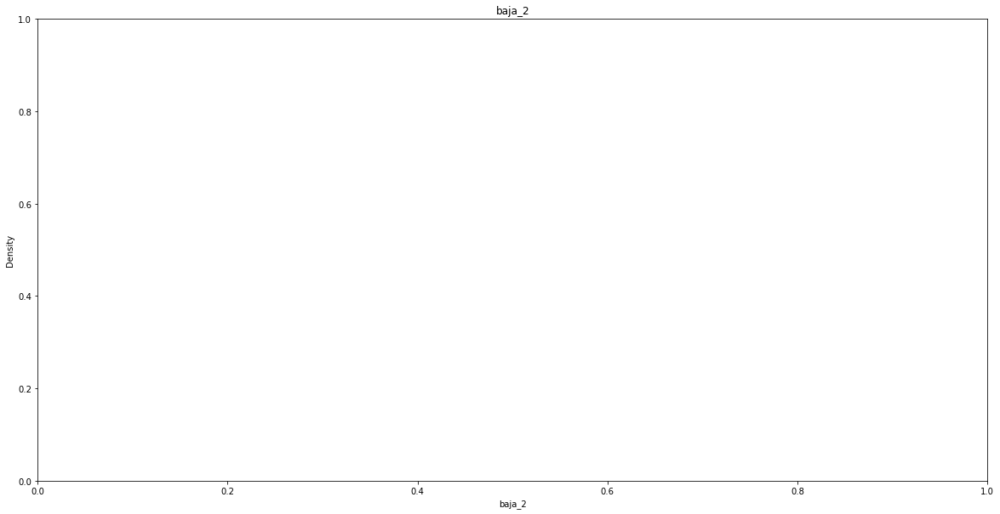

In [31]:
# df_amount = df.groupby('foto_mes').agg({'baja_2': 'sum'}).reset_index()
# #create a dataframe where it con
# df_bajas = df.loc[df['baja_2'] == 1]
# #create a dataframe df_continua where it contains a random sample where the rows baja_2 is 0 and it contains the same amount of rows as df_bajas for each foto_mes
# df_continua = df.loc[df['baja_2'] == 0].groupby('foto_mes').apply(lambda x: x.sample(n=df_bajas['foto_mes'].value_counts().min())).reset_index(drop=True)
# #concatenate df_bajas and df_continua
# df_concat = pd.concat([df_bajas, df_continua], axis=0)
# df_concat
#Use pyplot to plot the kde of the numerical columns, hue is baja_2, show them in the same plot
import seaborn as sns
import matplotlib.pyplot as plt
#warnings off
import warnings
warnings.filterwarnings("ignore")
for i in numerical_columns:
        plt.figure(figsize=(20, 10))
        #keep 97.5 percentile
        sns.kdeplot(x=df.loc[df['baja_2'] == 1, i].clip(upper=df[i].quantile(0.95)), color='#FF9E00', label='Train data', fill =True)
        sns.kdeplot(x=df.loc[df['baja_2'] == 0, i].clip(upper=df[i].quantile(0.95)), color='#00BFC4', label='Test data', fill =True) 
        plt.xlabel(i)
        plt.ylabel('Density')
        plt.title(i)
        plt.show()

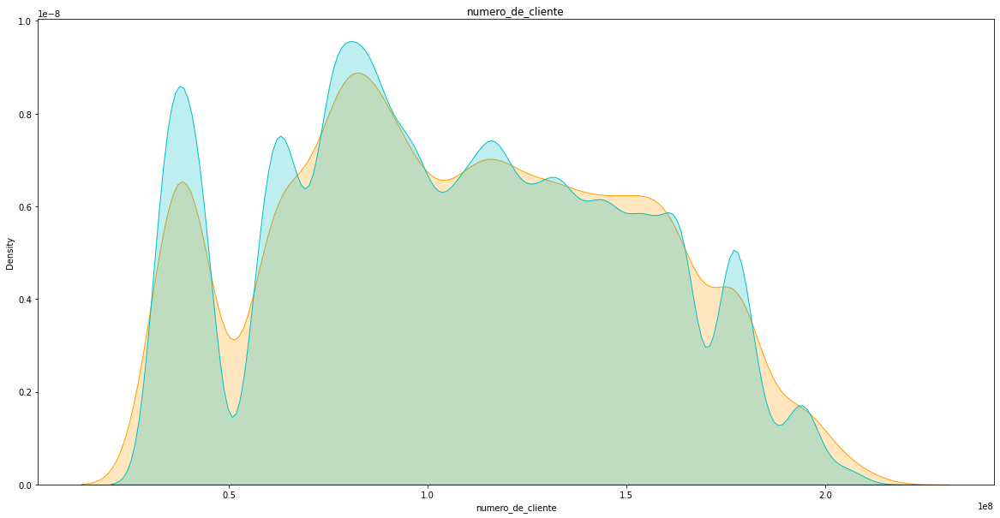

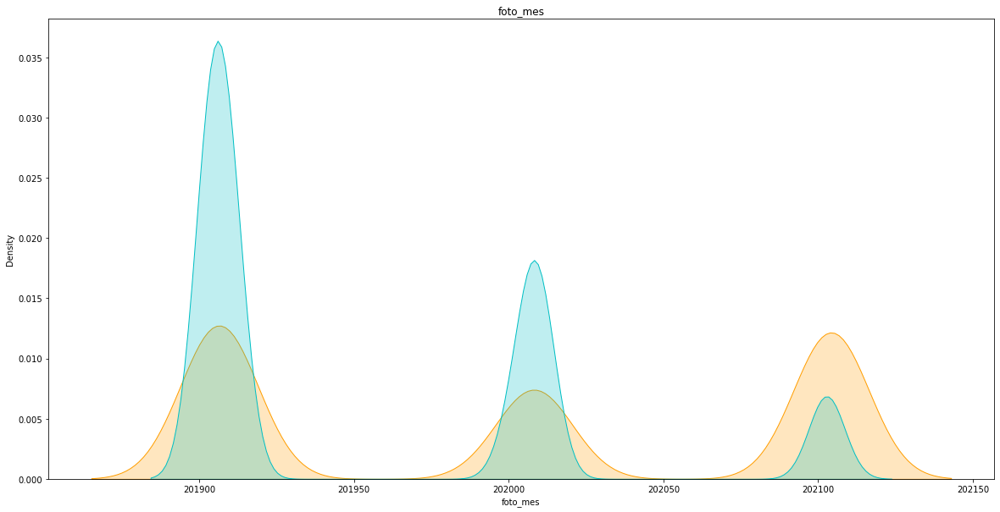

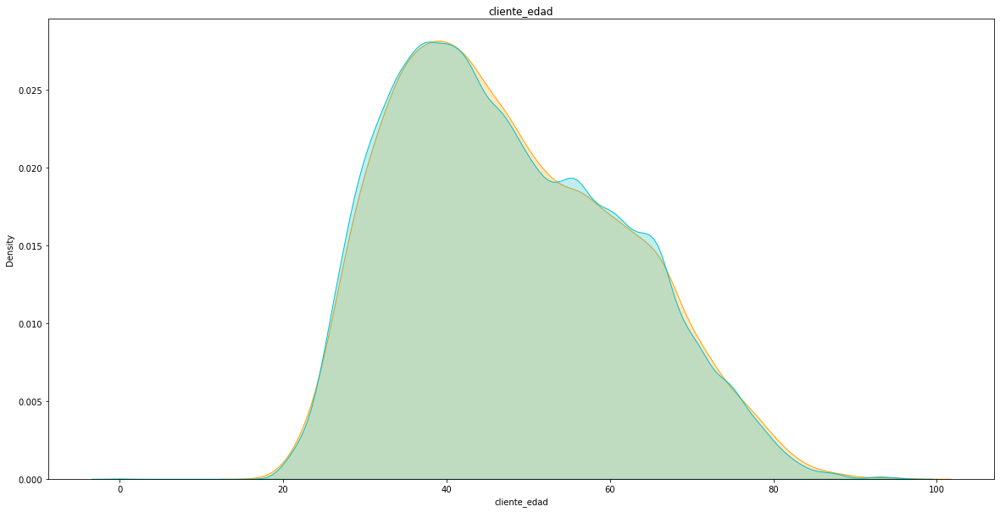

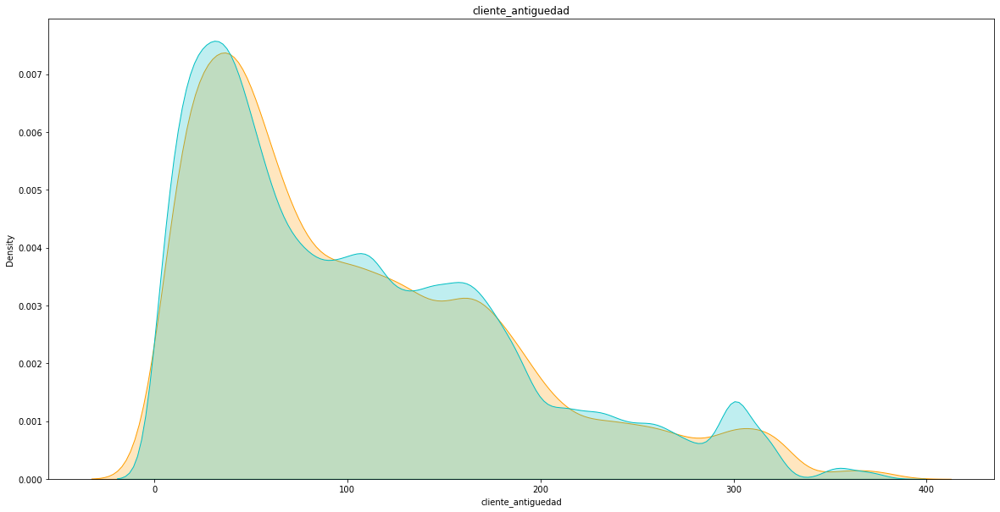

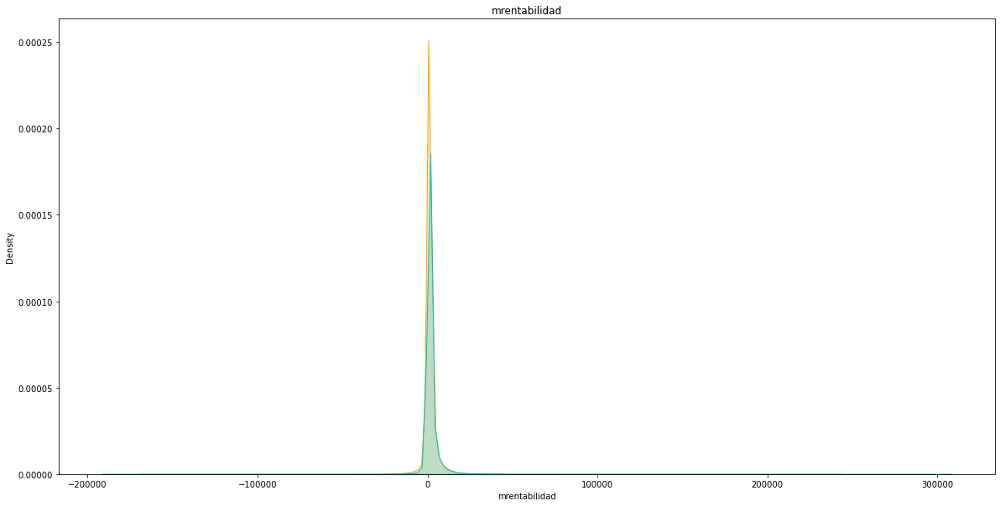

...

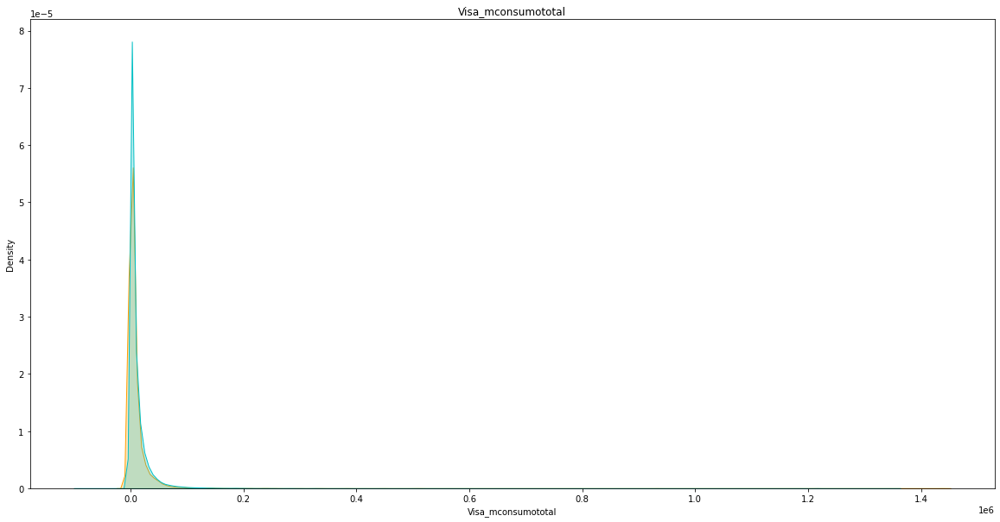

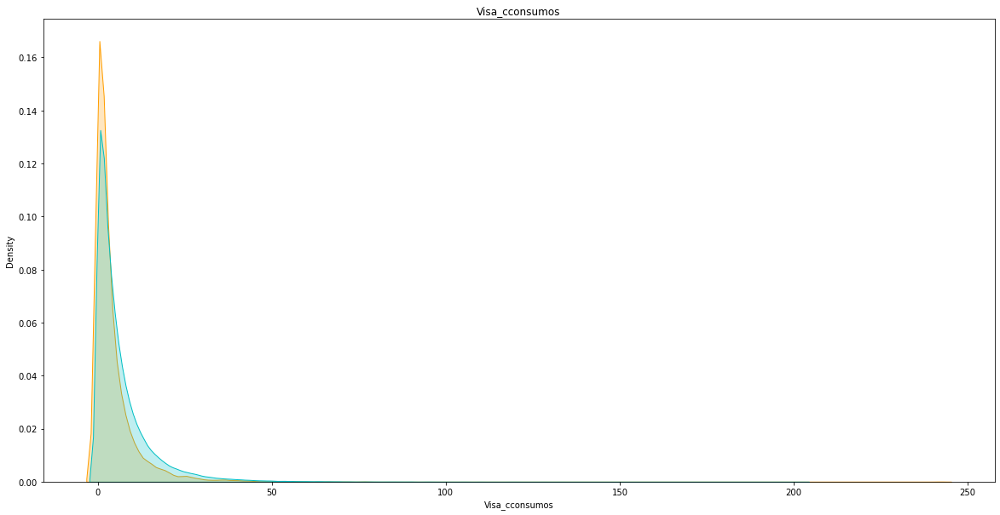

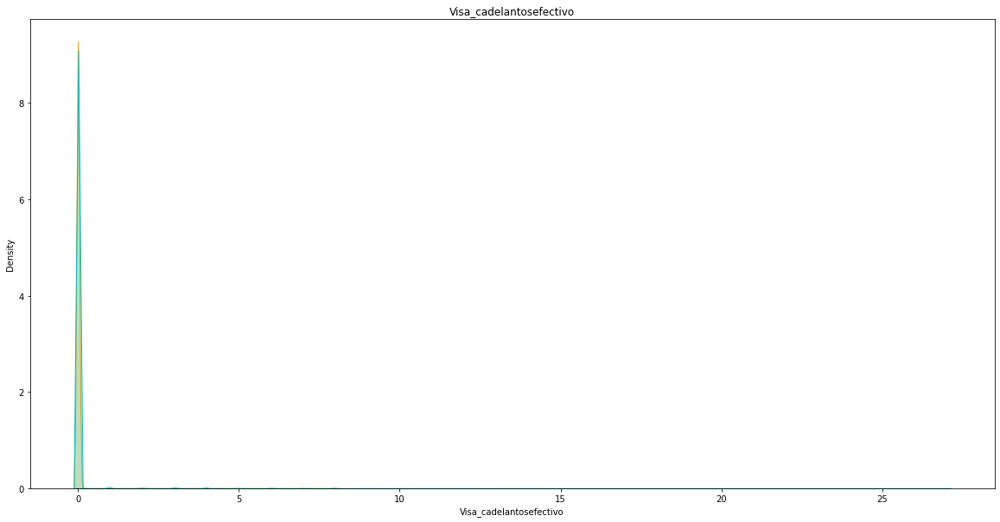

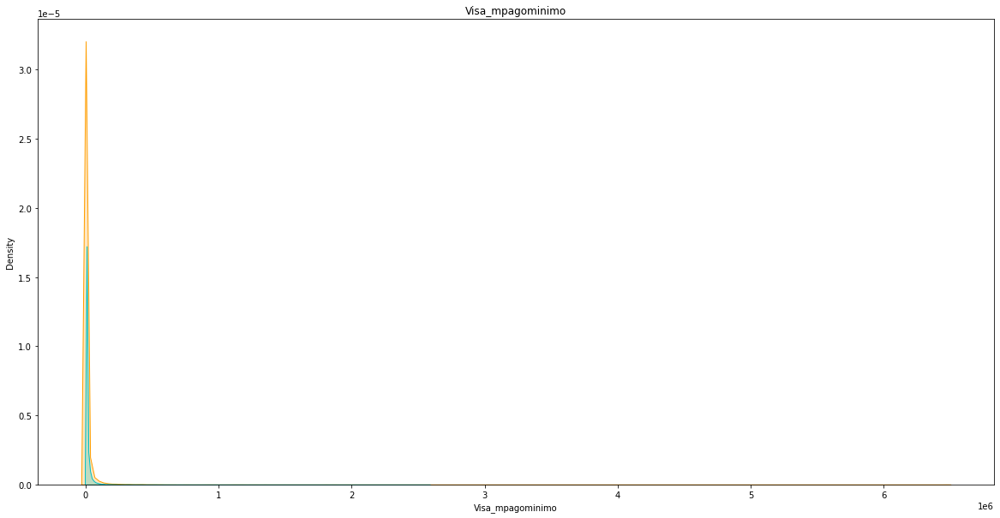

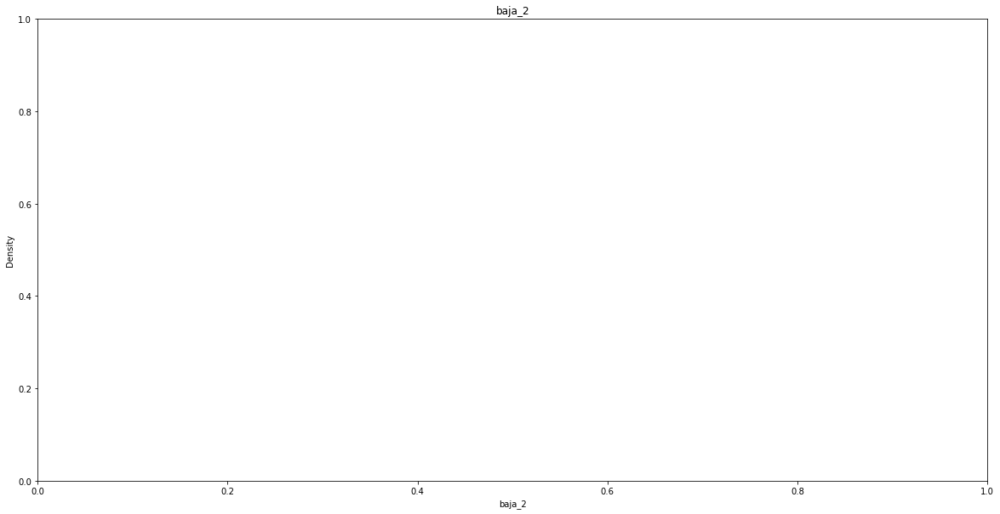

In [34]:
for i in numerical_columns:
        plt.figure(figsize=(20, 10))
        #keep 97.5 percentile
        sns.kdeplot(x=df.loc[df['baja_2'] == 1, i], color='#FF9E00', label='Train data', fill =True)
        sns.kdeplot(x=df.loc[df['baja_2'] == 0, i], color='#00BFC4', label='Test data', fill =True) 
        plt.xlabel(i)
        plt.ylabel('Density')
        plt.title(i)
        plt.show()

In [14]:
df_continua

,numero_de_cliente,foto_mes,active_quarter,cliente_vip,internet,cliente_edad,cliente_antiguedad,mrentabilidad,mrentabilidad_annual,mcomisiones,...,Visa_mpagospesos,Visa_mpagosdolares,Visa_fechaalta,Visa_mconsumototal,Visa_cconsumos,Visa_cadelantosefectivo,Visa_mpagominimo,clase_ternaria,foto_mes_date,baja_2
0,31116053,201901,1,0,1,48,171,8304.310,42993.540,2501.040,...,-35773.320,2.330,5148.000,36602.130,54.000,0.000,5008.710,CONTINUA,2019-01-01,0
1,31116803,201901,1,0,1,57,296,18318.760,42597.260,14986.760,...,-67414.820,1149.570,3299.000,28503.060,10.000,0.000,1395.870,CONTINUA,2019-01-01,0
2,31117908,201901,1,0,1,77,296,20862.840,85481.310,4228.400,...,0.000,0.000,6790.000,5170.250,2.000,0.000,0.000,CONTINUA,2019-01-01,0
3,31117977,201901,1,0,1,58,231,25218.940,165317.780,4474.250,...,-59422.000,0.000,7037.000,67991.900,31.000,0.000,2897.310,CONTINUA,2019-01-01,0
4,31120119,201901,1,0,1,69,349,5307.540,32374.080,4706.220,...,-4802.210,0.000,7596.000,4851.930,3.000,0.000,492.660,CONTINUA,2019-01-01,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4562805,214033382,202107,1,0,0,33,1,307.110,307.110,353.000,...,0.000,0.000,19.000,0.000,0.000,0.000,668.610,CONTINUA,2021-07-01,0
4562806,214034971,202107,0,0,0,32,1,161.220,161.220,0.000,...,NaN,NaN,11.000,NaN,NaN,NaN,0.000,CONTINUA,2021-07-01,0
4562807,214037429,202107,0,0,0,42,1,0.000,0.000,0.000,...,NaN,NaN,16.000,NaN,NaN,NaN,0.000,CONTINUA,2021-07-01,0
4562808,214042186,202107,0,0,0,24,1,0.010,0.010,0.000,...,NaN,NaN,3.000,NaN,NaN,NaN,0.000,CONTINUA,2021-07-01,0


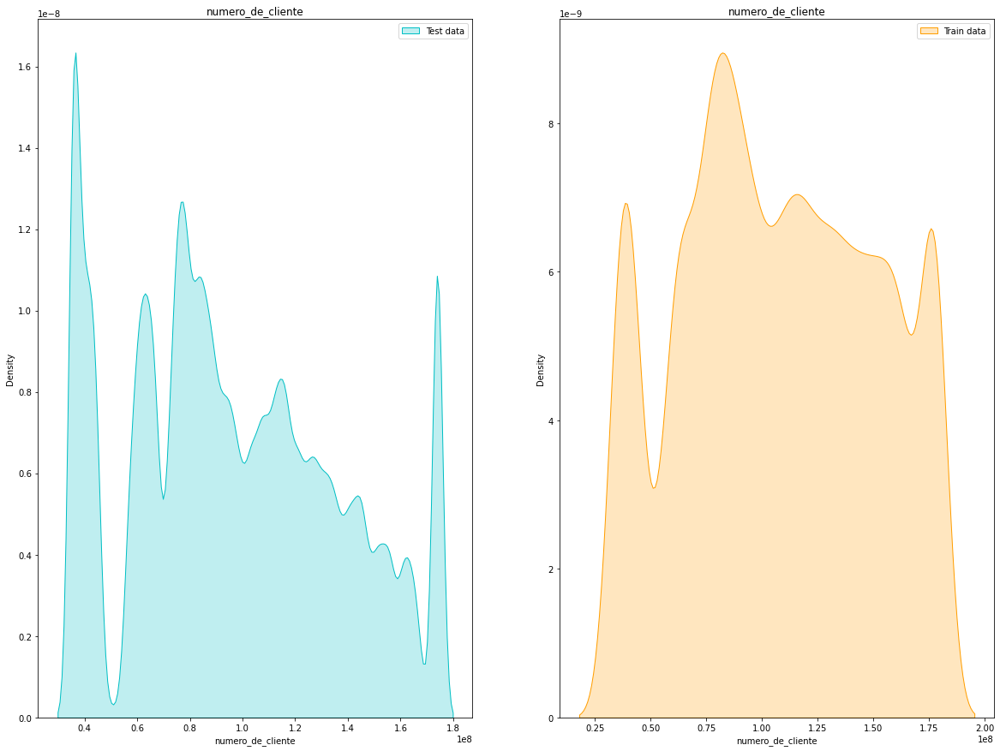

Variable: numero_de_cliente
df_continua count     3686828.000
mean     96905009.847
std      41488818.734
min      31116053.000
25%      65375896.000
50%      91526867.500
75%     126133376.000
max     214046322.000
Name: numero_de_cliente, dtype: float64
df_bajas count       19618.000
mean    107696332.174
std      43926216.480
min      31128656.000
25%      74889347.750
50%     106059144.000
75%     143087310.000
max     213237379.000
Name: numero_de_cliente, dtype: float64


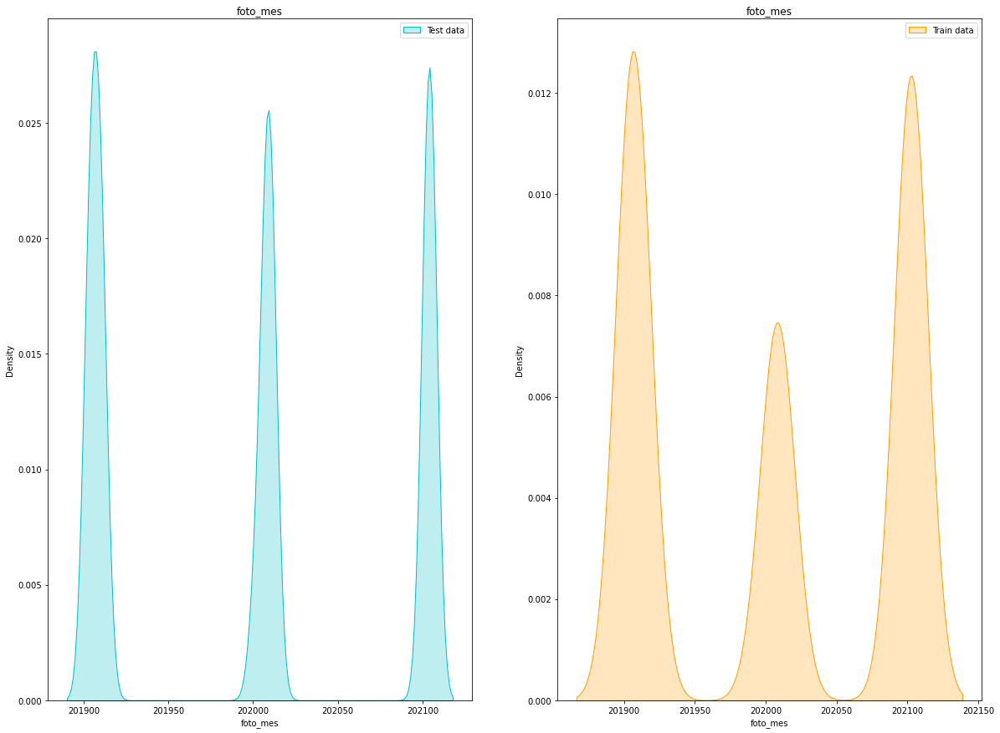

Variable: foto_mes
df_continua count   3686828.000
mean     201998.071
std          81.296
min      201901.000
25%      201909.000
50%      202008.000
75%      202102.000
max      202107.000
Name: foto_mes, dtype: float64
df_bajas count    19618.000
mean    202003.031
std         86.737
min     201901.000
25%     201908.000
50%     202008.000
75%     202103.000
max     202107.000
Name: foto_mes, dtype: float64


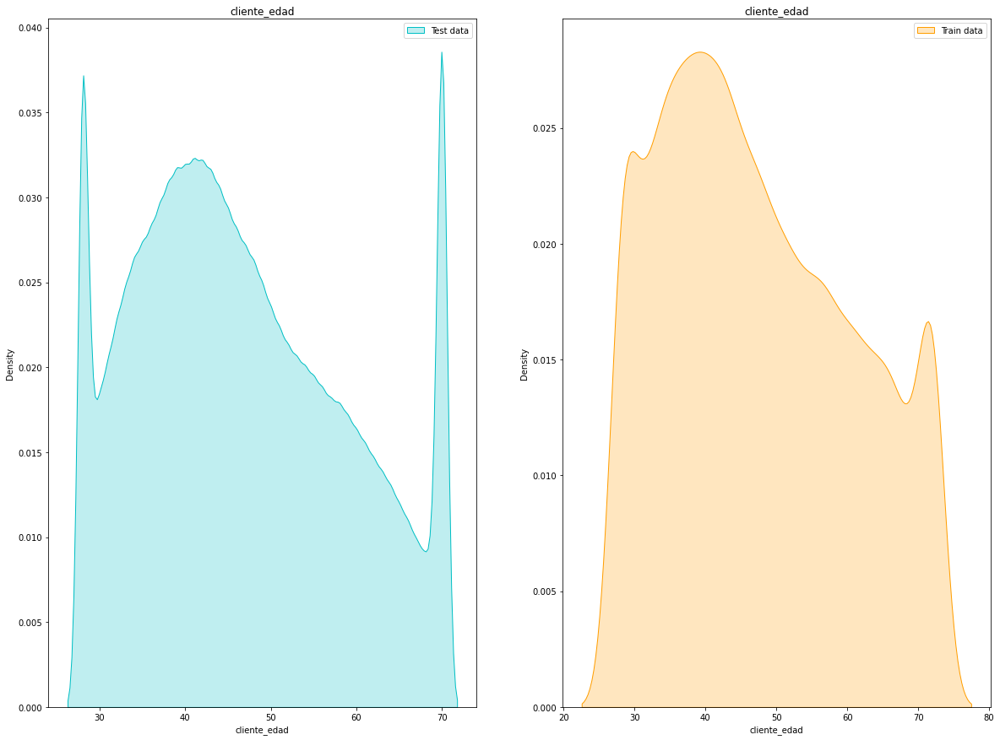

Variable: cliente_edad
df_continua count   3686828.000
mean         46.734
std          12.778
min           0.000
25%          37.000
50%          45.000
75%          56.000
max         108.000
Name: cliente_edad, dtype: float64
df_bajas count   19618.000
mean       47.568
std        13.885
min        18.000
25%        36.000
50%        46.000
75%        58.000
max        96.000
Name: cliente_edad, dtype: float64


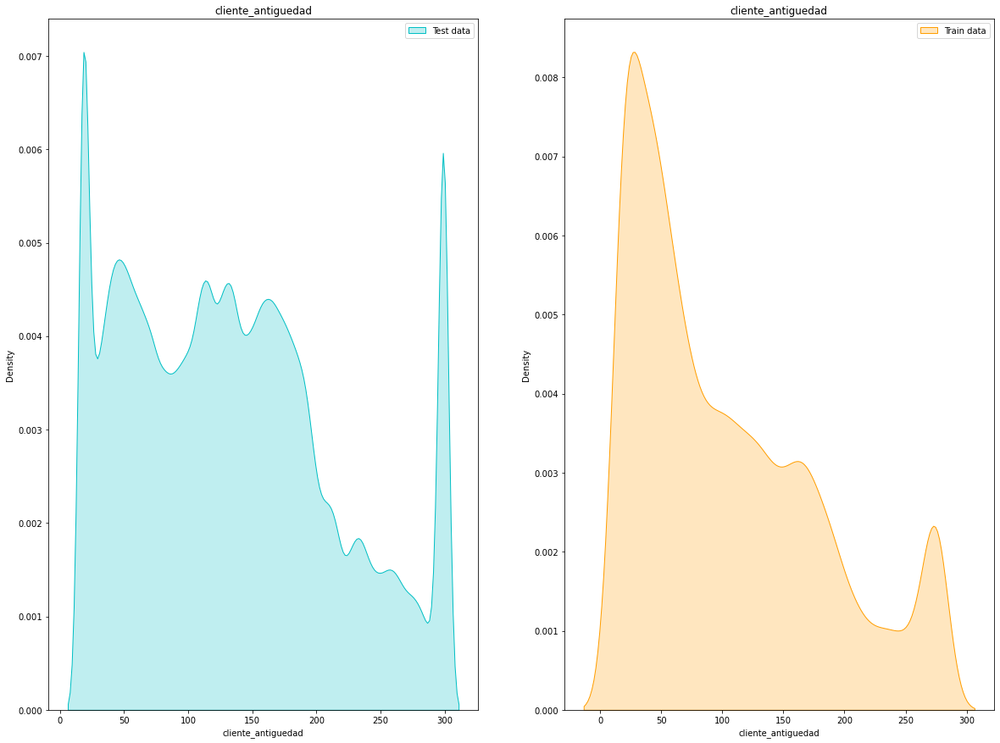

Variable: cliente_antiguedad
df_continua count   3686828.000
mean        134.672
std          83.797
min           1.000
25%          65.000
50%         127.000
75%         186.000
max         485.000
Name: cliente_antiguedad, dtype: float64
df_bajas count   19618.000
mean      104.643
std        80.783
min         1.000
25%        39.000
50%        83.000
75%       156.000
max       379.000
Name: cliente_antiguedad, dtype: float64


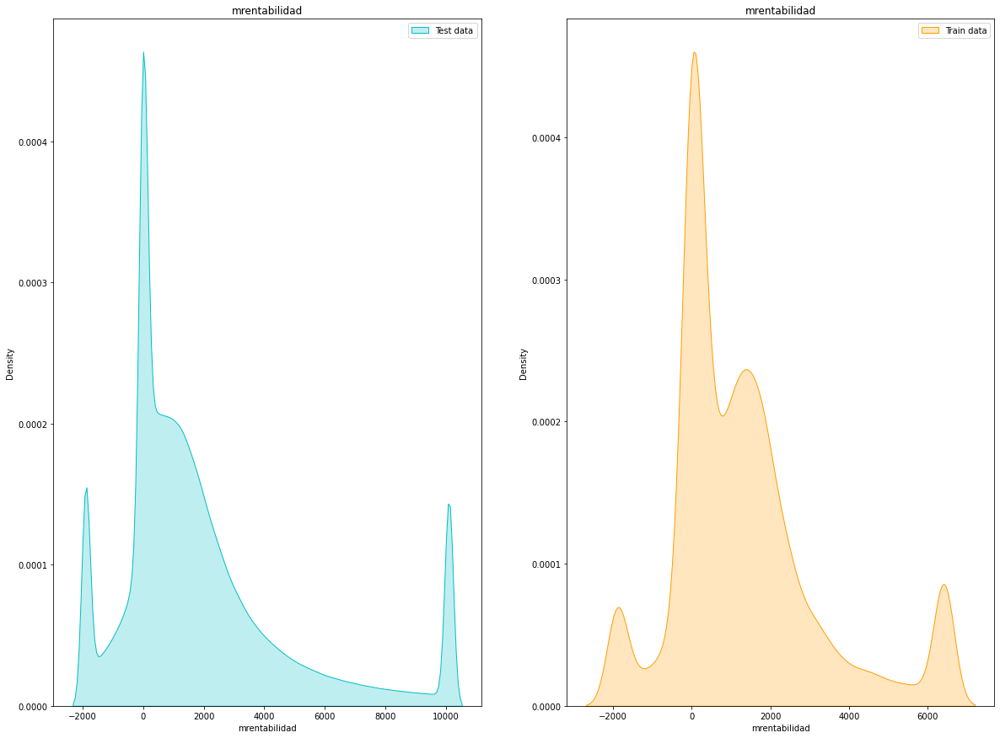

Variable: mrentabilidad
df_continua count    3686828.000
mean        2302.355
std         7163.595
min     -1948808.830
25%            0.000
50%         1137.660
75%         2803.880
max      2599540.050
Name: mrentabilidad, dtype: float64
df_bajas count     19618.000
mean       1503.787
std        5956.738
min     -167516.570
25%           2.385
50%         923.315
75%        2001.207
max      241258.410
Name: mrentabilidad, dtype: float64


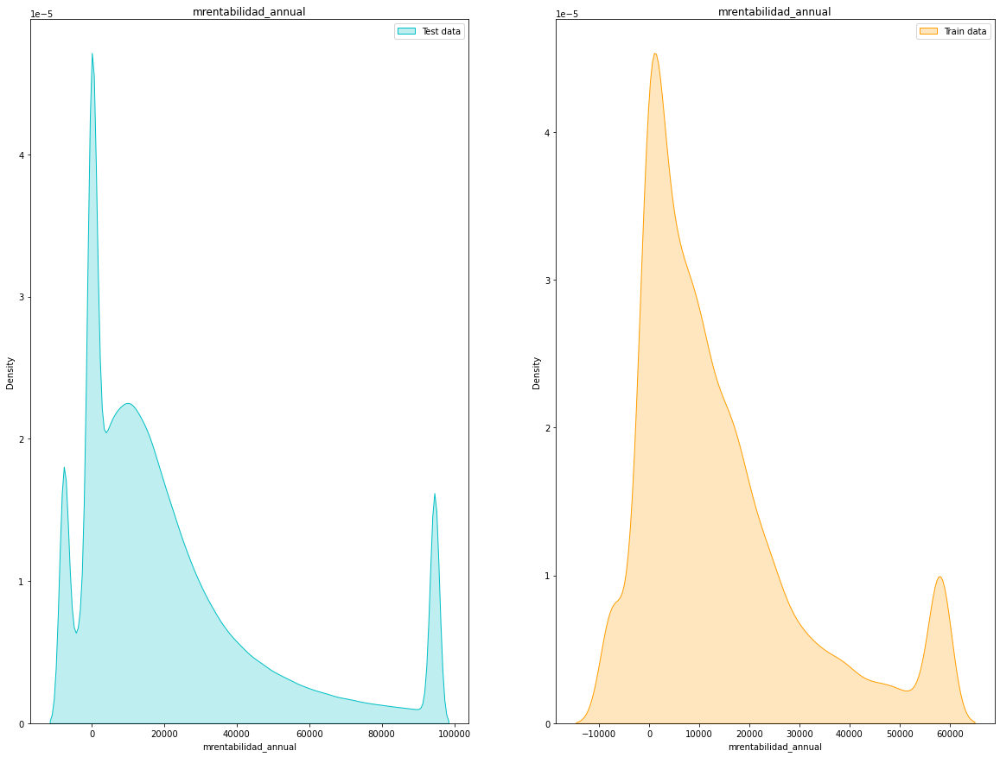

Variable: mrentabilidad_annual
df_continua count    3686828.000
mean       25335.367
std        60719.649
min     -1862286.080
25%         2380.717
50%        13915.375
75%        30218.215
max     11161405.720
Name: mrentabilidad_annual, dtype: float64
df_bajas count     19618.000
mean      16967.722
std       39733.480
min     -234554.650
25%        1500.188
50%        9069.505
75%       20145.507
max     1004183.620
Name: mrentabilidad_annual, dtype: float64


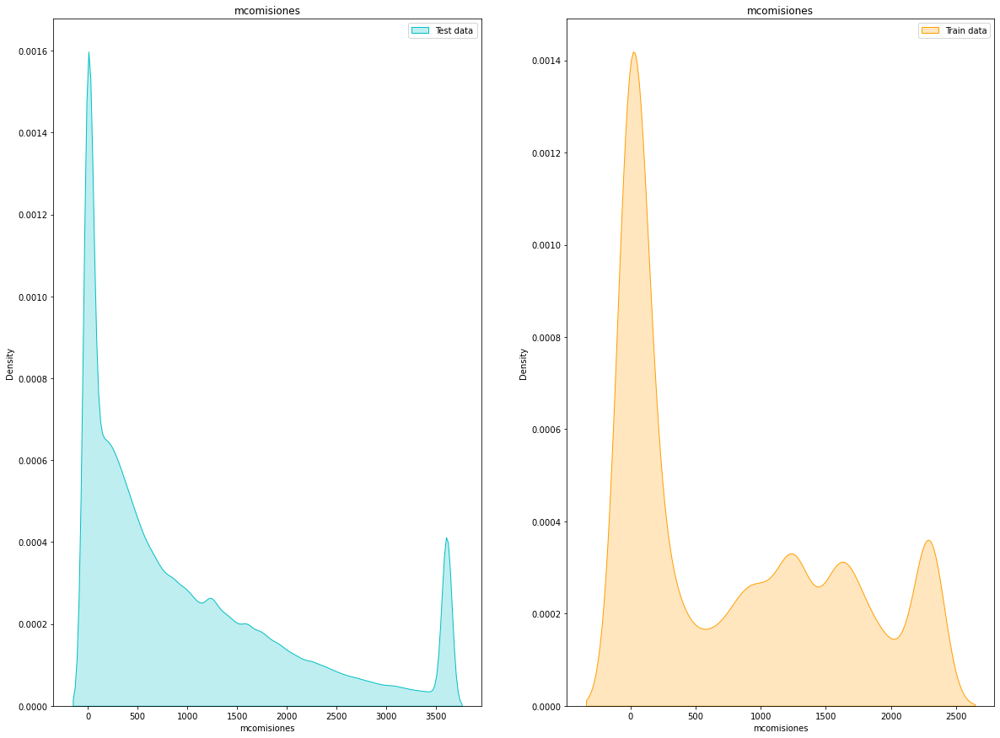

Variable: mcomisiones
df_continua count    3686828.000
mean        1149.168
std         2976.937
min     -1953482.100
25%          145.360
50%          606.890
75%         1493.650
max      1959169.310
Name: mcomisiones, dtype: float64
df_bajas count    19618.000
mean       926.657
std       2174.049
min      -8439.530
25%          0.000
50%        463.975
75%       1493.975
max     123410.700
Name: mcomisiones, dtype: float64


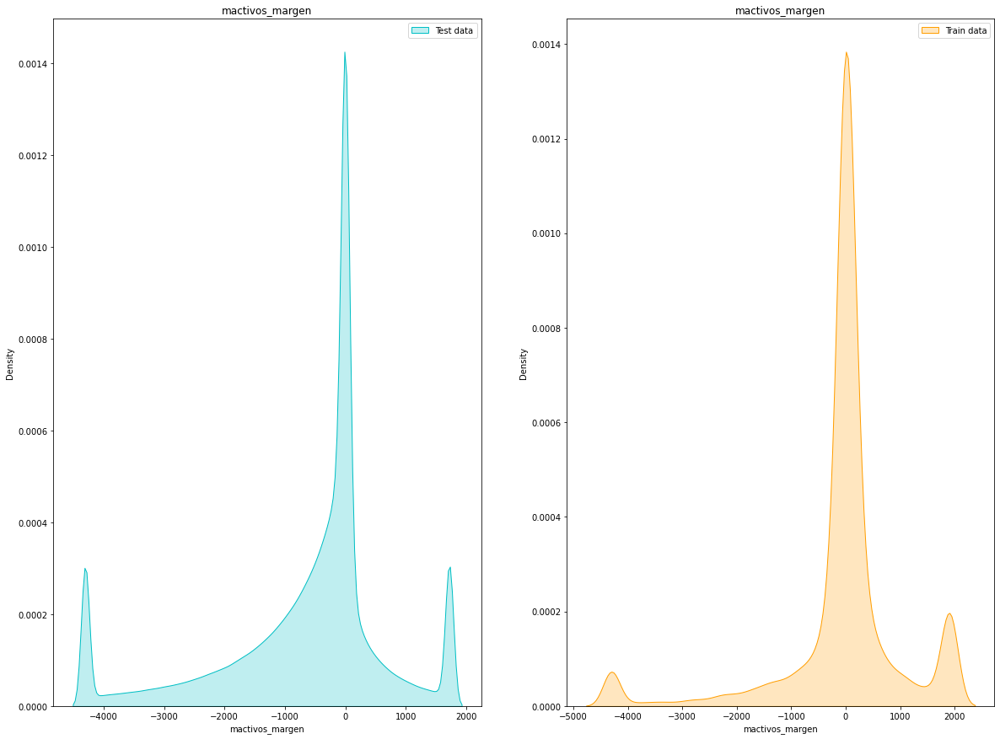

Variable: mactivos_margen
df_continua count   3686828.000
mean       -663.987
std        3304.874
min     -555339.210
25%       -1158.572
50%        -230.540
75%           0.000
max      568198.100
Name: mactivos_margen, dtype: float64
df_bajas count     19618.000
mean         96.921
std        4473.315
min     -171944.400
25%         -86.850
50%           0.000
75%         169.005
max      203429.800
Name: mactivos_margen, dtype: float64


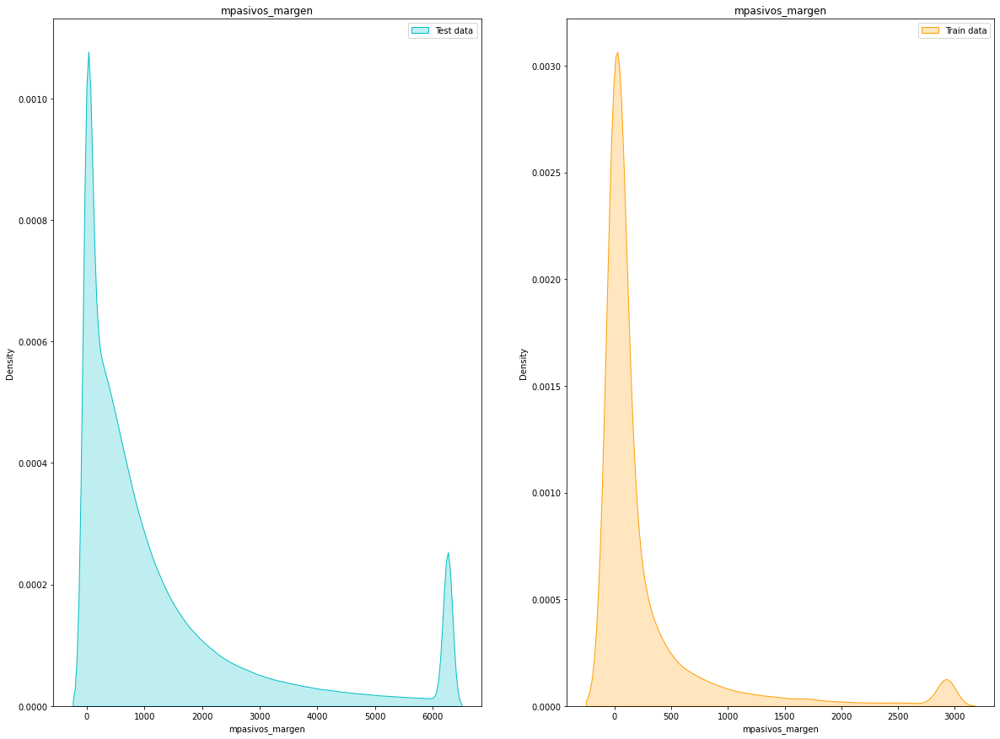

Variable: mpasivos_margen
df_continua count   3686828.000
mean       1647.028
std        4600.398
min      -76359.250
25%         168.620
50%         657.160
75%        1638.133
max     1799988.850
Name: mpasivos_margen, dtype: float64
df_bajas count    19618.000
mean       395.091
std       2017.597
min     -37224.570
25%          0.000
50%         30.770
75%        235.160
max     134355.760
Name: mpasivos_margen, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


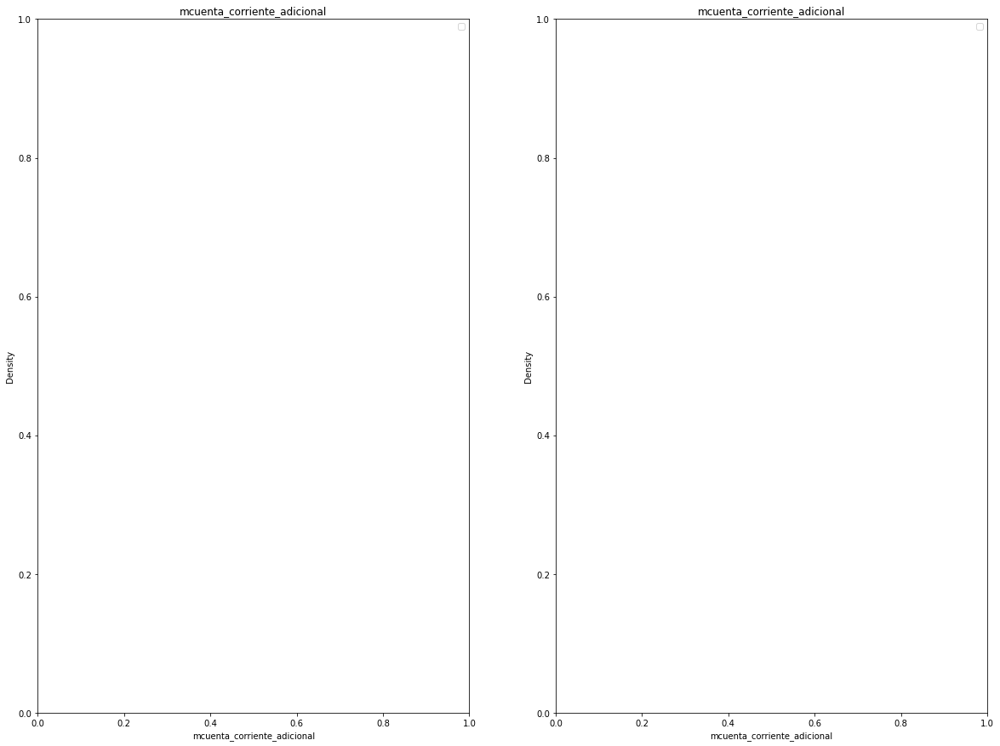

Variable: mcuenta_corriente_adicional
df_continua count    3686828.000
mean         216.441
std        78216.807
min       -92672.440
25%            0.000
50%            0.000
75%            0.000
max     90147241.910
Name: mcuenta_corriente_adicional, dtype: float64
df_bajas count    19618.000
mean         5.107
std        855.468
min     -13467.840
25%          0.000
50%          0.000
75%          0.000
max     119002.580
Name: mcuenta_corriente_adicional, dtype: float64


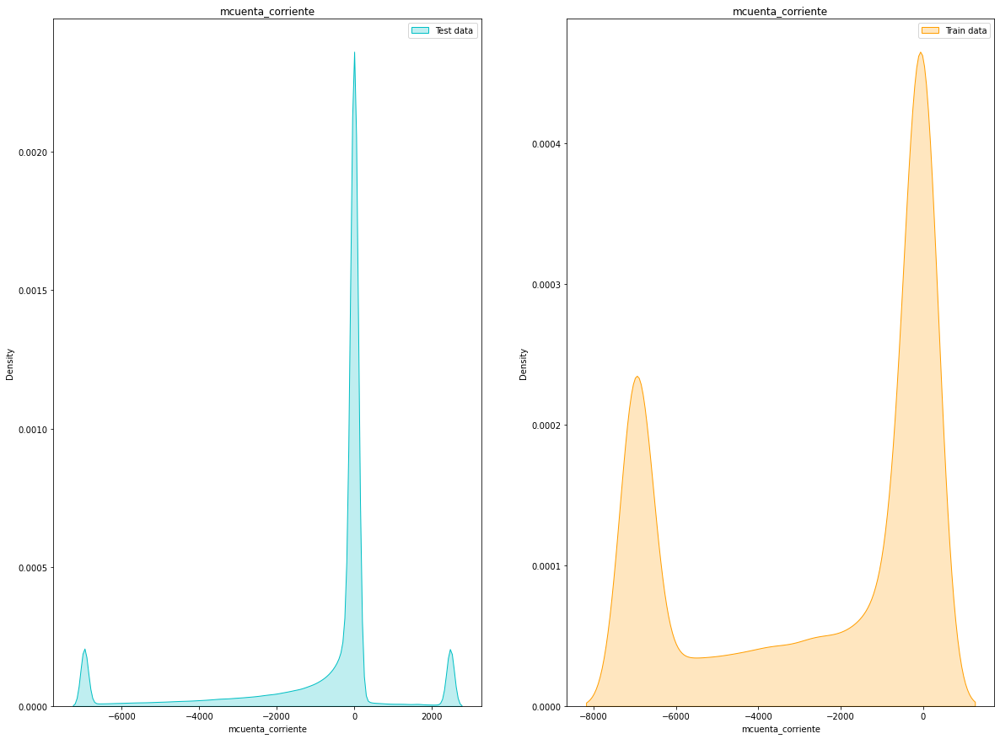

Variable: mcuenta_corriente
df_continua count    3686828.000
mean        3370.935
std        93088.863
min     -2312128.940
25%         -621.092
50%            0.000
75%            0.000
max     35507999.860
Name: mcuenta_corriente, dtype: float64
df_bajas count      19618.000
mean      -11831.004
std        77923.673
min     -3441849.440
25%        -6041.960
50%         -722.545
75%            0.000
max      1216273.240
Name: mcuenta_corriente, dtype: float64


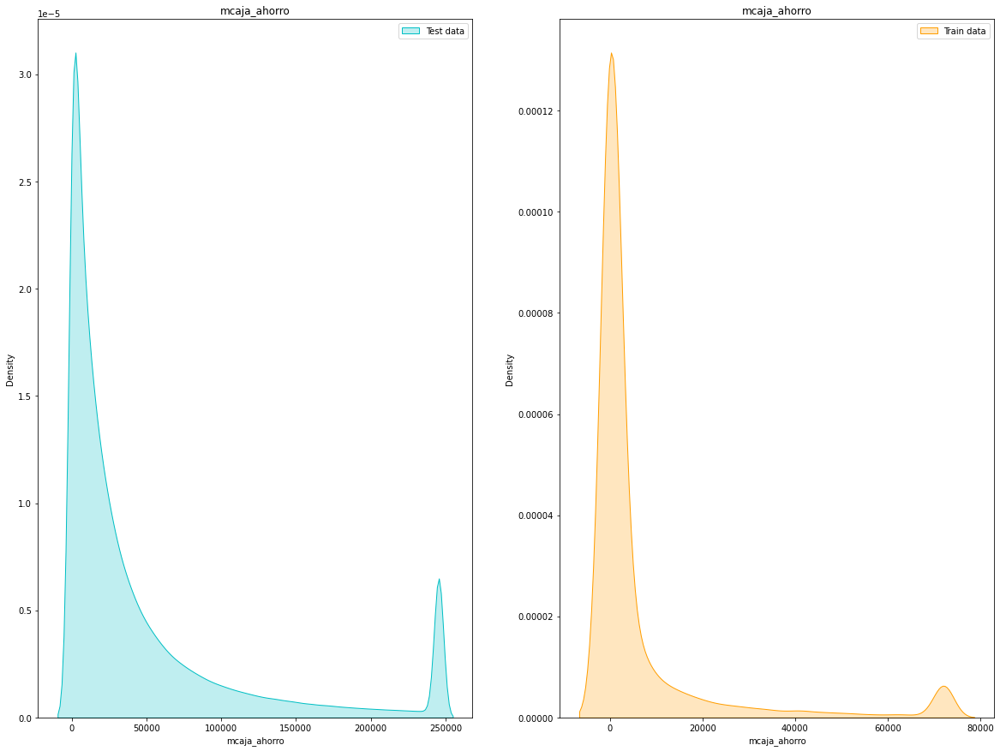

Variable: mcaja_ahorro
df_continua count    3686828.000
mean       63030.540
std       190389.845
min       -16718.000
25%         5281.013
50%        19629.700
75%        55730.867
max     29852437.530
Name: mcaja_ahorro, dtype: float64
df_bajas count     19618.000
mean      12413.600
std       83562.865
min        -167.560
25%           0.000
50%          34.305
75%        3322.405
max     5344461.460
Name: mcaja_ahorro, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


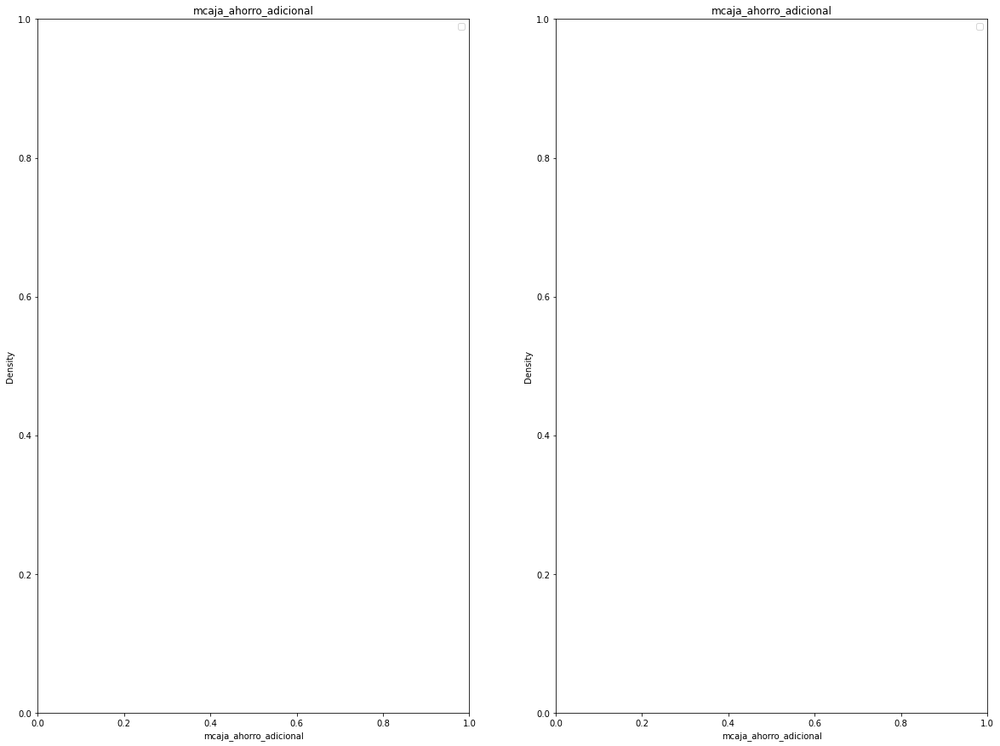

Variable: mcaja_ahorro_adicional
df_continua count   3686828.000
mean        883.631
std       23431.061
min       -6509.730
25%           0.000
50%           0.000
75%           0.000
max     8800244.090
Name: mcaja_ahorro_adicional, dtype: float64
df_bajas count    19618.000
mean       382.220
std       7531.067
min       -143.720
25%          0.000
50%          0.000
75%          0.000
max     562603.900
Name: mcaja_ahorro_adicional, dtype: float64


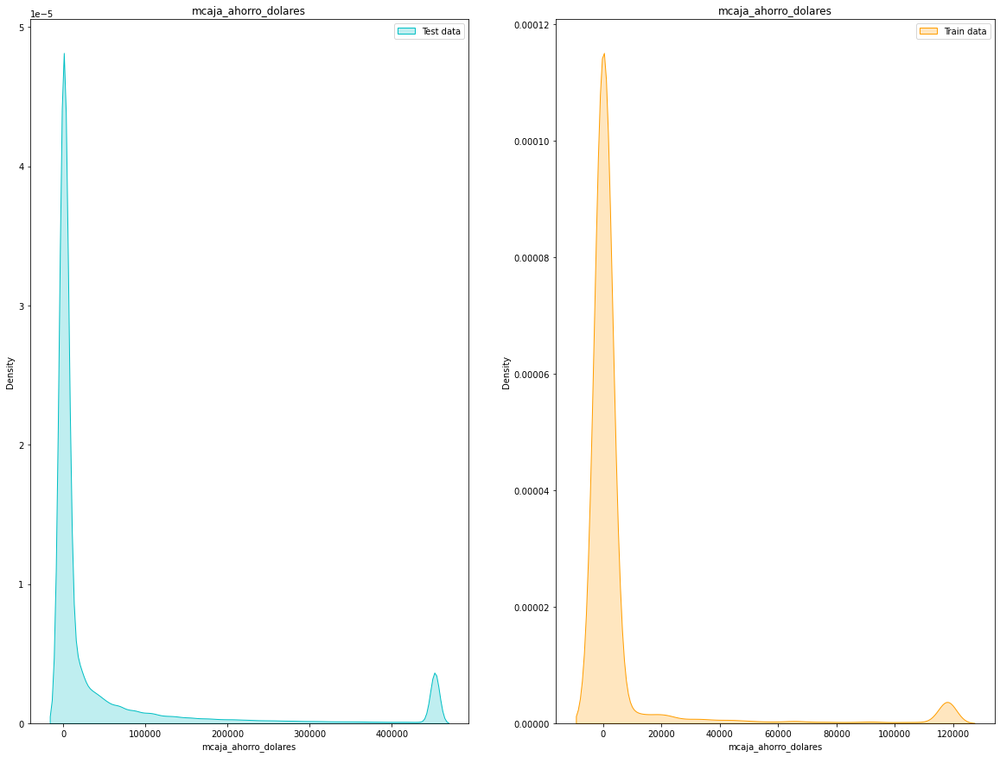

Variable: mcaja_ahorro_dolares
df_continua count     3686828.000
mean       117662.997
std        789935.729
min       -278227.620
25%             0.000
50%            33.070
75%         22939.353
max     118565715.400
Name: mcaja_ahorro_dolares, dtype: float64
df_bajas count      19618.000
mean       22622.408
std       251394.172
min        -6583.290
25%            0.000
50%            0.000
75%            9.800
max     18311273.860
Name: mcaja_ahorro_dolares, dtype: float64


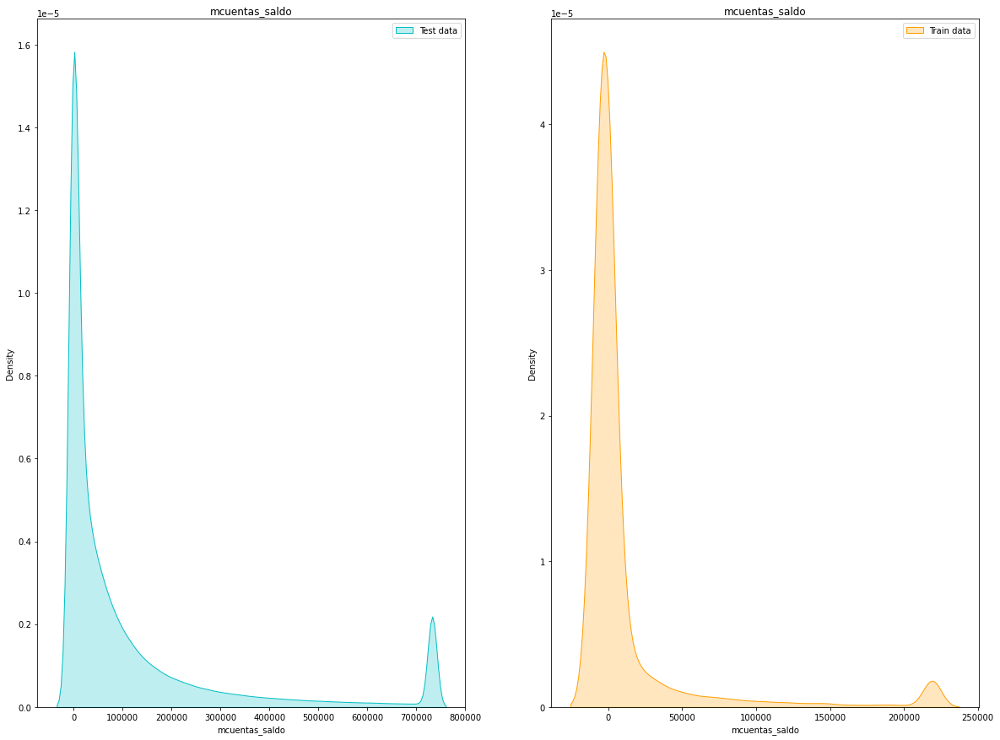

Variable: mcuentas_saldo
df_continua count     3686828.000
mean       191875.089
std       1011732.474
min      -1385448.840
25%           455.678
50%         29747.130
75%        123247.308
max     251511970.900
Name: mcuentas_saldo, dtype: float64
df_bajas count      19618.000
mean       20690.128
std       307808.537
min     -4297501.850
25%        -6193.837
50%         -387.195
75%         2304.040
max     19063511.900
Name: mcuentas_saldo, dtype: float64


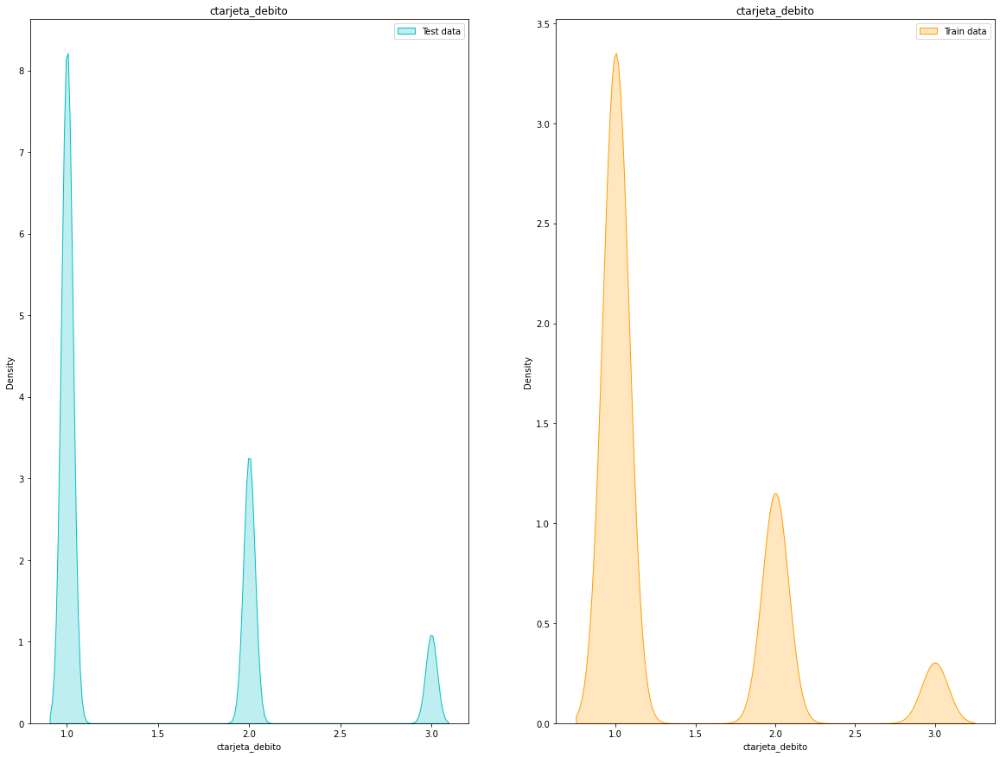

Variable: ctarjeta_debito
df_continua count   3686828.000
mean          1.466
std           0.767
min           0.000
25%           1.000
50%           1.000
75%           2.000
max          14.000
Name: ctarjeta_debito, dtype: float64
df_bajas count   19618.000
mean        1.395
std         1.921
min         0.000
25%         1.000
50%         1.000
75%         2.000
max       253.000
Name: ctarjeta_debito, dtype: float64


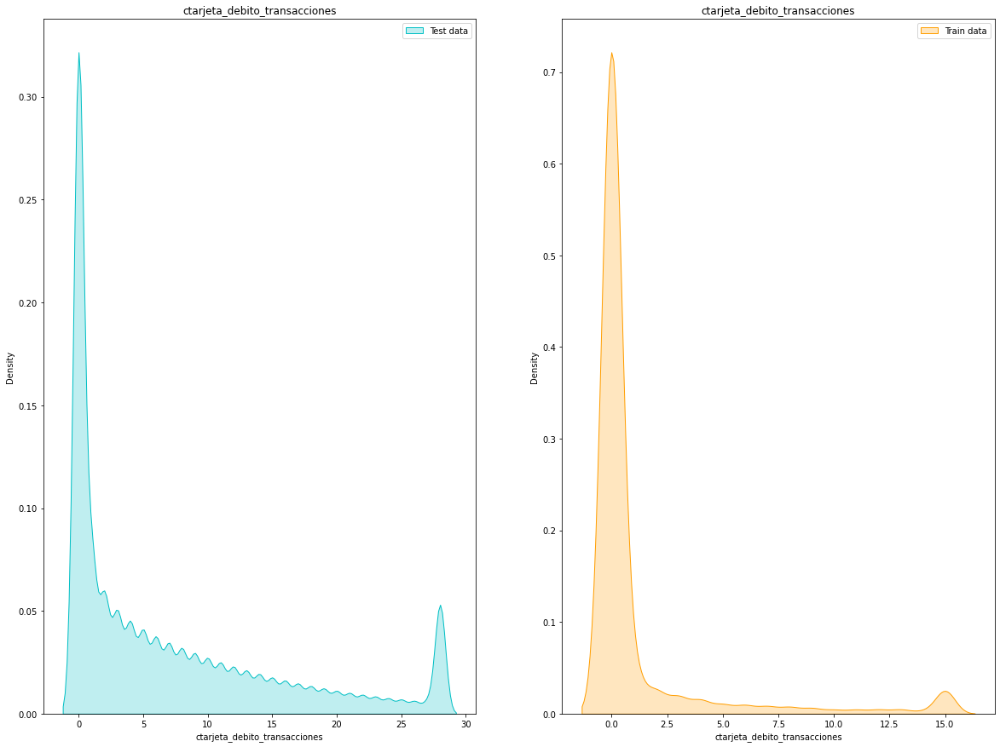

Variable: ctarjeta_debito_transacciones
df_continua count   3686828.000
mean          7.550
std          10.422
min           0.000
25%           0.000
50%           3.000
75%          11.000
max         274.000
Name: ctarjeta_debito_transacciones, dtype: float64
df_bajas count   19618.000
mean        1.418
std         4.790
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        75.000
Name: ctarjeta_debito_transacciones, dtype: float64


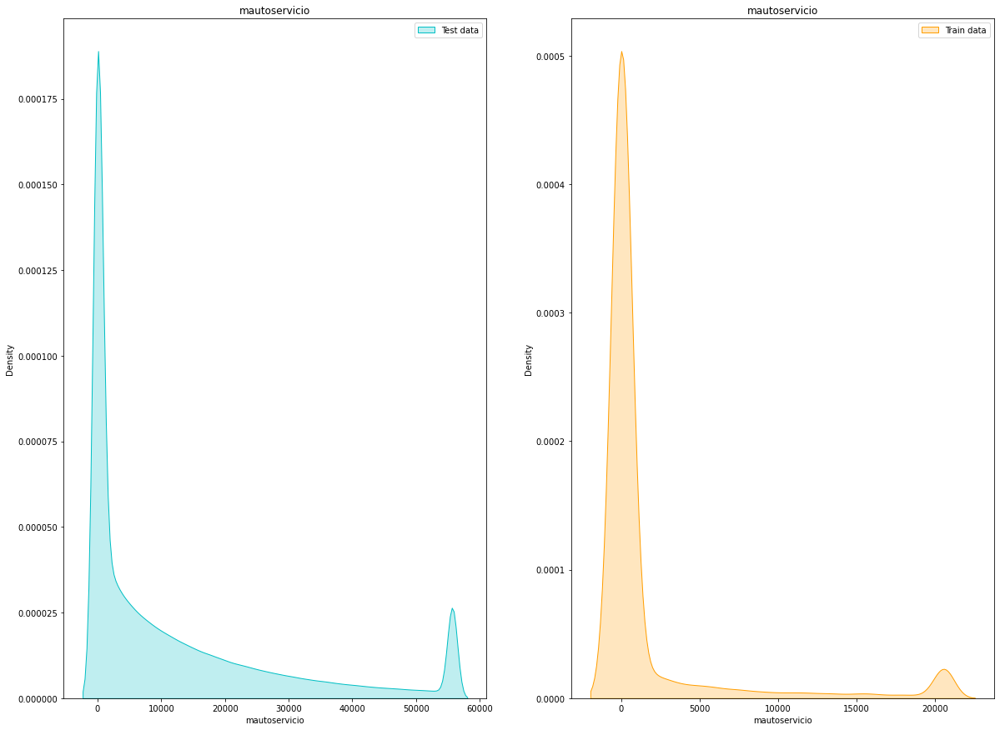

Variable: mautoservicio
df_continua count   3686828.000
mean      13787.576
std       23644.868
min           0.000
25%           0.000
50%        4807.225
75%       18238.833
max     1131156.050
Name: mautoservicio, dtype: float64
df_bajas count    19618.000
mean      2569.204
std      11166.473
min          0.000
25%          0.000
50%          0.000
75%          0.000
max     374453.610
Name: mautoservicio, dtype: float64


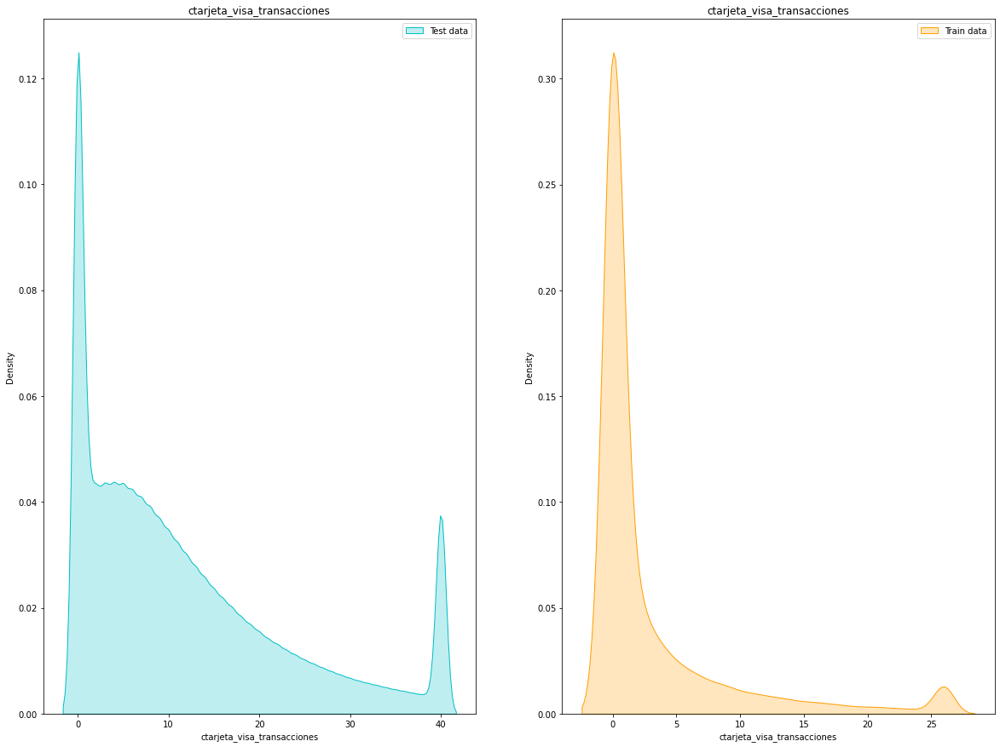

Variable: ctarjeta_visa_transacciones
df_continua count   3686828.000
mean         12.511
std          14.620
min           0.000
25%           3.000
50%           8.000
75%          17.000
max         794.000
Name: ctarjeta_visa_transacciones, dtype: float64
df_bajas count   19618.000
mean        3.288
std         7.793
min         0.000
25%         0.000
50%         0.000
75%         3.000
max       219.000
Name: ctarjeta_visa_transacciones, dtype: float64


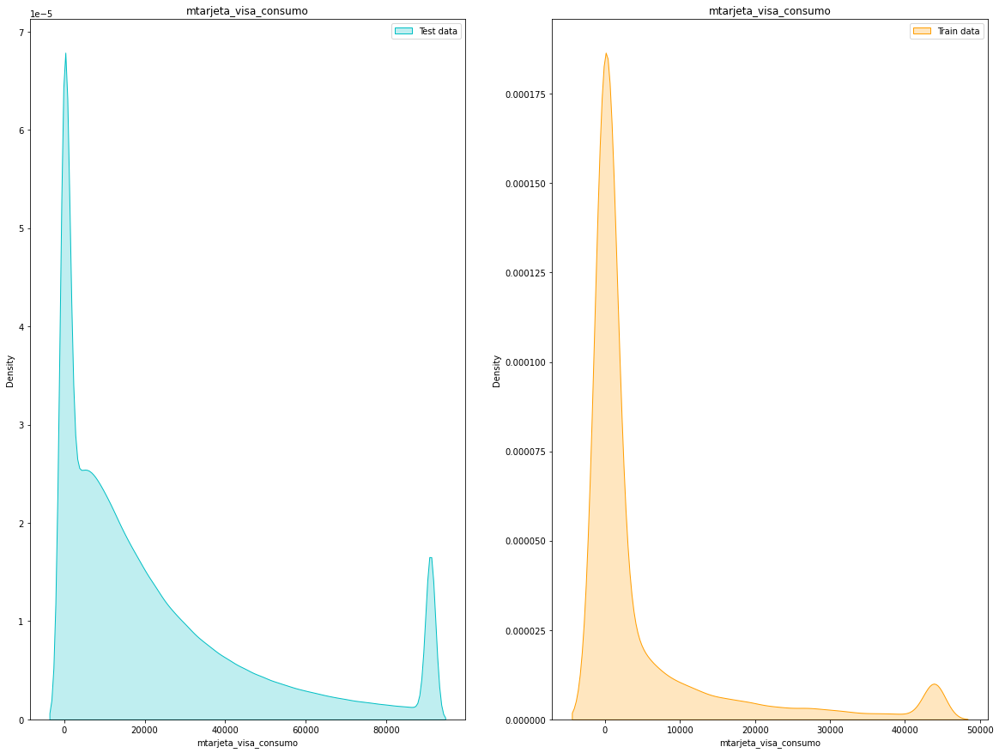

Variable: mtarjeta_visa_consumo
df_continua count   3686828.000
mean      25958.254
std       42540.990
min           0.000
25%        3341.240
50%       13906.290
75%       32360.385
max     5975730.070
Name: mtarjeta_visa_consumo, dtype: float64
df_bajas count     19618.000
mean       6533.797
std       24790.681
min           0.000
25%           0.000
50%           0.000
75%        3953.930
max     1487466.130
Name: mtarjeta_visa_consumo, dtype: float64


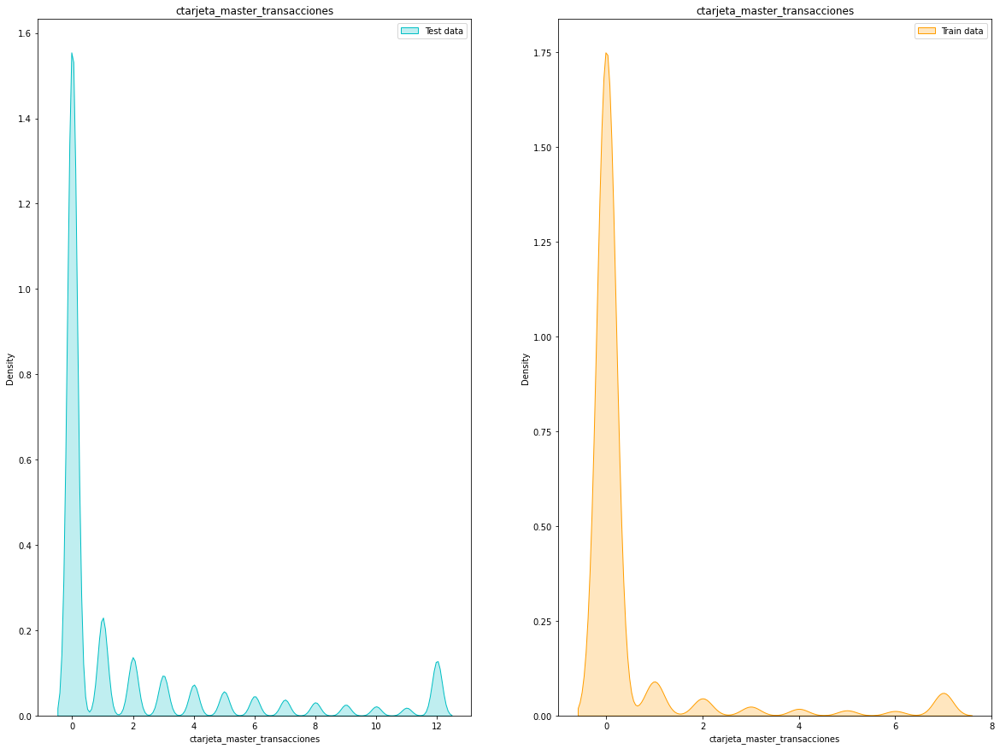

Variable: ctarjeta_master_transacciones
df_continua count   3686828.000
mean          2.222
std           5.575
min           0.000
25%           0.000
50%           0.000
75%           2.000
max         401.000
Name: ctarjeta_master_transacciones, dtype: float64
df_bajas count   19618.000
mean        0.644
std         2.904
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        72.000
Name: ctarjeta_master_transacciones, dtype: float64


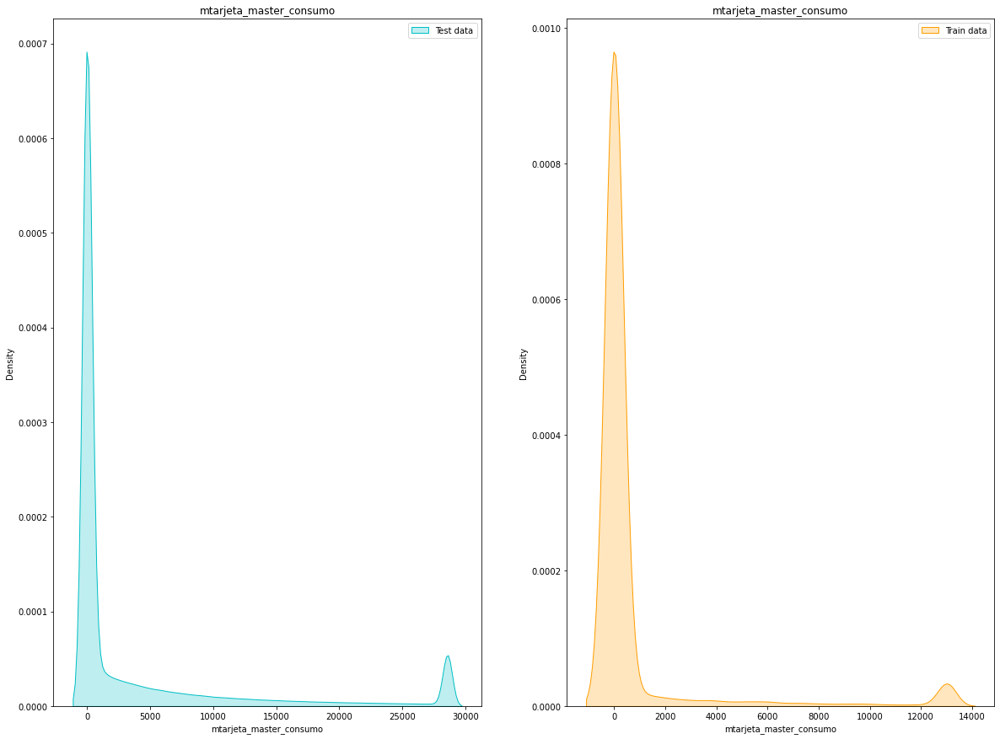

Variable: mtarjeta_master_consumo
df_continua count   3686828.000
mean       5680.357
std       21548.984
min           0.000
25%           0.000
50%           0.000
75%        3137.860
max     2942059.930
Name: mtarjeta_master_consumo, dtype: float64
df_bajas count    19618.000
mean      1486.853
std       9597.104
min          0.000
25%          0.000
50%          0.000
75%          0.000
max     487165.930
Name: mtarjeta_master_consumo, dtype: float64


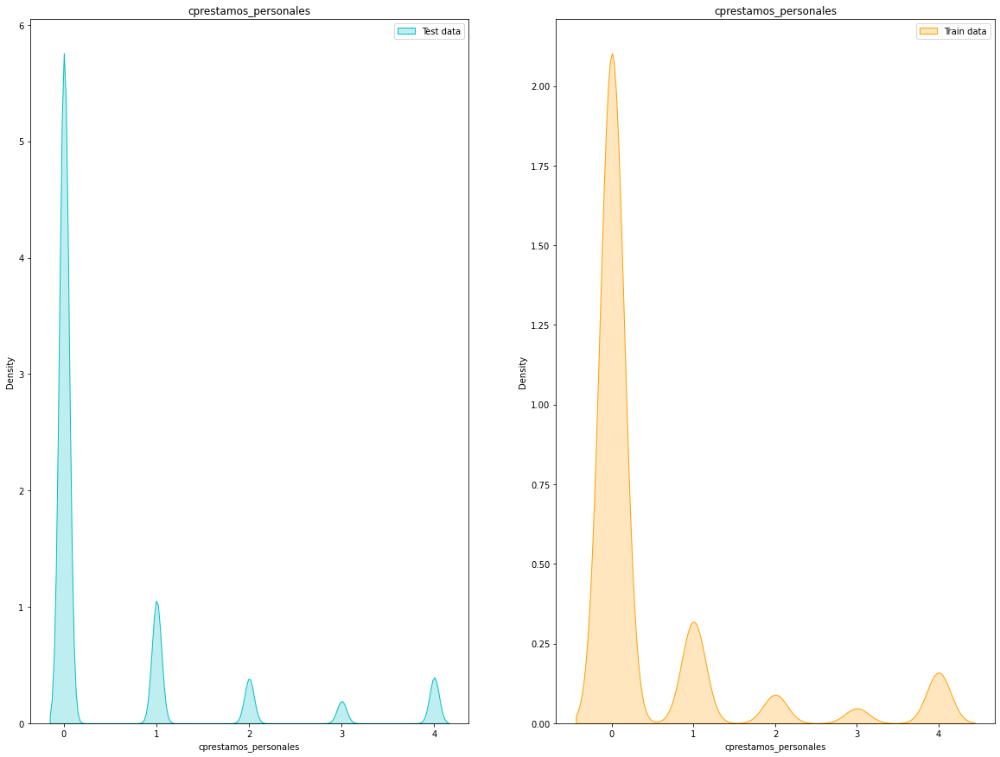

Variable: cprestamos_personales
df_continua count   3686828.000
mean          0.749
std           3.069
min           0.000
25%           0.000
50%           0.000
75%           1.000
max         423.000
Name: cprestamos_personales, dtype: float64
df_bajas count   19618.000
mean        0.926
std         5.838
min         0.000
25%         0.000
50%         0.000
75%         0.000
max       522.000
Name: cprestamos_personales, dtype: float64


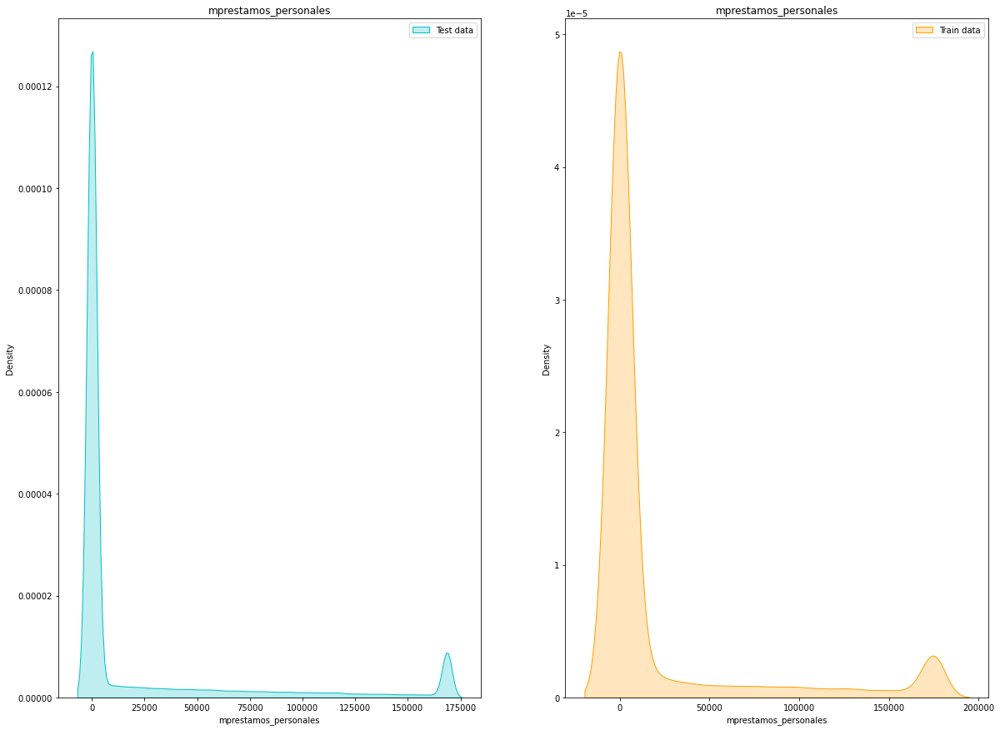

Variable: mprestamos_personales
df_continua count   3686828.000
mean      29181.167
std       85797.310
min           0.000
25%           0.000
50%           0.000
75%        5530.910
max     6001844.050
Name: mprestamos_personales, dtype: float64
df_bajas count     19618.000
mean      26230.426
std       89250.063
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     3289857.790
Name: mprestamos_personales, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


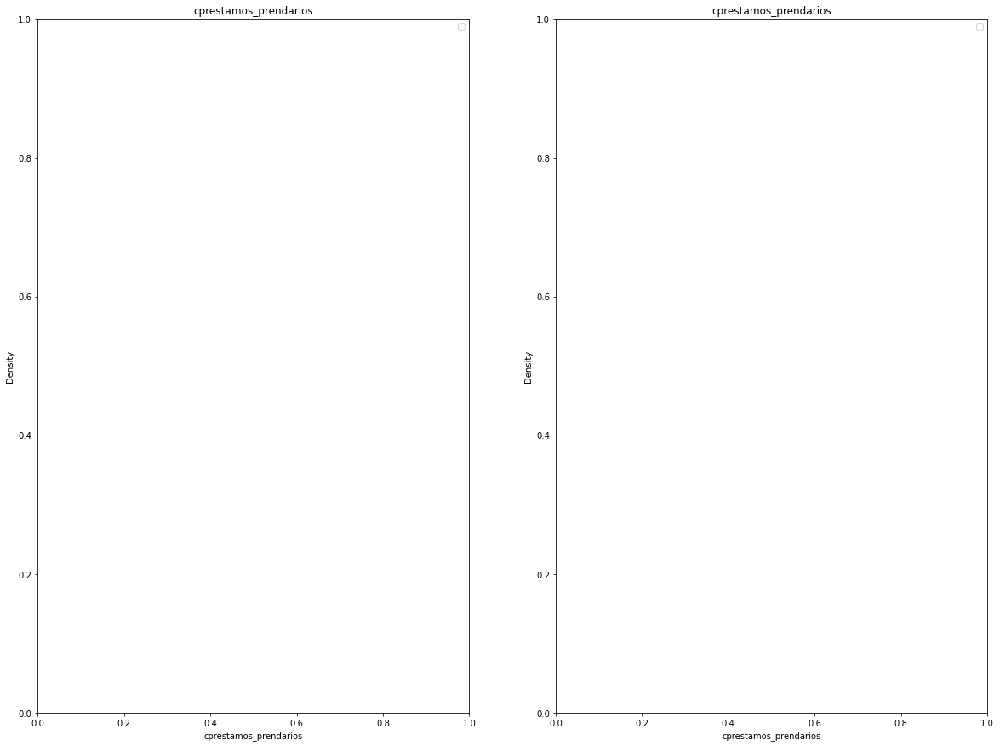

Variable: cprestamos_prendarios
df_continua count   3686828.000
mean          0.021
std           0.324
min           0.000
25%           0.000
50%           0.000
75%           0.000
max          39.000
Name: cprestamos_prendarios, dtype: float64
df_bajas count   19618.000
mean        0.022
std         0.307
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        18.000
Name: cprestamos_prendarios, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


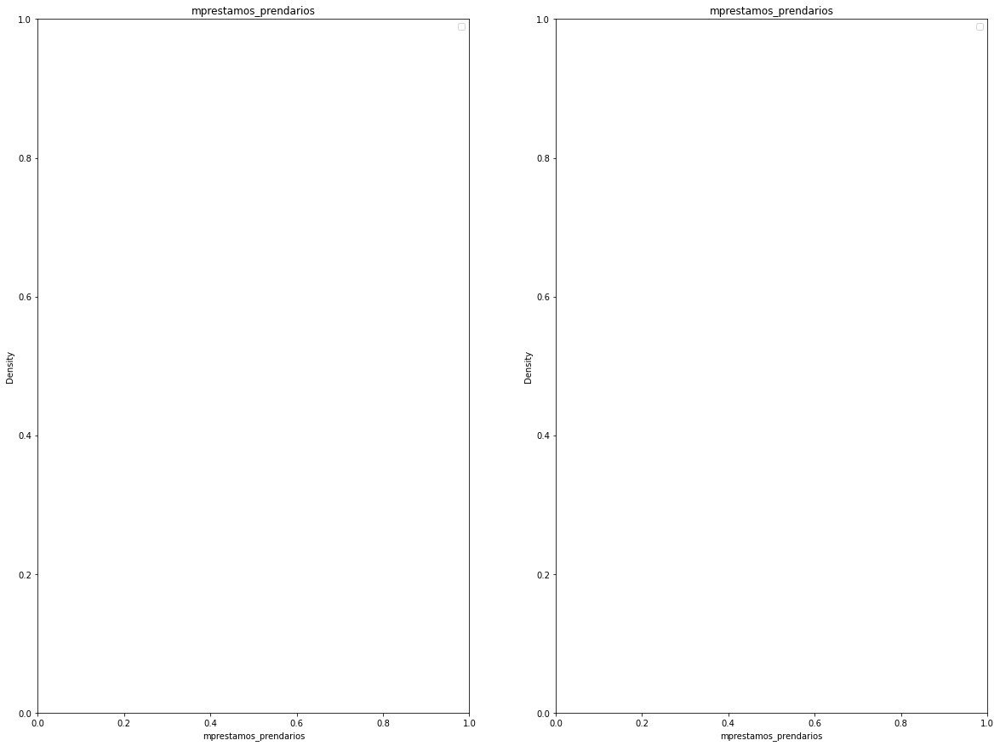

Variable: mprestamos_prendarios
df_continua count    3686828.000
mean        4661.673
std        79916.601
min      -997075.680
25%            0.000
50%            0.000
75%            0.000
max     18373587.790
Name: mprestamos_prendarios, dtype: float64
df_bajas count     19618.000
mean       3670.997
std       53011.680
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     2808149.800
Name: mprestamos_prendarios, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


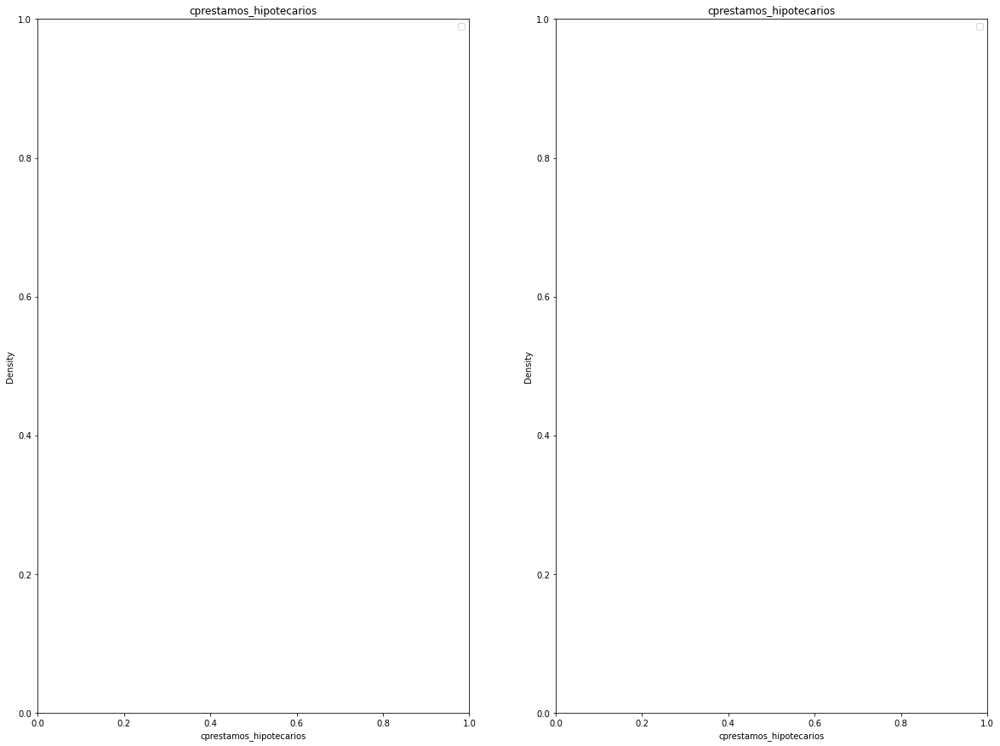

Variable: cprestamos_hipotecarios
df_continua count   3686828.000
mean          0.023
std           0.335
min           0.000
25%           0.000
50%           0.000
75%           0.000
max          45.000
Name: cprestamos_hipotecarios, dtype: float64
df_bajas count   19618.000
mean        0.007
std         0.213
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        18.000
Name: cprestamos_hipotecarios, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


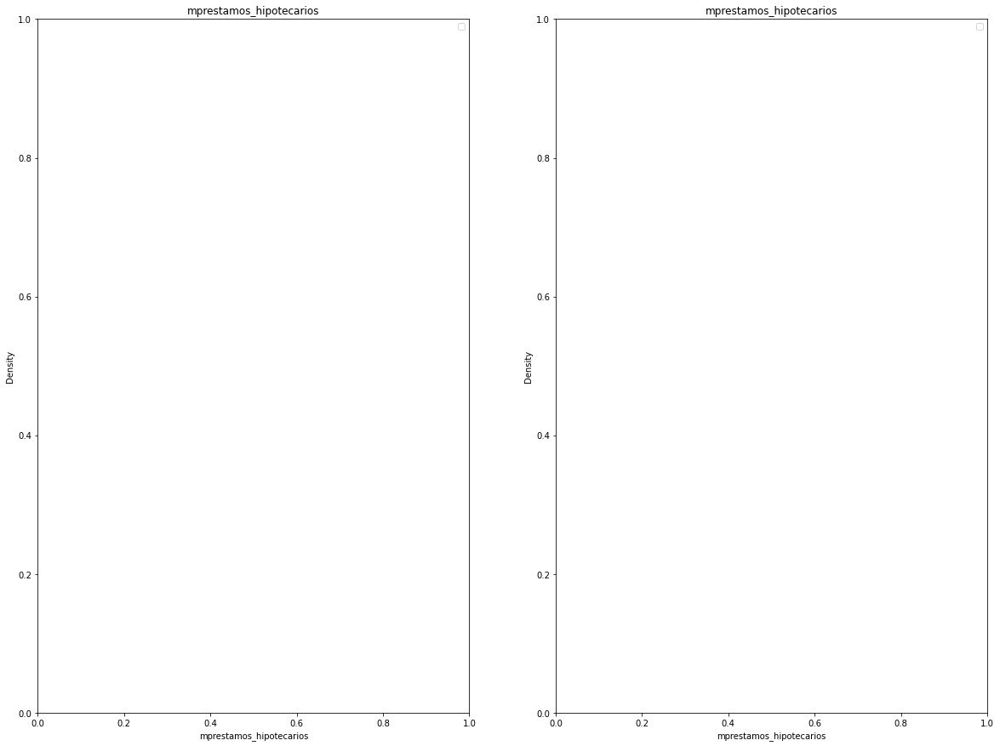

Variable: mprestamos_hipotecarios
df_continua count    3686828.000
mean       22426.453
std       353771.771
min            0.000
25%            0.000
50%            0.000
75%            0.000
max     36197767.250
Name: mprestamos_hipotecarios, dtype: float64
df_bajas count     19618.000
mean       2123.571
std       80667.397
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     5385241.810
Name: mprestamos_hipotecarios, dtype: float64


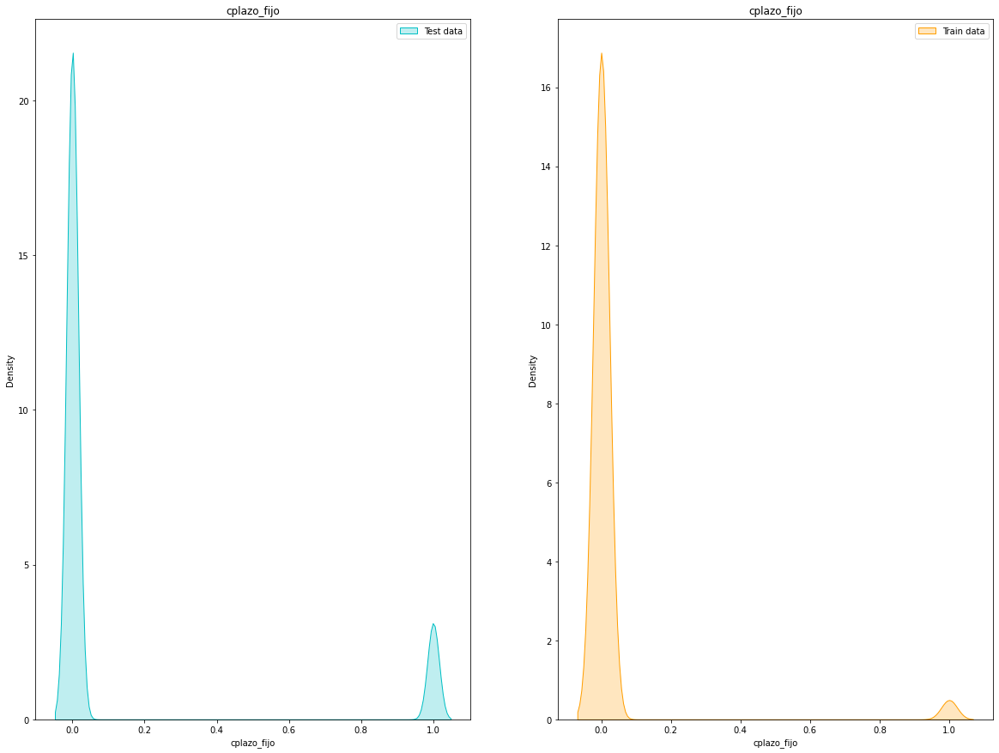

Variable: cplazo_fijo
df_continua count   3686828.000
mean          0.227
std           1.003
min           0.000
25%           0.000
50%           0.000
75%           0.000
max         160.000
Name: cplazo_fijo, dtype: float64
df_bajas count   19618.000
mean        0.038
std         0.265
min         0.000
25%         0.000
50%         0.000
75%         0.000
max         7.000
Name: cplazo_fijo, dtype: float64


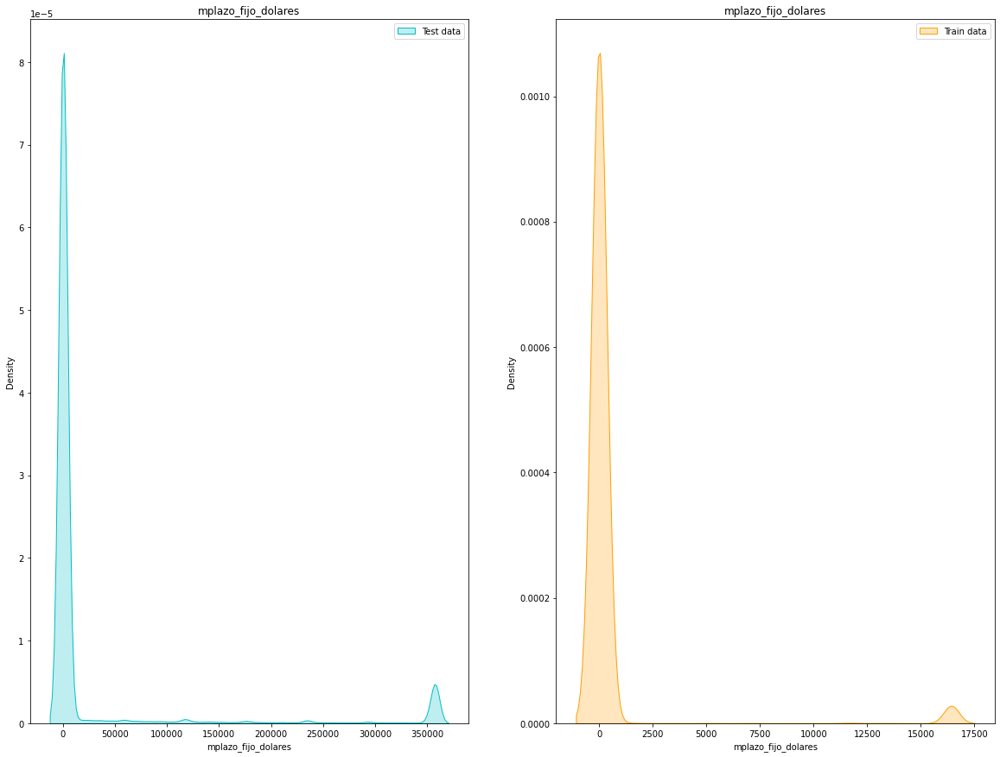

Variable: mplazo_fijo_dolares
df_continua count    3686828.000
mean       79105.202
std       530364.643
min            0.000
25%            0.000
50%            0.000
75%            0.000
max     97160045.380
Name: mplazo_fijo_dolares, dtype: float64
df_bajas count     19618.000
mean      14408.195
std      175393.012
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     9325350.000
Name: mplazo_fijo_dolares, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


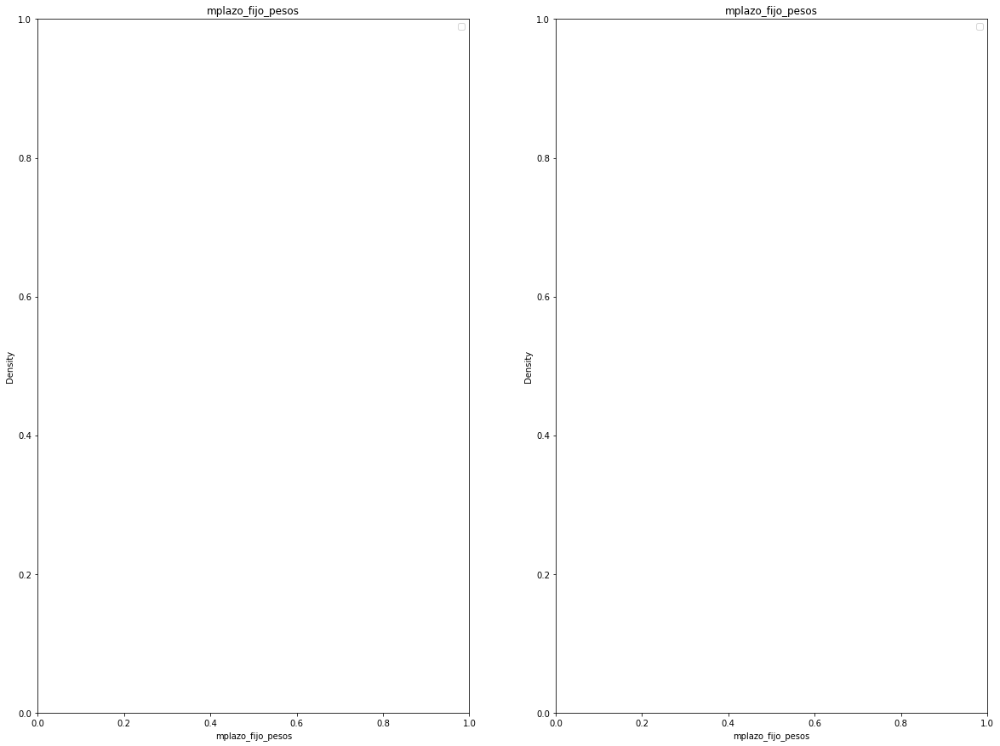

Variable: mplazo_fijo_pesos
df_continua count    3686828.000
mean        4956.996
std       178499.340
min            0.000
25%            0.000
50%            0.000
75%            0.000
max     38370424.890
Name: mplazo_fijo_pesos, dtype: float64
df_bajas count     19618.000
mean        585.864
std       36188.932
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     3633392.530
Name: mplazo_fijo_pesos, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


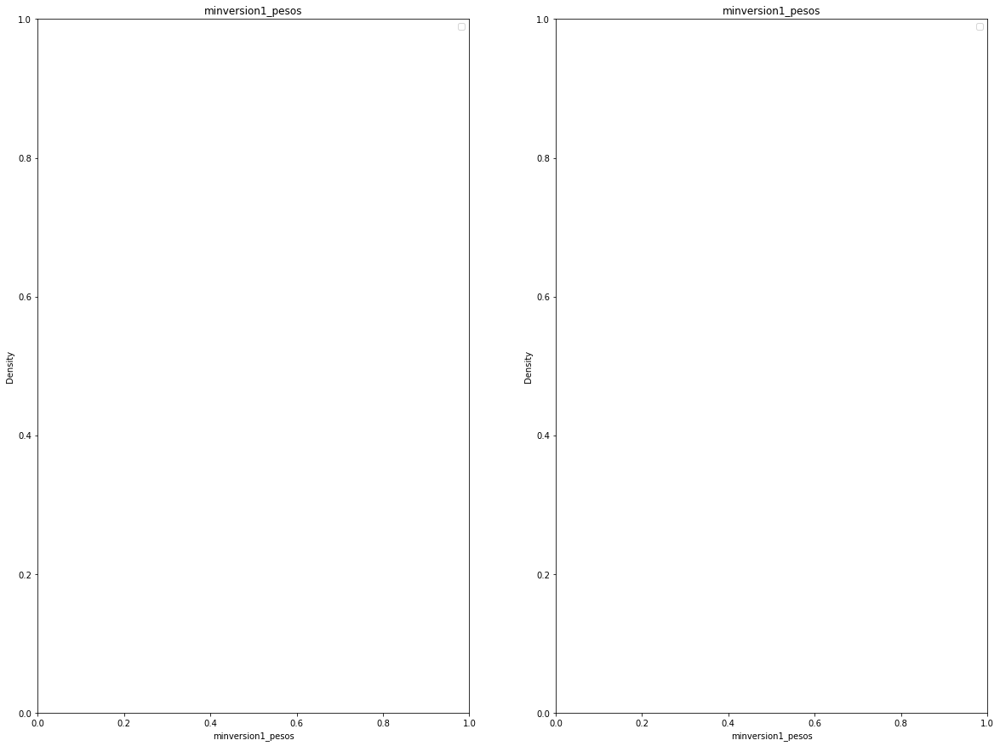

Variable: minversion1_pesos
df_continua count     3686828.000
mean        17252.329
std        362940.013
min             0.000
25%             0.000
50%             0.000
75%             0.000
max     179938199.980
Name: minversion1_pesos, dtype: float64
df_bajas count     19618.000
mean        979.125
std       22784.505
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     1892061.430
Name: minversion1_pesos, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


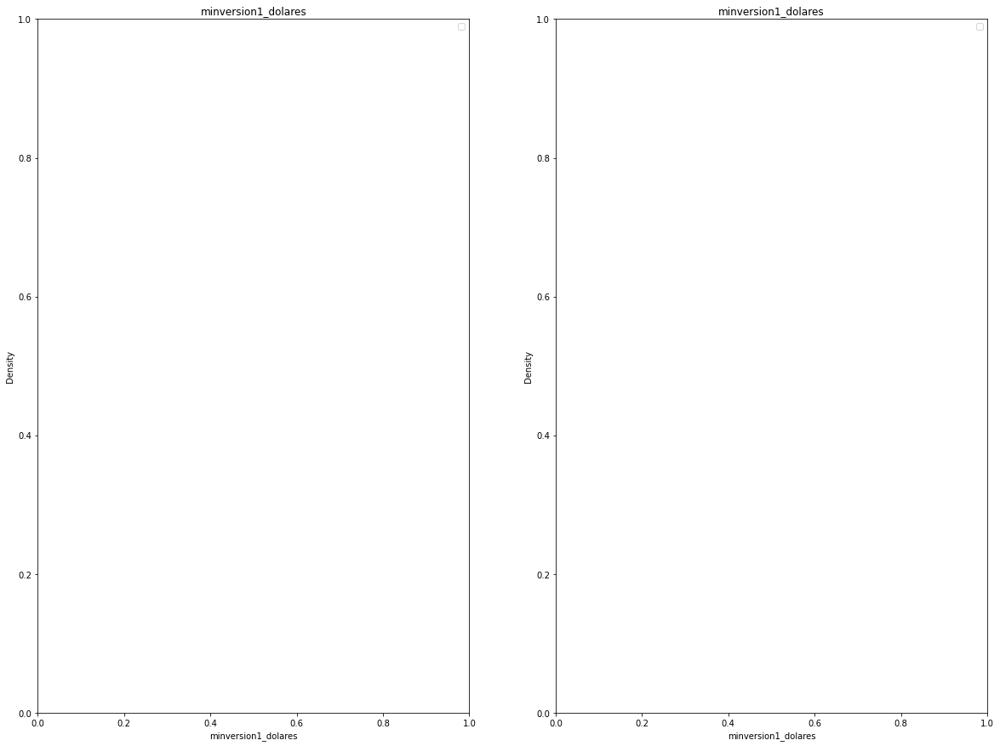

Variable: minversion1_dolares
df_continua count     3686828.000
mean         7097.894
std        321029.637
min             0.000
25%             0.000
50%             0.000
75%             0.000
max     155073551.170
Name: minversion1_dolares, dtype: float64
df_bajas count     19618.000
mean        613.341
std       33953.779
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     3102937.630
Name: minversion1_dolares, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


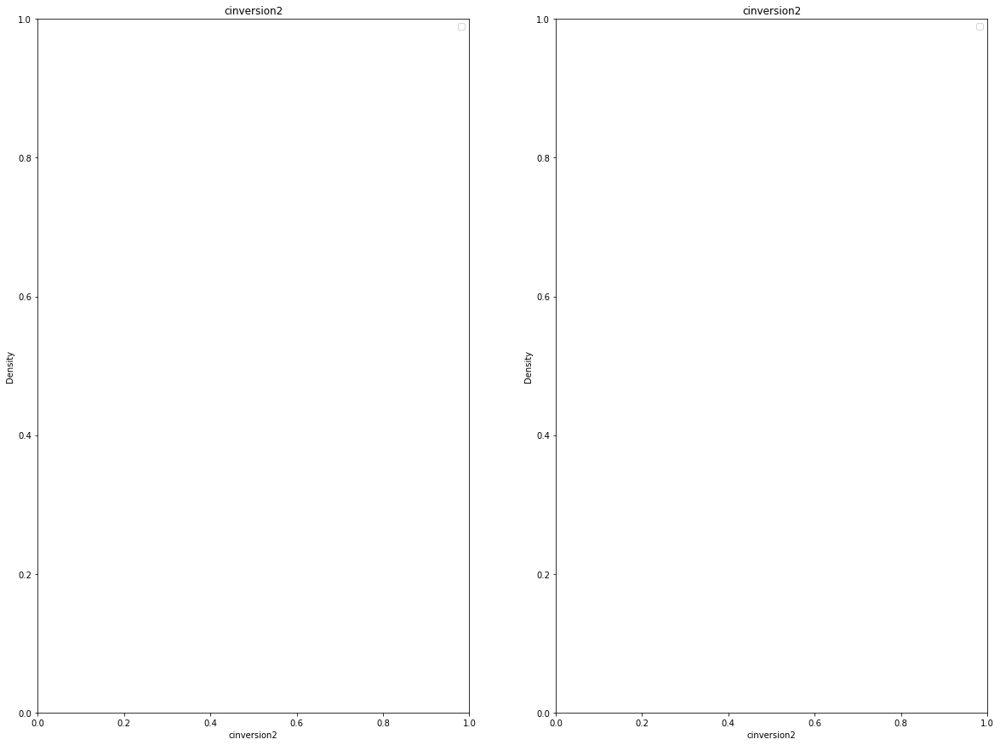

Variable: cinversion2
df_continua count   3686828.000
mean          0.114
std           0.990
min           0.000
25%           0.000
50%           0.000
75%           0.000
max         130.000
Name: cinversion2, dtype: float64
df_bajas count   19618.000
mean        0.026
std         0.388
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        40.000
Name: cinversion2, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


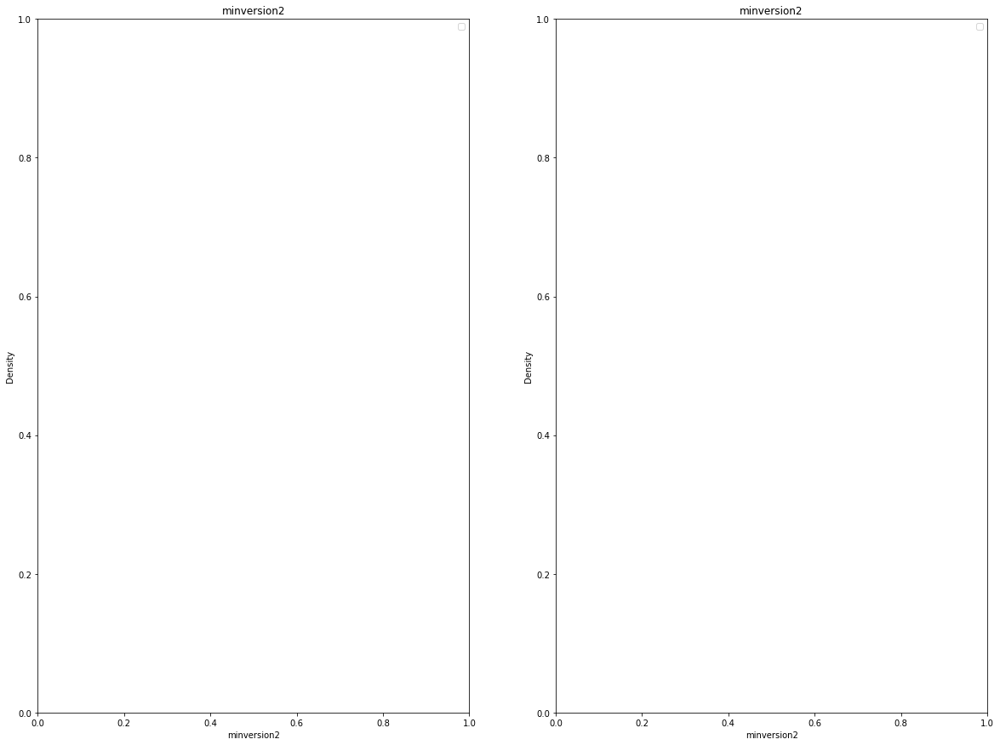

Variable: minversion2
df_continua count     3686828.000
mean        44334.709
std       1157318.320
min             0.000
25%             0.000
50%             0.000
75%             0.000
max     322798259.940
Name: minversion2, dtype: float64
df_bajas count      19618.000
mean        6131.719
std       251614.979
min            0.000
25%            0.000
50%            0.000
75%            0.000
max     22898093.070
Name: minversion2, dtype: float64


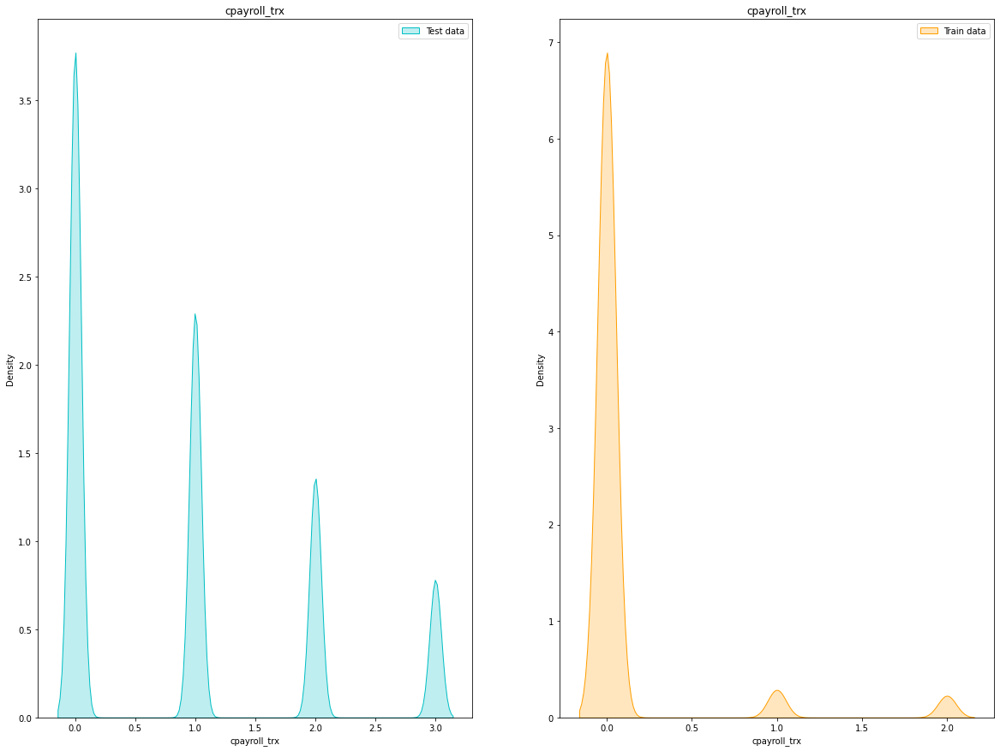

Variable: cpayroll_trx
df_continua count   3686828.000
mean          0.978
std           1.369
min           0.000
25%           0.000
50%           1.000
75%           2.000
max         209.000
Name: cpayroll_trx, dtype: float64
df_bajas count   19618.000
mean        0.121
std         0.535
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        11.000
Name: cpayroll_trx, dtype: float64


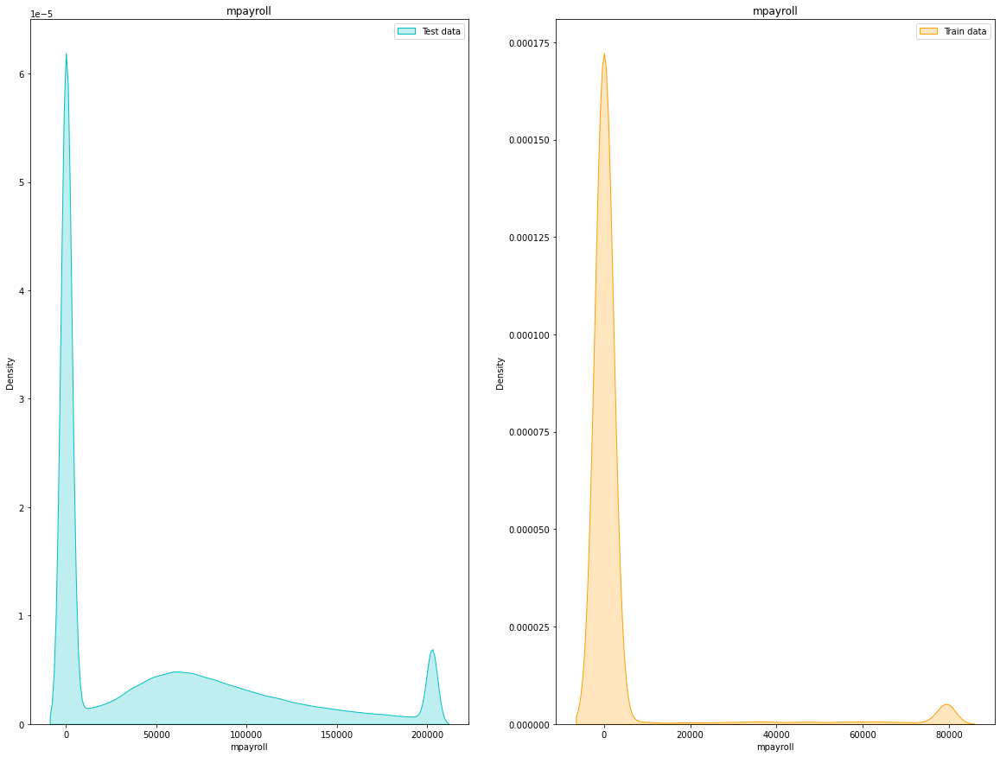

Variable: mpayroll
df_continua count    3686828.000
mean       60752.848
std       201536.305
min      -741911.760
25%            0.000
50%        24719.800
75%        86552.628
max     86228733.780
Name: mpayroll, dtype: float64
df_bajas count     19618.000
mean       6921.331
std       75297.538
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     7967378.450
Name: mpayroll, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


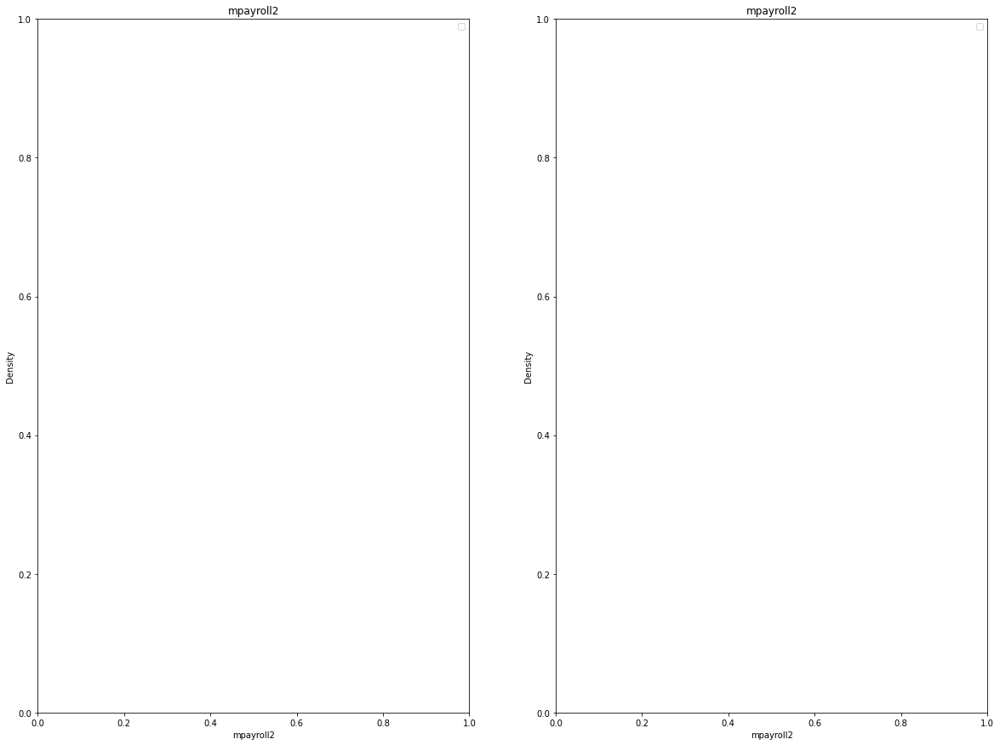

Variable: mpayroll2
df_continua count   3686828.000
mean        121.868
std        6184.271
min     -857593.070
25%           0.000
50%           0.000
75%           0.000
max     3669144.000
Name: mpayroll2, dtype: float64
df_bajas count     19618.000
mean         -3.106
std        1965.383
min     -245249.380
25%           0.000
50%           0.000
75%           0.000
max       92807.760
Name: mpayroll2, dtype: float64


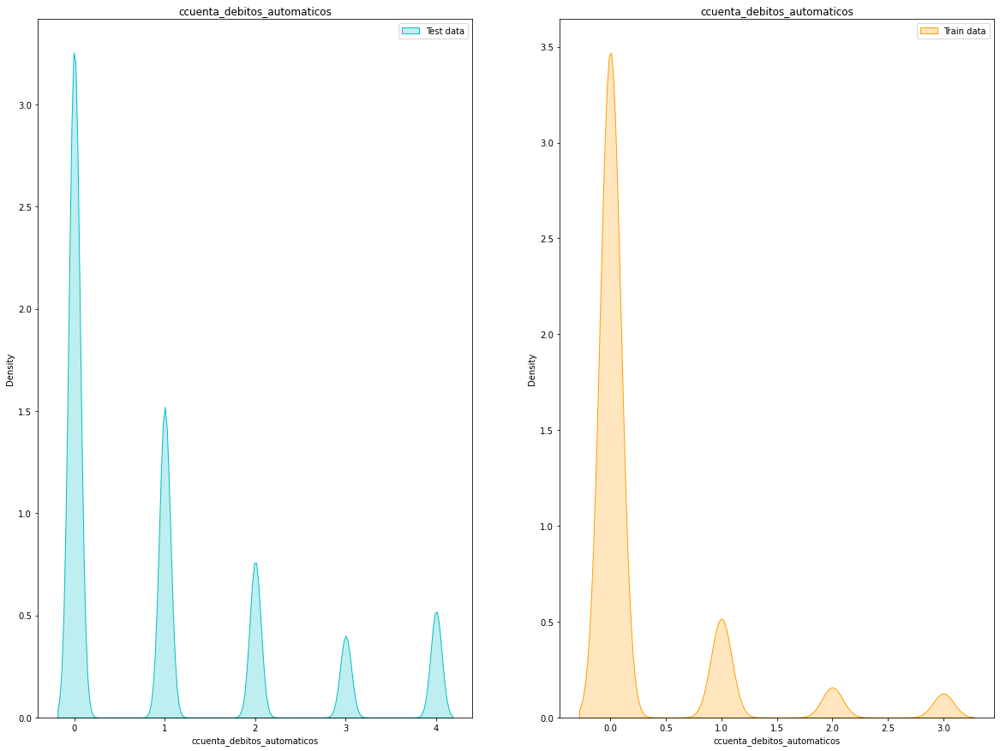

Variable: ccuenta_debitos_automaticos
df_continua count   3686828.000
mean          1.109
std           1.842
min           0.000
25%           0.000
50%           0.000
75%           2.000
max         272.000
Name: ccuenta_debitos_automaticos, dtype: float64
df_bajas count   19618.000
mean        0.324
std         0.960
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        24.000
Name: ccuenta_debitos_automaticos, dtype: float64


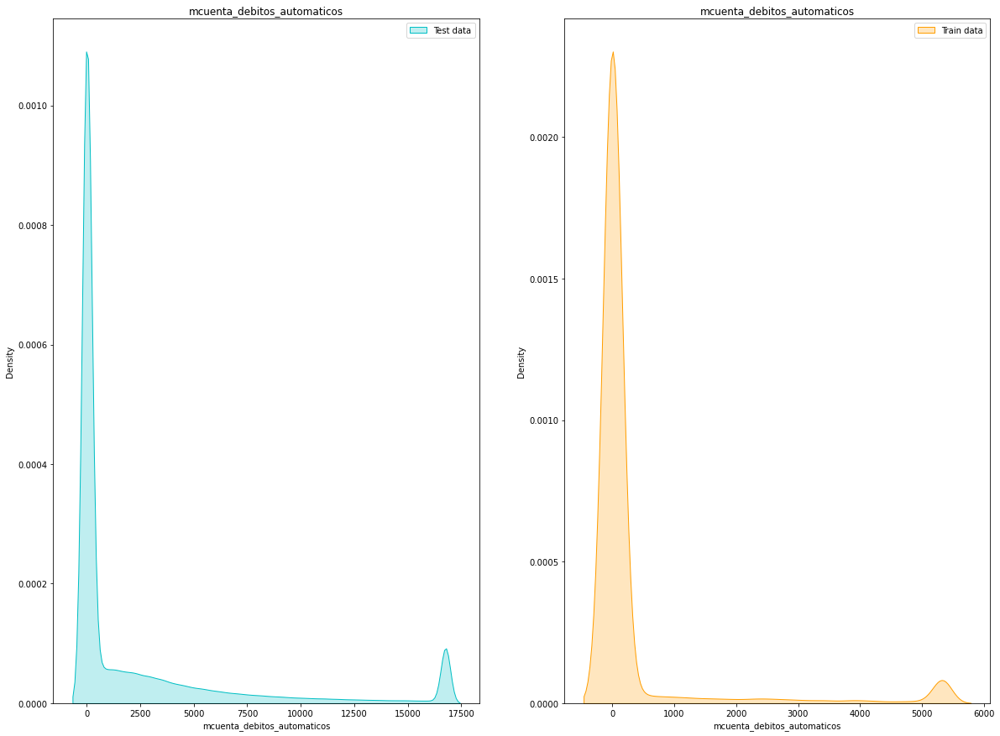

Variable: mcuenta_debitos_automaticos
df_continua count    3686828.000
mean        3927.848
std        61945.686
min            0.000
25%            0.000
50%            0.000
75%         2716.375
max     41894704.960
Name: mcuenta_debitos_automaticos, dtype: float64
df_bajas count     19618.000
mean        749.070
std       10689.676
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     1106372.130
Name: mcuenta_debitos_automaticos, dtype: float64


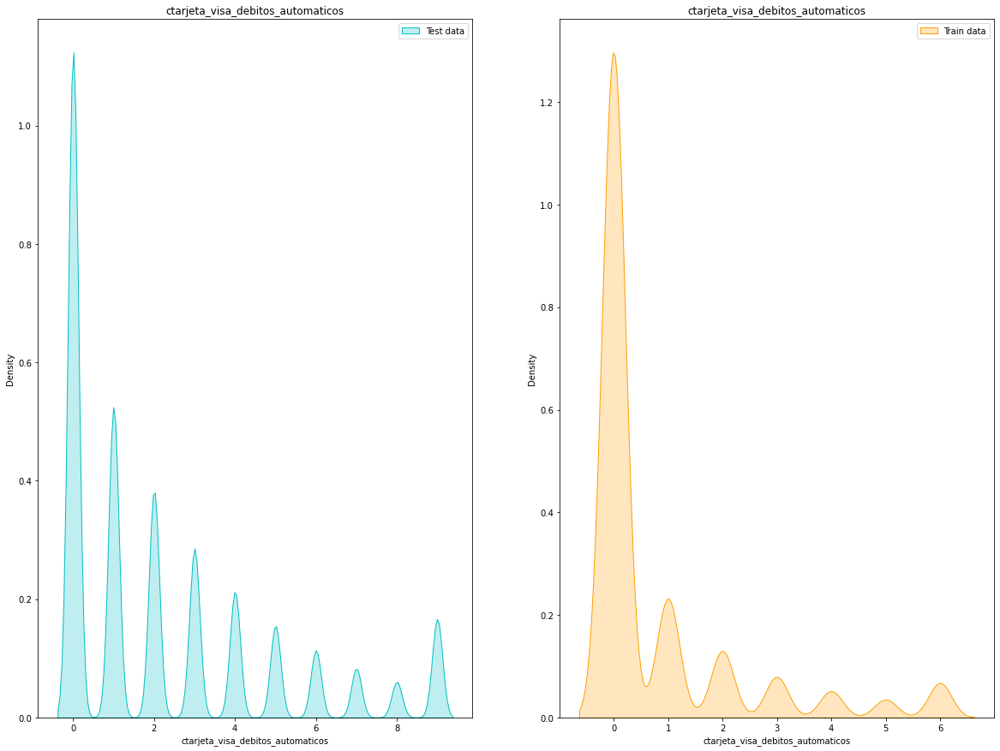

Variable: ctarjeta_visa_debitos_automaticos
df_continua count   3686828.000
mean          2.415
std           3.195
min           0.000
25%           0.000
50%           1.000
75%           4.000
max          72.000
Name: ctarjeta_visa_debitos_automaticos, dtype: float64
df_bajas count   19618.000
mean        0.890
std         1.972
min         0.000
25%         0.000
50%         0.000
75%         1.000
max        39.000
Name: ctarjeta_visa_debitos_automaticos, dtype: float64


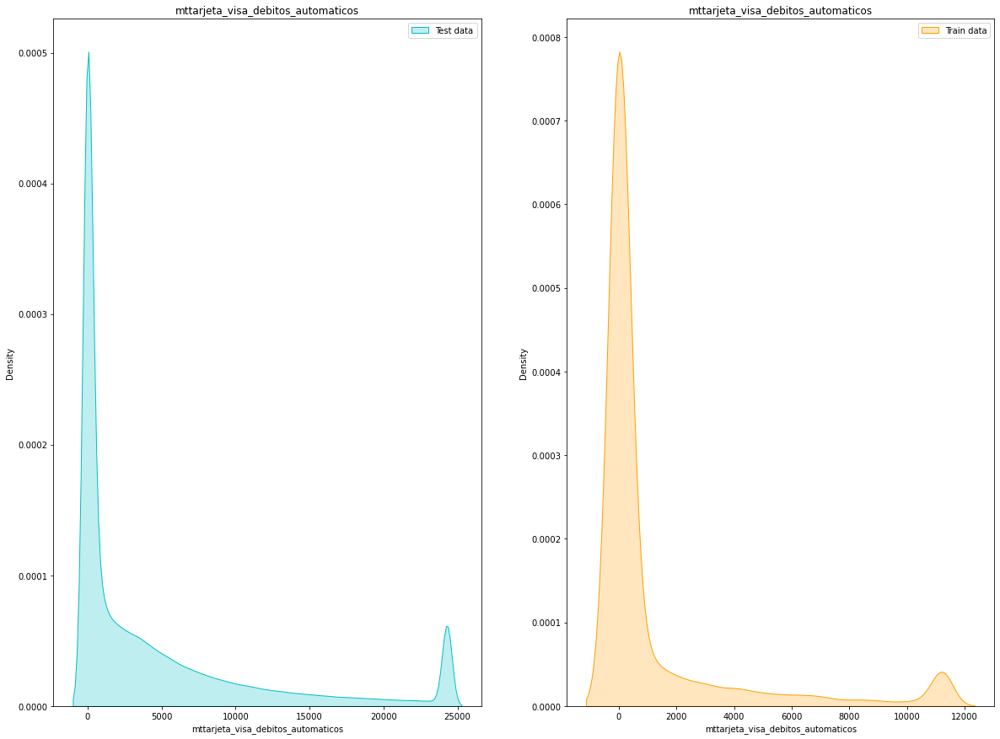

Variable: mttarjeta_visa_debitos_automaticos
df_continua count   3686828.000
mean       5485.638
std       10881.485
min           0.000
25%           0.000
50%        1304.510
75%        6385.810
max      531106.170
Name: mttarjeta_visa_debitos_automaticos, dtype: float64
df_bajas count    19618.000
mean      1601.328
std       5186.773
min          0.000
25%          0.000
50%          0.000
75%        521.765
max     105173.490
Name: mttarjeta_visa_debitos_automaticos, dtype: float64


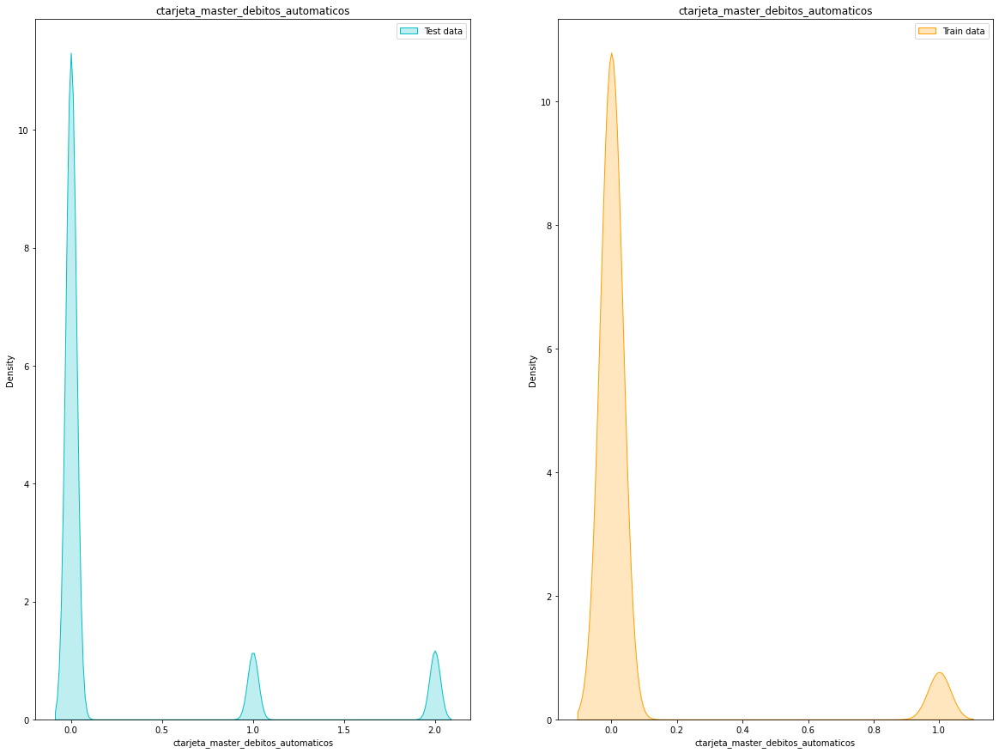

Variable: ctarjeta_master_debitos_automaticos
df_continua count   3686828.000
mean          0.389
std           1.216
min           0.000
25%           0.000
50%           0.000
75%           0.000
max         200.000
Name: ctarjeta_master_debitos_automaticos, dtype: float64
df_bajas count   19618.000
mean        0.127
std         0.621
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        12.000
Name: ctarjeta_master_debitos_automaticos, dtype: float64


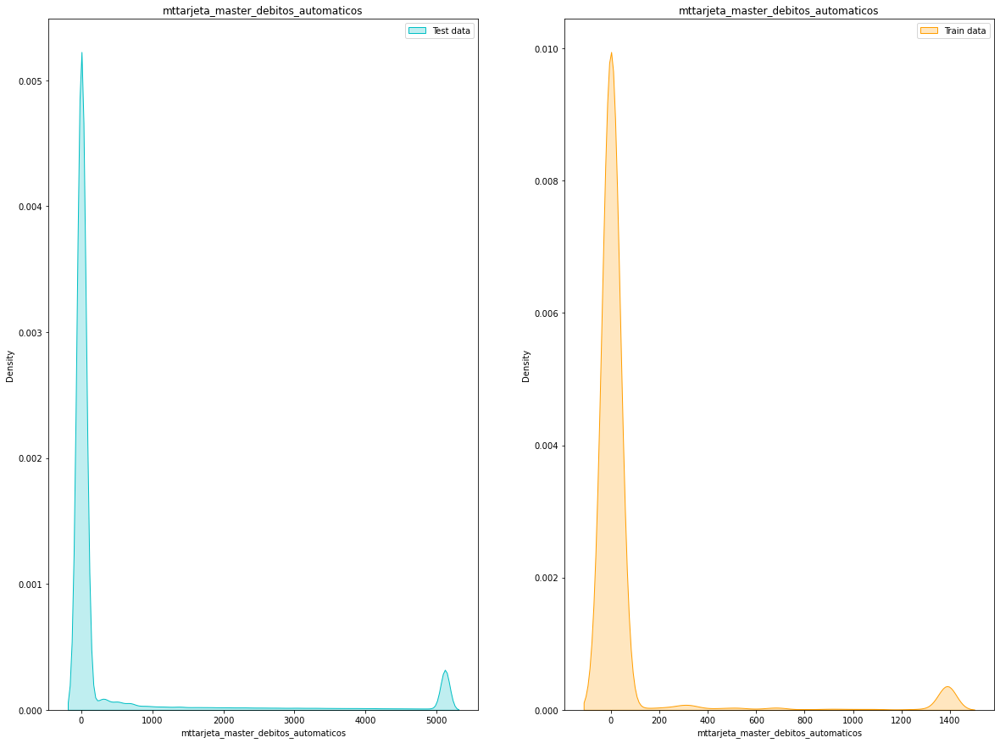

Variable: mttarjeta_master_debitos_automaticos
df_continua count   3686828.000
mean        931.881
std        4457.643
min           0.000
25%           0.000
50%           0.000
75%           0.000
max      931135.850
Name: mttarjeta_master_debitos_automaticos, dtype: float64
df_bajas count   19618.000
mean      241.475
std      1981.646
min         0.000
25%         0.000
50%         0.000
75%         0.000
max     83000.100
Name: mttarjeta_master_debitos_automaticos, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


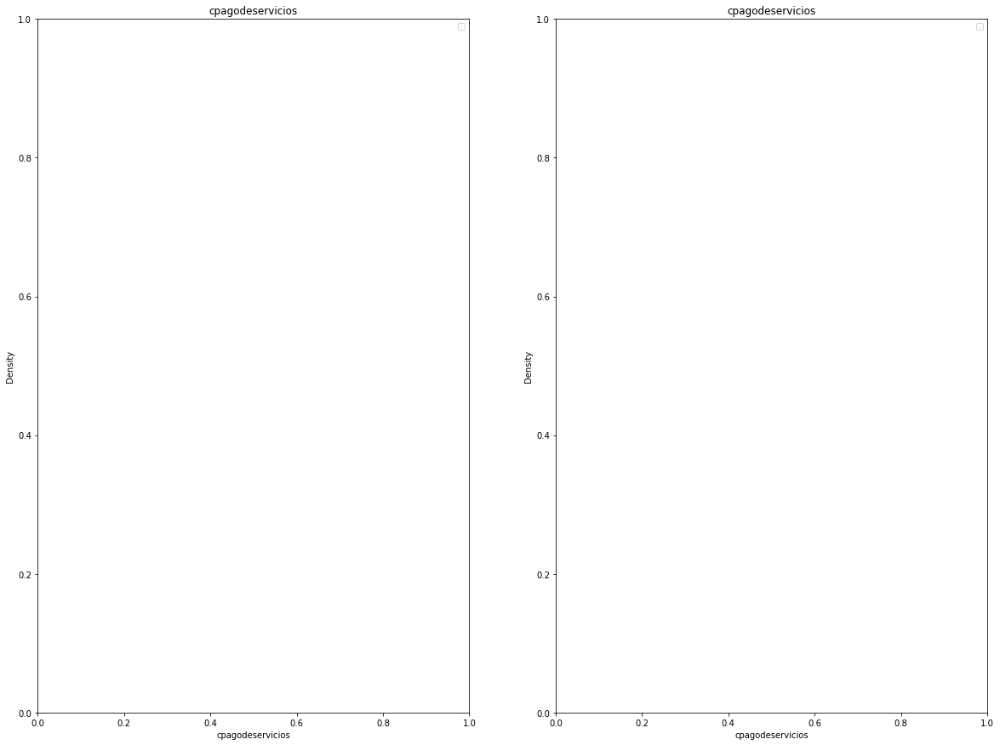

Variable: cpagodeservicios
df_continua count   3686828.000
mean          0.129
std           0.849
min           0.000
25%           0.000
50%           0.000
75%           0.000
max          71.000
Name: cpagodeservicios, dtype: float64
df_bajas count   19618.000
mean        0.026
std         0.340
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        13.000
Name: cpagodeservicios, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


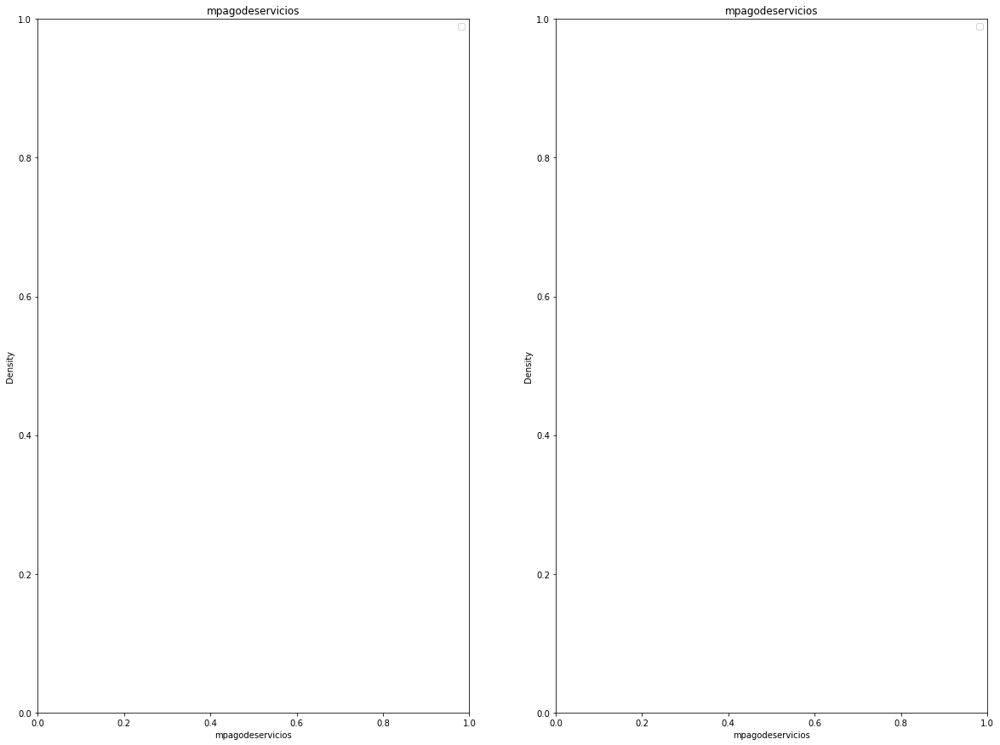

Variable: mpagodeservicios
df_continua count    3686828.000
mean         472.090
std        16227.471
min            0.000
25%            0.000
50%            0.000
75%            0.000
max     10176943.710
Name: mpagodeservicios, dtype: float64
df_bajas count    19618.000
mean        94.154
std       1953.488
min          0.000
25%          0.000
50%          0.000
75%          0.000
max     161799.310
Name: mpagodeservicios, dtype: float64


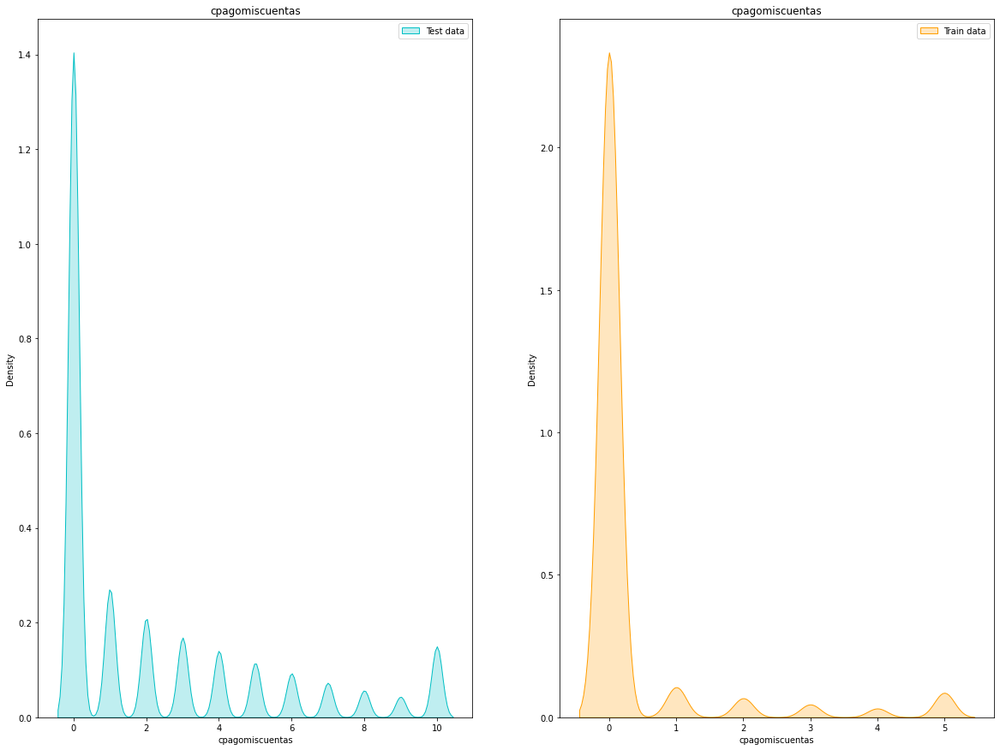

Variable: cpagomiscuentas
df_continua count   3686828.000
mean          2.332
std           3.984
min           0.000
25%           0.000
50%           0.000
75%           3.000
max         420.000
Name: cpagomiscuentas, dtype: float64
df_bajas count   19618.000
mean        0.454
std         2.006
min         0.000
25%         0.000
50%         0.000
75%         0.000
max       146.000
Name: cpagomiscuentas, dtype: float64


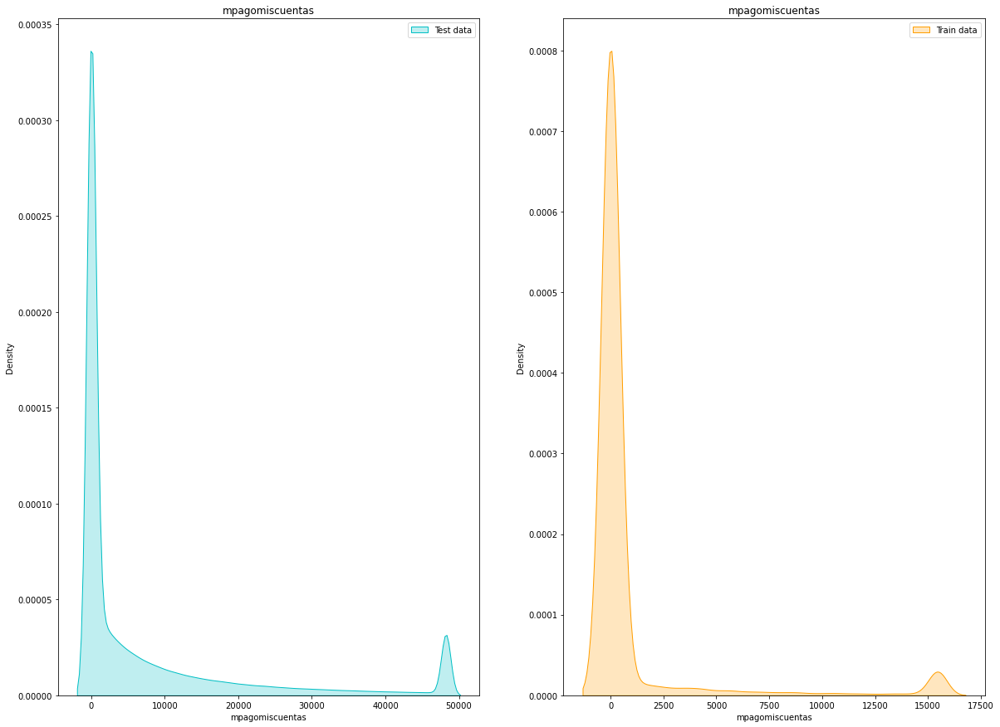

Variable: mpagomiscuentas
df_continua count     3686828.000
mean        12742.619
std        185467.879
min             0.000
25%             0.000
50%             0.000
75%          8477.783
max     149527175.220
Name: mpagomiscuentas, dtype: float64
df_bajas count     19618.000
mean       2294.072
std       27062.356
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     2594254.610
Name: mpagomiscuentas, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


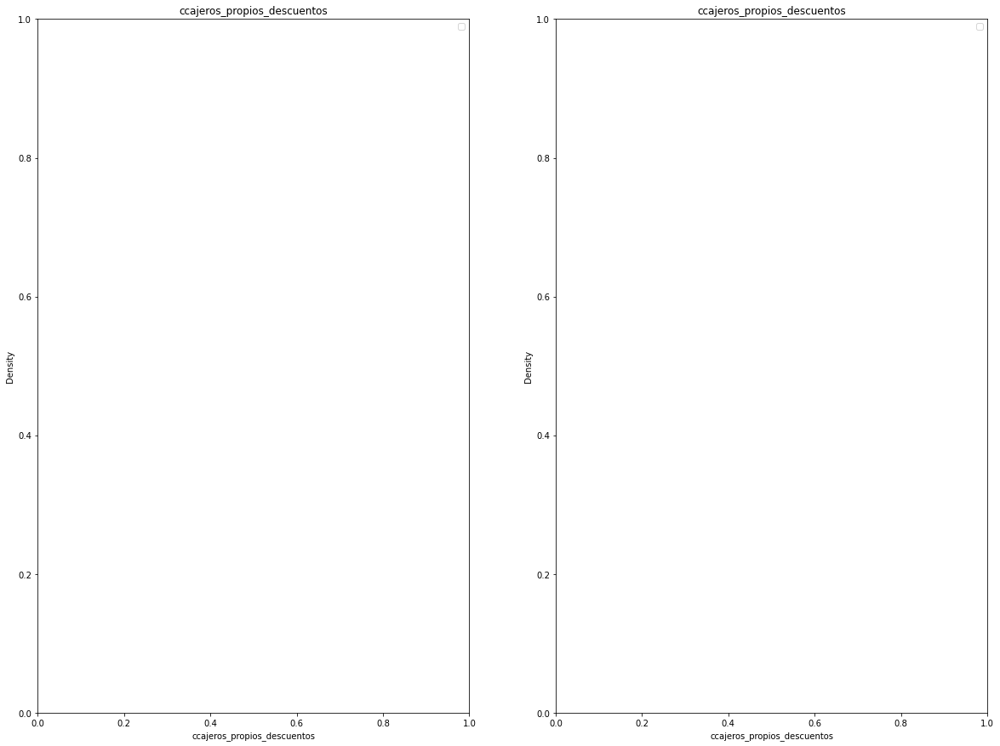

Variable: ccajeros_propios_descuentos
df_continua count   3686828.000
mean          0.076
std           0.512
min           0.000
25%           0.000
50%           0.000
75%           0.000
max          44.000
Name: ccajeros_propios_descuentos, dtype: float64
df_bajas count   19618.000
mean        0.012
std         0.182
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        10.000
Name: ccajeros_propios_descuentos, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


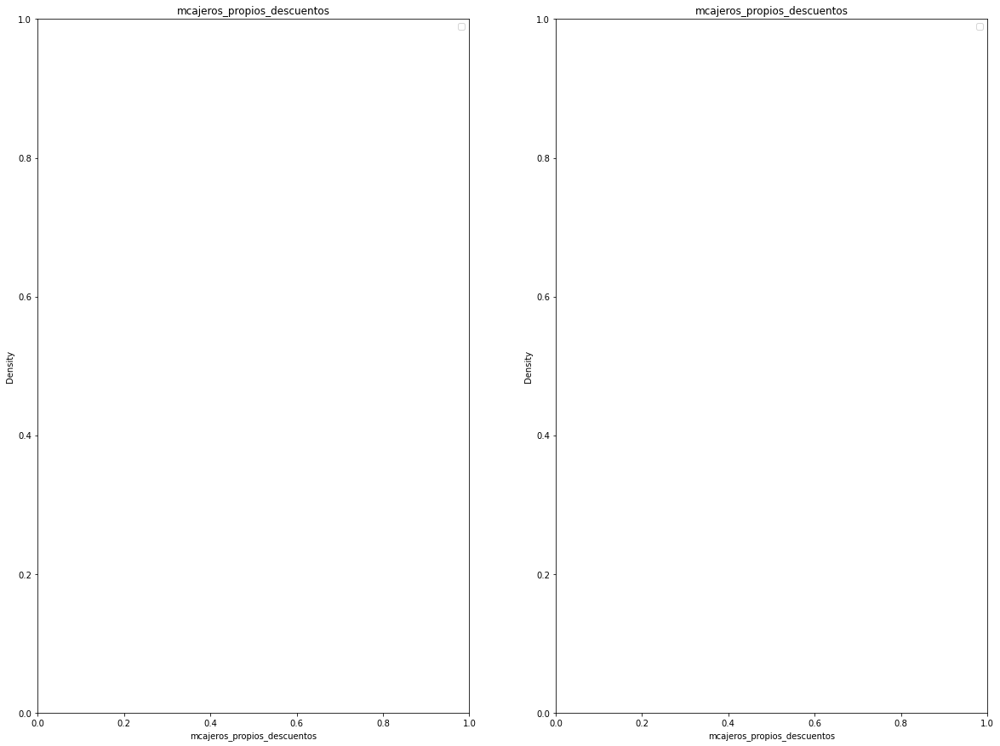

Variable: mcajeros_propios_descuentos
df_continua count   3686828.000
mean         18.940
std         177.060
min        -246.330
25%           0.000
50%           0.000
75%           0.000
max       53538.070
Name: mcajeros_propios_descuentos, dtype: float64
df_bajas count   19618.000
mean        2.990
std        62.108
min         0.000
25%         0.000
50%         0.000
75%         0.000
max      3869.840
Name: mcajeros_propios_descuentos, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


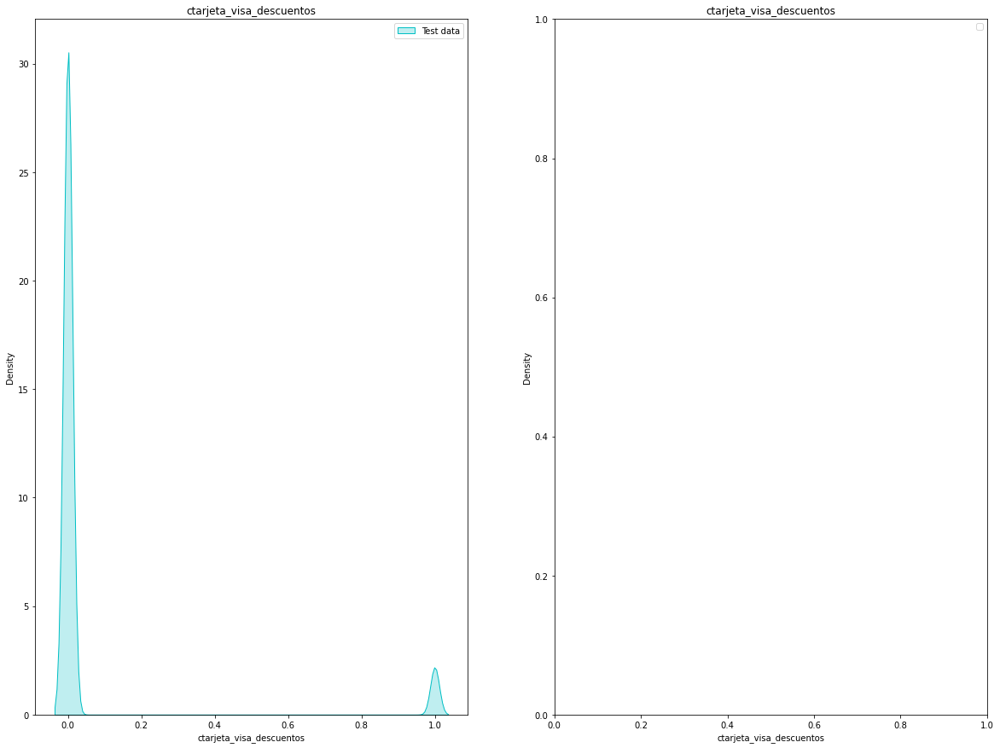

Variable: ctarjeta_visa_descuentos
df_continua count   3686828.000
mean          0.107
std           0.522
min           0.000
25%           0.000
50%           0.000
75%           0.000
max          57.000
Name: ctarjeta_visa_descuentos, dtype: float64
df_bajas count   19618.000
mean        0.018
std         0.190
min         0.000
25%         0.000
50%         0.000
75%         0.000
max         7.000
Name: ctarjeta_visa_descuentos, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


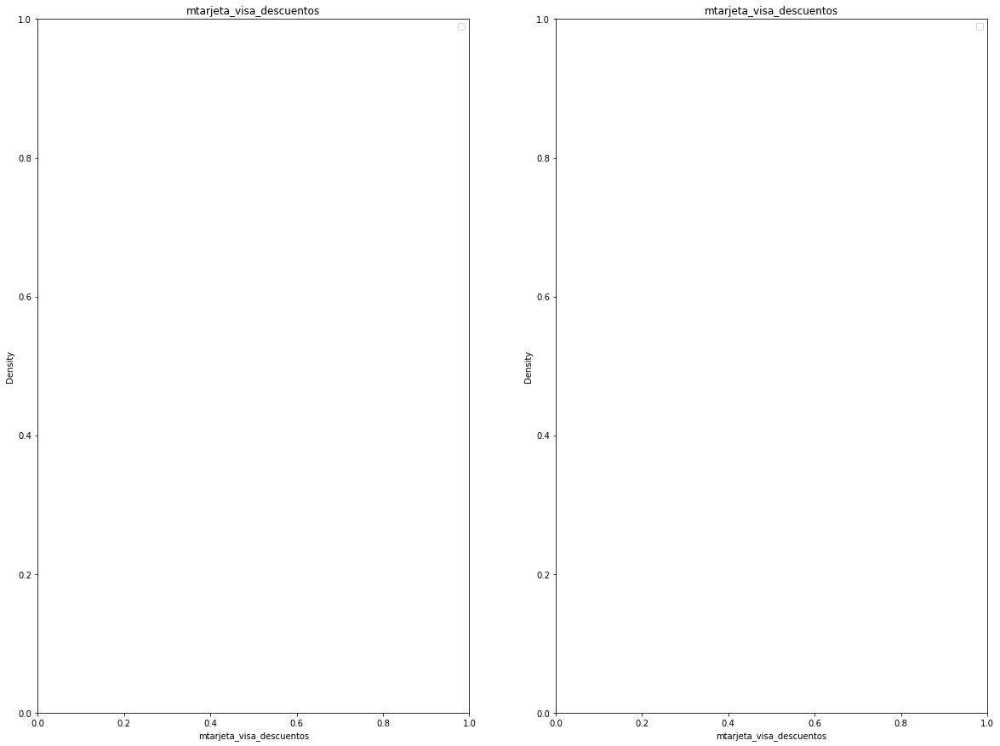

Variable: mtarjeta_visa_descuentos
df_continua count   3616133.000
mean         50.562
std         495.181
min           0.000
25%           0.000
50%           0.000
75%           0.000
max      118224.210
Name: mtarjeta_visa_descuentos, dtype: float64
df_bajas count   19541.000
mean       11.628
std       293.545
min         0.000
25%         0.000
50%         0.000
75%         0.000
max     27688.670
Name: mtarjeta_visa_descuentos, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


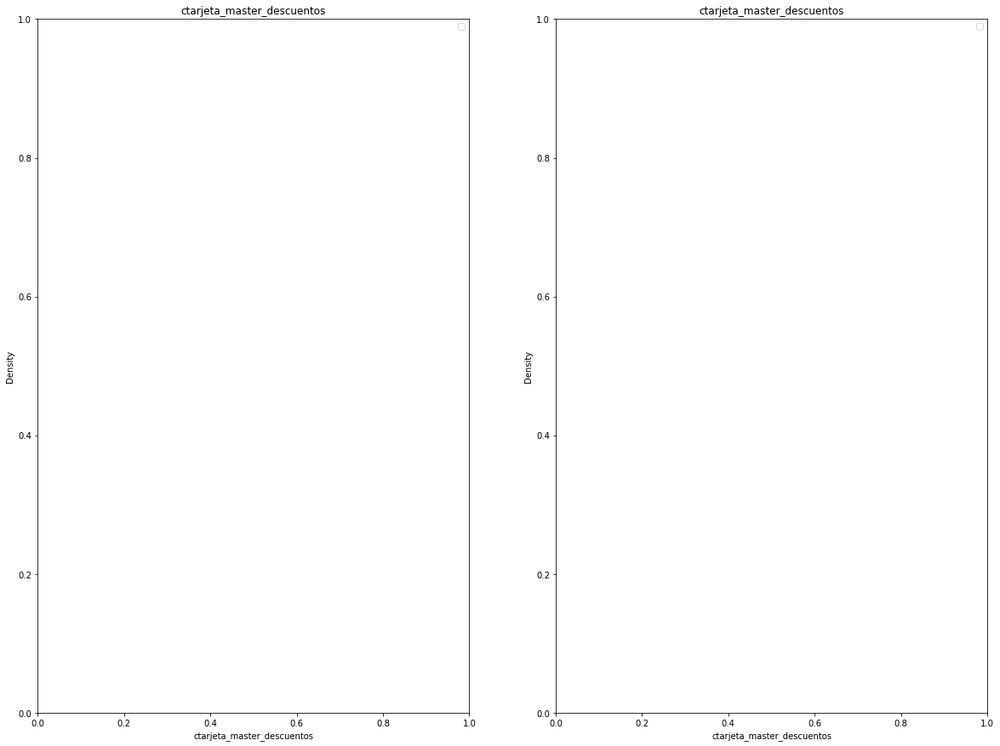

Variable: ctarjeta_master_descuentos
df_continua count   3686828.000
mean          0.063
std           0.508
min           0.000
25%           0.000
50%           0.000
75%           0.000
max          58.000
Name: ctarjeta_master_descuentos, dtype: float64
df_bajas count   19618.000
mean        0.015
std         0.244
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        14.000
Name: ctarjeta_master_descuentos, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


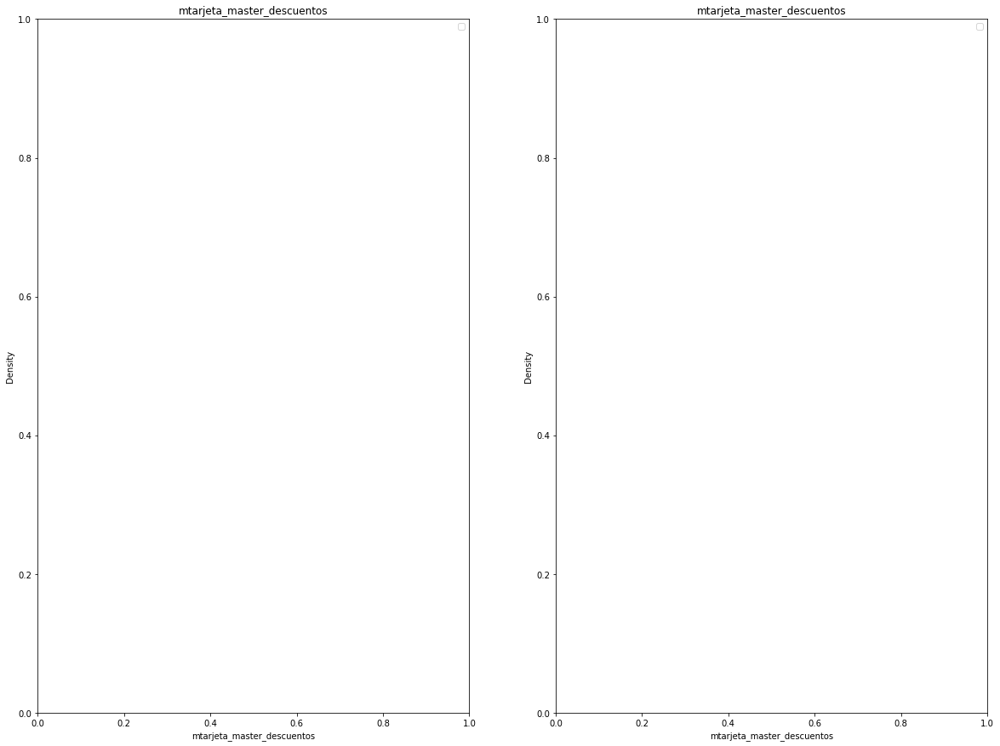

Variable: mtarjeta_master_descuentos
df_continua count   3624825.000
mean         15.906
std         297.420
min           0.000
25%           0.000
50%           0.000
75%           0.000
max      124292.830
Name: mtarjeta_master_descuentos, dtype: float64
df_bajas count   19528.000
mean        3.482
std       111.195
min         0.000
25%         0.000
50%         0.000
75%         0.000
max      9796.820
Name: mtarjeta_master_descuentos, dtype: float64


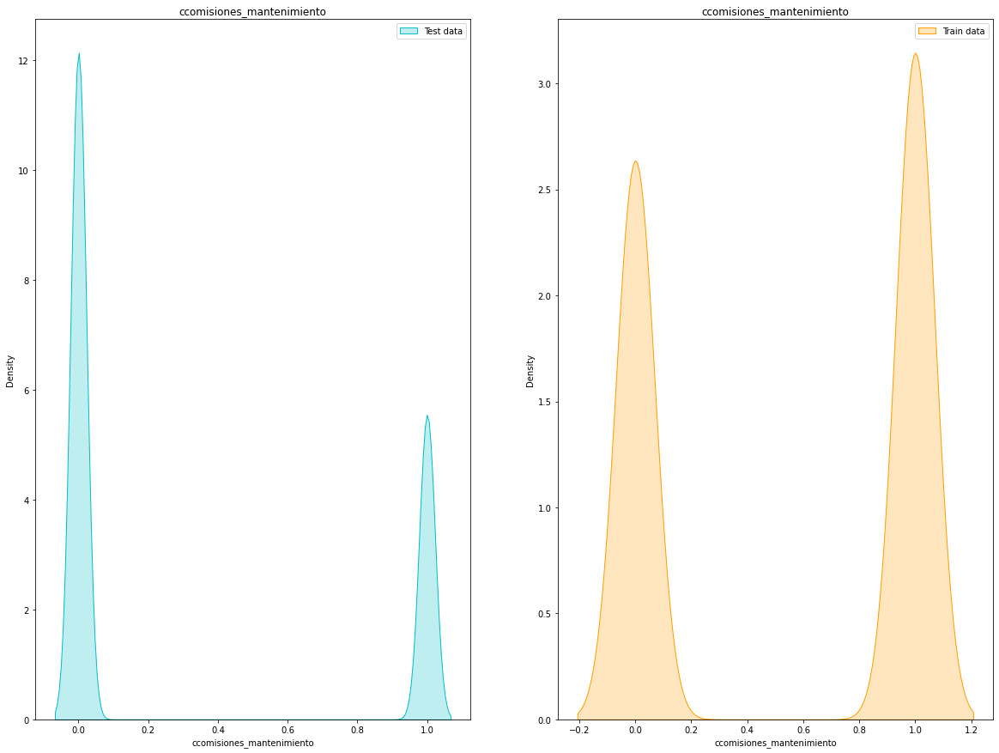

Variable: ccomisiones_mantenimiento
df_continua count   3686828.000
mean          0.334
std           0.563
min           0.000
25%           0.000
50%           0.000
75%           1.000
max         212.000
Name: ccomisiones_mantenimiento, dtype: float64
df_bajas count   19618.000
mean        0.581
std         0.634
min         0.000
25%         0.000
50%         1.000
75%         1.000
max        26.000
Name: ccomisiones_mantenimiento, dtype: float64


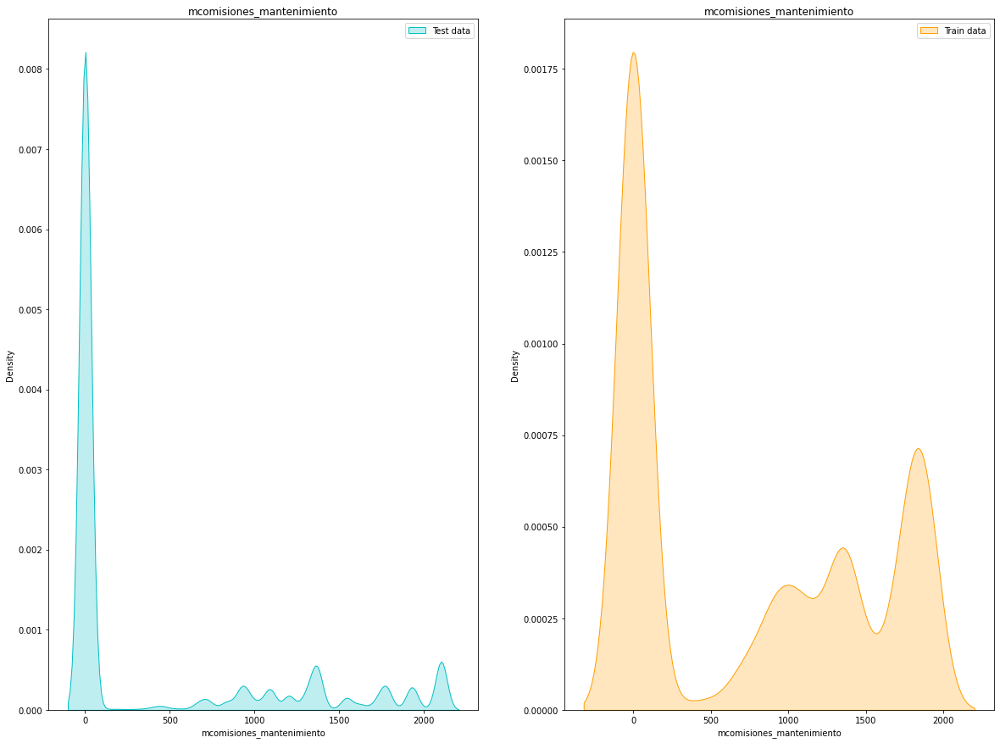

Variable: mcomisiones_mantenimiento
df_continua count   3686828.000
mean        432.208
std         839.800
min      -15756.950
25%           0.000
50%           0.000
75%         925.800
max       14832.100
Name: mcomisiones_mantenimiento, dtype: float64
df_bajas count   19618.000
mean      781.682
std       991.709
min     -9640.880
25%         0.000
50%       723.510
75%      1364.940
max      5749.820
Name: mcomisiones_mantenimiento, dtype: float64


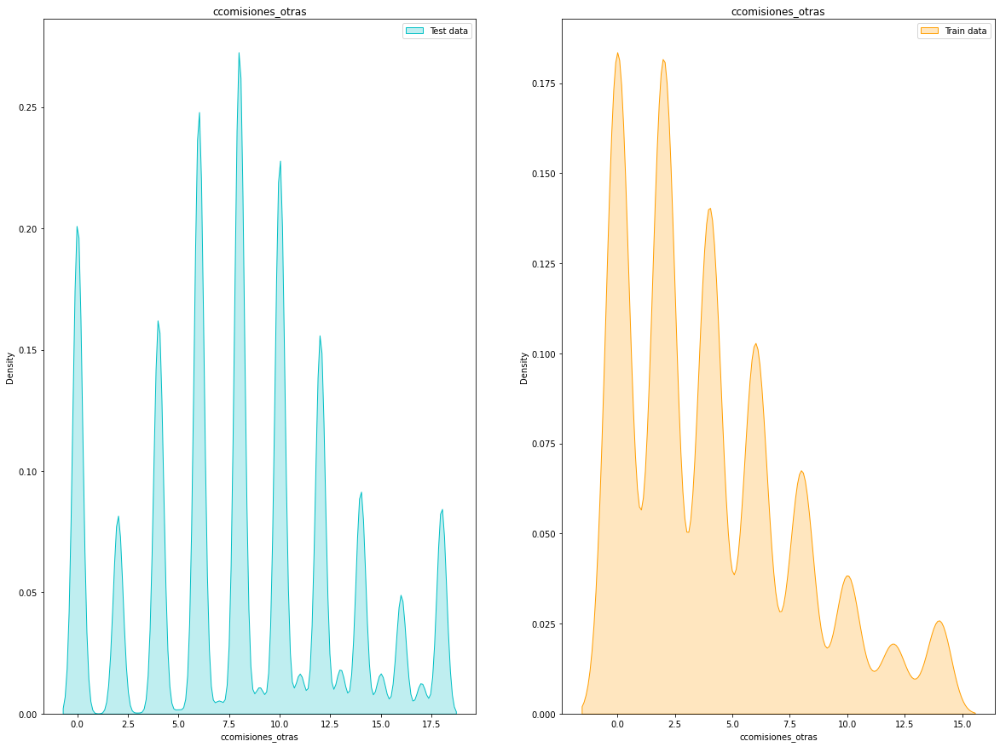

Variable: ccomisiones_otras
df_continua count   3686828.000
mean          8.380
std           7.707
min           0.000
25%           4.000
50%           8.000
75%          12.000
max         292.000
Name: ccomisiones_otras, dtype: float64
df_bajas count   19618.000
mean        4.204
std         4.208
min         0.000
25%         2.000
50%         4.000
75%         6.000
max       124.000
Name: ccomisiones_otras, dtype: float64


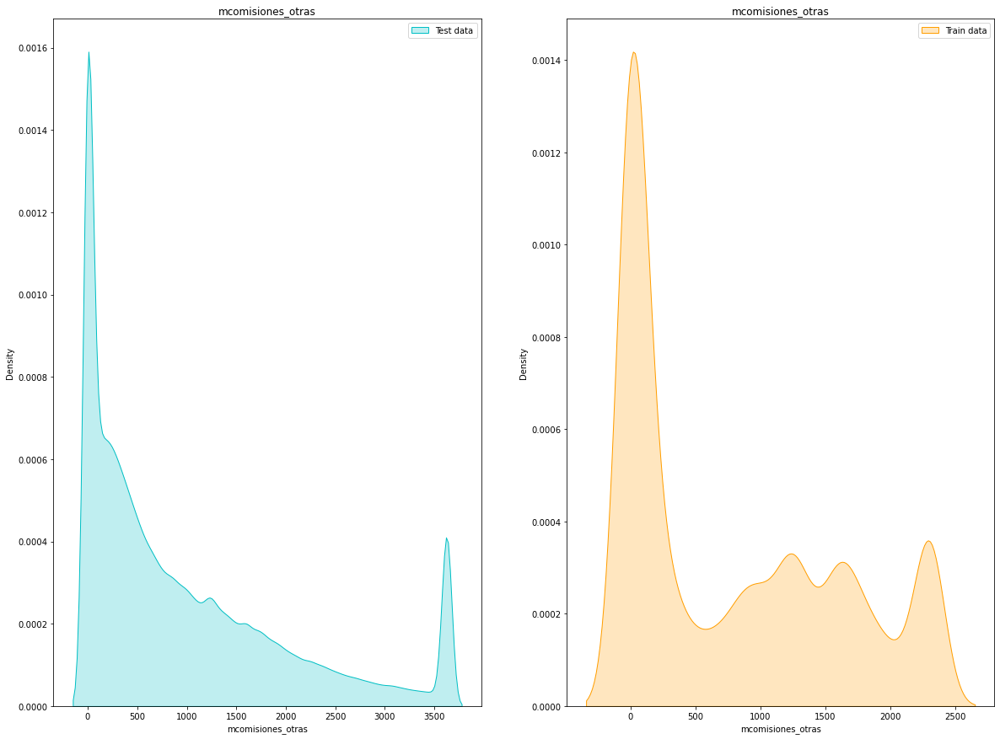

Variable: mcomisiones_otras
df_continua count    3686828.000
mean        1155.925
std         3001.534
min     -1953482.100
25%          145.990
50%          609.180
75%         1498.440
max      1959169.310
Name: mcomisiones_otras, dtype: float64
df_bajas count    19618.000
mean       927.049
std       2174.745
min      -8439.530
25%          0.000
50%        465.075
75%       1494.153
max     123410.700
Name: mcomisiones_otras, dtype: float64


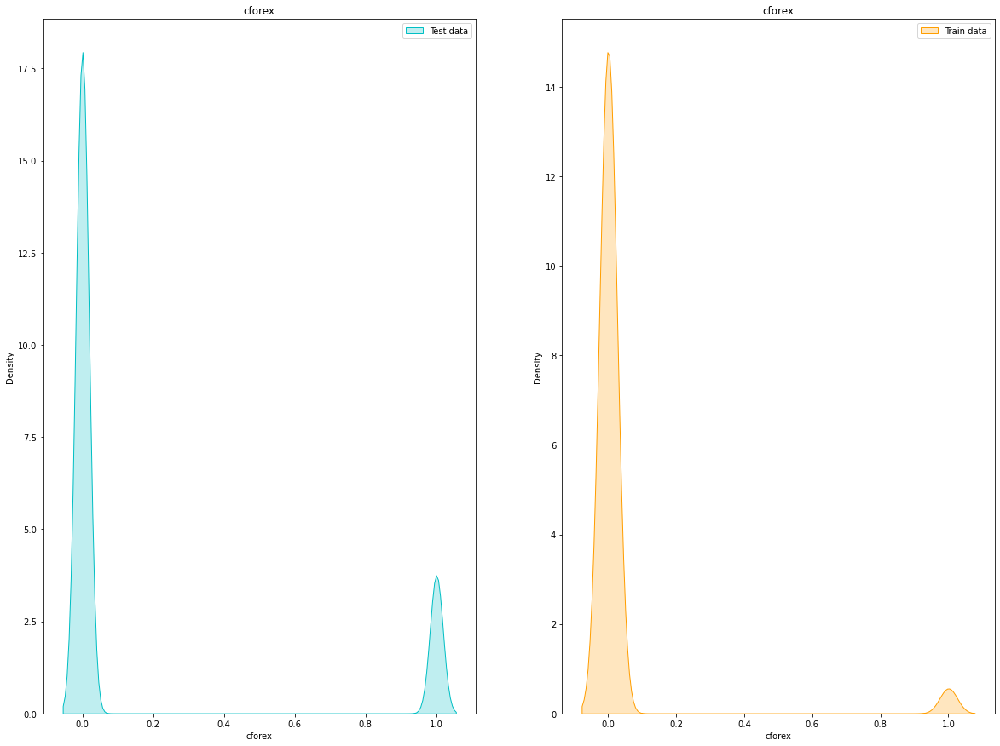

Variable: cforex
df_continua count   3686828.000
mean          0.241
std           0.692
min           0.000
25%           0.000
50%           0.000
75%           0.000
max          67.000
Name: cforex, dtype: float64
df_bajas count   19618.000
mean        0.050
std         0.312
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        10.000
Name: cforex, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


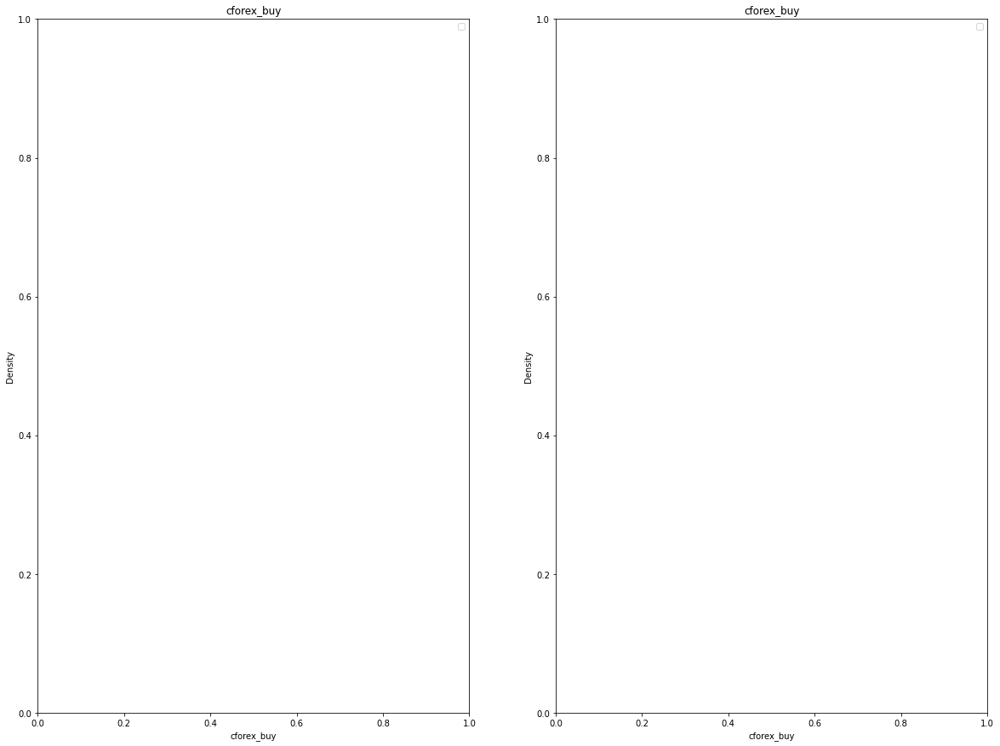

Variable: cforex_buy
df_continua count   3686828.000
mean          0.048
std           0.379
min           0.000
25%           0.000
50%           0.000
75%           0.000
max          45.000
Name: cforex_buy, dtype: float64
df_bajas count   19618.000
mean        0.017
std         0.211
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        10.000
Name: cforex_buy, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


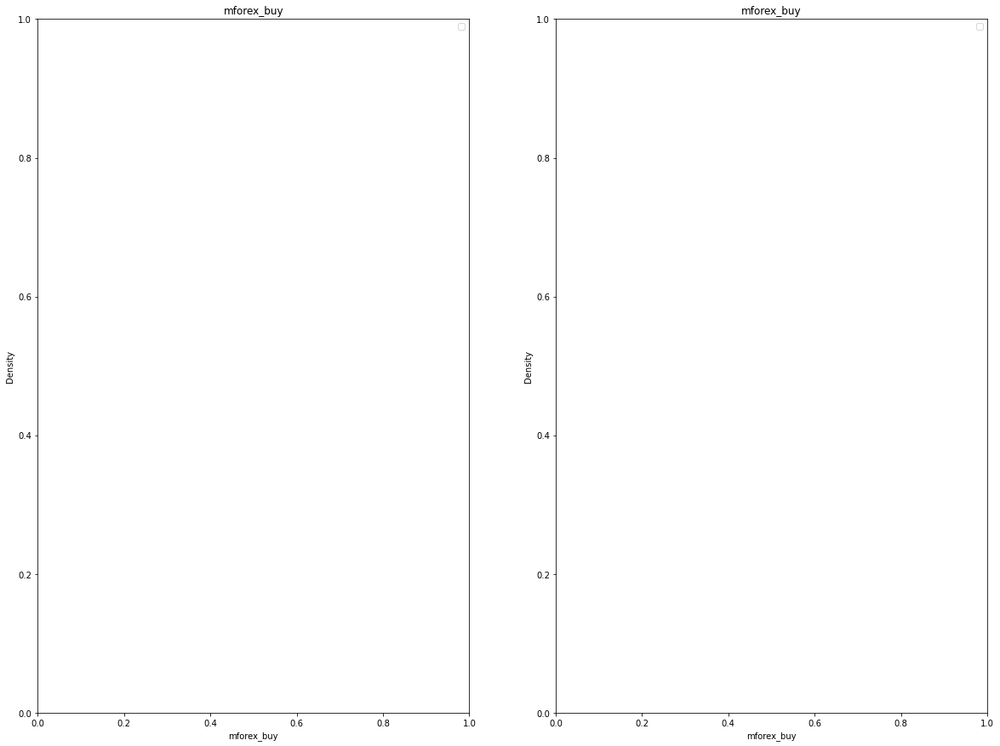

Variable: mforex_buy
df_continua count   3686828.000
mean         35.634
std         886.391
min           0.000
25%           0.000
50%           0.000
75%           0.000
max      802332.000
Name: mforex_buy, dtype: float64
df_bajas count   19618.000
mean        8.381
std       253.876
min         0.000
25%         0.000
50%         0.000
75%         0.000
max     25336.800
Name: mforex_buy, dtype: float64


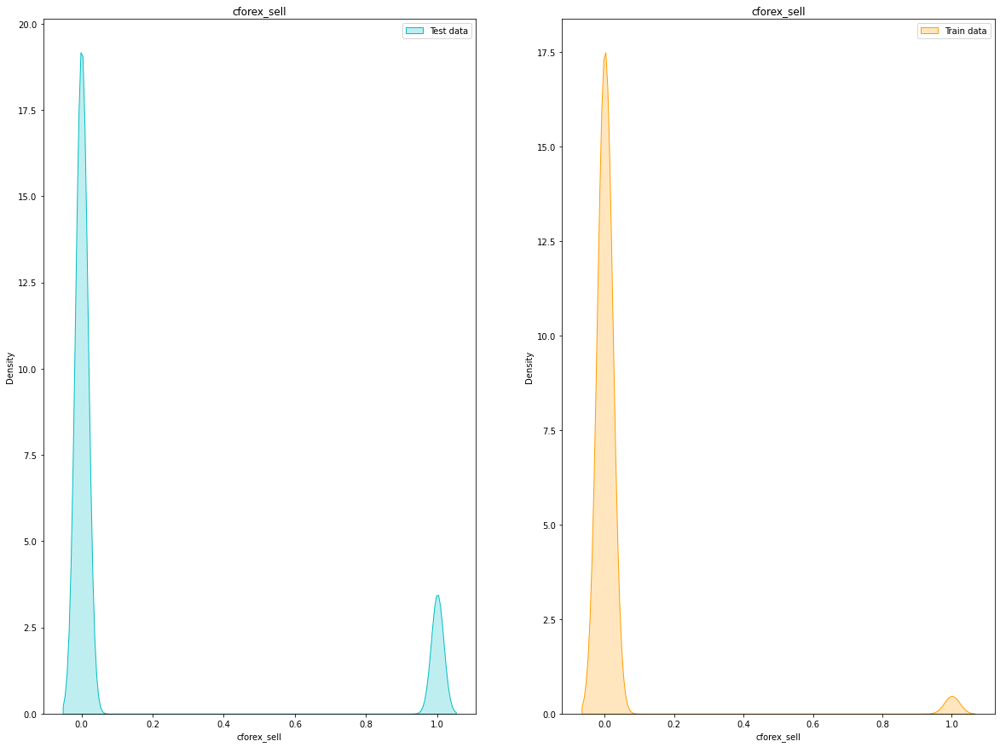

Variable: cforex_sell
df_continua count   3686828.000
mean          0.193
std           0.565
min           0.000
25%           0.000
50%           0.000
75%           0.000
max          67.000
Name: cforex_sell, dtype: float64
df_bajas count   19618.000
mean        0.032
std         0.225
min         0.000
25%         0.000
50%         0.000
75%         0.000
max         6.000
Name: cforex_sell, dtype: float64


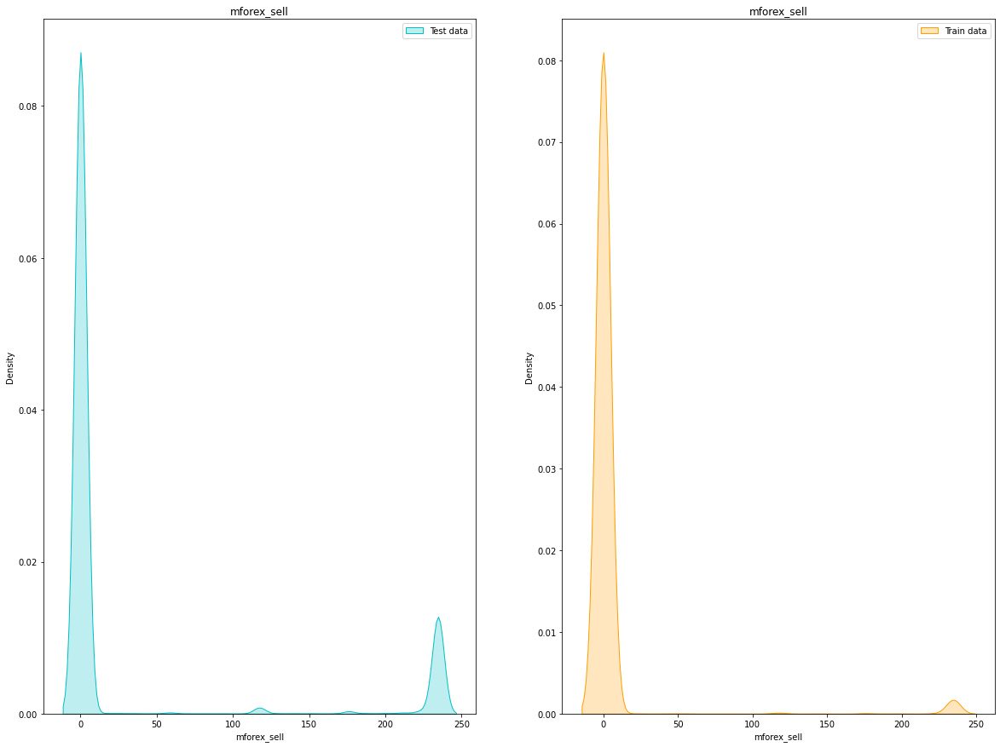

Variable: mforex_sell
df_continua count   3686828.000
mean        120.009
std        1415.343
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     1173000.000
Name: mforex_sell, dtype: float64
df_bajas count   19618.000
mean       30.827
std       982.257
min         0.000
25%         0.000
50%         0.000
75%         0.000
max     91494.000
Name: mforex_sell, dtype: float64


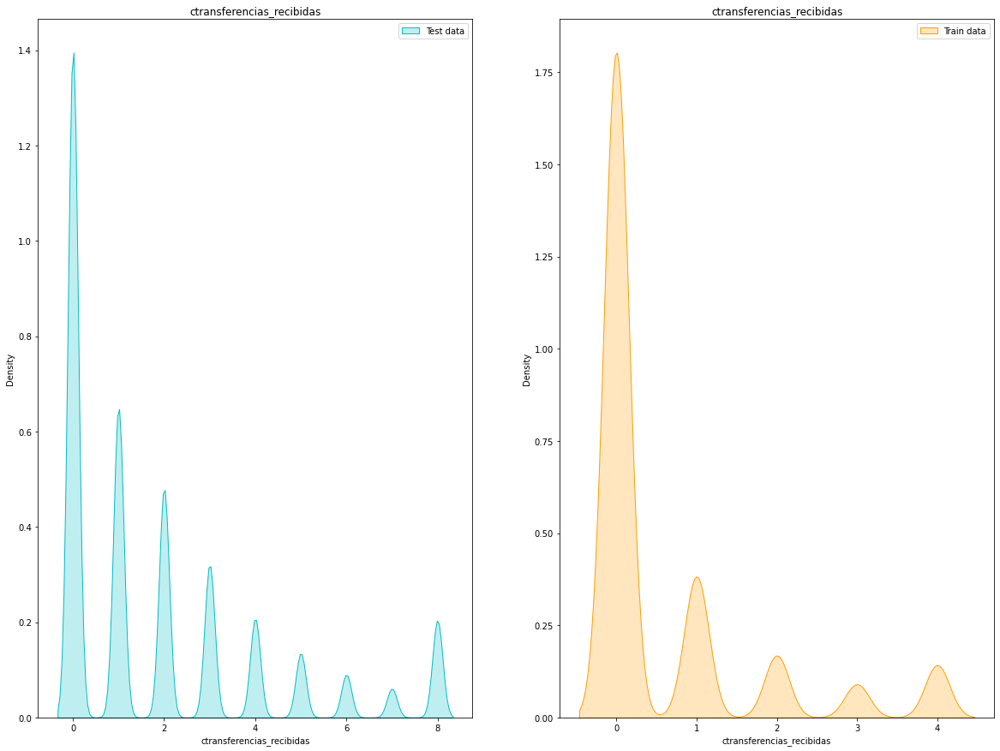

Variable: ctransferencias_recibidas
df_continua count   3686828.000
mean          2.404
std           7.984
min           0.000
25%           0.000
50%           1.000
75%           3.000
max        1484.000
Name: ctransferencias_recibidas, dtype: float64
df_bajas count   19618.000
mean        0.848
std         4.635
min         0.000
25%         0.000
50%         0.000
75%         1.000
max       444.000
Name: ctransferencias_recibidas, dtype: float64


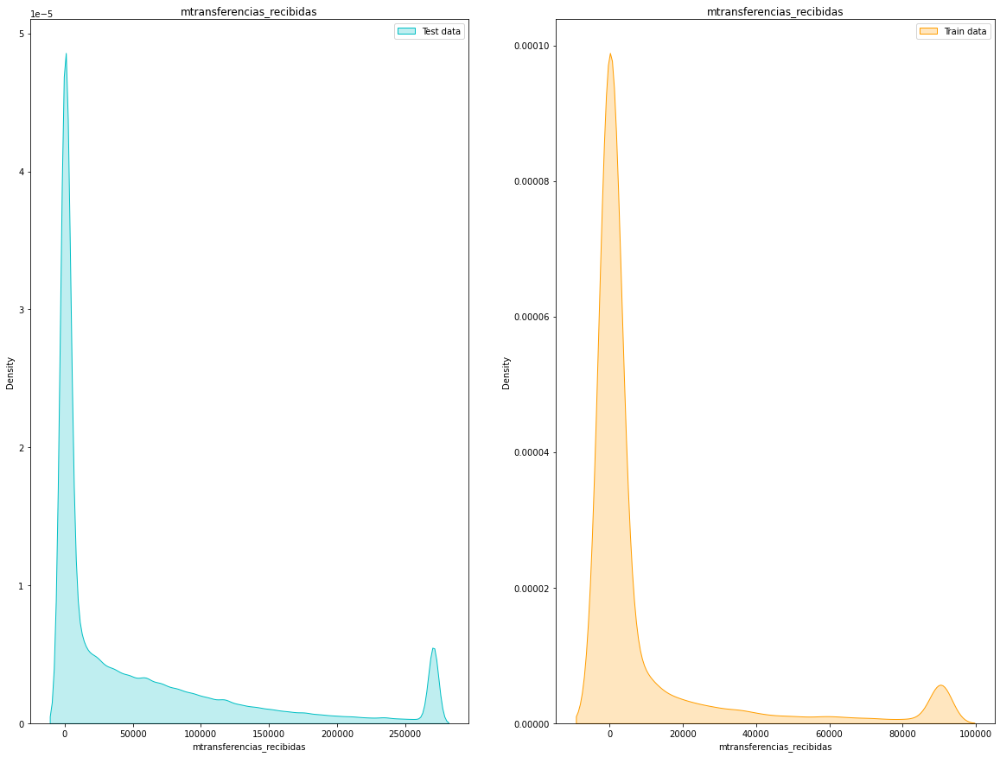

Variable: mtransferencias_recibidas
df_continua count     3686828.000
mean        82425.726
std        616723.065
min             0.000
25%             0.000
50%         10841.975
75%         74534.618
max     223010760.000
Name: mtransferencias_recibidas, dtype: float64
df_bajas count      19618.000
mean       21683.823
std       226244.939
min            0.000
25%            0.000
50%            0.000
75%         3049.800
max     18117775.270
Name: mtransferencias_recibidas, dtype: float64


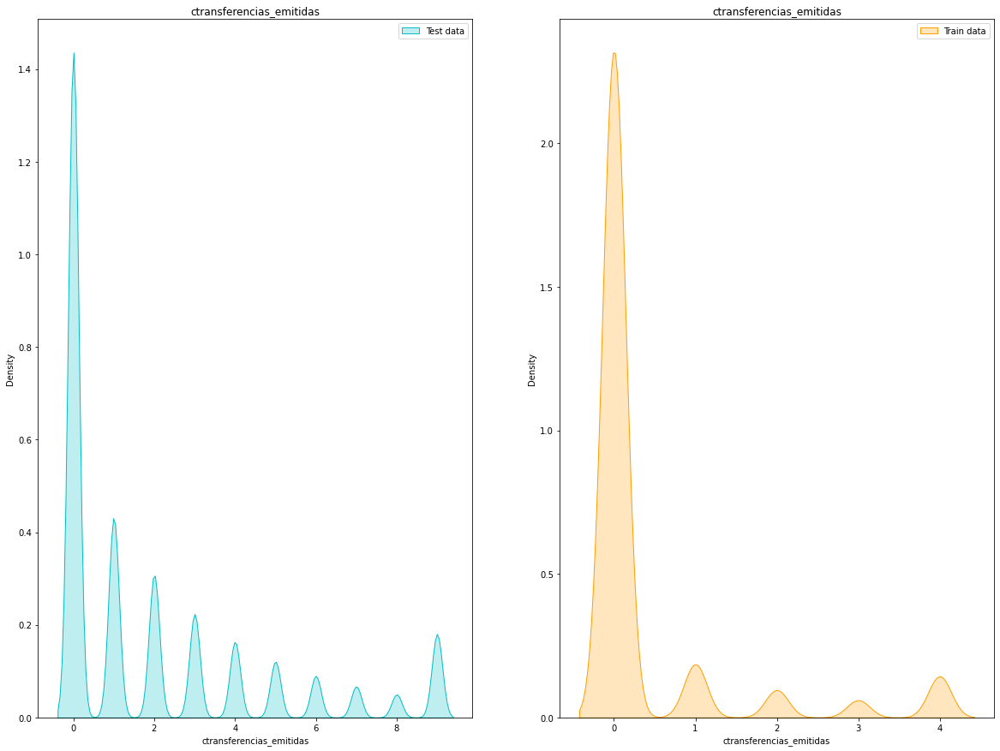

Variable: ctransferencias_emitidas
df_continua count   3686828.000
mean          2.271
std           4.517
min           0.000
25%           0.000
50%           1.000
75%           3.000
max         896.000
Name: ctransferencias_emitidas, dtype: float64
df_bajas count   19618.000
mean        0.589
std         2.487
min         0.000
25%         0.000
50%         0.000
75%         0.000
max       134.000
Name: ctransferencias_emitidas, dtype: float64


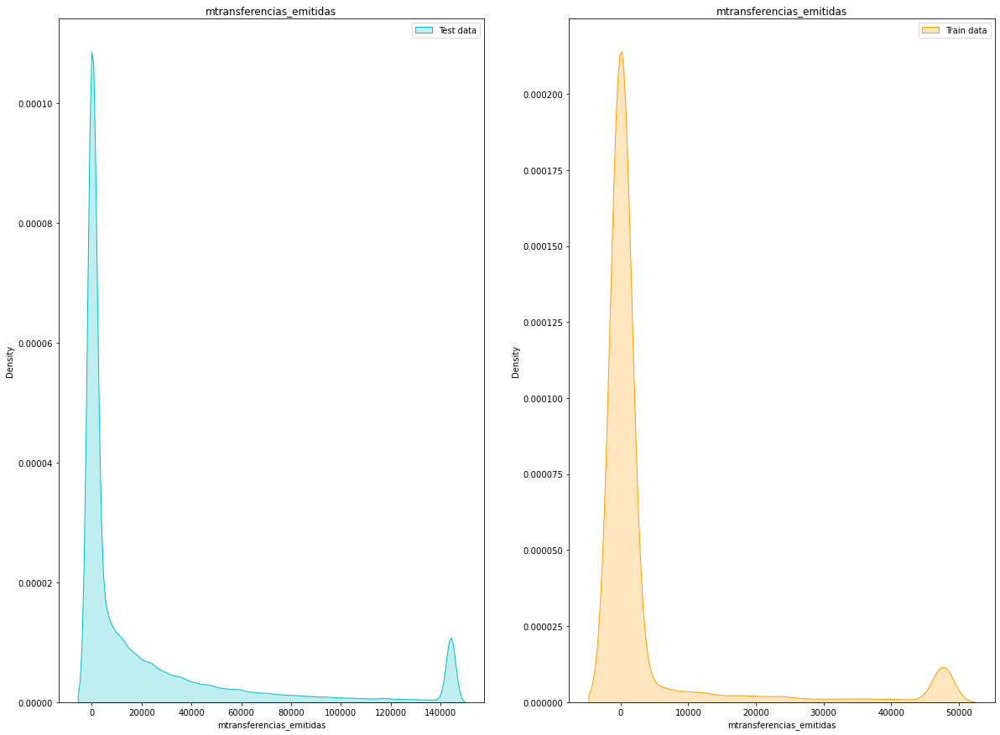

Variable: mtransferencias_emitidas
df_continua count     3686828.000
mean        42064.667
std        334281.623
min             0.000
25%             0.000
50%          1663.310
75%         24633.000
max     166331400.000
Name: mtransferencias_emitidas, dtype: float64
df_bajas count      19618.000
mean       13524.239
std       170546.211
min            0.000
25%            0.000
50%            0.000
75%            0.000
max     13457994.000
Name: mtransferencias_emitidas, dtype: float64


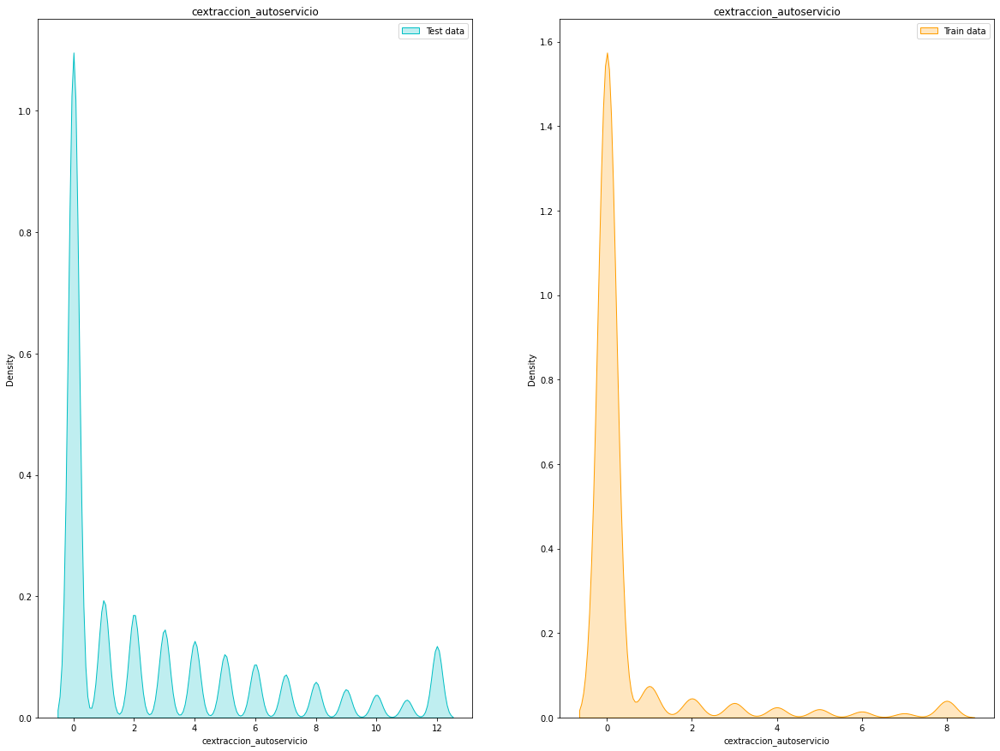

Variable: cextraccion_autoservicio
df_continua count   3686828.000
mean          2.871
std           4.494
min           0.000
25%           0.000
50%           1.000
75%           4.000
max         187.000
Name: cextraccion_autoservicio, dtype: float64
df_bajas count   19618.000
mean        0.613
std         2.335
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        73.000
Name: cextraccion_autoservicio, dtype: float64


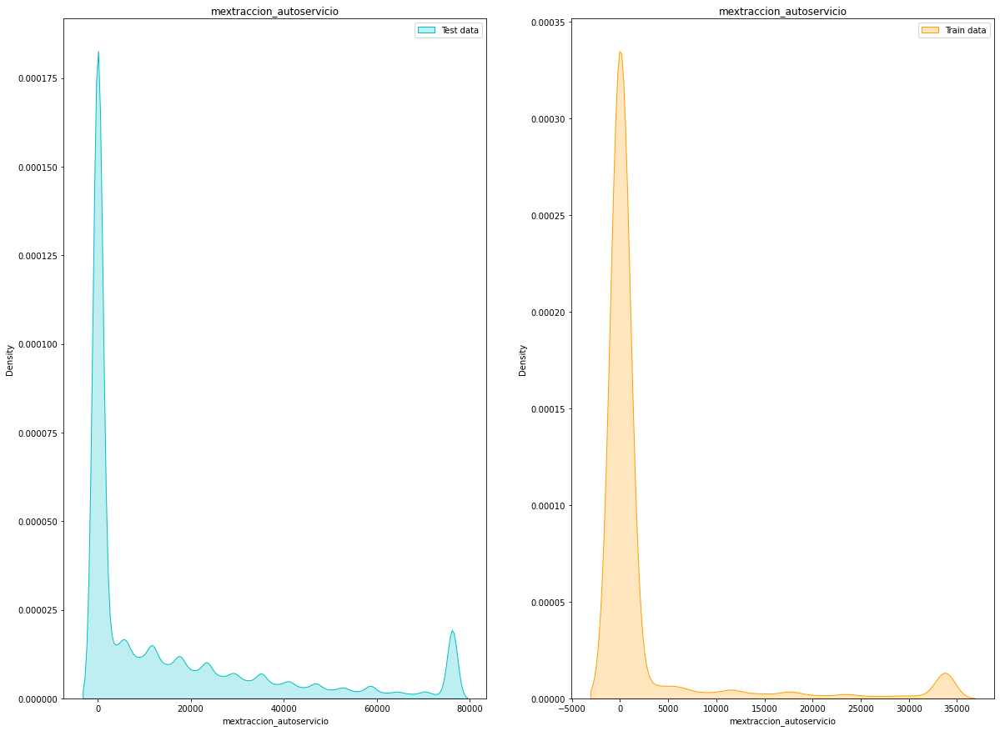

Variable: mextraccion_autoservicio
df_continua count   3686828.000
mean      18062.779
std       40215.448
min           0.000
25%           0.000
50%        2346.000
75%       22873.500
max     4574700.000
Name: mextraccion_autoservicio, dtype: float64
df_bajas count     19618.000
mean       3909.601
std       23729.276
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     1272705.000
Name: mextraccion_autoservicio, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


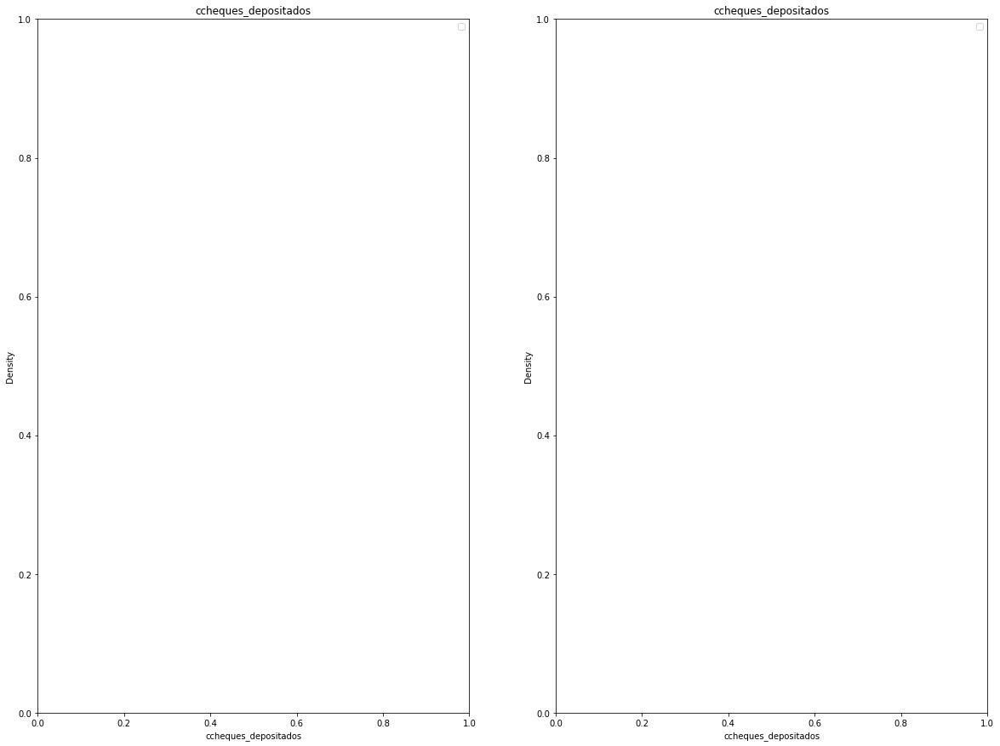

Variable: ccheques_depositados
df_continua count   3686828.000
mean          0.144
std           2.039
min           0.000
25%           0.000
50%           0.000
75%           0.000
max         682.000
Name: ccheques_depositados, dtype: float64
df_bajas count   19618.000
mean        0.040
std         0.611
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        50.000
Name: ccheques_depositados, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


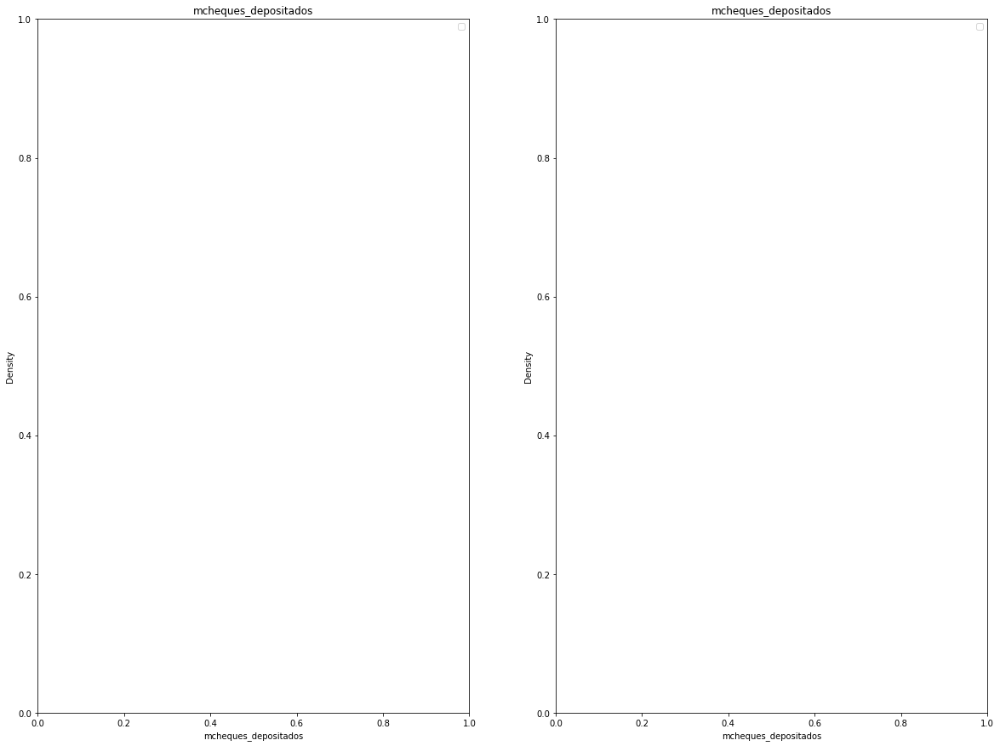

Variable: mcheques_depositados
df_continua count     3686828.000
mean         7033.999
std        192664.571
min             0.000
25%             0.000
50%             0.000
75%             0.000
max     267932186.100
Name: mcheques_depositados, dtype: float64
df_bajas count     19618.000
mean       1865.752
std       38182.249
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     2993175.370
Name: mcheques_depositados, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


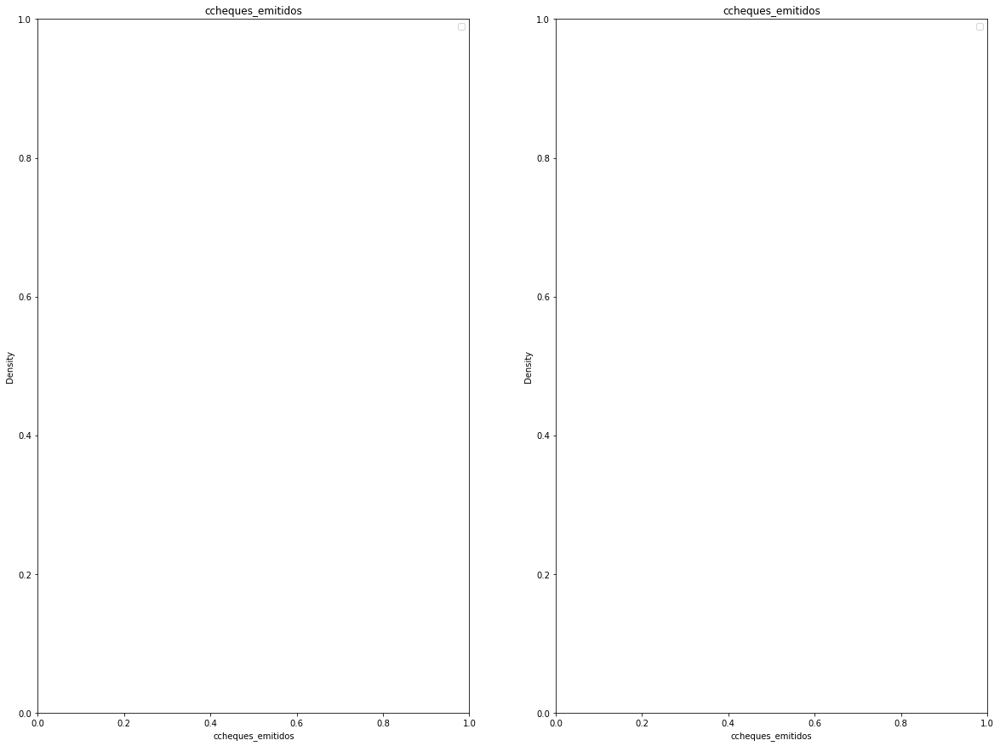

Variable: ccheques_emitidos
df_continua count   3686828.000
mean          0.146
std           1.609
min           0.000
25%           0.000
50%           0.000
75%           0.000
max         222.000
Name: ccheques_emitidos, dtype: float64
df_bajas count   19618.000
mean        0.126
std         1.853
min         0.000
25%         0.000
50%         0.000
75%         0.000
max       151.000
Name: ccheques_emitidos, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


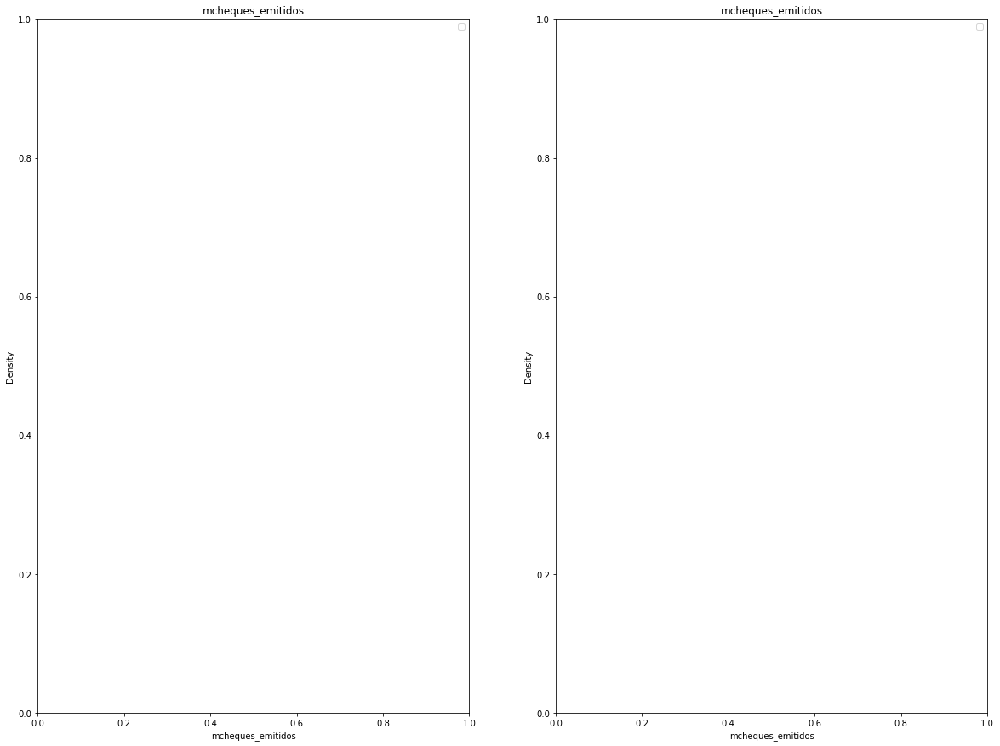

Variable: mcheques_emitidos
df_continua count    3686828.000
mean        5713.508
std       142588.874
min            0.000
25%            0.000
50%            0.000
75%            0.000
max     73417183.270
Name: mcheques_emitidos, dtype: float64
df_bajas count     19618.000
mean       3240.241
std       68683.762
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     7270057.370
Name: mcheques_emitidos, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


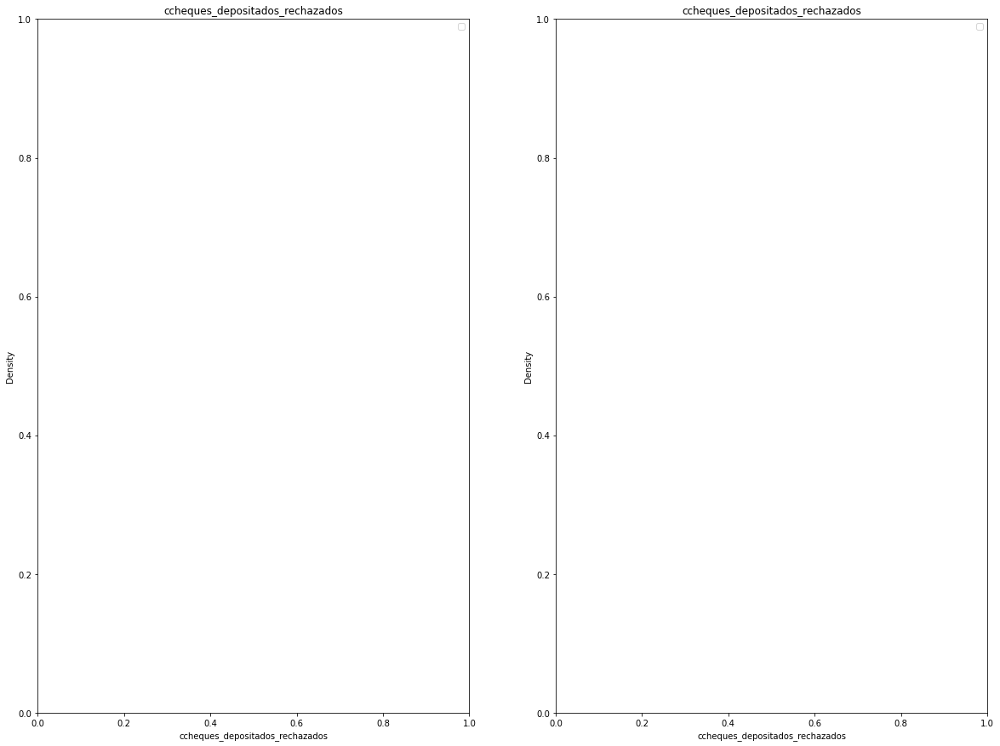

Variable: ccheques_depositados_rechazados
df_continua count   3686828.000
mean          0.004
std           0.091
min           0.000
25%           0.000
50%           0.000
75%           0.000
max          33.000
Name: ccheques_depositados_rechazados, dtype: float64
df_bajas count   19618.000
mean        0.015
std         0.426
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        50.000
Name: ccheques_depositados_rechazados, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


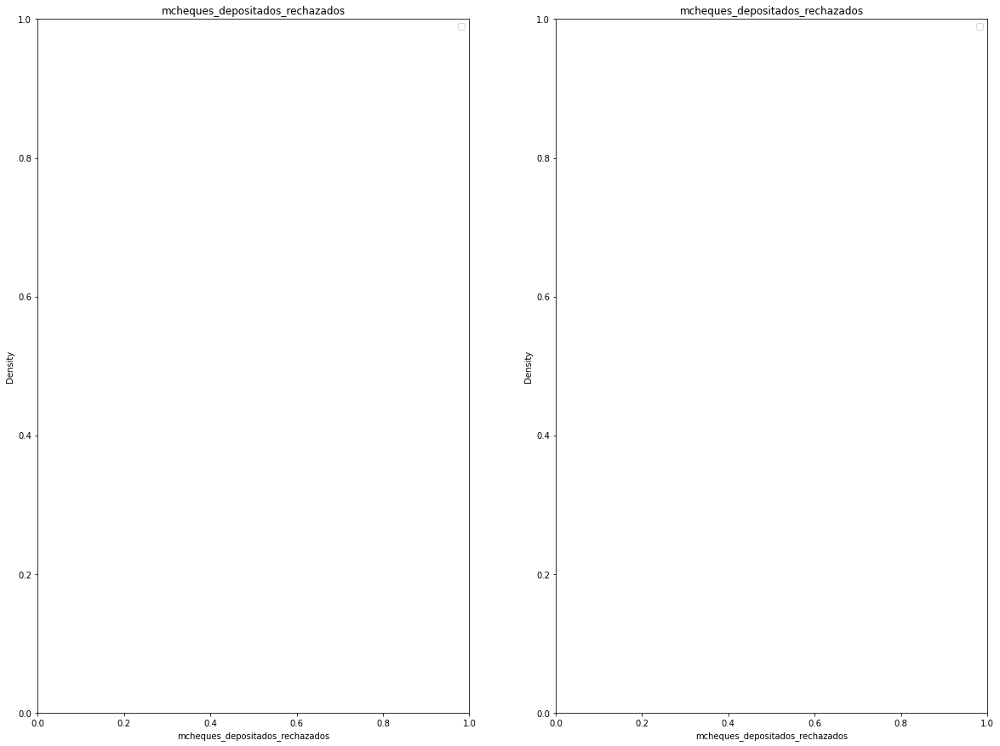

Variable: mcheques_depositados_rechazados
df_continua count    3686828.000
mean         207.722
std        13405.601
min            0.000
25%            0.000
50%            0.000
75%            0.000
max     13416695.100
Name: mcheques_depositados_rechazados, dtype: float64
df_bajas count     19618.000
mean        490.542
std       15020.394
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     1351101.280
Name: mcheques_depositados_rechazados, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


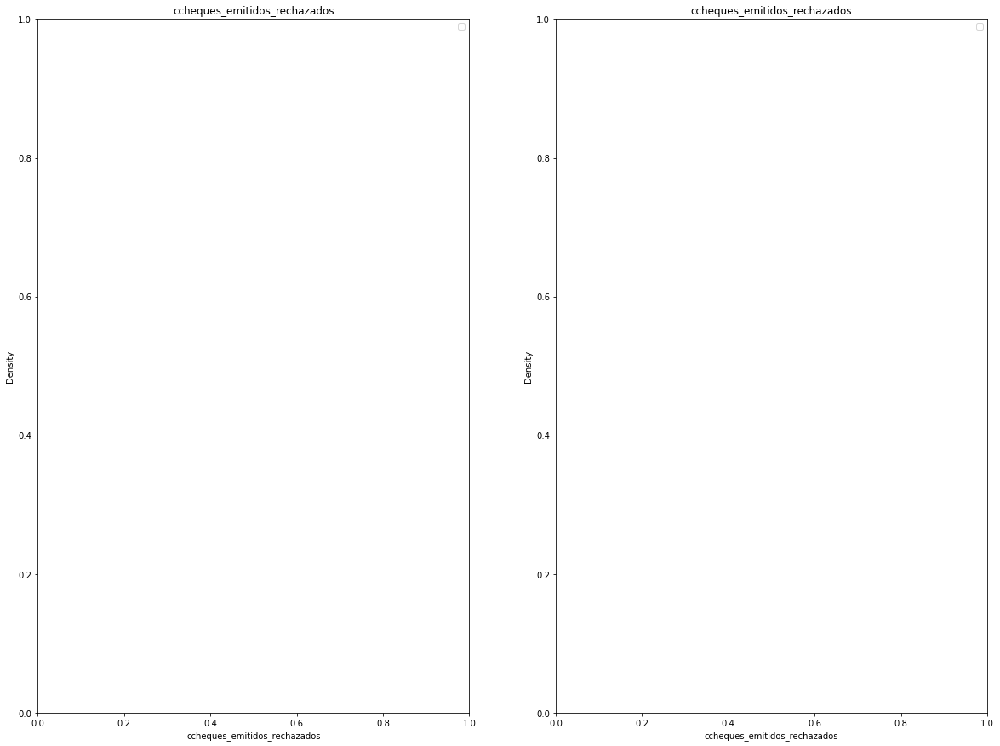

Variable: ccheques_emitidos_rechazados
df_continua count   3686828.000
mean          0.003
std           0.122
min           0.000
25%           0.000
50%           0.000
75%           0.000
max          75.000
Name: ccheques_emitidos_rechazados, dtype: float64
df_bajas count   19618.000
mean        0.044
std         0.818
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        74.000
Name: ccheques_emitidos_rechazados, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


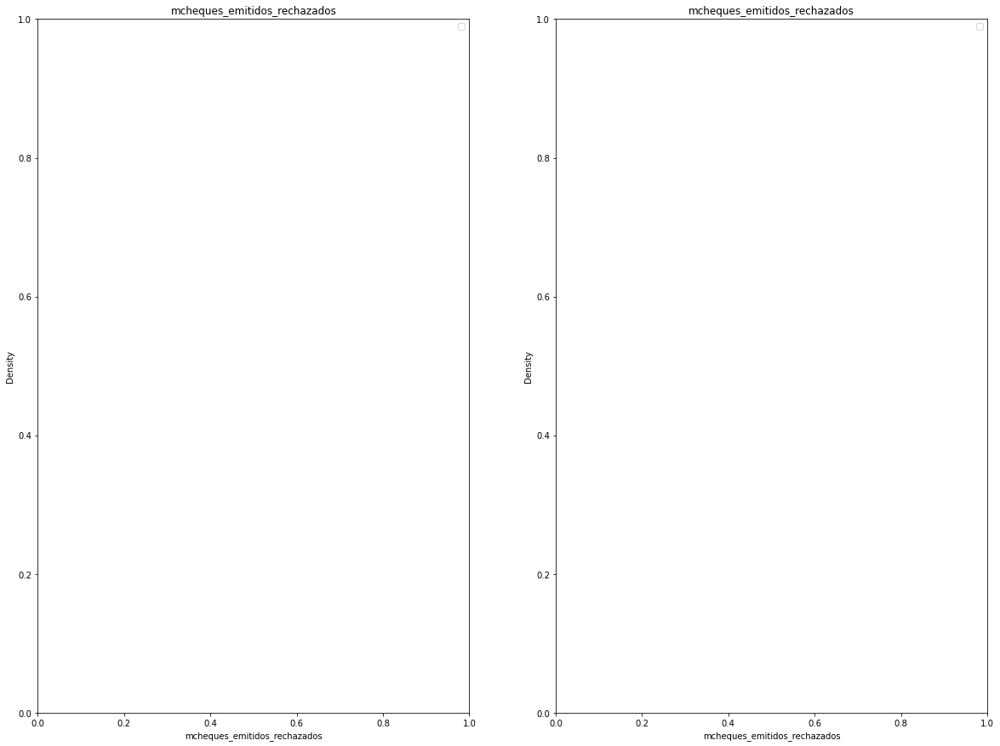

Variable: mcheques_emitidos_rechazados
df_continua count    3686828.000
mean         194.426
std        42743.653
min            0.000
25%            0.000
50%            0.000
75%            0.000
max     71602266.000
Name: mcheques_emitidos_rechazados, dtype: float64
df_bajas count     19618.000
mean       1230.352
std       25001.623
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     1715349.490
Name: mcheques_emitidos_rechazados, dtype: float64


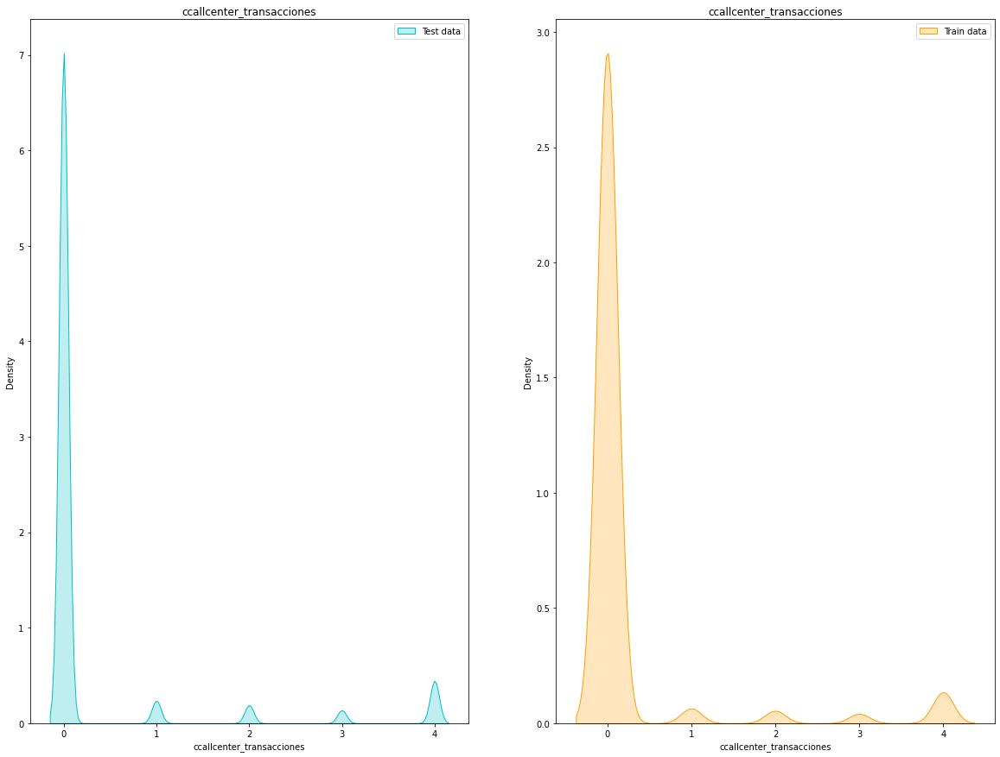

Variable: ccallcenter_transacciones
df_continua count   3686828.000
mean          0.583
std           2.394
min           0.000
25%           0.000
50%           0.000
75%           0.000
max         409.000
Name: ccallcenter_transacciones, dtype: float64
df_bajas count   19618.000
mean        0.436
std         2.157
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        92.000
Name: ccallcenter_transacciones, dtype: float64


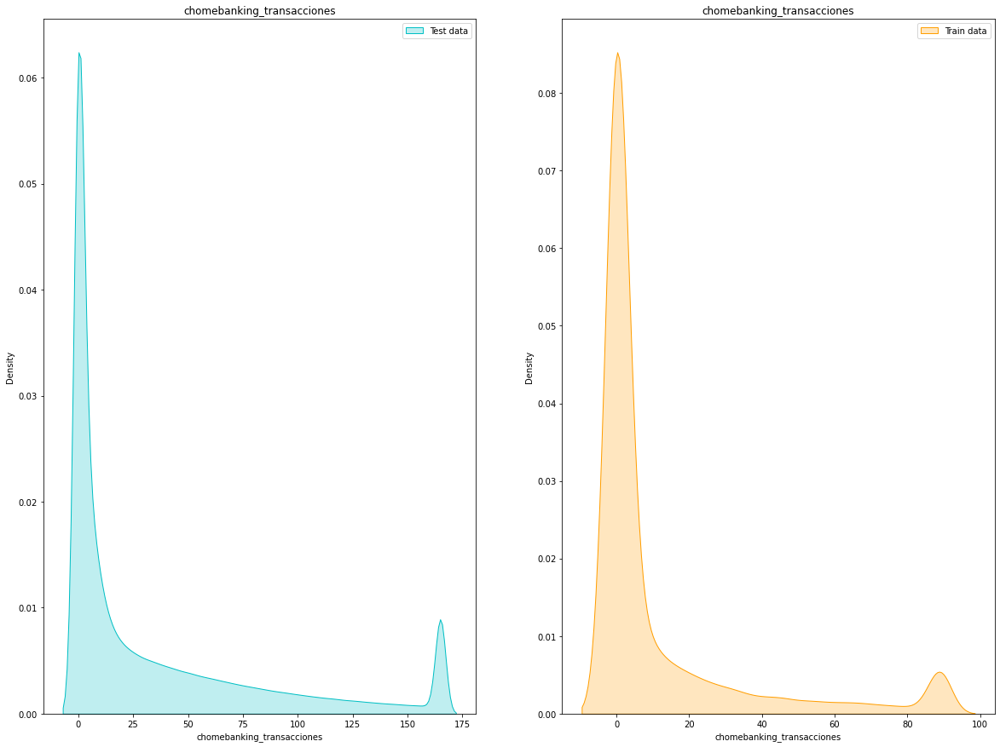

Variable: chomebanking_transacciones
df_continua count   3686828.000
mean         39.561
std          72.532
min           0.000
25%           0.000
50%          10.000
75%          53.000
max       10387.000
Name: chomebanking_transacciones, dtype: float64
df_bajas count   19618.000
mean       14.091
std        38.478
min         0.000
25%         0.000
50%         0.000
75%        10.000
max      1491.000
Name: chomebanking_transacciones, dtype: float64


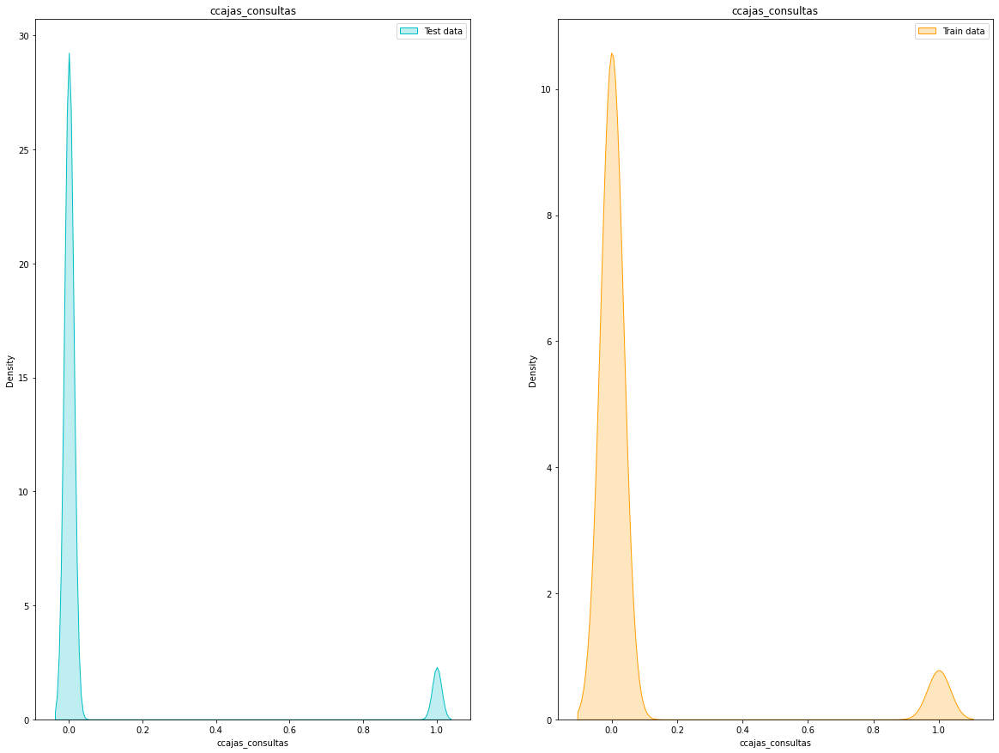

Variable: ccajas_consultas
df_continua count   3686828.000
mean          0.138
std           0.690
min           0.000
25%           0.000
50%           0.000
75%           0.000
max         141.000
Name: ccajas_consultas, dtype: float64
df_bajas count   19618.000
mean        0.180
std         0.959
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        34.000
Name: ccajas_consultas, dtype: float64


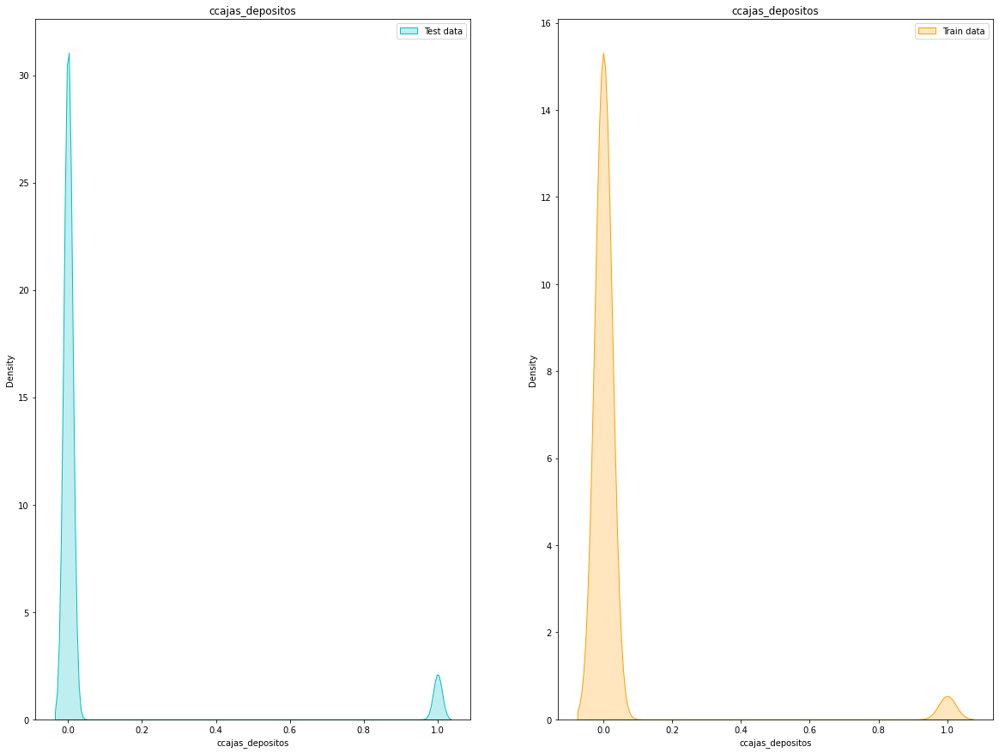

Variable: ccajas_depositos
df_continua count   3686828.000
mean          0.104
std           0.633
min           0.000
25%           0.000
50%           0.000
75%           0.000
max         239.000
Name: ccajas_depositos, dtype: float64
df_bajas count   19618.000
mean        0.056
std         0.413
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        22.000
Name: ccajas_depositos, dtype: float64


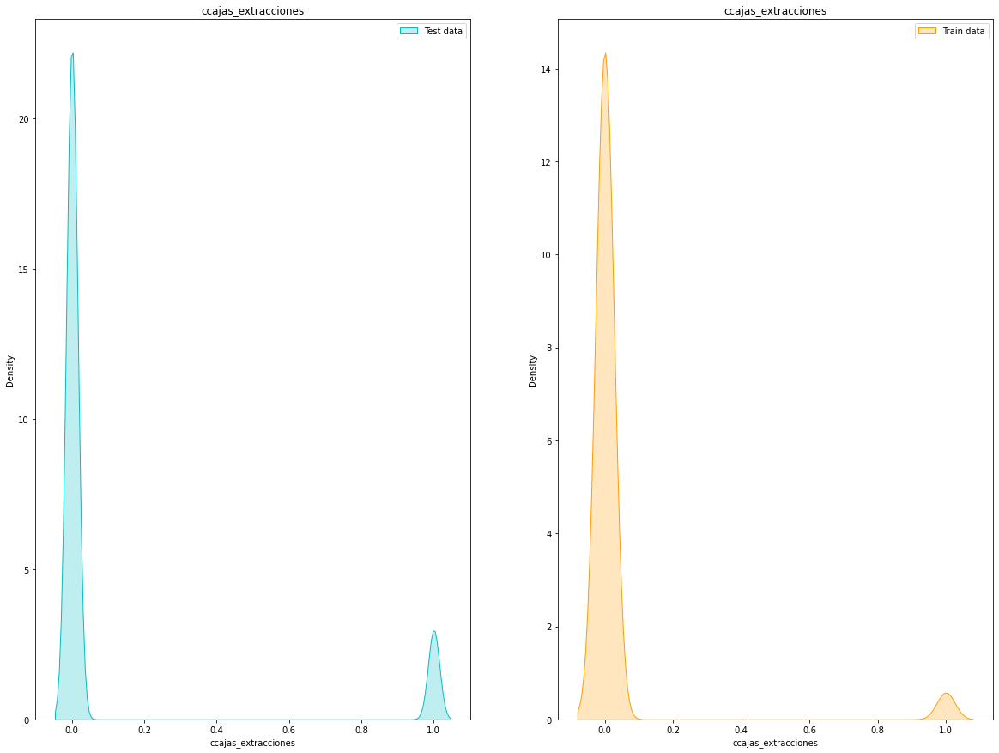

Variable: ccajas_extracciones
df_continua count   3686828.000
mean          0.185
std           0.657
min           0.000
25%           0.000
50%           0.000
75%           0.000
max          87.000
Name: ccajas_extracciones, dtype: float64
df_bajas count   19618.000
mean        0.058
std         0.360
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        10.000
Name: ccajas_extracciones, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


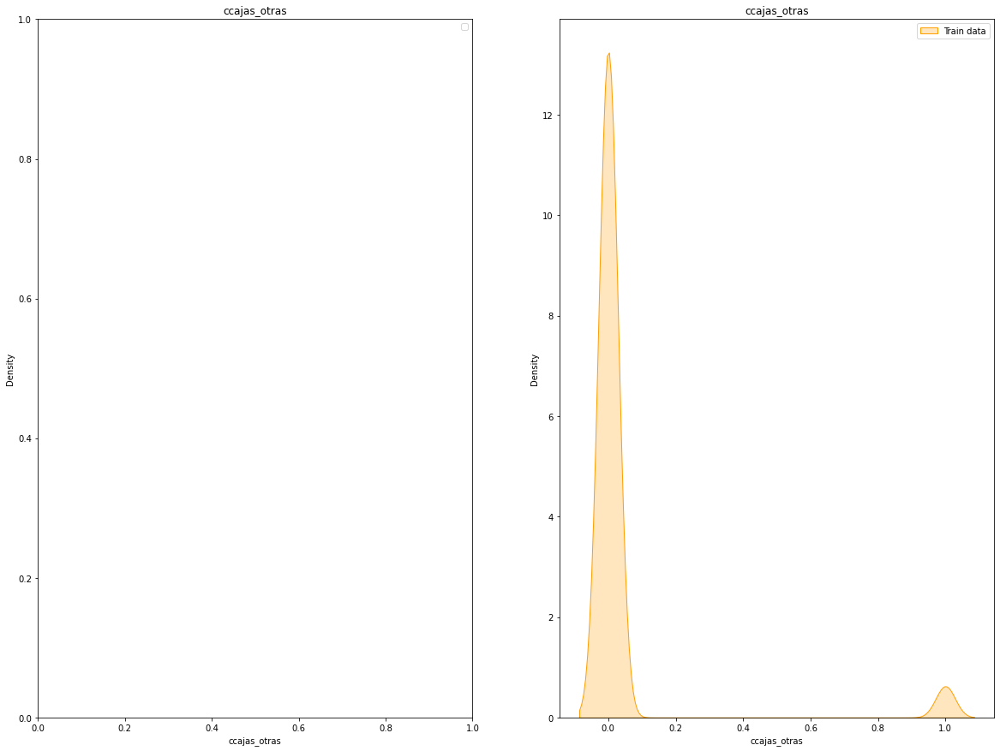

Variable: ccajas_otras
df_continua count   3686828.000
mean          0.053
std           0.515
min           0.000
25%           0.000
50%           0.000
75%           0.000
max         210.000
Name: ccajas_otras, dtype: float64
df_bajas count   19618.000
mean        0.115
std         1.176
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        81.000
Name: ccajas_otras, dtype: float64


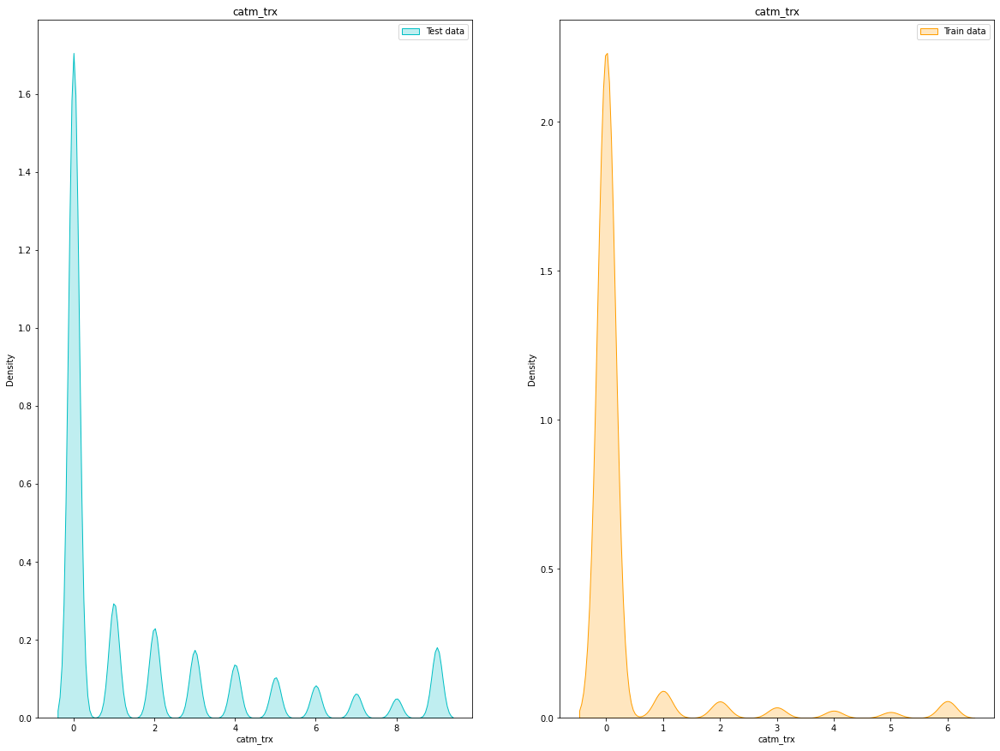

Variable: catm_trx
df_continua count   3686828.000
mean          2.015
std           3.763
min           0.000
25%           0.000
50%           0.000
75%           3.000
max         183.000
Name: catm_trx, dtype: float64
df_bajas count   19618.000
mean        0.429
std         1.910
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        72.000
Name: catm_trx, dtype: float64


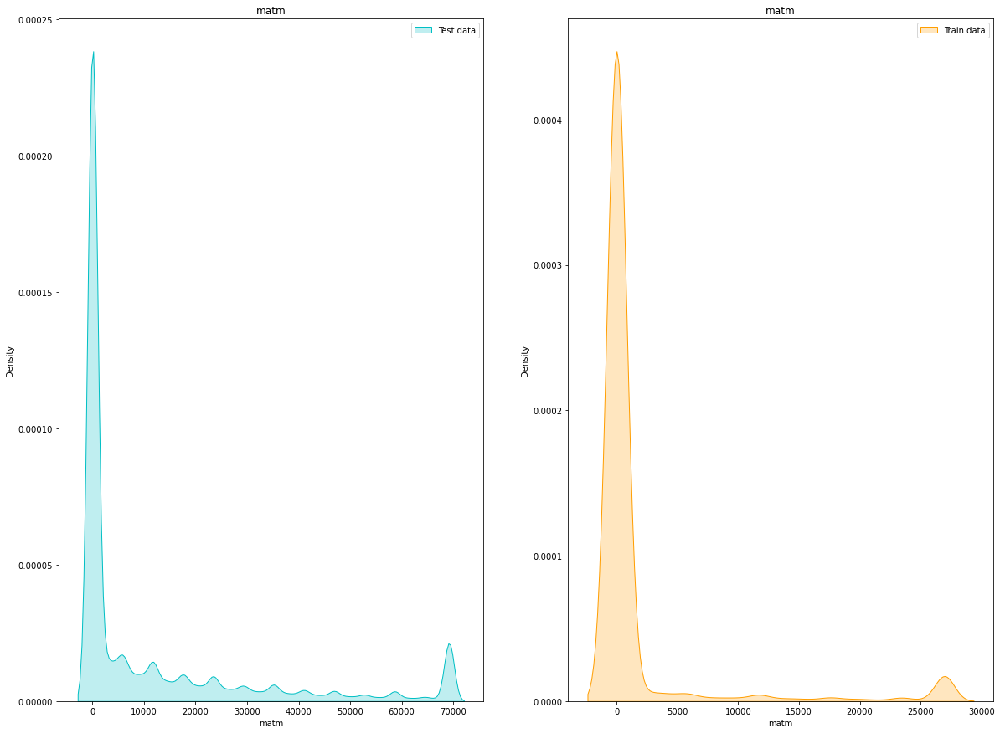

Variable: matm
df_continua count   3686828.000
mean      14732.796
std       38578.244
min           0.000
25%           0.000
50%           0.000
75%       15249.000
max     4574700.000
Name: matm, dtype: float64
df_bajas count     19618.000
mean       3223.779
std       22790.851
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     1272705.000
Name: matm, dtype: float64


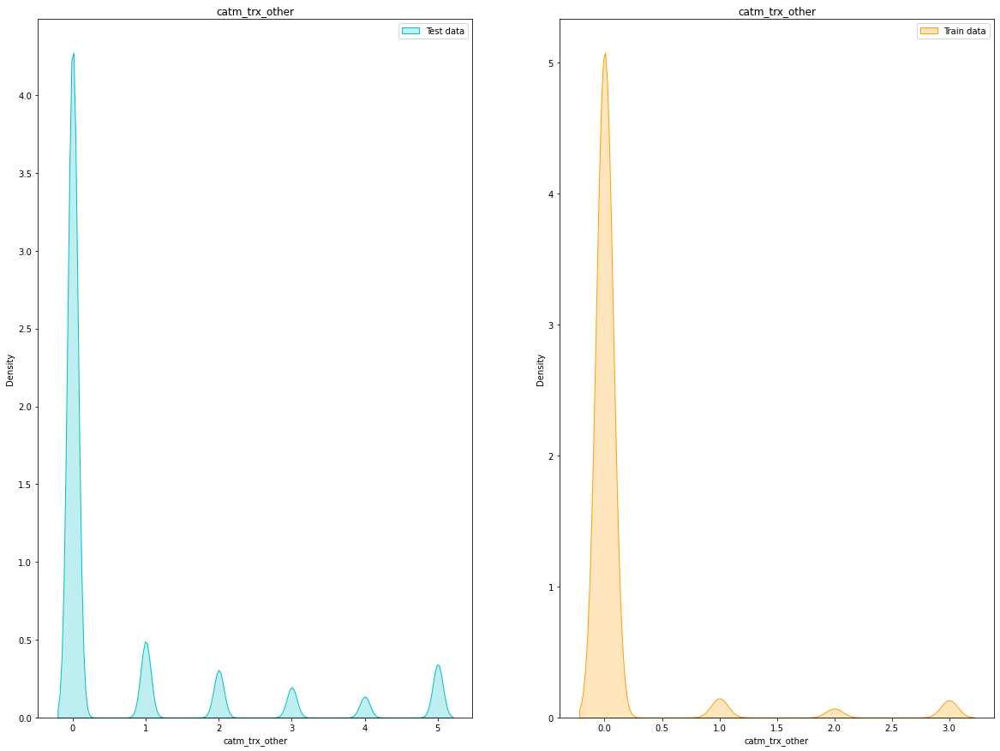

Variable: catm_trx_other
df_continua count   3686828.000
mean          0.856
std           2.191
min           0.000
25%           0.000
50%           0.000
75%           1.000
max          71.000
Name: catm_trx_other, dtype: float64
df_bajas count   19618.000
mean        0.184
std         1.043
min         0.000
25%         0.000
50%         0.000
75%         0.000
max        32.000
Name: catm_trx_other, dtype: float64


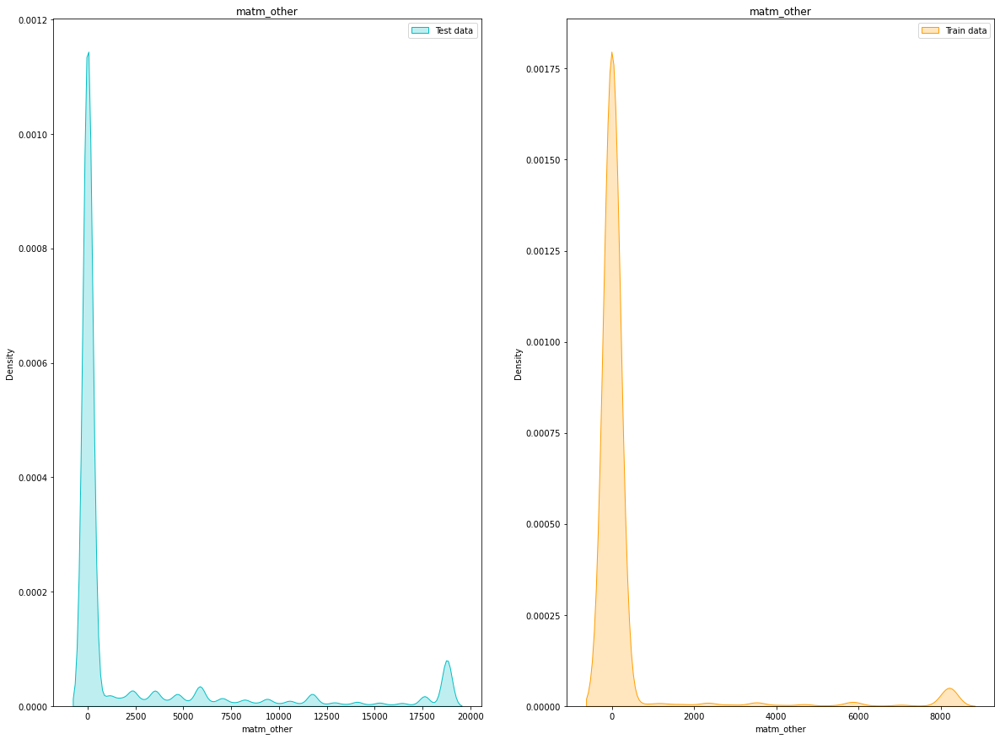

Variable: matm_other
df_continua count   3686828.000
mean       3329.983
std       10132.129
min           0.000
25%           0.000
50%           0.000
75%         586.500
max     3255902.080
Name: matm_other, dtype: float64
df_bajas count    19618.000
mean       685.822
std       4418.115
min          0.000
25%          0.000
50%          0.000
75%          0.000
max     145686.600
Name: matm_other, dtype: float64


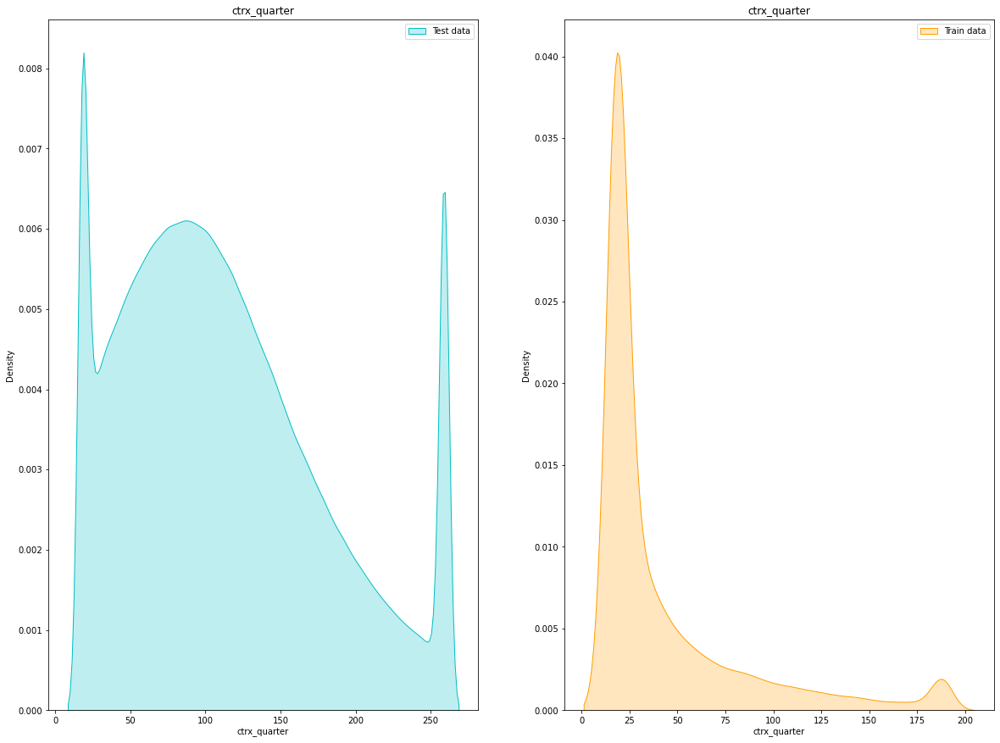

Variable: ctrx_quarter
df_continua count   3686828.000
mean        116.246
std          84.119
min           0.000
25%          60.000
50%         102.000
75%         153.000
max        3702.000
Name: ctrx_quarter, dtype: float64
df_bajas count   19618.000
mean       38.597
std        56.326
min         0.000
25%         6.000
50%        20.000
75%        48.000
max      1647.000
Name: ctrx_quarter, dtype: float64


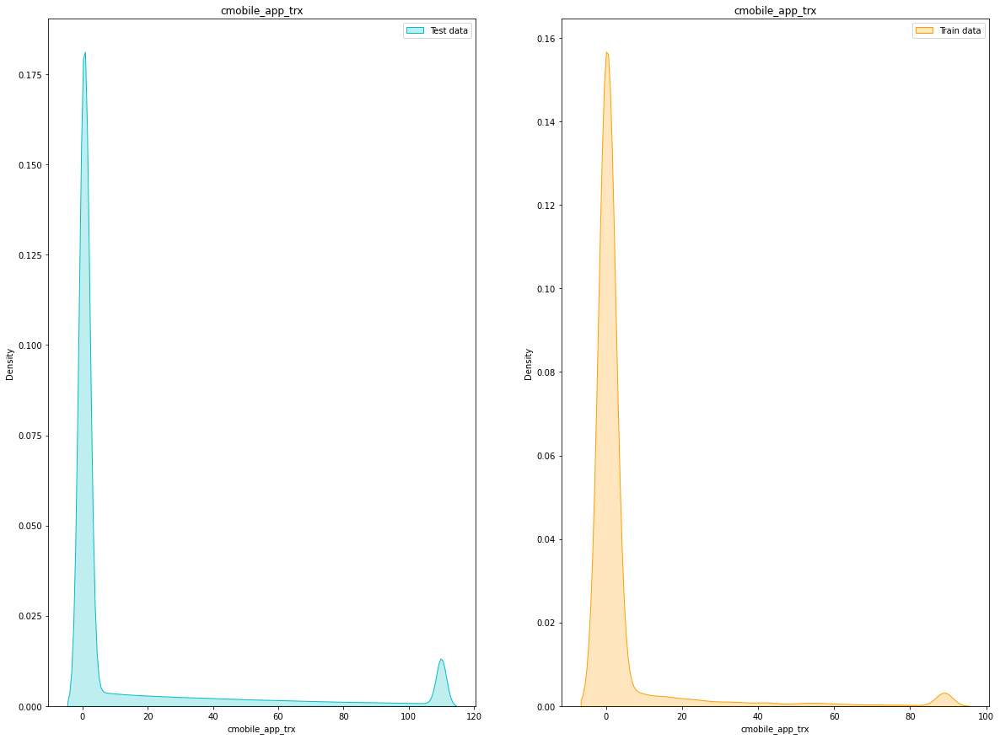

Variable: cmobile_app_trx
df_continua count   3014451.000
mean         18.362
std          49.273
min           0.000
25%           0.000
50%           1.000
75%           3.000
max        2642.000
Name: cmobile_app_trx, dtype: float64
df_bajas count   15616.000
mean        5.656
std        26.135
min         0.000
25%         0.000
50%         0.000
75%         1.000
max       715.000
Name: cmobile_app_trx, dtype: float64


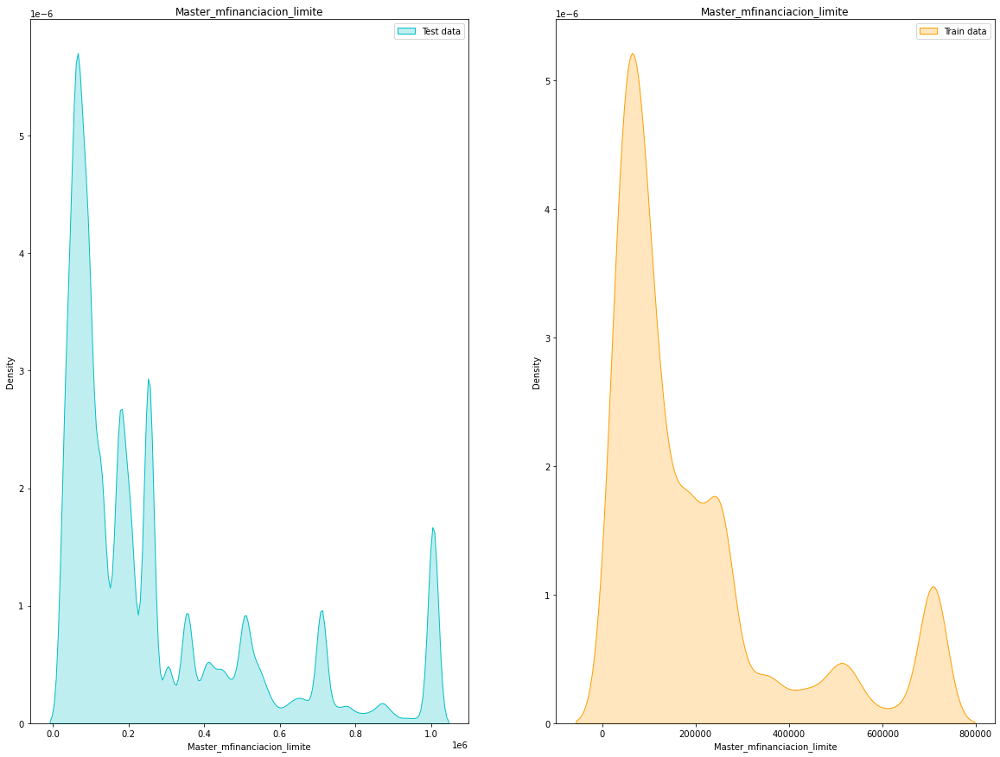

Variable: Master_mfinanciacion_limite
df_continua count     3314517.000
mean       440570.910
std       3511791.485
min             0.000
25%         76010.400
50%        177357.600
75%        354715.200
max     550790361.000
Name: Master_mfinanciacion_limite, dtype: float64
df_bajas count      13540.000
mean      265012.913
std      1595236.689
min            0.000
25%        63342.000
50%       126684.000
75%       253368.000
max     97424406.500
Name: Master_mfinanciacion_limite, dtype: float64


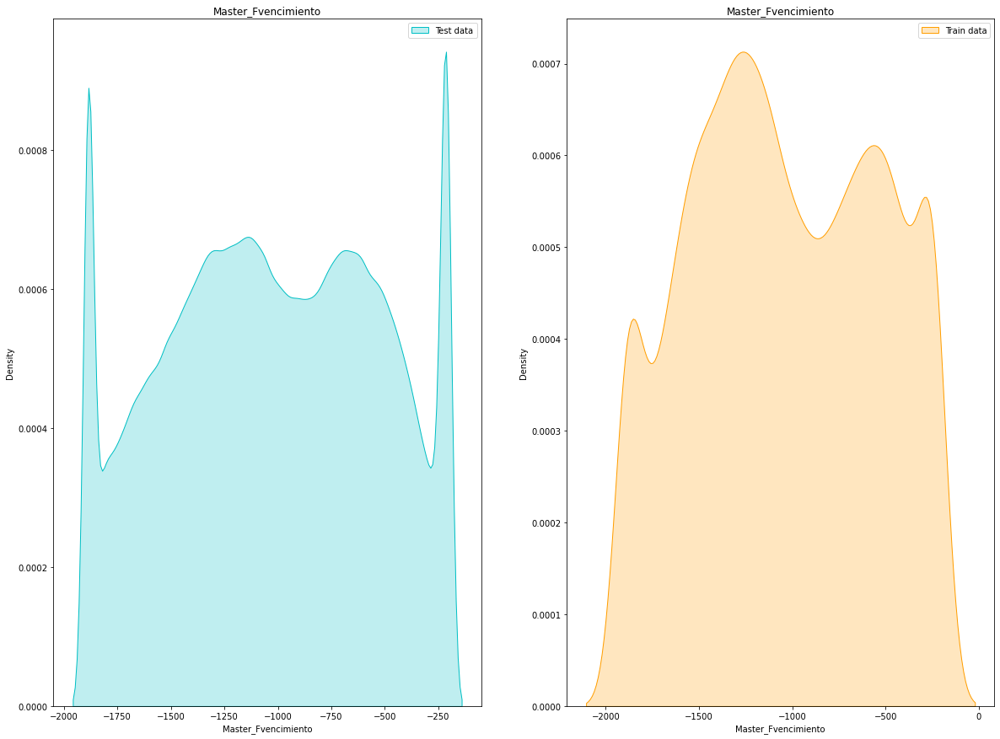

Variable: Master_Fvencimiento
df_continua count    3314517.000
mean       -1081.195
std        11662.140
min     -2914968.000
25%        -1429.000
50%        -1034.000
75%         -637.000
max         6607.000
Name: Master_Fvencimiento, dtype: float64
df_bajas count      13540.000
mean       -1255.643
std        25039.956
min     -2914056.000
25%        -1430.000
50%        -1065.000
75%         -608.000
max         4842.000
Name: Master_Fvencimiento, dtype: float64


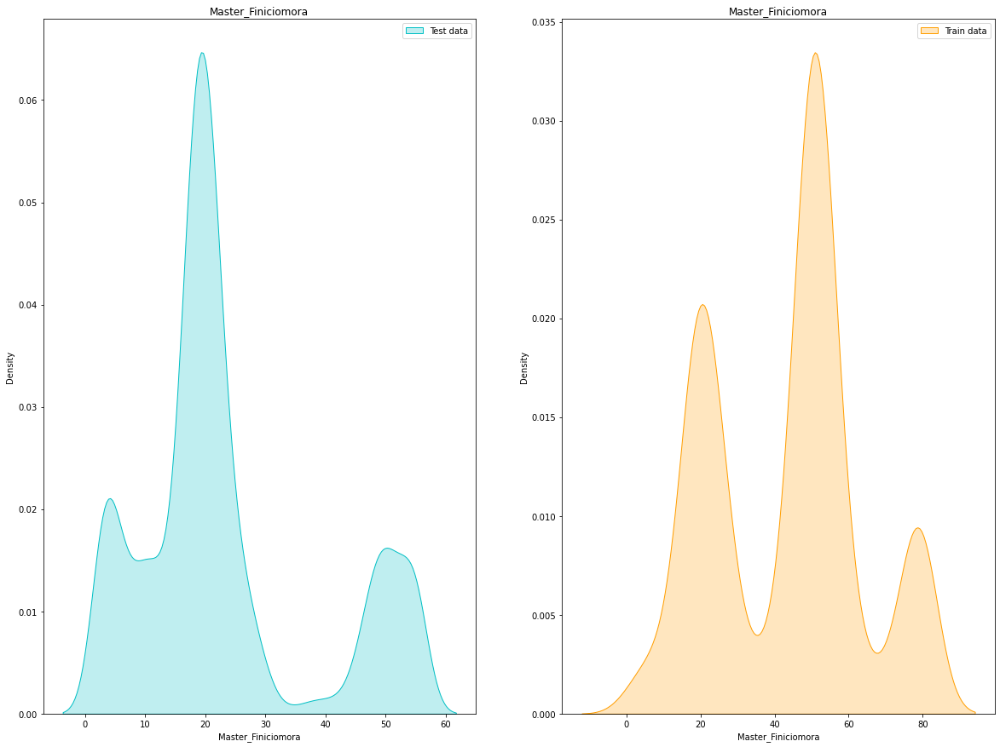

Variable: Master_Finiciomora
df_continua count   12800.000
mean       24.577
std        20.958
min        -1.000
25%        16.000
50%        20.000
75%        25.000
max       323.000
Name: Master_Finiciomora, dtype: float64
df_bajas count   1007.000
mean      45.188
std       25.956
min        2.000
25%       22.000
50%       50.000
75%       53.000
max      233.000
Name: Master_Finiciomora, dtype: float64


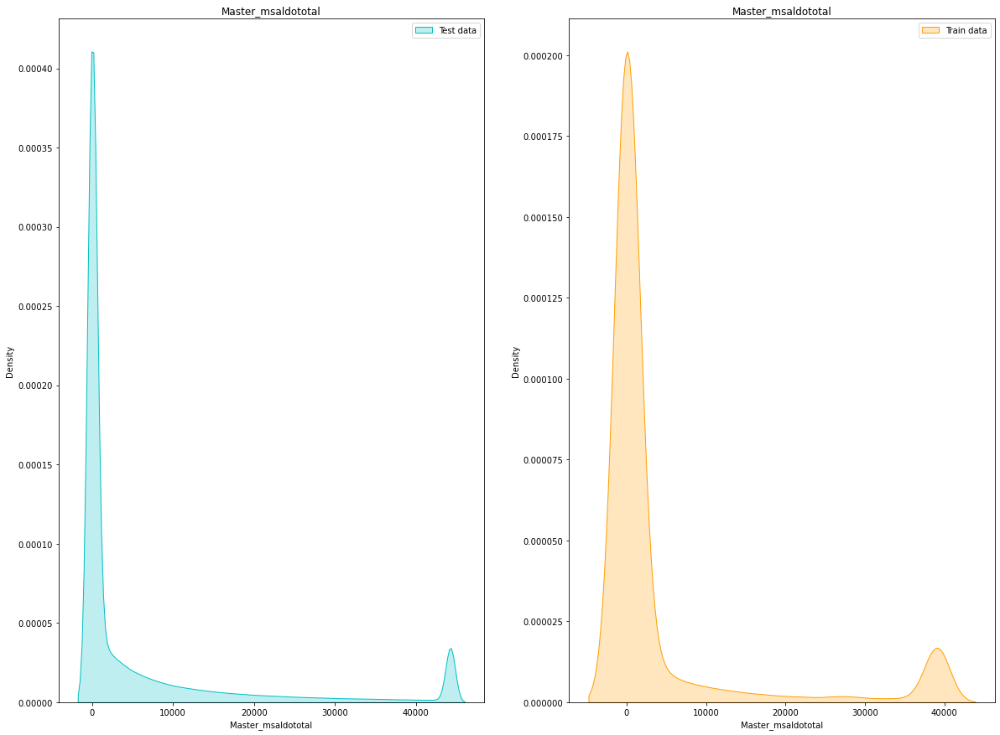

Variable: Master_msaldototal
df_continua count    3314517.000
mean        9133.561
std        39653.626
min     -2267833.130
25%            0.000
50%            0.000
75%         5290.240
max      7703446.240
Name: Master_msaldototal, dtype: float64
df_bajas count      13540.000
mean       12575.945
std        72767.915
min     -1074928.970
25%            0.000
50%            0.000
75%           95.752
max      1983436.520
Name: Master_msaldototal, dtype: float64


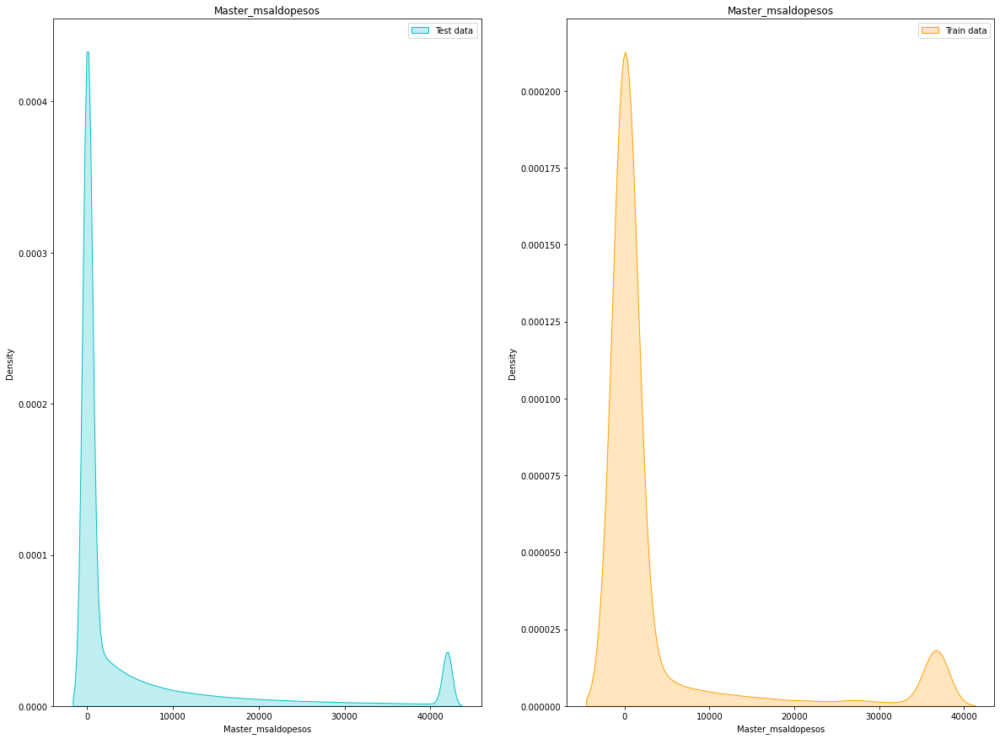

Variable: Master_msaldopesos
df_continua count    3314517.000
mean        8661.196
std        37115.168
min     -2268959.770
25%            0.000
50%            0.000
75%         5054.490
max      7703446.240
Name: Master_msaldopesos, dtype: float64
df_bajas count      13540.000
mean       12426.558
std        72448.678
min     -1074928.970
25%            0.000
50%            0.000
75%           73.625
max      1983436.520
Name: Master_msaldopesos, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


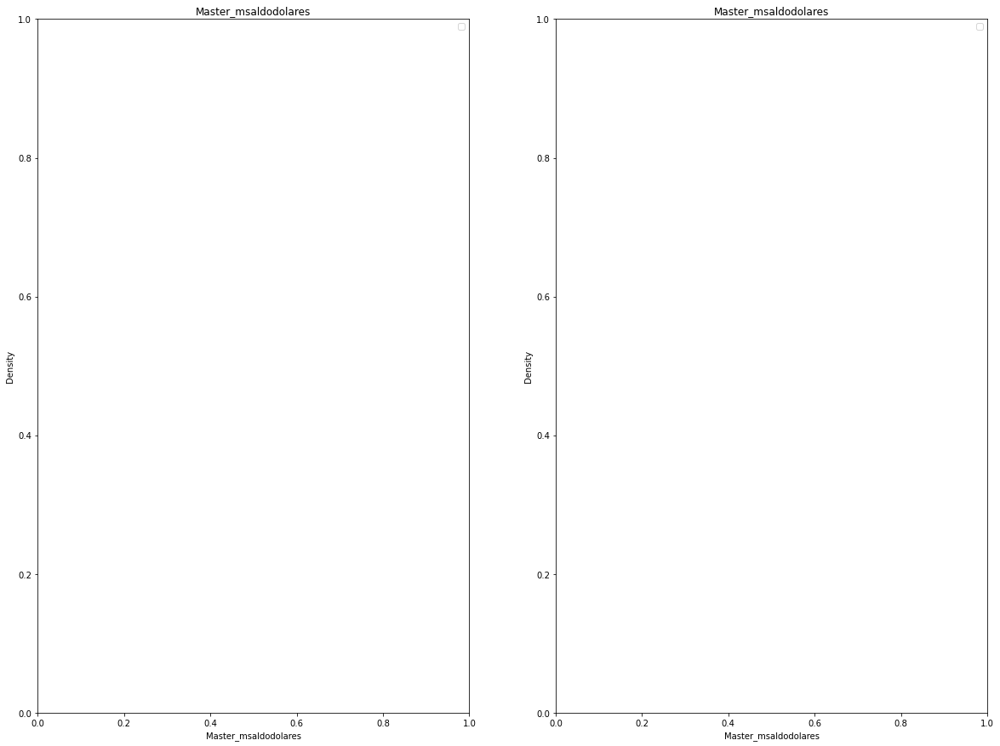

Variable: Master_msaldodolares
df_continua count   3314517.000
mean        472.790
std        9892.271
min     -735773.930
25%           0.000
50%           0.000
75%           0.000
max     2155255.180
Name: Master_msaldodolares, dtype: float64
df_bajas count    13540.000
mean       149.414
std       3593.523
min     -80160.720
25%          0.000
50%          0.000
75%          0.000
max     215823.090
Name: Master_msaldodolares, dtype: float64


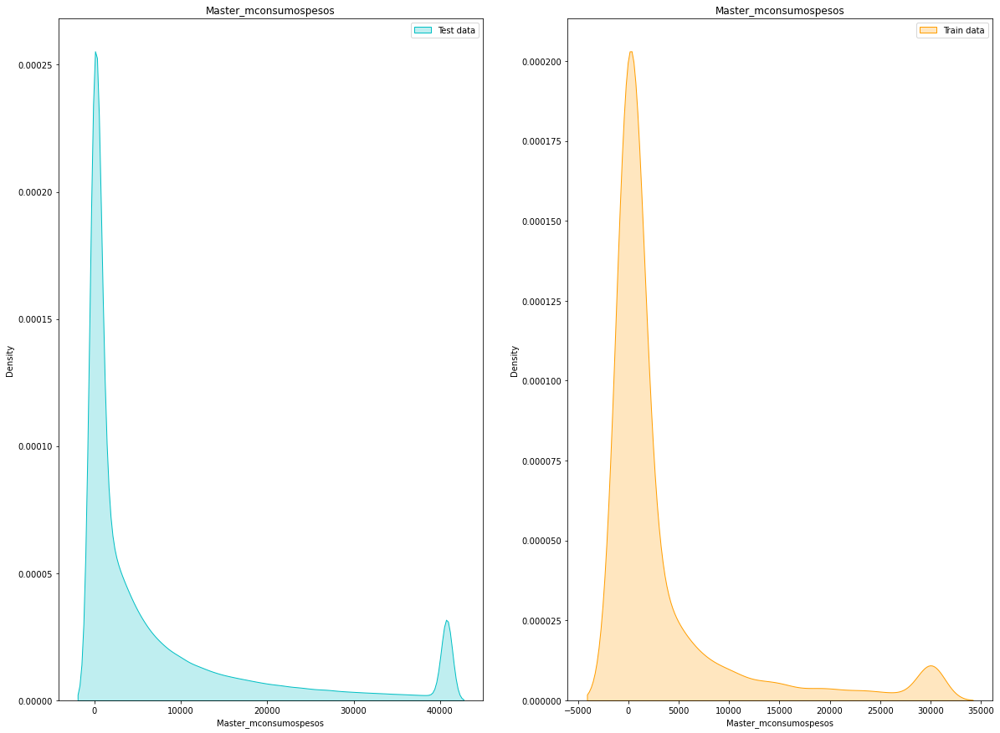

Variable: Master_mconsumospesos
df_continua count   1522115.000
mean       9552.988
std       28134.336
min     -121540.980
25%           0.000
50%        1830.460
75%        8831.440
max     2922921.350
Name: Master_mconsumospesos, dtype: float64
df_bajas count     4034.000
mean      4902.739
std      17523.326
min      -7122.380
25%          0.000
50%        106.055
75%       2849.990
max     418173.520
Name: Master_mconsumospesos, dtype: float64


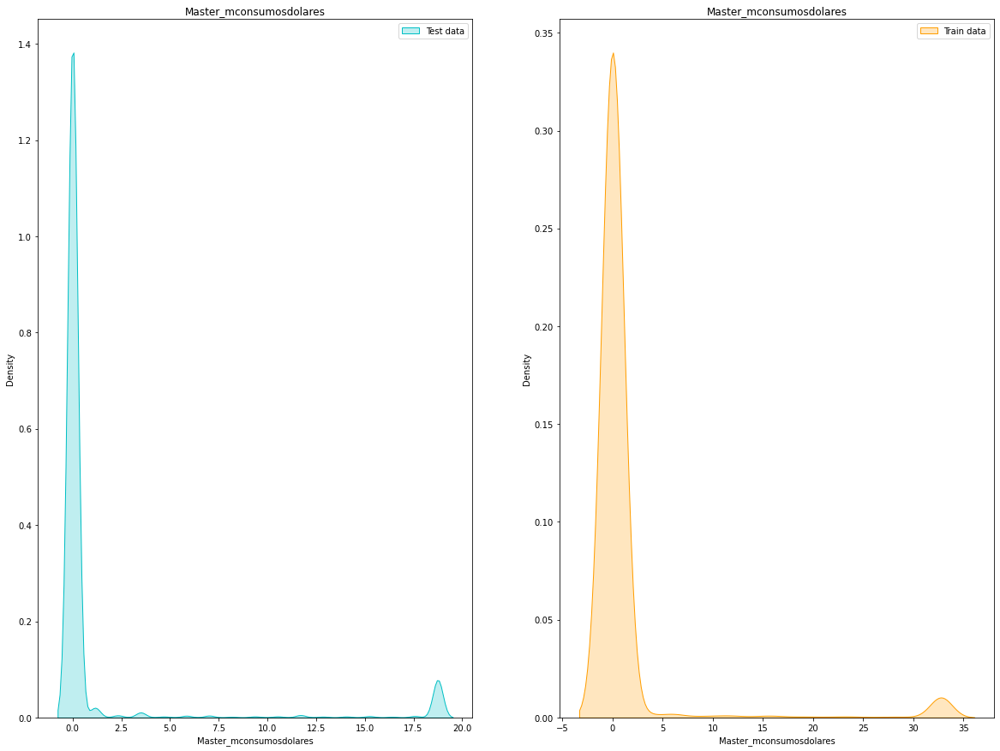

Variable: Master_mconsumosdolares
df_continua count   1522115.000
mean         21.733
std         230.067
min           0.000
25%           0.000
50%           0.000
75%           0.000
max       28859.340
Name: Master_mconsumosdolares, dtype: float64
df_bajas count   4034.000
mean      11.642
std      143.969
min        0.000
25%        0.000
50%        0.000
75%        0.000
max     5534.160
Name: Master_mconsumosdolares, dtype: float64


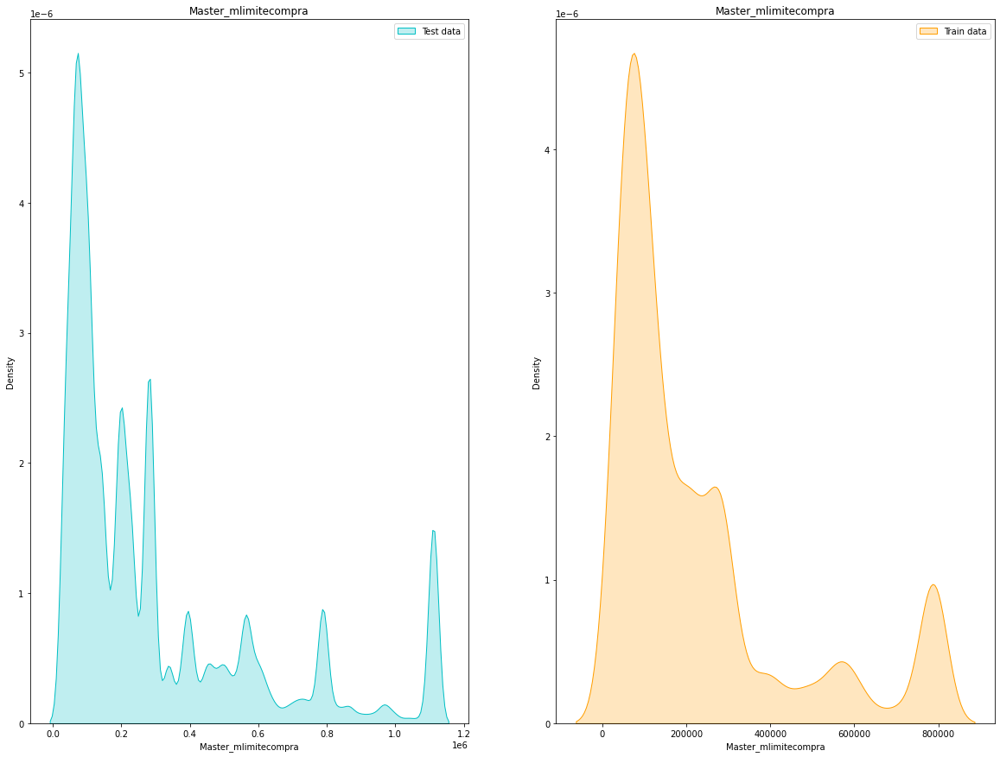

Variable: Master_mlimitecompra
df_continua count    3314517.000
mean      337530.579
std       483894.688
min          985.320
25%        84456.000
50%       197064.000
75%       394128.000
max     27206092.800
Name: Master_mlimitecompra, dtype: float64
df_bajas count     13540.000
mean     256988.812
std      379884.362
min         985.320
25%       70380.000
50%      140760.000
75%      281520.000
max     7768685.160
Name: Master_mlimitecompra, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


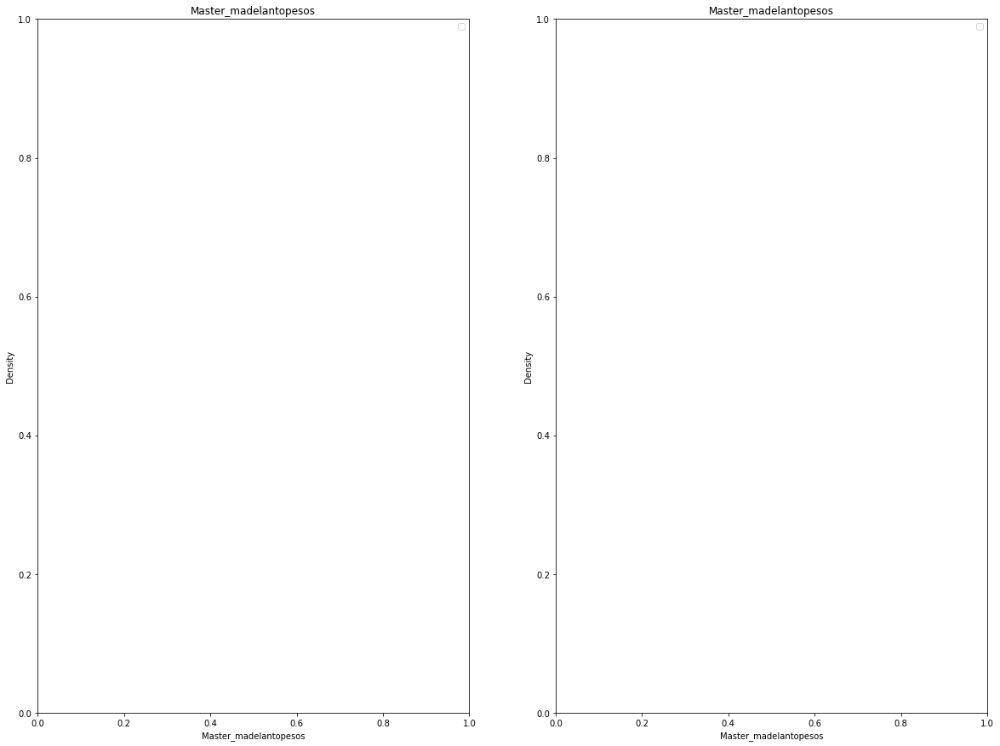

Variable: Master_madelantopesos
df_continua count   1522115.000
mean         51.999
std         848.551
min           0.000
25%           0.000
50%           0.000
75%           0.000
max      154634.940
Name: Master_madelantopesos, dtype: float64
df_bajas count    4034.000
mean      116.108
std      1311.383
min         0.000
25%         0.000
50%         0.000
75%         0.000
max     17595.000
Name: Master_madelantopesos, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


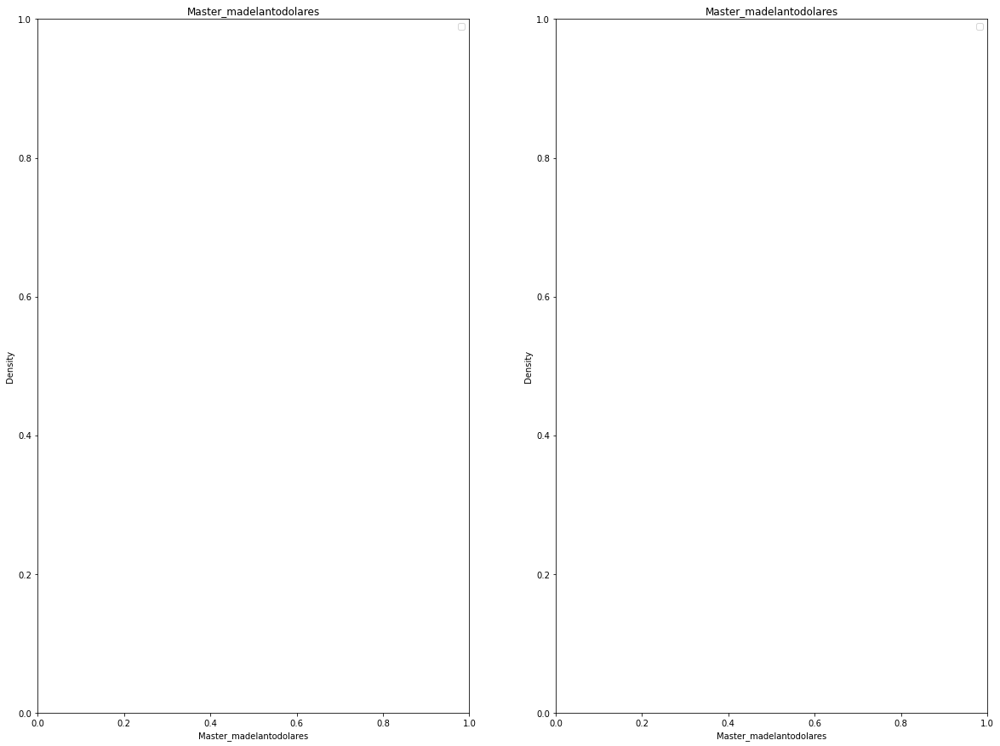

Variable: Master_madelantodolares
df_continua count   1522115.000
mean          0.044
std           4.774
min           0.000
25%           0.000
50%           0.000
75%           0.000
max        2619.770
Name: Master_madelantodolares, dtype: float64
df_bajas count   4034.000
mean       0.000
std        0.000
min        0.000
25%        0.000
50%        0.000
75%        0.000
max        0.000
Name: Master_madelantodolares, dtype: float64


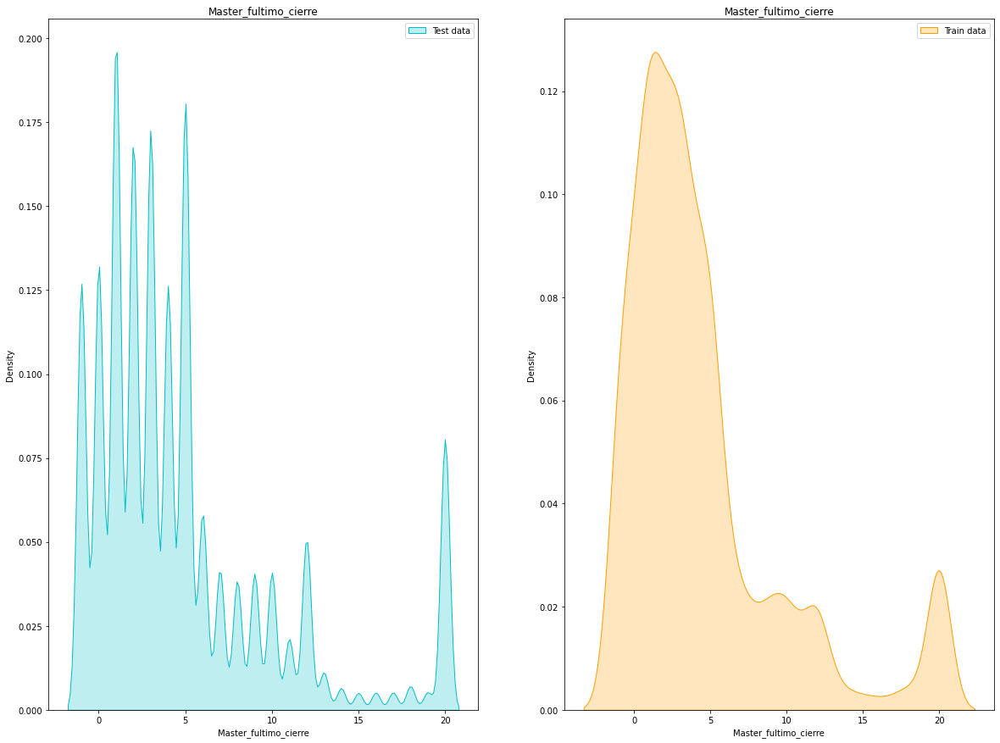

Variable: Master_fultimo_cierre
df_continua count   3312463.000
mean          6.031
std          49.398
min          -3.000
25%           1.000
50%           3.000
75%           6.000
max        4891.000
Name: Master_fultimo_cierre, dtype: float64
df_bajas count   13535.000
mean        6.368
std        67.707
min        -3.000
25%         1.000
50%         3.000
75%         5.000
max      4728.000
Name: Master_fultimo_cierre, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


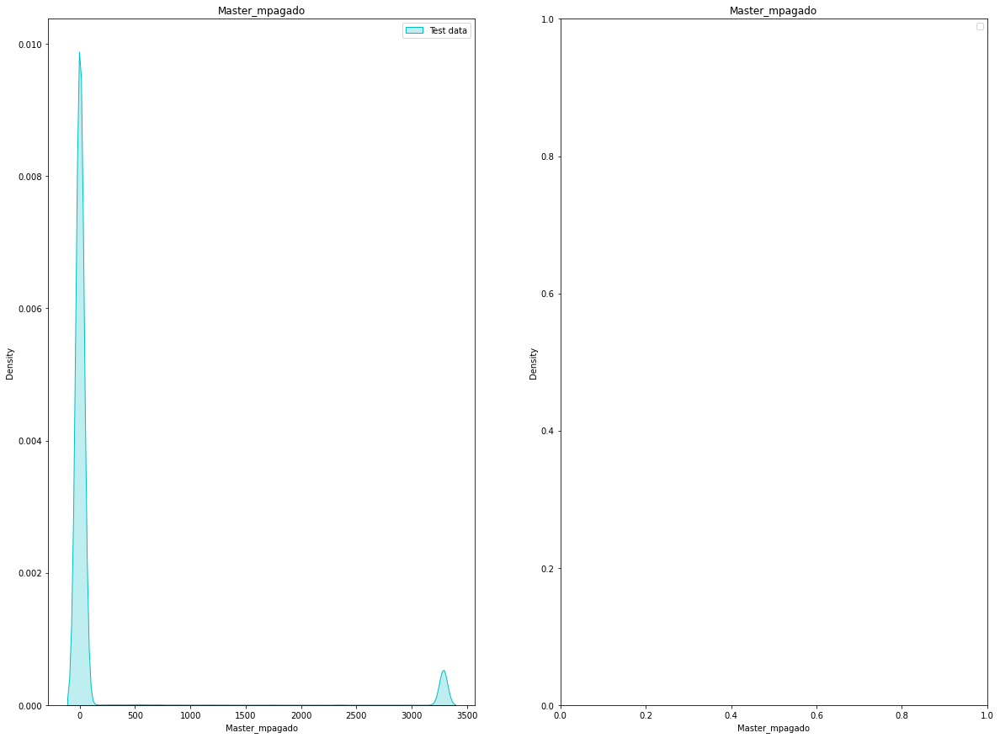

Variable: Master_mpagado
df_continua count   3314517.000
mean       1222.619
std       11035.955
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     2344609.980
Name: Master_mpagado, dtype: float64
df_bajas count    13540.000
mean       339.912
std       3735.955
min          0.000
25%          0.000
50%          0.000
75%          0.000
max     186882.360
Name: Master_mpagado, dtype: float64


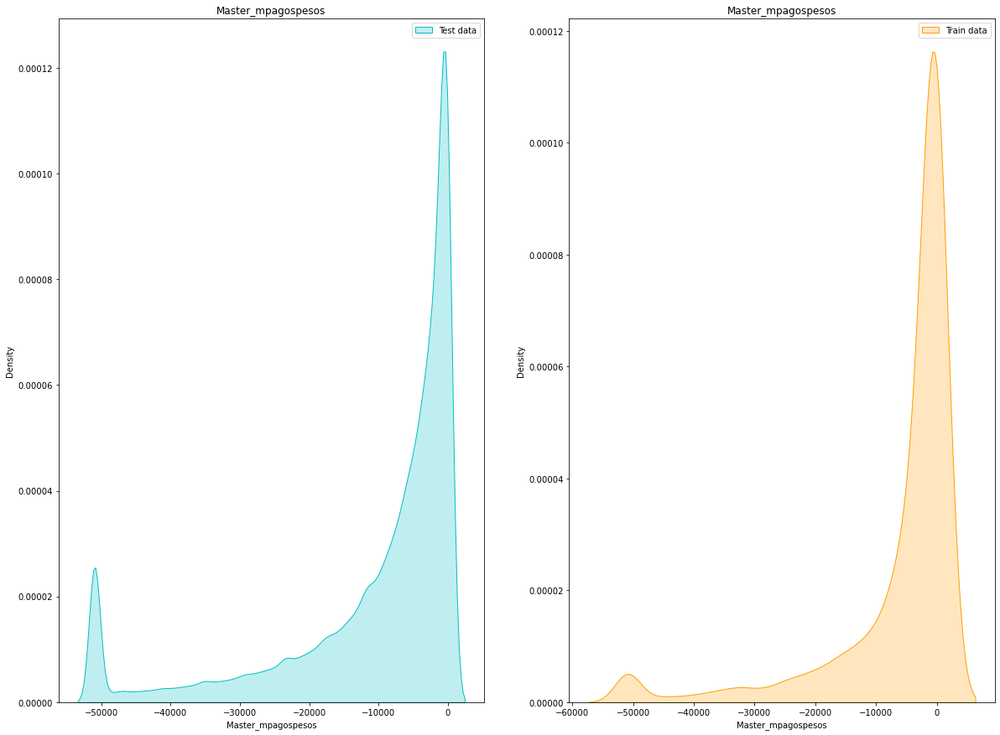

Variable: Master_mpagospesos
df_continua count    1522115.000
mean      -13543.876
std        32119.286
min     -2995348.640
25%       -14326.015
50%        -5159.370
75%        -1257.490
max       441010.330
Name: Master_mpagospesos, dtype: float64
df_bajas count       4034.000
mean       -8251.270
std        44276.420
min     -1736894.600
25%        -6446.135
50%         -907.900
75%            0.000
max       166214.000
Name: Master_mpagospesos, dtype: float64


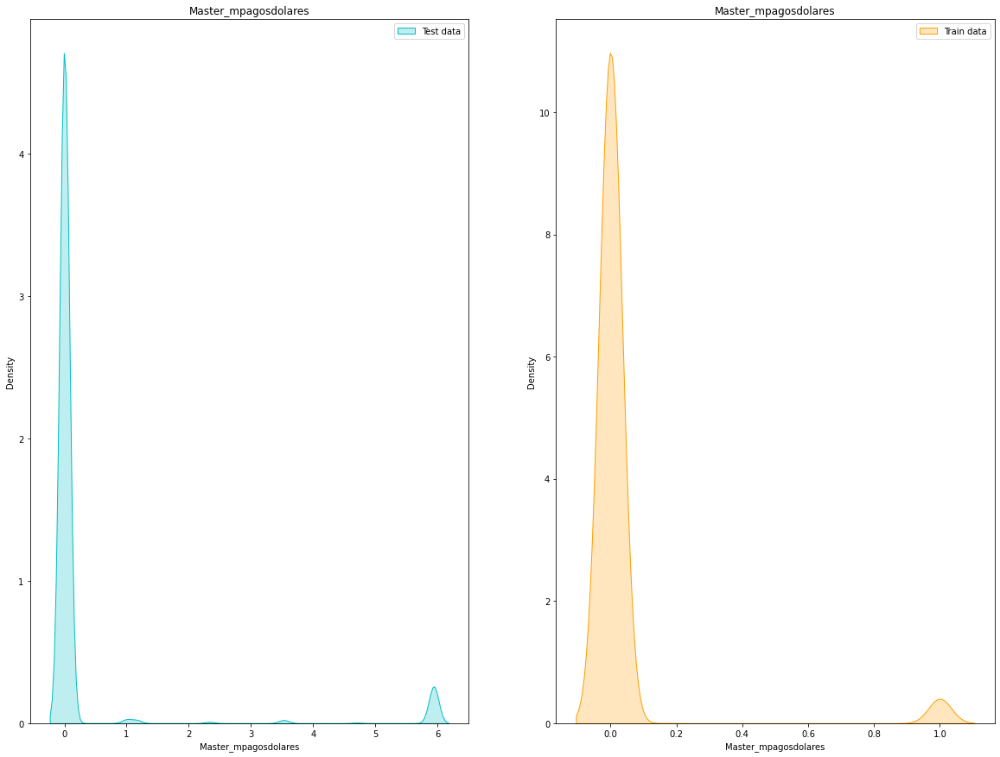

Variable: Master_mpagosdolares
df_continua count   1522115.000
mean         14.821
std         186.742
min           0.000
25%           0.000
50%           0.000
75%           0.000
max       29205.650
Name: Master_mpagosdolares, dtype: float64
df_bajas count    4034.000
mean        7.924
std       185.974
min         0.000
25%         0.000
50%         0.000
75%         0.000
max     10334.300
Name: Master_mpagosdolares, dtype: float64


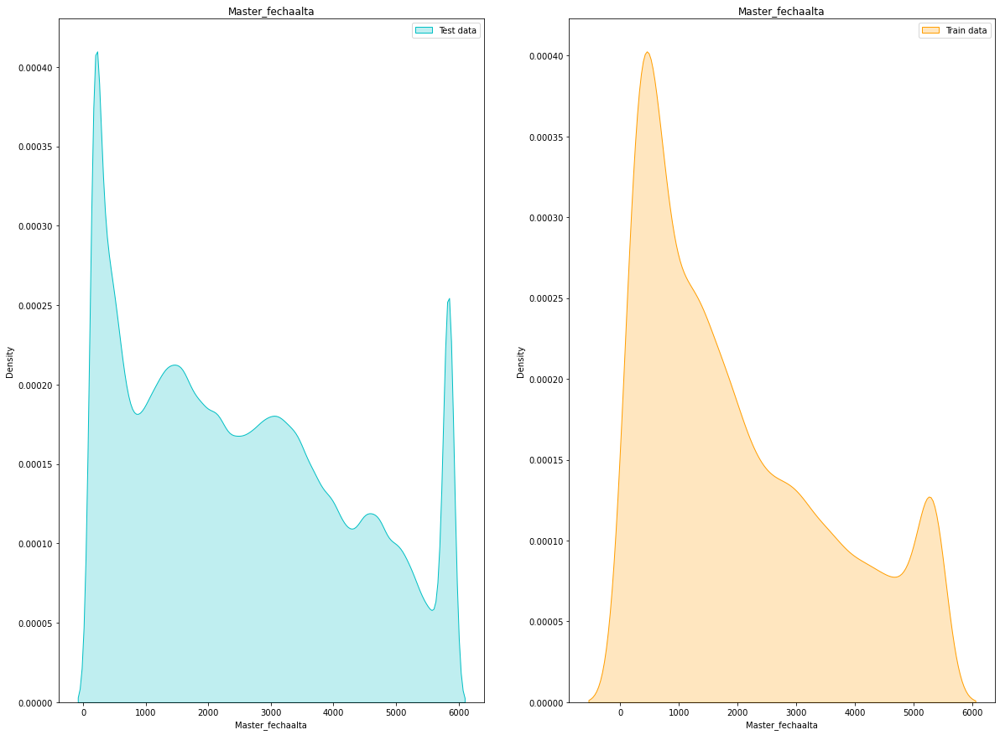

Variable: Master_fechaalta
df_continua count   3314517.000
mean       2553.452
std        1824.506
min           1.000
25%        1026.000
50%        2297.000
75%        3781.000
max        7724.000
Name: Master_fechaalta, dtype: float64
df_bajas count   13540.000
mean     2066.844
std      1721.269
min         1.000
25%       632.000
50%      1568.500
75%      3107.250
max      7724.000
Name: Master_fechaalta, dtype: float64


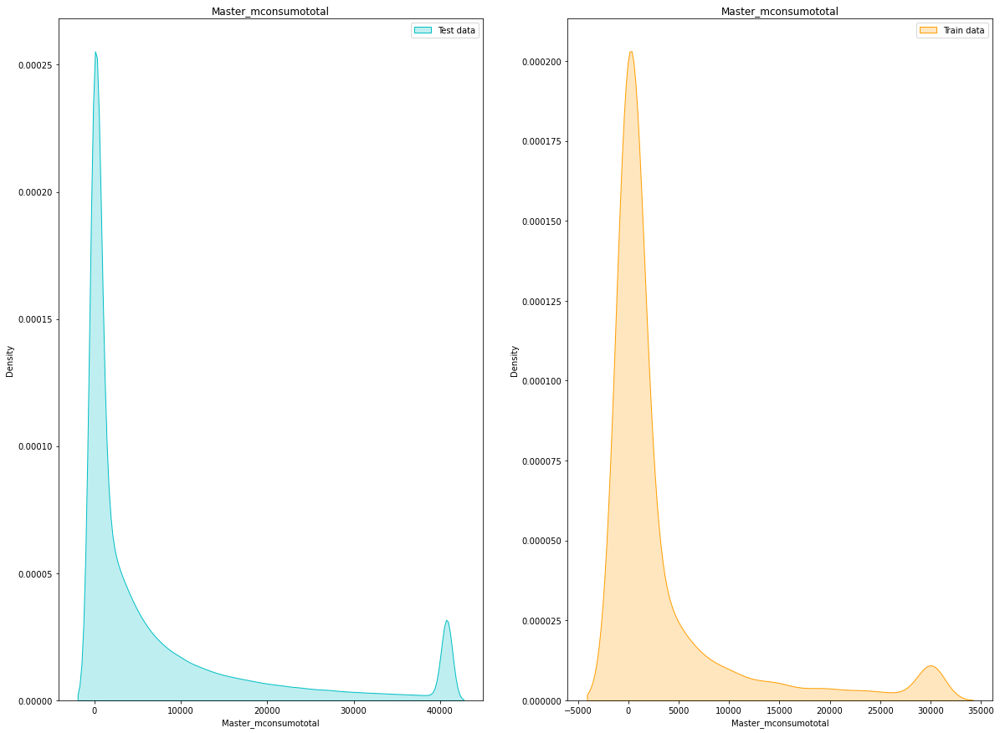

Variable: Master_mconsumototal
df_continua count   1522115.000
mean       9552.988
std       28134.336
min     -121540.980
25%           0.000
50%        1830.460
75%        8831.440
max     2922921.350
Name: Master_mconsumototal, dtype: float64
df_bajas count     4034.000
mean      4902.739
std      17523.326
min      -7122.380
25%          0.000
50%        106.055
75%       2849.990
max     418173.520
Name: Master_mconsumototal, dtype: float64


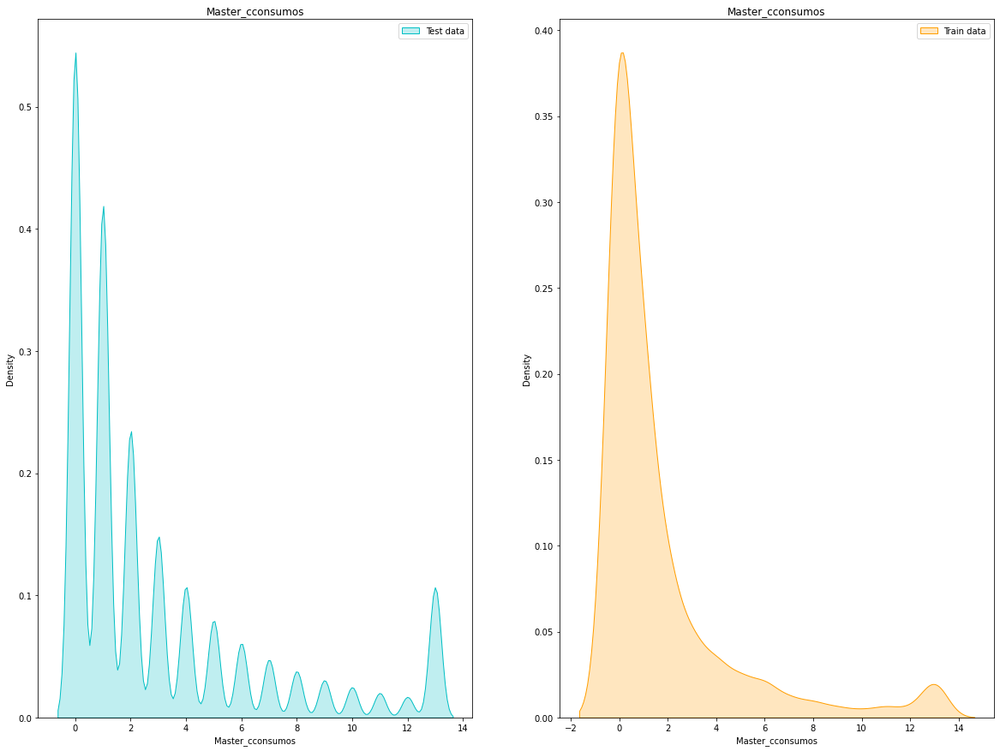

Variable: Master_cconsumos
df_continua count   1522115.000
mean          3.396
std           5.716
min           0.000
25%           0.000
50%           1.000
75%           4.000
max         253.000
Name: Master_cconsumos, dtype: float64
df_bajas count   4034.000
mean       1.898
std        4.014
min        0.000
25%        0.000
50%        1.000
75%        2.000
max       49.000
Name: Master_cconsumos, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


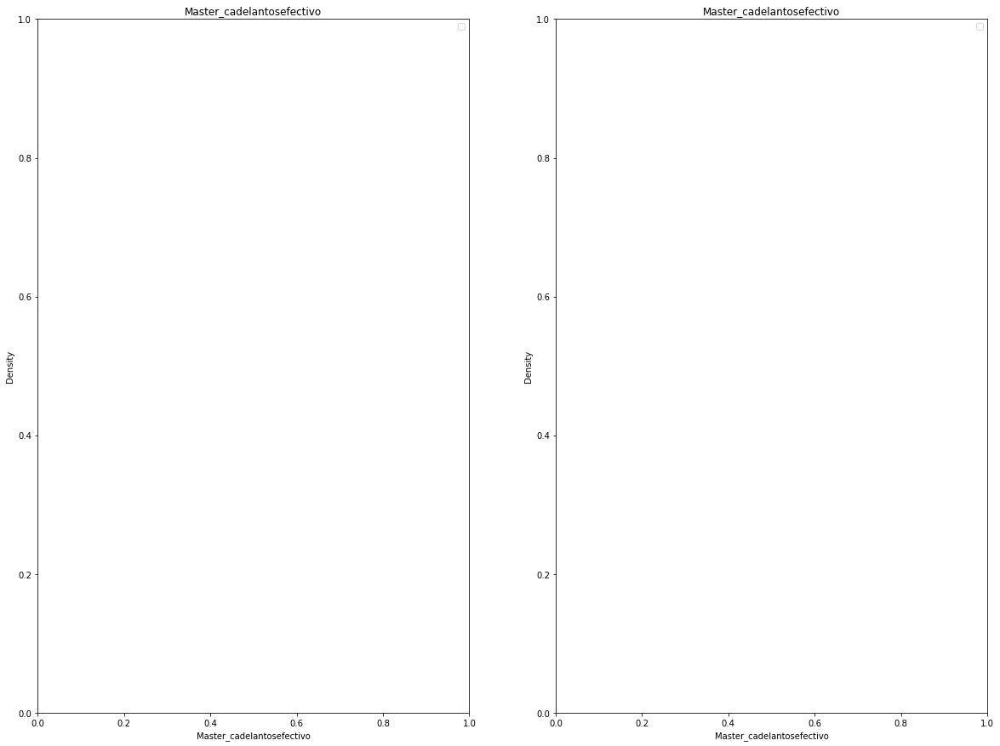

Variable: Master_cadelantosefectivo
df_continua count   1522115.000
mean          0.025
std           0.390
min           0.000
25%           0.000
50%           0.000
75%           0.000
max          34.000
Name: Master_cadelantosefectivo, dtype: float64
df_bajas count   4034.000
mean       0.055
std        0.612
min        0.000
25%        0.000
50%        0.000
75%        0.000
max        9.000
Name: Master_cadelantosefectivo, dtype: float64


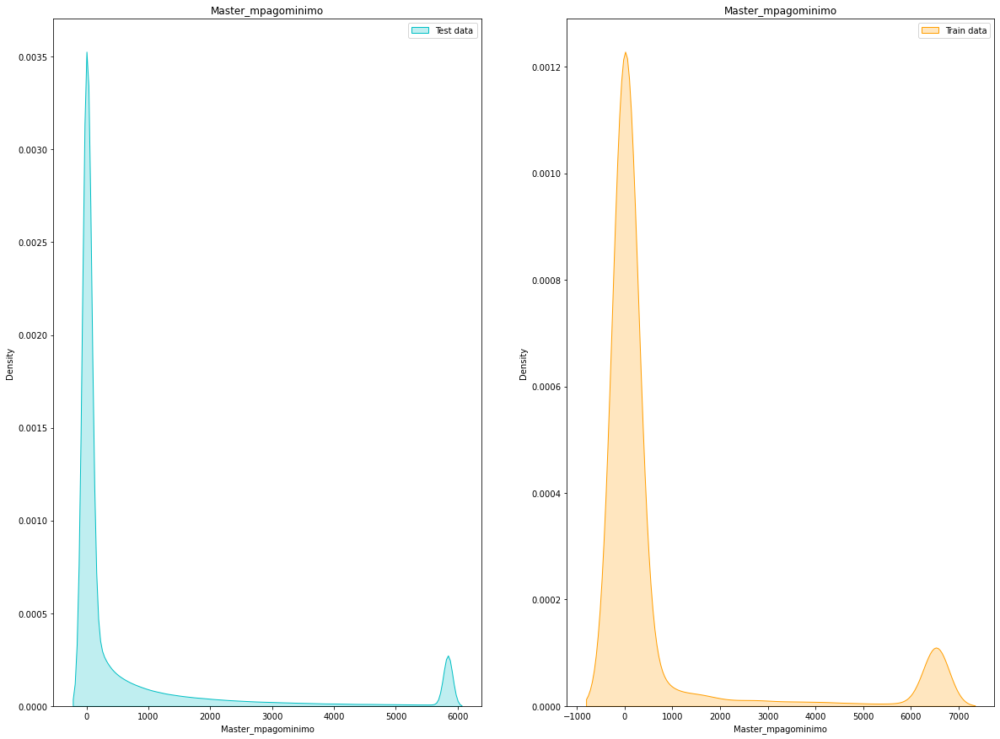

Variable: Master_mpagominimo
df_continua count   3314517.000
mean       1431.831
std       11471.762
min           0.000
25%           0.000
50%           0.000
75%         410.550
max     5537298.990
Name: Master_mpagominimo, dtype: float64
df_bajas count     13540.000
mean       5854.130
std       48613.958
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     1882665.000
Name: Master_mpagominimo, dtype: float64


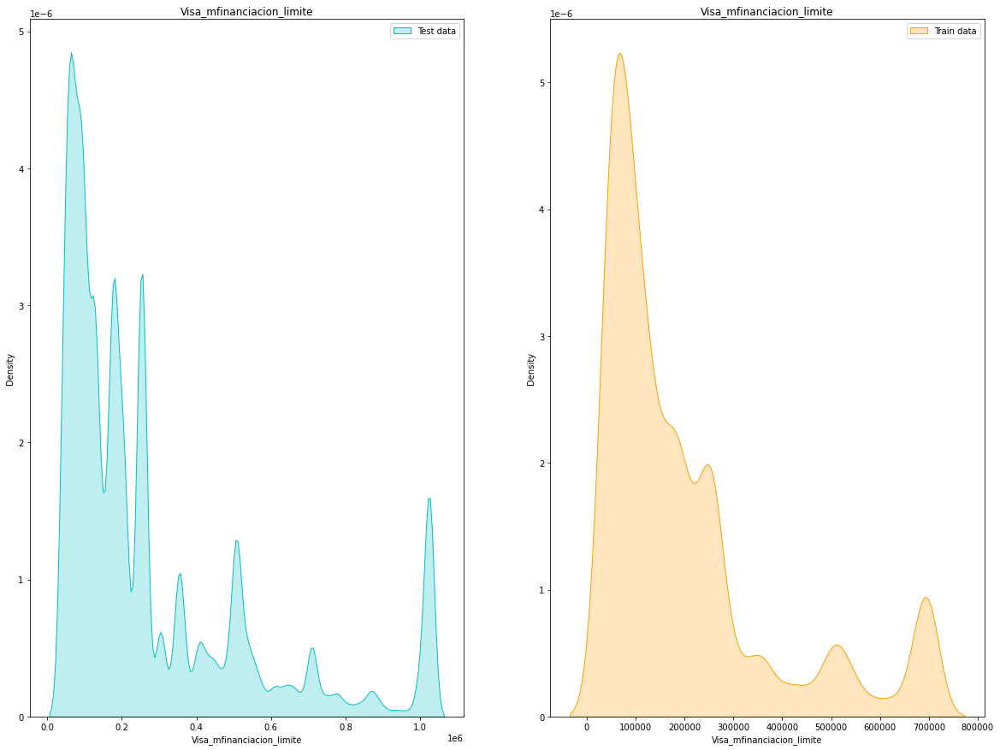

Variable: Visa_mfinanciacion_limite
df_continua count     3559882.000
mean       344960.921
std       1794773.273
min             0.000
25%         88678.800
50%        177357.600
75%        354715.200
max     535820112.720
Name: Visa_mfinanciacion_limite, dtype: float64
df_bajas count      15469.000
mean      233646.459
std      1083405.894
min            0.000
25%        63342.000
50%       126684.000
75%       253368.000
max     99394588.770
Name: Visa_mfinanciacion_limite, dtype: float64


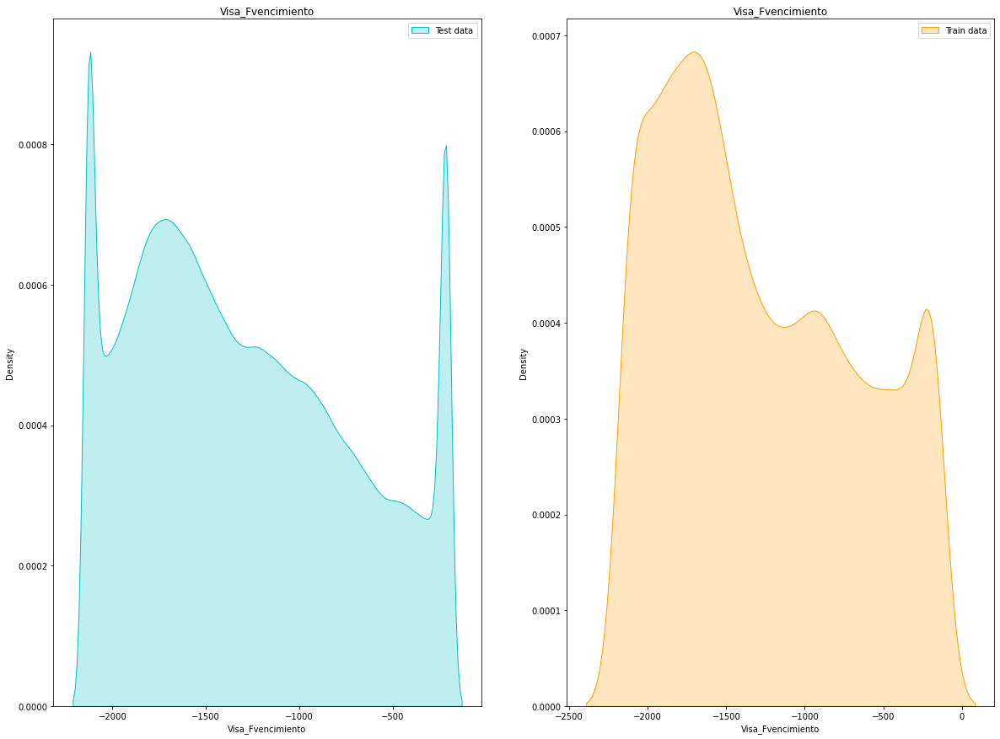

Variable: Visa_Fvencimiento
df_continua count    3559882.000
mean      -12180.024
std       177800.804
min     -2914968.000
25%        -1764.000
50%        -1369.000
75%         -852.000
max         6790.000
Name: Visa_Fvencimiento, dtype: float64
df_bajas count      15469.000
mean      -11249.220
std       170239.314
min     -2914968.000
25%        -1795.000
50%        -1399.000
75%         -790.000
max         4842.000
Name: Visa_Fvencimiento, dtype: float64


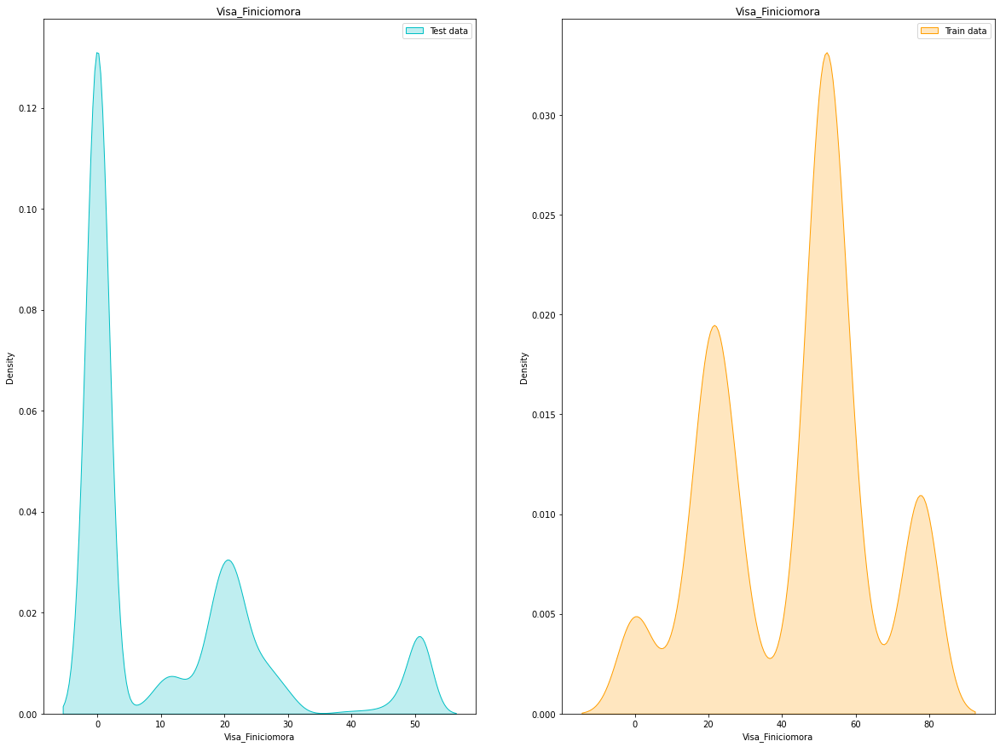

Variable: Visa_Finiciomora
df_continua count   44182.000
mean       11.724
std        19.876
min         0.000
25%         0.000
50%         0.000
75%        20.000
max       358.000
Name: Visa_Finiciomora, dtype: float64
df_bajas count   1843.000
mean      45.111
std       26.698
min        0.000
25%       22.000
50%       51.000
75%       55.000
max      261.000
Name: Visa_Finiciomora, dtype: float64


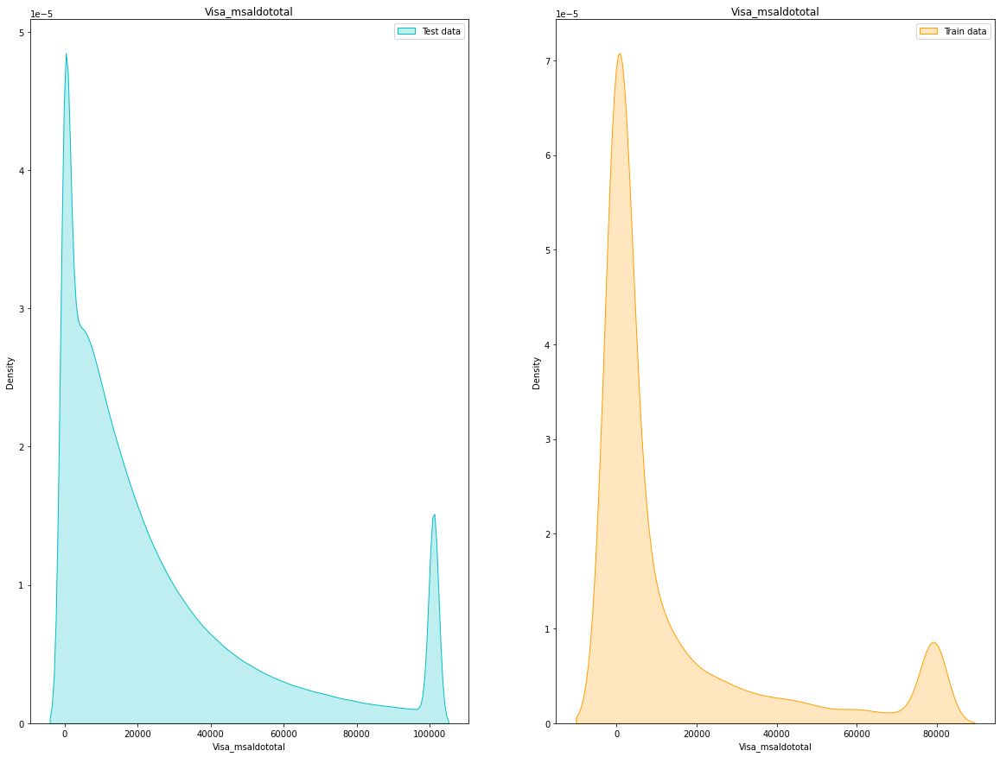

Variable: Visa_msaldototal
df_continua count    3559882.000
mean       29191.596
std        54754.954
min     -1135816.660
25%         4968.102
50%        15154.225
75%        34324.357
max      5102388.550
Name: Visa_msaldototal, dtype: float64
df_bajas count     15469.000
mean      23107.087
std       93893.941
min     -916540.540
25%           0.000
50%        1316.720
75%       14376.000
max     6302363.500
Name: Visa_msaldototal, dtype: float64


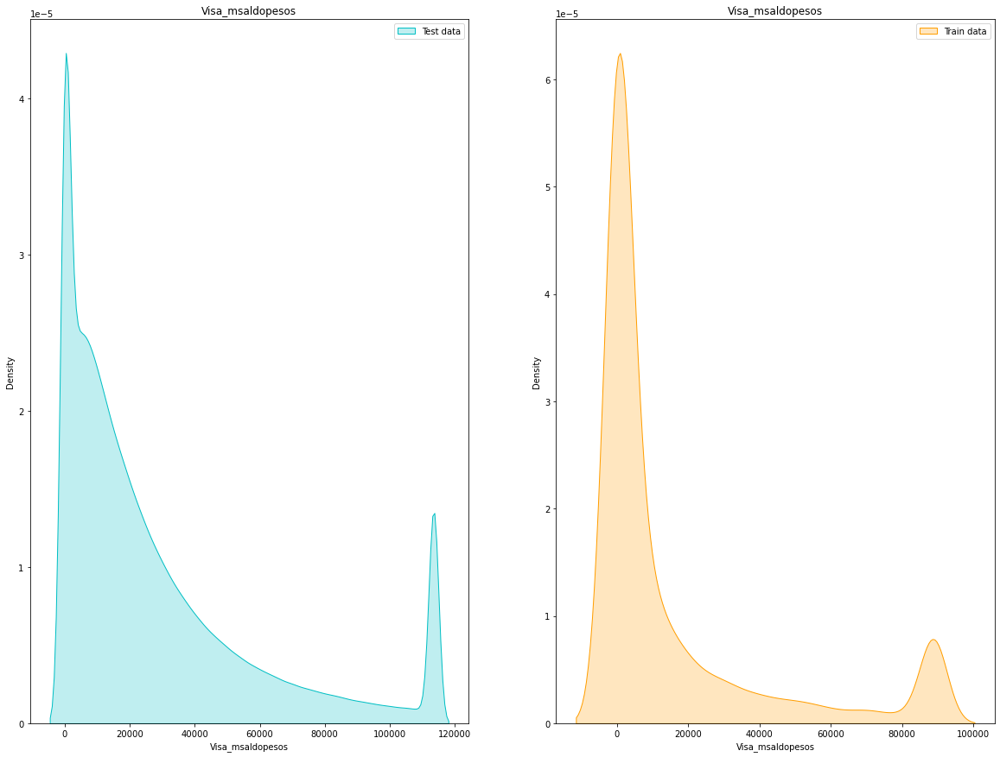

Variable: Visa_msaldopesos
df_continua count    3559882.000
mean       32989.969
std        60841.448
min     -1062158.590
25%         5671.710
50%        17295.940
75%        39042.940
max      5976431.970
Name: Visa_msaldopesos, dtype: float64
df_bajas count     15469.000
mean      26808.197
std      108645.155
min     -790470.210
25%           0.000
50%        1517.660
75%       16576.950
max     7392672.380
Name: Visa_msaldopesos, dtype: float64


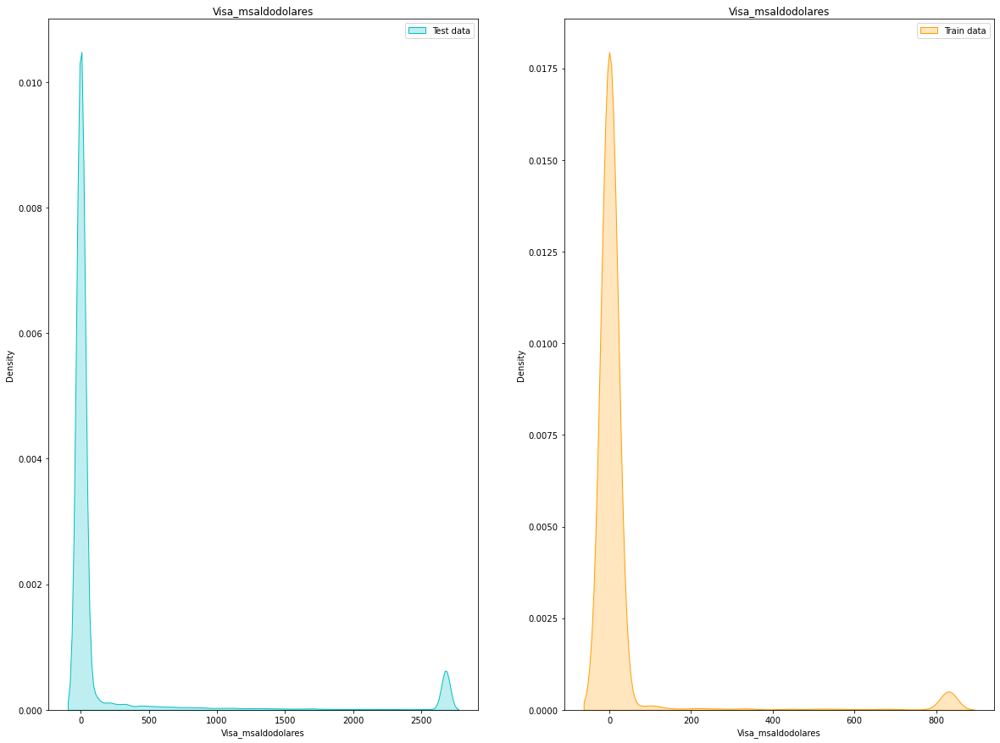

Variable: Visa_msaldodolares
df_continua count    3559882.000
mean        1254.544
std        14336.234
min     -1383833.480
25%            0.000
50%            0.000
75%            0.000
max      3578602.540
Name: Visa_msaldodolares, dtype: float64
df_bajas count      15469.000
mean         296.413
std        16233.953
min     -1060335.820
25%            0.000
50%            0.000
75%            0.000
max      1368637.050
Name: Visa_msaldodolares, dtype: float64


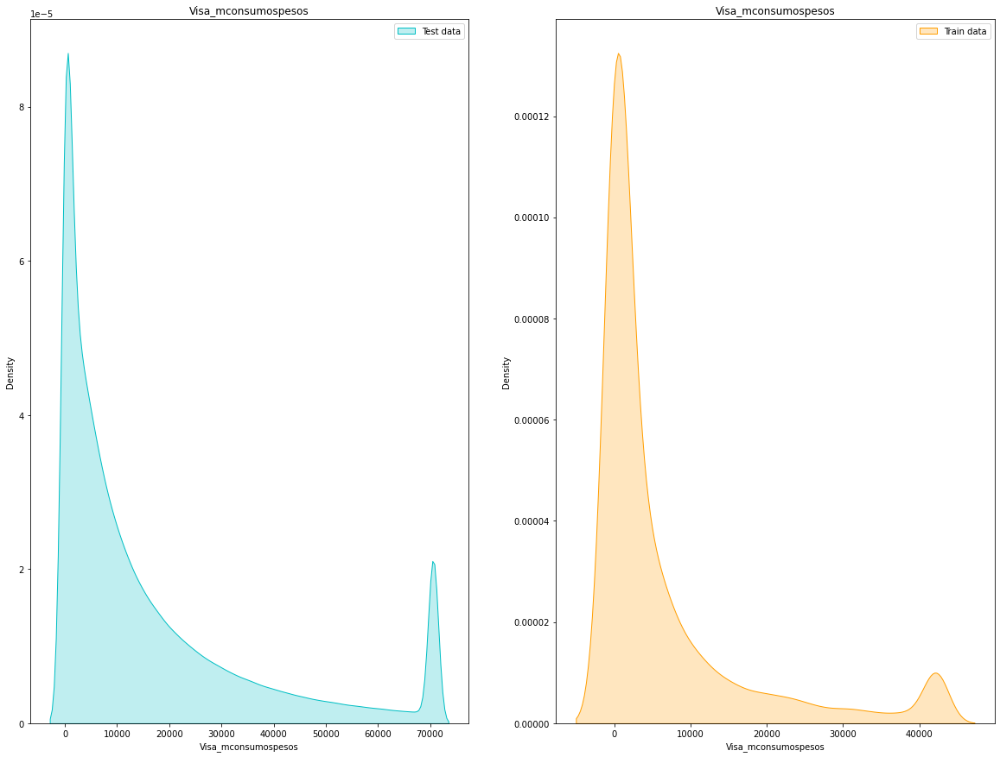

Variable: Visa_mconsumospesos
df_continua count   3255585.000
mean      19065.085
std       36164.278
min     -182425.240
25%        2128.170
50%        8415.790
75%       22472.410
max     5852397.550
Name: Visa_mconsumospesos, dtype: float64
df_bajas count     10377.000
mean       8288.399
std       29113.811
min      -12254.160
25%           0.000
50%        1382.960
75%        7258.570
max     1438900.560
Name: Visa_mconsumospesos, dtype: float64


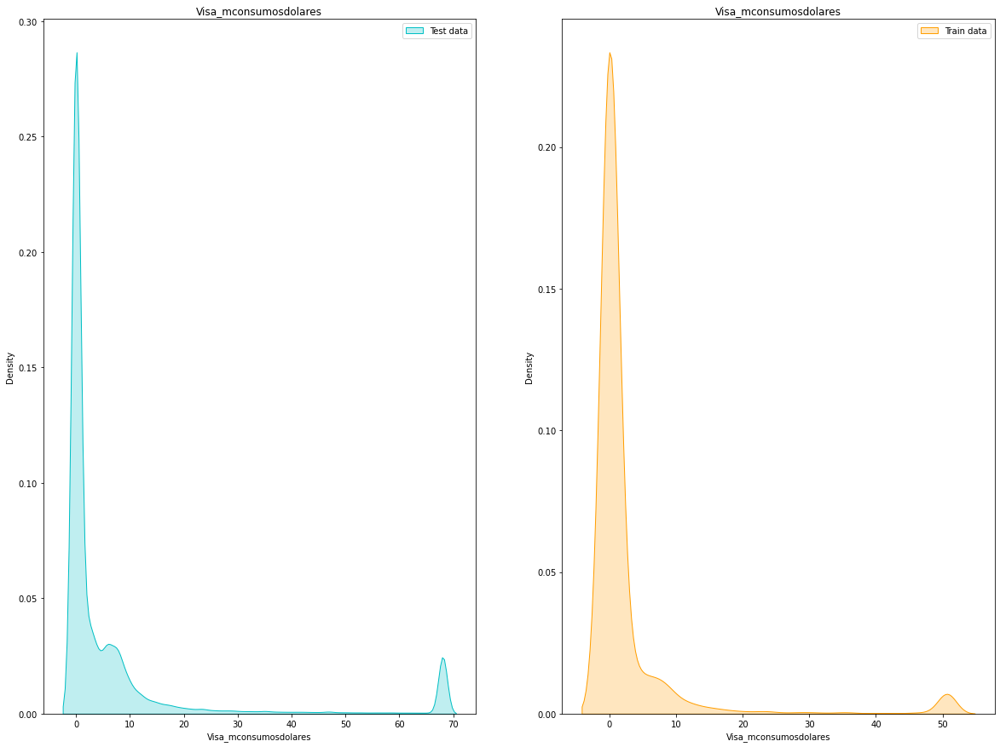

Variable: Visa_mconsumosdolares
df_continua count   3255585.000
mean         31.126
std         242.277
min           0.000
25%           0.000
50%           0.000
75%           5.980
max       46975.070
Name: Visa_mconsumosdolares, dtype: float64
df_bajas count   10377.000
mean       14.476
std       276.362
min         0.000
25%         0.000
50%         0.000
75%         0.000
max     24727.400
Name: Visa_mconsumosdolares, dtype: float64


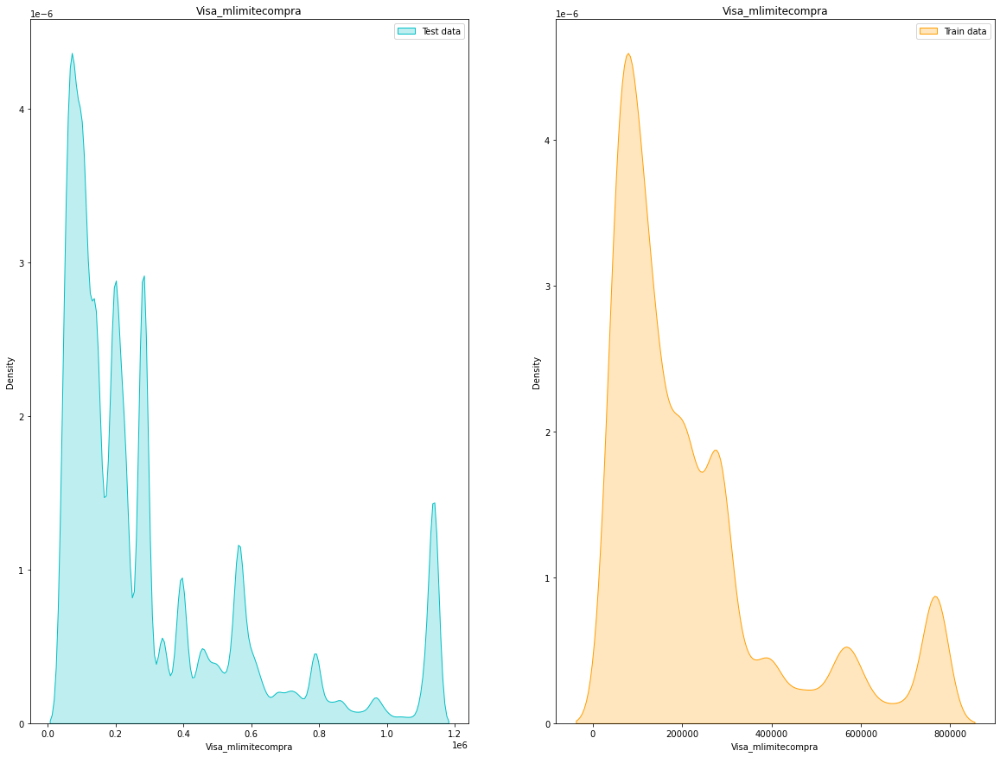

Variable: Visa_mlimitecompra
df_continua count    3559882.000
mean      342832.827
std       447640.226
min          674.470
25%        98532.000
50%       197064.000
75%       394128.000
max     27141343.200
Name: Visa_mlimitecompra, dtype: float64
df_bajas count     15469.000
mean     254156.170
std      333320.744
min         674.470
25%       84456.000
50%      140760.000
75%      281520.000
max     5650106.400
Name: Visa_mlimitecompra, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


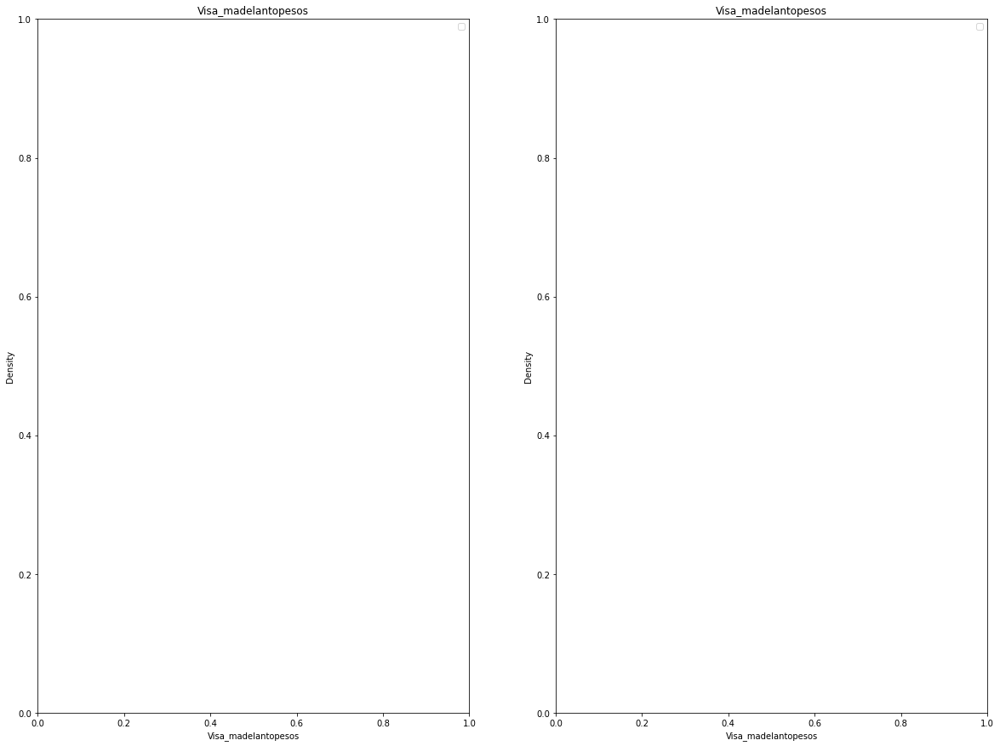

Variable: Visa_madelantopesos
df_continua count   3255585.000
mean         46.443
std         868.866
min           0.000
25%           0.000
50%           0.000
75%           0.000
max      193785.750
Name: Visa_madelantopesos, dtype: float64
df_bajas count   10377.000
mean       38.507
std       742.630
min         0.000
25%         0.000
50%         0.000
75%         0.000
max     17595.000
Name: Visa_madelantopesos, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


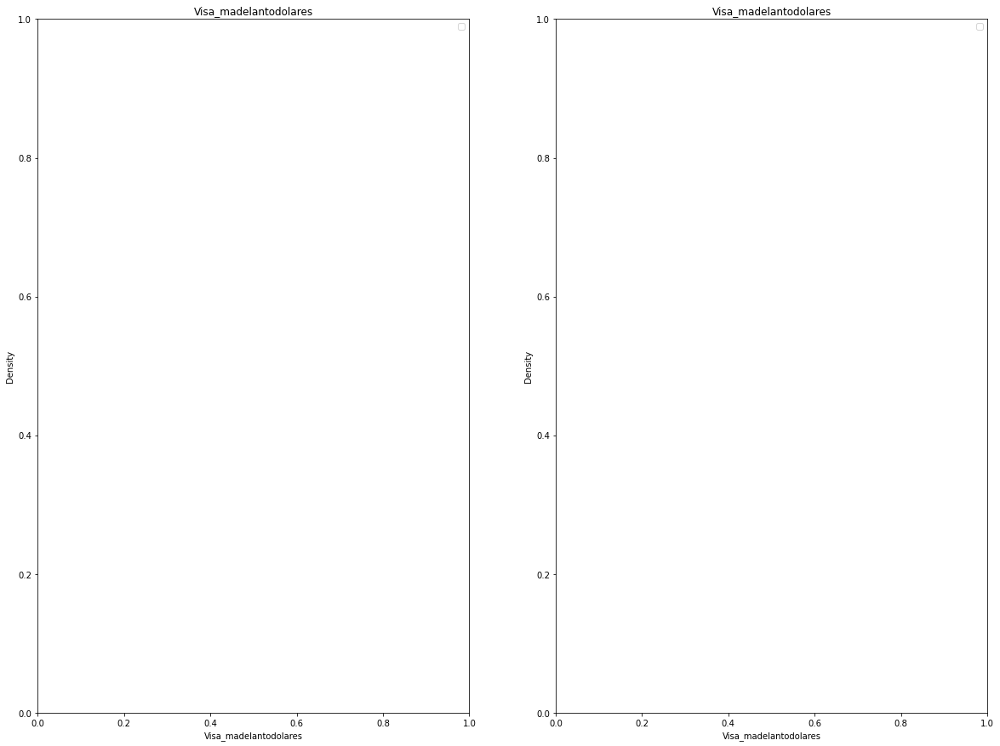

Variable: Visa_madelantodolares
df_continua count   3255585.000
mean          0.101
std           7.088
min           0.000
25%           0.000
50%           0.000
75%           0.000
max        2922.840
Name: Visa_madelantodolares, dtype: float64
df_bajas count   10377.000
mean        0.064
std         4.669
min         0.000
25%         0.000
50%         0.000
75%         0.000
max       391.130
Name: Visa_madelantodolares, dtype: float64


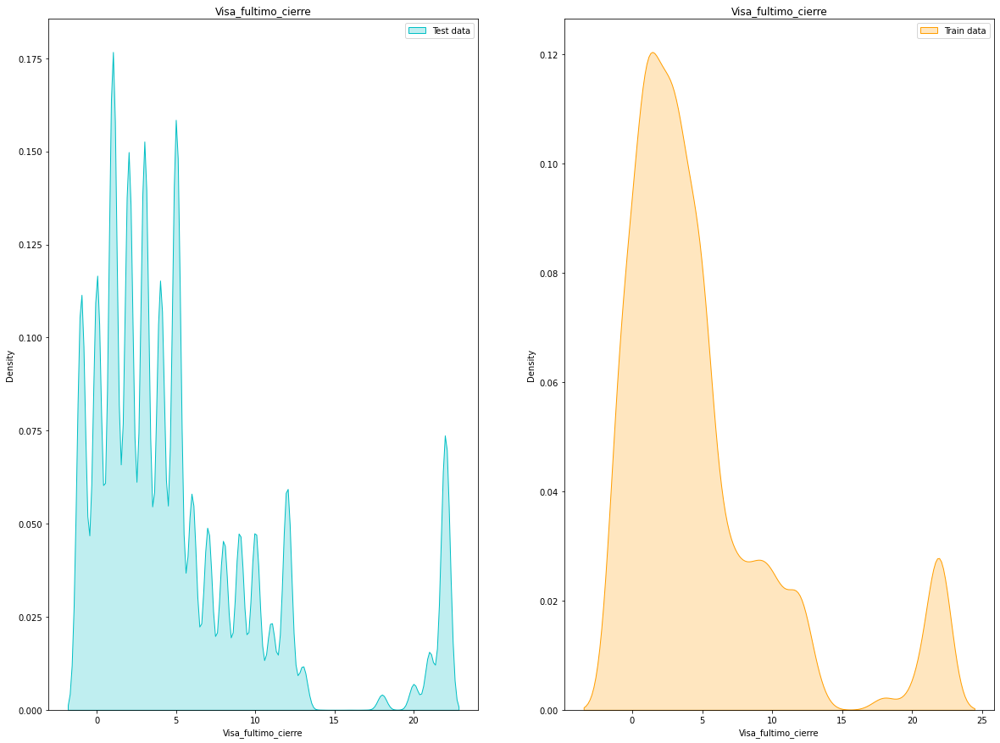

Variable: Visa_fultimo_cierre
df_continua count   3558566.000
mean          5.865
std          39.961
min          -3.000
25%           1.000
50%           4.000
75%           7.000
max        5092.000
Name: Visa_fultimo_cierre, dtype: float64
df_bajas count   15467.000
mean        8.454
std       105.463
min        -3.000
25%         1.000
50%         3.000
75%         6.000
max      4487.000
Name: Visa_fultimo_cierre, dtype: float64


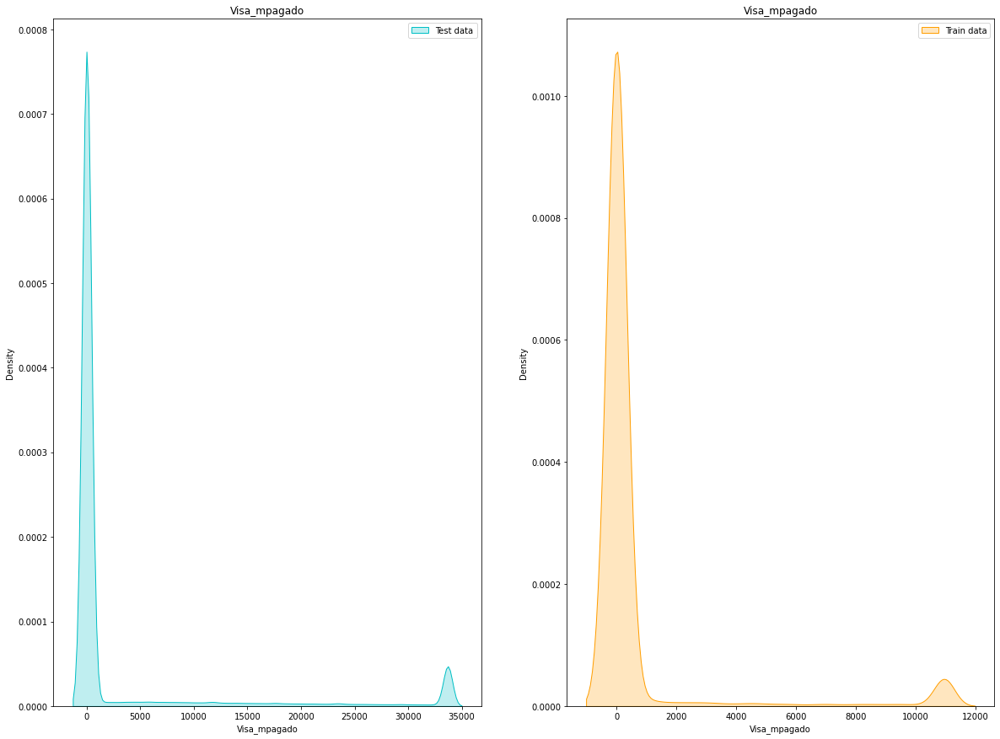

Variable: Visa_mpagado
df_continua count   3559882.000
mean       5403.722
std       23105.357
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     3004666.810
Name: Visa_mpagado, dtype: float64
df_bajas count    15469.000
mean      1533.943
std      11680.737
min          0.000
25%          0.000
50%          0.000
75%          0.000
max     919248.580
Name: Visa_mpagado, dtype: float64


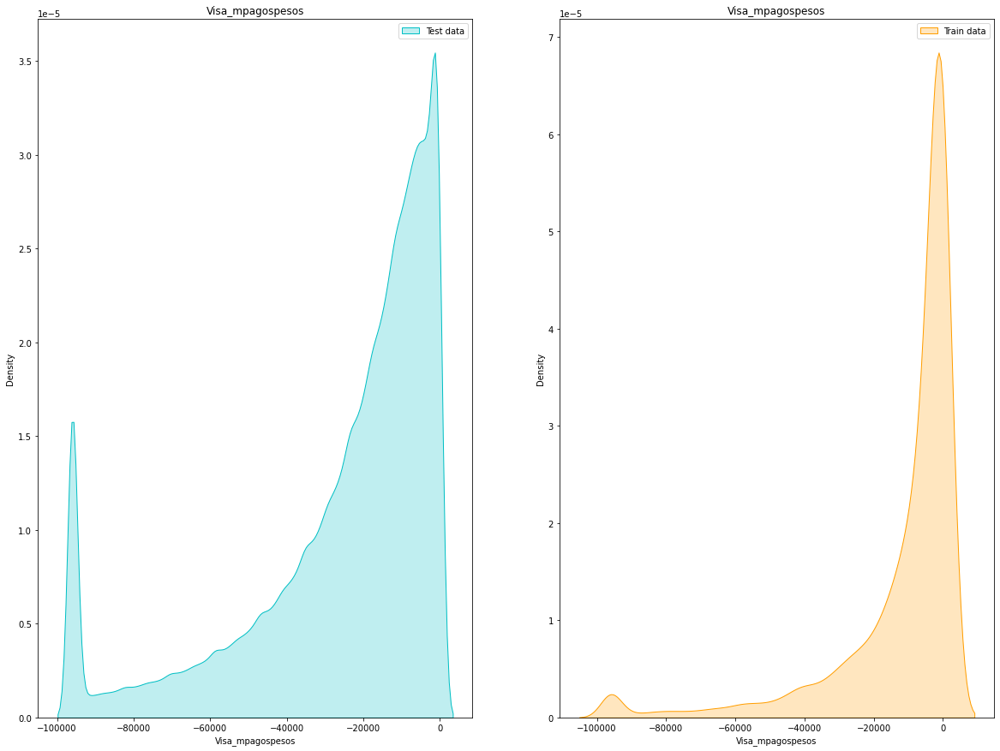

Variable: Visa_mpagospesos
df_continua count    3255585.000
mean      -29368.216
std        44867.963
min     -5985264.530
25%       -35458.540
50%       -16999.330
75%        -6989.490
max      1003606.740
Name: Visa_mpagospesos, dtype: float64
df_bajas count      10377.000
mean      -13011.264
std        30942.308
min     -1250986.300
25%       -14396.990
50%        -3648.270
75%         -239.650
max       194943.120
Name: Visa_mpagospesos, dtype: float64


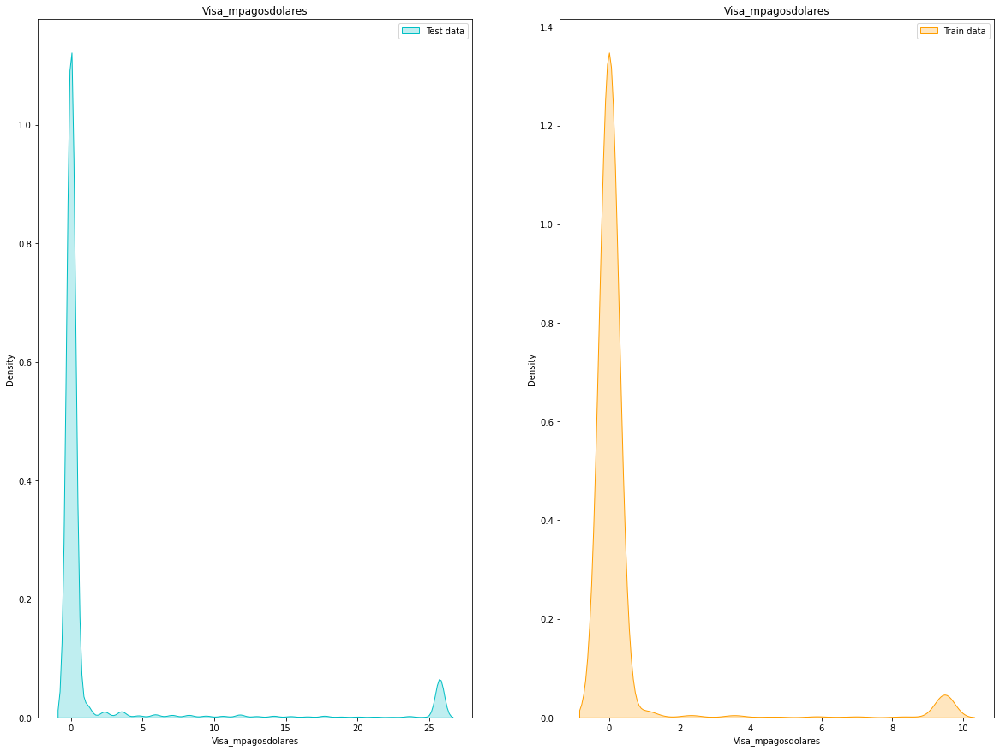

Variable: Visa_mpagosdolares
df_continua count   3255585.000
mean         19.866
std         201.101
min           0.000
25%           0.000
50%           0.000
75%           0.000
max       31533.440
Name: Visa_mpagosdolares, dtype: float64
df_bajas count   10377.000
mean        8.337
std       158.317
min         0.000
25%         0.000
50%         0.000
75%         0.000
max     13648.620
Name: Visa_mpagosdolares, dtype: float64


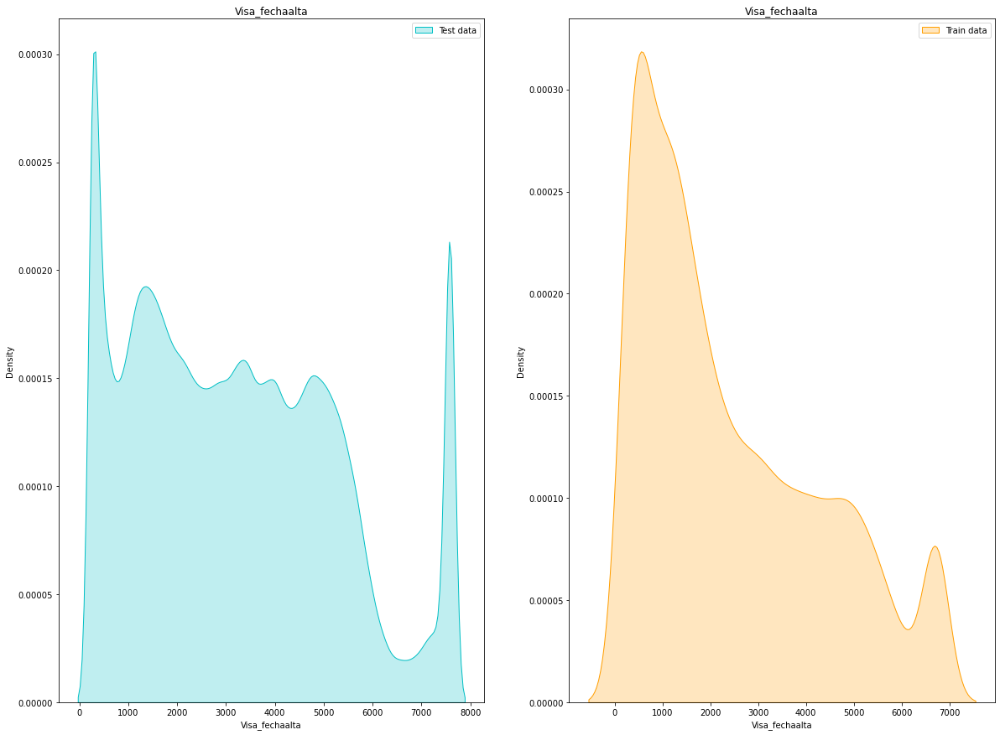

Variable: Visa_fechaalta
df_continua count   3559882.000
mean       3215.779
std        2165.600
min           1.000
25%        1431.000
50%        2995.000
75%        4690.000
max       12767.000
Name: Visa_fechaalta, dtype: float64
df_bajas count   15469.000
mean     2508.361
std      2064.181
min         2.000
25%       864.000
50%      1859.000
75%      3818.000
max     11546.000
Name: Visa_fechaalta, dtype: float64


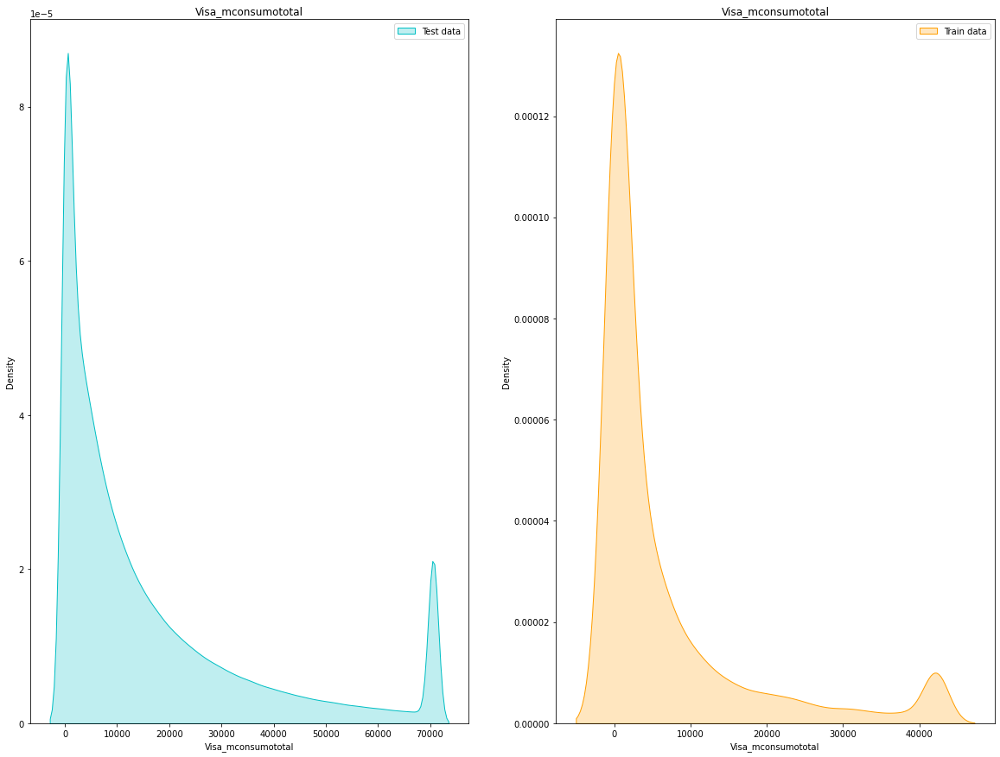

Variable: Visa_mconsumototal
df_continua count   3255585.000
mean      19065.085
std       36164.278
min     -182425.240
25%        2128.170
50%        8415.790
75%       22472.410
max     5852397.550
Name: Visa_mconsumototal, dtype: float64
df_bajas count     10377.000
mean       8288.399
std       29113.811
min      -12254.160
25%           0.000
50%        1382.960
75%        7258.570
max     1438900.560
Name: Visa_mconsumototal, dtype: float64


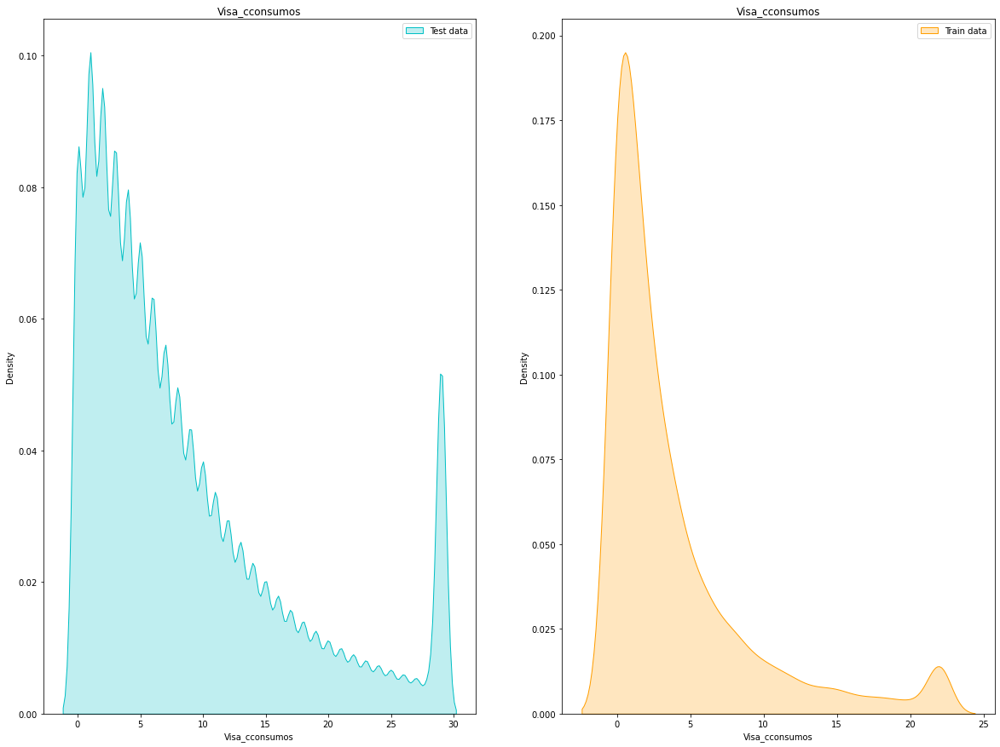

Variable: Visa_cconsumos
df_continua count   3255585.000
mean          9.077
std          10.649
min           0.000
25%           2.000
50%           6.000
75%          12.000
max         768.000
Name: Visa_cconsumos, dtype: float64
df_bajas count   10377.000
mean        4.128
std         6.899
min         0.000
25%         0.000
50%         2.000
75%         5.000
max       242.000
Name: Visa_cconsumos, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


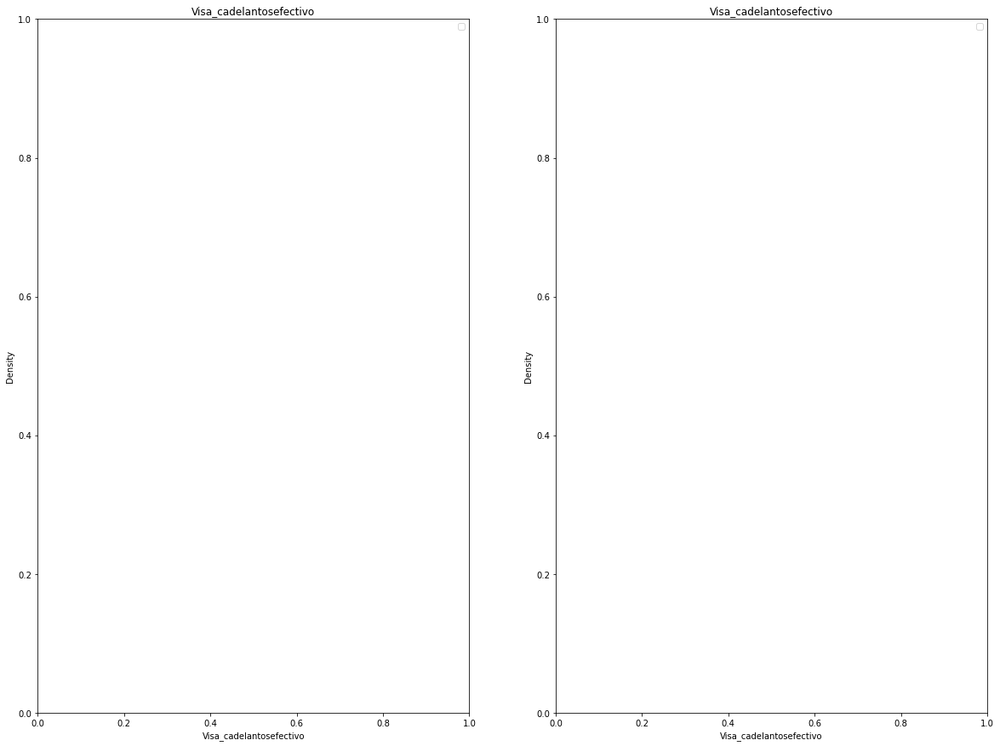

Variable: Visa_cadelantosefectivo
df_continua count   3255585.000
mean          0.016
std           0.286
min           0.000
25%           0.000
50%           0.000
75%           0.000
max          30.000
Name: Visa_cadelantosefectivo, dtype: float64
df_bajas count   10377.000
mean        0.014
std         0.275
min         0.000
25%         0.000
50%         0.000
75%         0.000
max         8.000
Name: Visa_cadelantosefectivo, dtype: float64


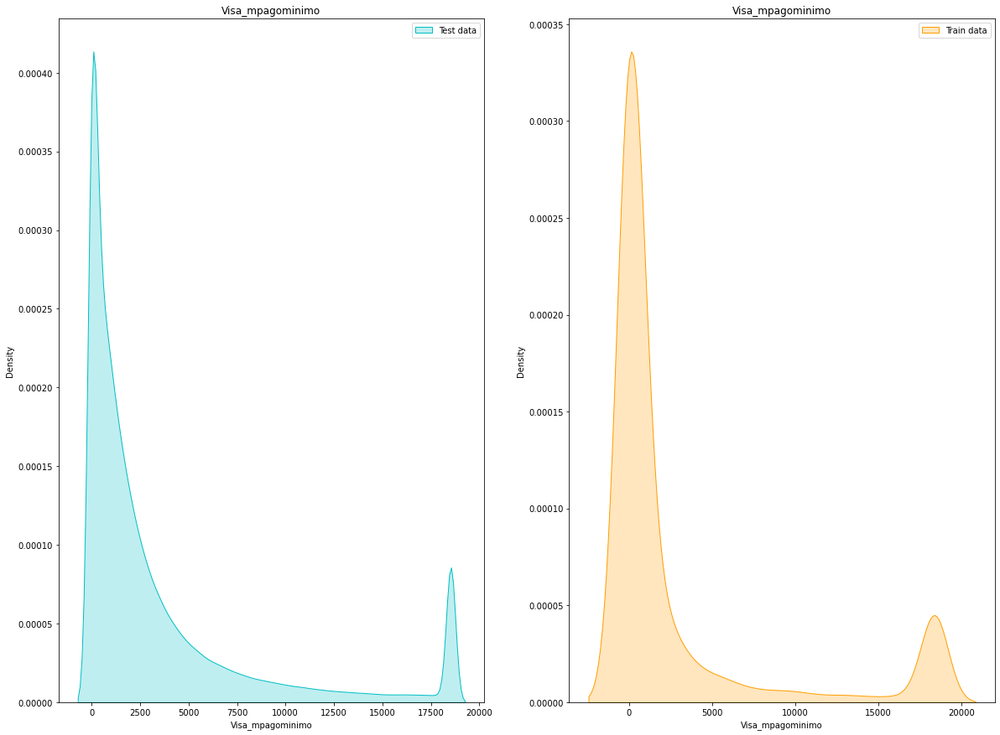

Variable: Visa_mpagominimo
df_continua count   3559882.000
mean       4669.161
std       15323.717
min           0.000
25%         363.630
50%        1477.980
75%        4023.390
max     3267391.500
Name: Visa_mpagominimo, dtype: float64
df_bajas count     15469.000
mean      10822.650
std       76764.625
min           0.000
25%           0.000
50%          82.110
75%        1853.340
max     6471100.830
Name: Visa_mpagominimo, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


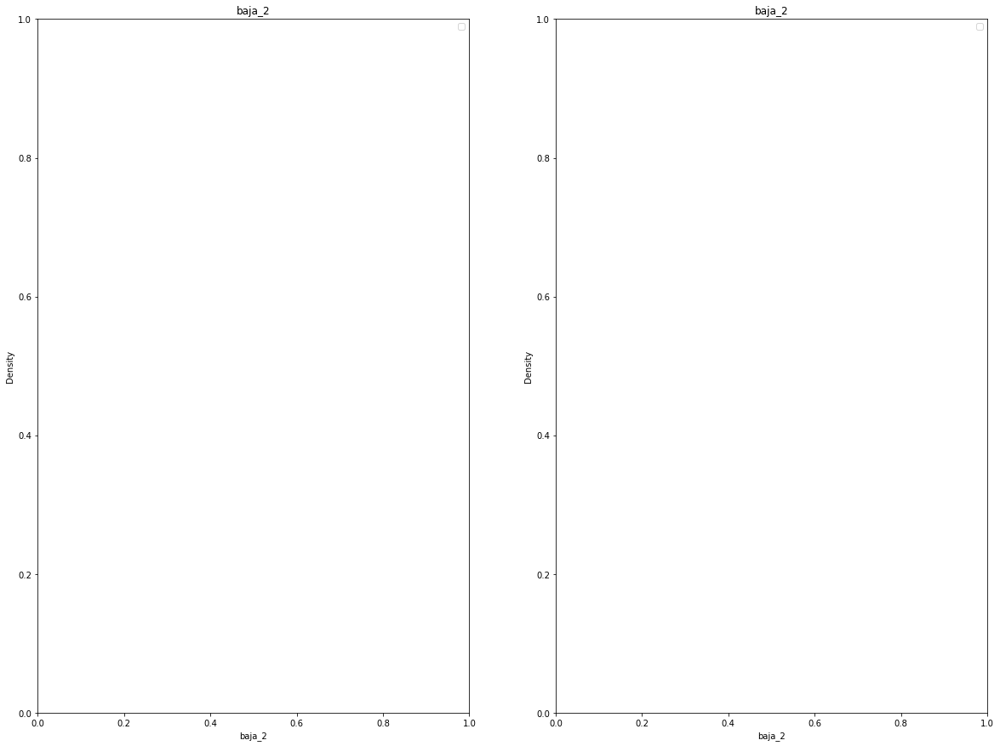

Variable: baja_2
df_continua count   3686828.000
mean          0.000
std           0.000
min           0.000
25%           0.000
50%           0.000
75%           0.000
max           0.000
Name: baja_2, dtype: float64
df_bajas count   19618.000
mean        1.000
std         0.000
min         1.000
25%         1.000
50%         1.000
75%         1.000
max         1.000
Name: baja_2, dtype: float64


In [35]:
ncols = 2
#for every numerical column, plot:
#                sns.kdeplot(x=df_continua.loc[df['baja_2'] == 0, i].clip(upper=df[i].quantile(0.95)), color='#00BFC4', label='Test data', fill =True) 
#                sns.kdeplot(x=df_bajas.loc[df['baja_2'] == 1, i].clip(upper=df[i].quantile(0.95)), color='#FF9E00', label='Train data', fill =True)
# one plot for each column
import warnings
warnings.filterwarnings("ignore")
for i in numerical_columns:
        fig, axes = plt.subplots(1, ncols, figsize=(20, 15))
        sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.95), lower= df_continua[i].quantile(0.05)), color='#00BFC4', label='Test data', fill =True, ax=axes[0])
        axes[0].set_xlabel(i)
        axes[0].set_ylabel('Density')
        axes[0].set_title(i)
        axes[0].legend()
        sns.kdeplot(x=df_bajas.loc[df_bajas['baja_2'] == 1, i].clip(upper=df_bajas[i].quantile(0.95), lower= df_continua[i].quantile(0.05)), color='#FF9E00', label='Train data', fill =True, ax=axes[1])
        axes[1].set_xlabel(i)
        axes[1].set_ylabel('Density')
        axes[1].set_title(i)
        axes[1].legend()
        plt.show()
        #print mean, median, std, min, max of df_continua.loc[df_continua['baja_2'] == 0, i] and df_bajas.loc[df_bajas['baja_2'] == 1, i]
        print(f'Variable: {i}')
        print(f'df_continua', df_continua.loc[df_continua['baja_2'] == 0, i].describe())
        print(f'df_bajas', df_bajas.loc[df_bajas['baja_2'] == 1, i].describe())
        

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


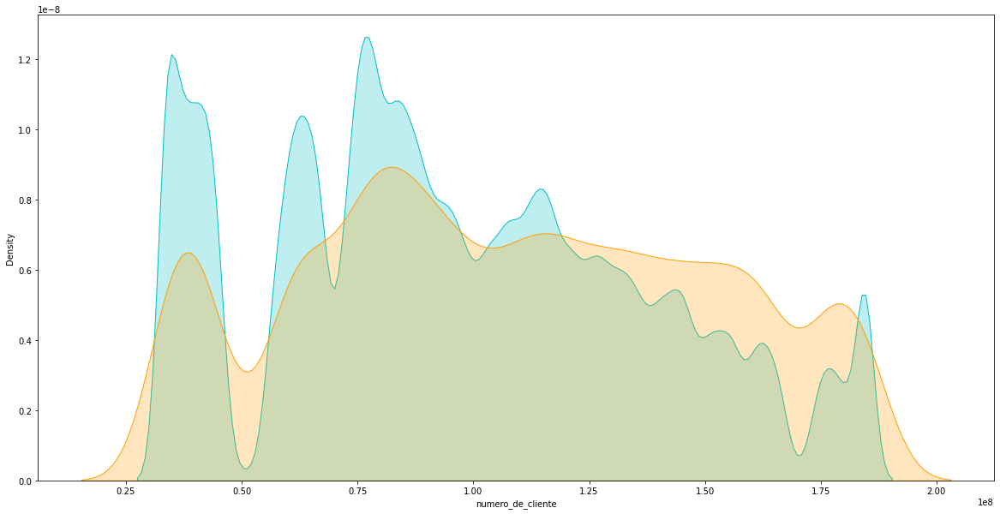

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


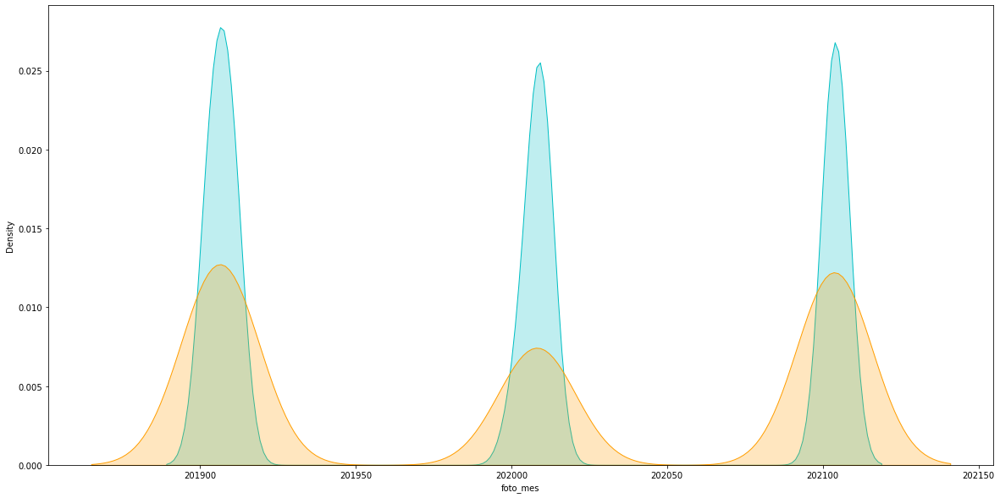

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


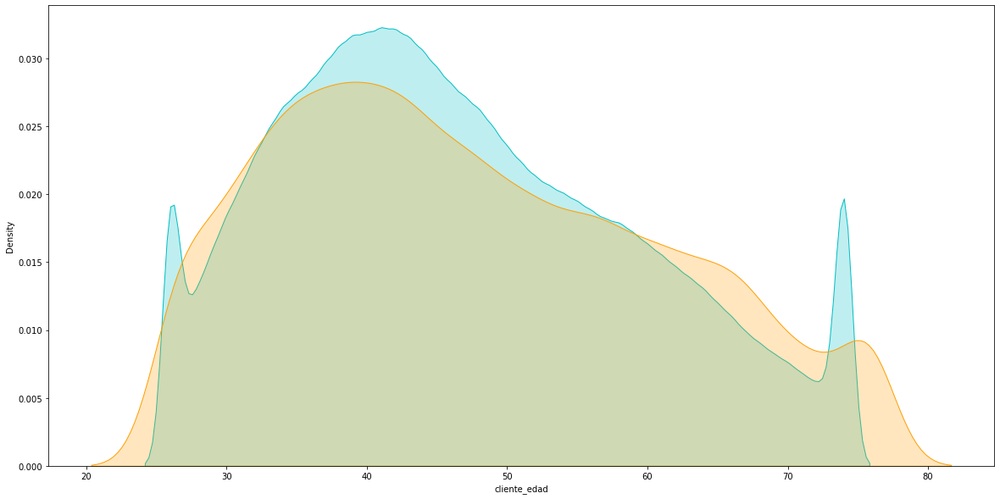

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


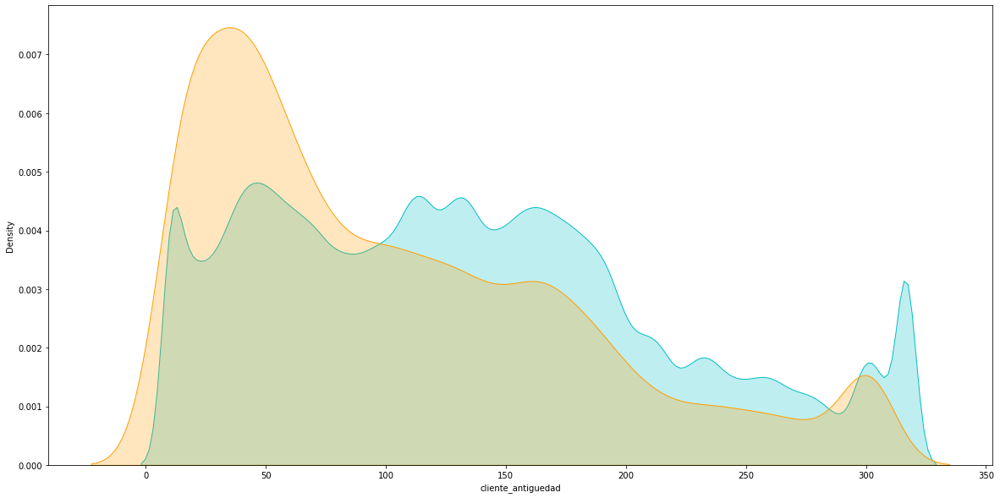

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


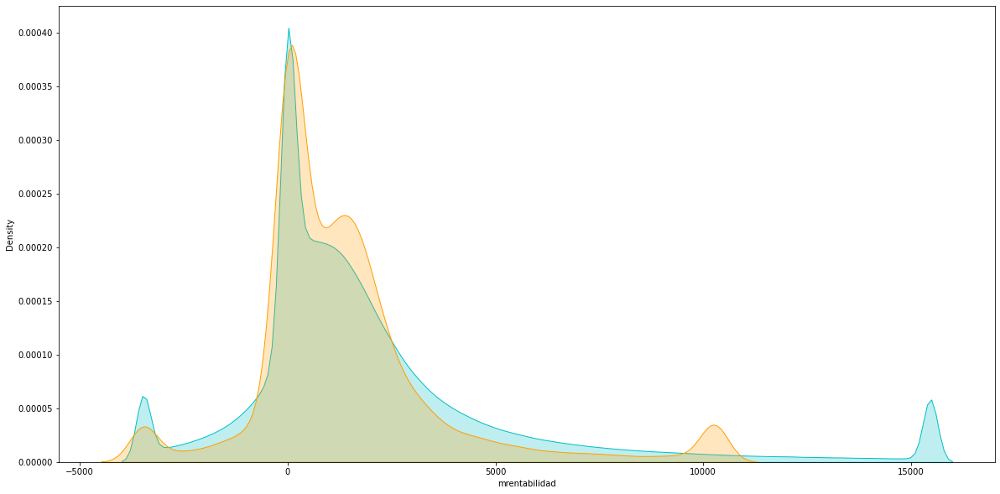

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


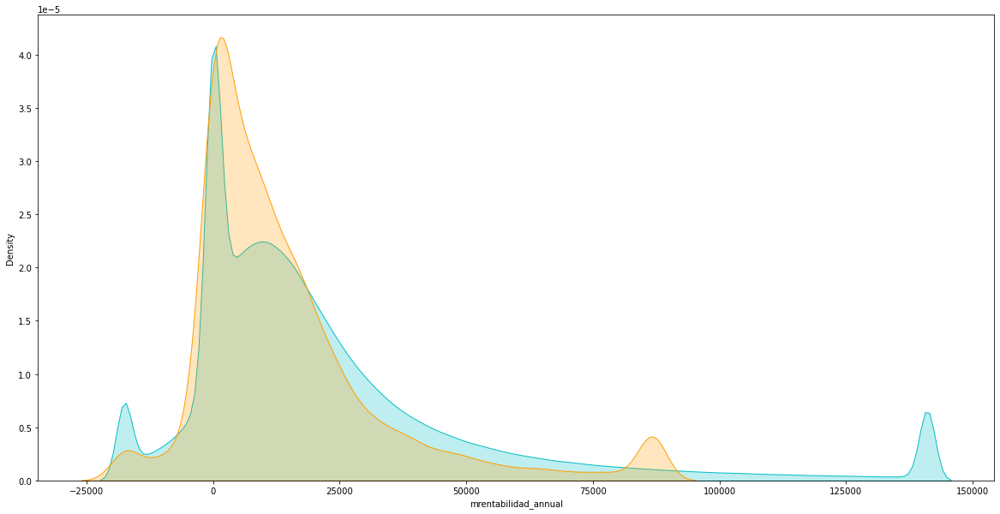

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


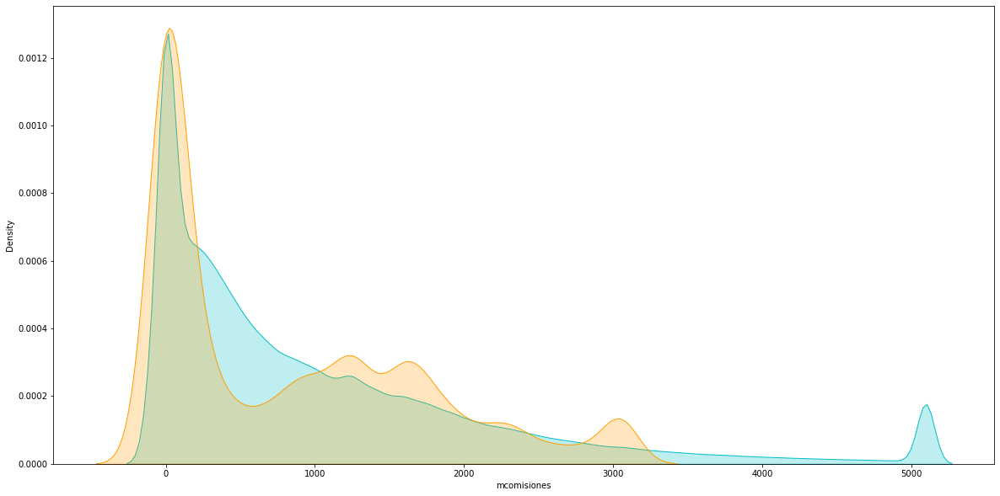

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


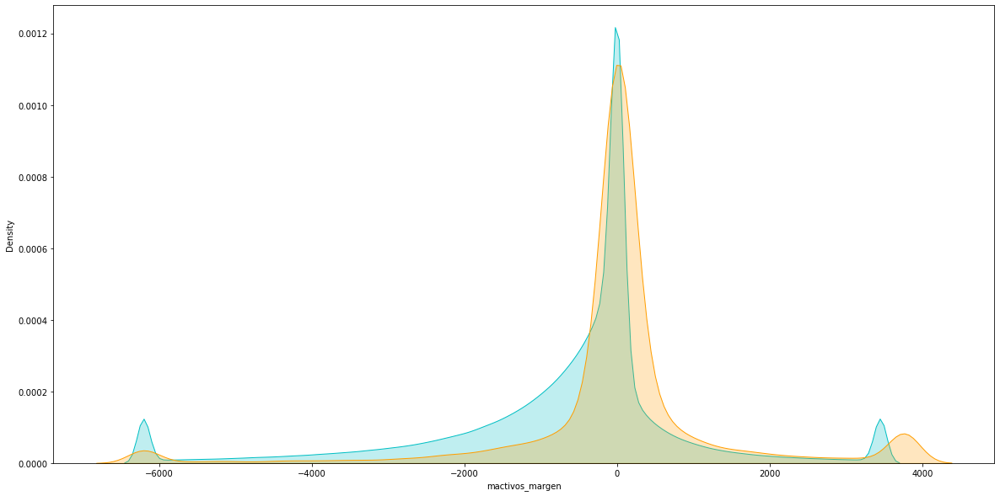

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


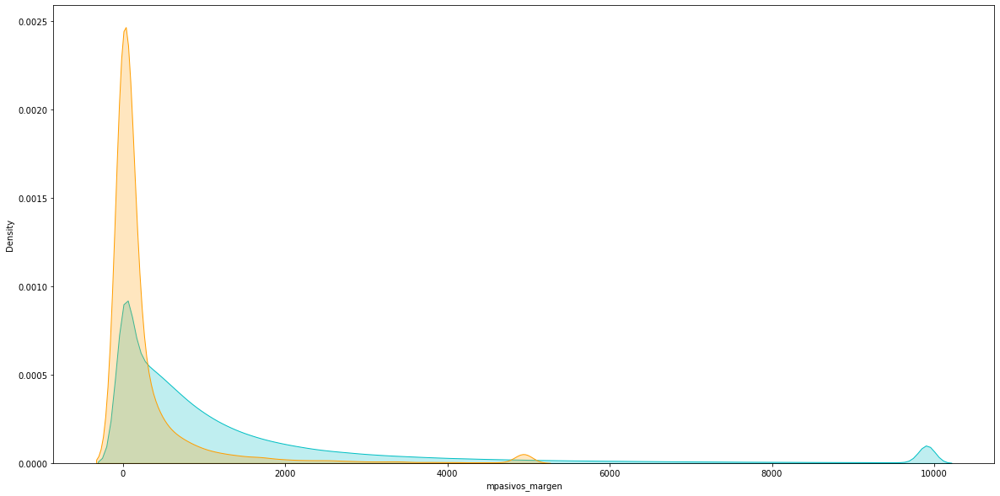

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


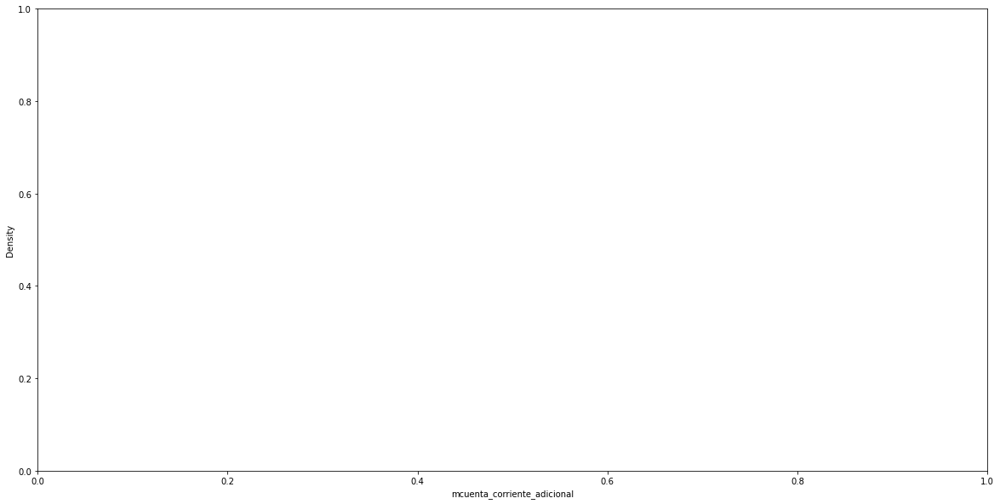

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


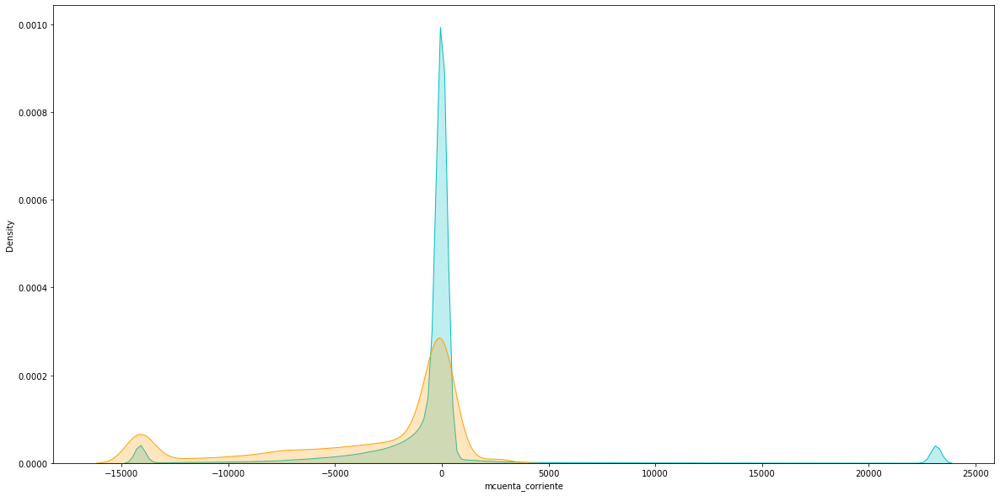

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


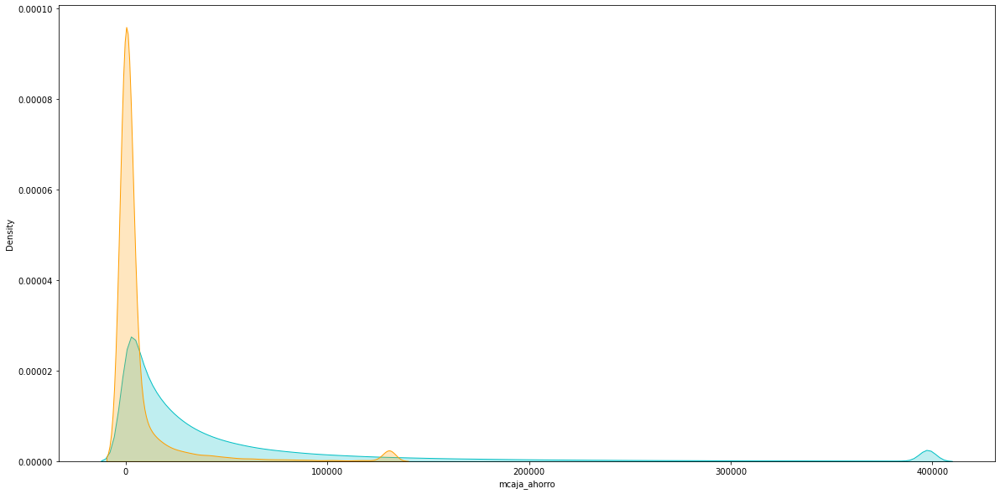

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


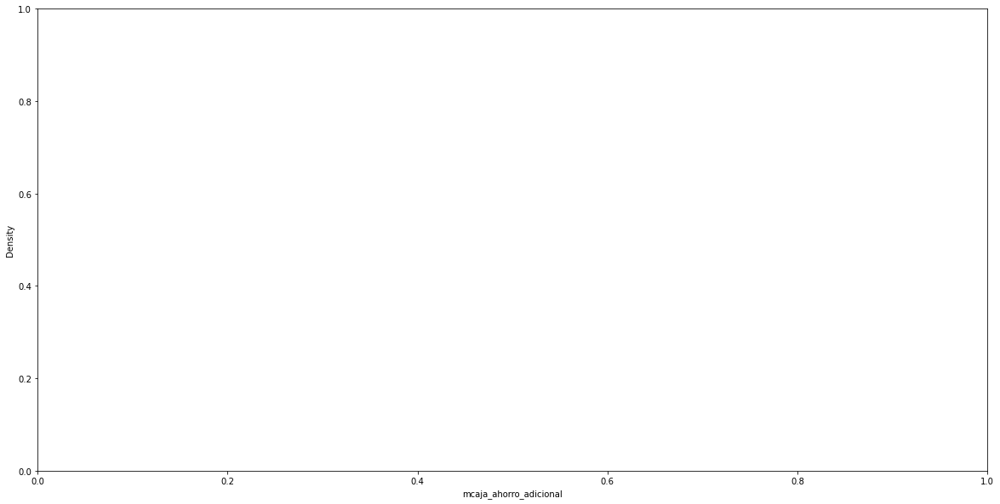

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


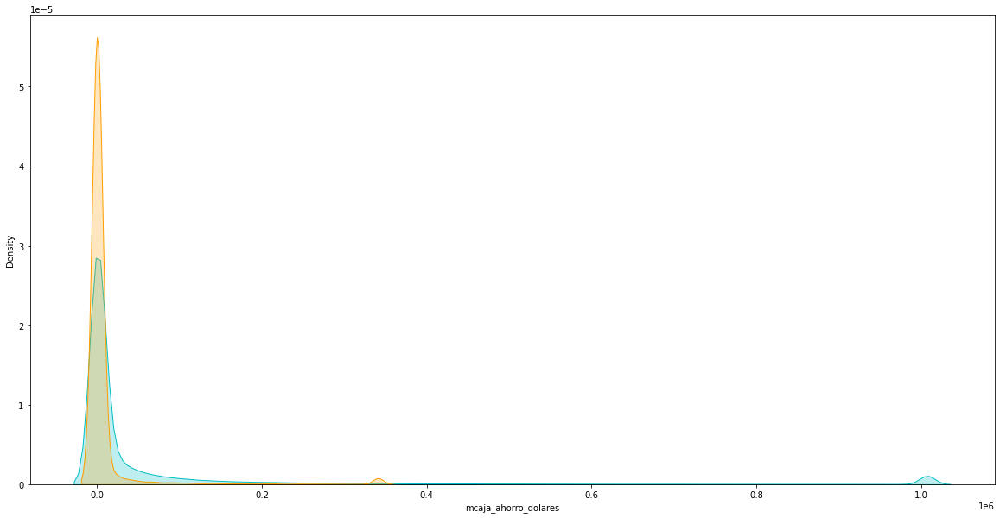

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


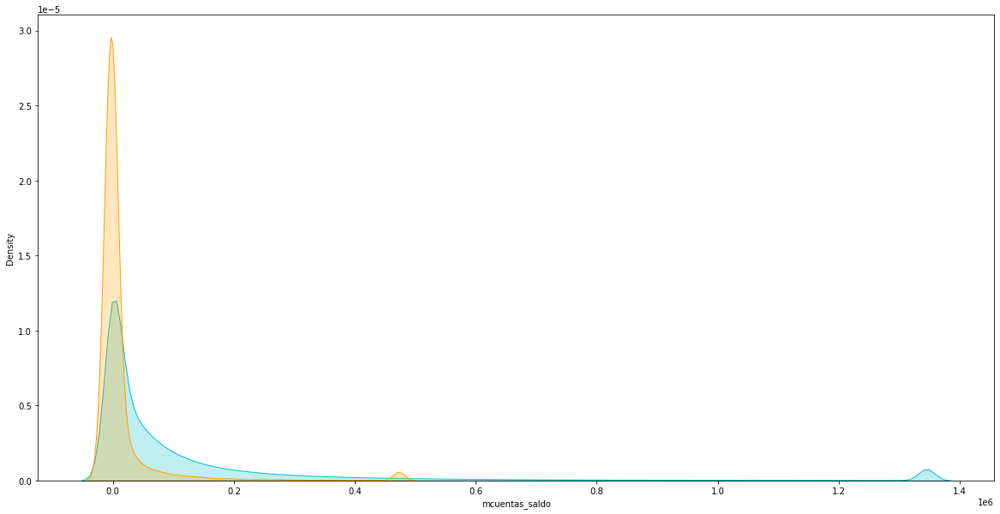

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


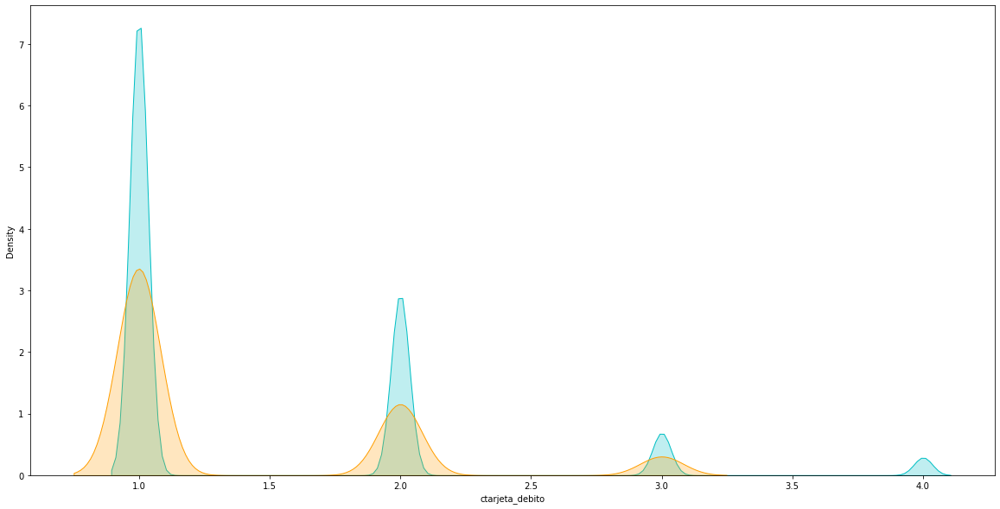

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


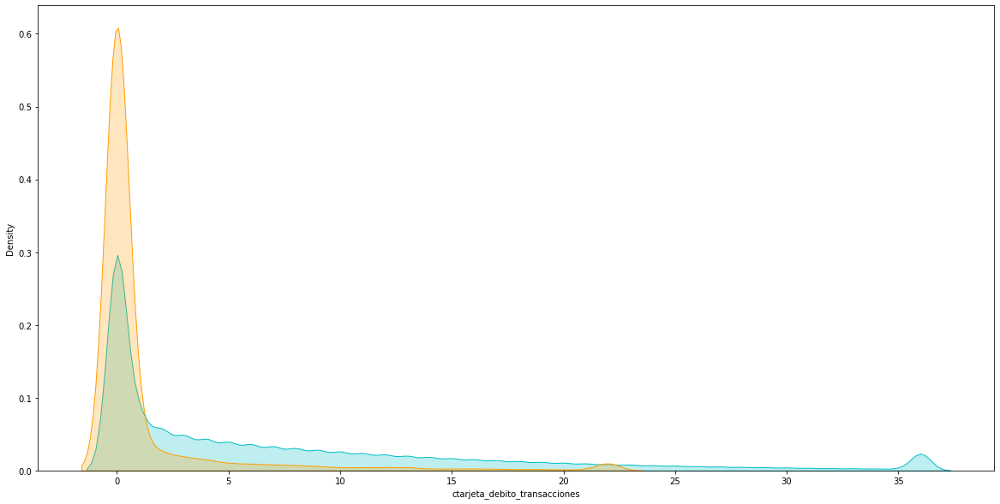

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


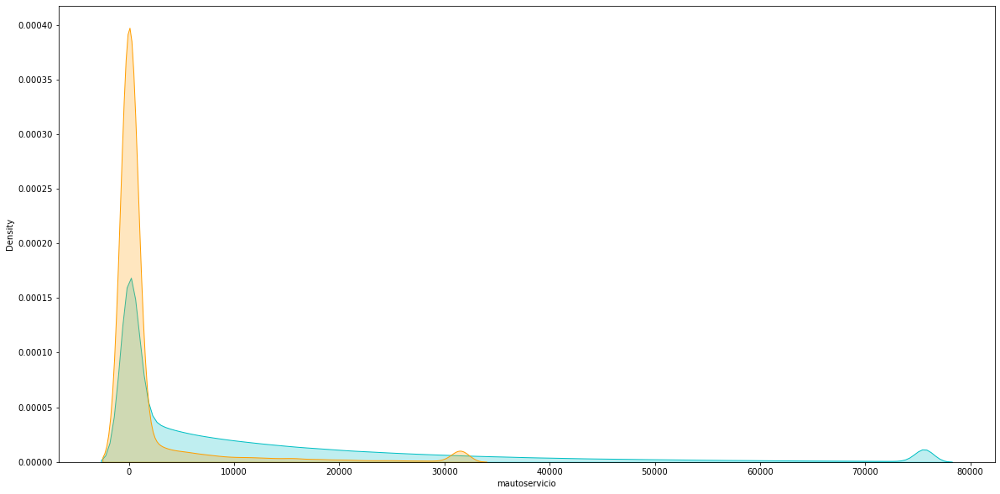

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


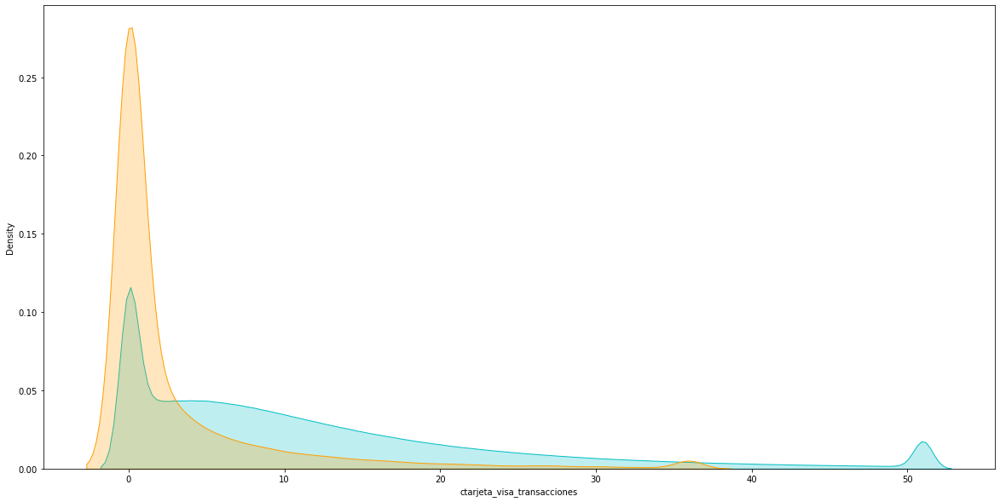

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


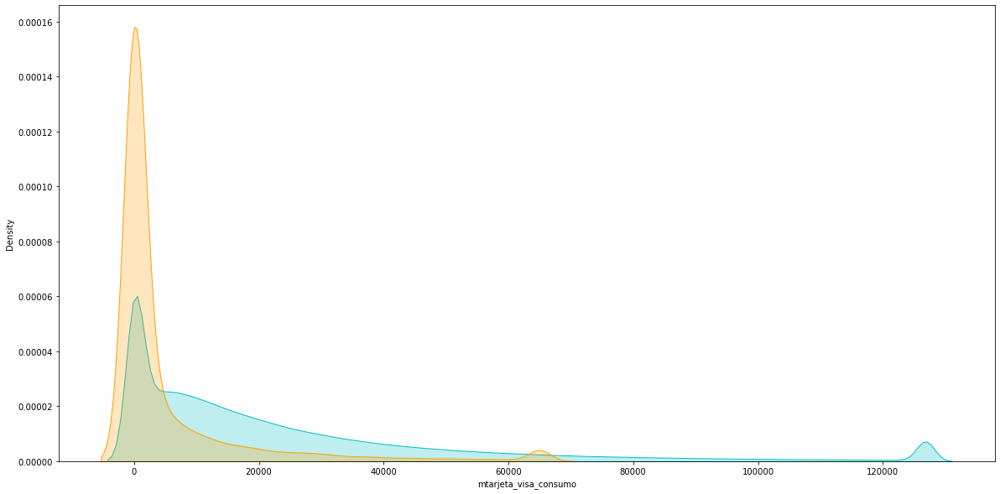

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


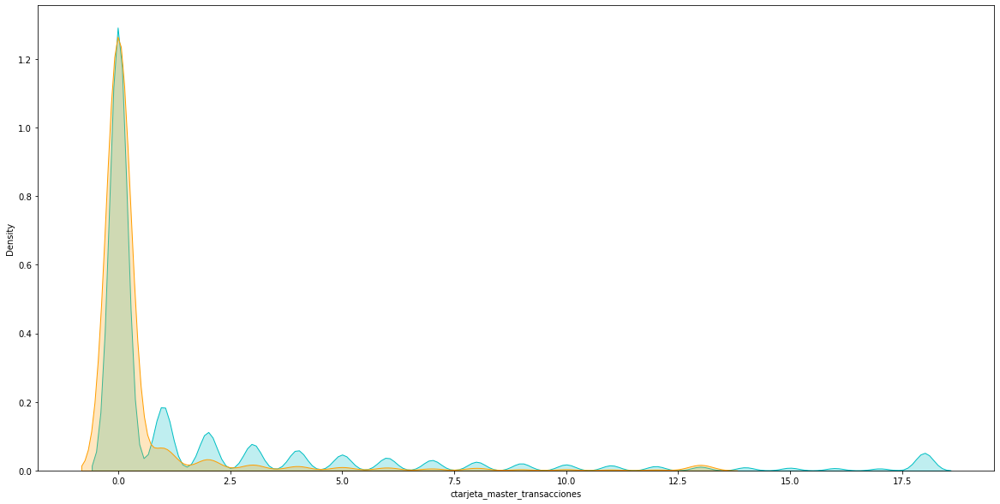

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


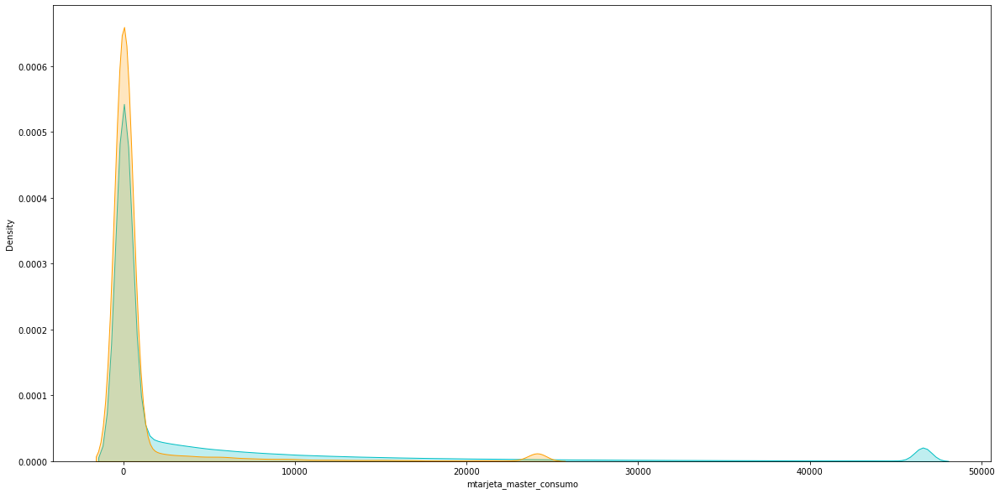

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


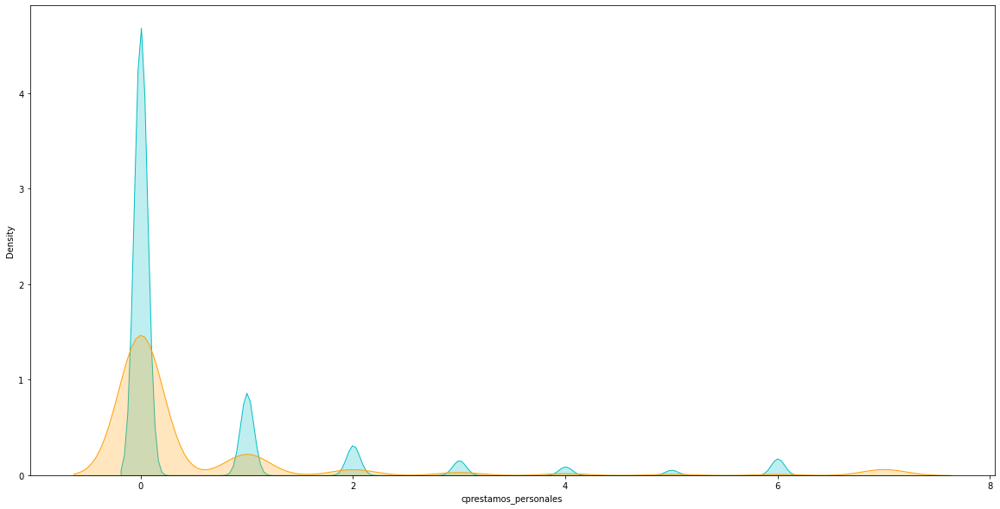

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


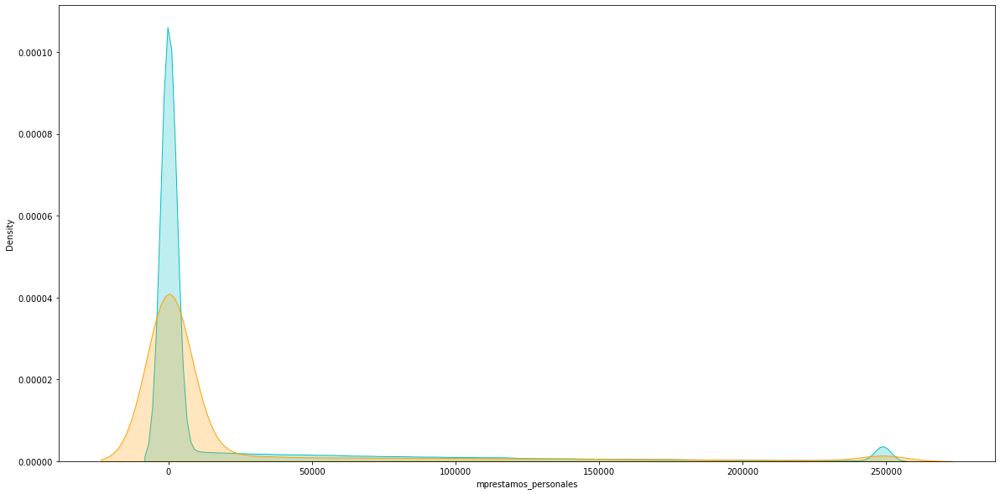

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


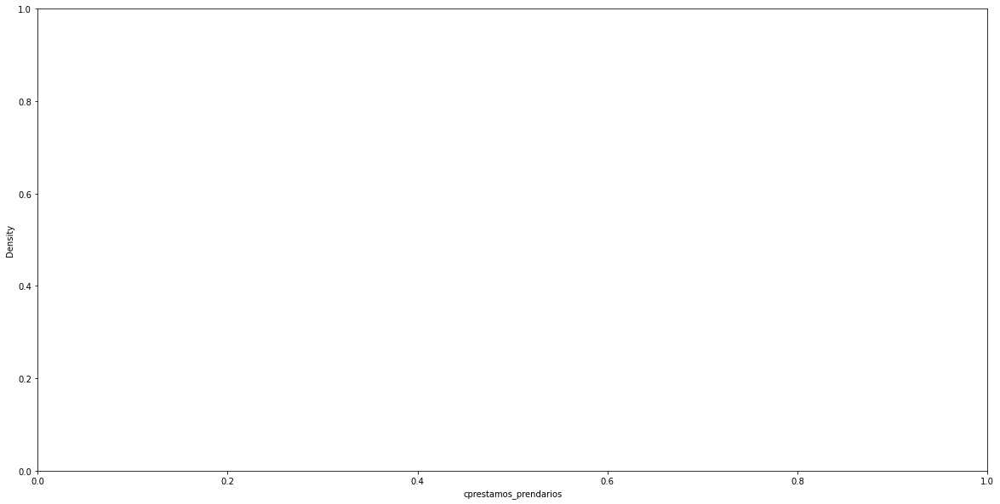

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


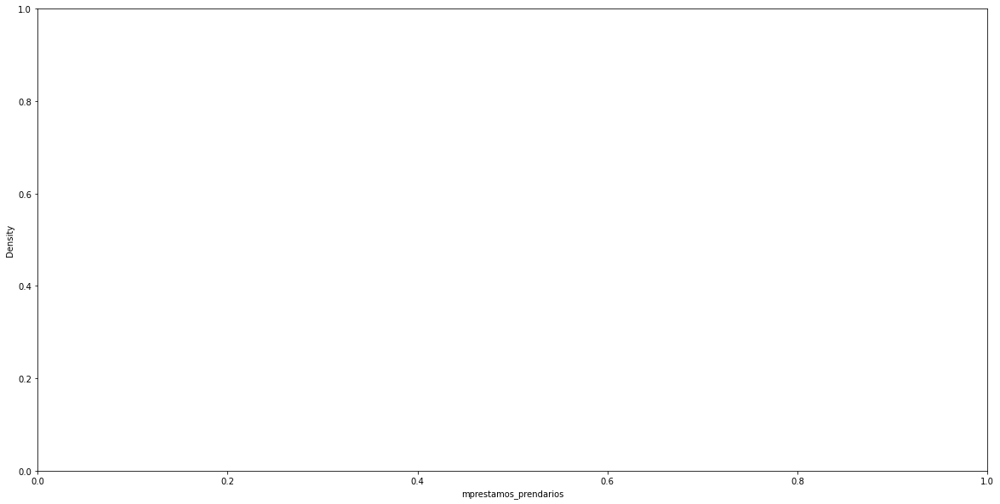

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


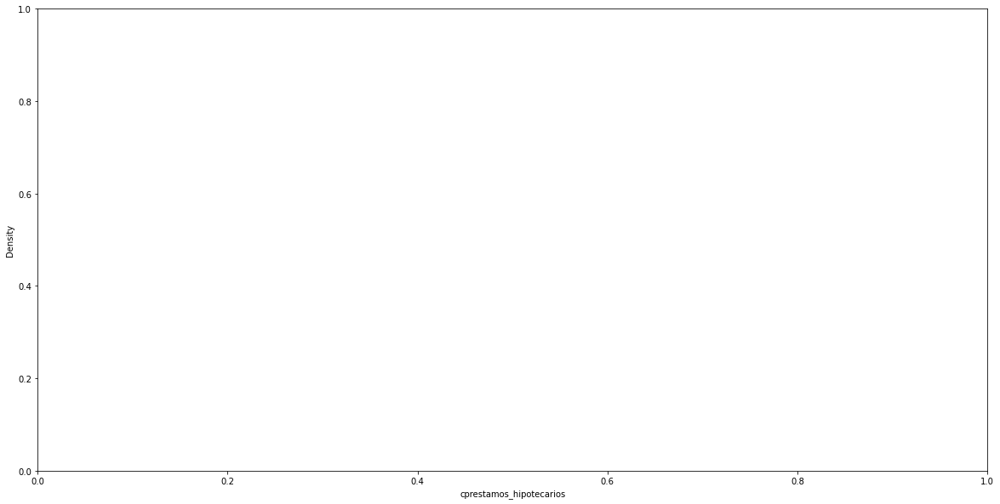

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


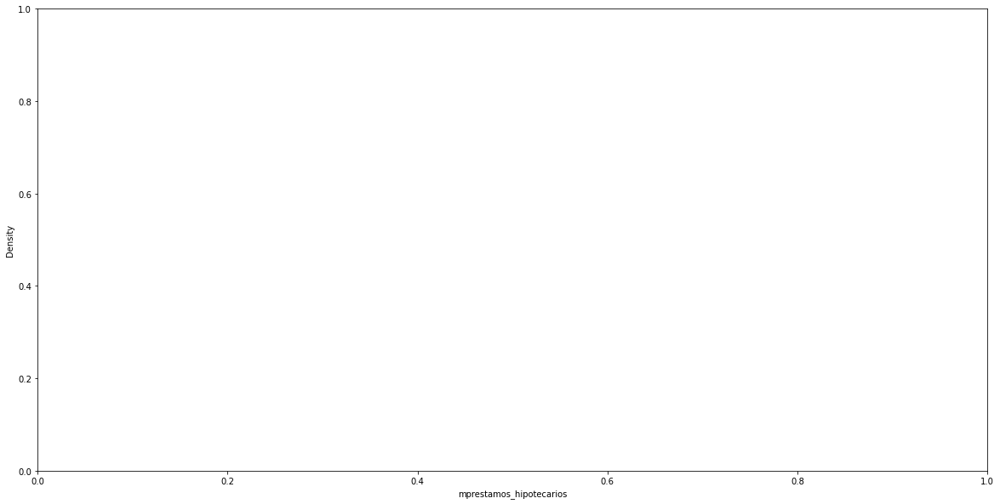

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


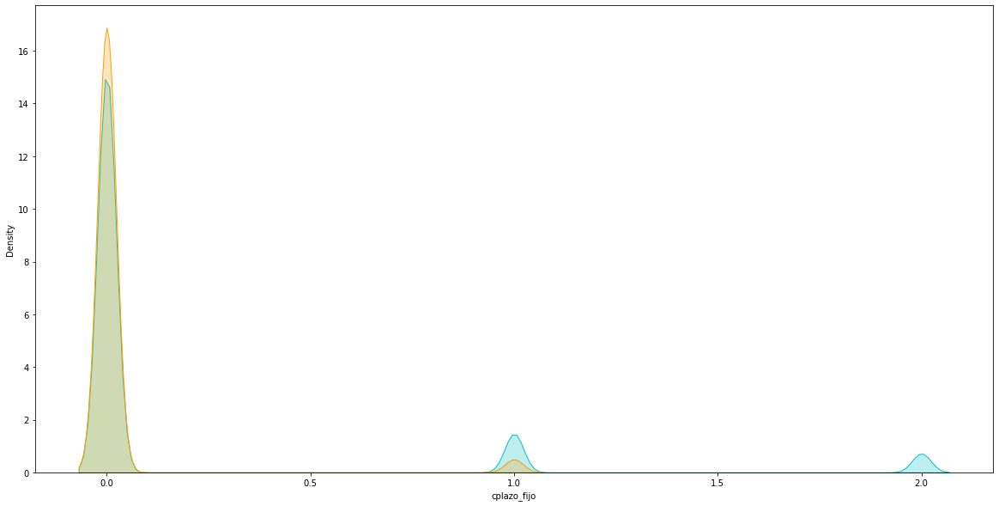

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


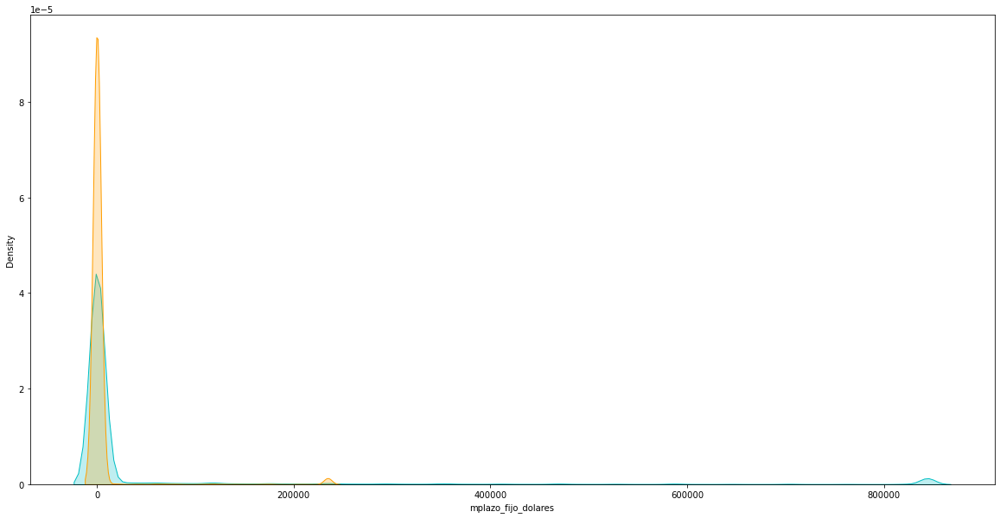

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


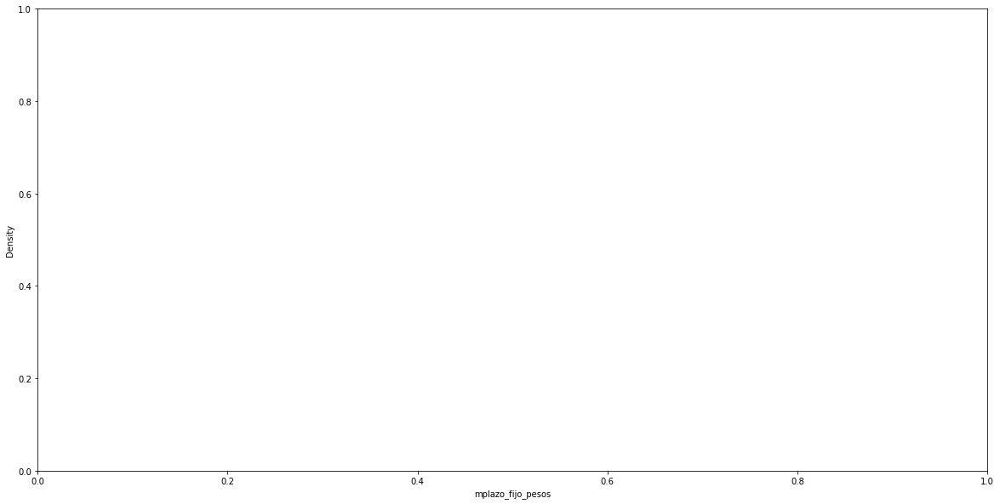

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


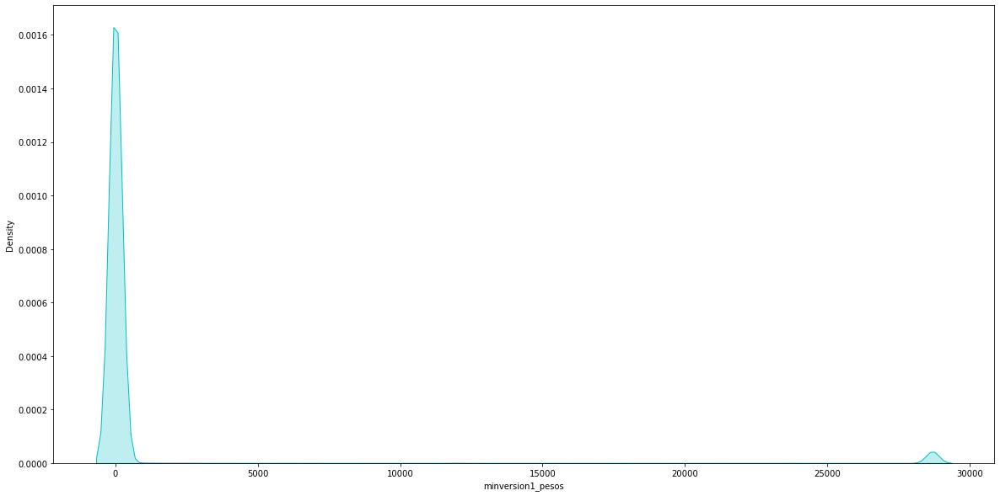

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


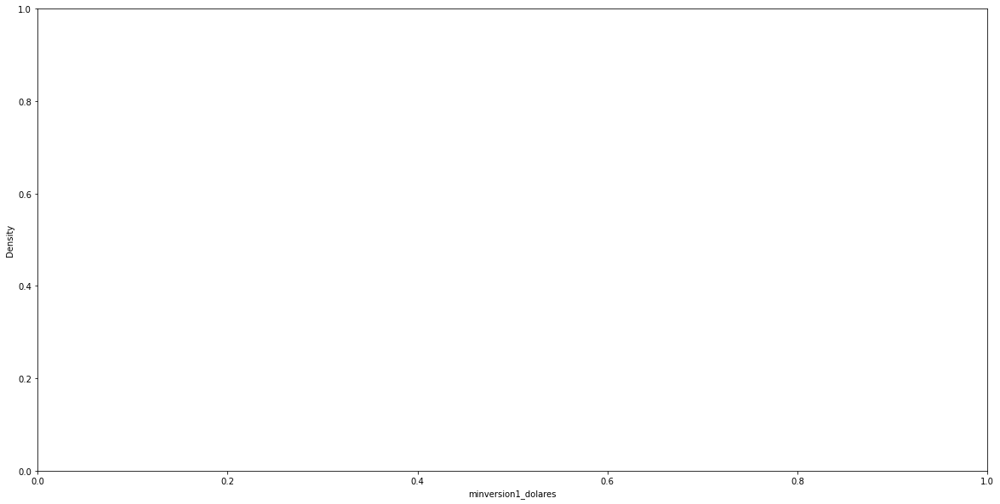

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


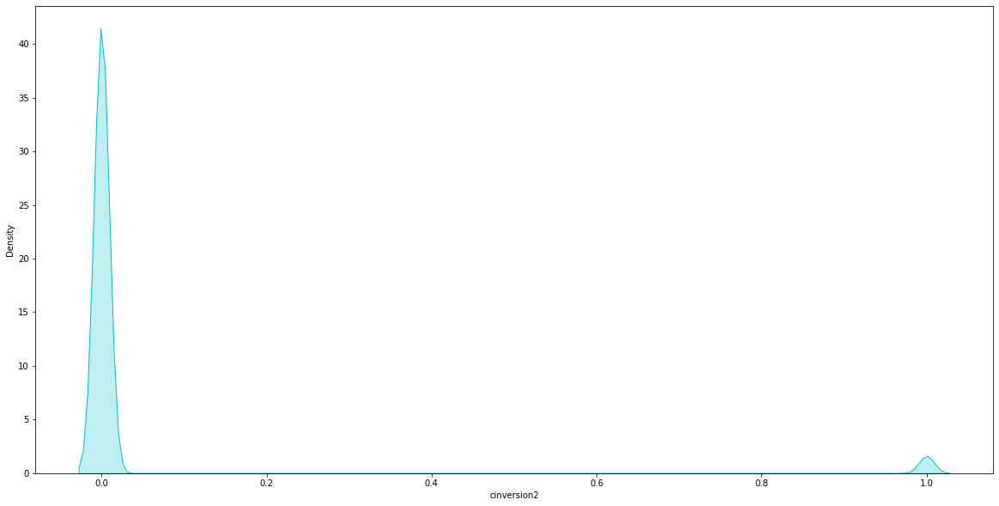

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


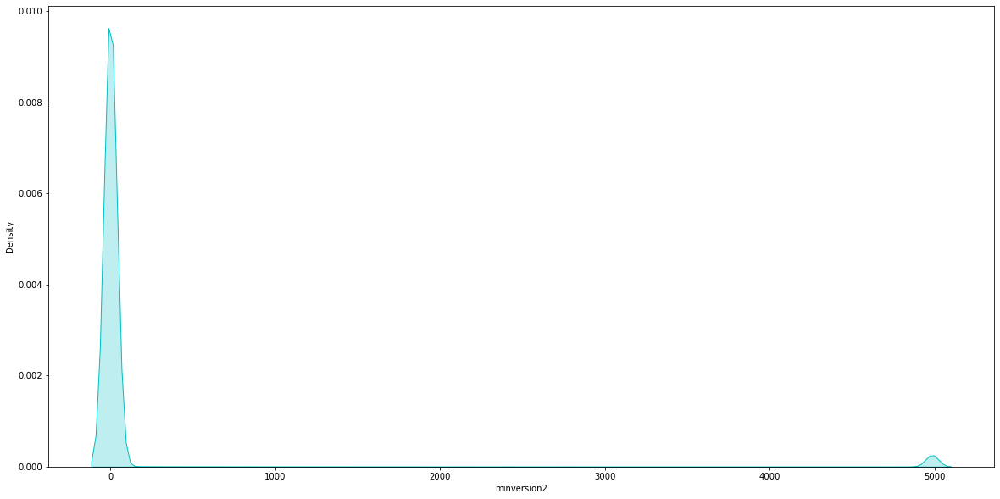

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


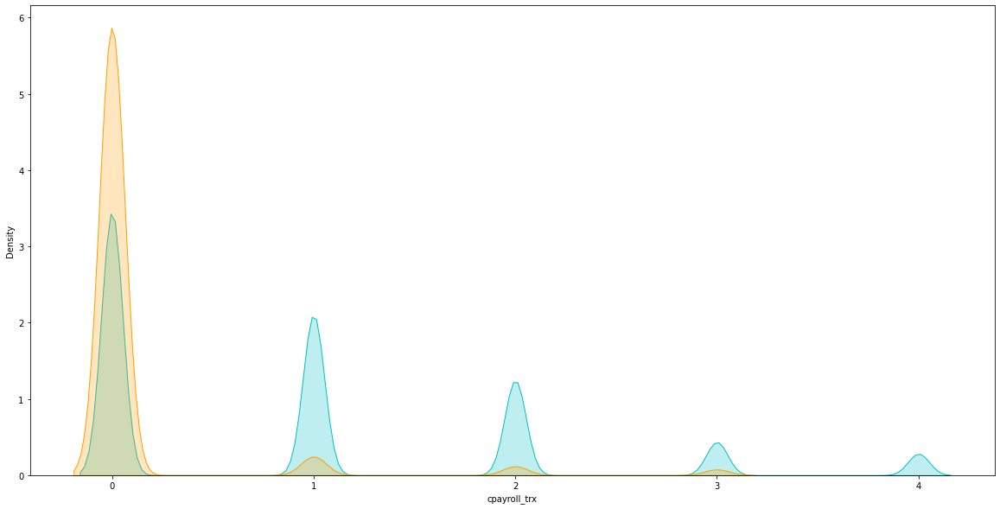

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


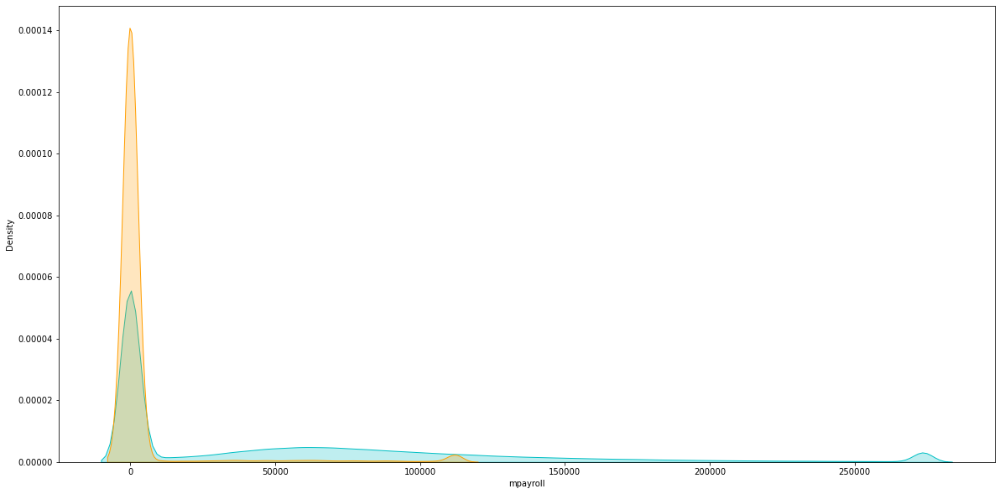

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


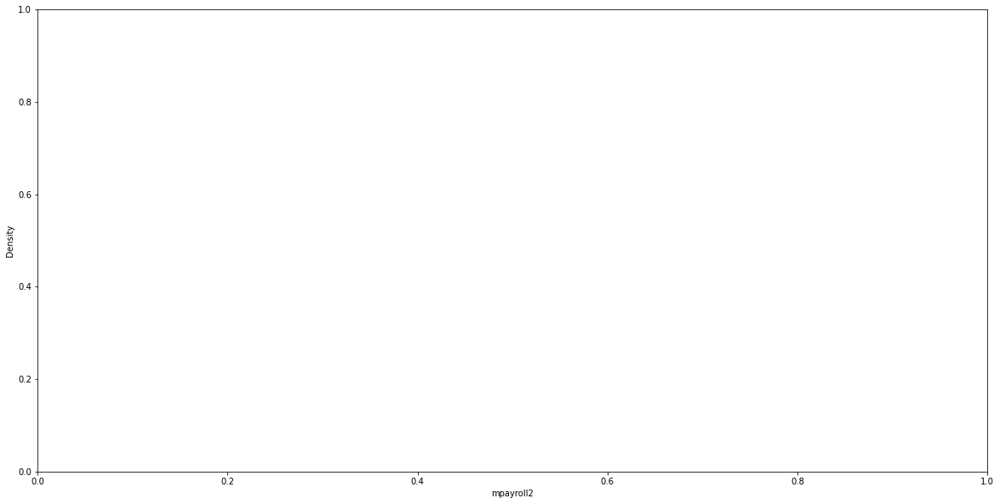

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


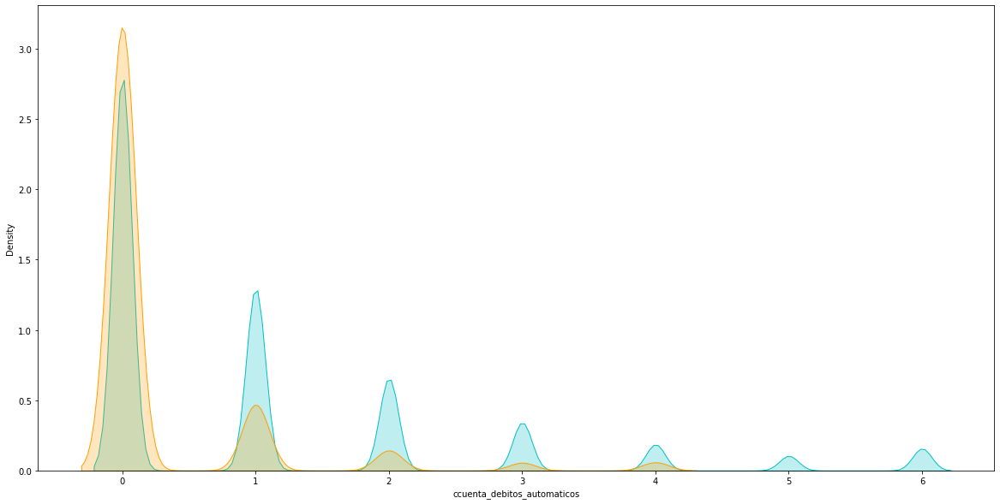

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


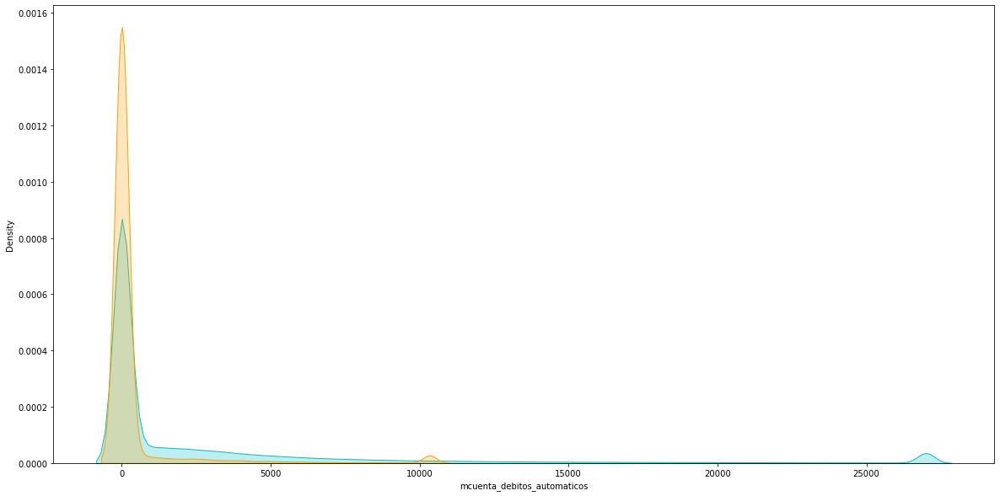

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


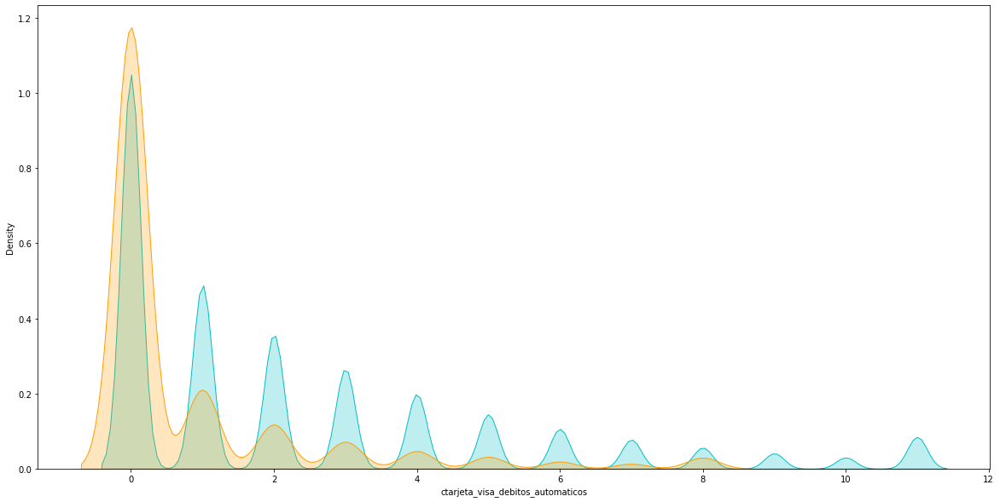

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


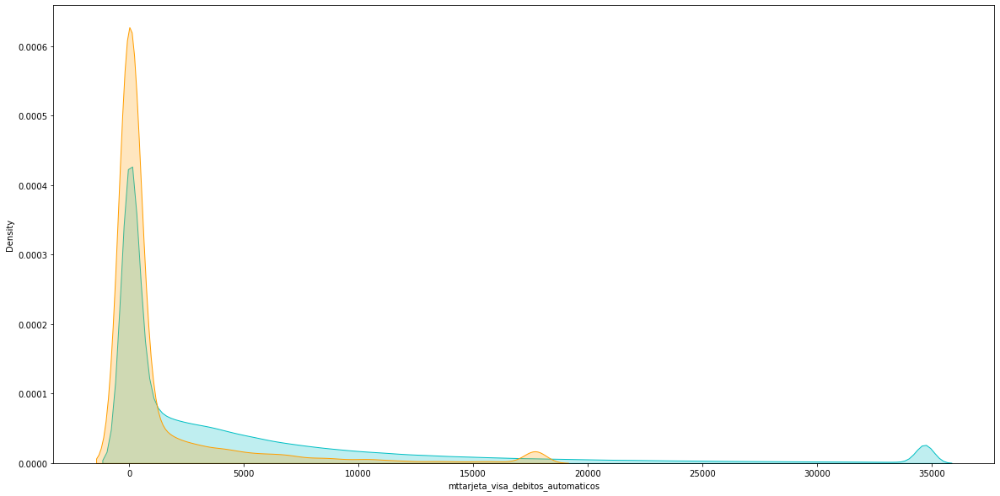

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


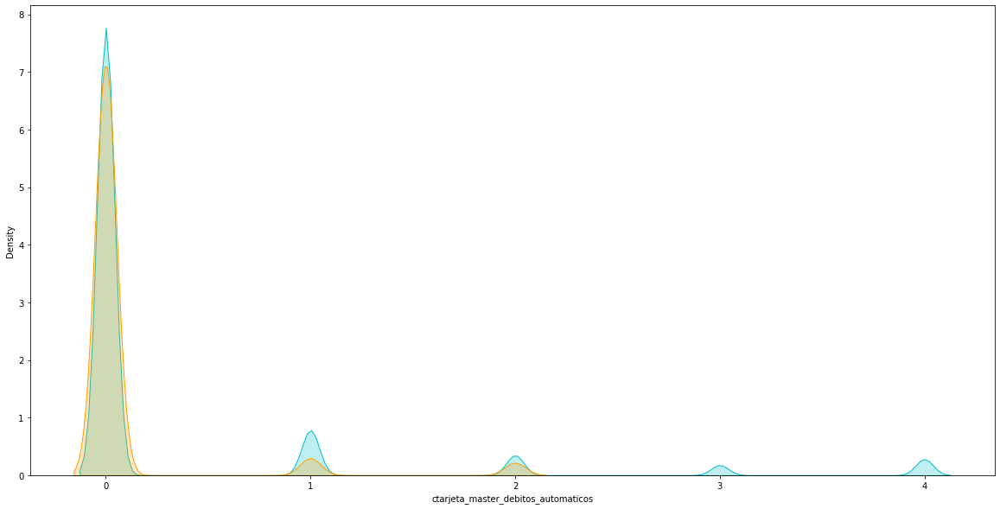

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


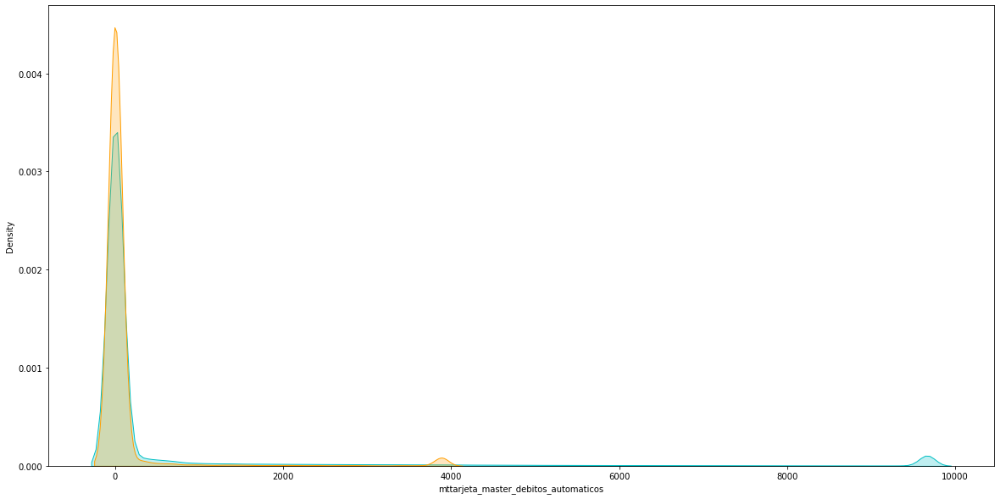

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


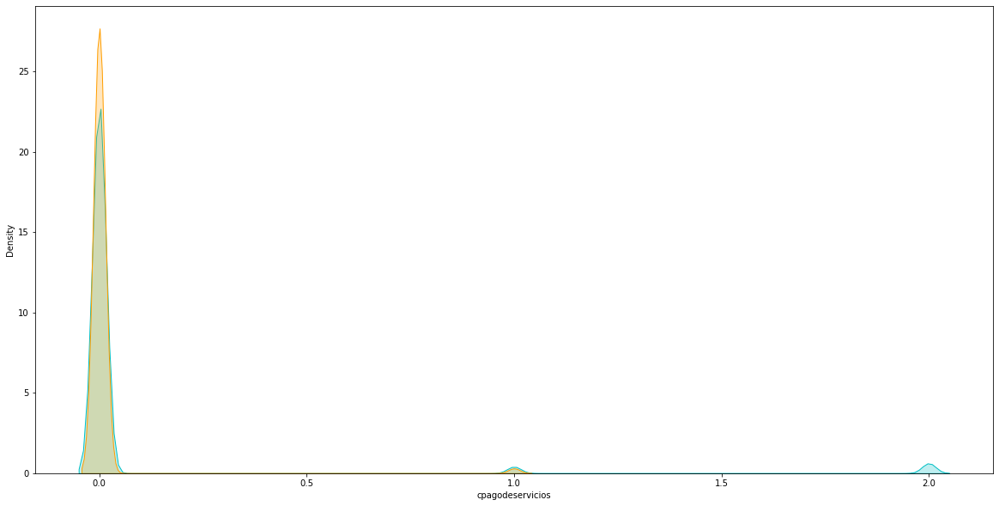

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


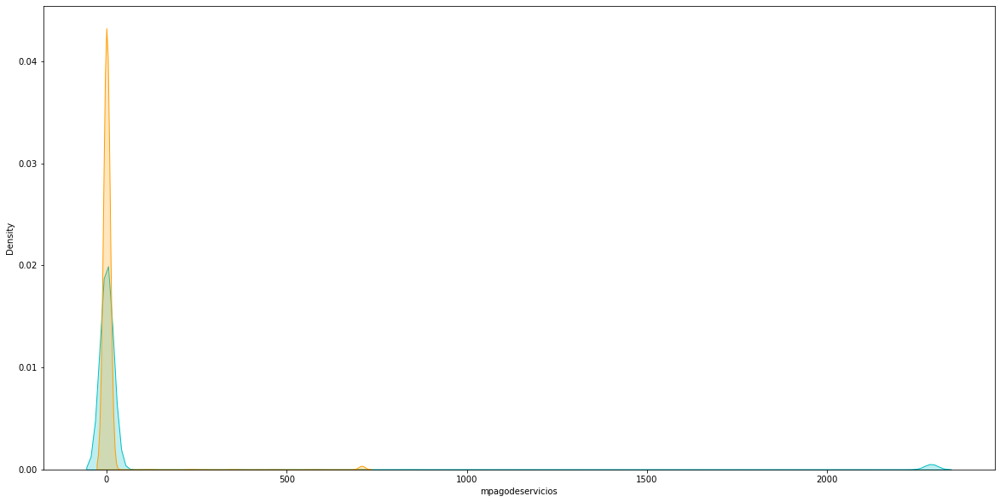

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


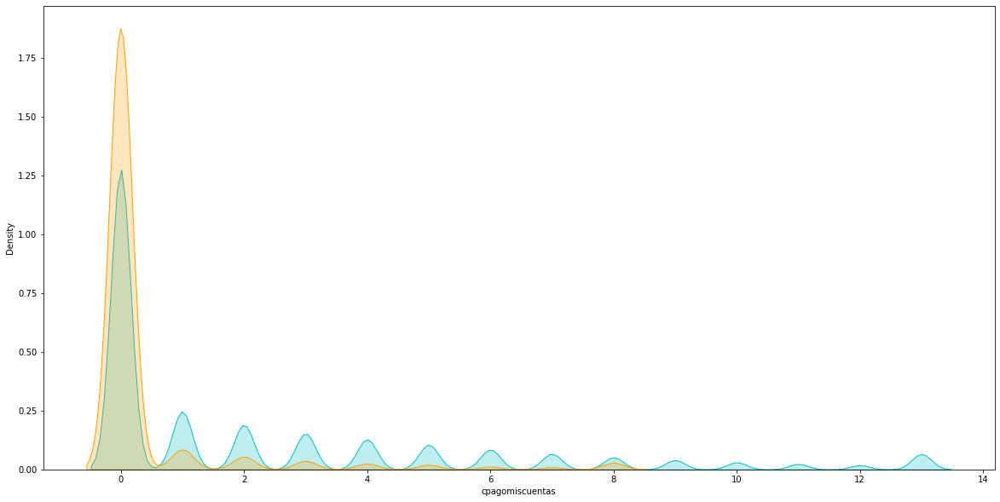

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


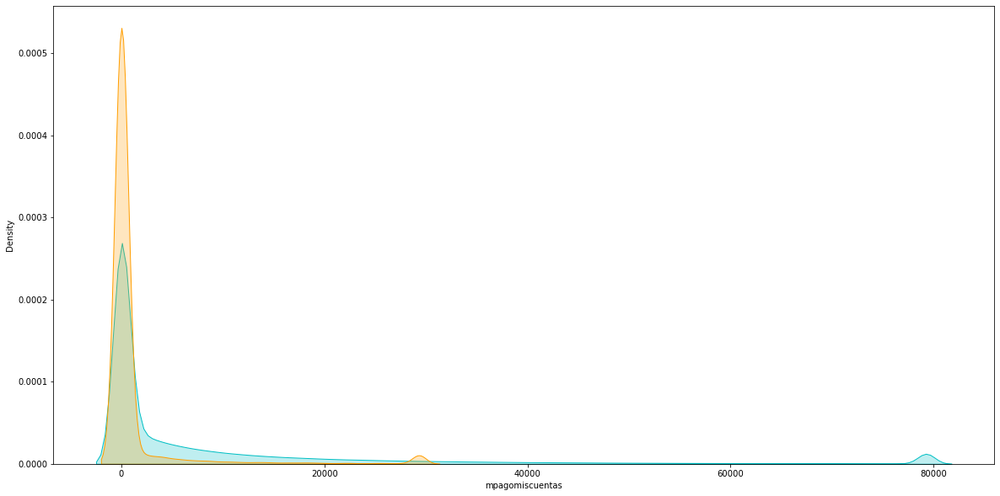

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


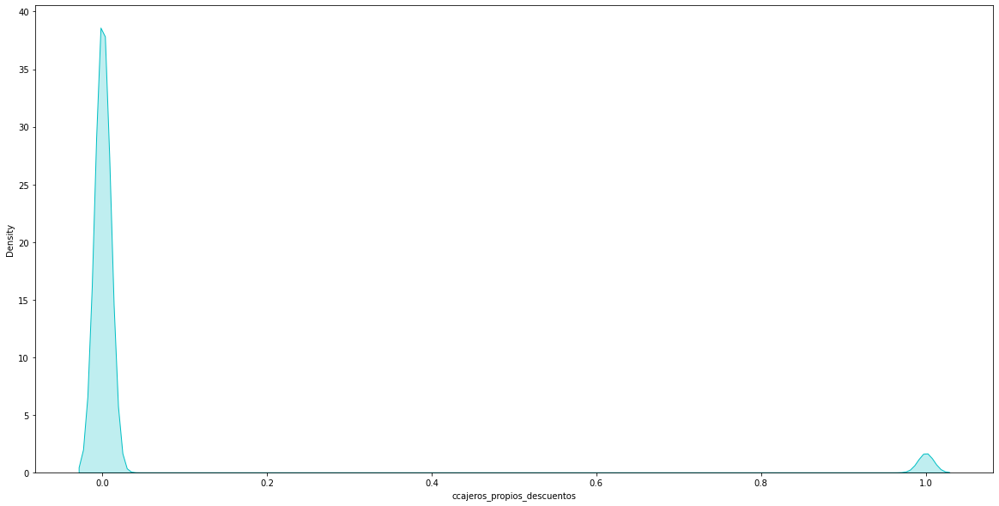

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


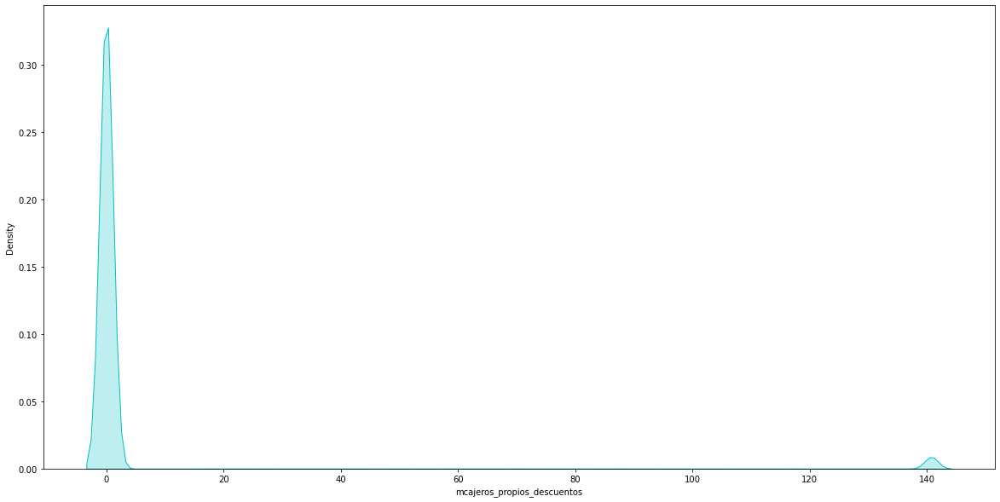

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


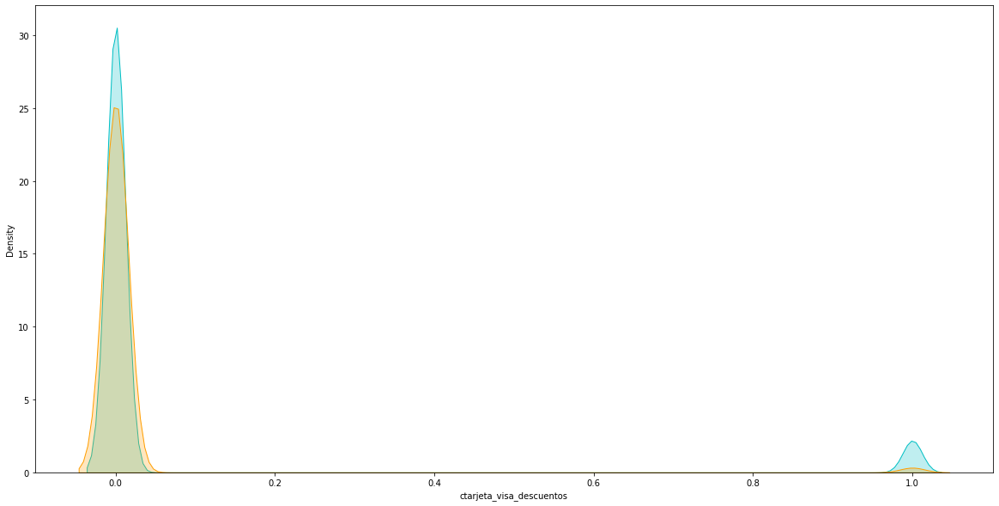

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


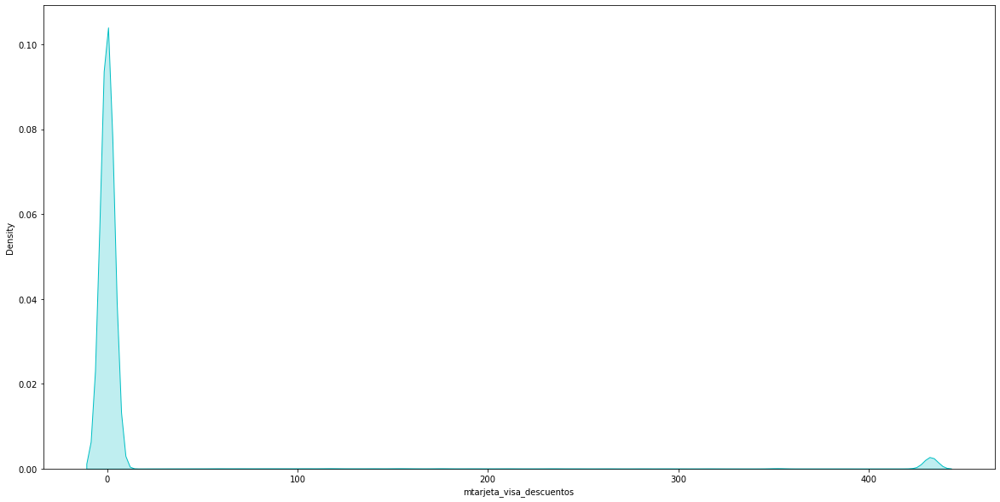

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


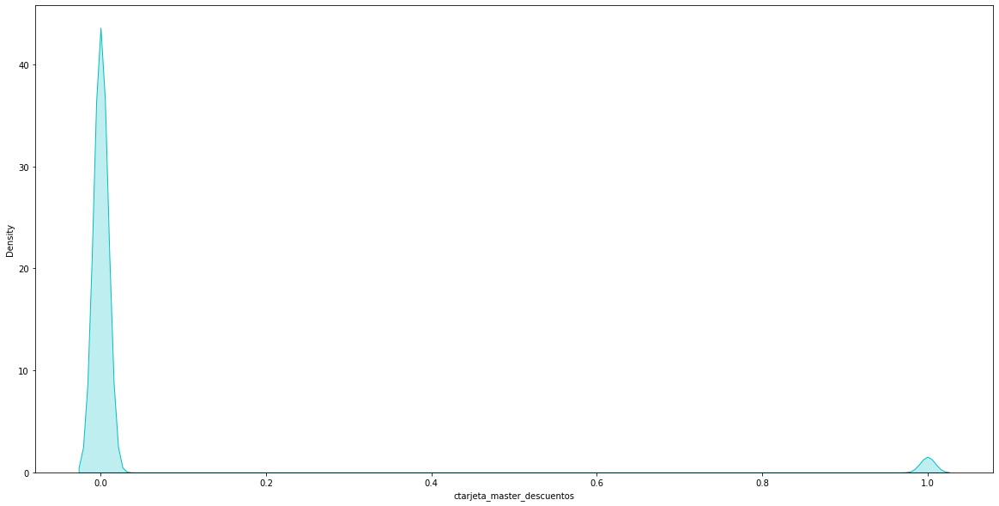

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


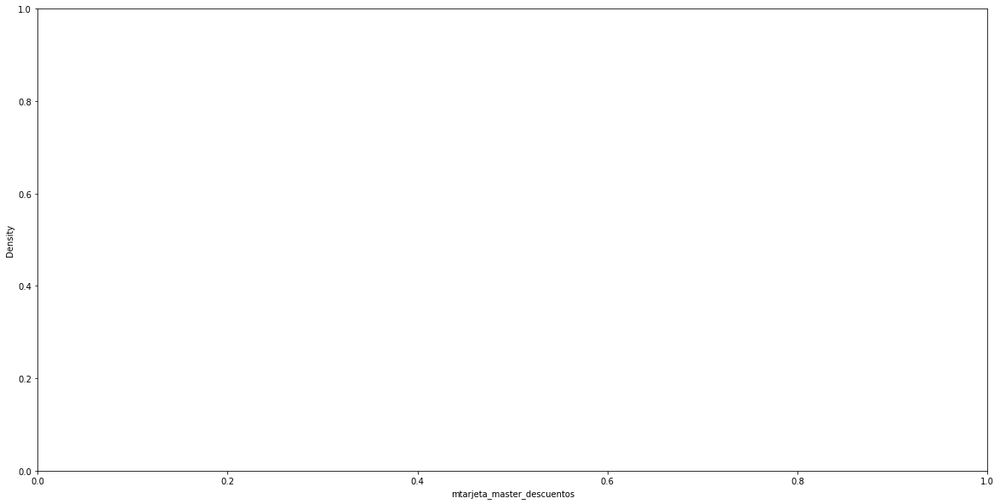

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


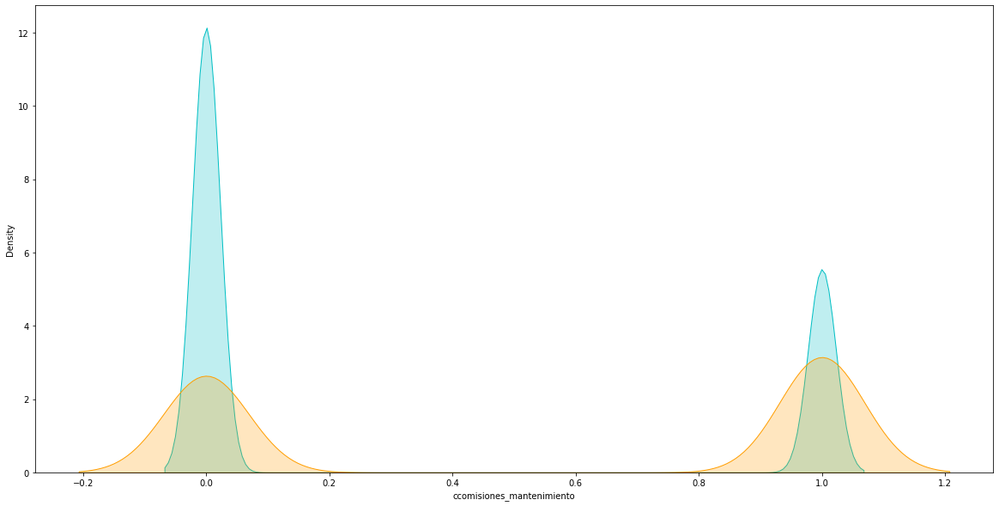

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


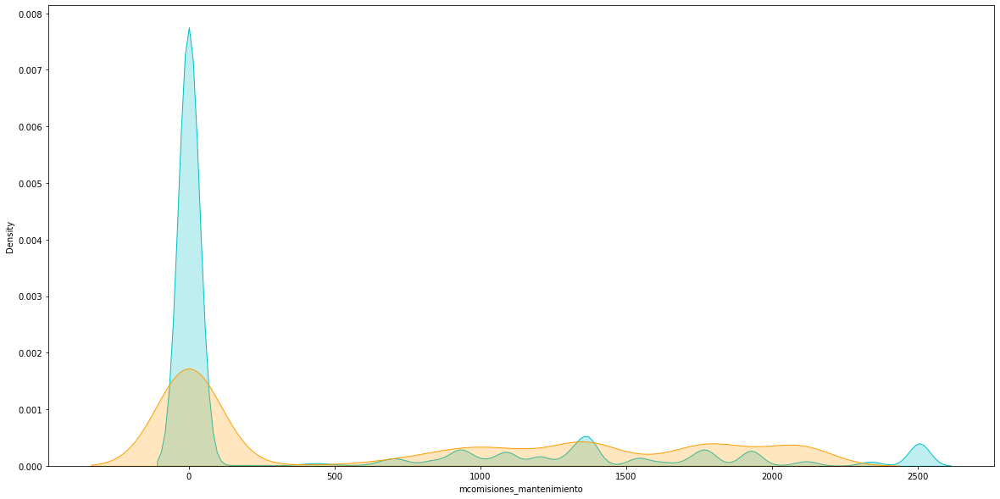

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


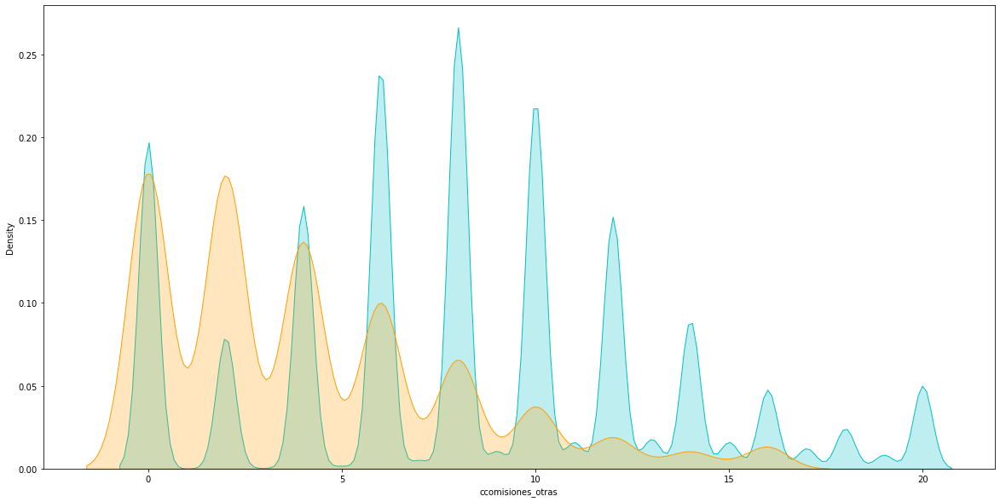

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


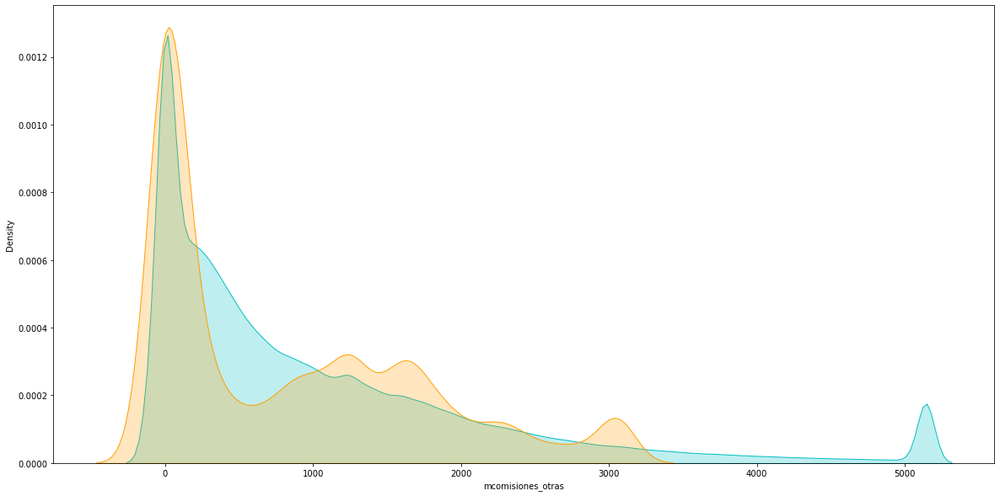

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


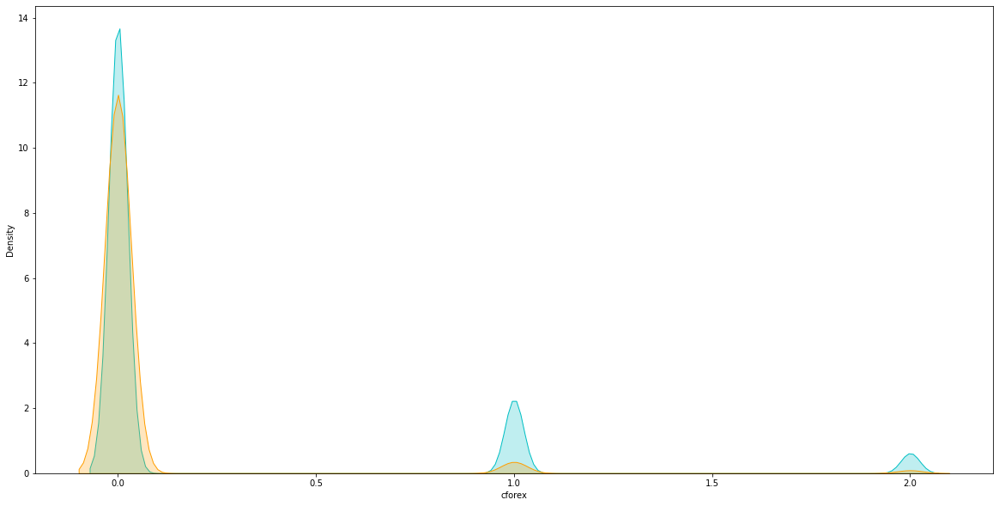

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


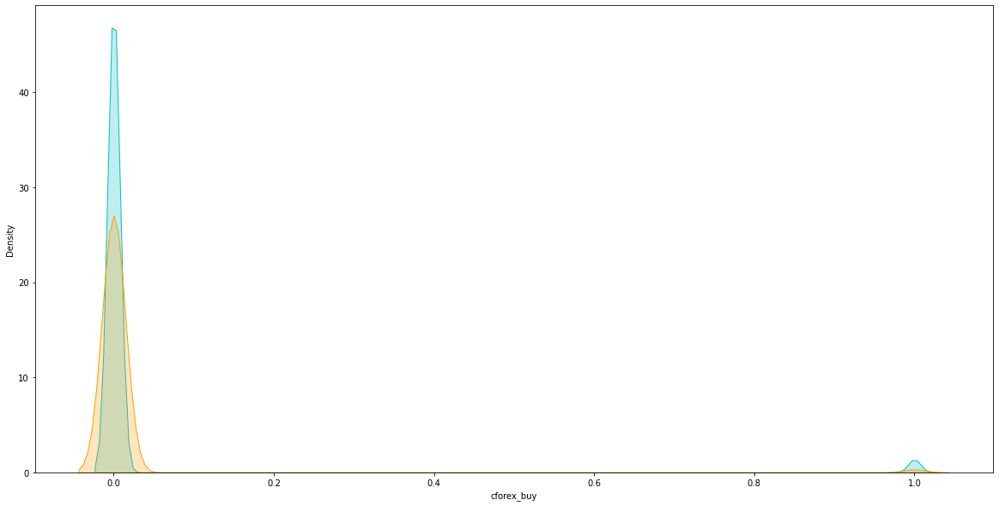

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


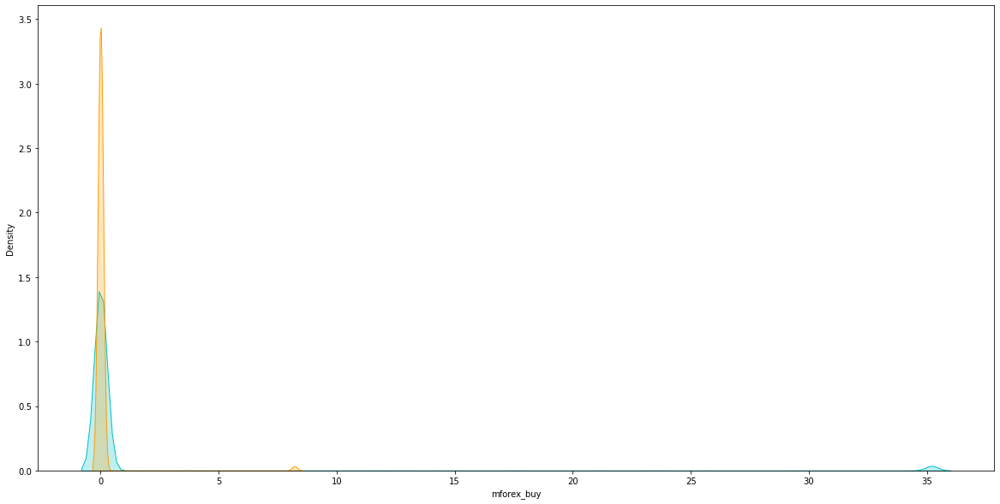

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


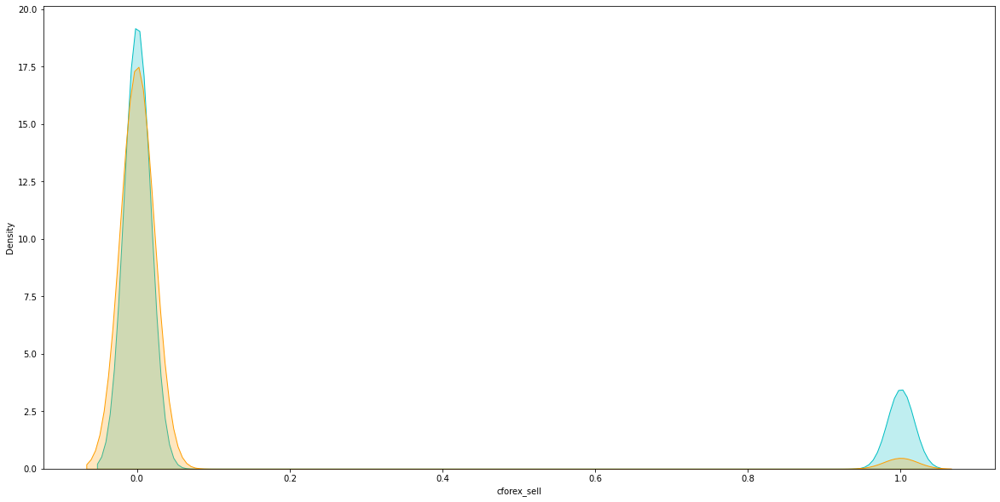

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


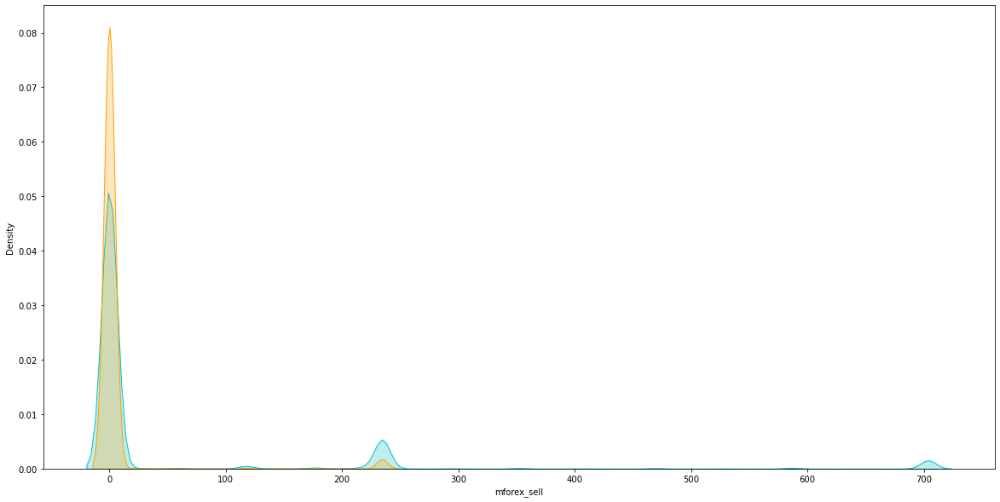

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


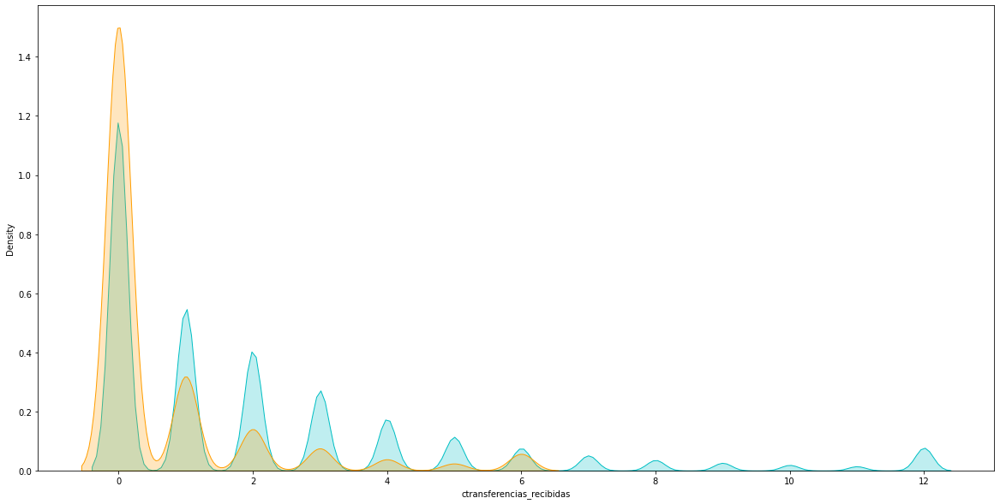

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


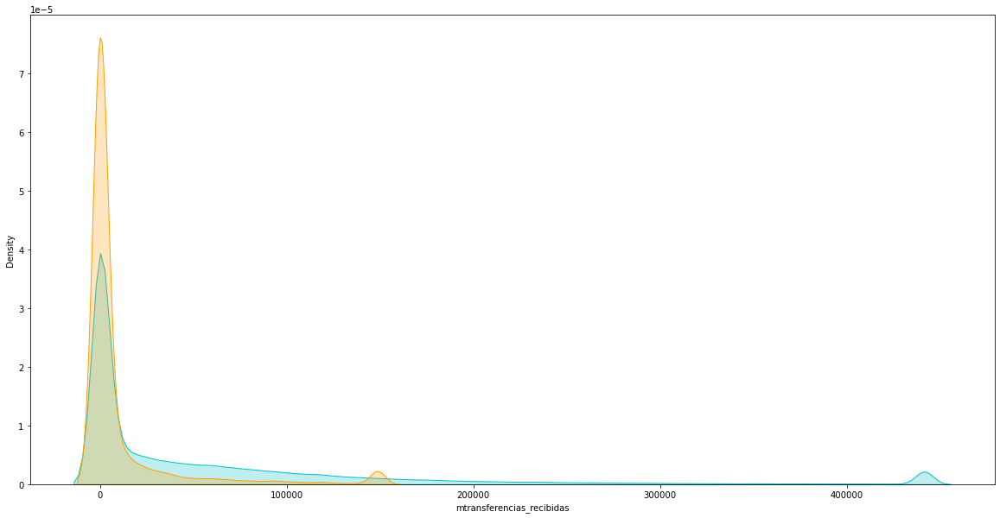

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


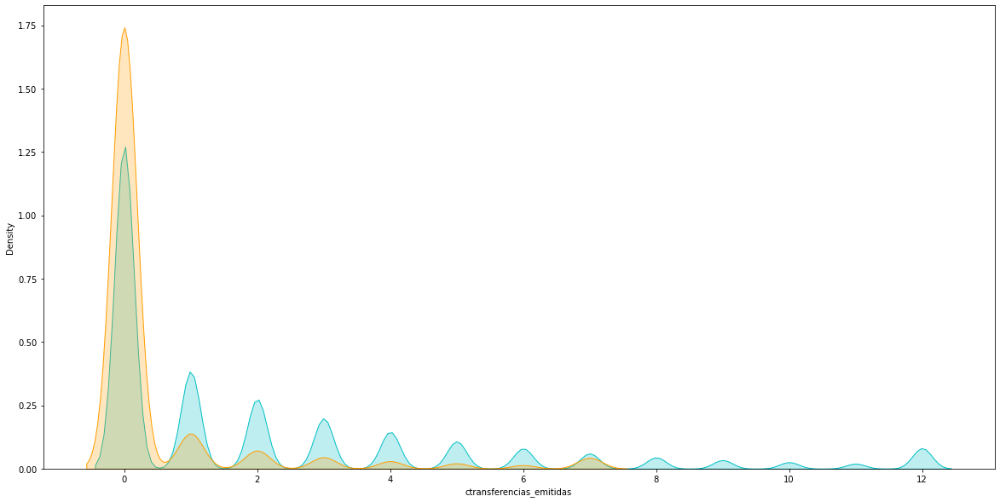

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


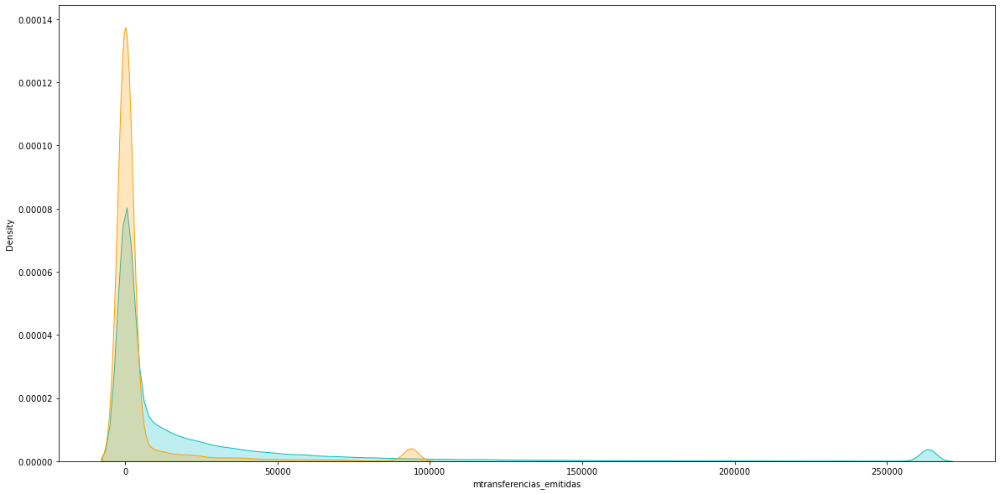

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


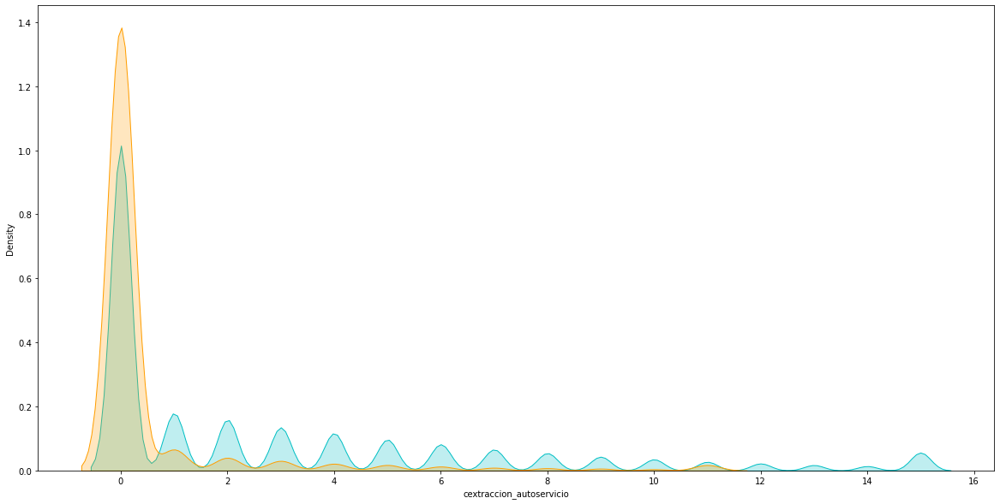

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


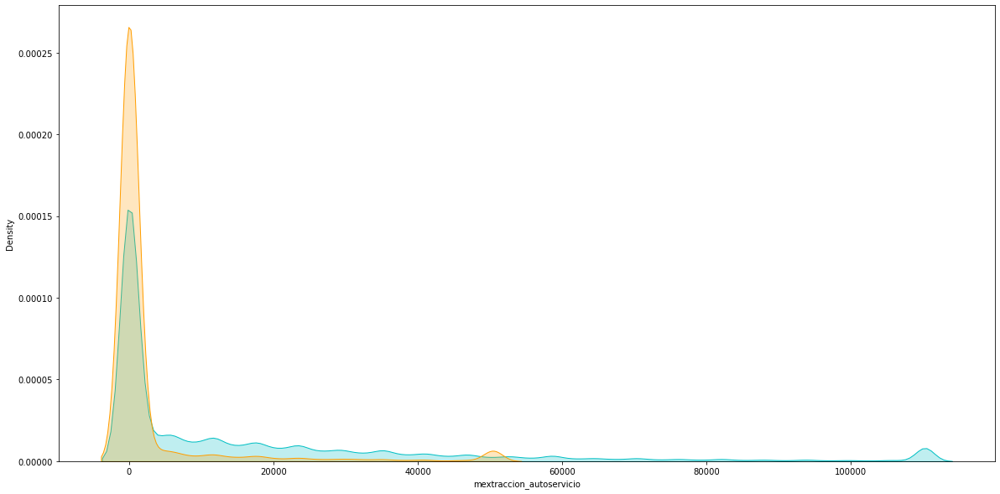

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


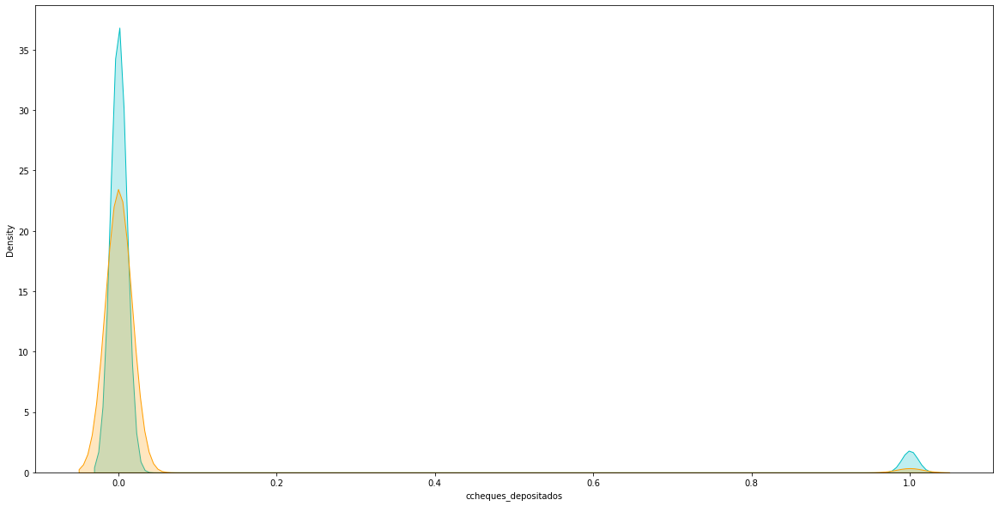

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


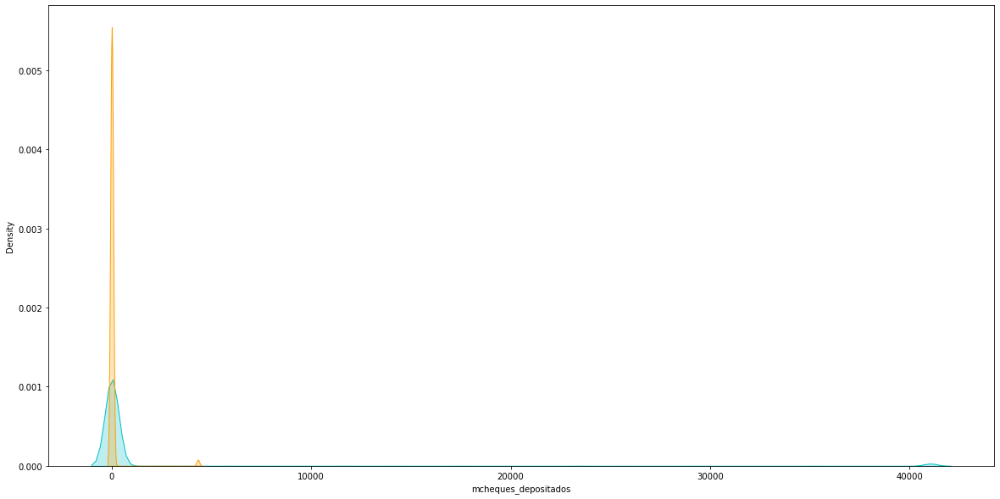

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


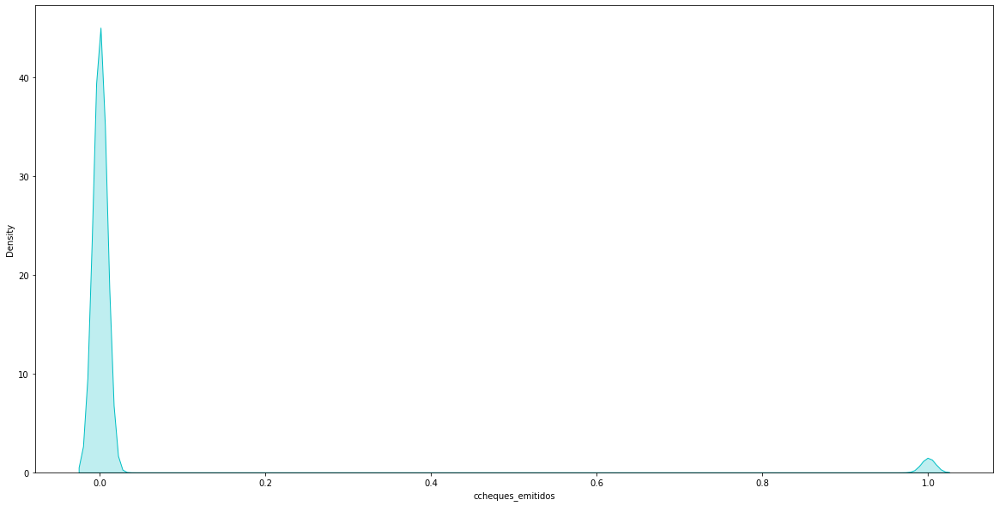

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


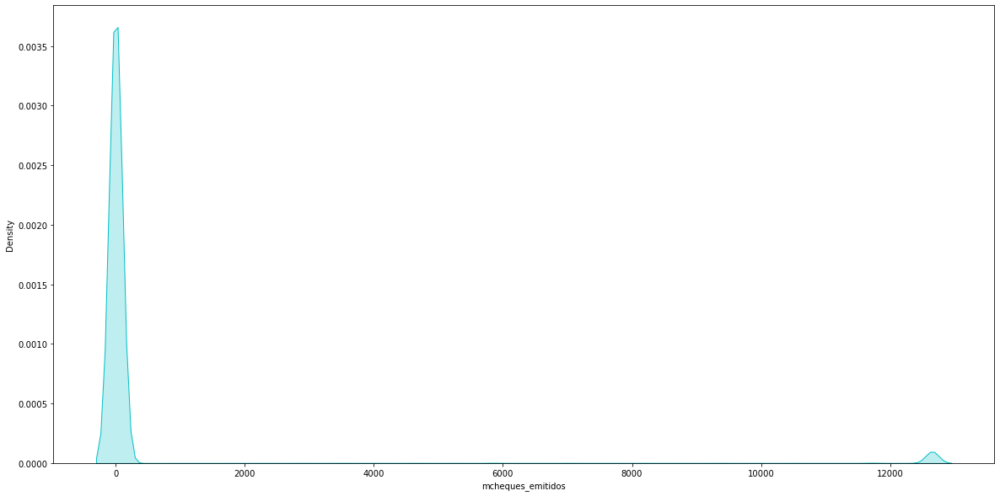

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


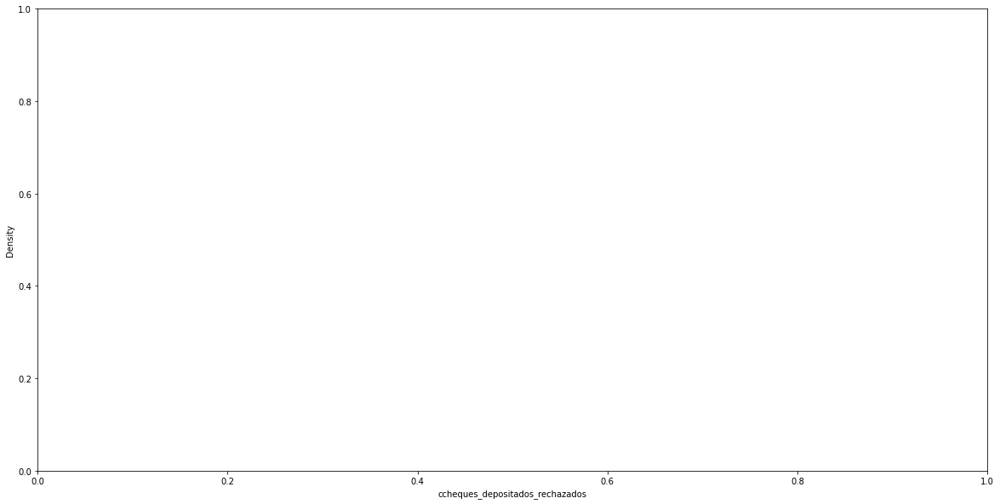

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


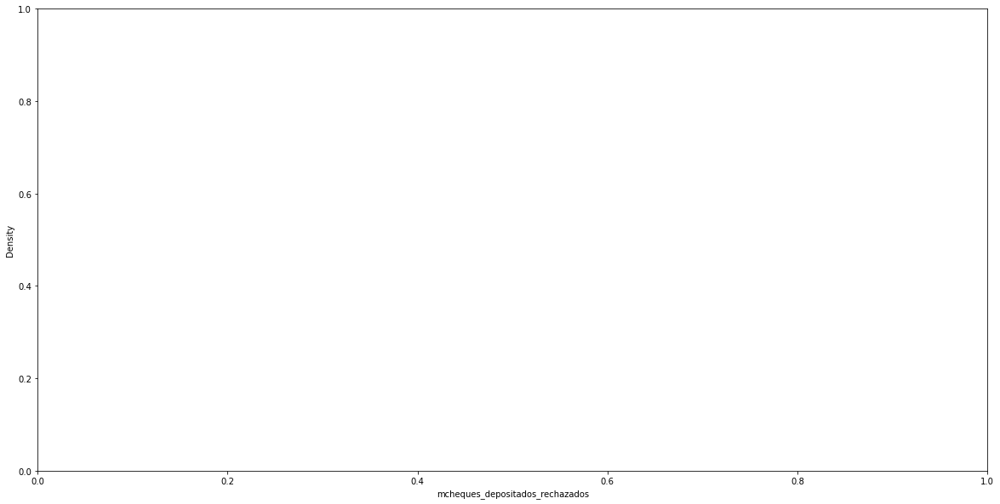

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


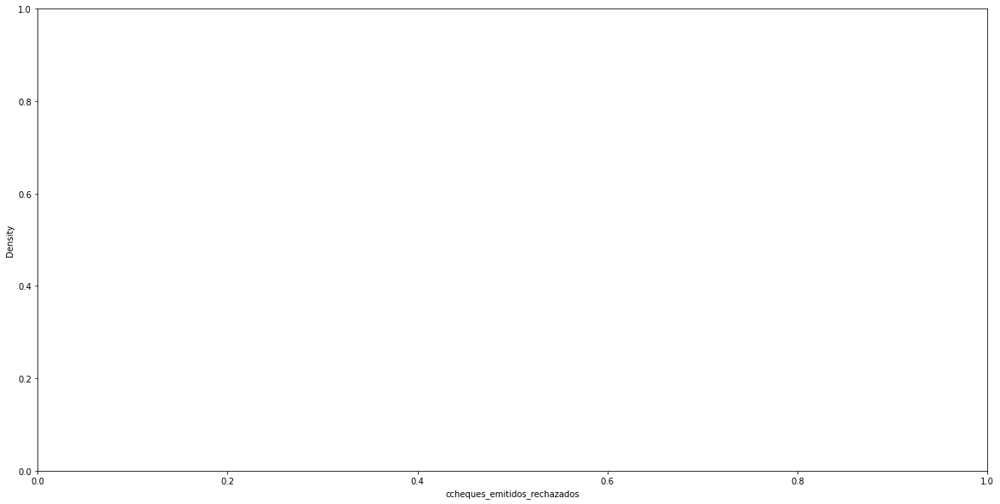

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


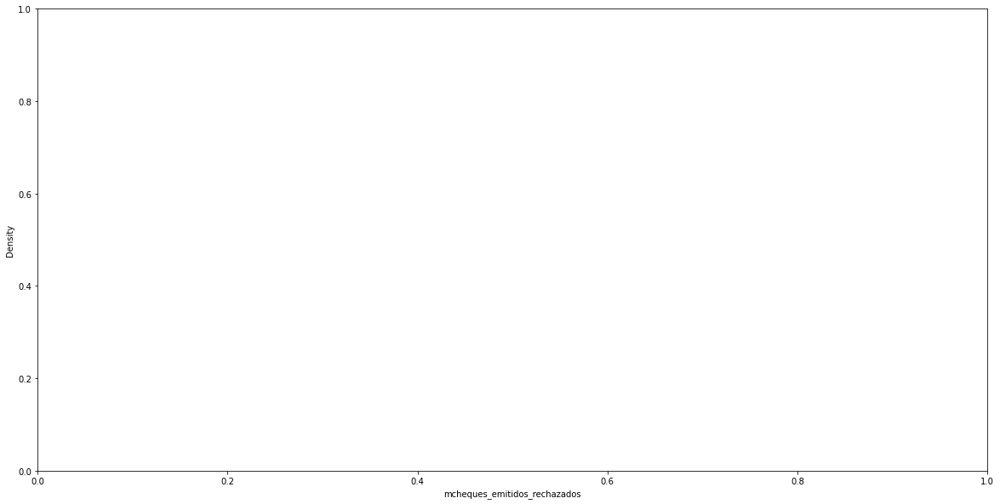

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


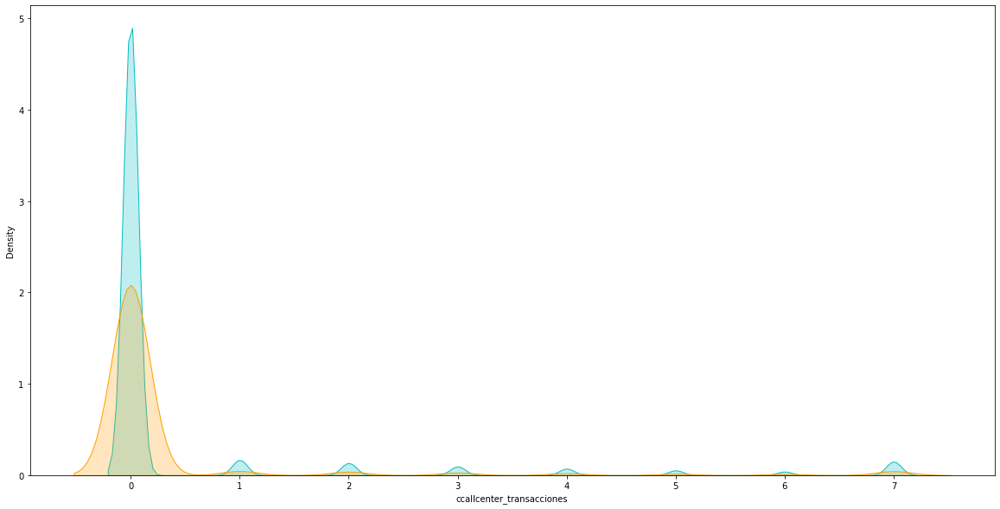

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


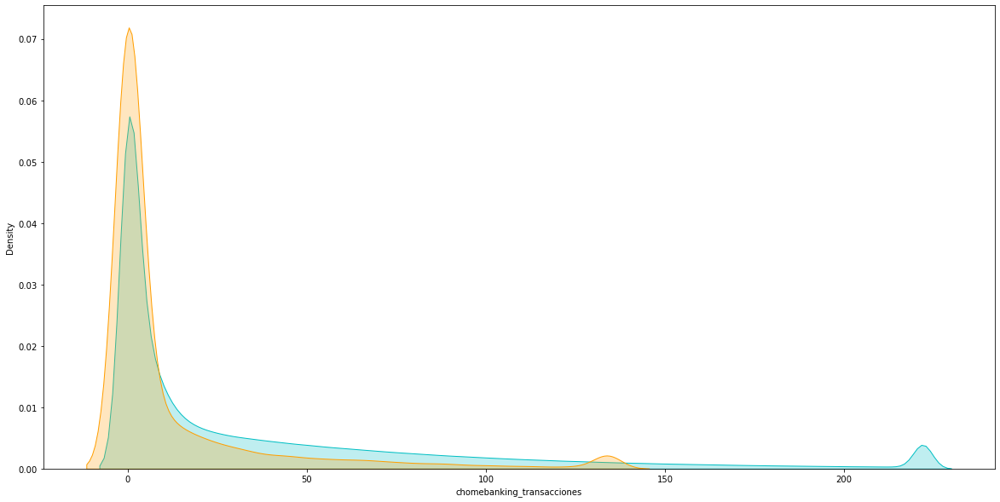

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


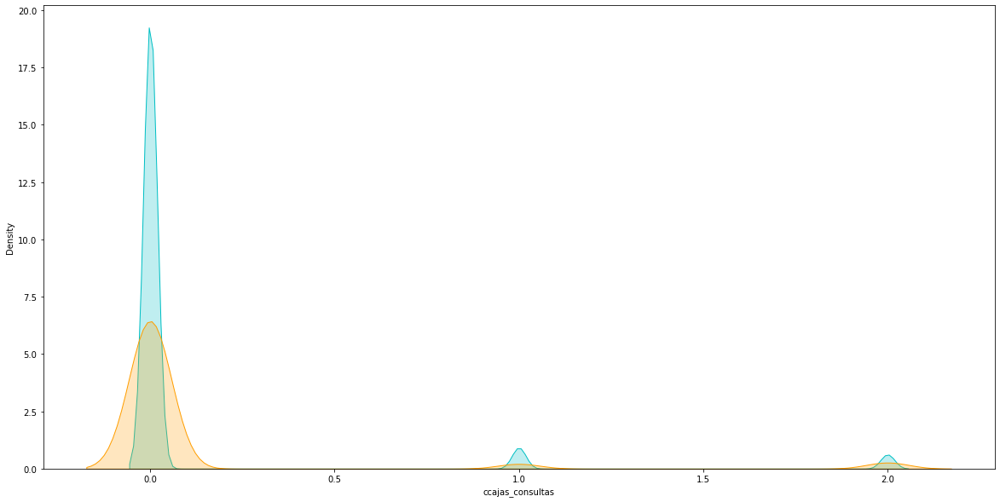

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


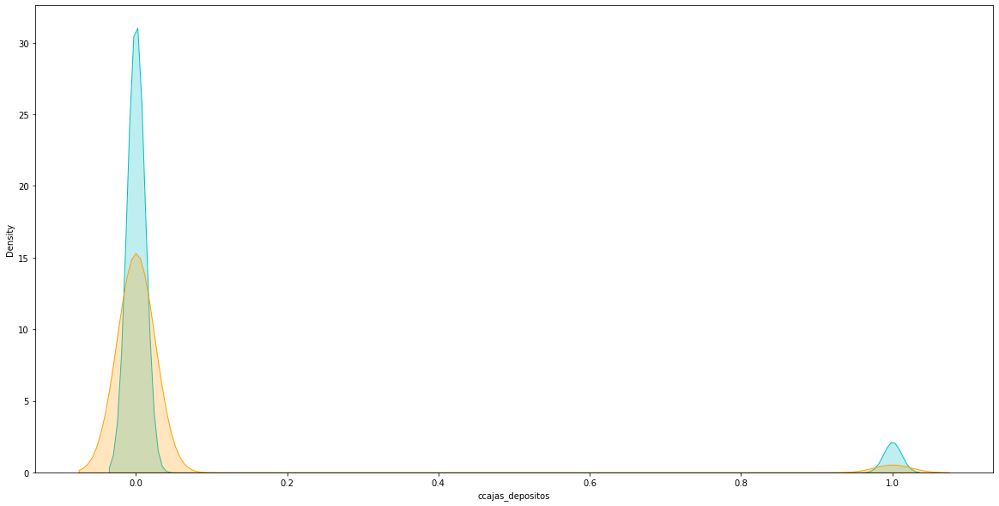

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


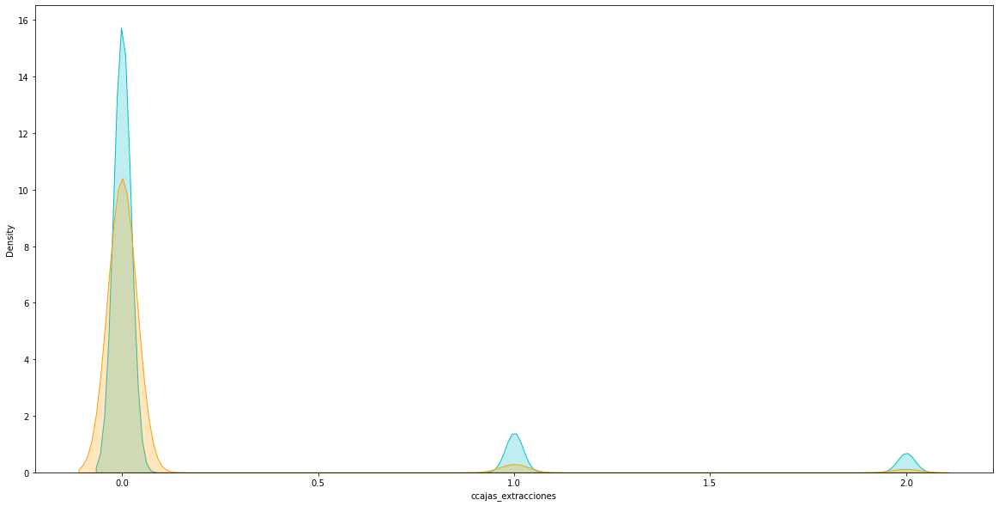

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


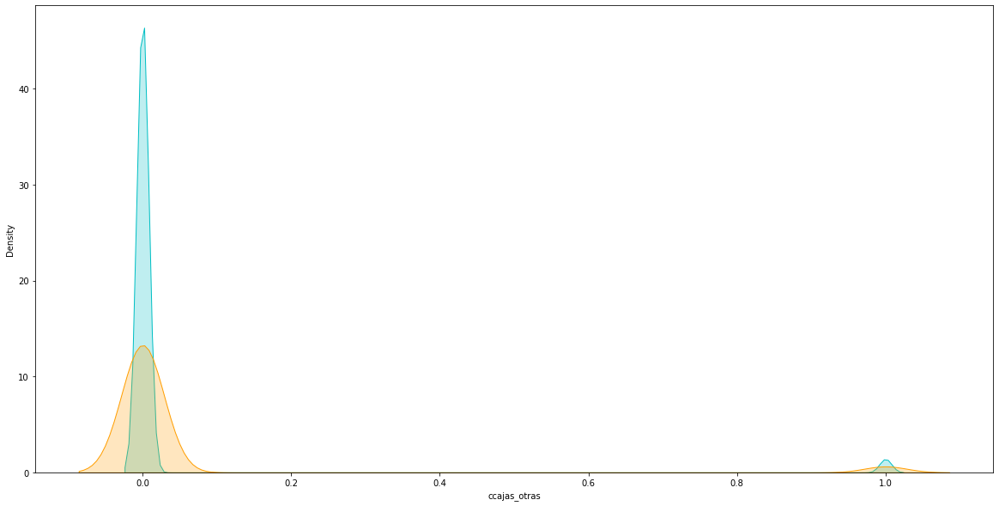

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


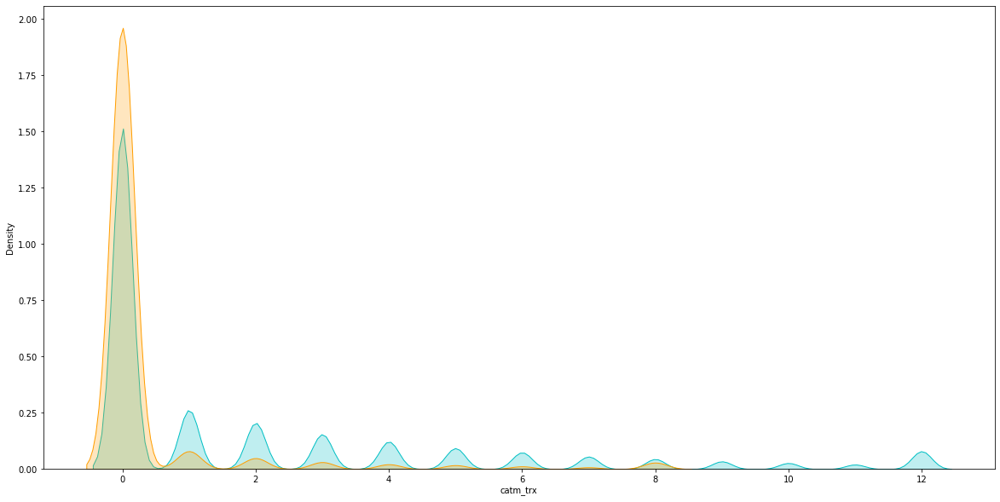

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


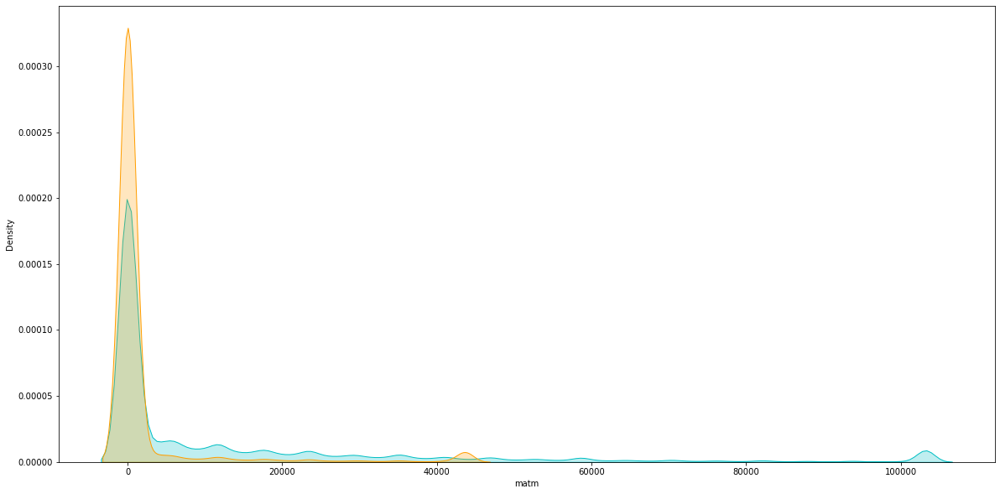

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


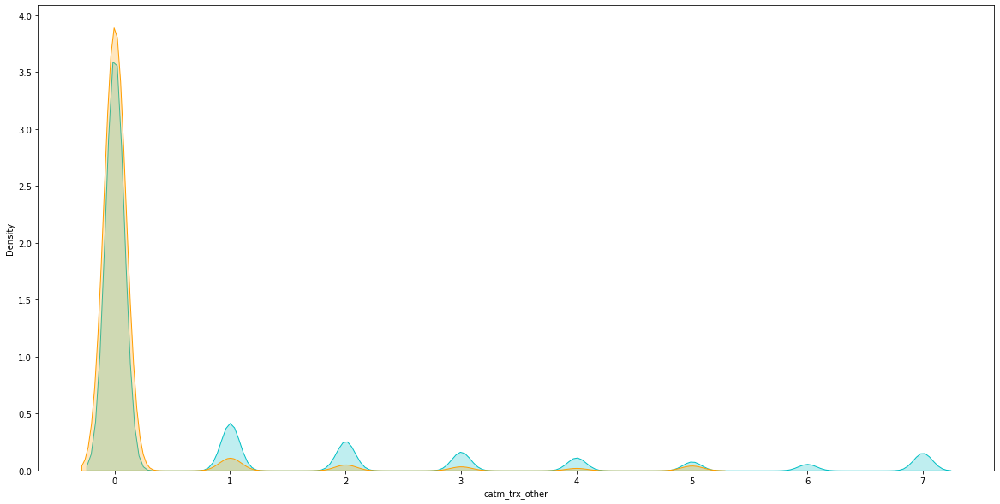

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


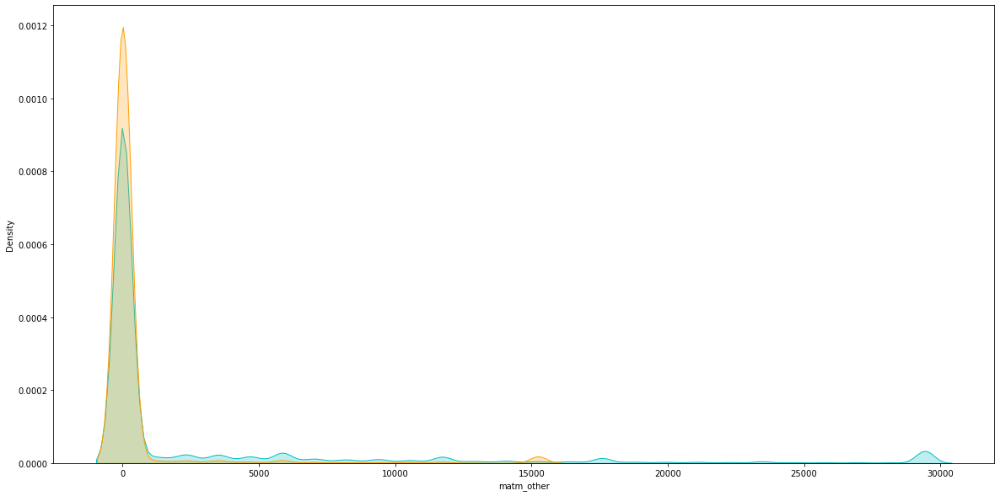

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


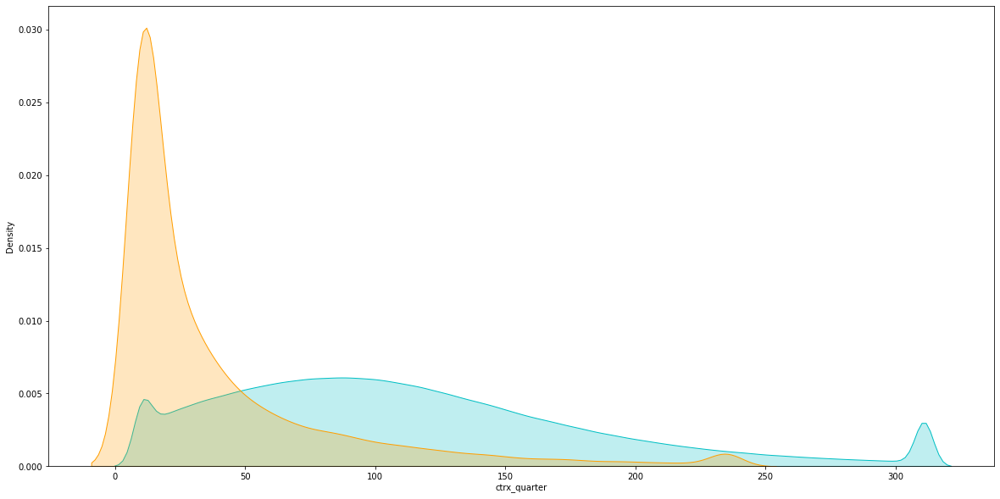

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


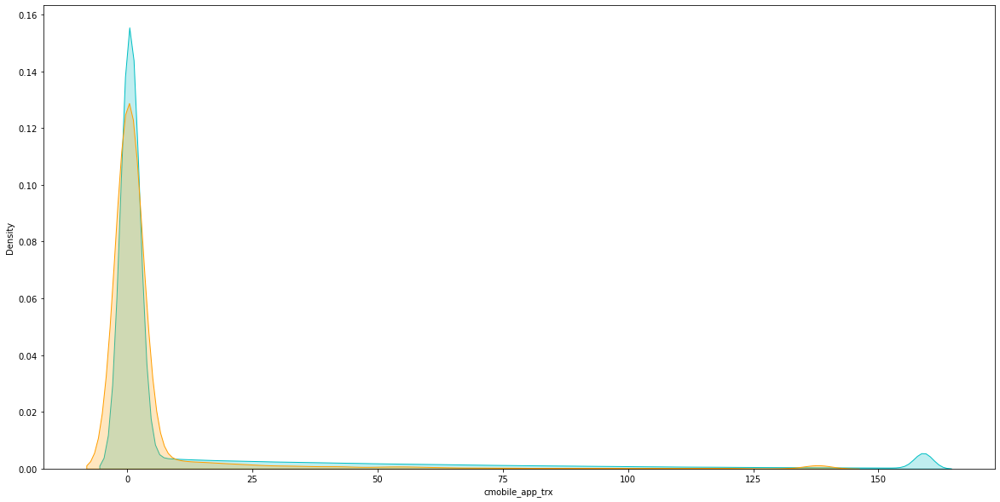

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


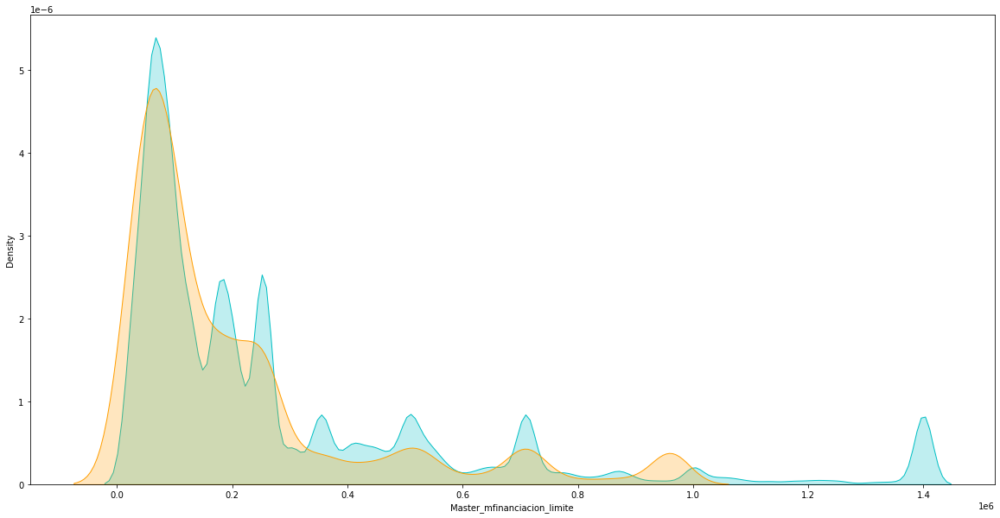

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


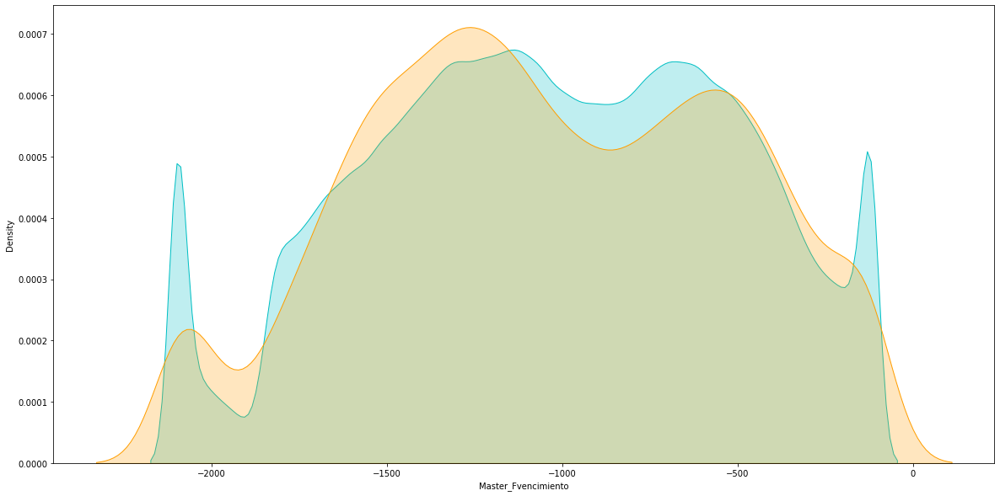

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


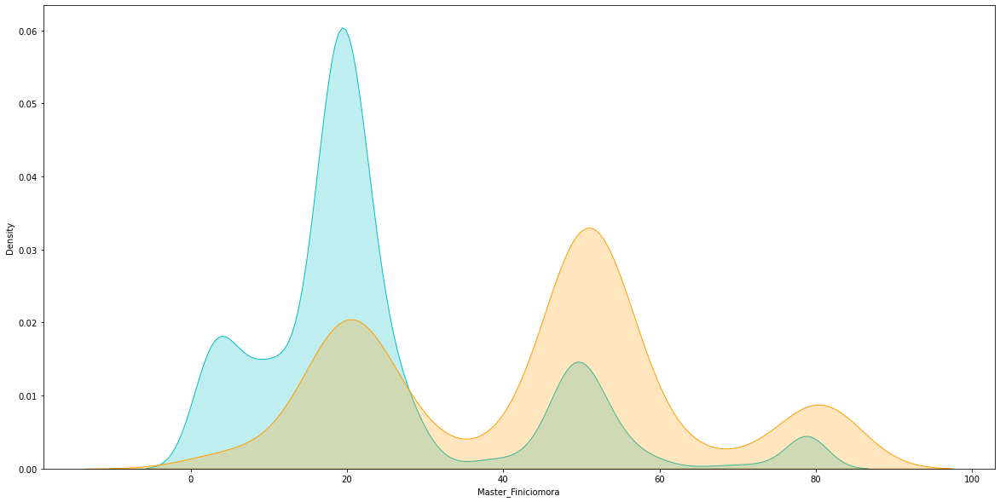

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


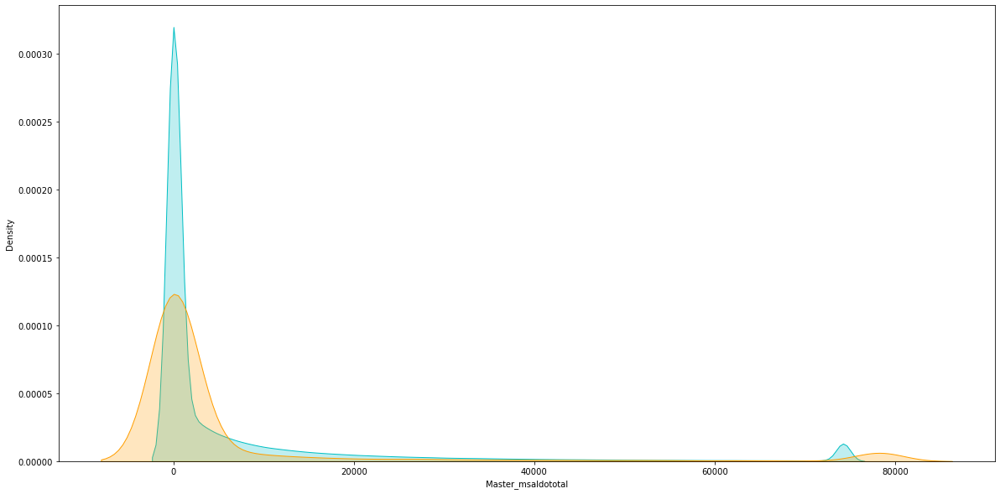

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


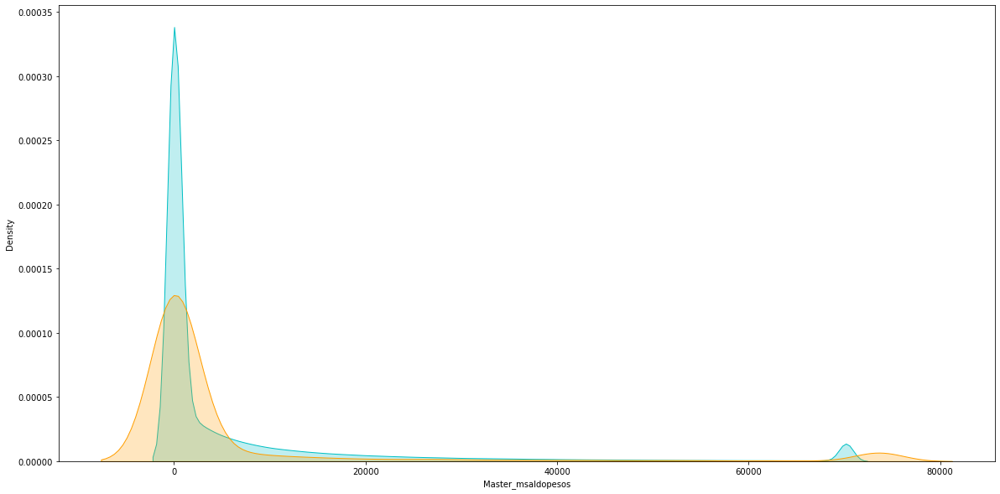

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


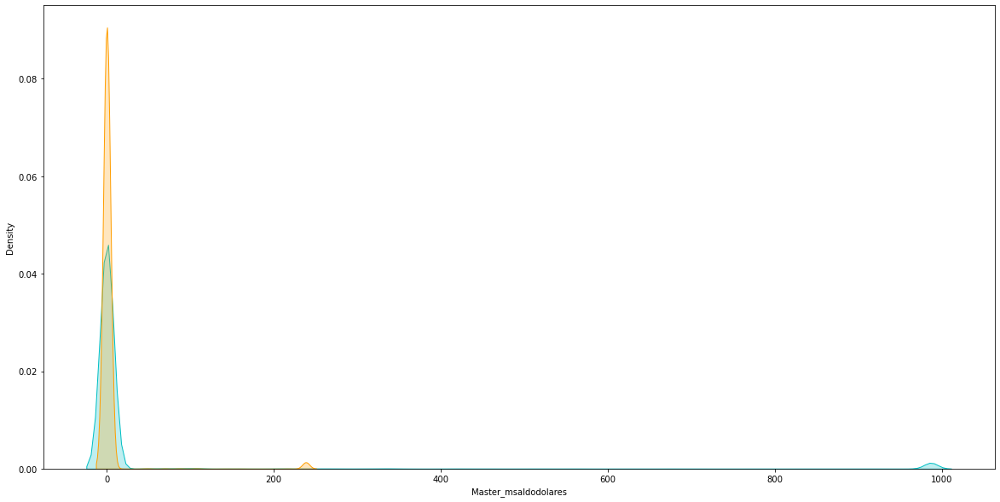

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


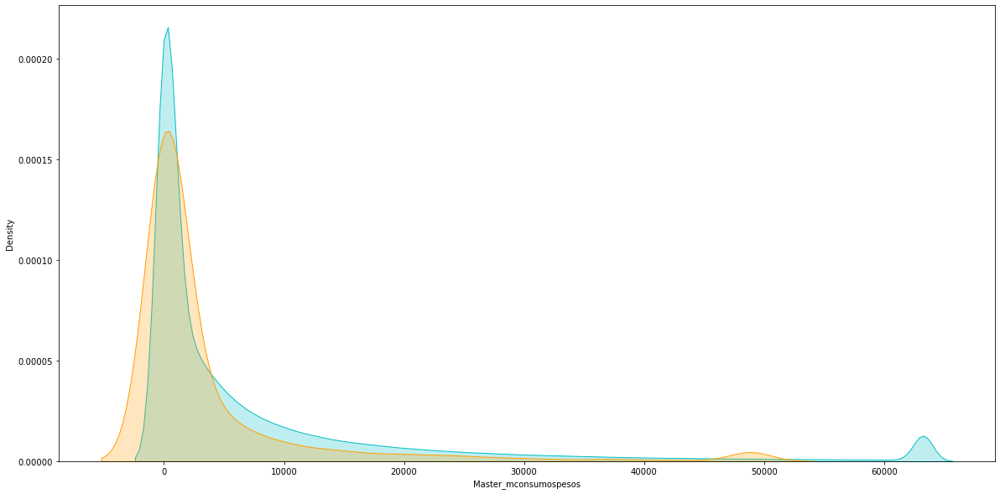

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


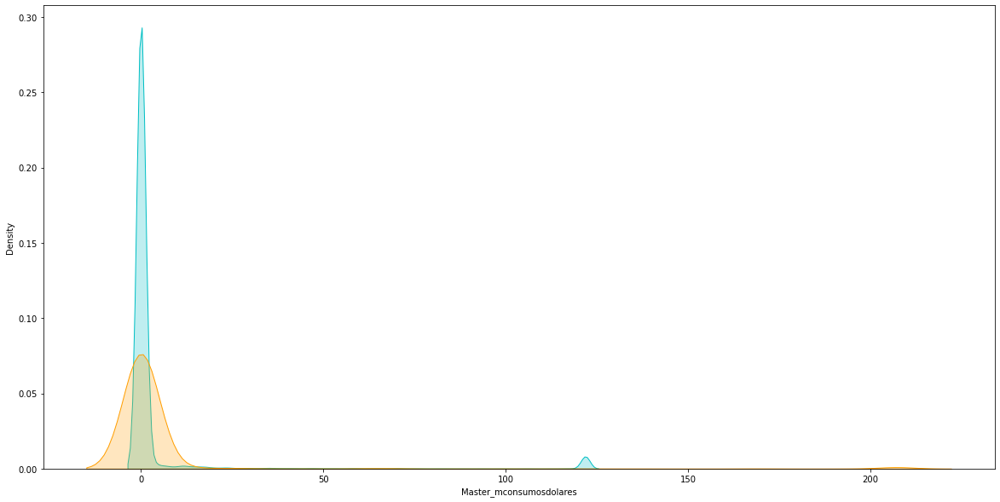

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


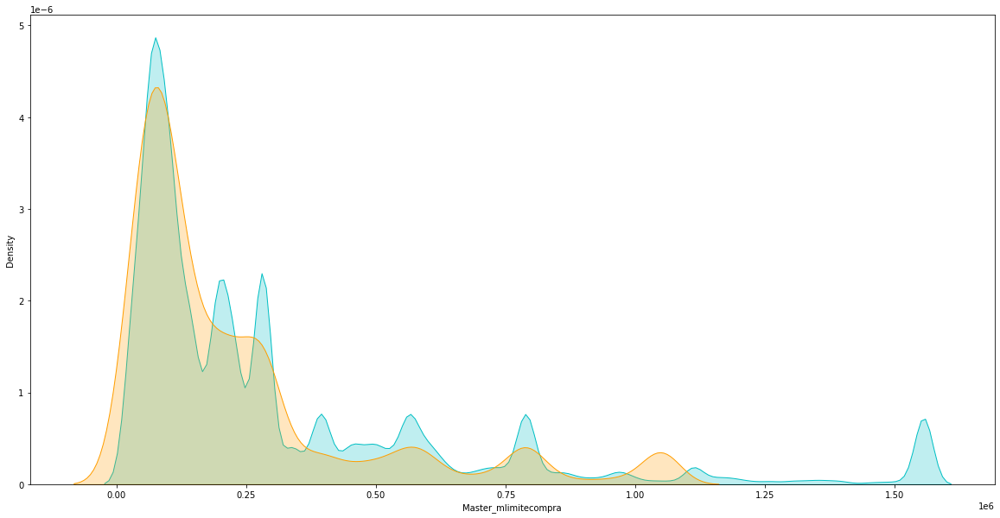

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


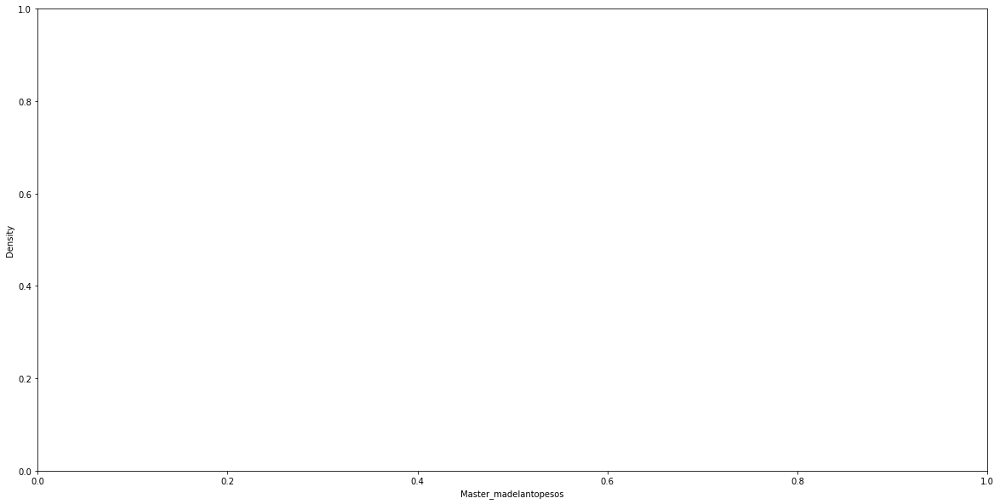

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


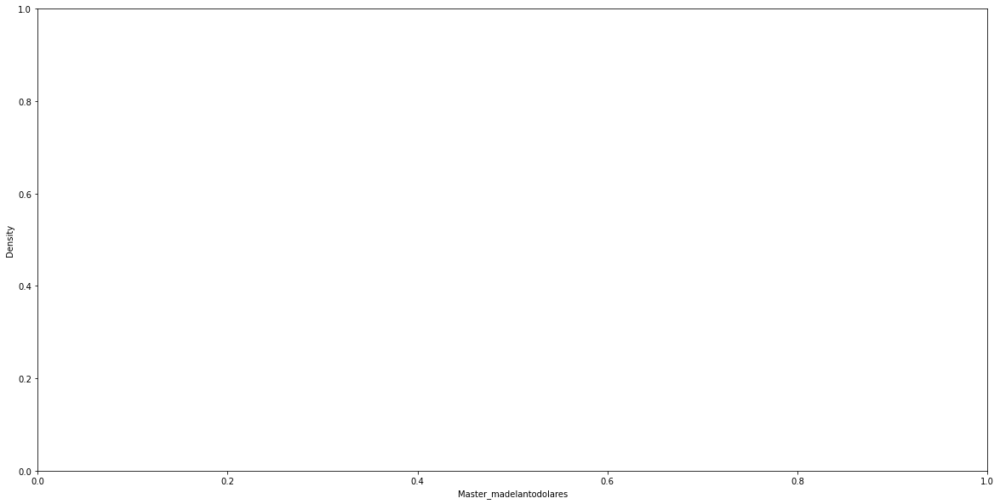

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


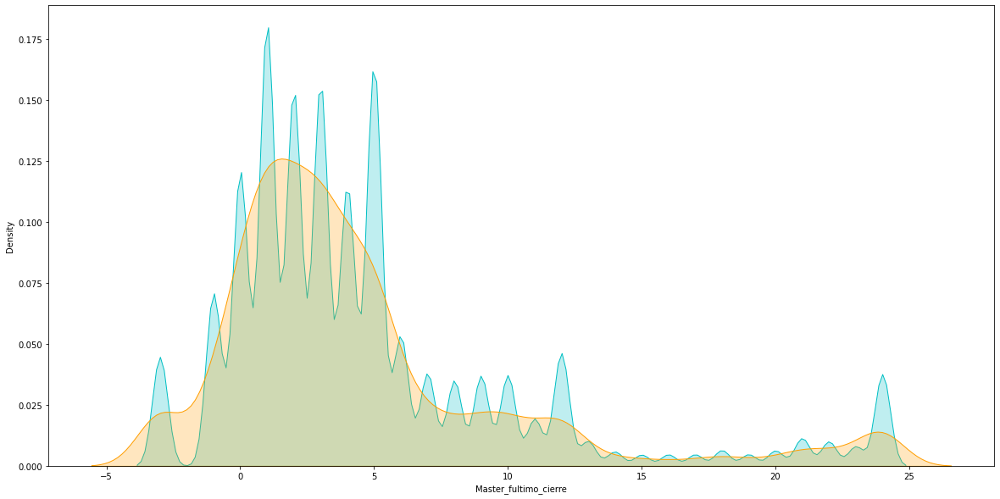

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


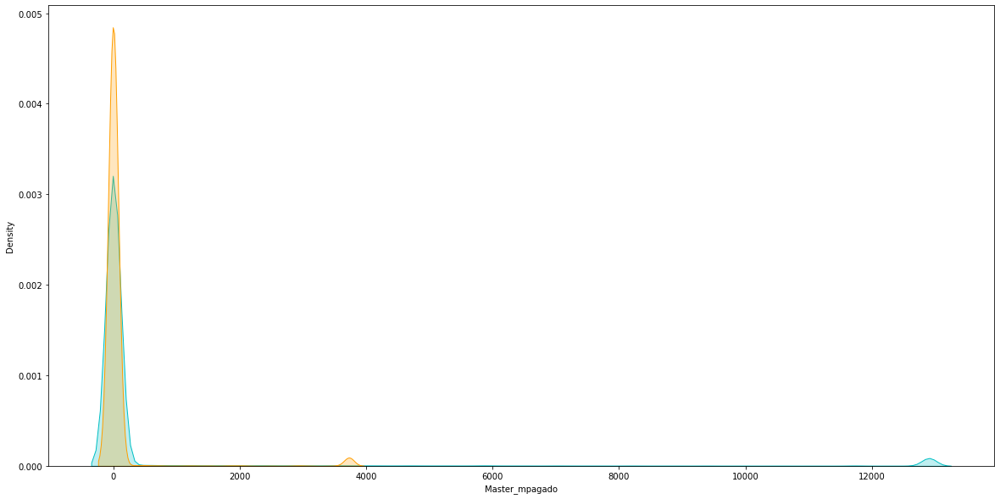

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


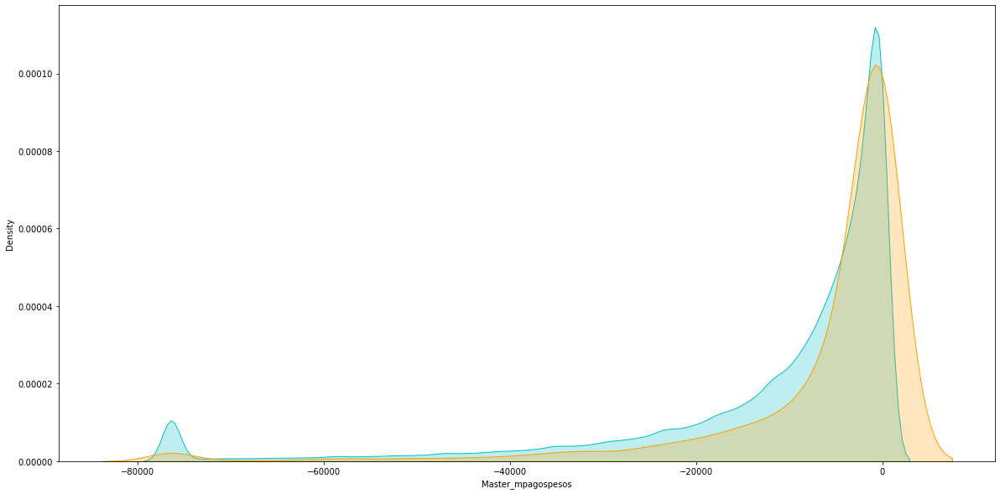

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


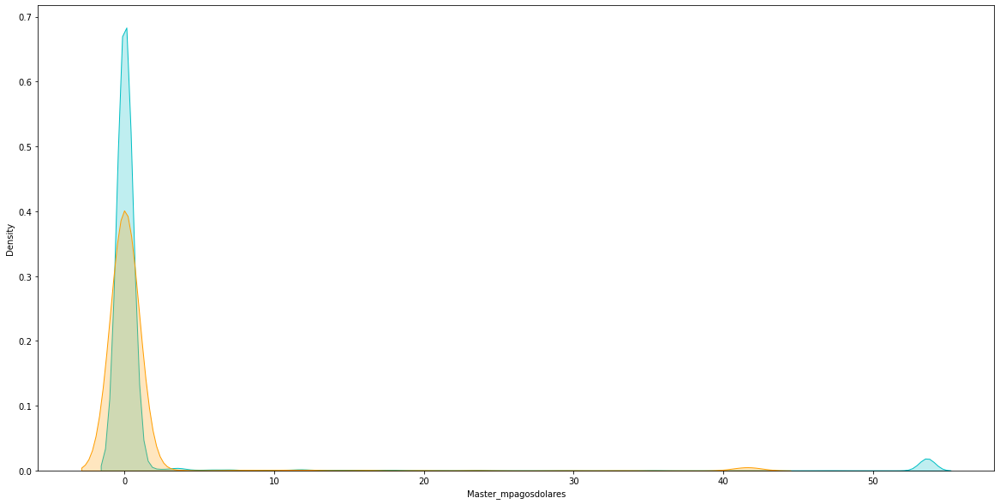

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


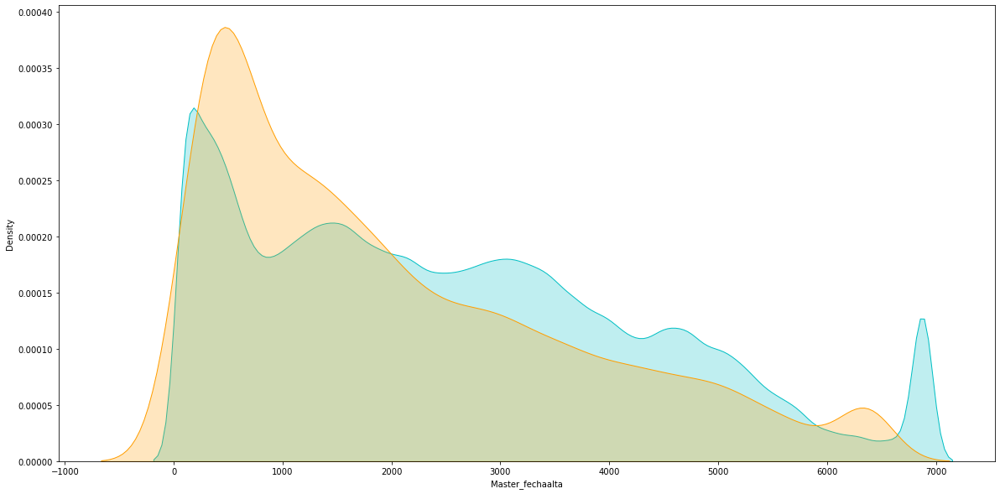

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


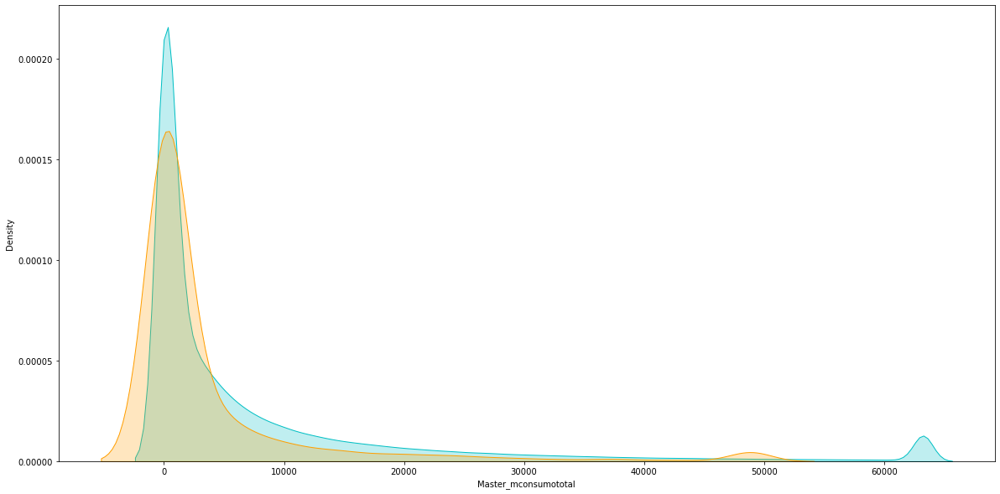

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


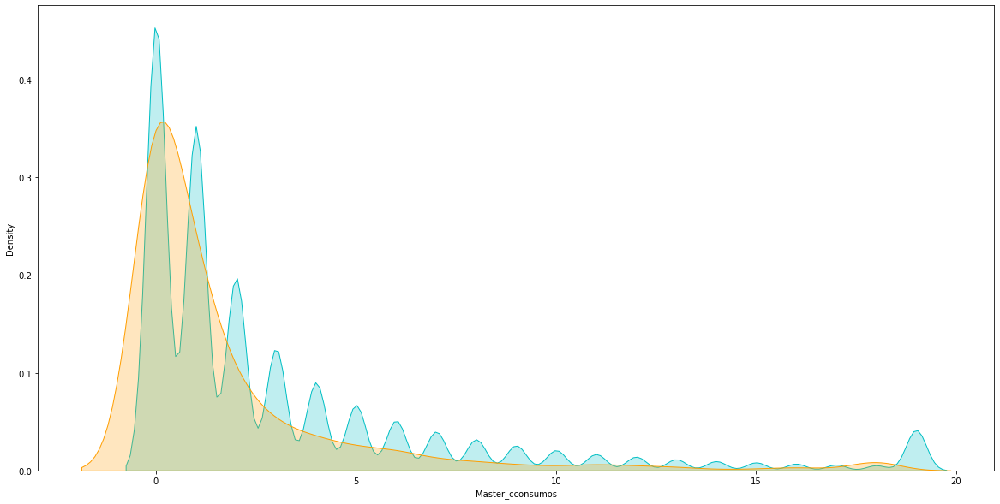

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


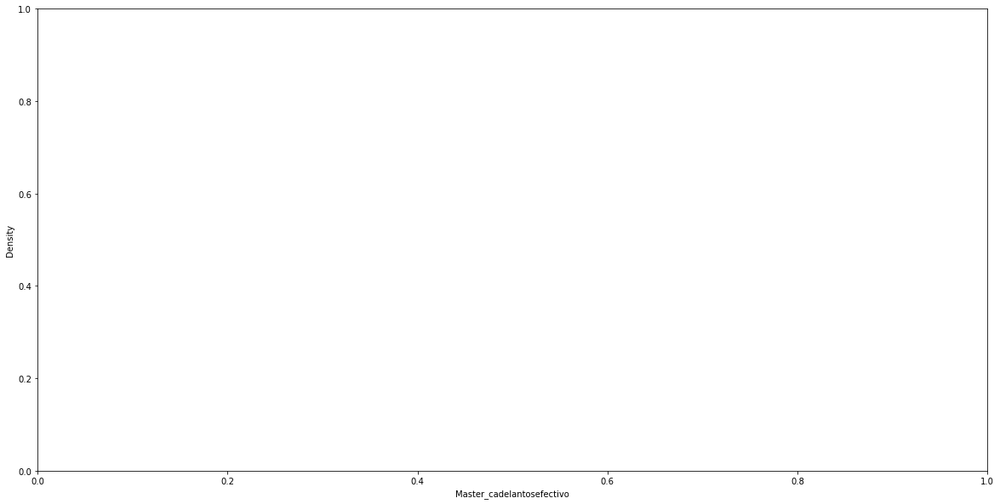

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


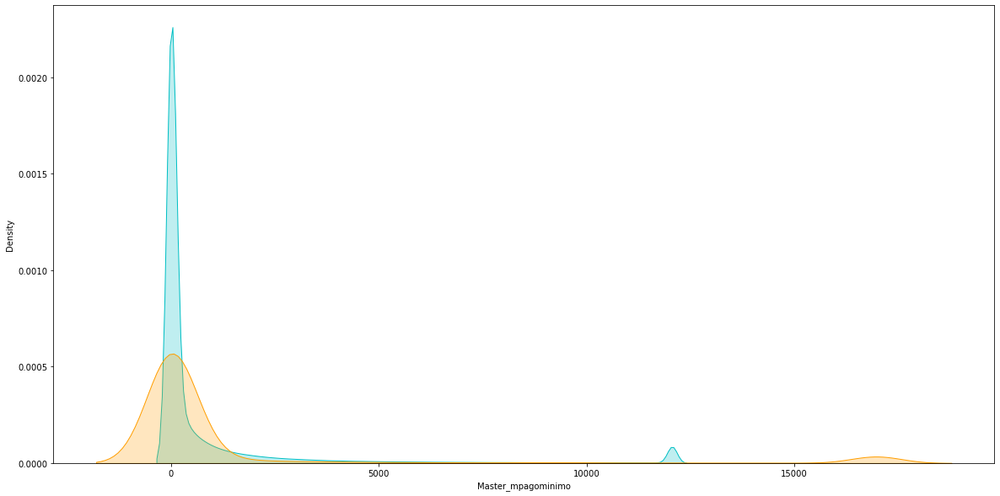

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


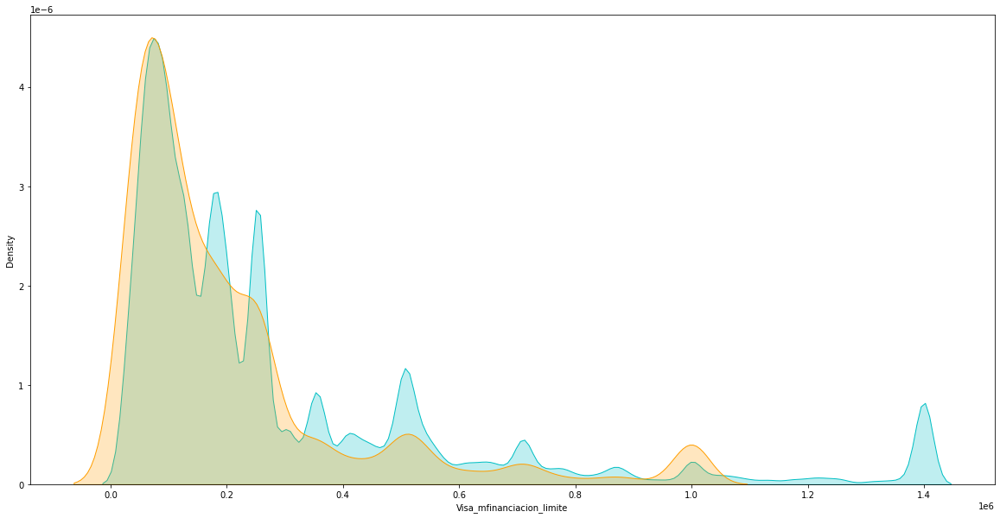

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


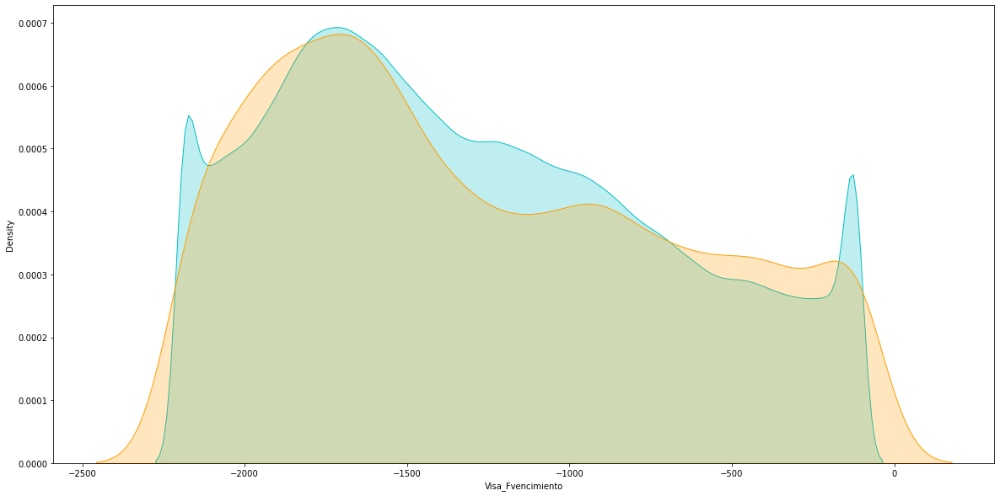

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


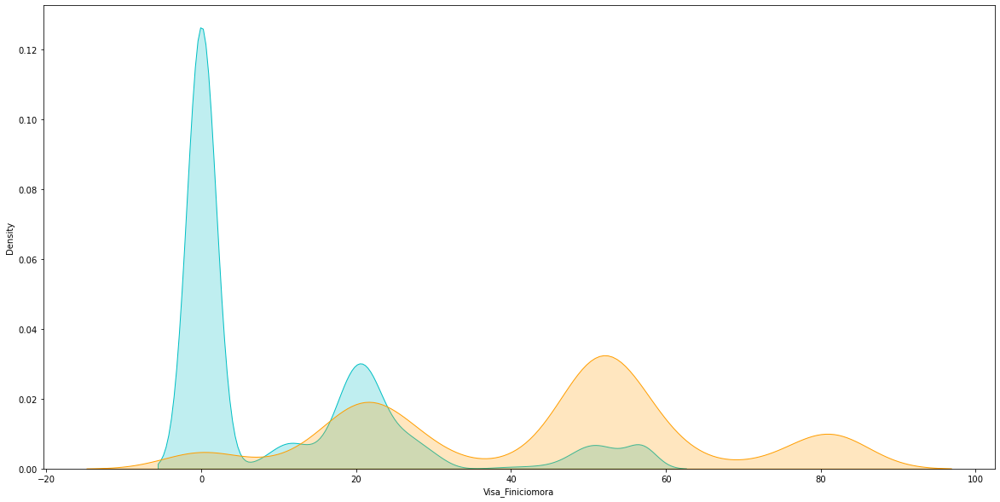

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


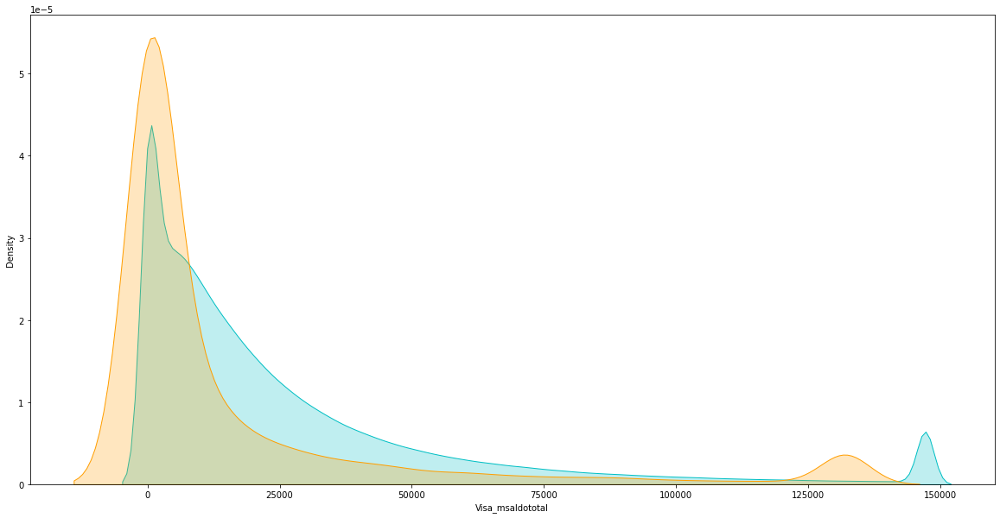

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


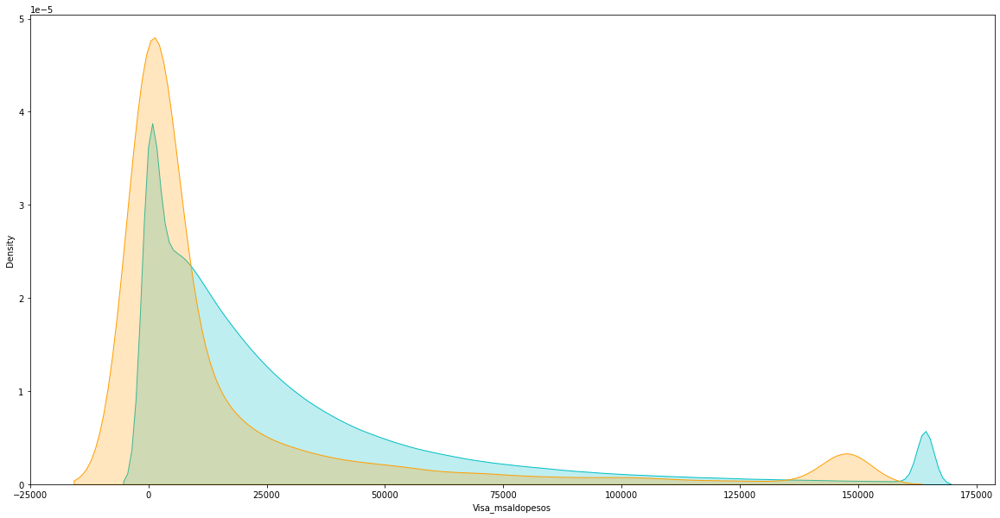

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


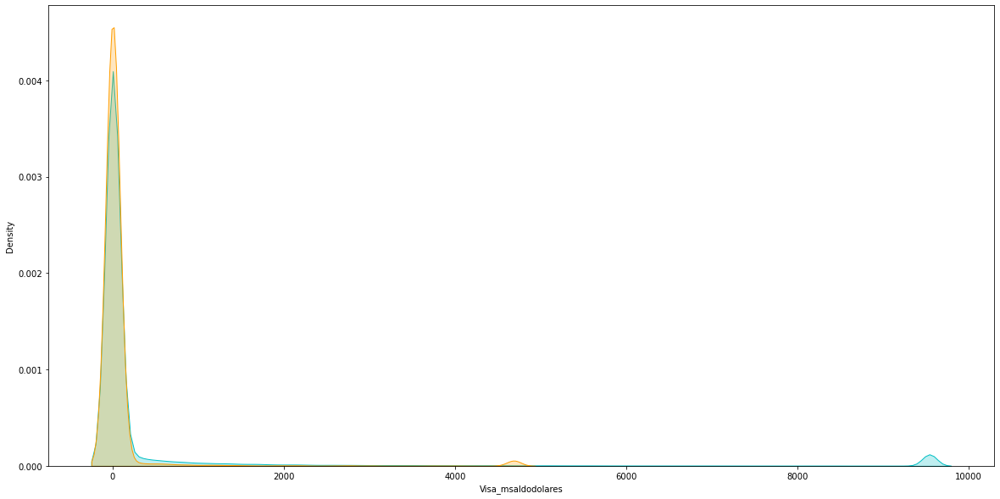

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


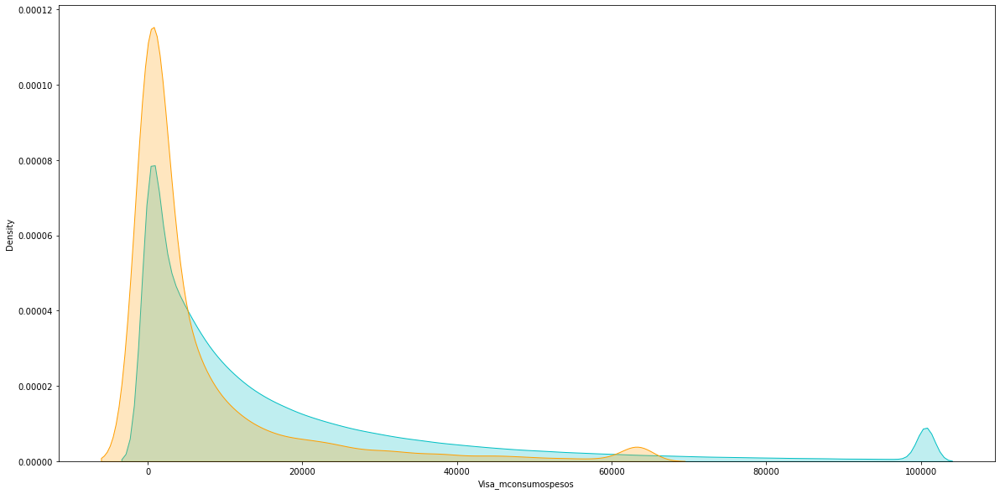

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


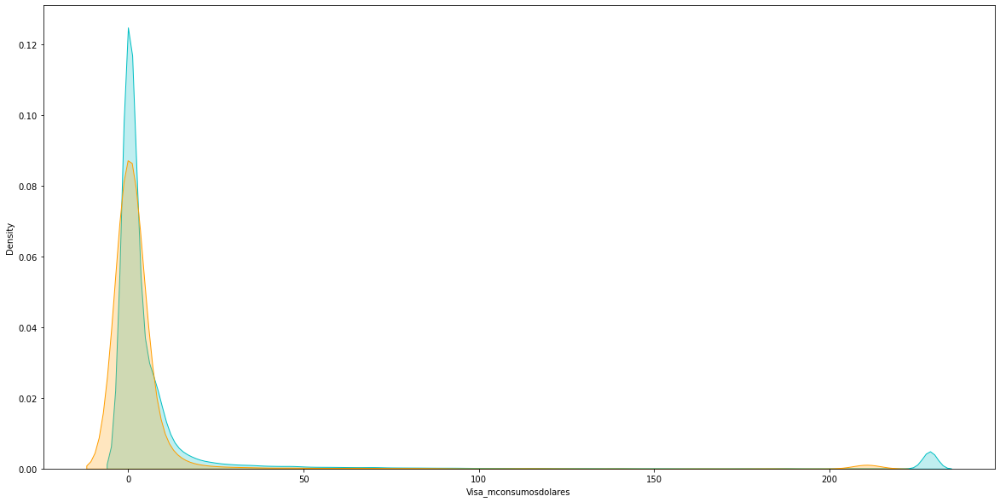

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


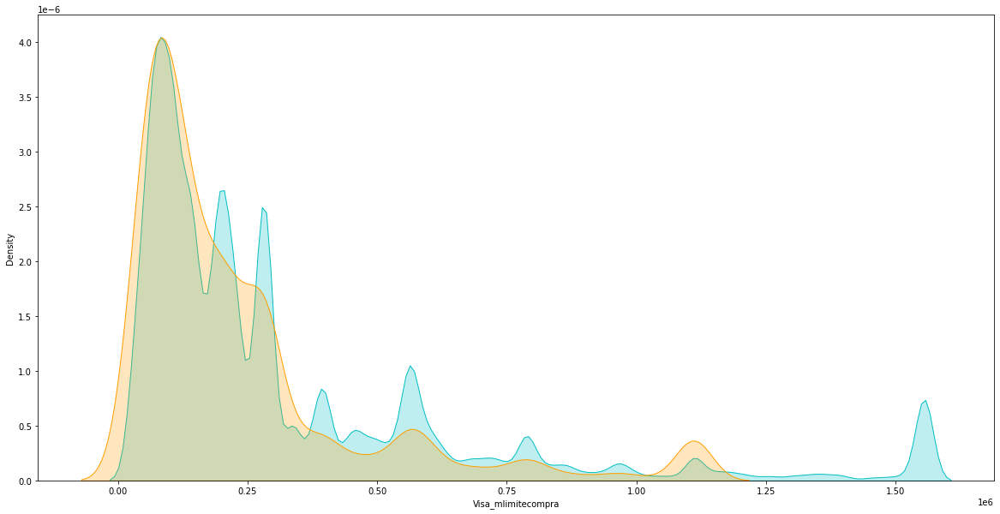

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


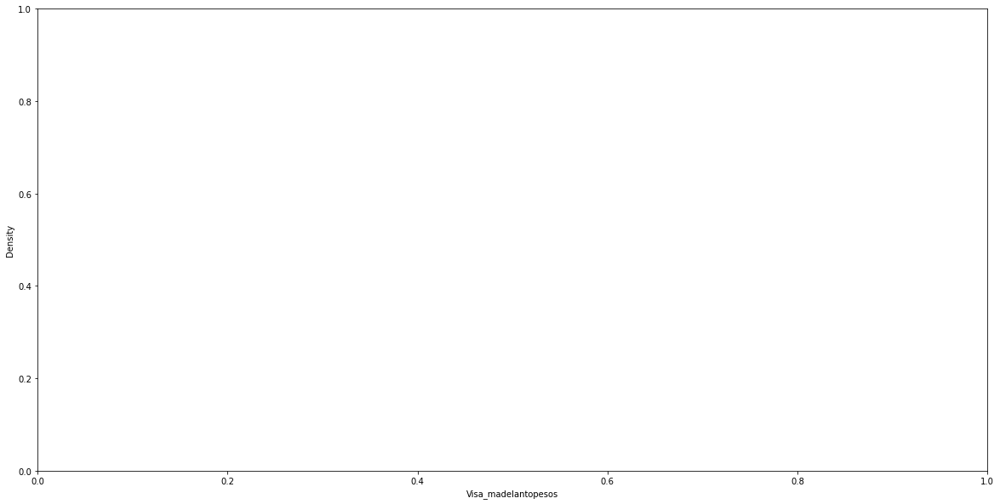

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


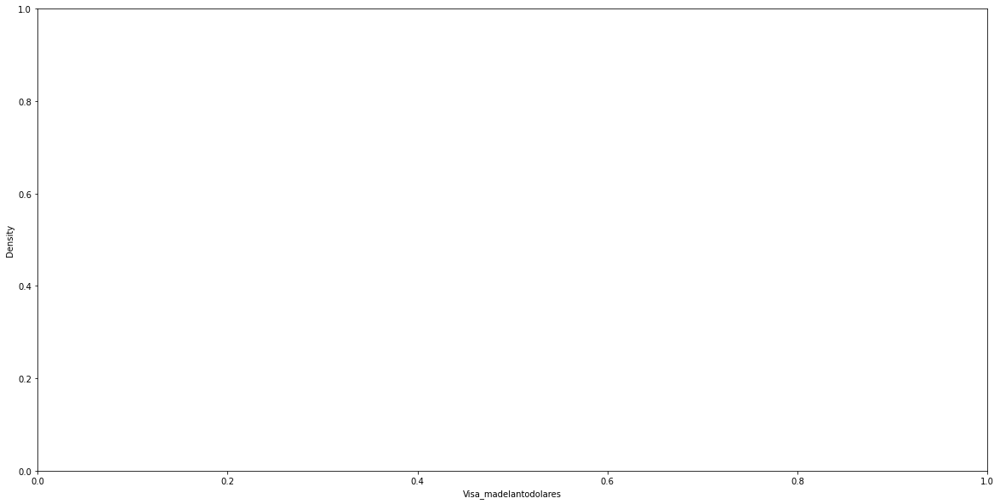

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


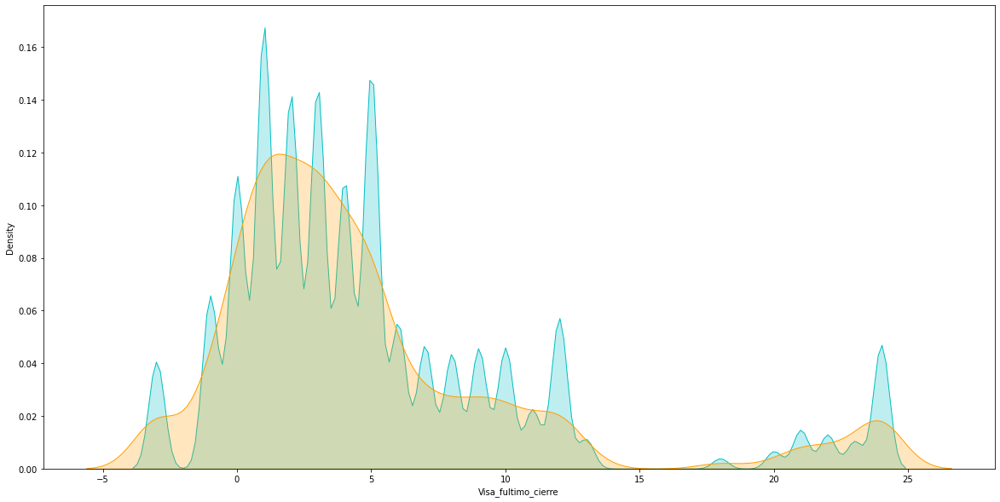

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


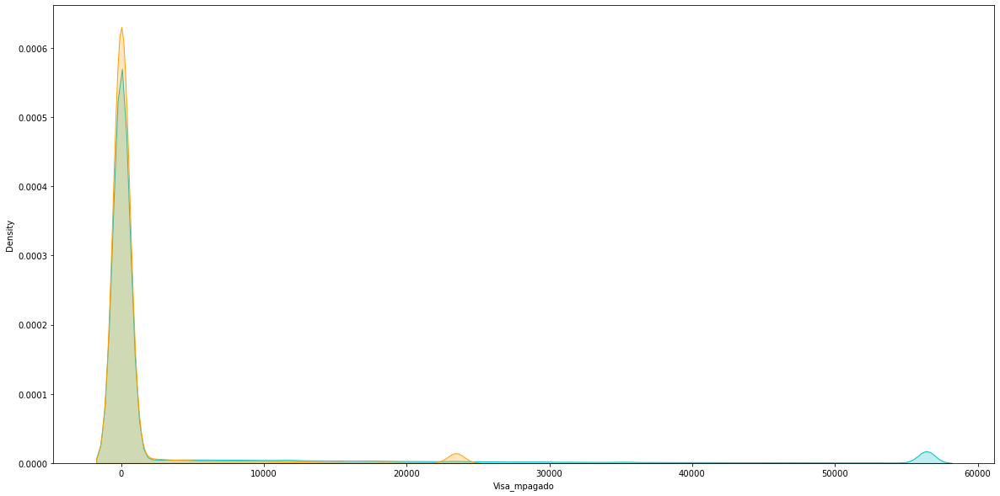

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


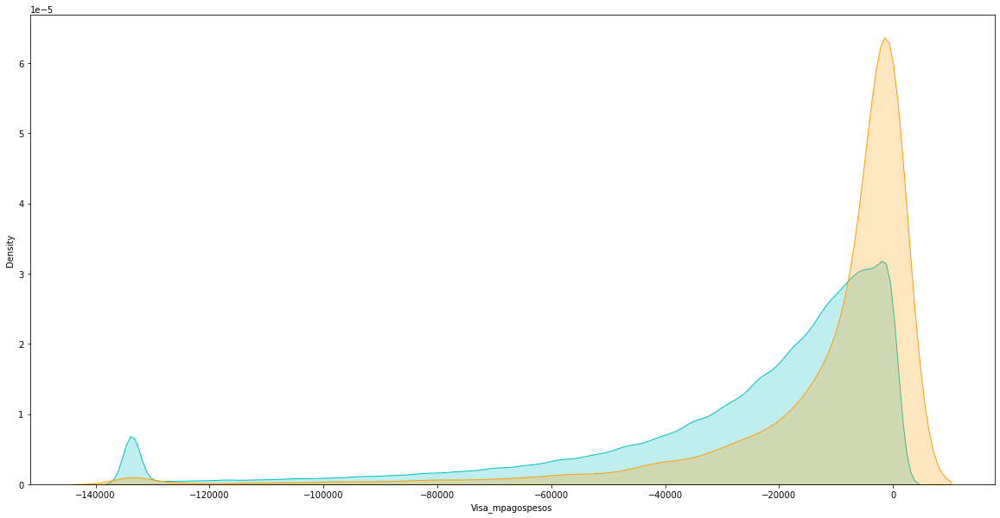

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


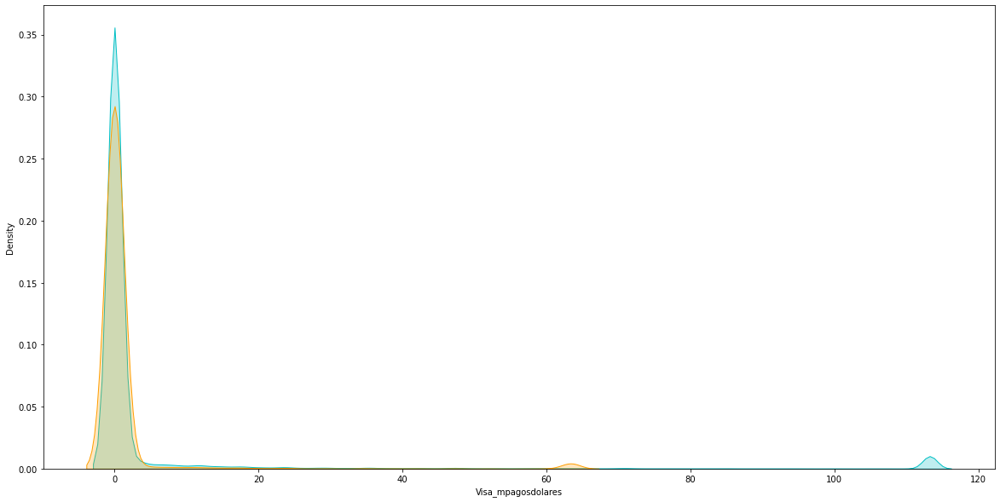

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


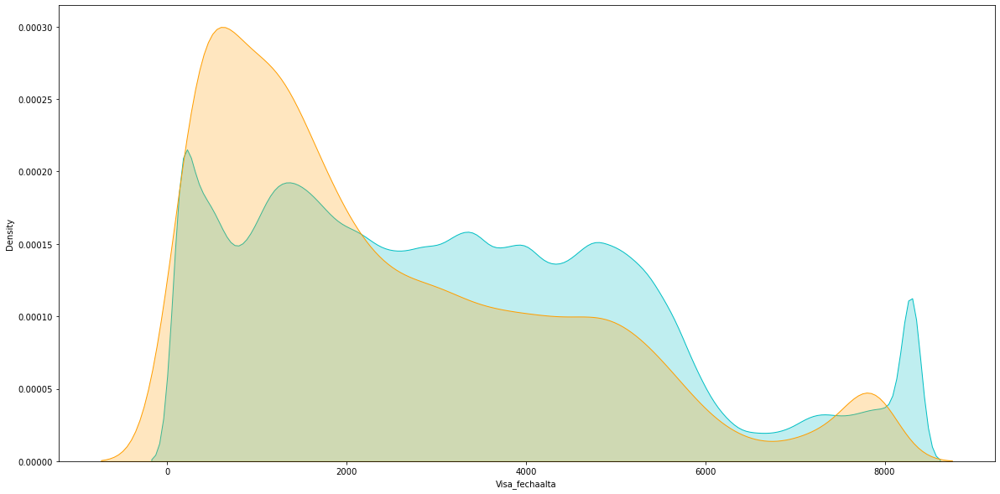

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


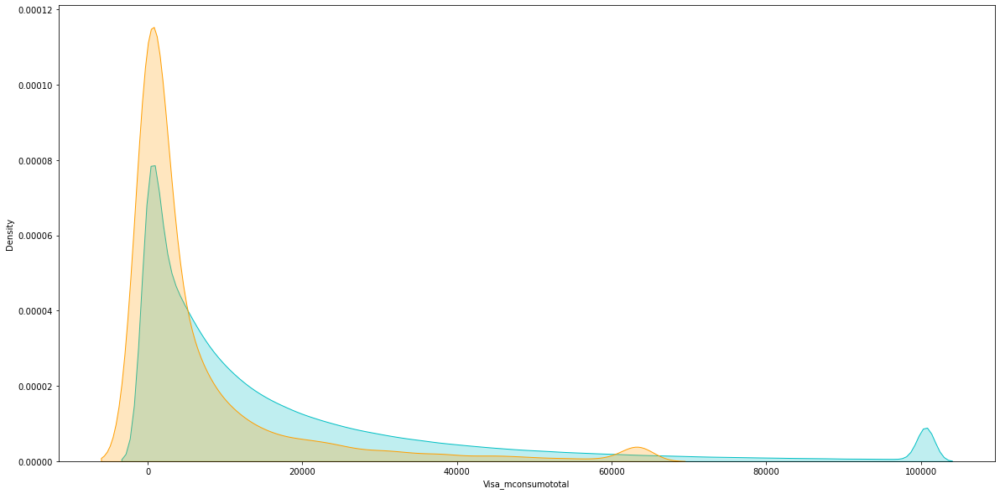

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


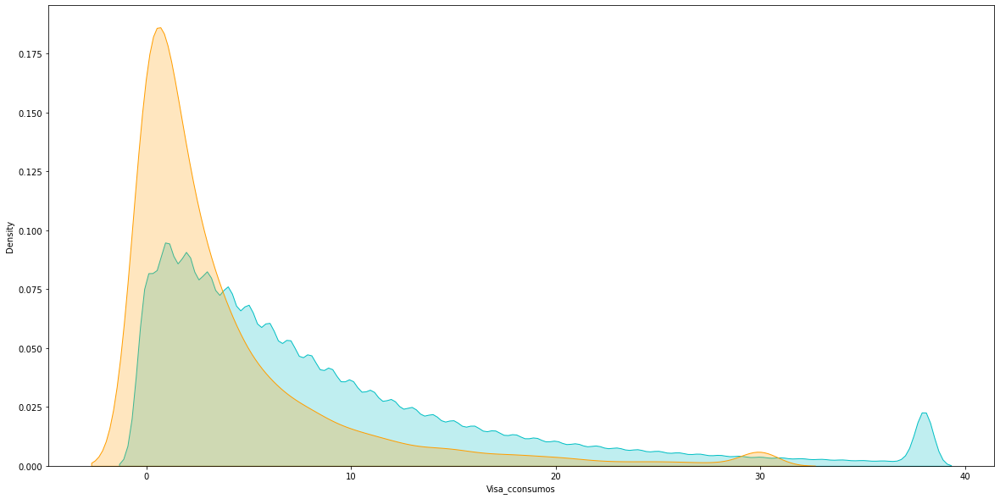

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


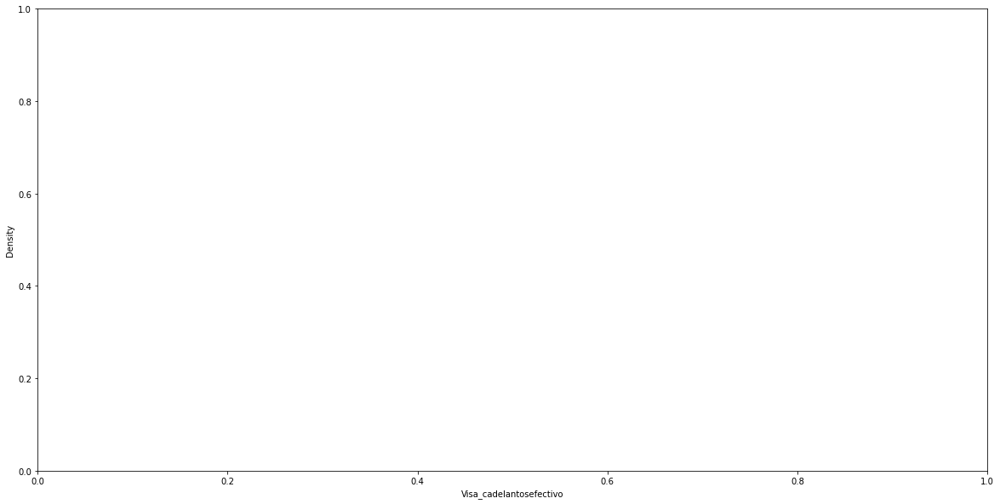

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


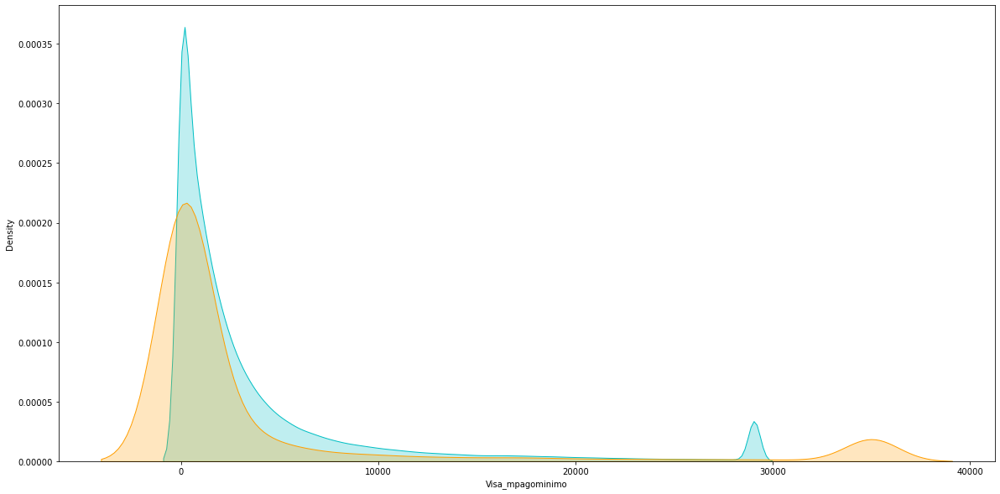

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


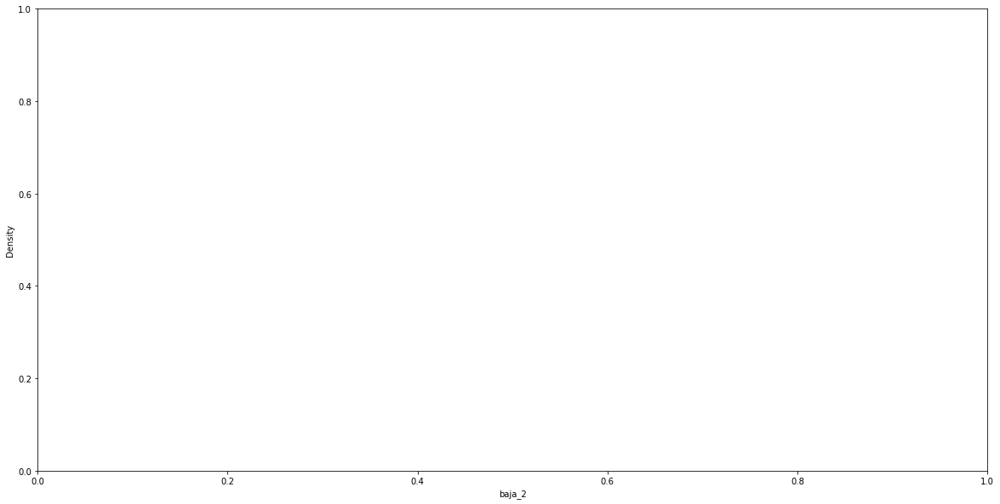

In [37]:
for i in numerical_columns:
        plt.figure(figsize=(20, 10))
        sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
        axes[0].set_xlabel(i)
        axes[0].set_ylabel('Density')
        axes[0].set_title(i)
        axes[0].legend()
        sns.kdeplot(x=df_bajas.loc[df_bajas['baja_2'] == 1, i].clip(upper=df_bajas[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#FF9E00', label='Baja', fill =True)
        plt.show()

/tmp/ipykernel_2345/2466268440.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_continua['debitos_automaticos'] = df_continua['mcuenta_debitos_automaticos'] + df_continua['mttarjeta_visa_debitos_automaticos'] + df_continua['mttarjeta_master_debitos_automaticos']
/tmp/ipykernel_2345/2466268440.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_continua['total_consumos'] = df_continua[['mautoservicio', 'mtarjeta_visa_consumo', 'mtarjeta_master_consumo', 'mpagodeservicios', 'debitos_automaticos']].

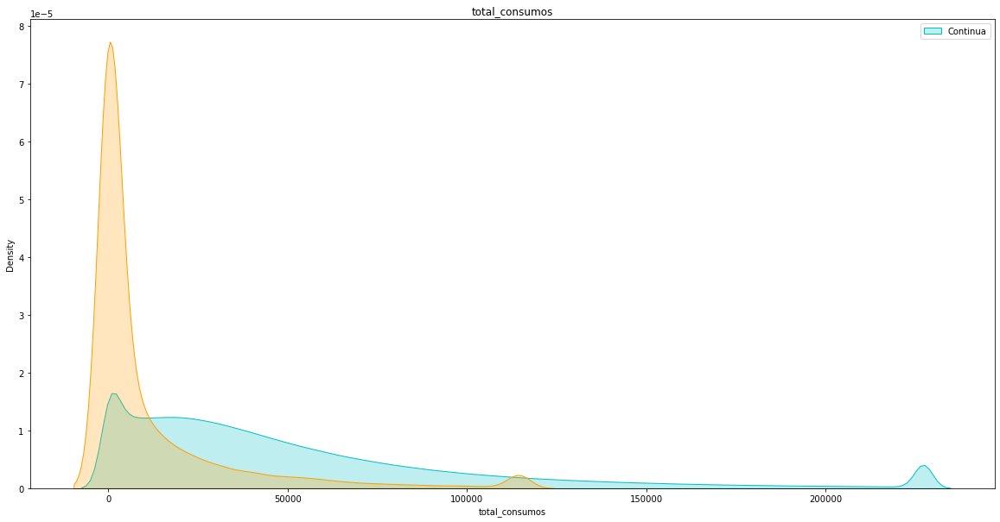

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

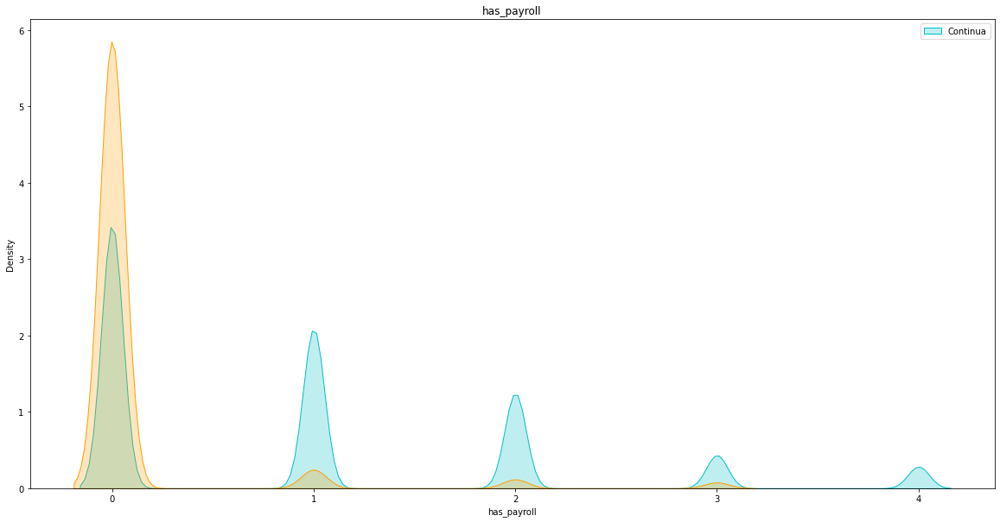

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

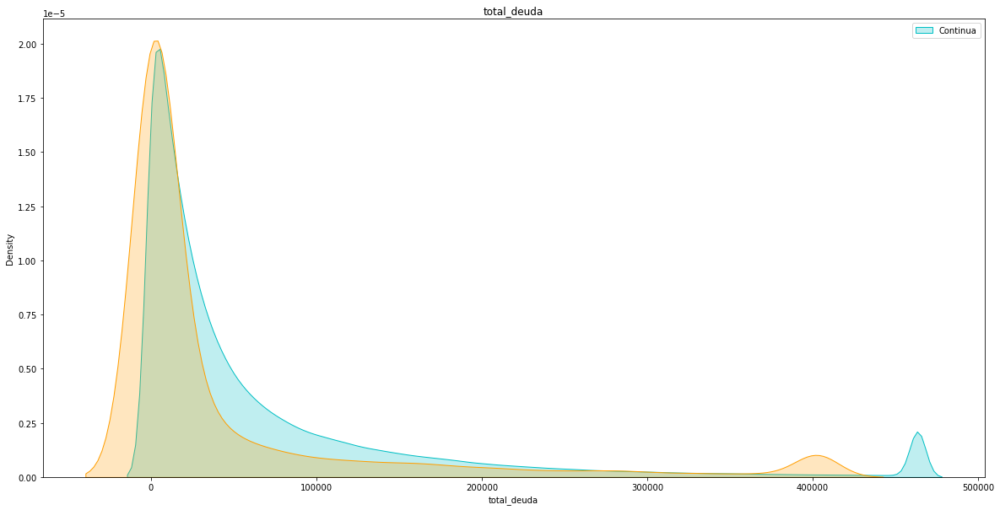

In [17]:

for i in ['total_consumos', 'has_payroll', 'total_deuda']:
        plt.figure(figsize=(20, 10))
        sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
        plt.xlabel(i)
        plt.ylabel('Density')
        plt.title(i)
        plt.legend()
        sns.kdeplot(x=df_bajas.loc[df_bajas['baja_2'] == 1, i].clip(upper=df_bajas[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#FF9E00', label='Baja', fill =True)
        plt.show()

In [14]:
#Create variables from R
#   dataset[, total_consumos := rowSums(.SD, na.rm = TRUE), .SDcols = c("mautoservicio", "mtarjeta_visa_consumo", "mtarjeta_master_consumo", "mpagodeservicios", "debitos_automaticos")]
#  dataset[, has_payroll := ifelse(dataset$cpayroll_trx + dataset$cpayroll2_trx  > 0, 1, 0) ]
#   dataset[, total_deuda := rowSums(.SD, na.rm = TRUE), .SDcols = c("mprestamos_personales", "mprestamos_prendarios", "mprestamos_hipotecarios", "Visa_msaldototal", "Master_msaldototal")]
 # dataset[, debitos_automaticos := mcuenta_debitos_automaticos + mttarjeta_visa_debitos_automaticos + mttarjeta_master_debitos_automaticos]
df['debitos_automaticos'] = df['mcuenta_debitos_automaticos'] + df['mttarjeta_visa_debitos_automaticos'] + df['mttarjeta_master_debitos_automaticos']
df['total_consumos'] = df[['mautoservicio', 'mtarjeta_visa_consumo', 'mtarjeta_master_consumo', 'mpagodeservicios', 'debitos_automaticos']].sum(axis=1)
df['has_payroll'] = df['cpayroll_trx'] + df['cpayroll2_trx']
df['total_deuda'] = df[['mprestamos_personales', 'mprestamos_prendarios', 'mprestamos_hipotecarios', 'Visa_msaldototal', 'Master_msaldototal']].sum(axis=1)

df_continua['debitos_automaticos'] = df_continua['mcuenta_debitos_automaticos'] + df_continua['mttarjeta_visa_debitos_automaticos'] + df_continua['mttarjeta_master_debitos_automaticos']
df_continua['total_consumos'] = df_continua[['mautoservicio', 'mtarjeta_visa_consumo', 'mtarjeta_master_consumo', 'mpagodeservicios', 'debitos_automaticos']].sum(axis=1)
df_continua['has_payroll'] = df_continua['cpayroll_trx'] + df_continua['cpayroll2_trx']
df_continua['total_deuda'] = df_continua[['mprestamos_personales', 'mprestamos_prendarios', 'mprestamos_hipotecarios', 'Visa_msaldototal', 'Master_msaldototal']].sum(axis=1)

df_bajas['debitos_automaticos'] = df_bajas['mcuenta_debitos_automaticos'] + df_bajas['mttarjeta_visa_debitos_automaticos'] + df_bajas['mttarjeta_master_debitos_automaticos']
df_bajas['total_consumos'] = df_bajas[['mautoservicio', 'mtarjeta_visa_consumo', 'mtarjeta_master_consumo', 'mpagodeservicios', 'debitos_automaticos']].sum(axis=1)
df_bajas['has_payroll'] = df_bajas['cpayroll_trx'] + df_bajas['cpayroll2_trx']
df_bajas['total_deuda'] = df_bajas[['mprestamos_personales', 'mprestamos_prendarios', 'mprestamos_hipotecarios', 'Visa_msaldototal', 'Master_msaldototal']].sum(axis=1)

/tmp/ipykernel_2813/3399479889.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_continua['debitos_automaticos'] = df_continua['mcuenta_debitos_automaticos'] + df_continua['mttarjeta_visa_debitos_automaticos'] + df_continua['mttarjeta_master_debitos_automaticos']
/tmp/ipykernel_2813/3399479889.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_continua['total_consumos'] = df_continua[['mautoservicio', 'mtarjeta_visa_consumo', 'mtarjeta_master_consumo', 'mpagodeservicios', 'debitos_automaticos']].

In [15]:
#divide the numerical variables by cliente_edad and cliente_antiguedad
for i in numerical_columns:
        df[i+'_edad'] = df[i]/df['cliente_edad']
        df[i+'_antiguedad'] = df[i]/df['cliente_antiguedad']
        df_continua[i+'_edad'] = df_continua[i]/df_continua['cliente_edad']
        df_continua[i+'_antiguedad'] = df_continua[i]/df_continua['cliente_antiguedad']
        df_bajas[i+'_edad'] = df_bajas[i]/df_bajas['cliente_edad']
        df_bajas[i+'_antiguedad'] = df_bajas[i]/df_bajas['cliente_antiguedad']

/tmp/ipykernel_2813/1339640027.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_continua[i+'_edad'] = df_continua[i]/df_continua['cliente_edad']
/tmp/ipykernel_2813/1339640027.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_continua[i+'_antiguedad'] = df_continua[i]/df_continua['cliente_antiguedad']
/tmp/ipykernel_2813/1339640027.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cave

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

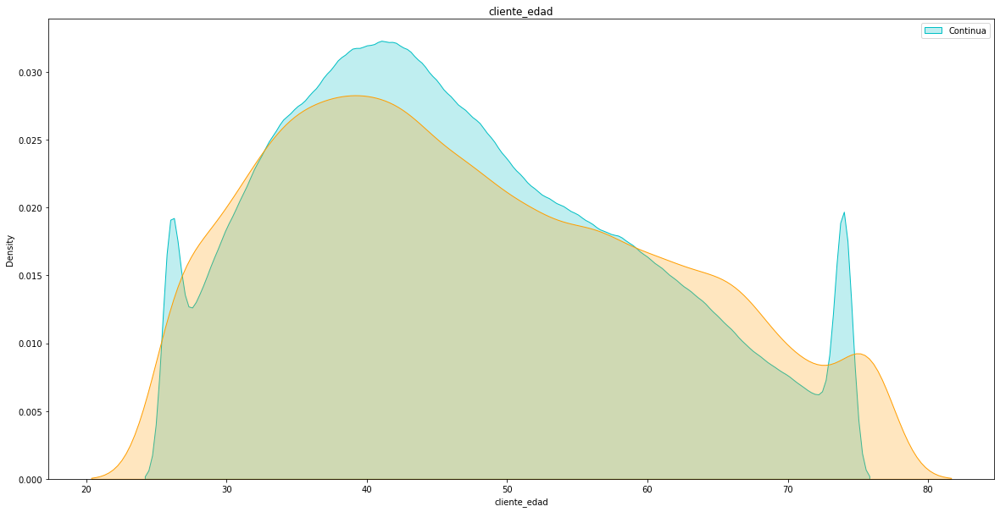

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

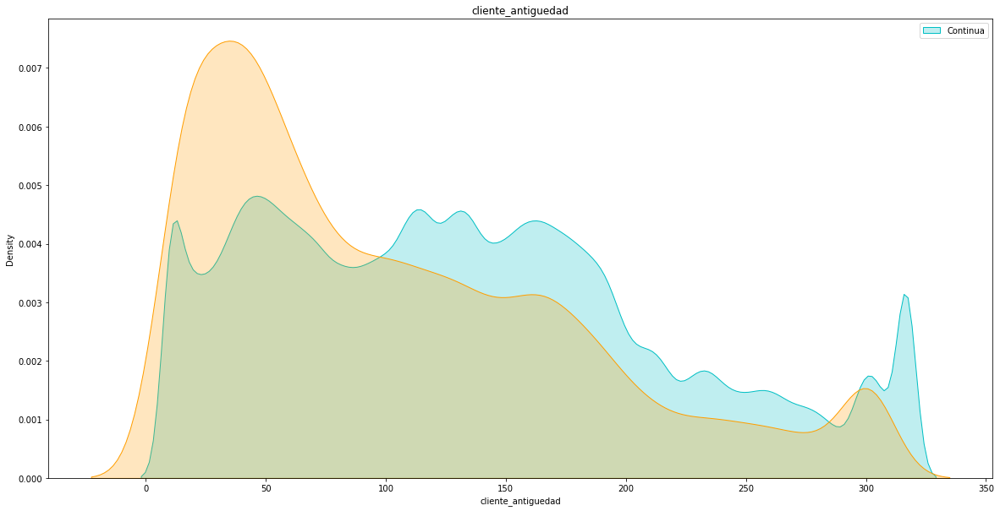

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

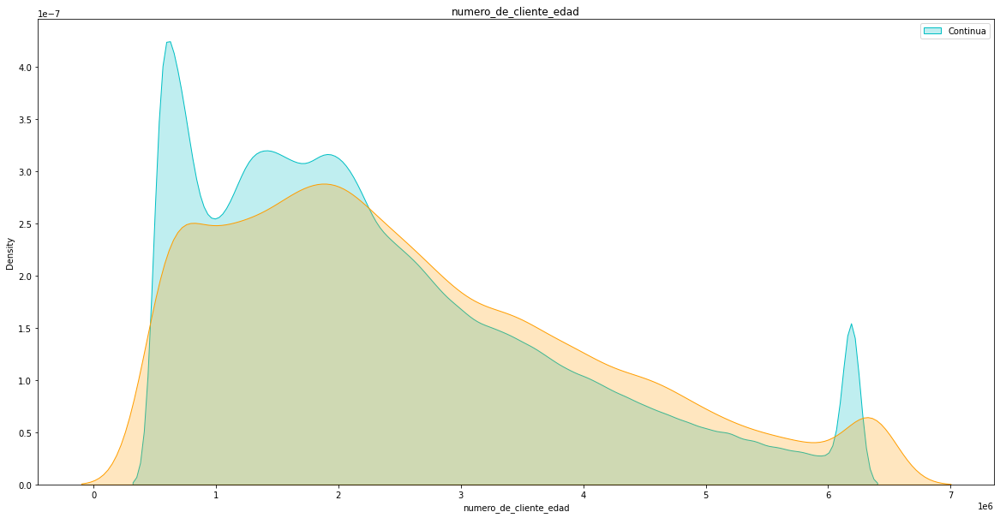

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

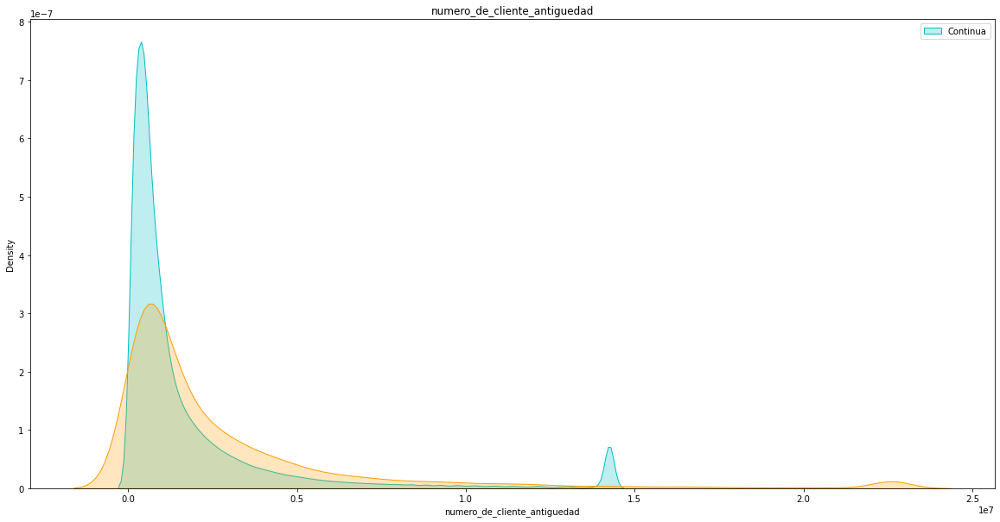

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

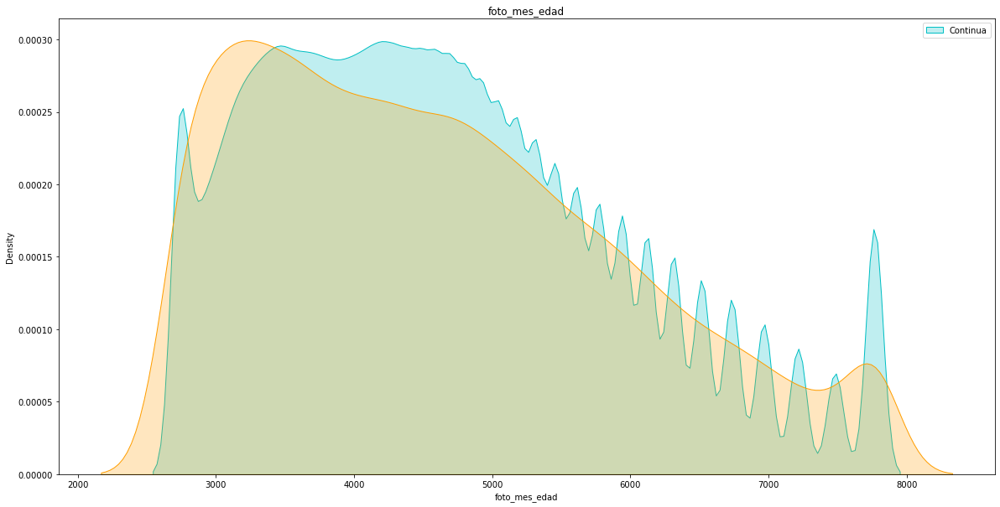

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

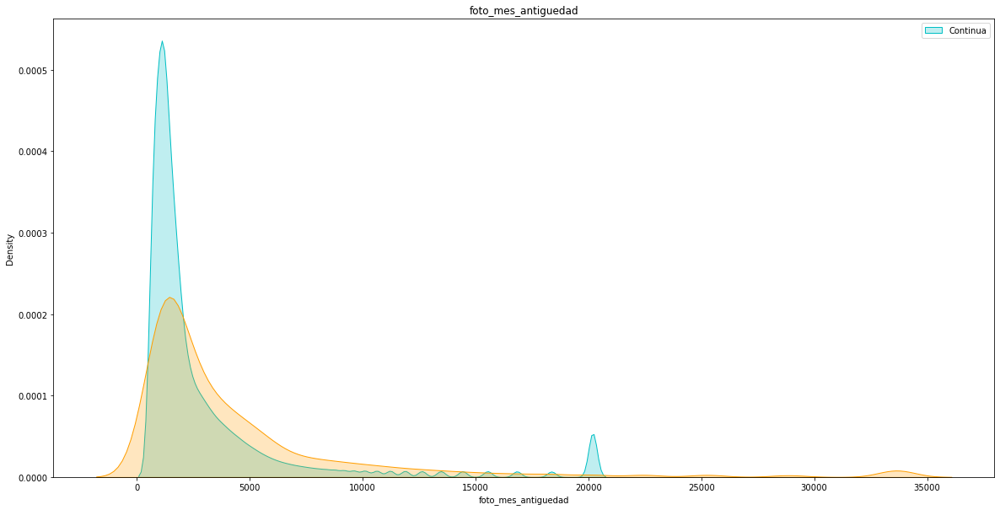

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

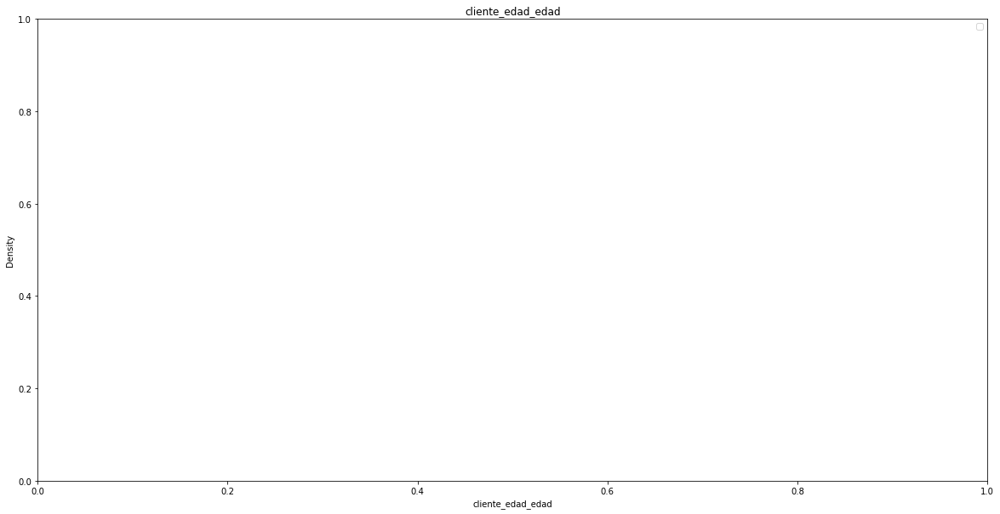

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

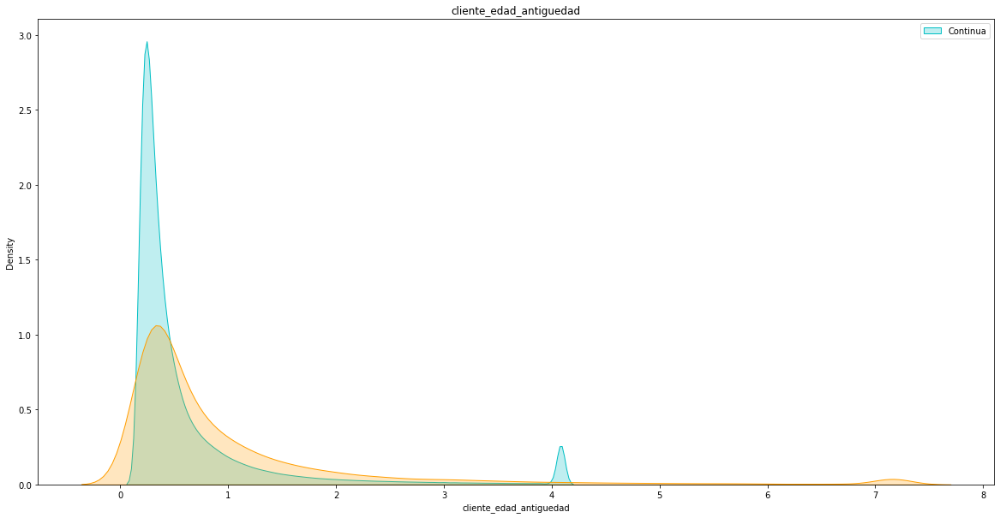

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

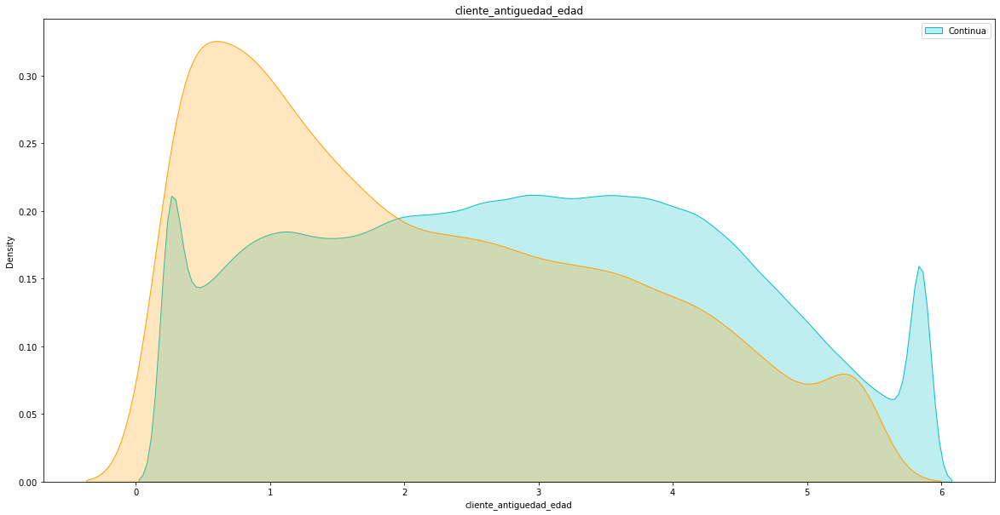

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

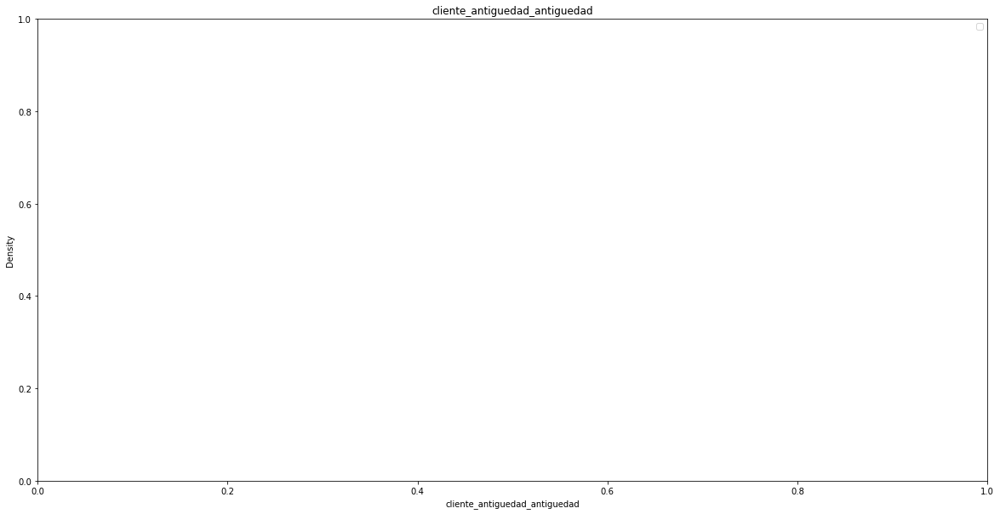

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

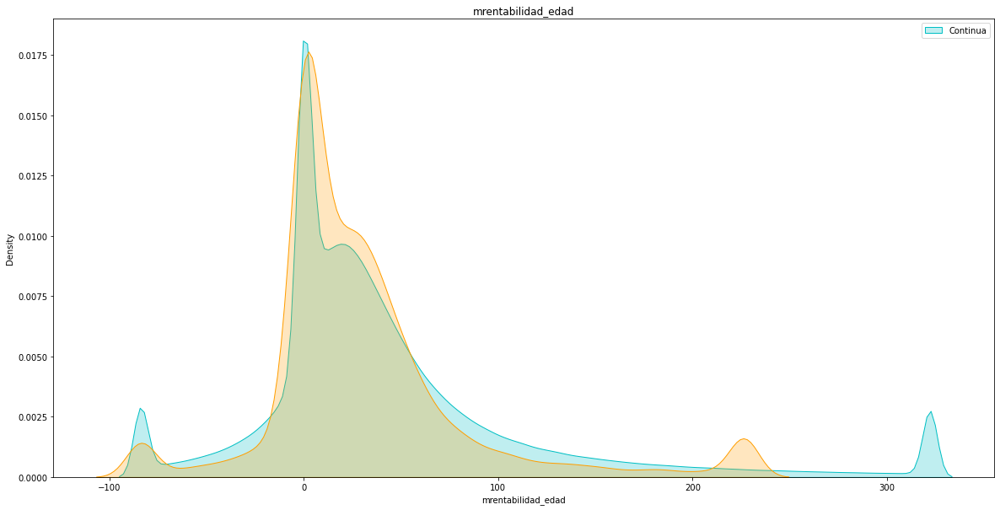

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

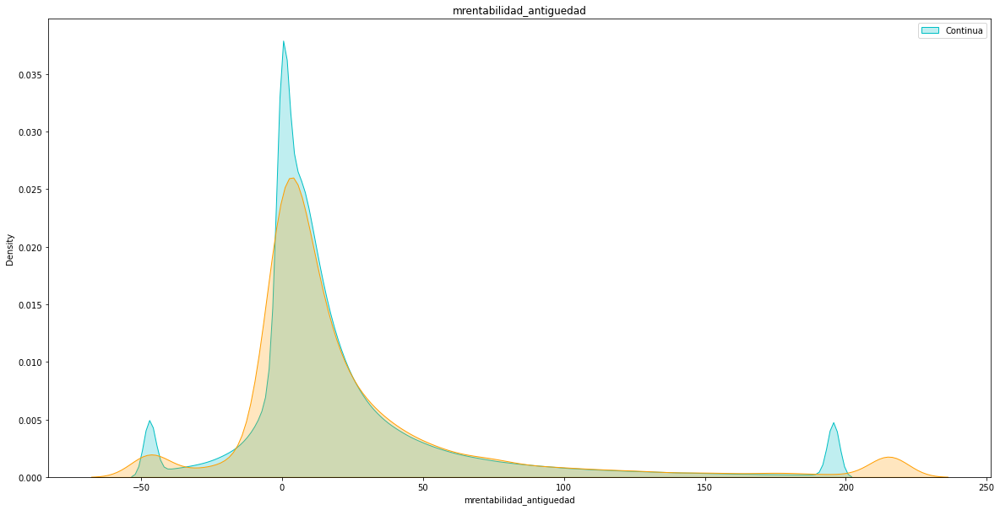

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

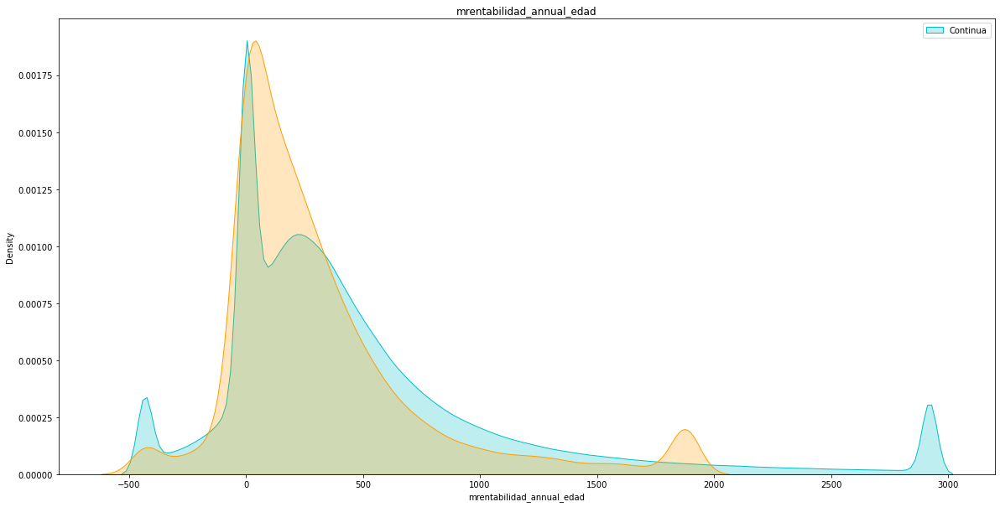

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

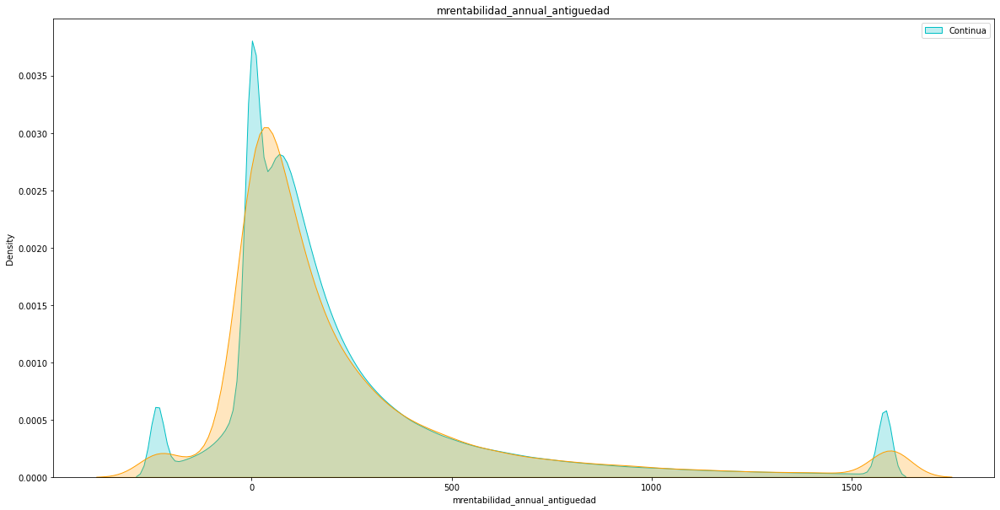

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

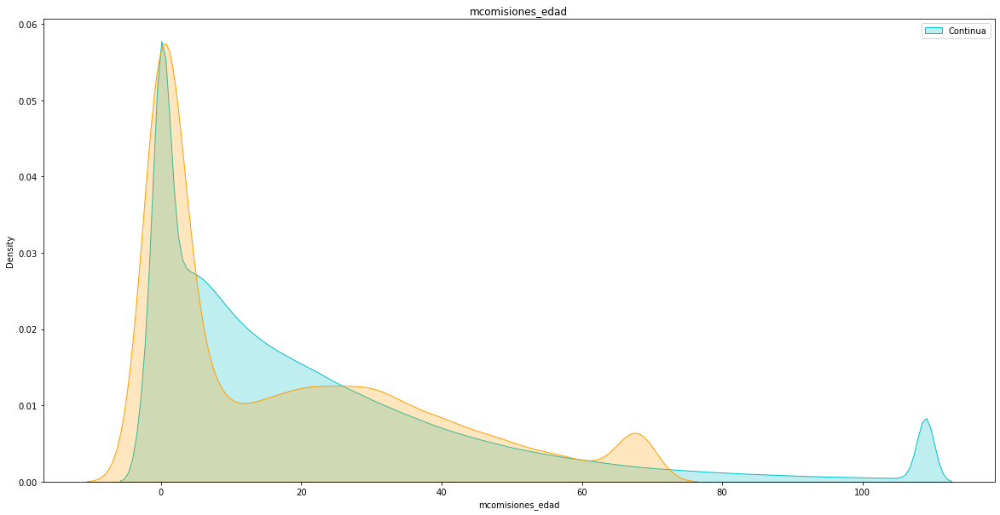

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

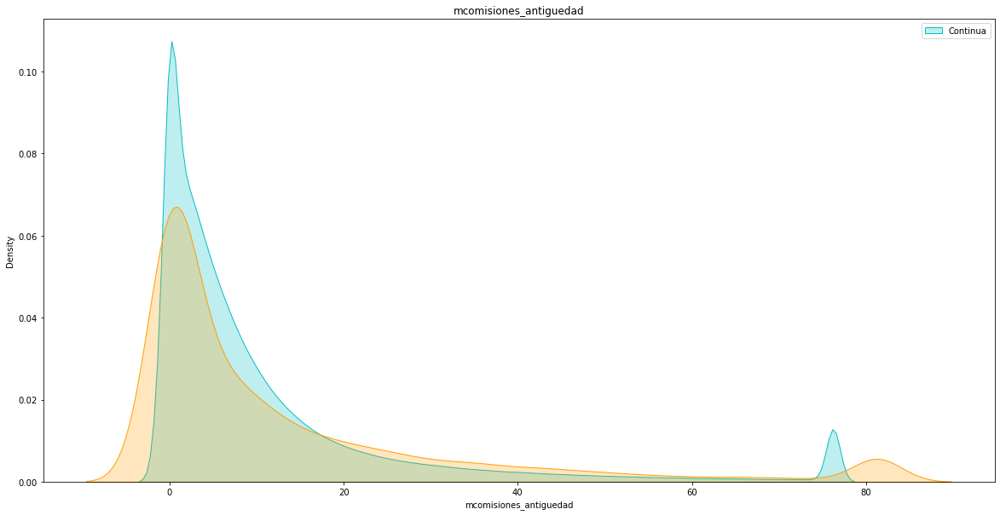

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

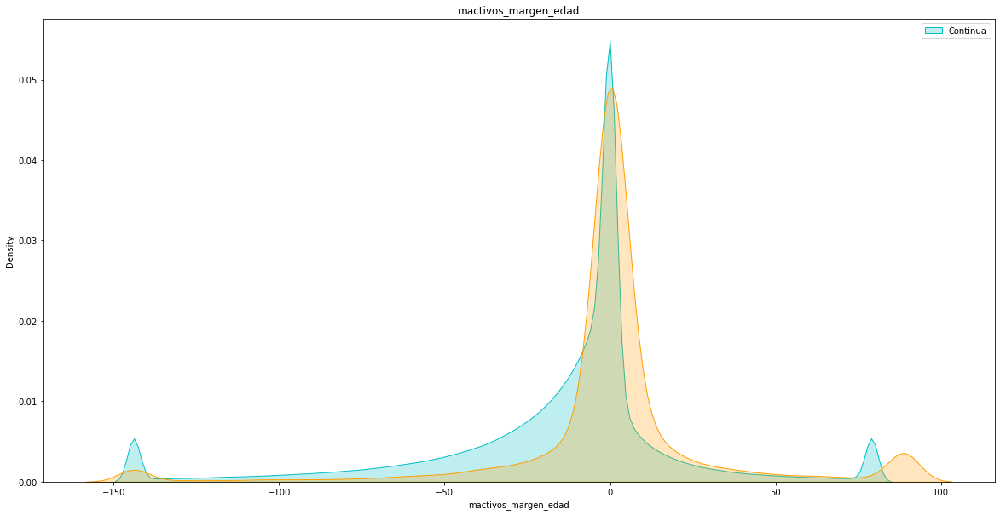

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

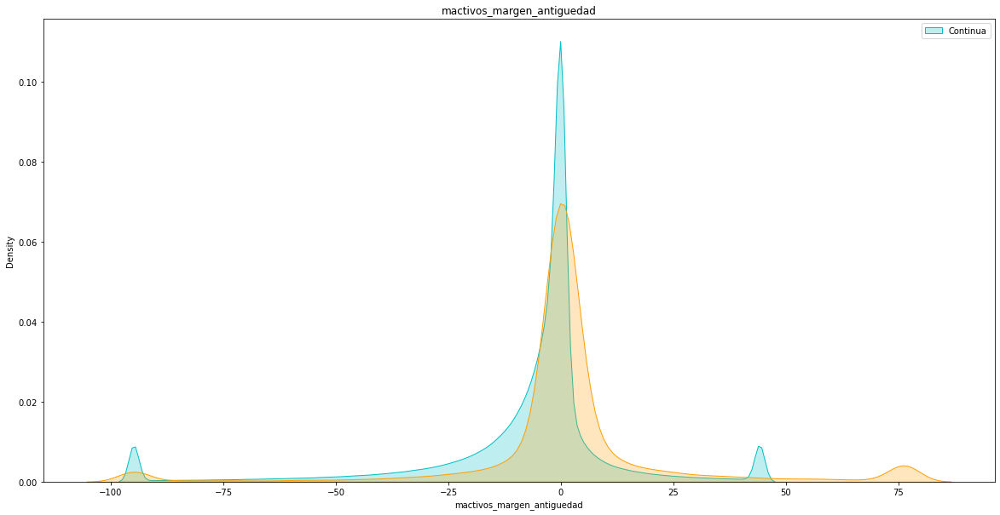

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

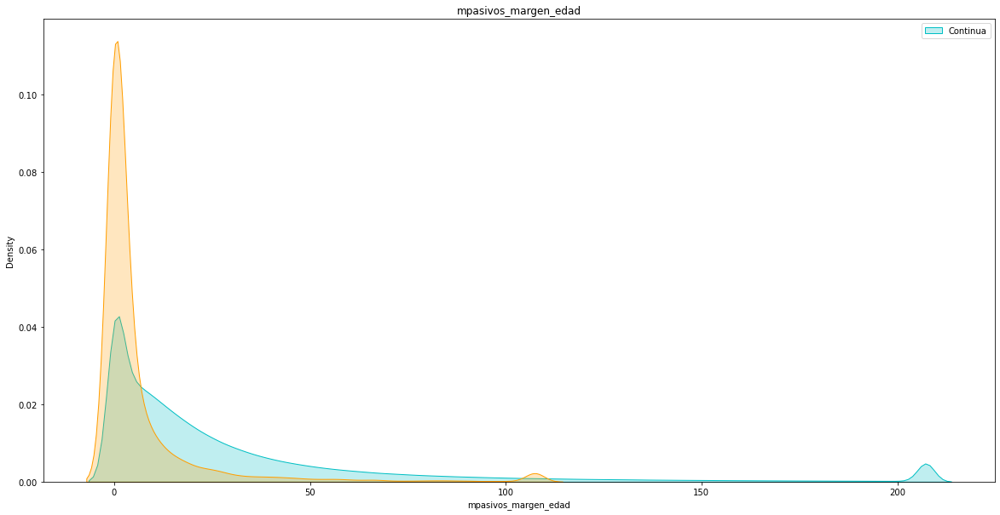

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

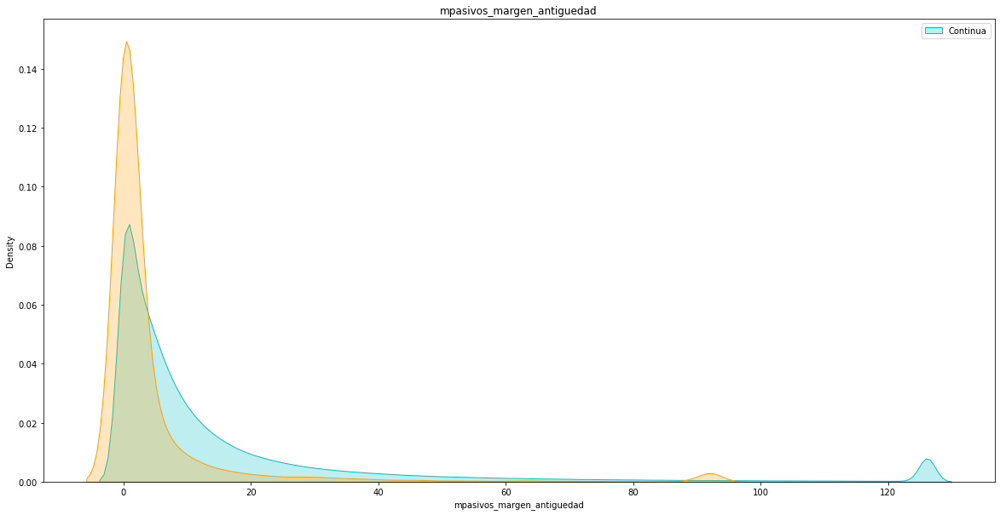

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

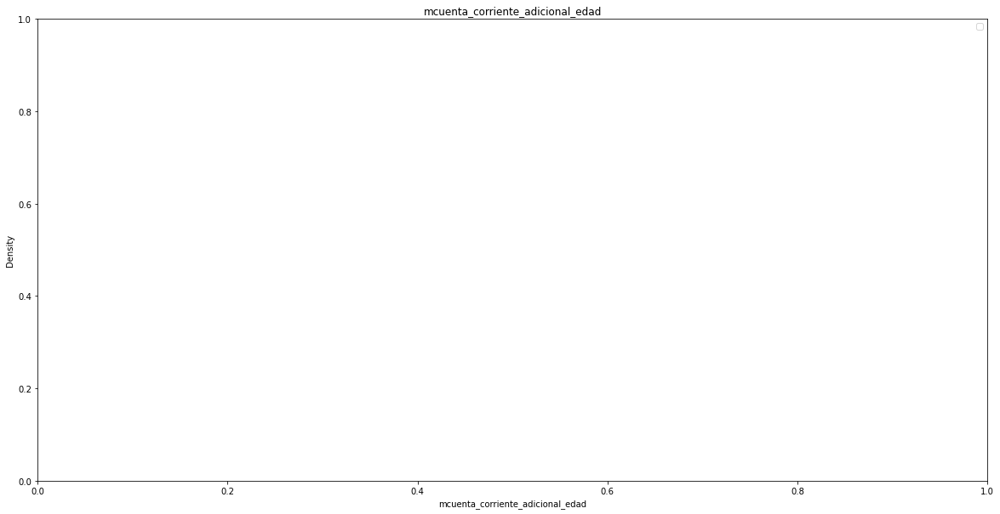

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

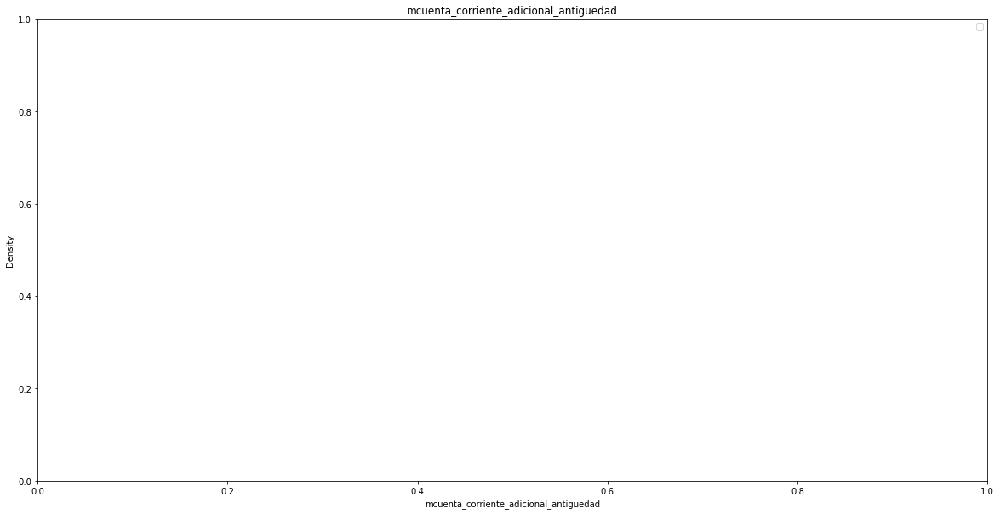

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

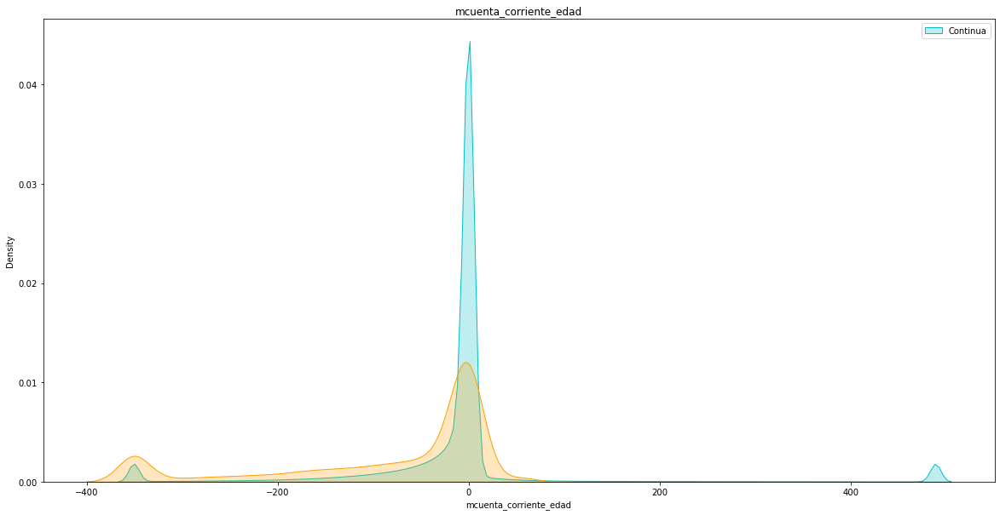

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

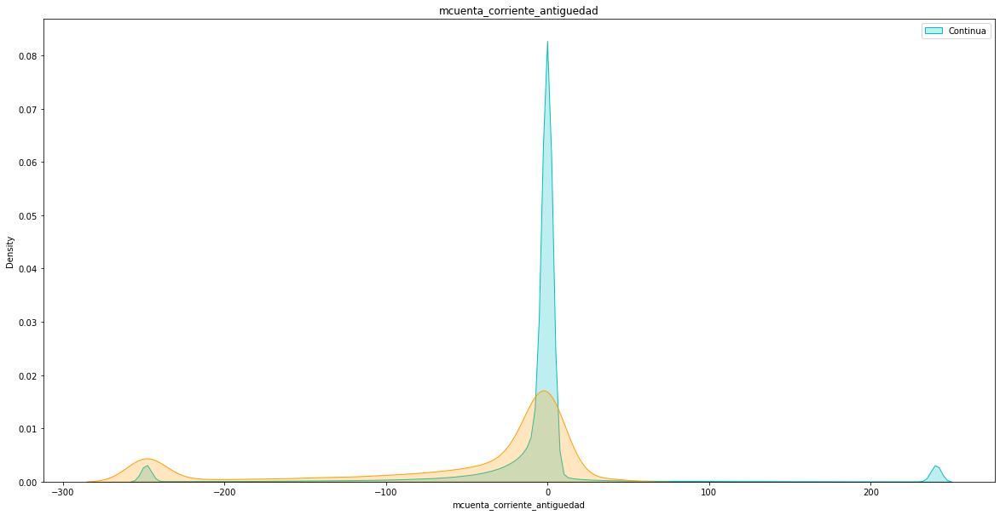

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

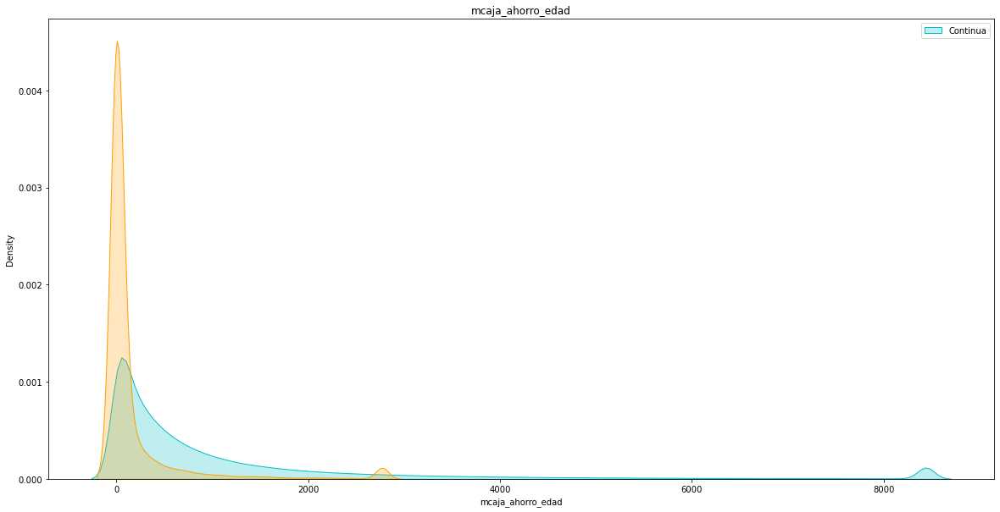

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

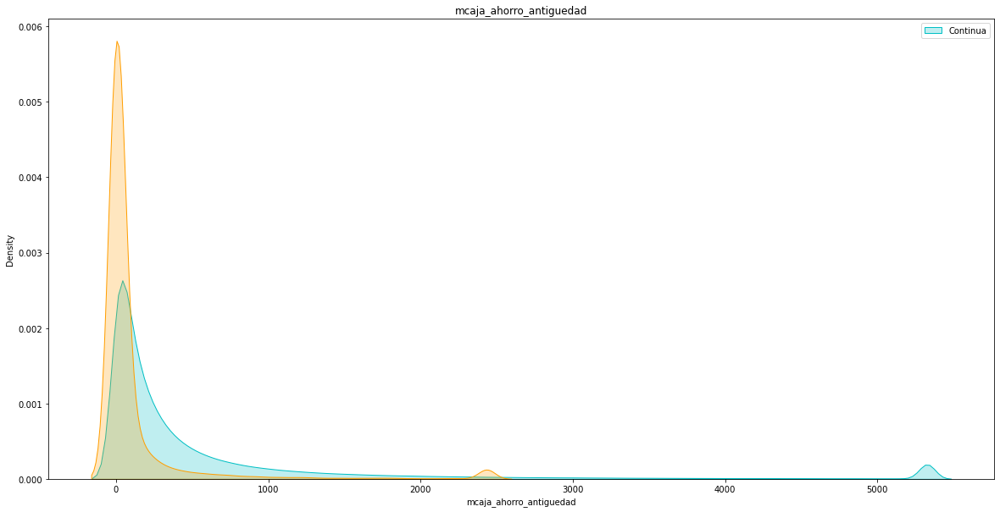

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

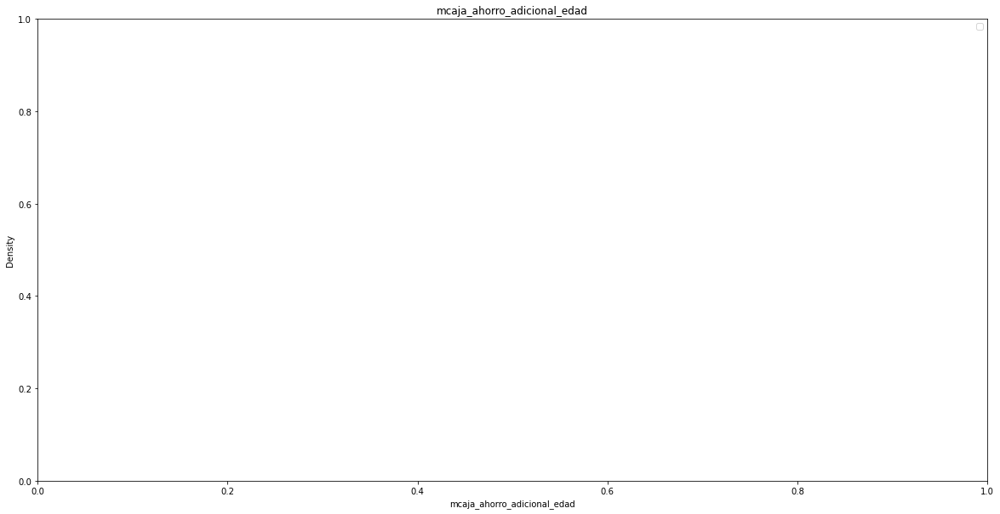

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

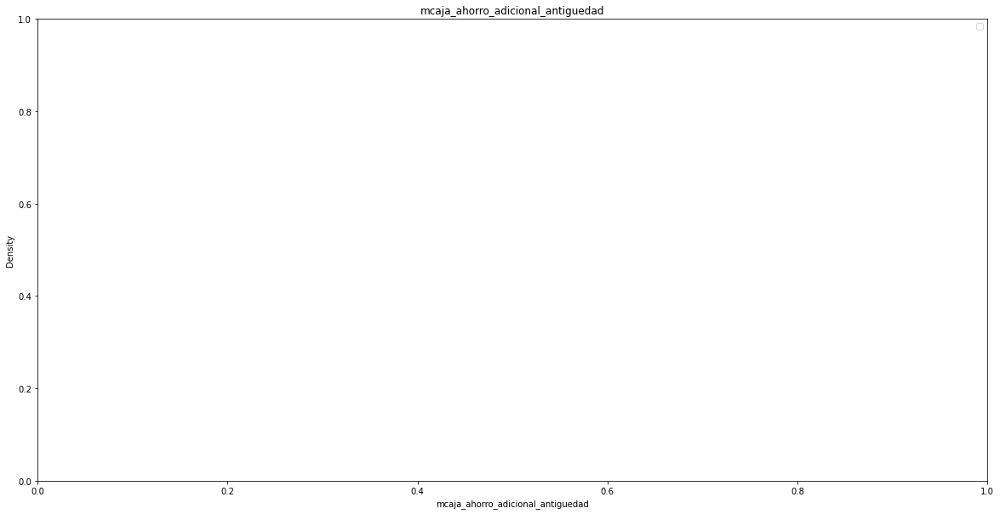

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

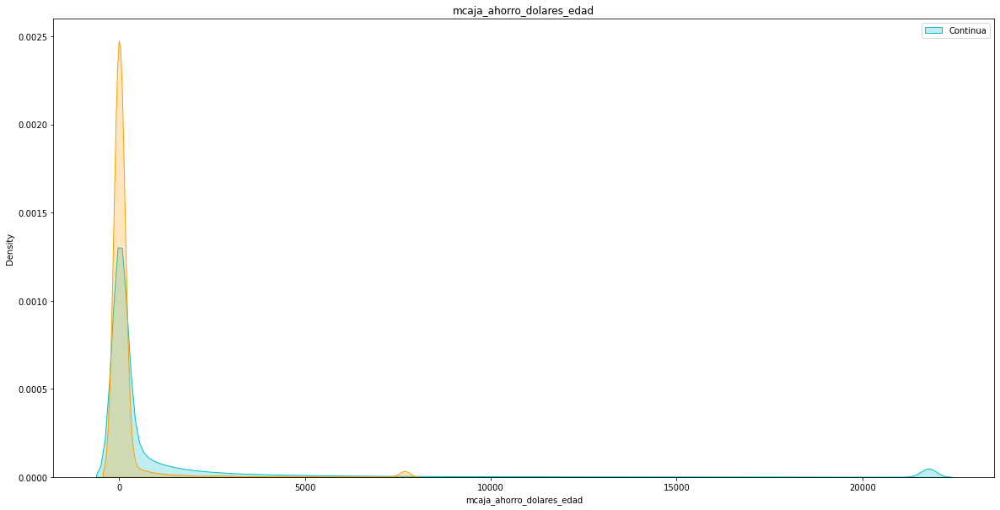

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

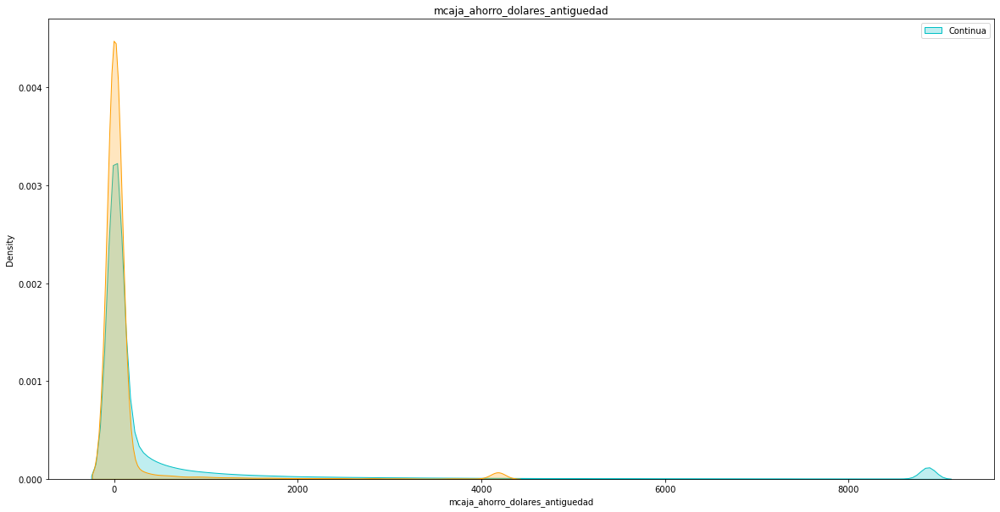

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

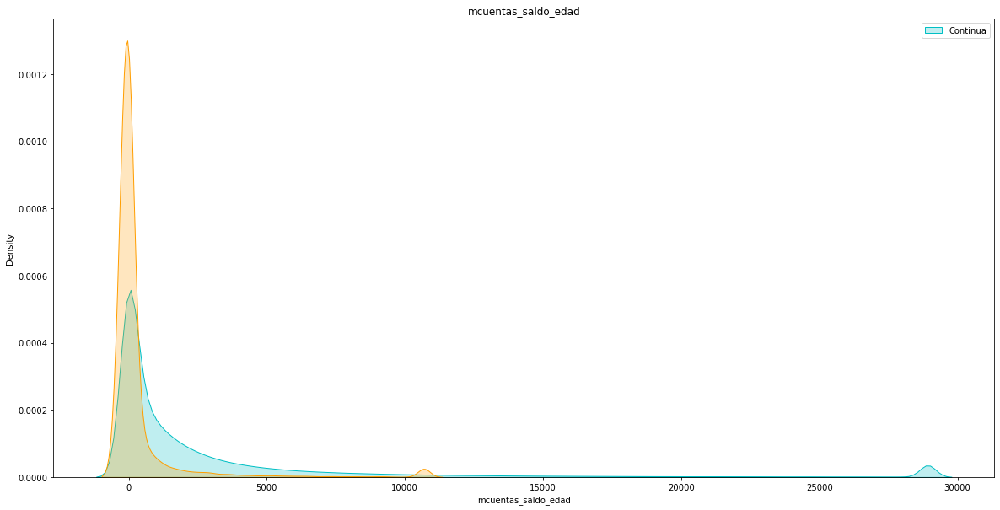

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

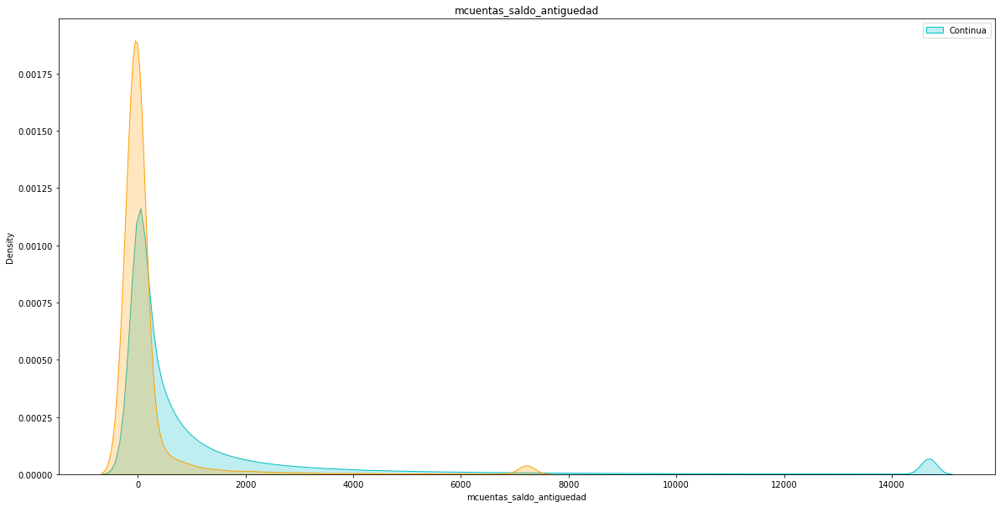

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

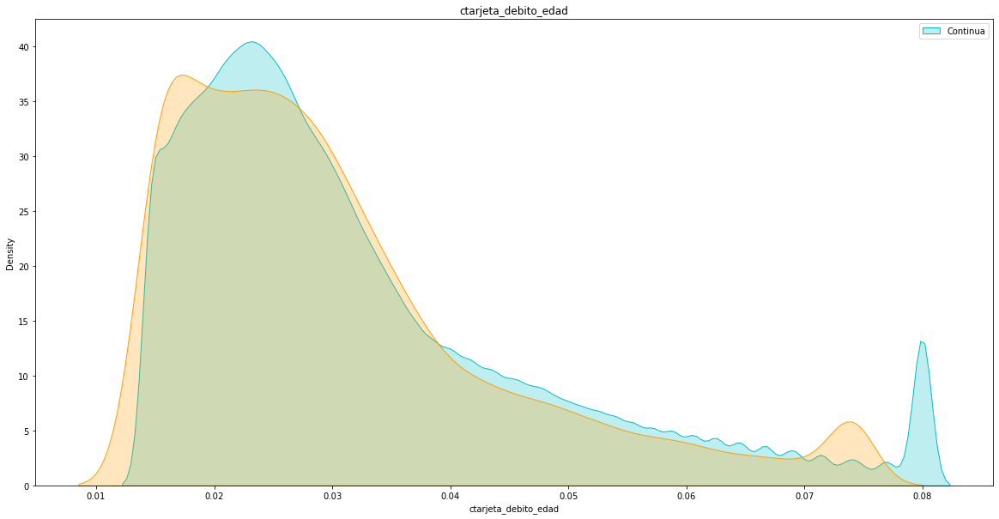

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

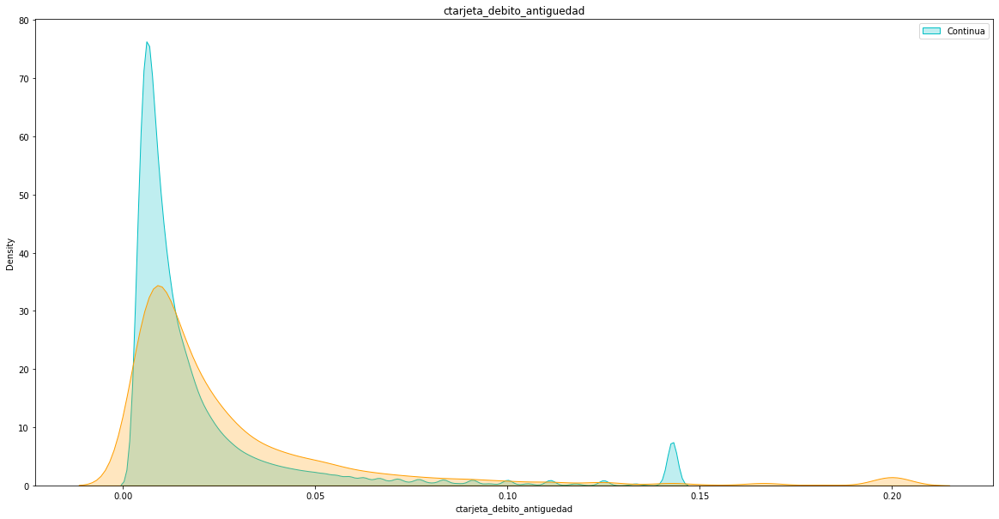

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

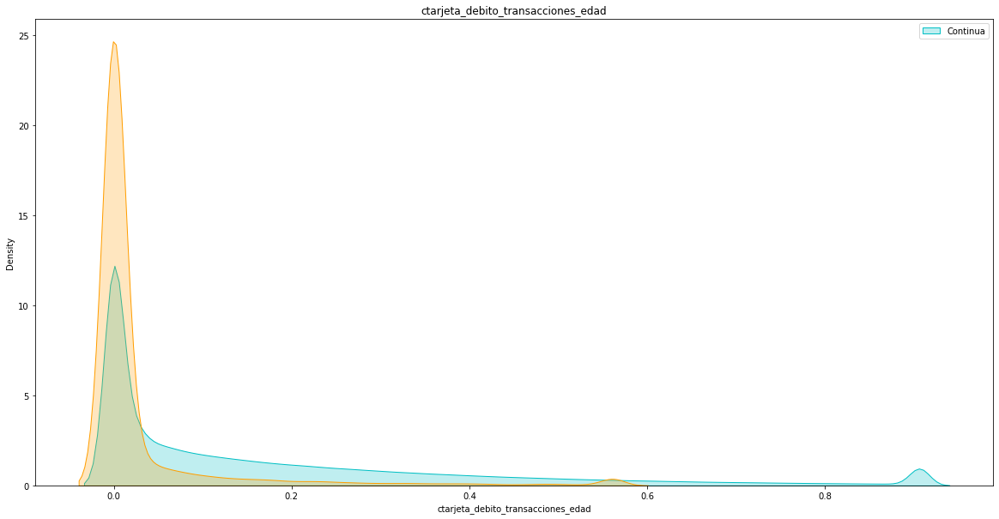

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

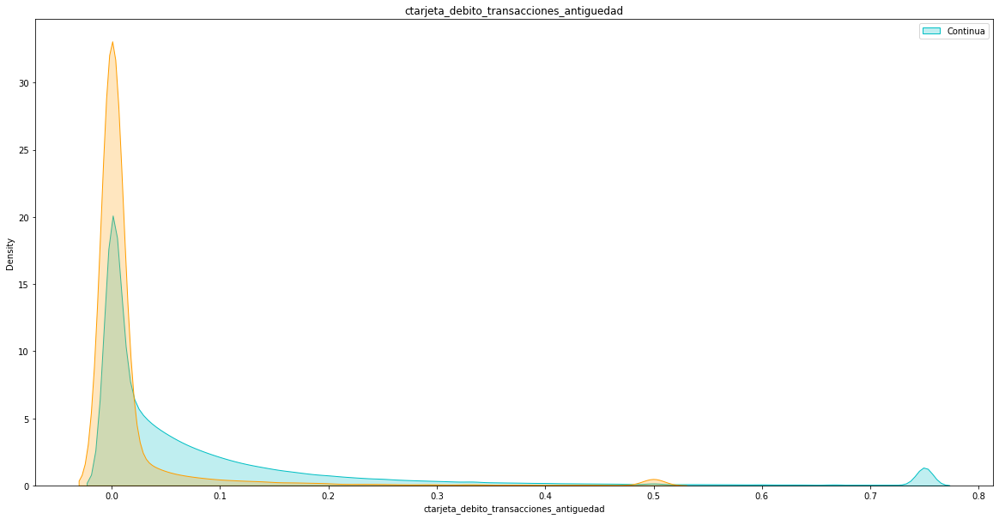

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

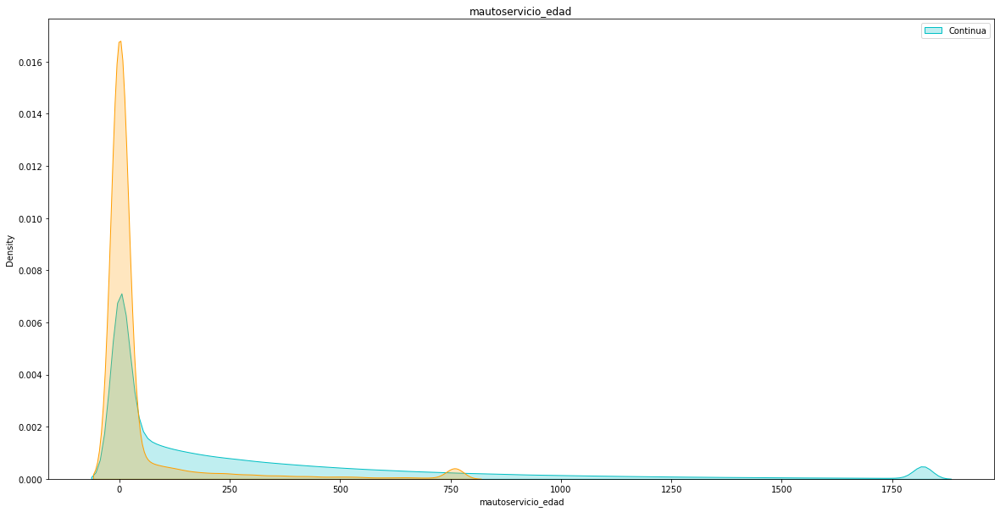

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

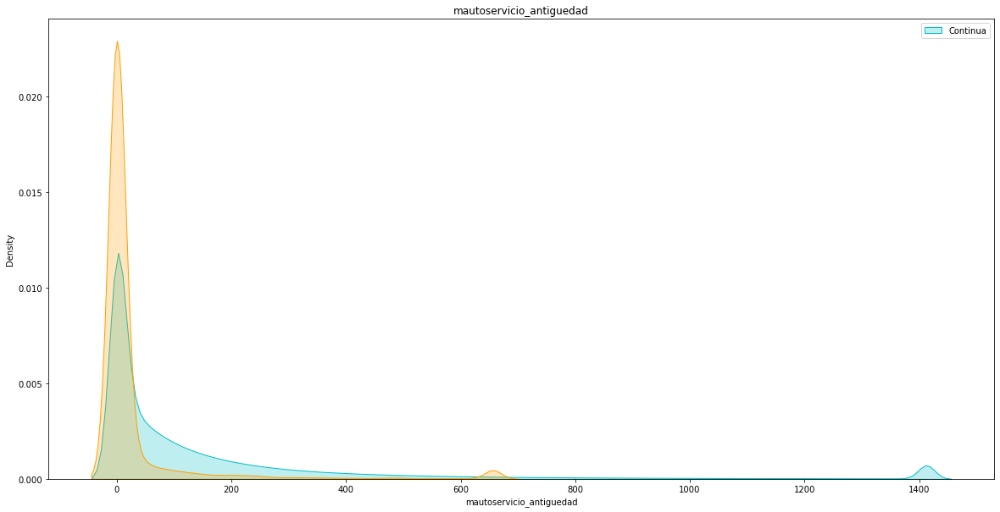

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

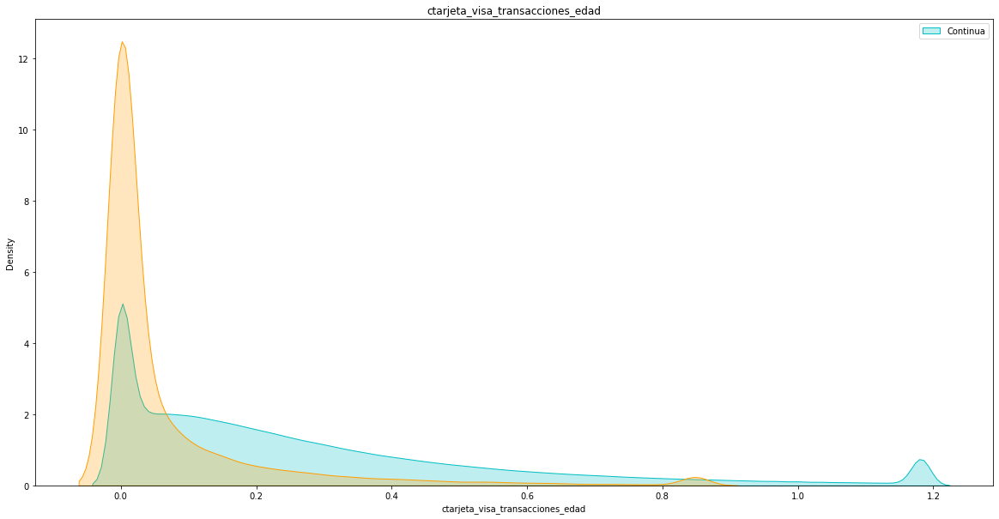

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

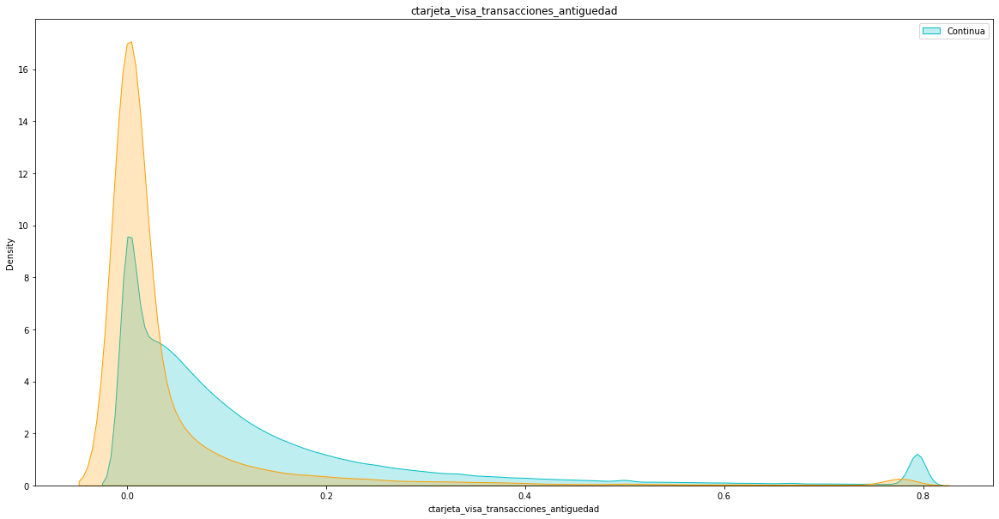

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

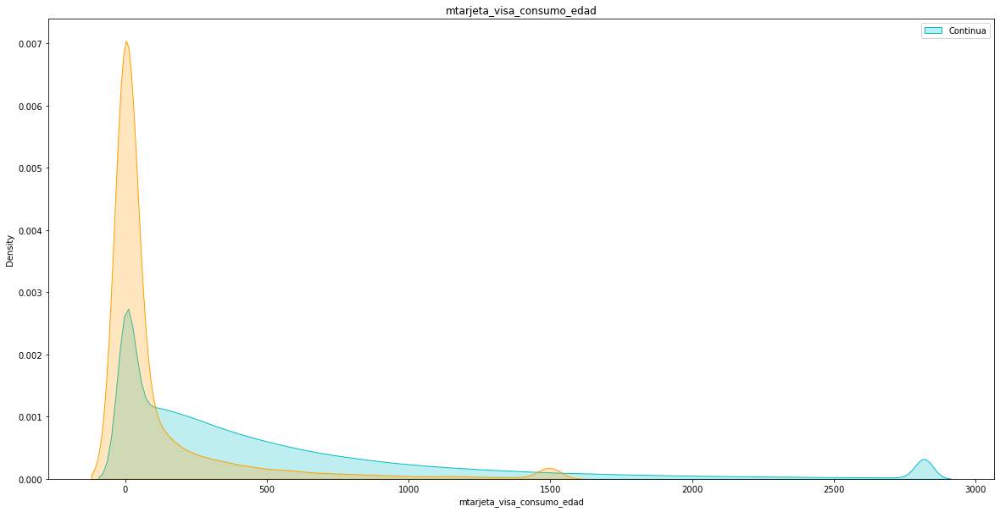

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

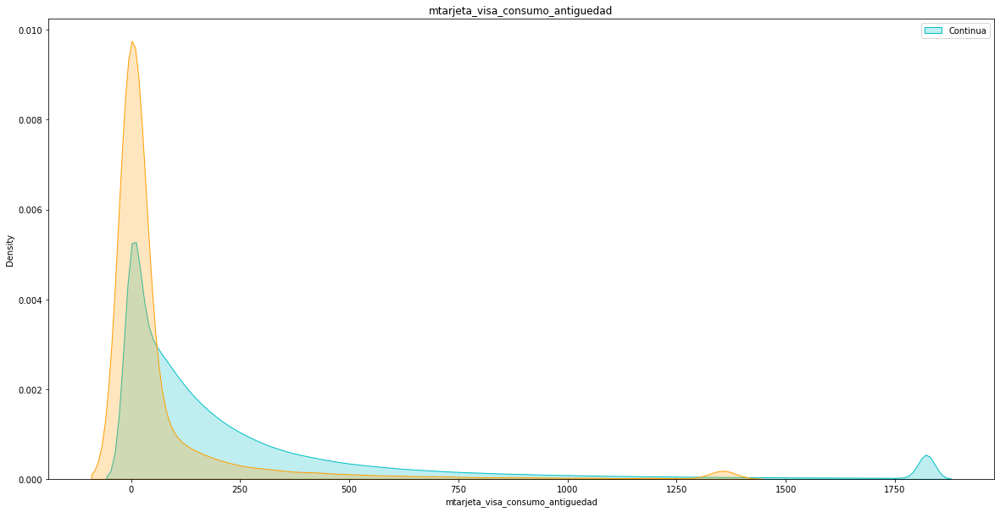

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

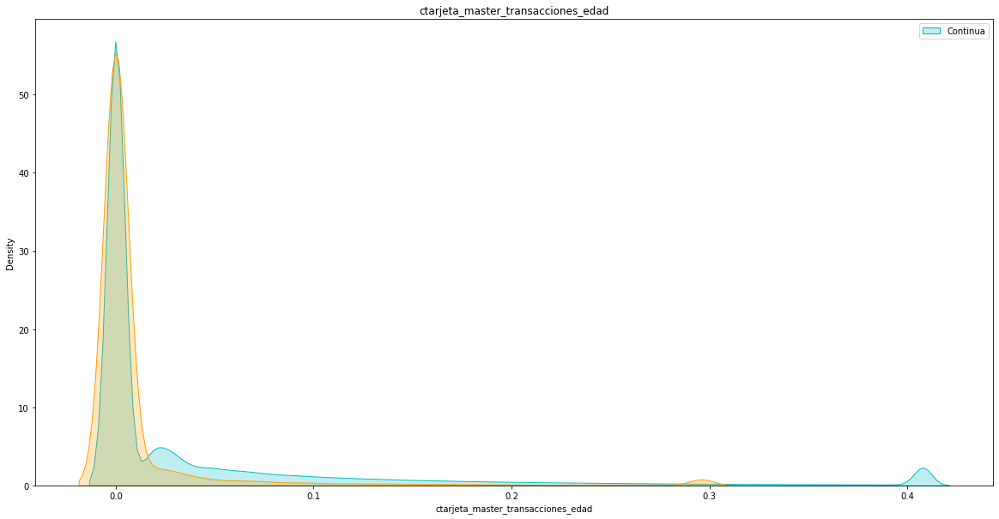

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

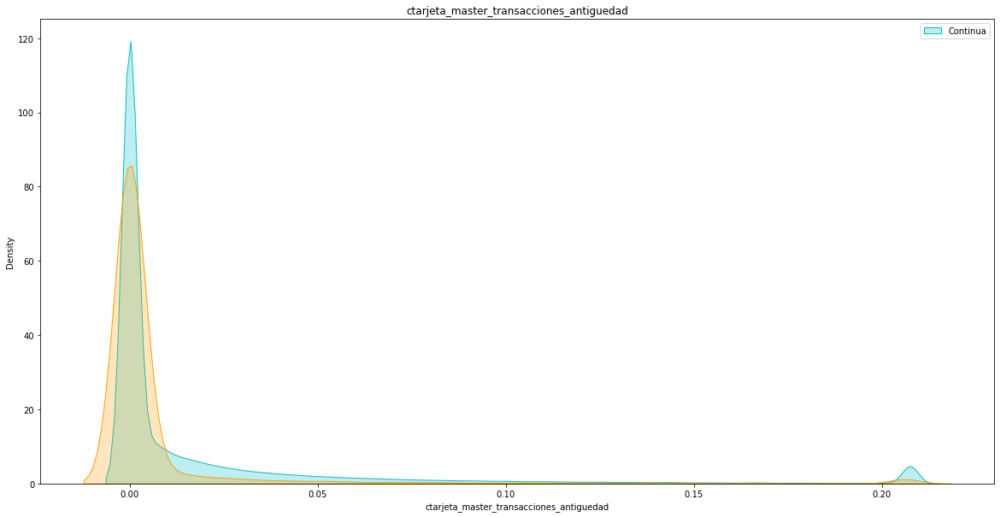

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

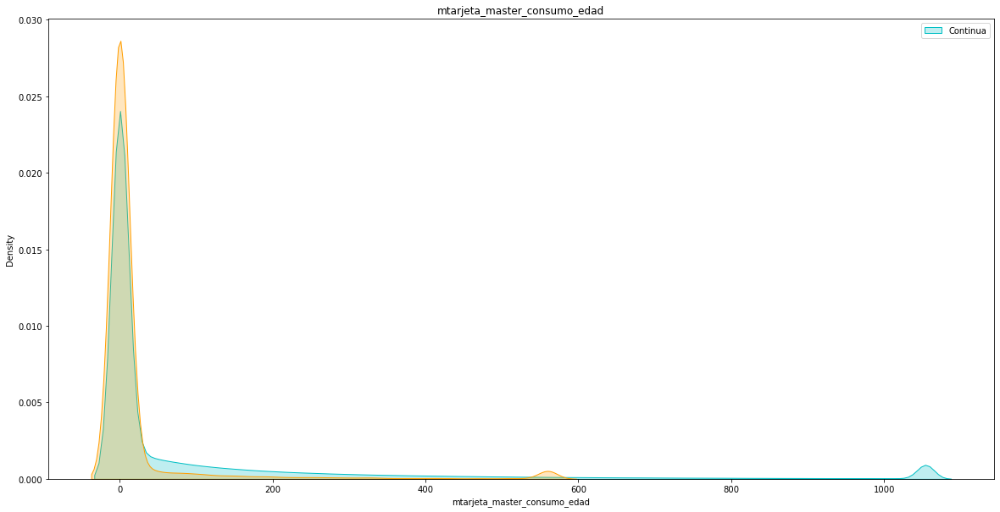

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

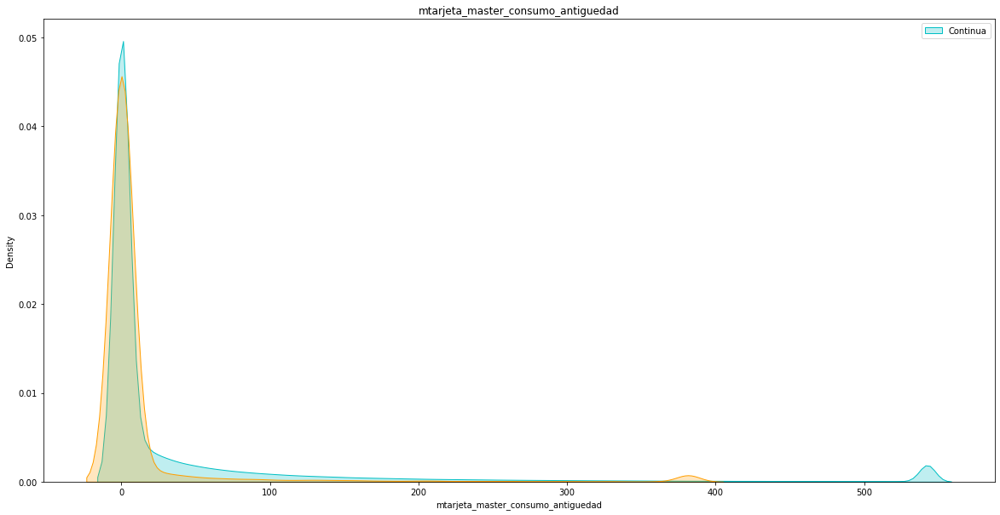

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

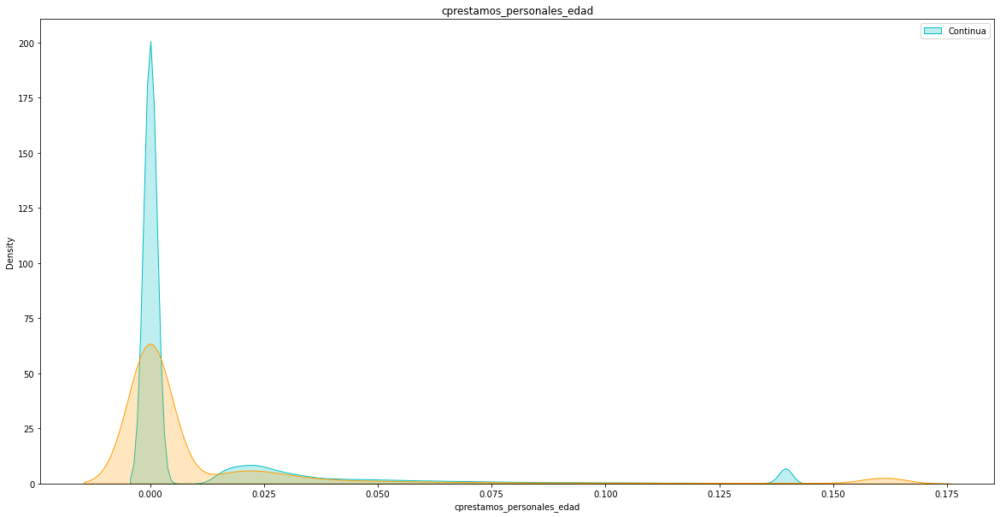

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

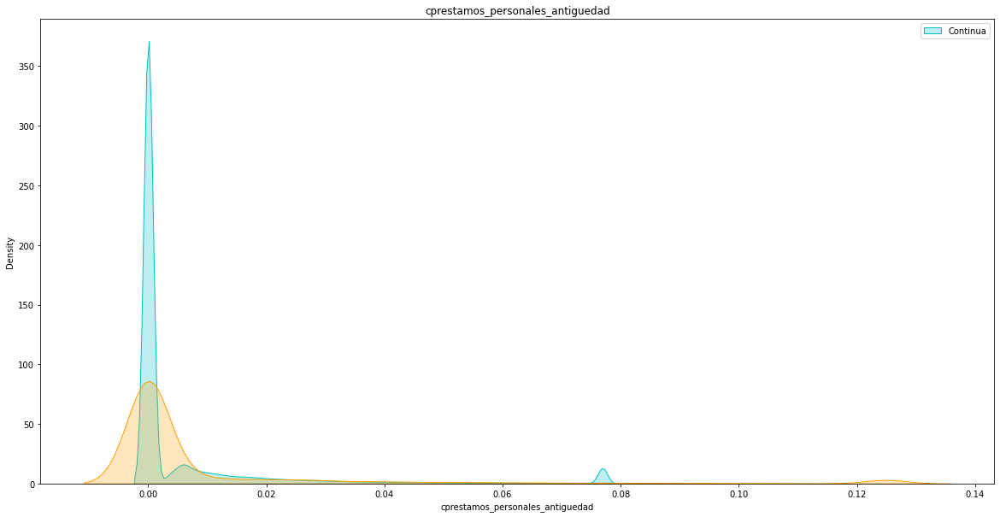

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

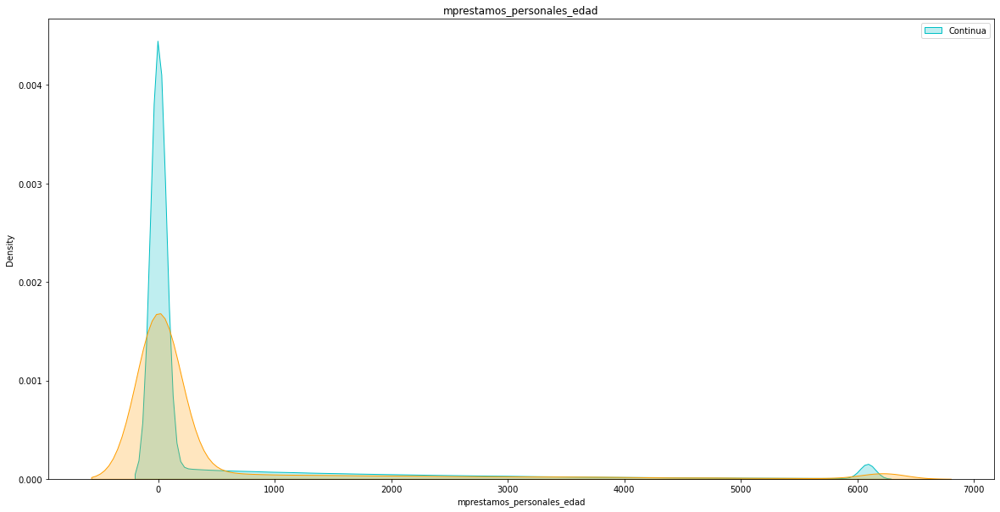

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

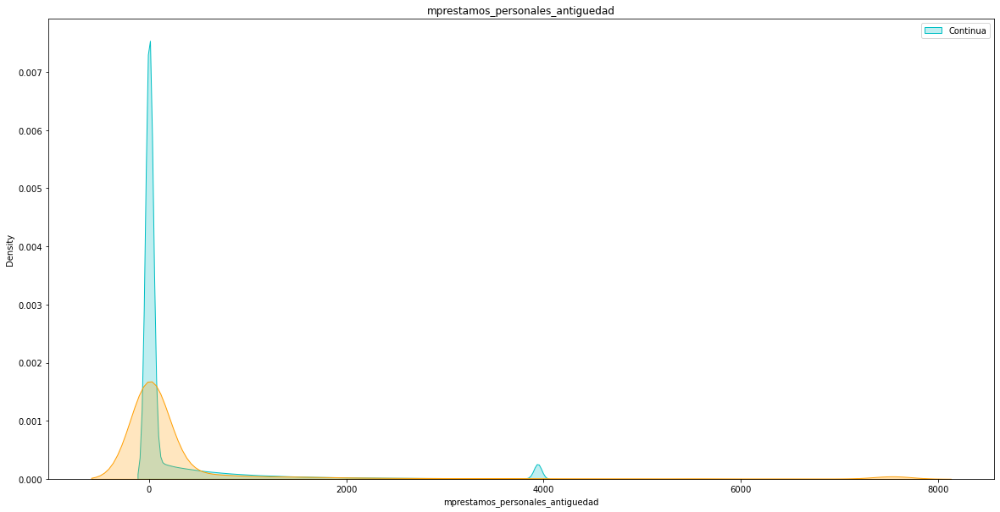

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

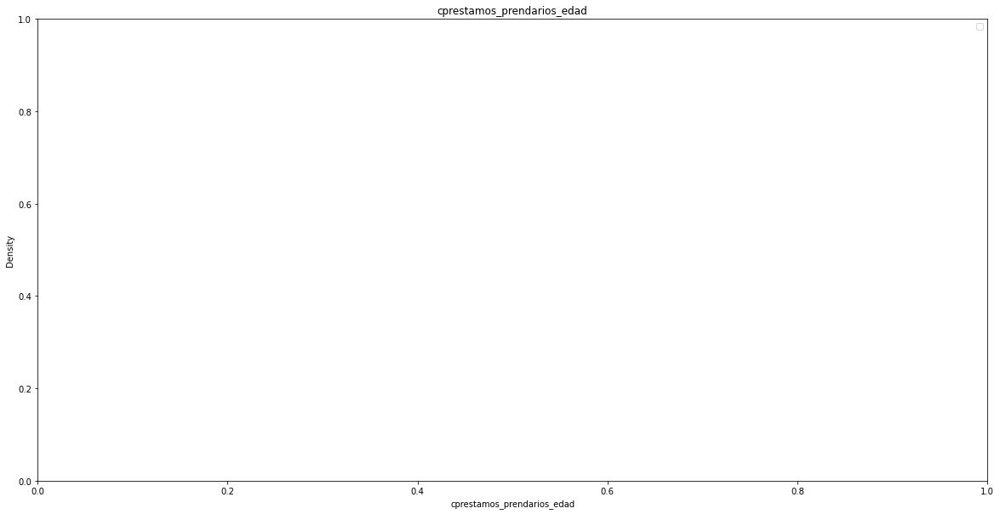

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

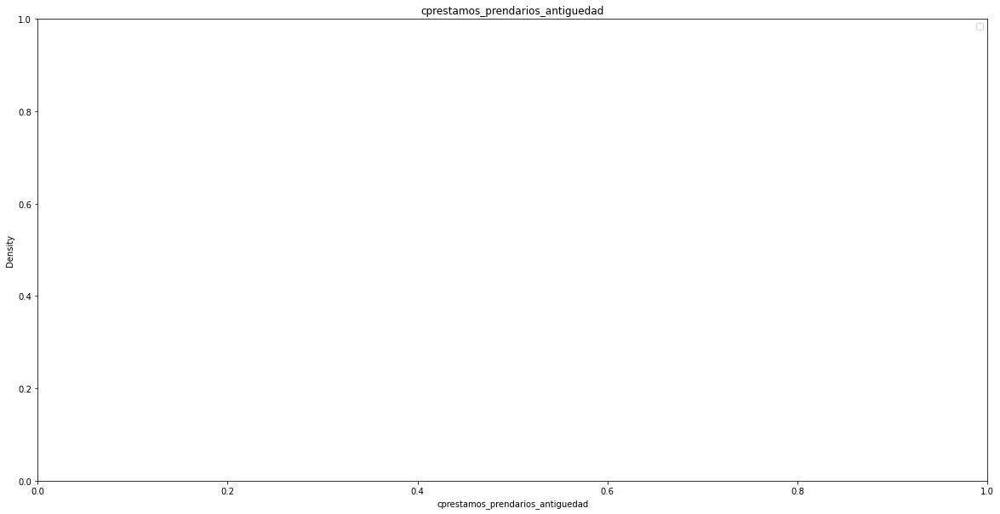

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

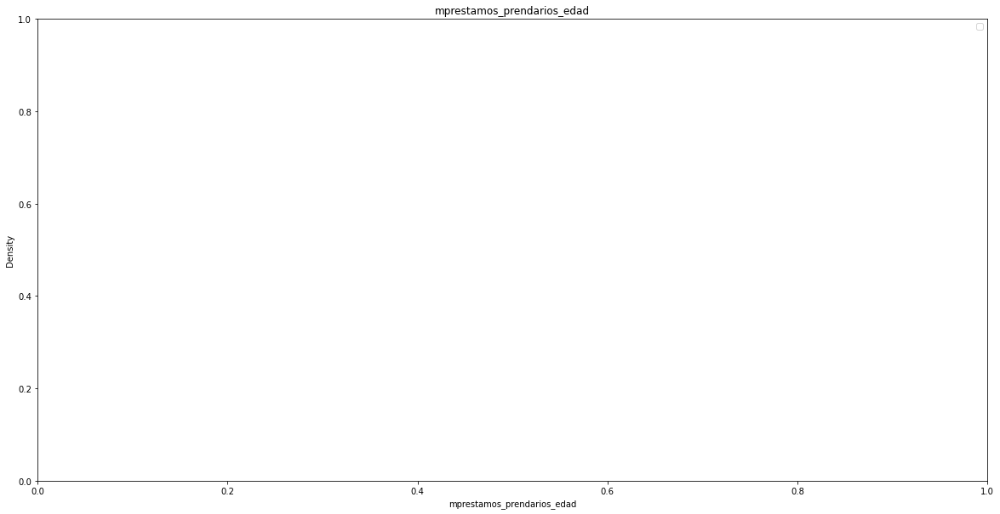

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

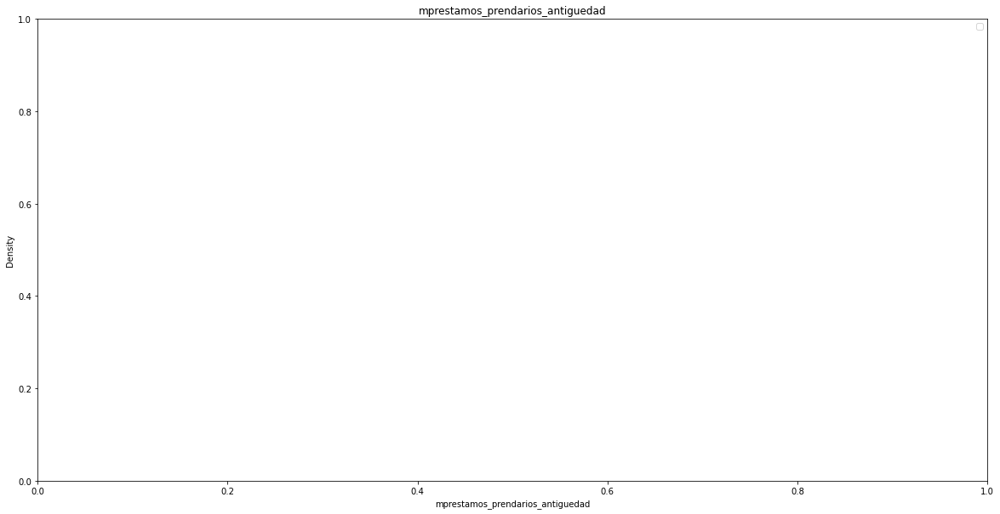

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

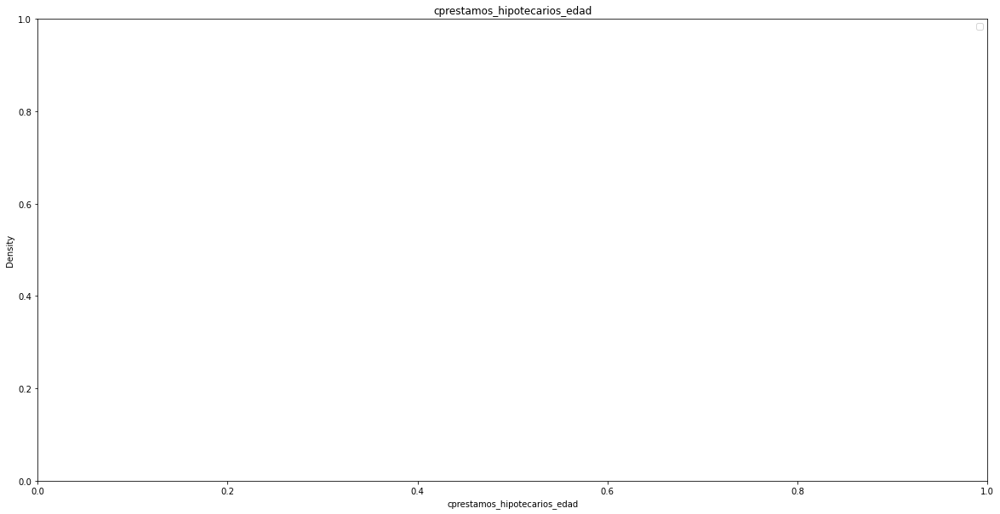

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

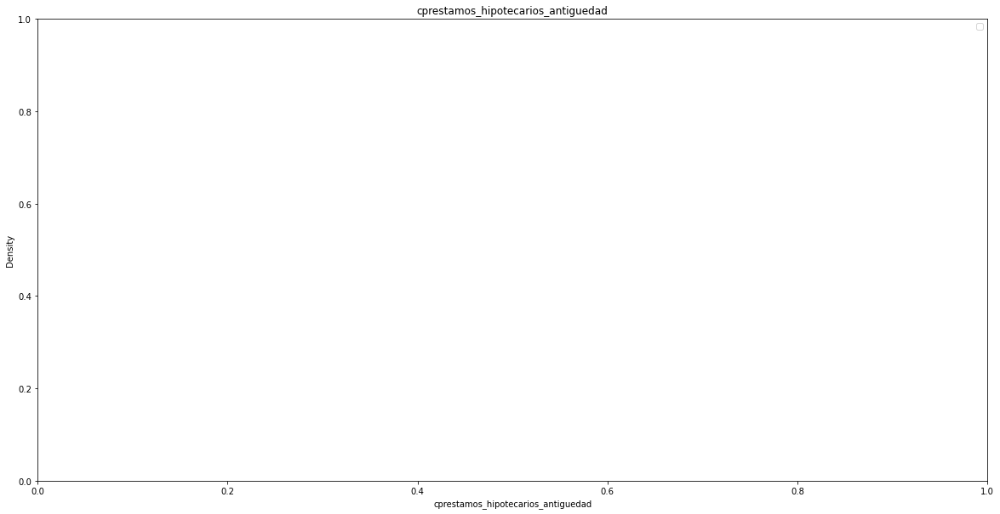

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

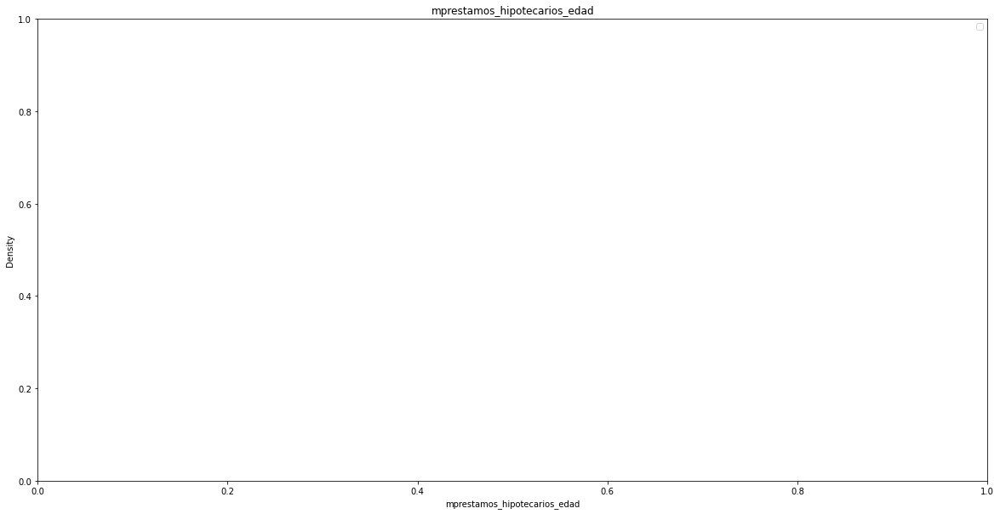

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

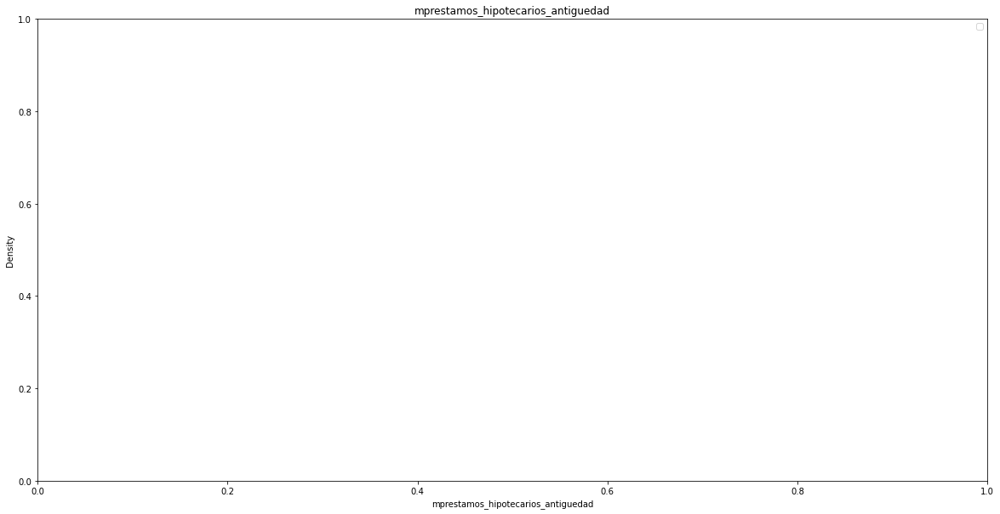

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

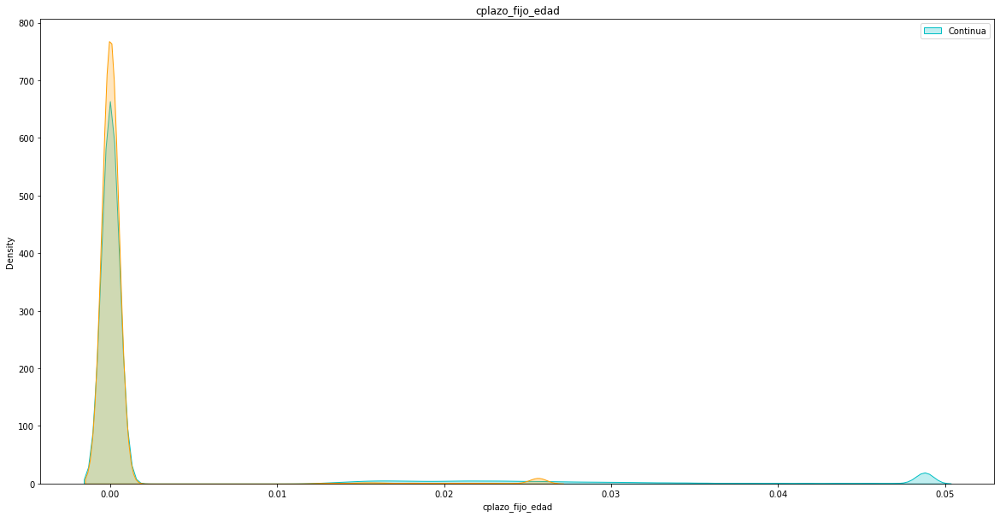

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

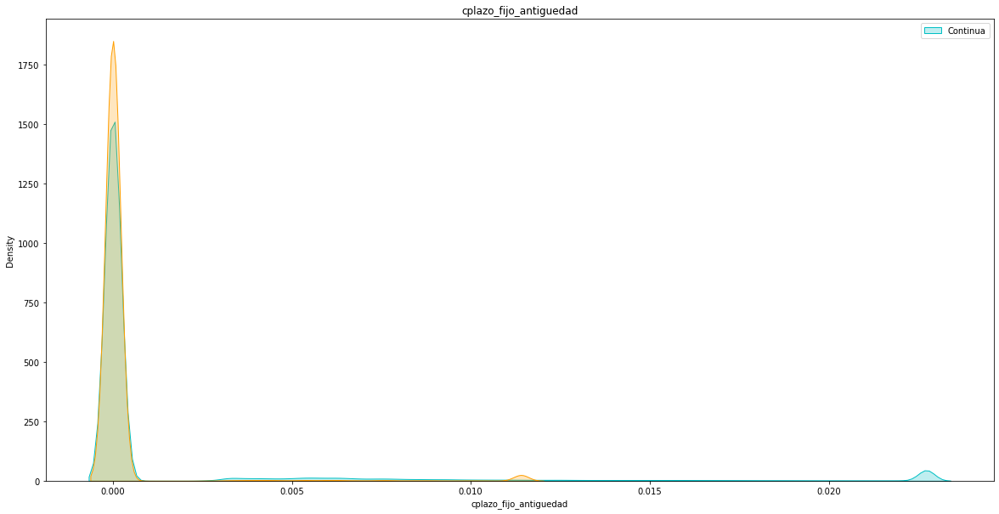

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

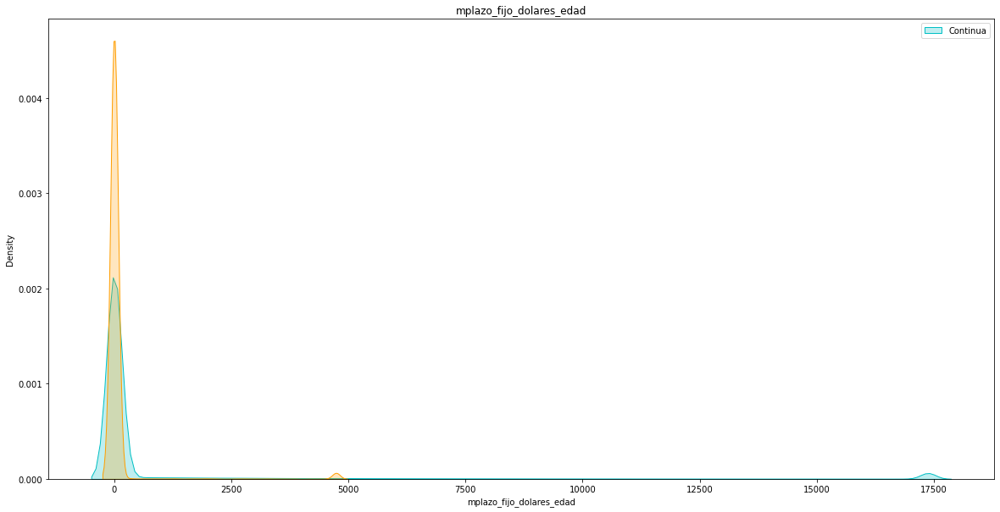

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

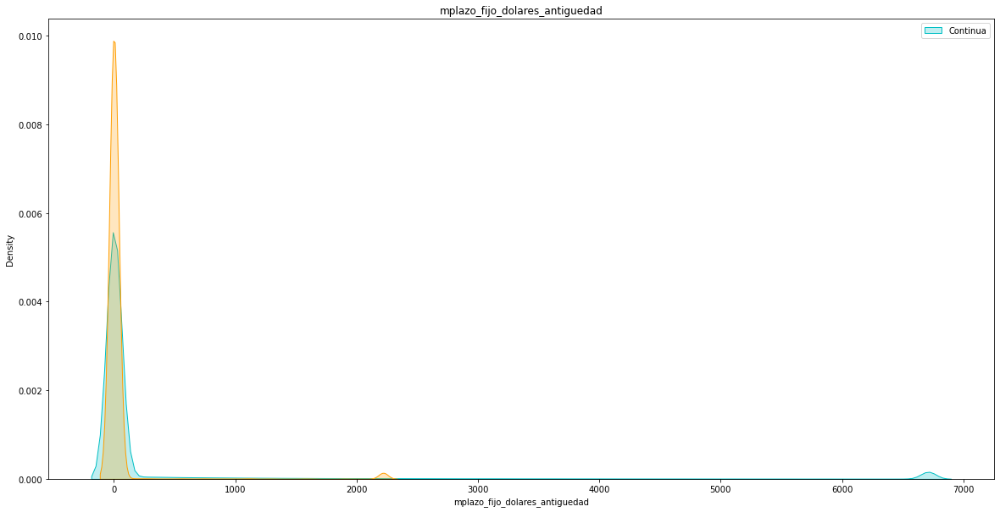

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

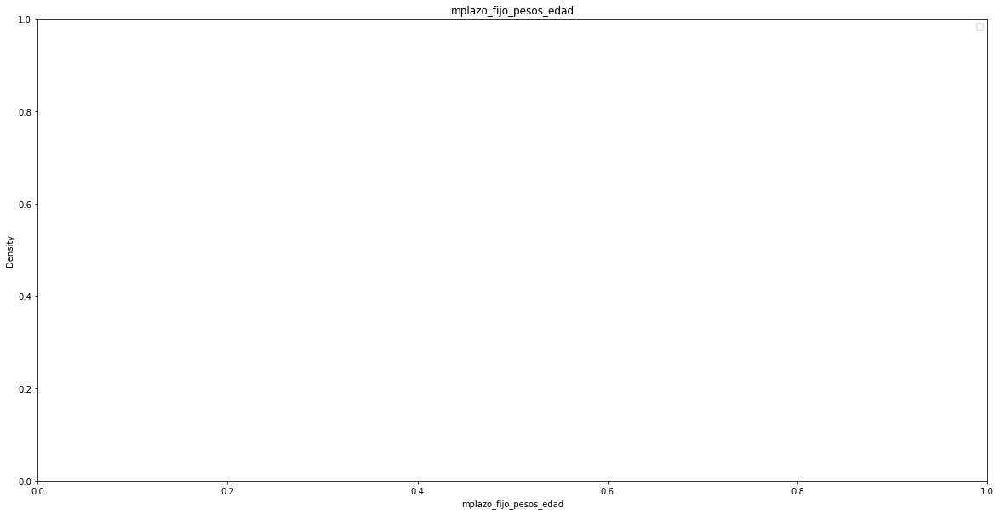

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

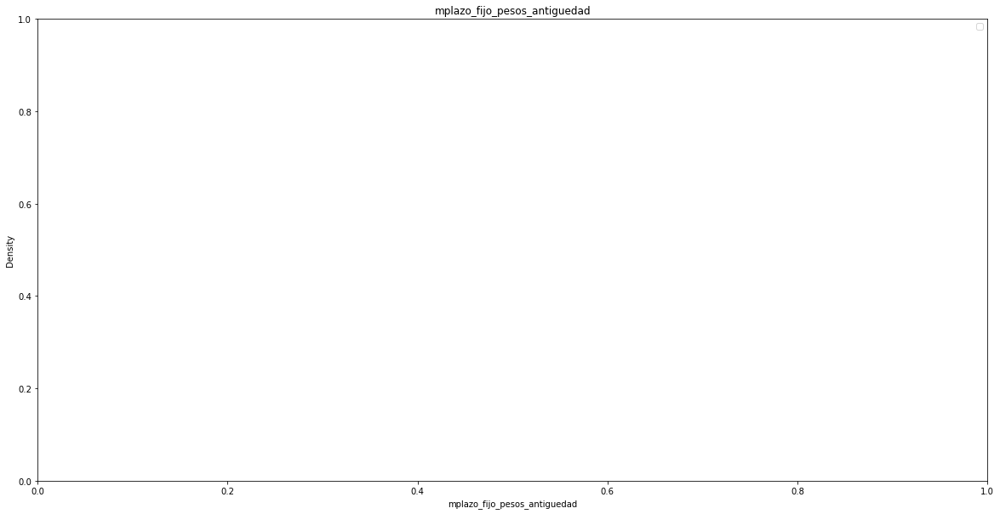

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

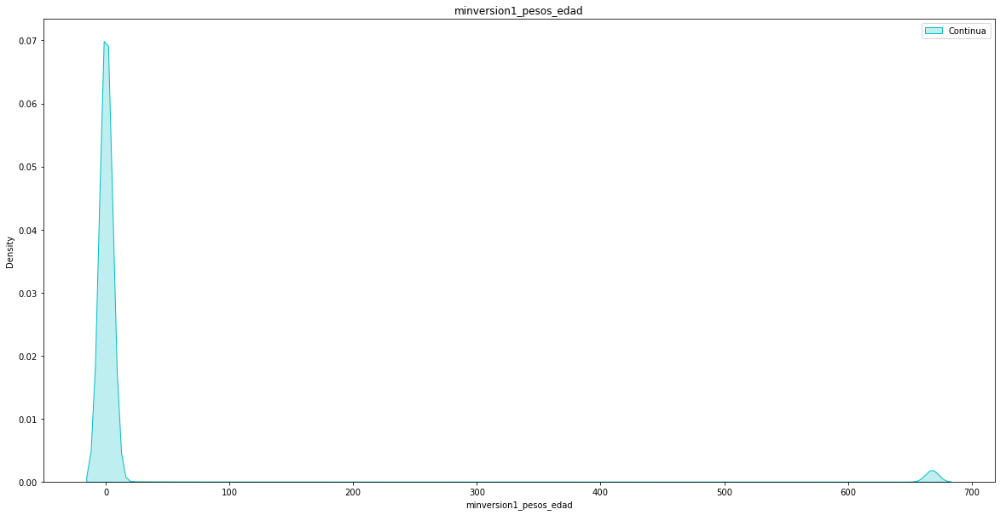

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

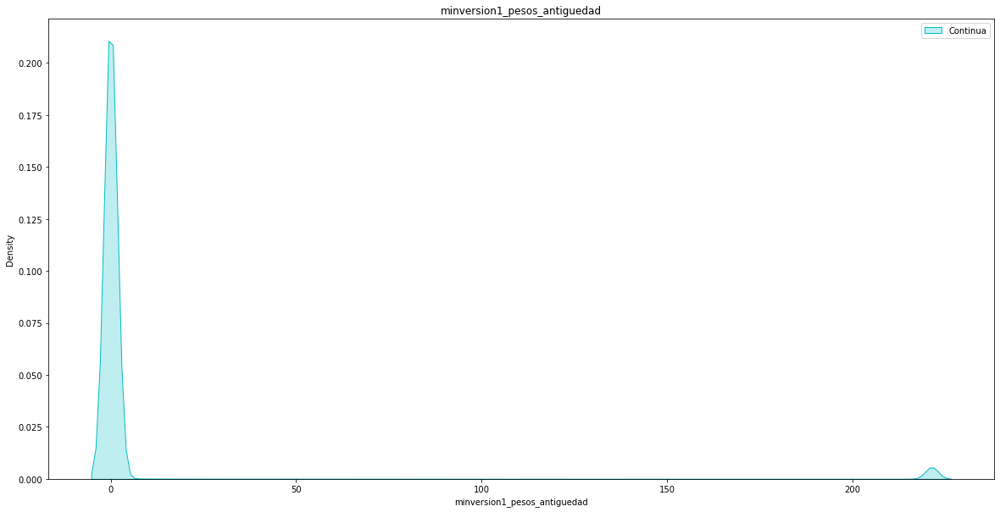

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

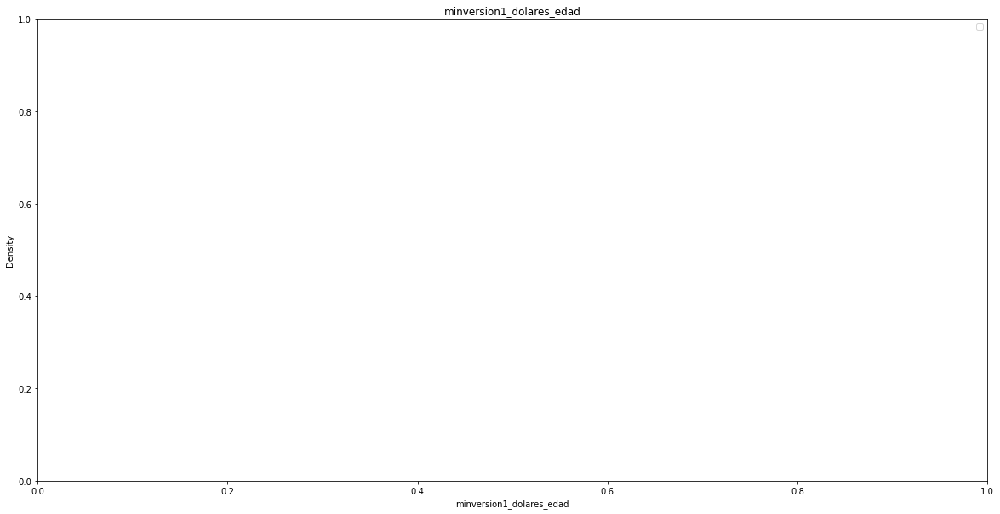

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

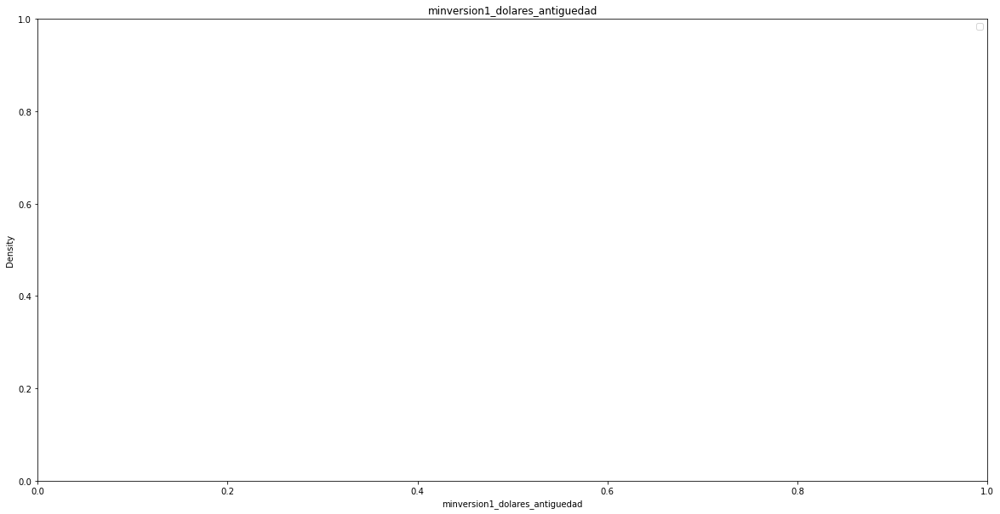

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

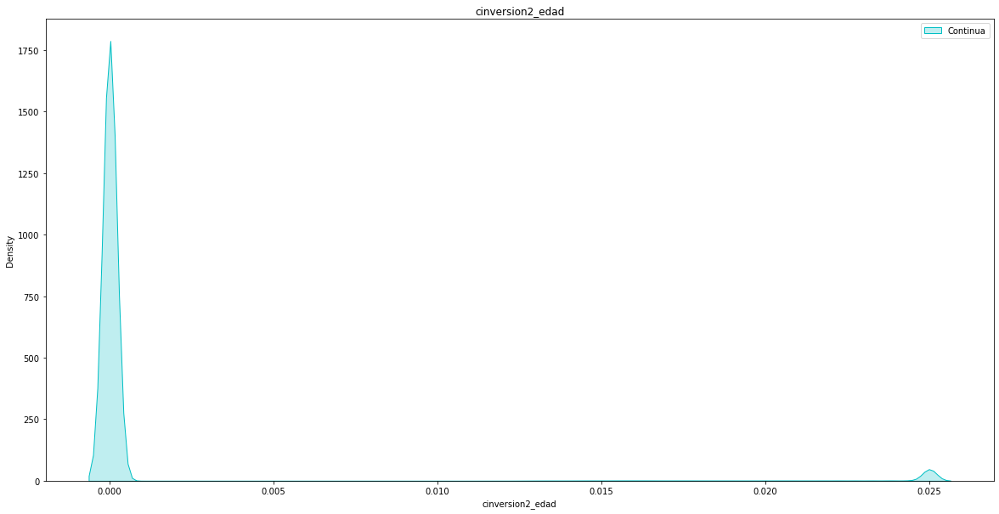

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

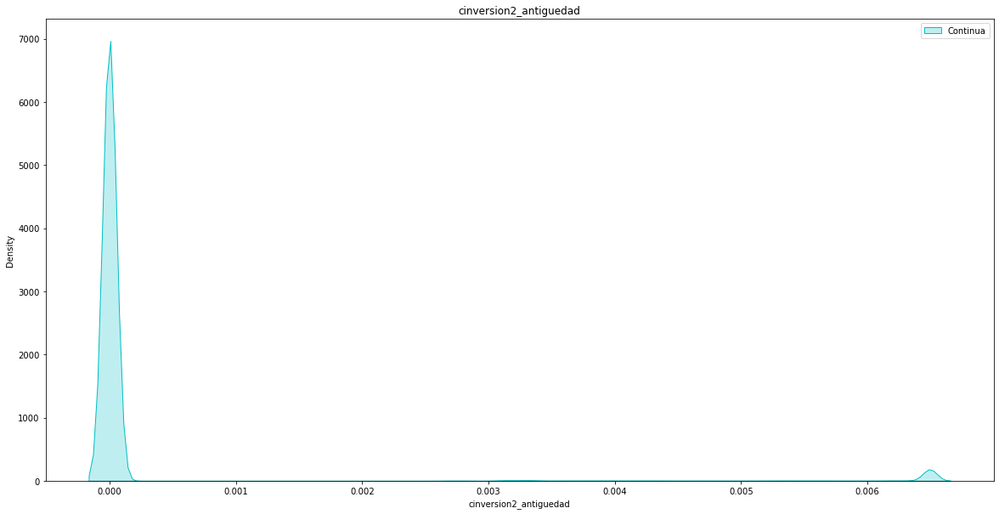

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

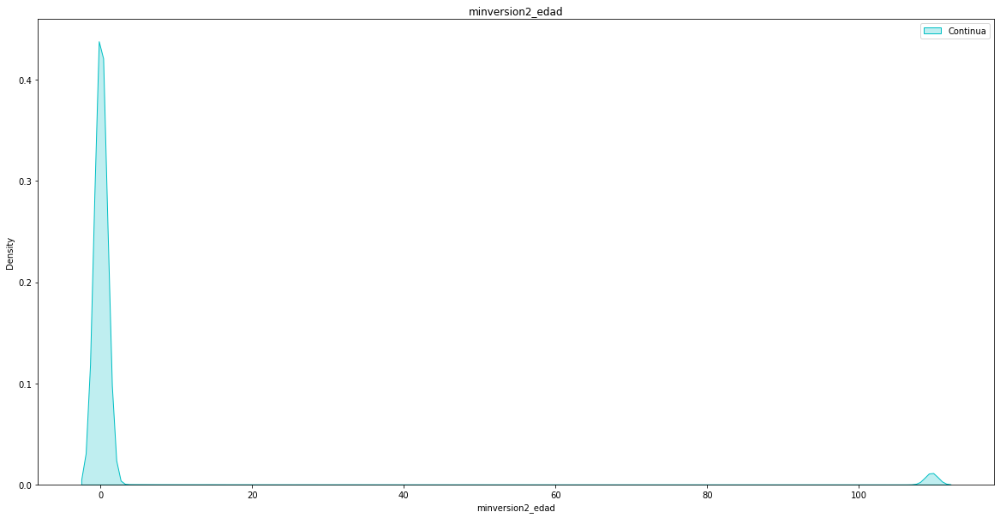

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

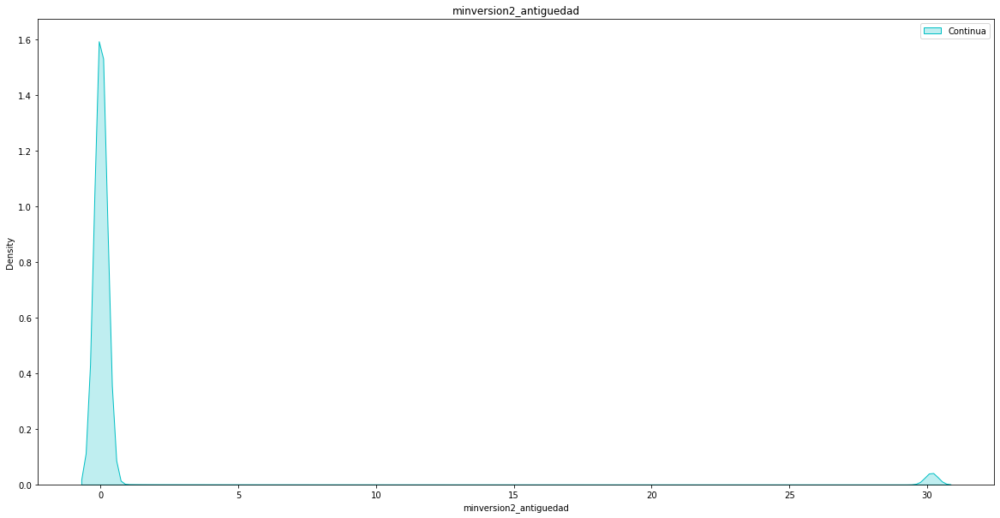

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

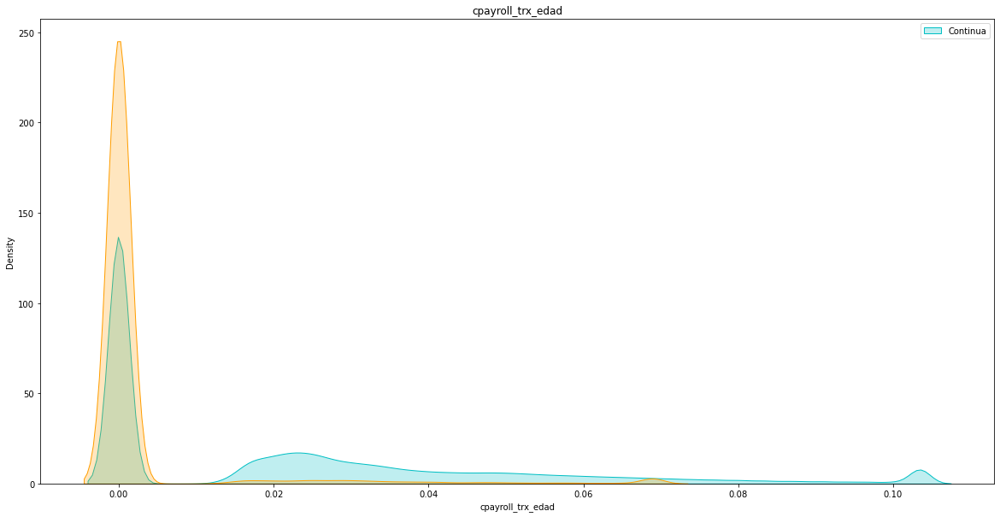

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

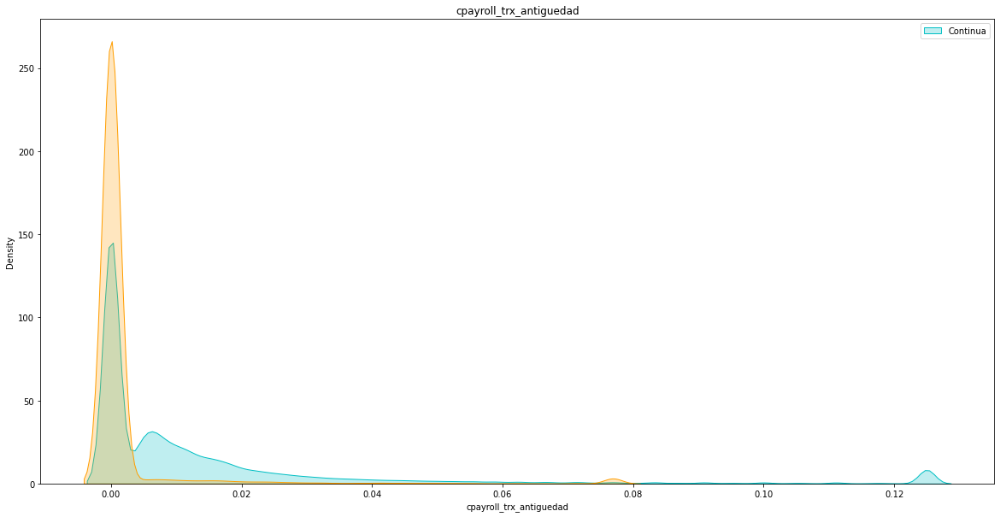

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

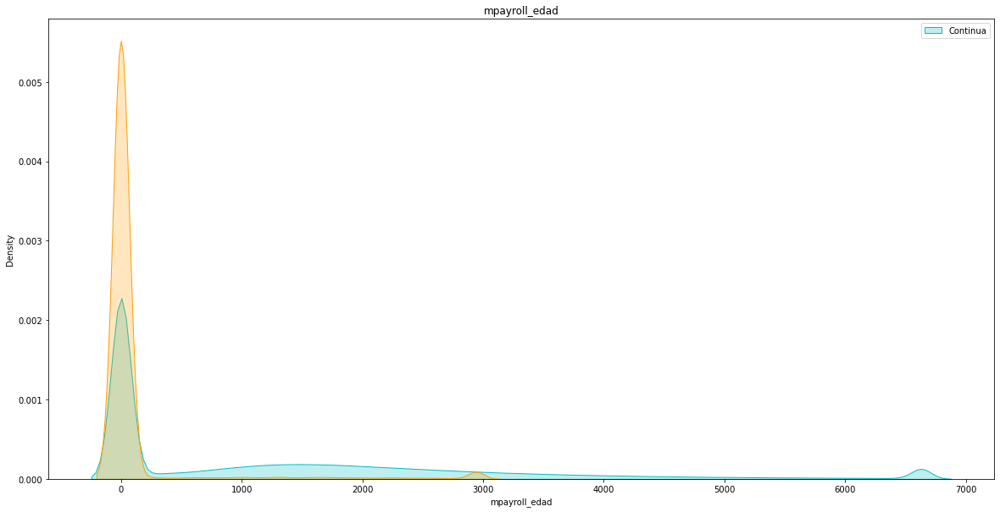

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

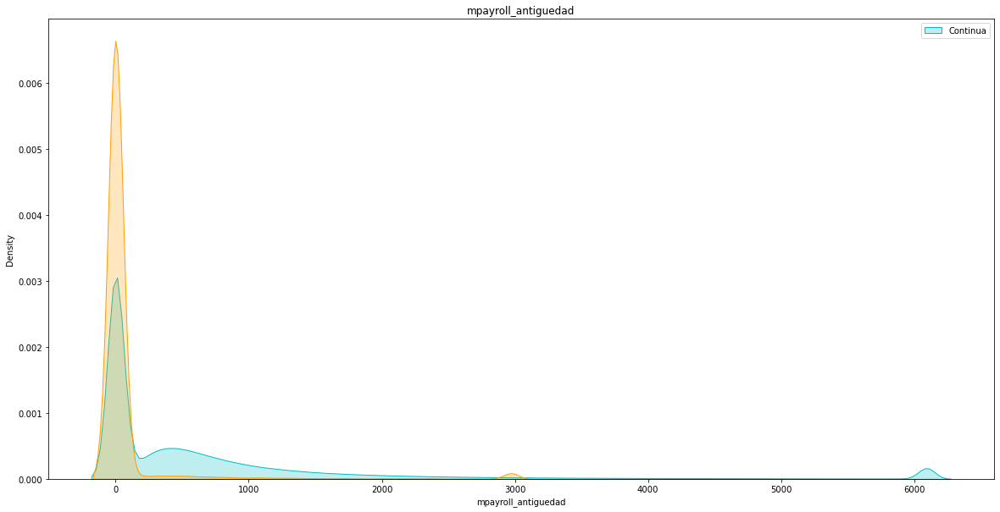

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

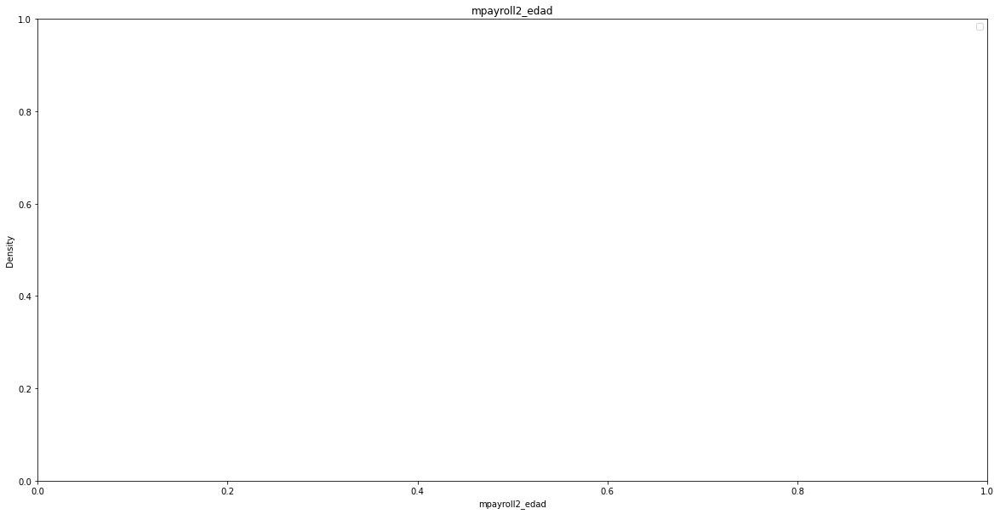

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

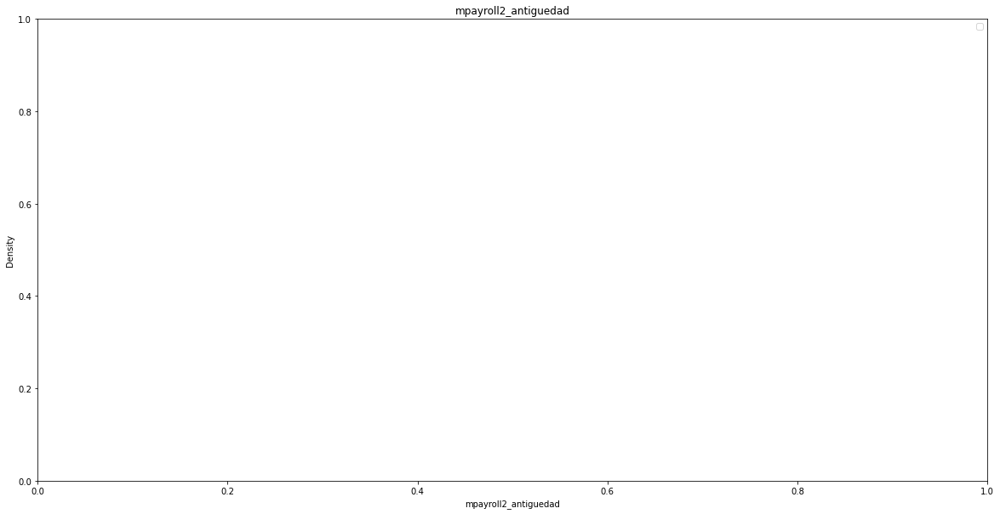

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

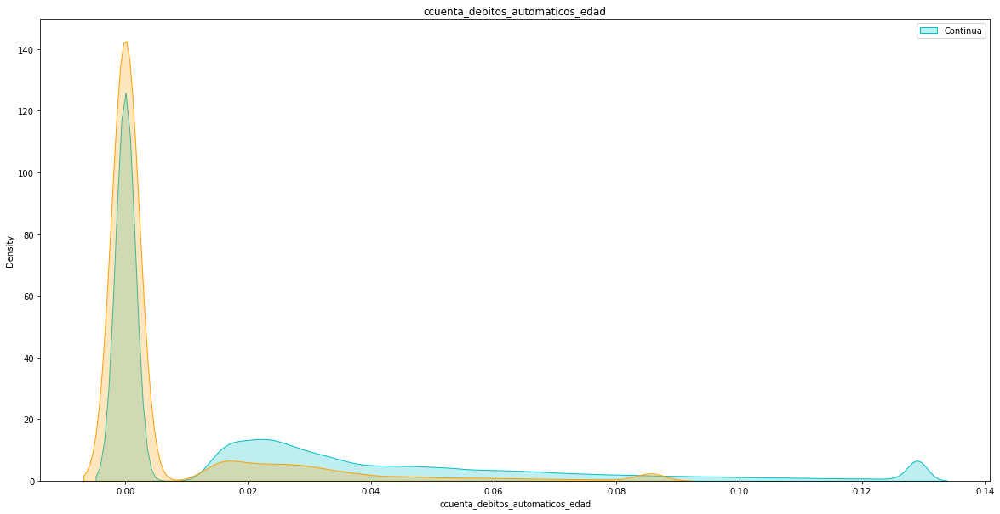

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

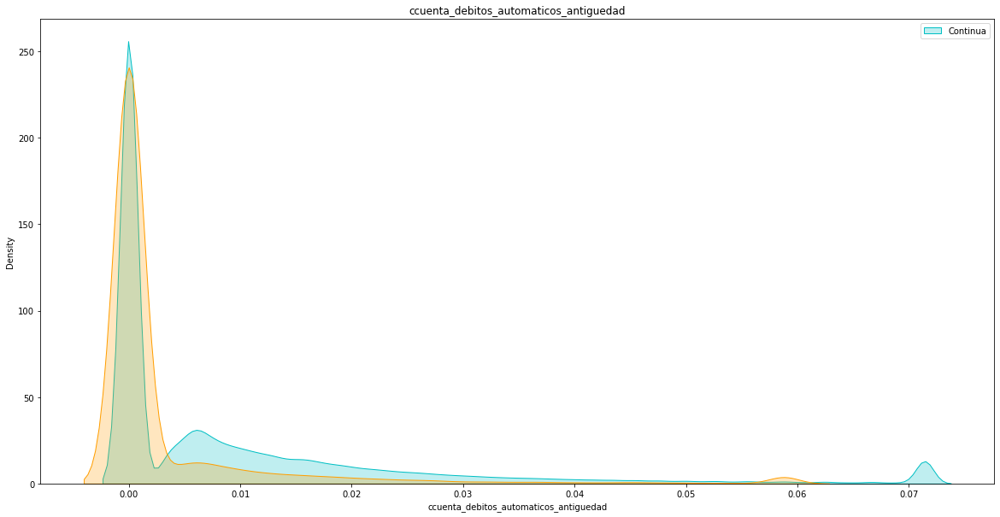

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

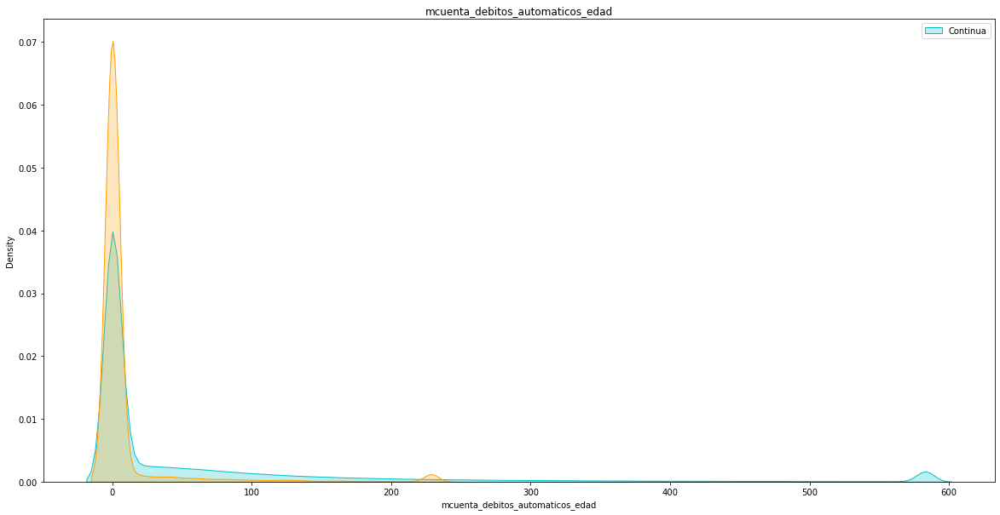

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

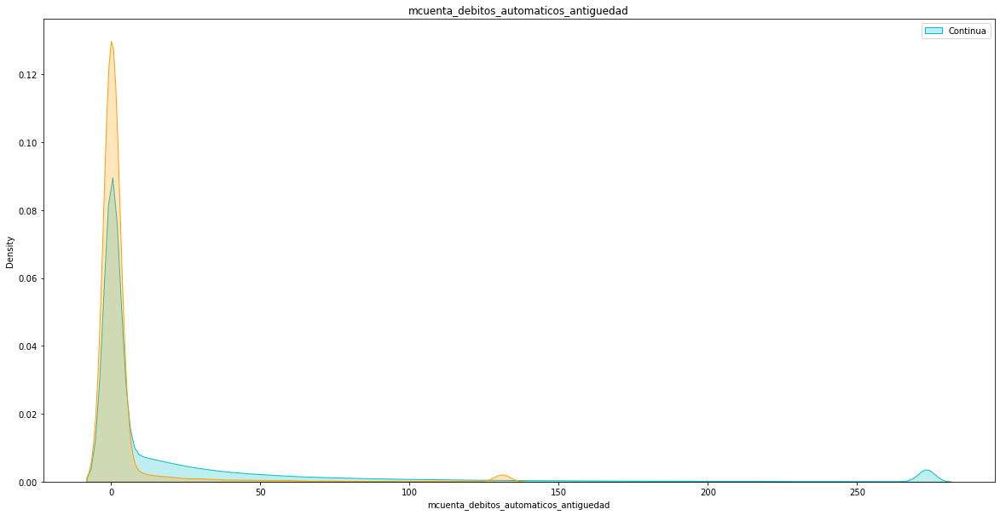

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

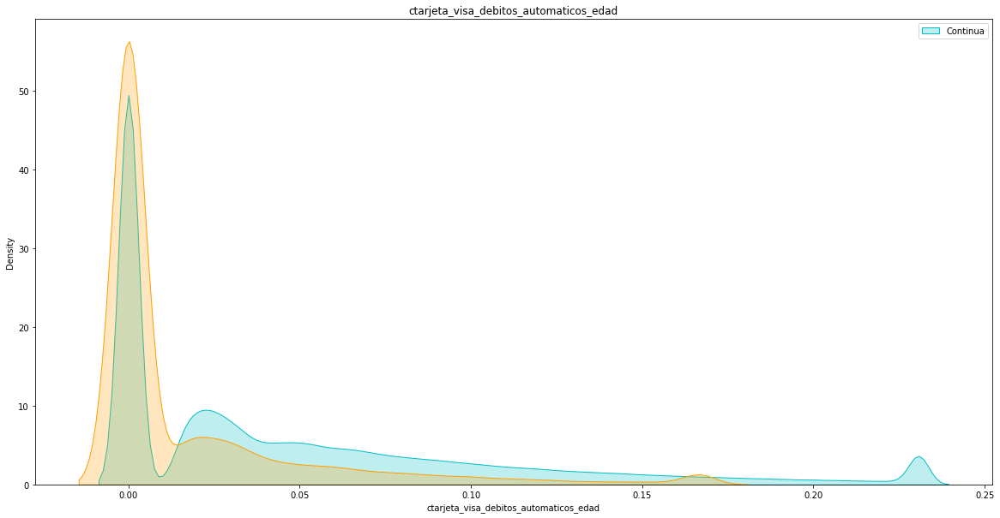

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

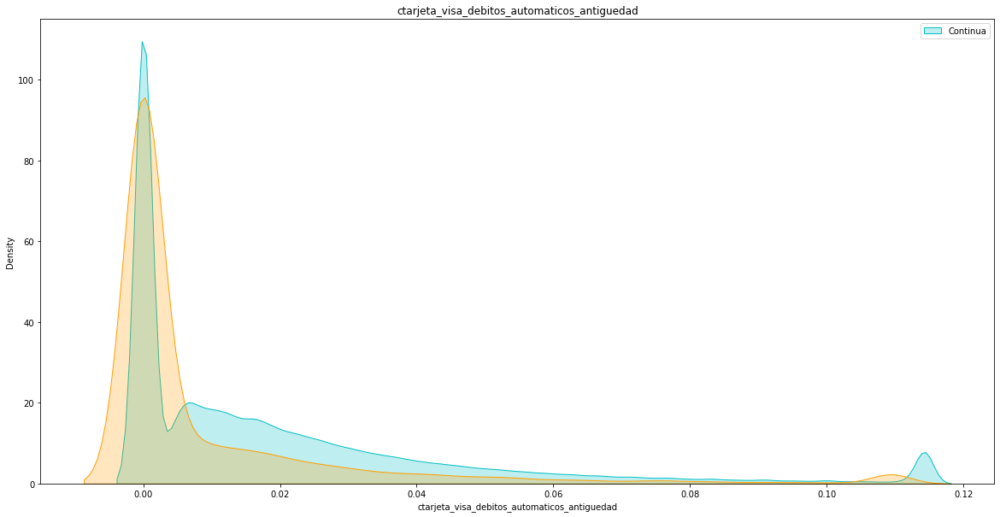

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

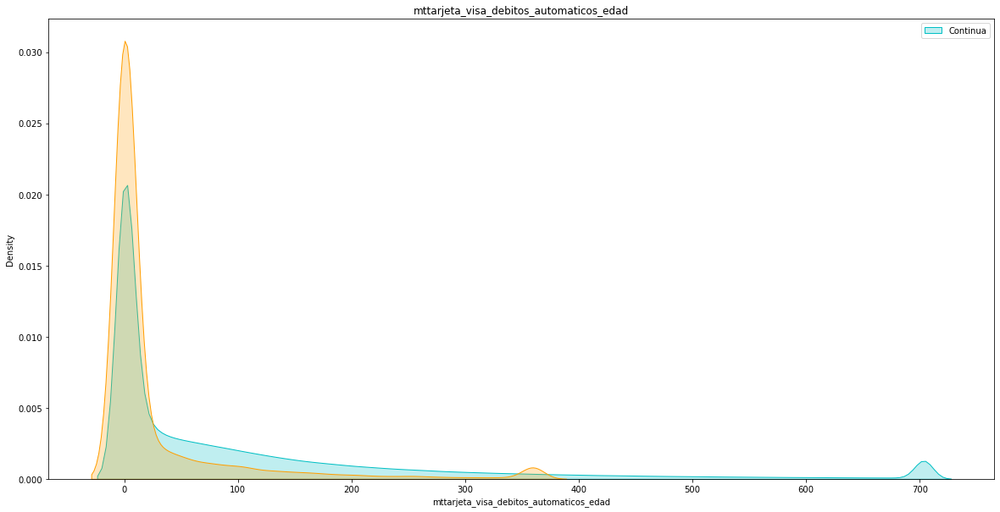

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

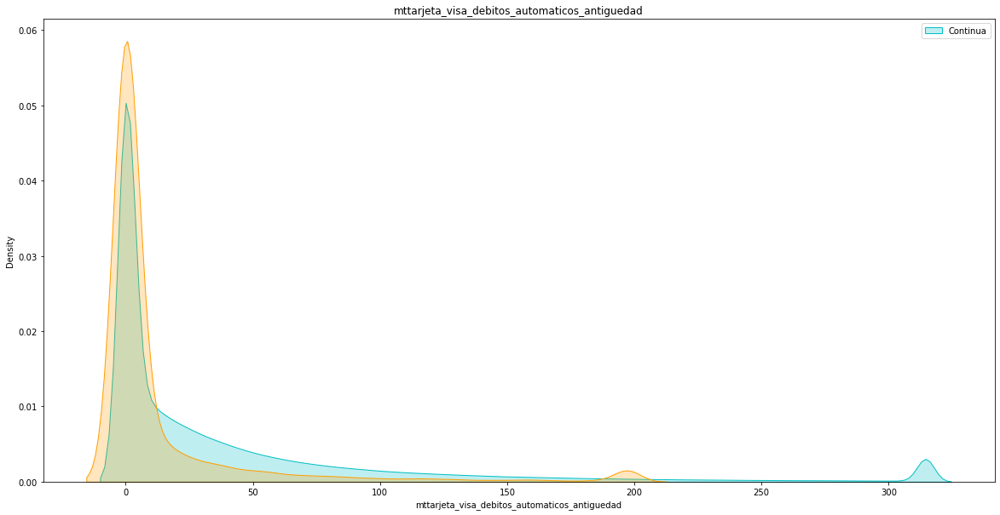

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

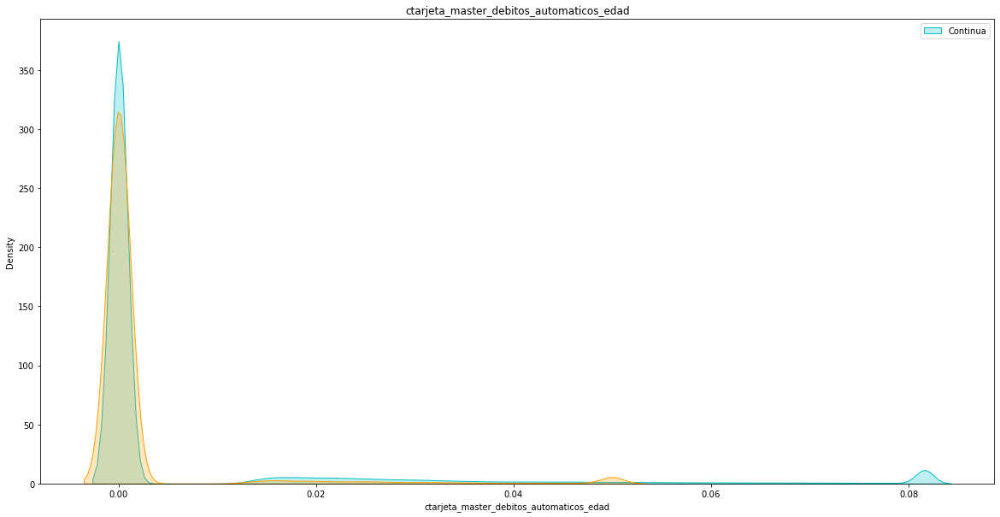

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

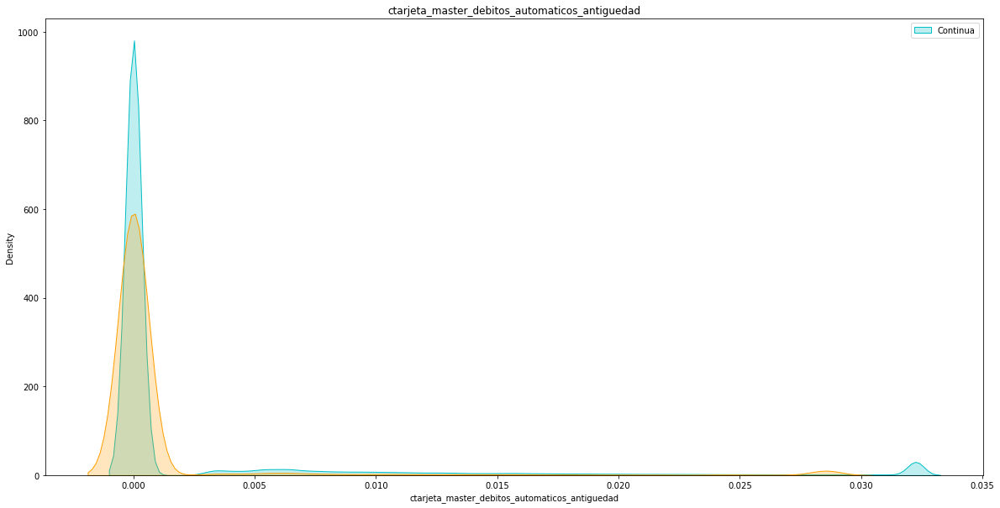

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

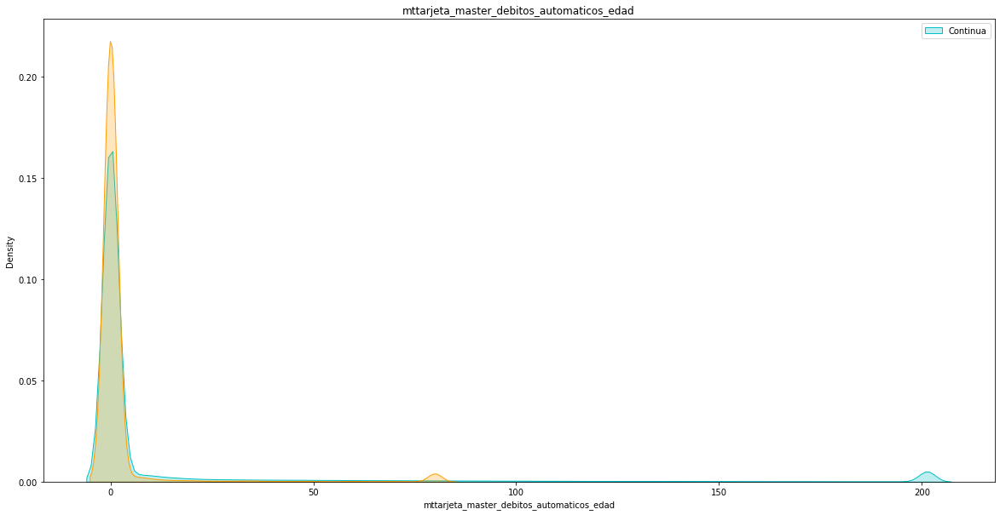

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

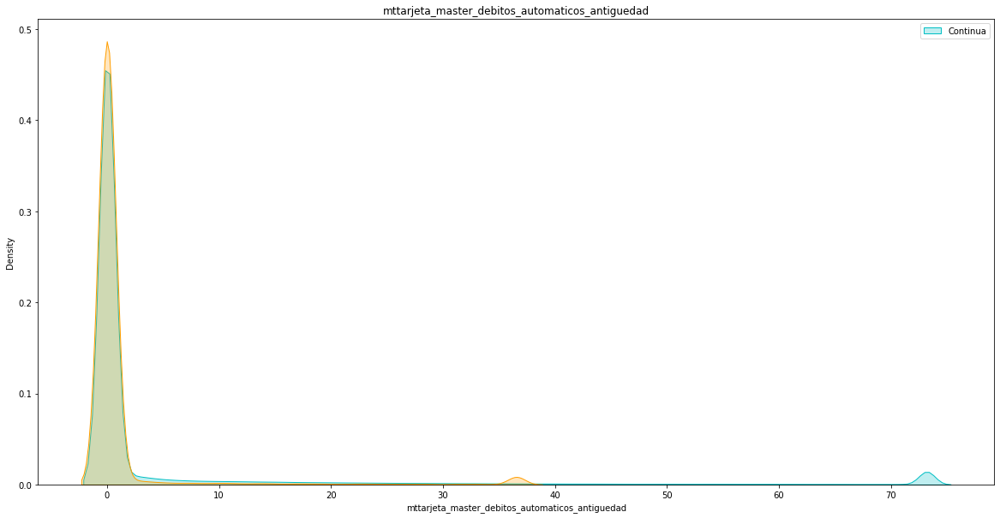

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

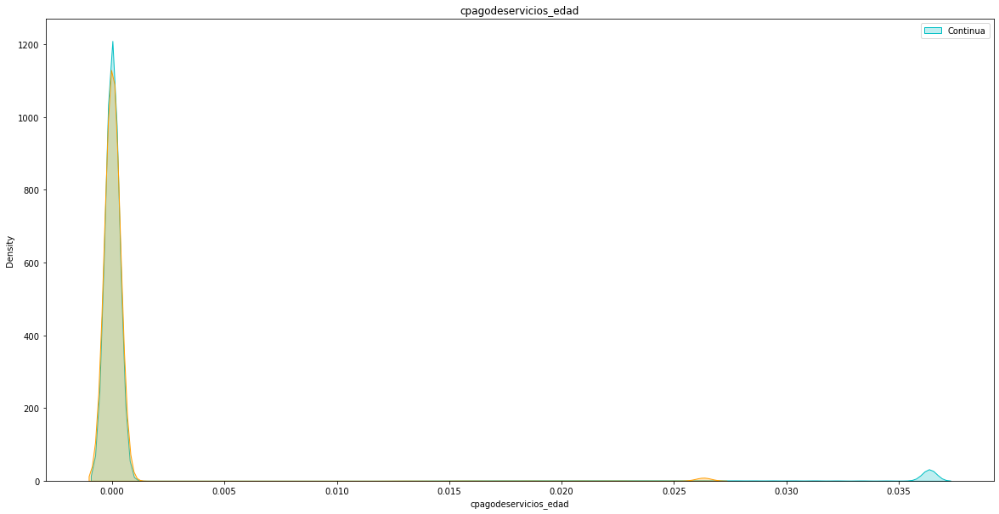

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

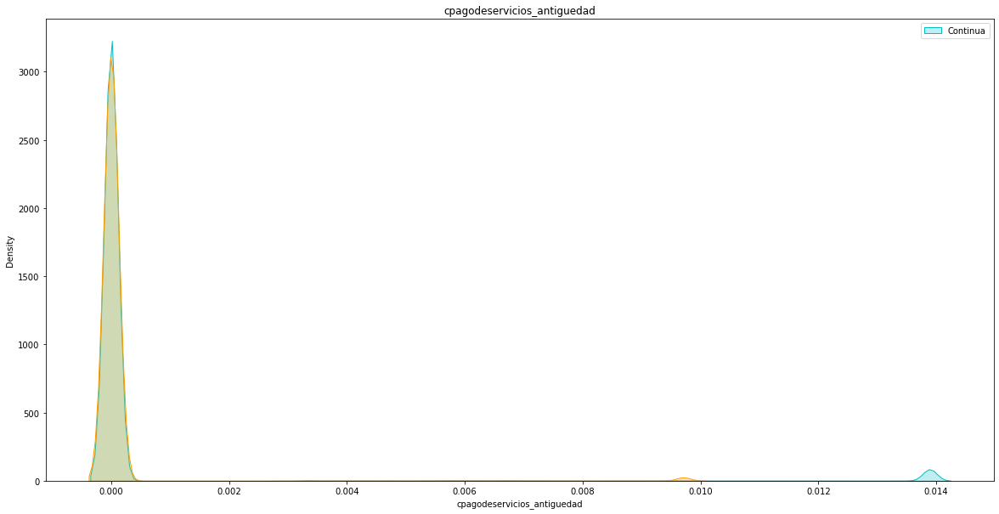

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

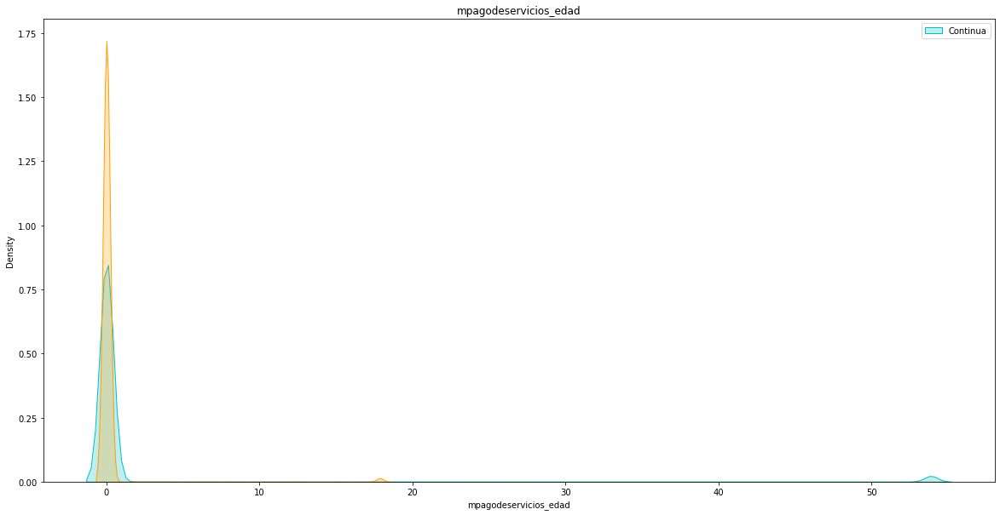

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

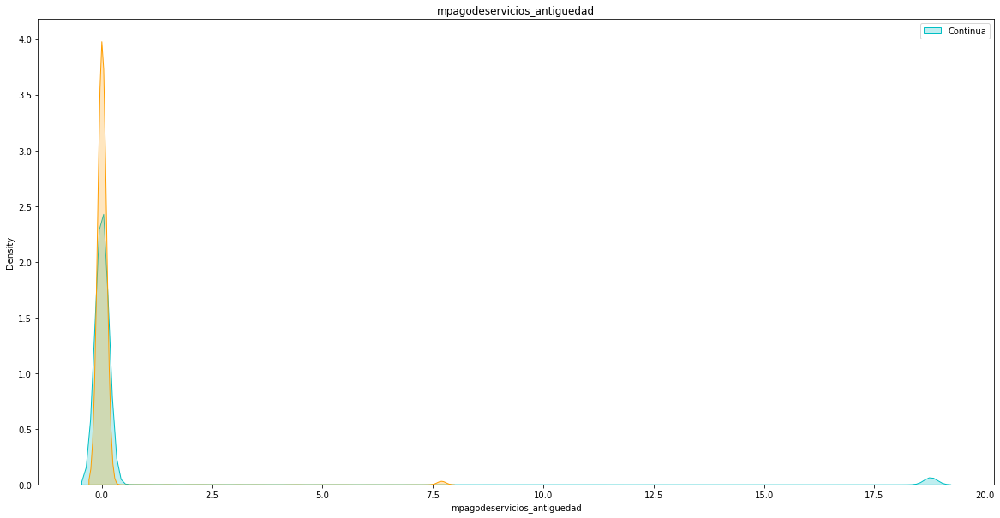

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

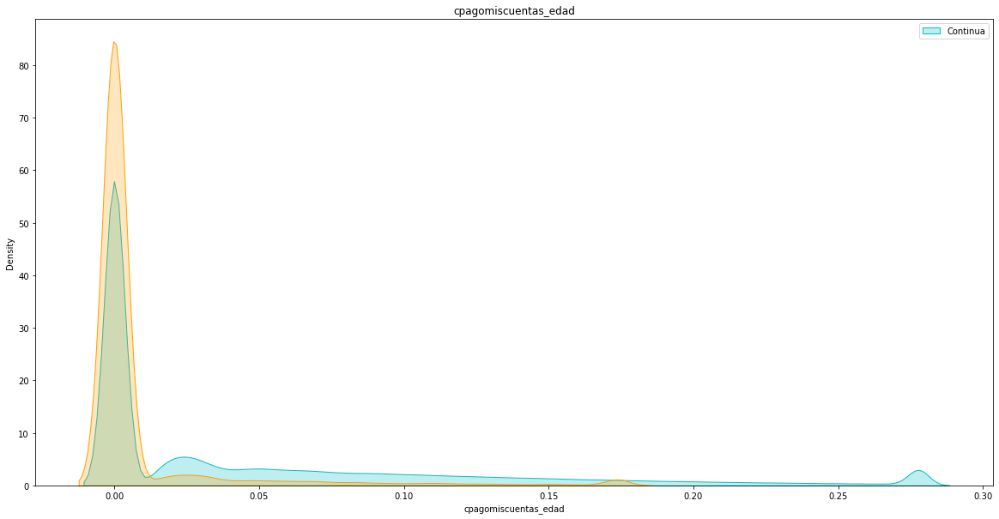

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

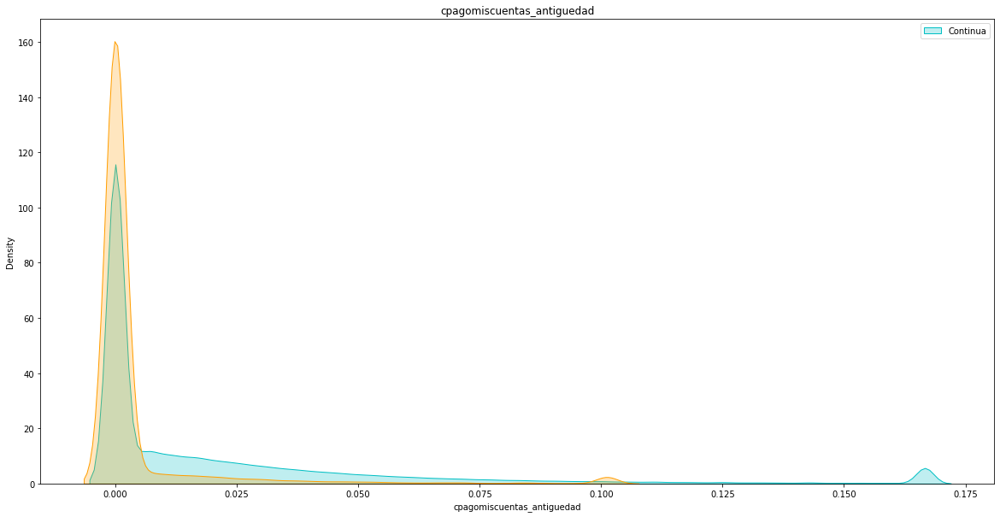

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

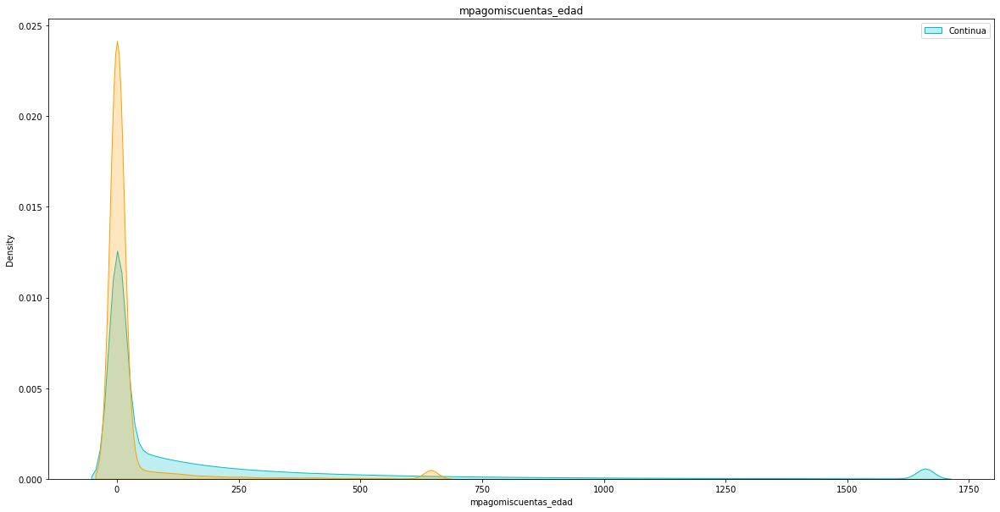

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

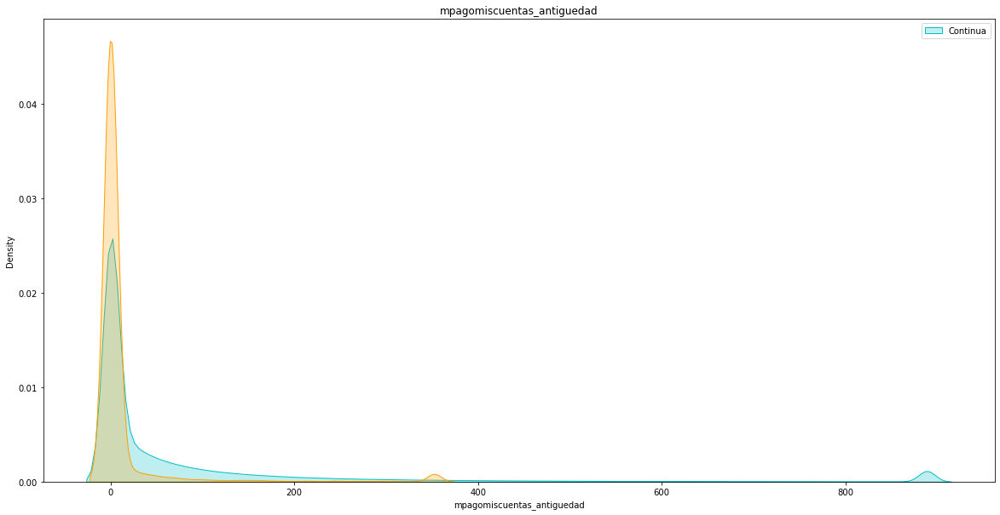

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

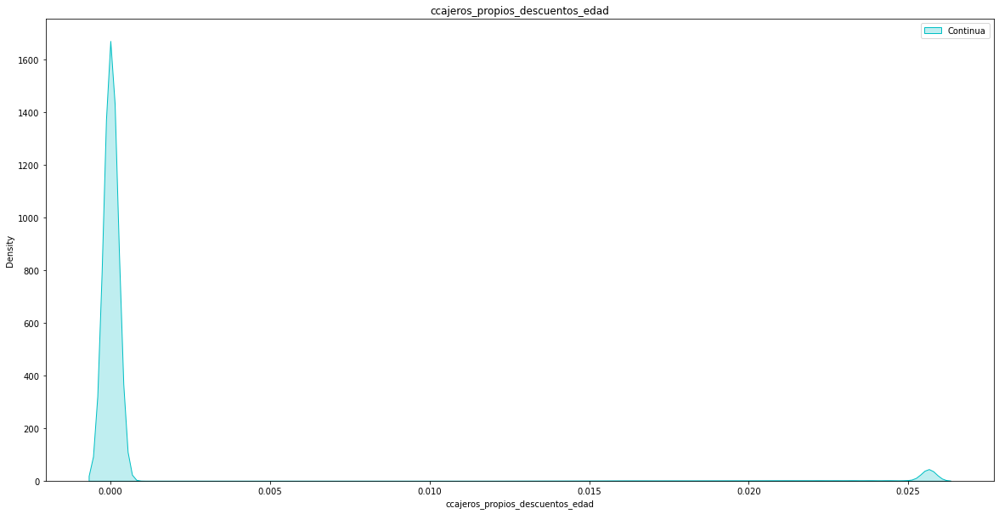

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

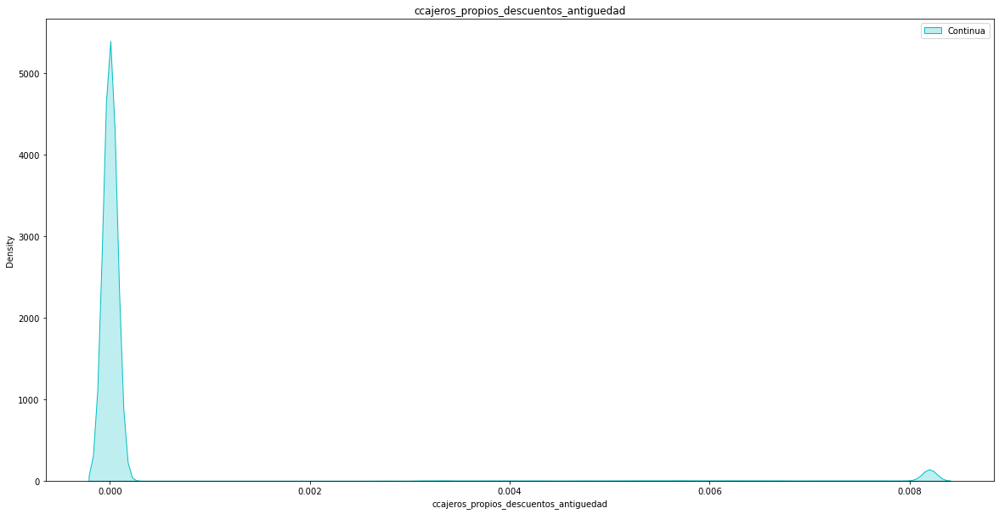

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

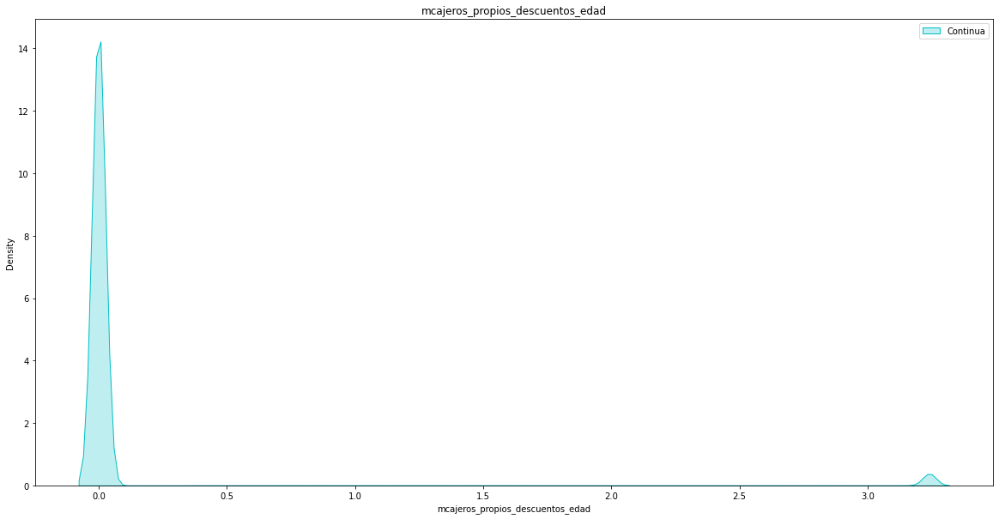

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

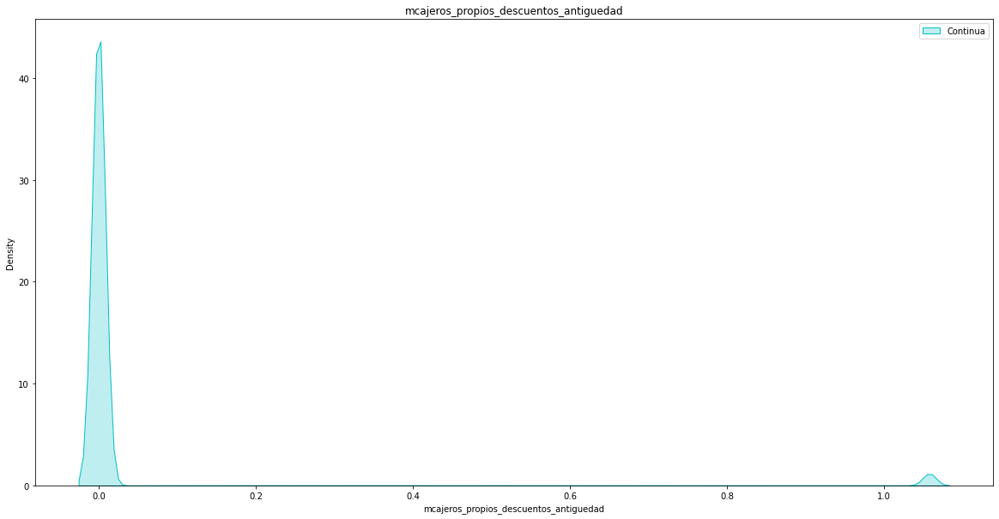

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

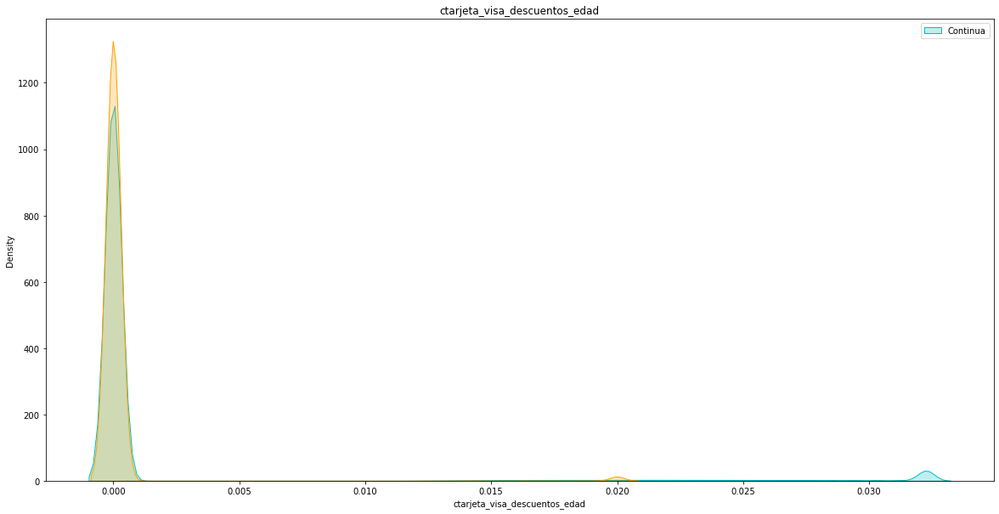

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

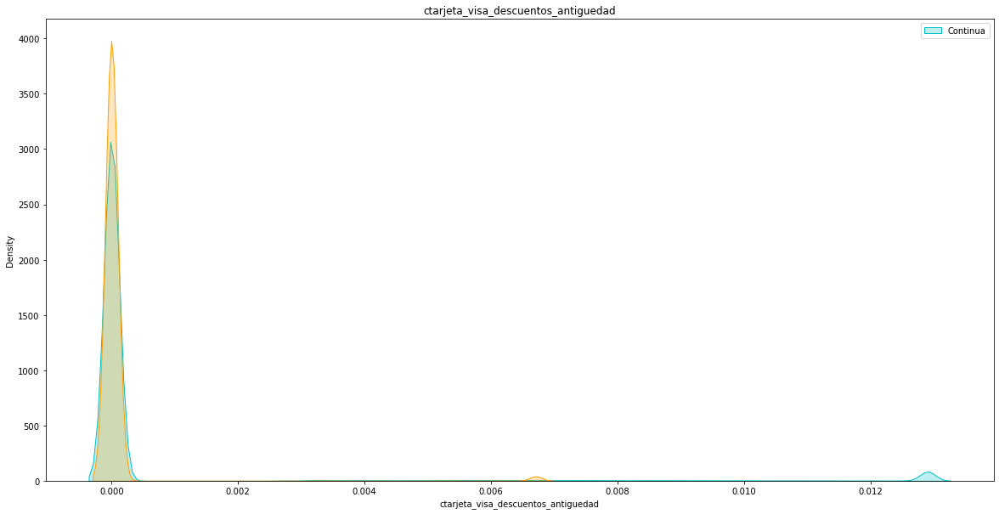

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

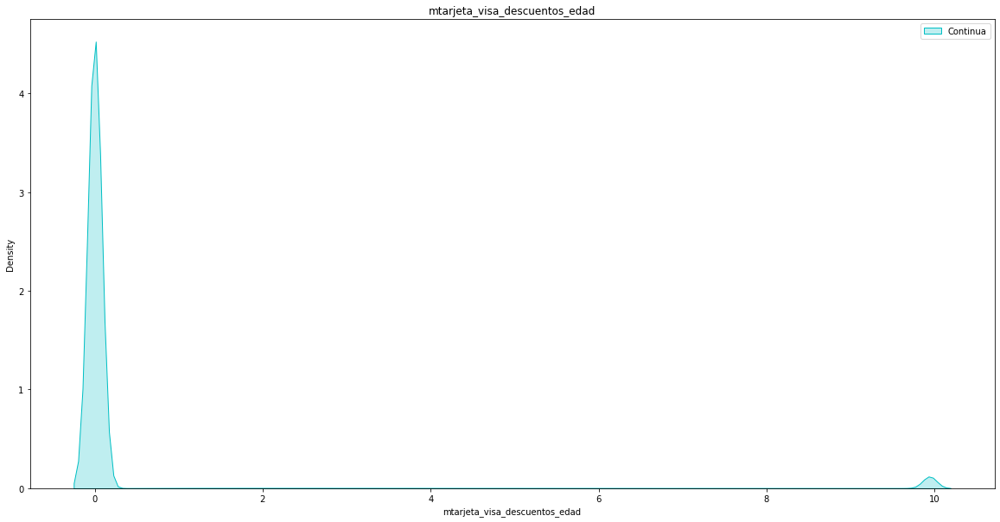

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

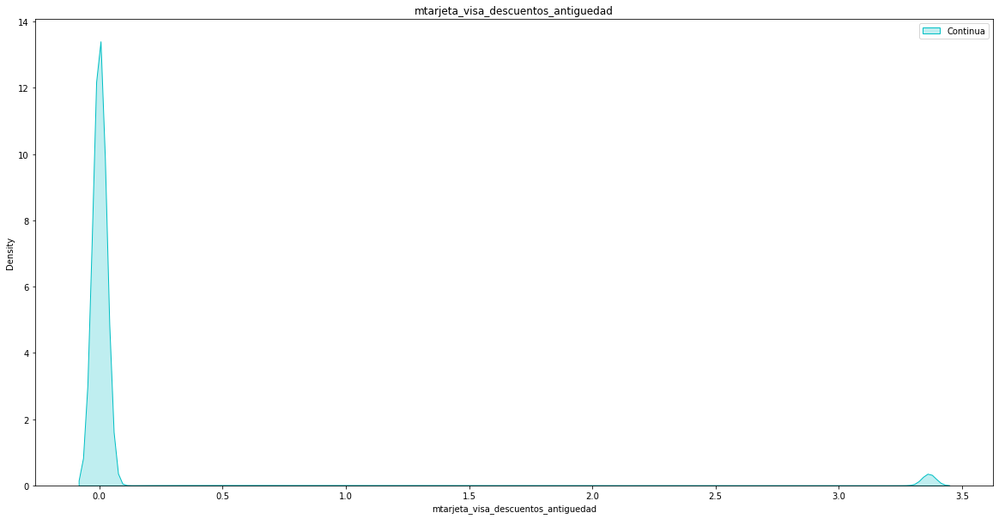

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

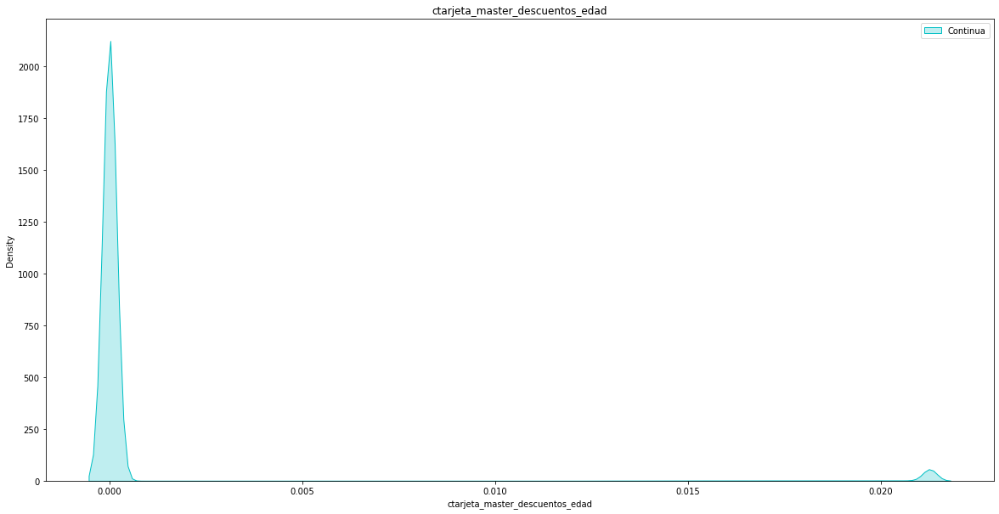

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

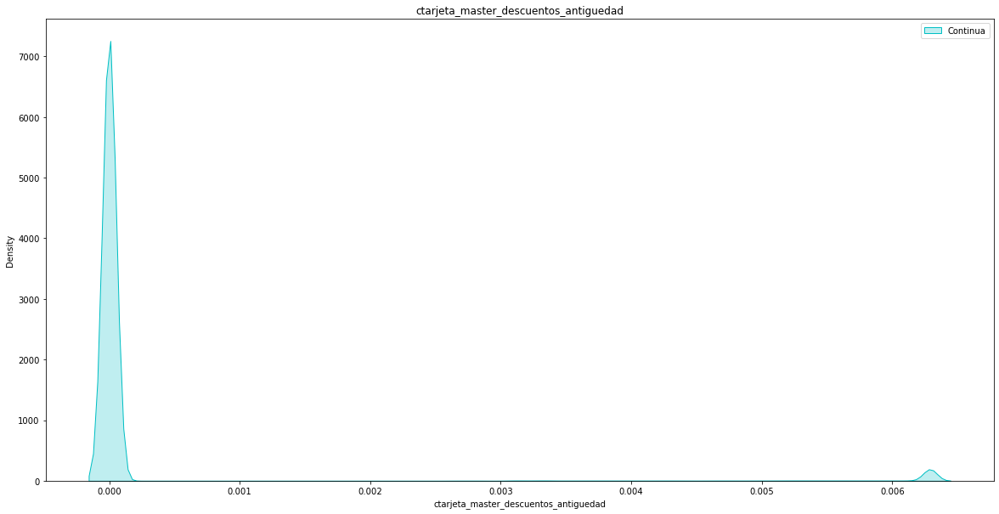

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

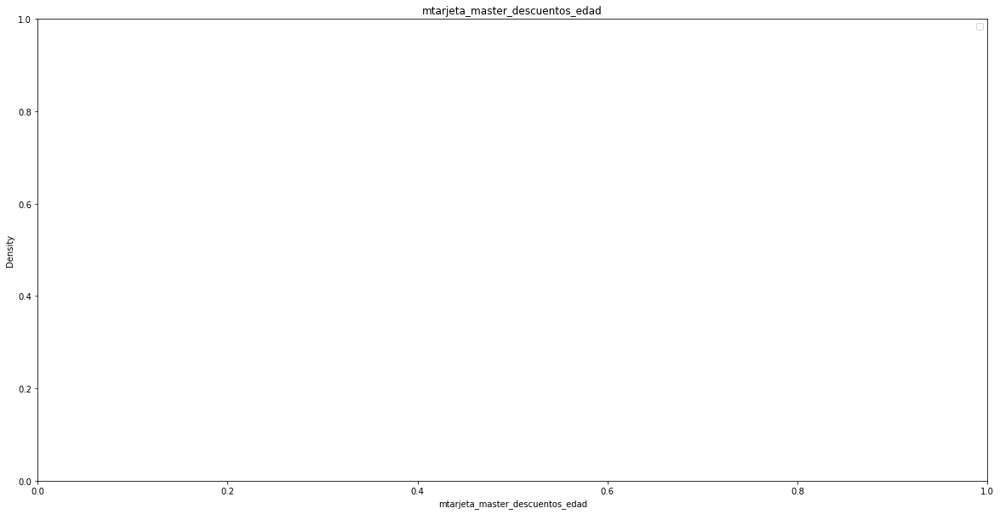

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

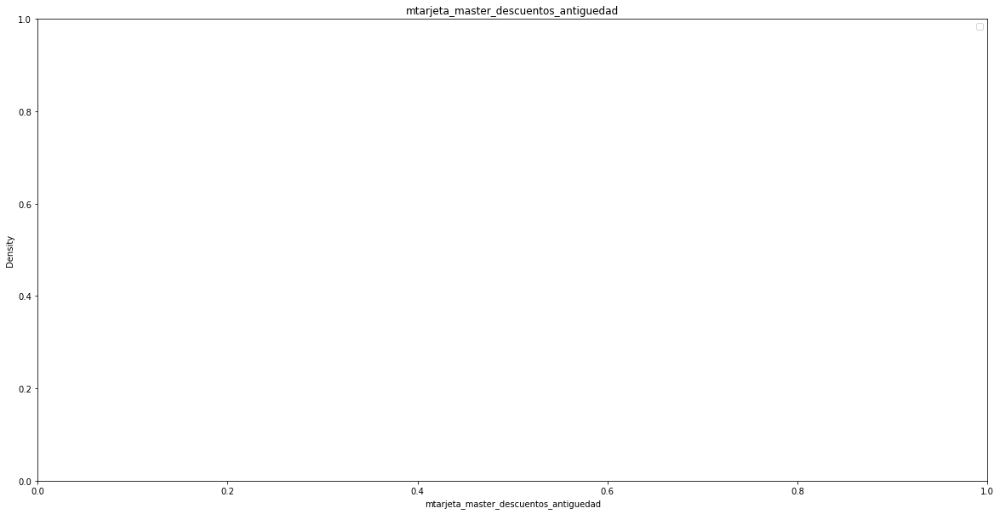

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

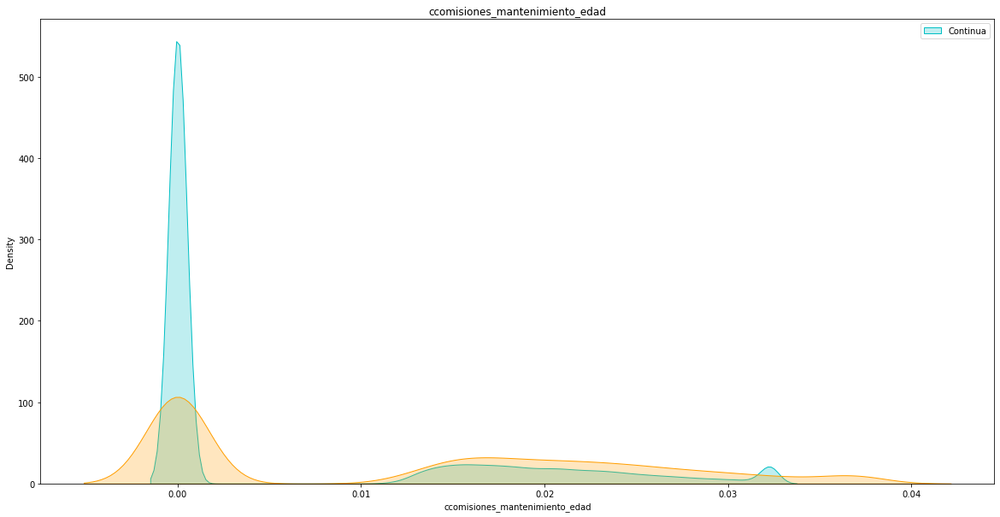

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

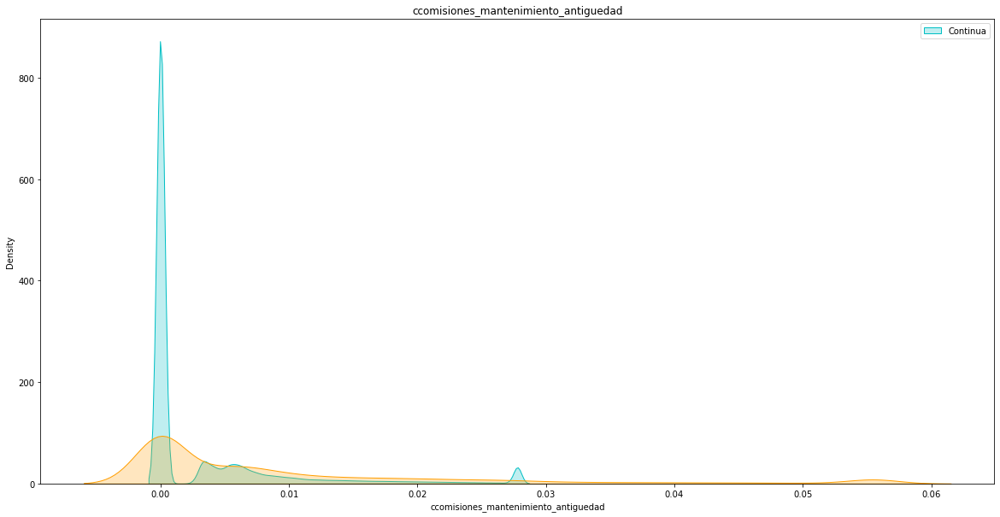

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

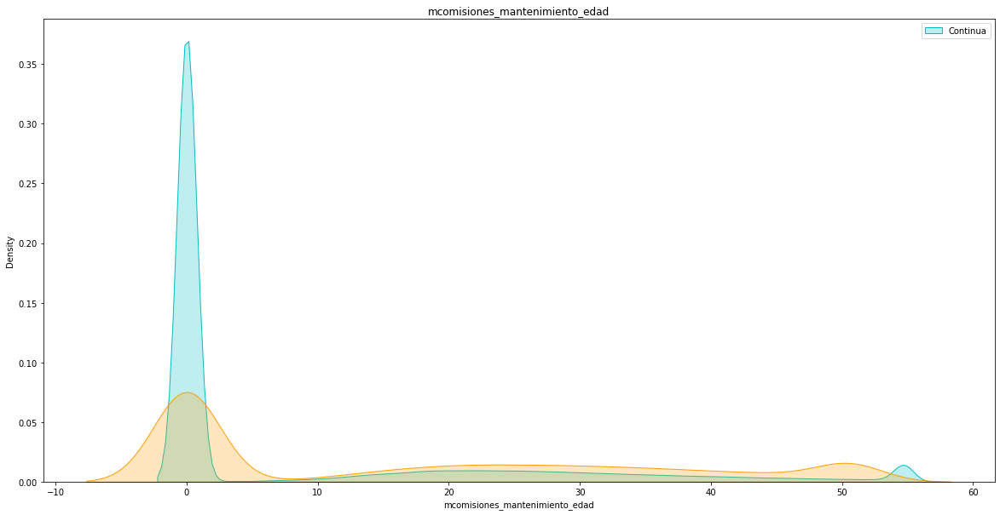

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

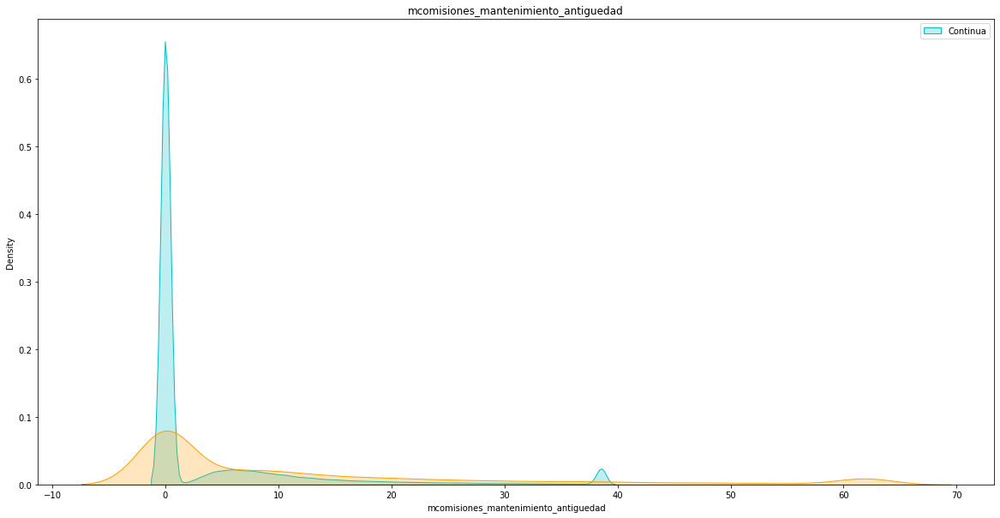

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

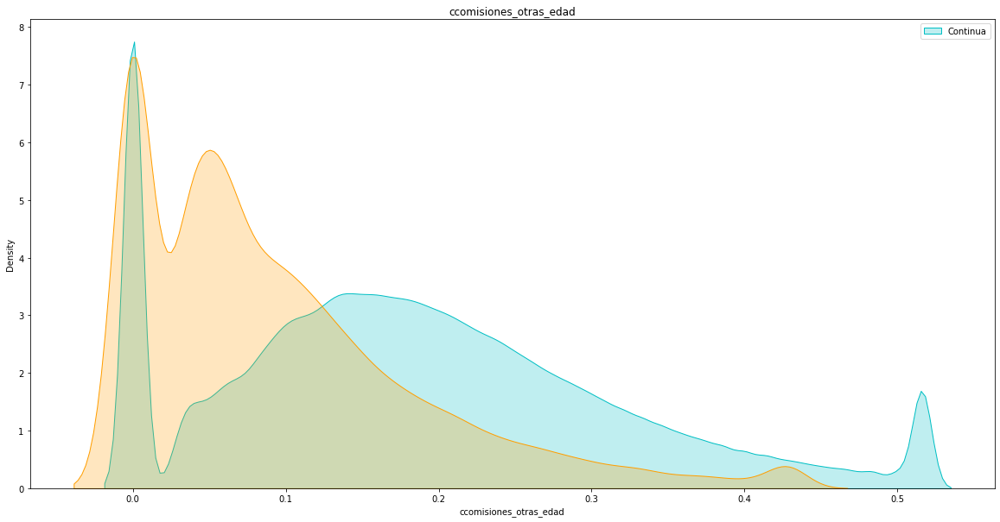

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

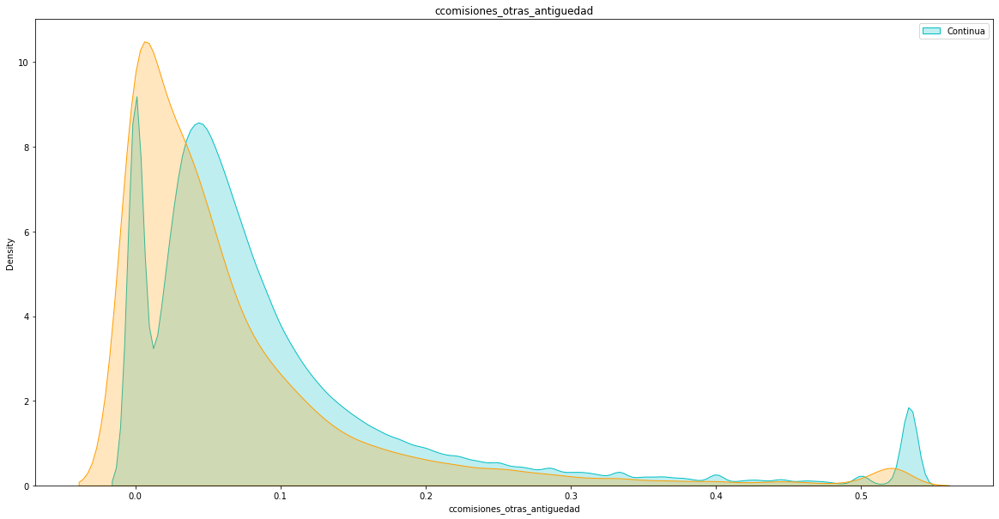

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

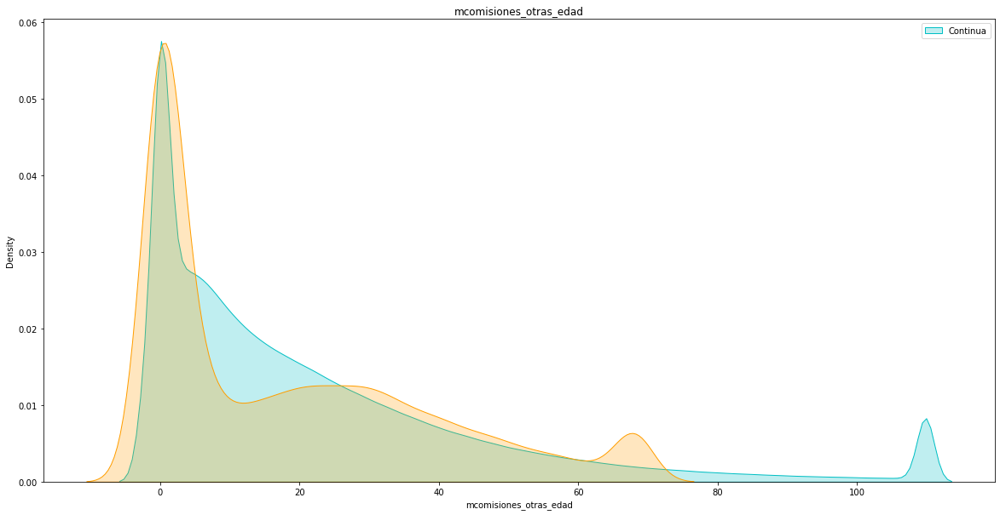

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

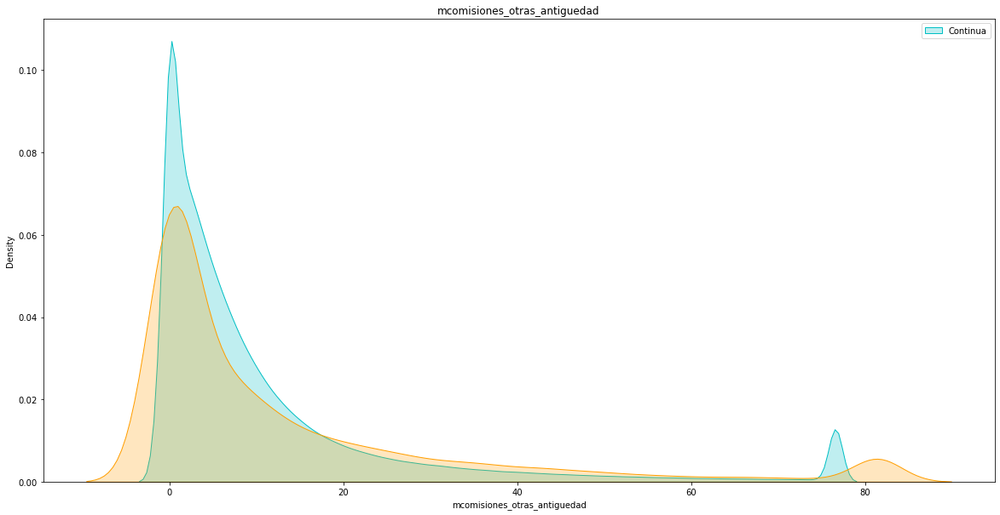

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

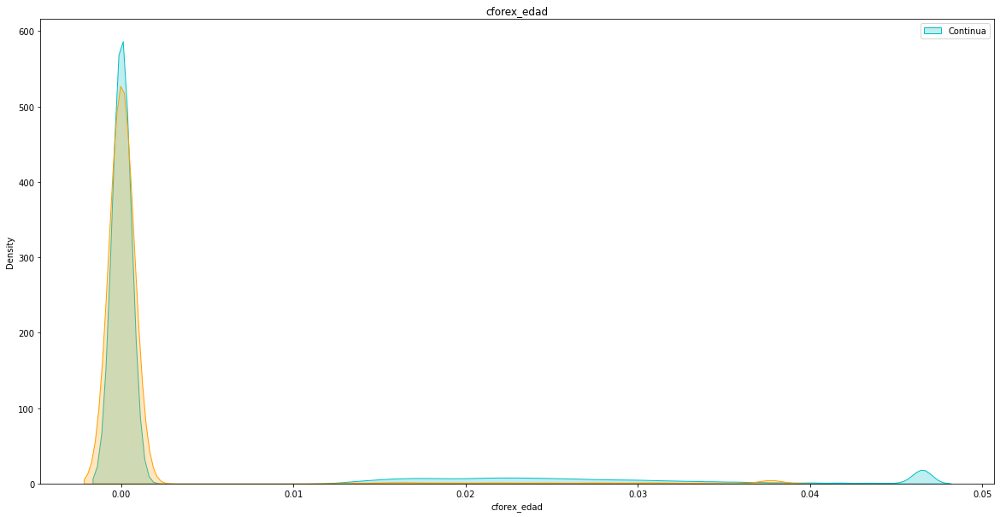

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

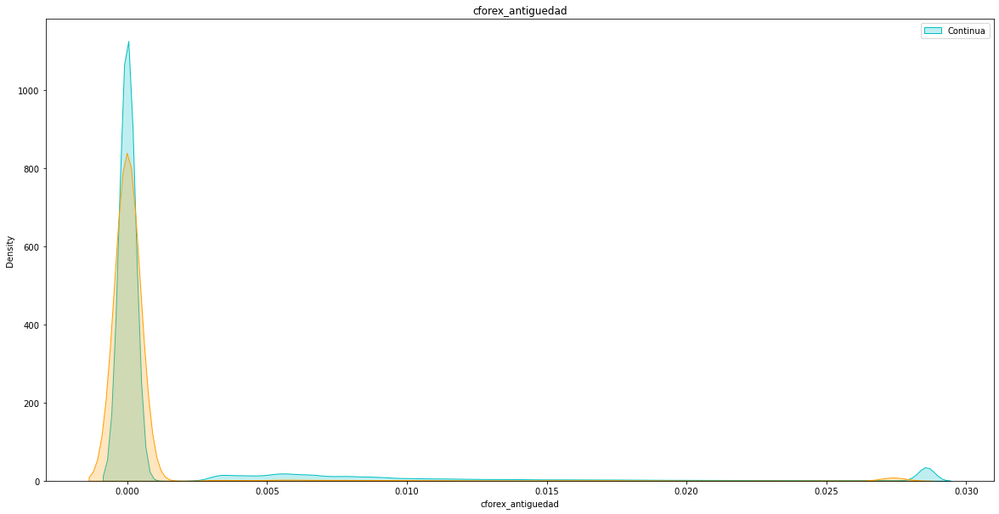

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

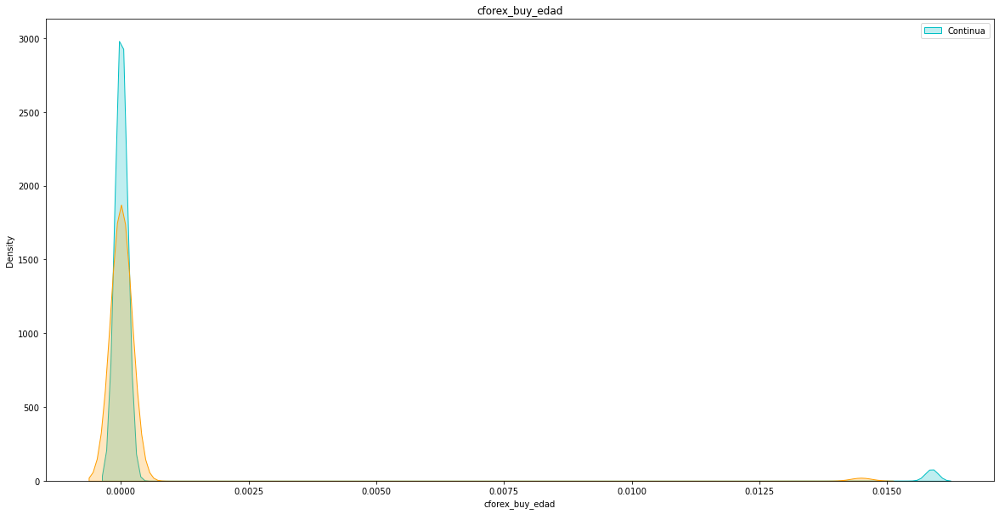

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

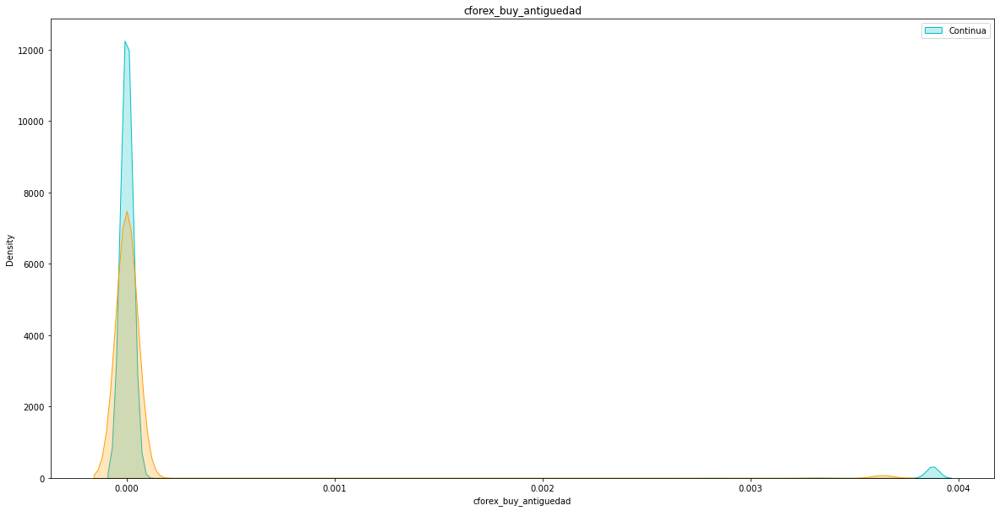

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

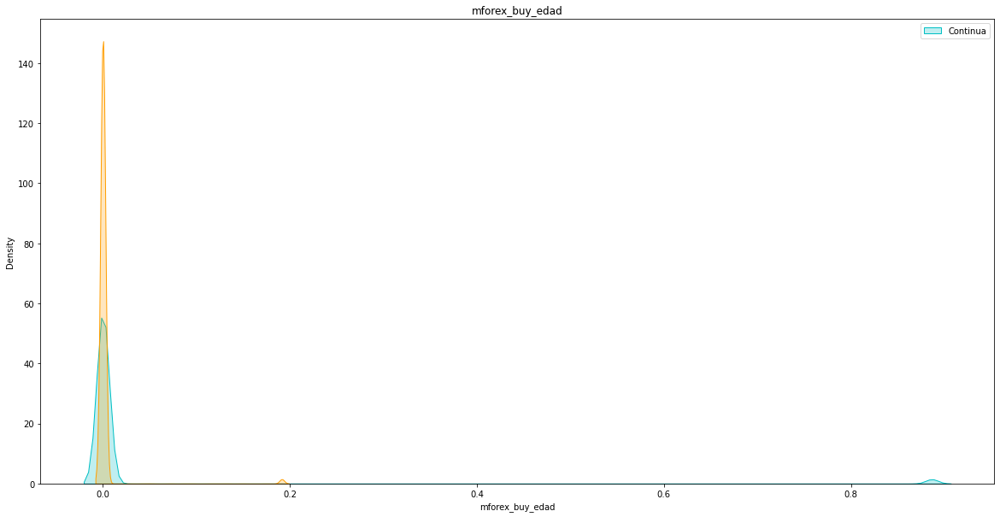

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

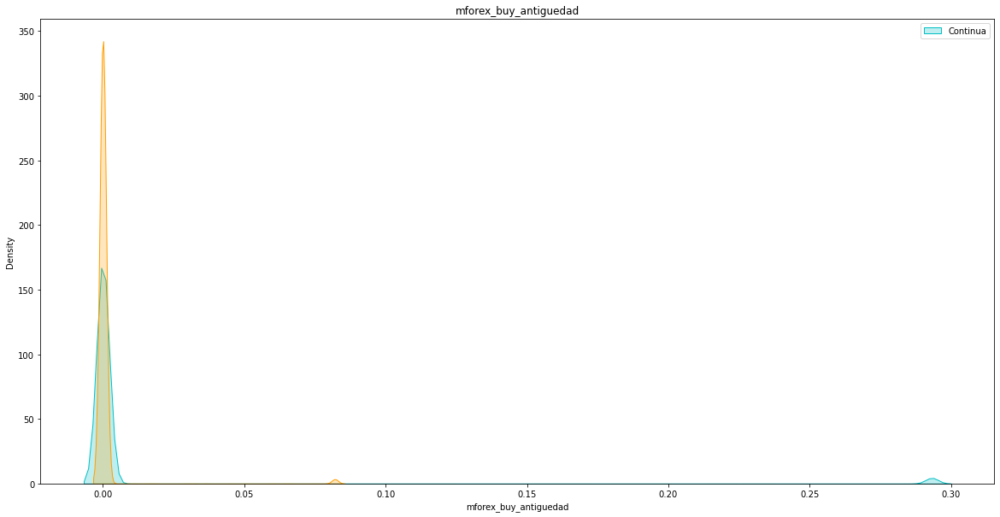

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

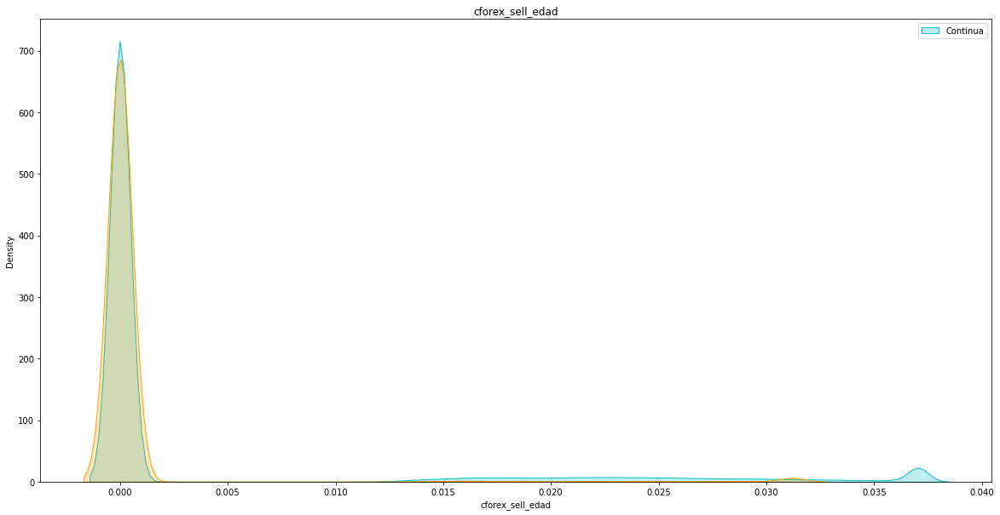

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

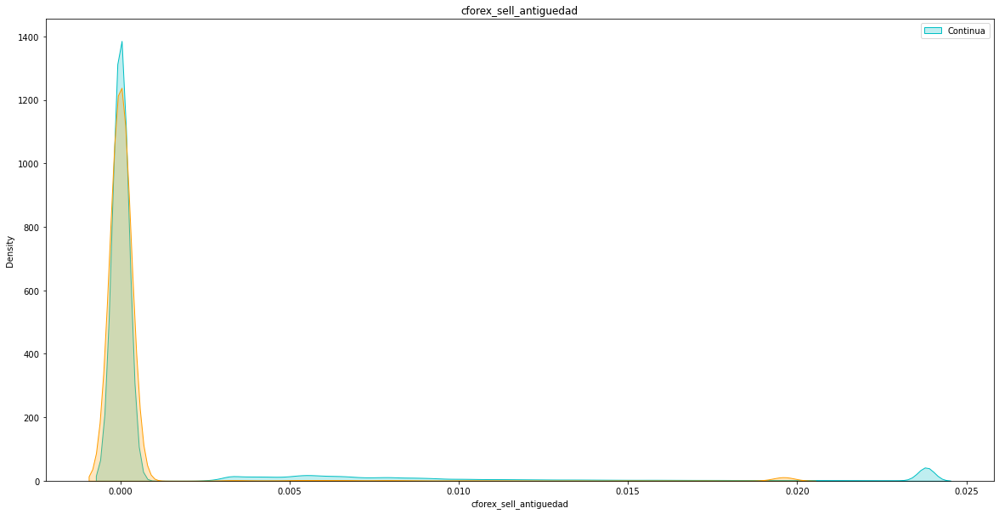

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

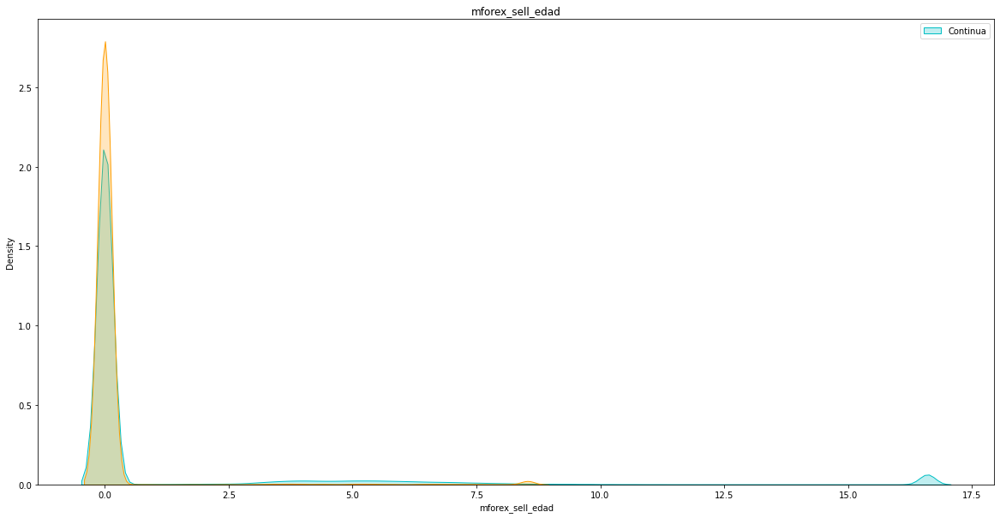

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

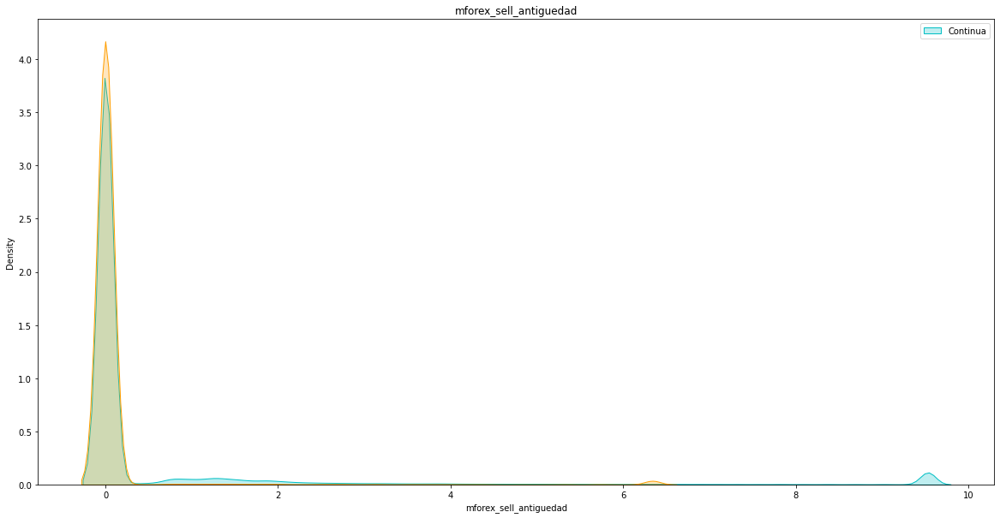

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

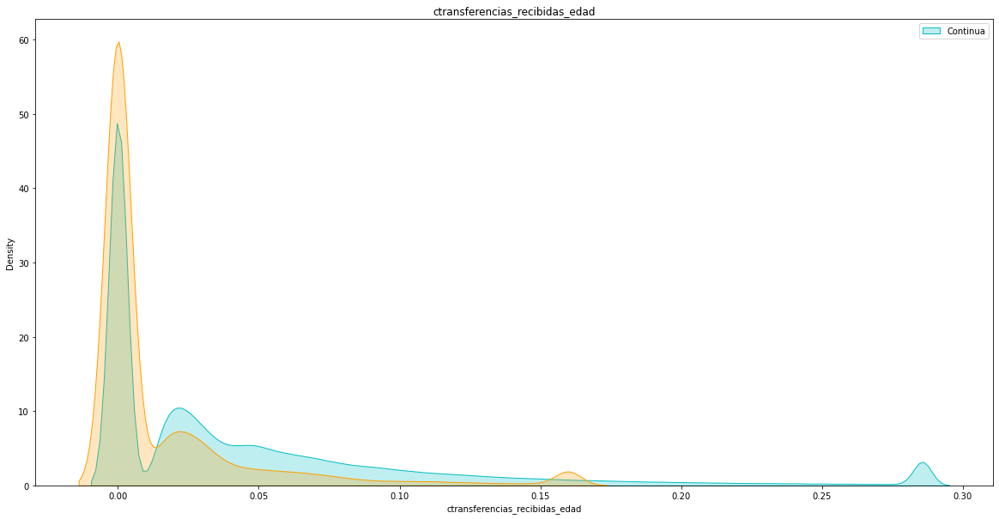

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

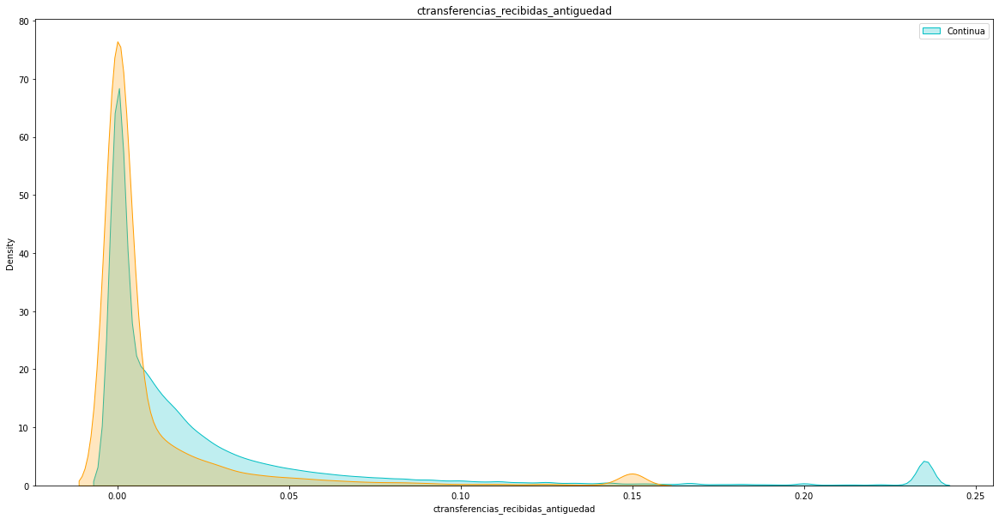

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

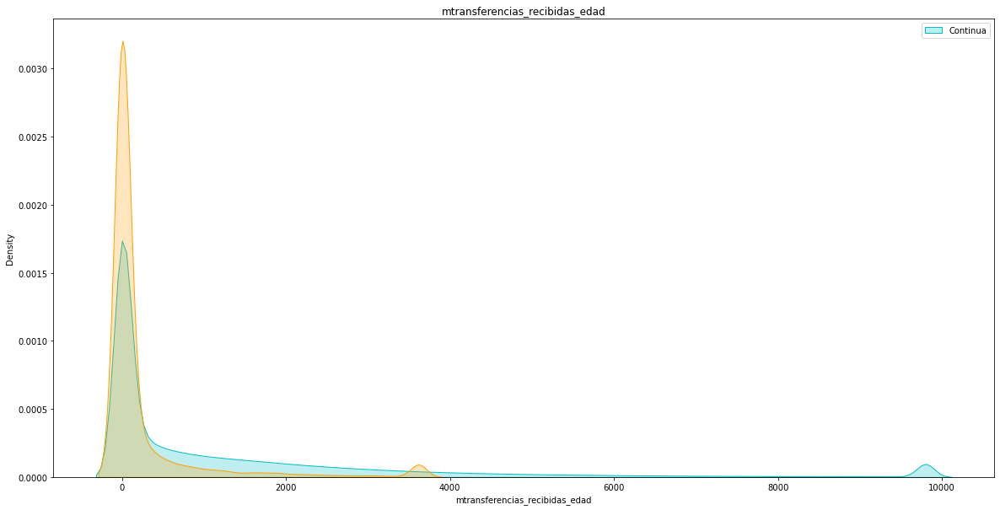

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

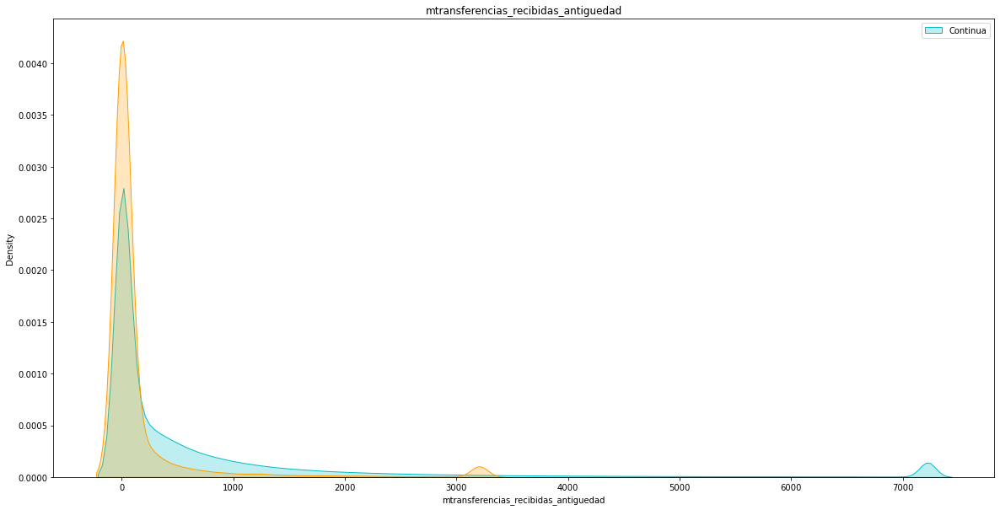

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

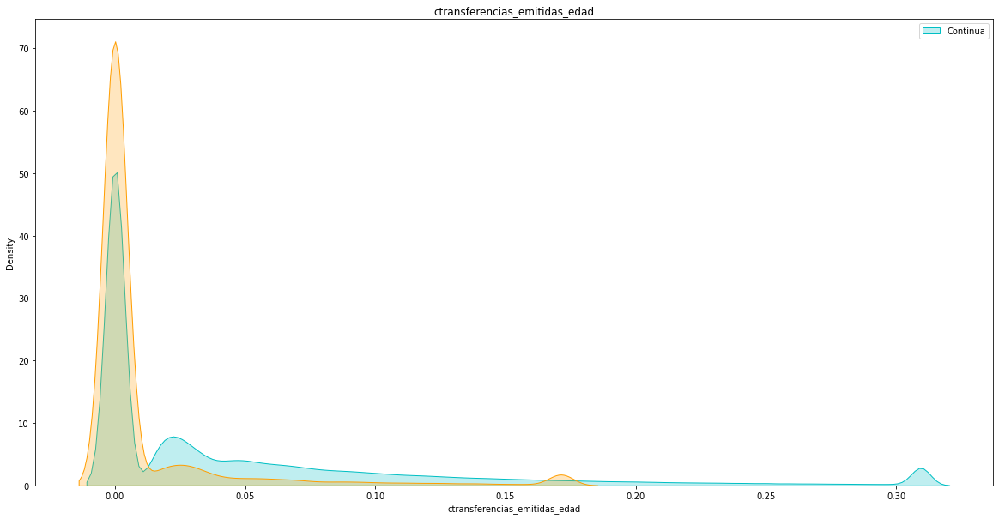

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

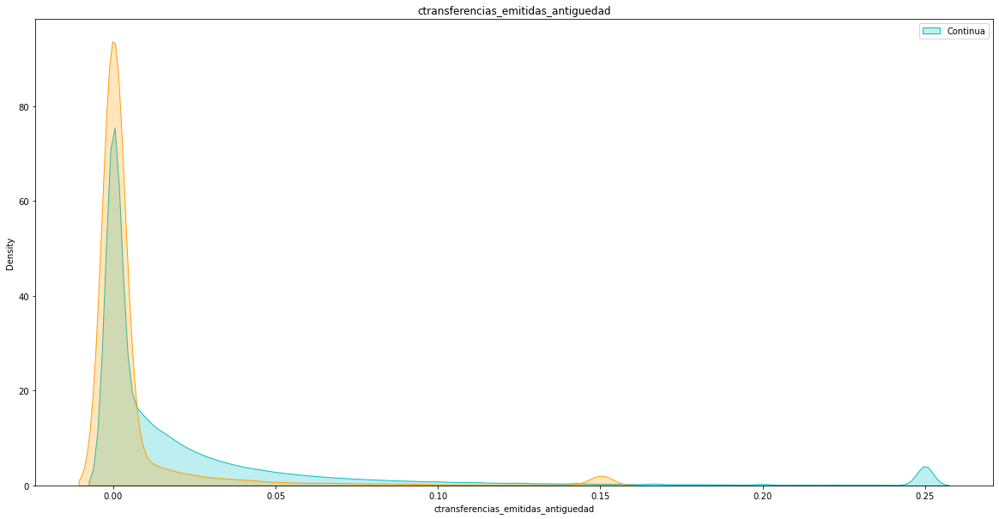

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

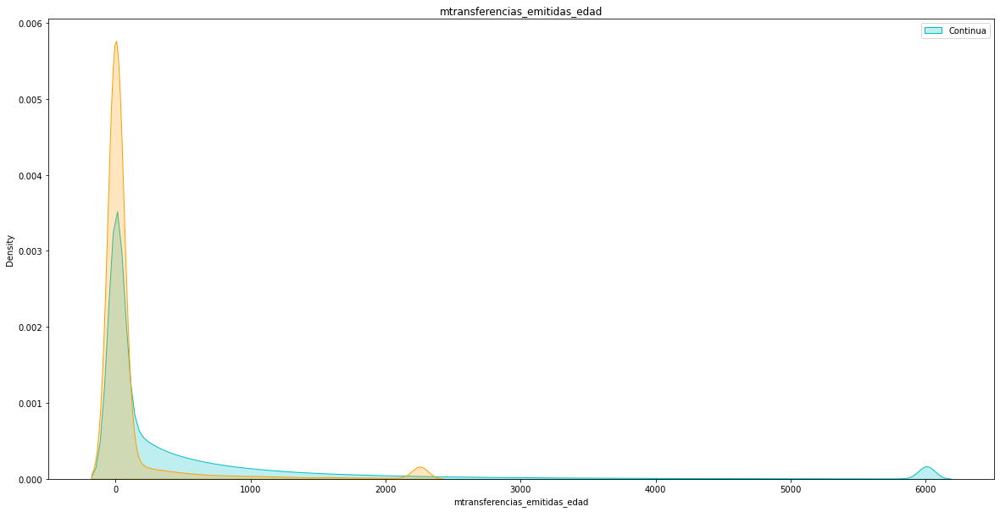

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

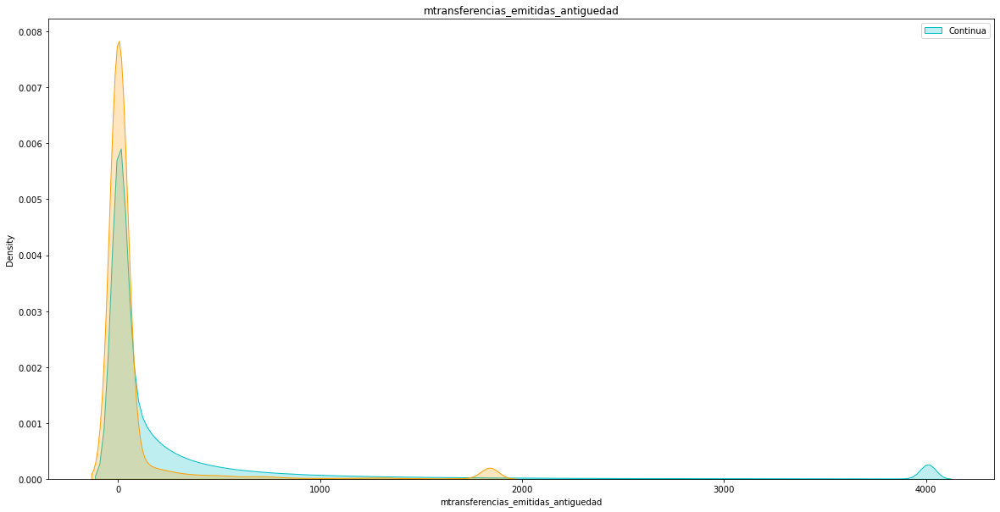

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

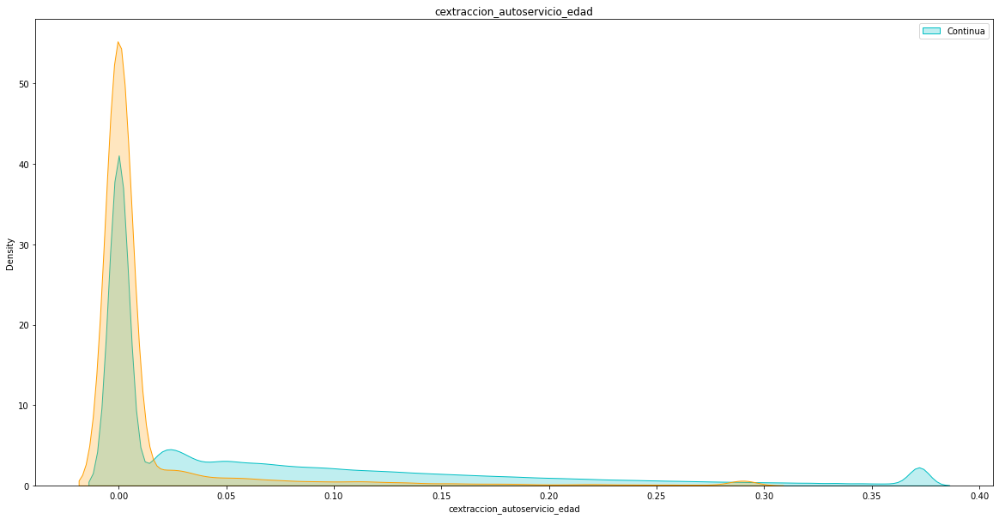

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

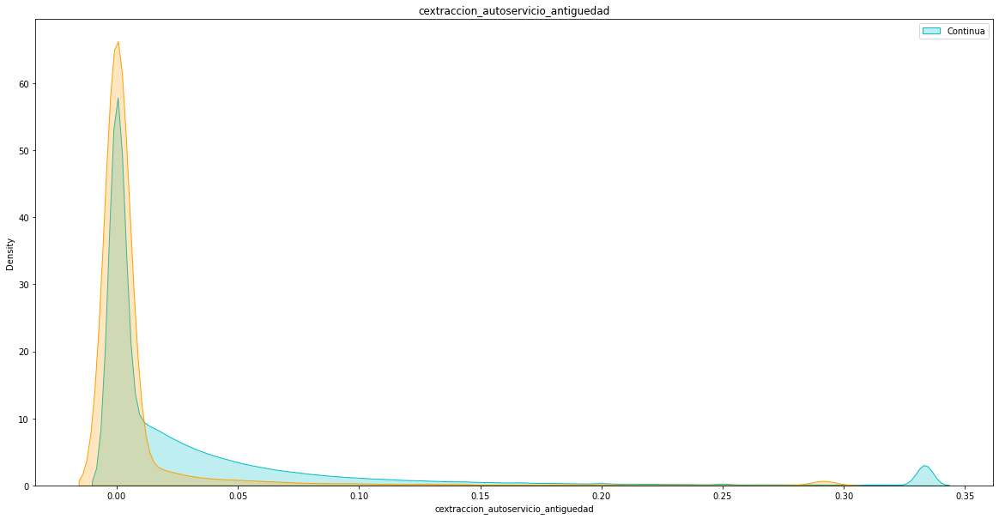

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

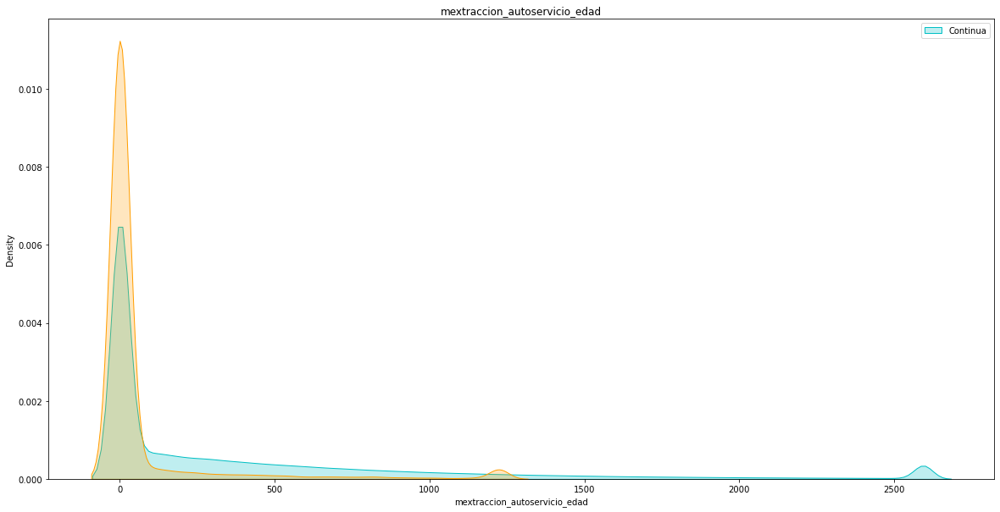

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

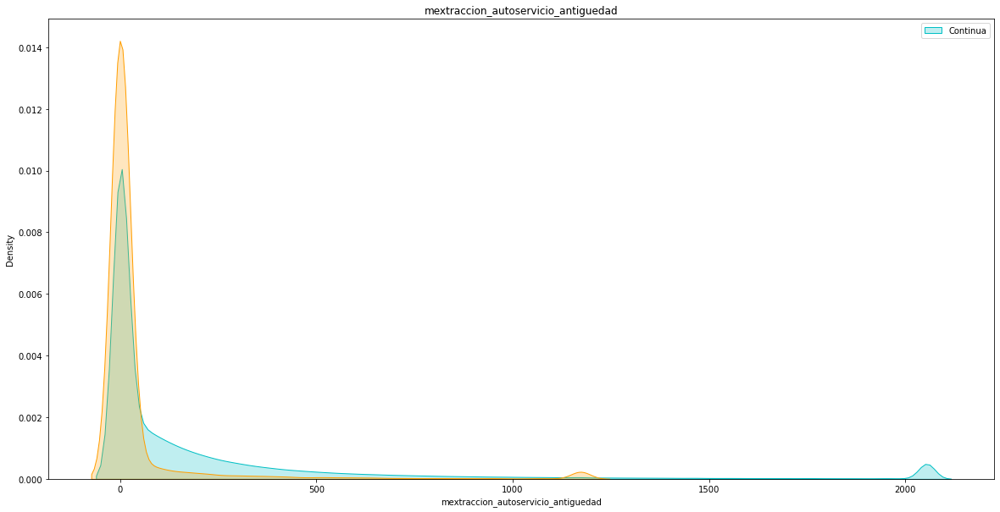

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

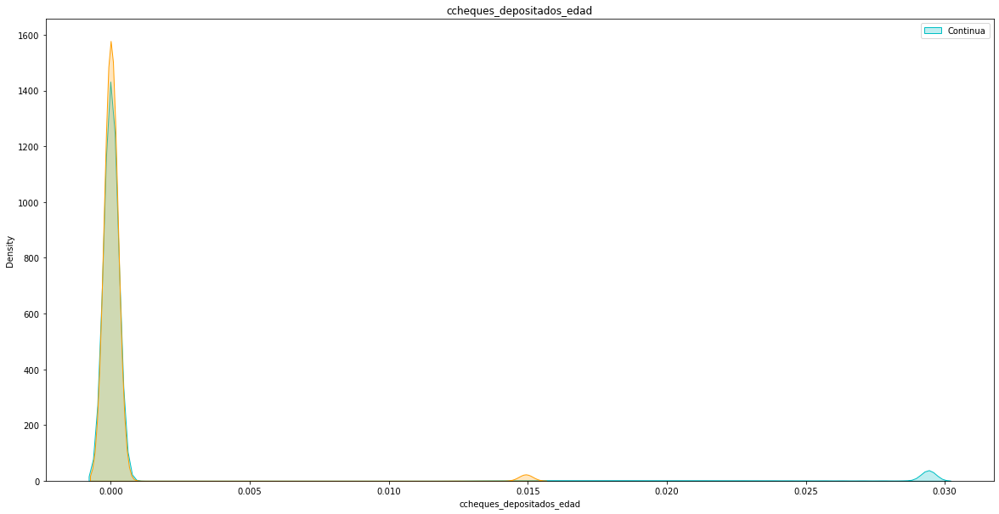

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

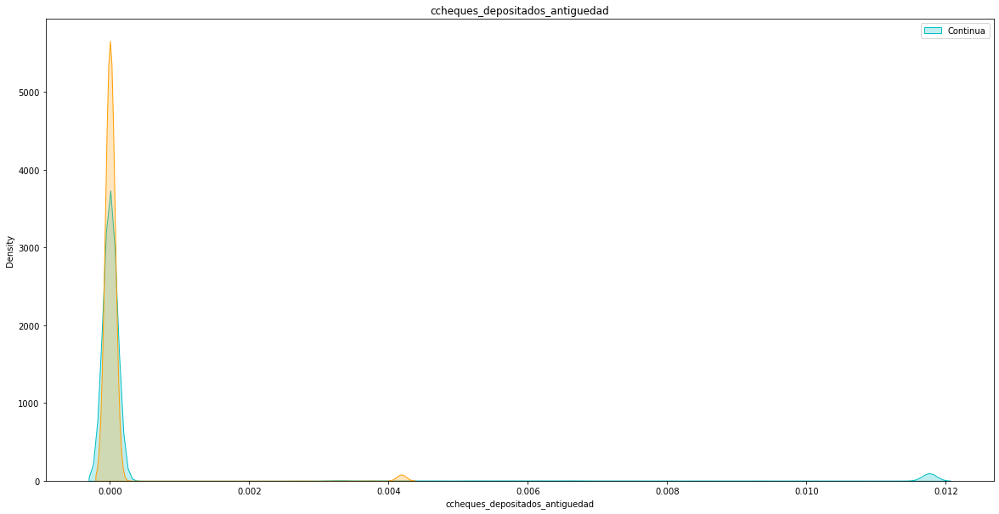

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

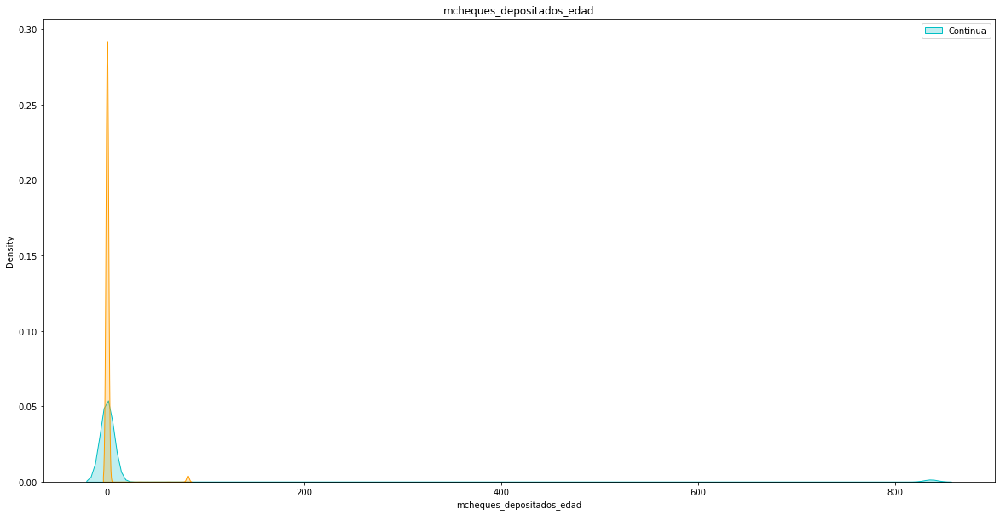

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

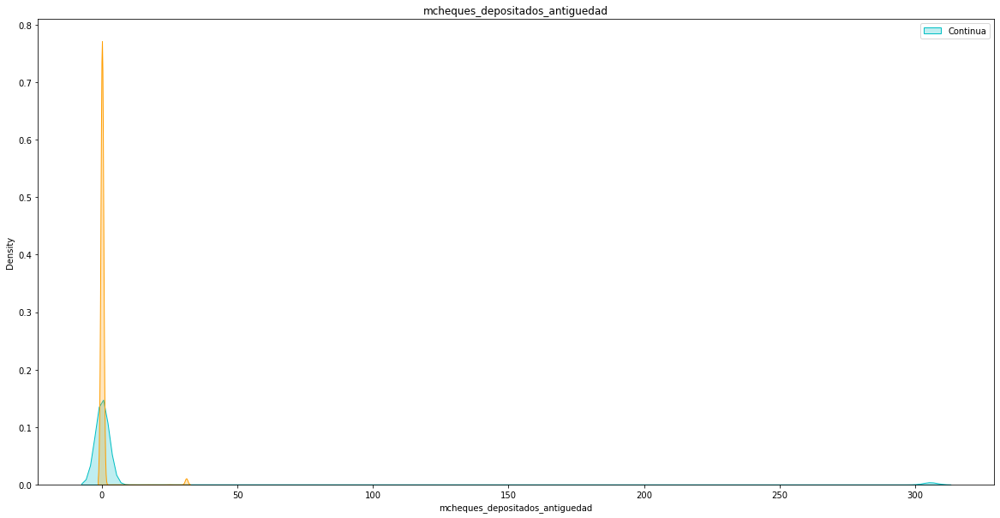

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

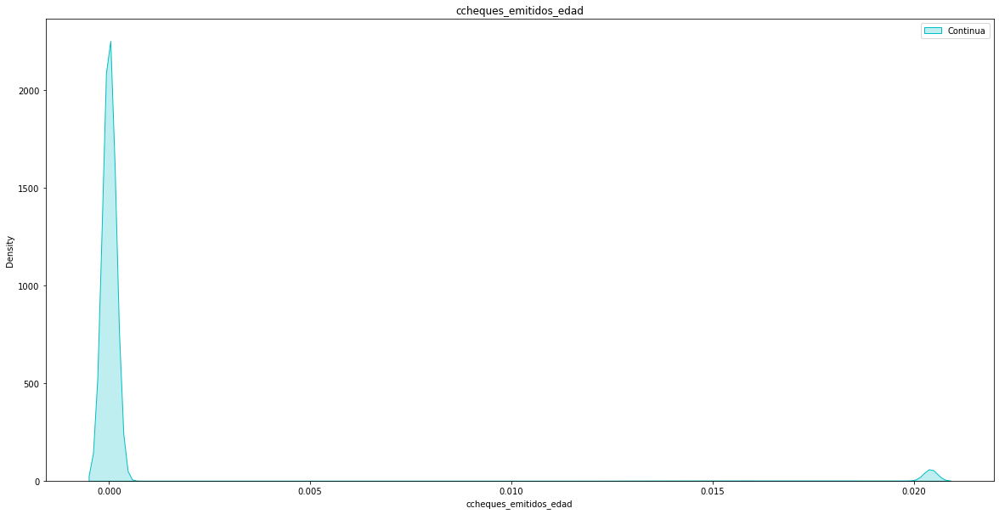

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

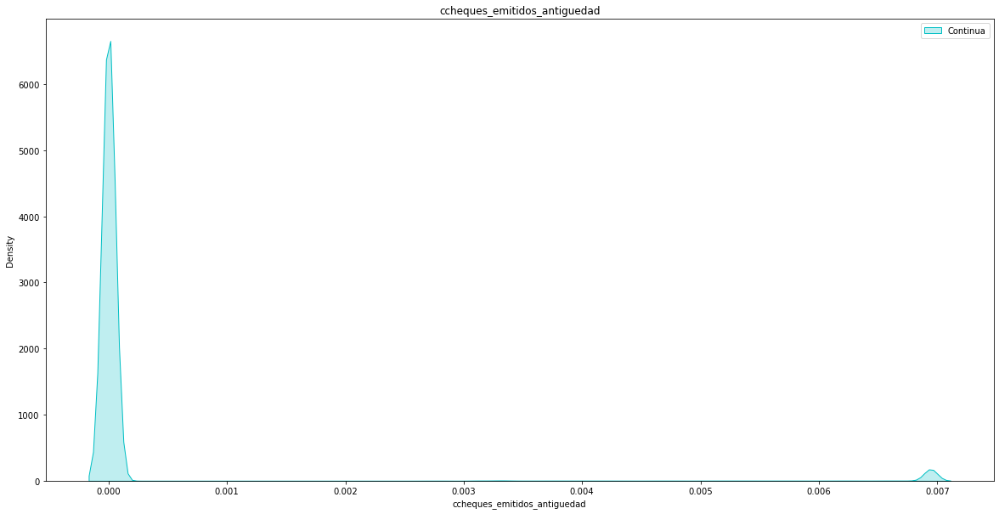

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

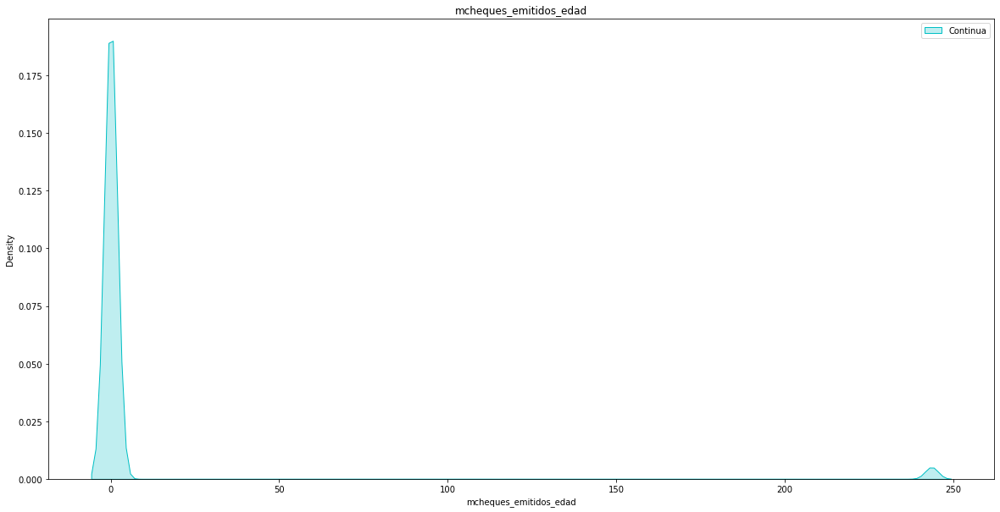

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

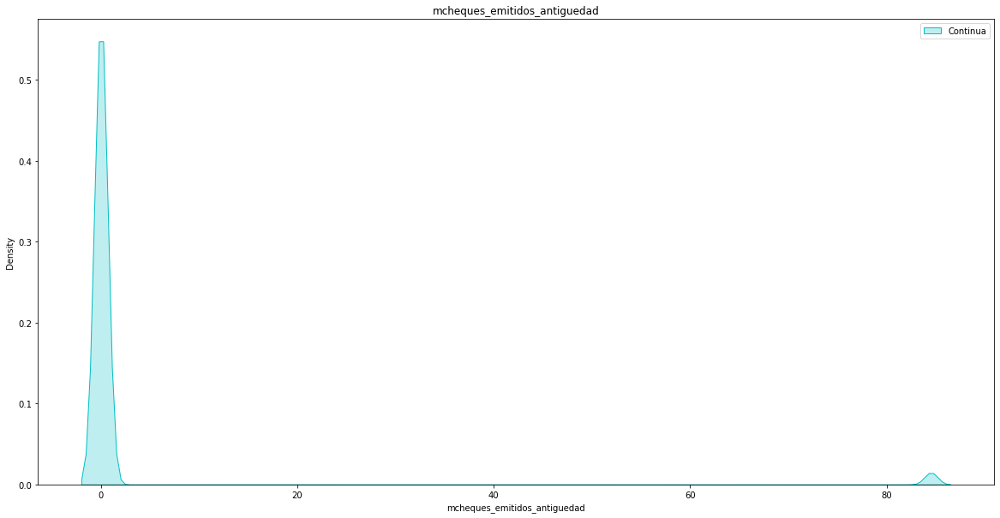

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

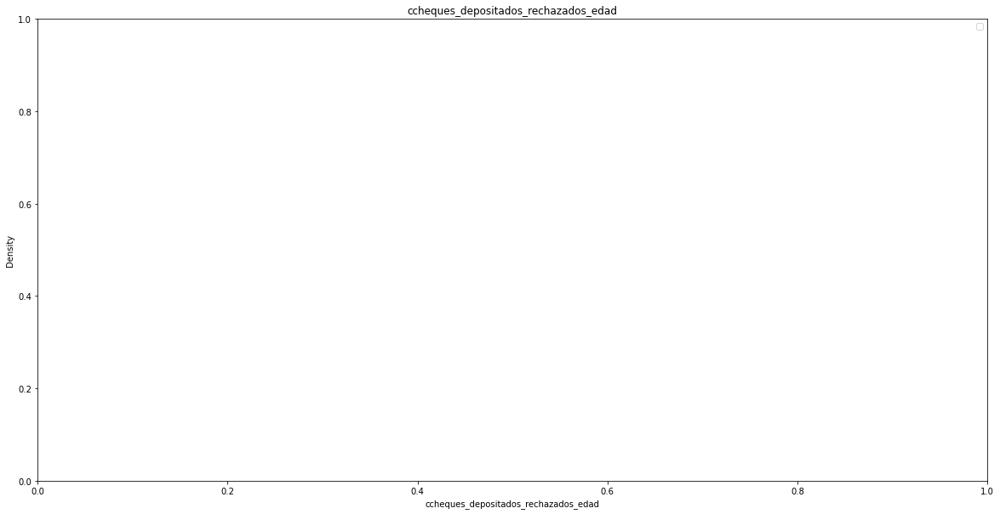

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

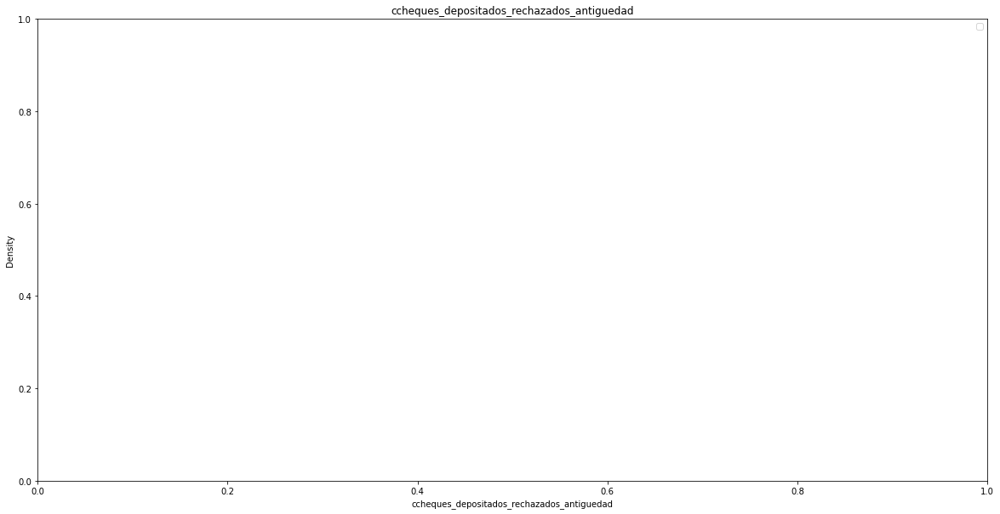

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

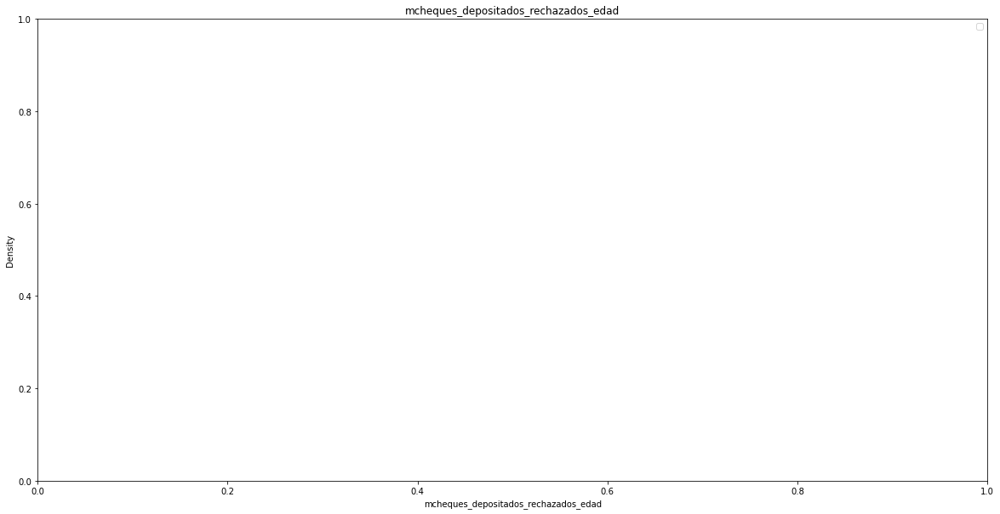

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

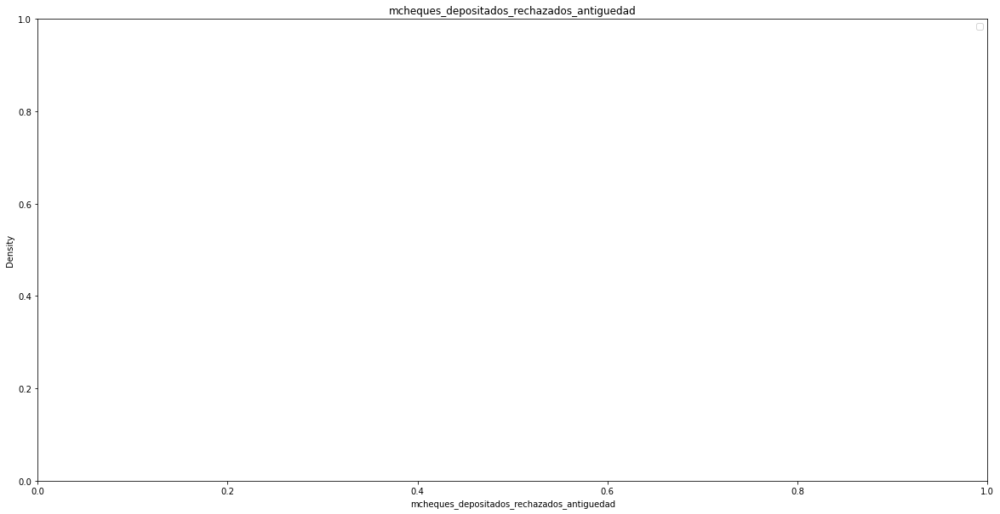

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

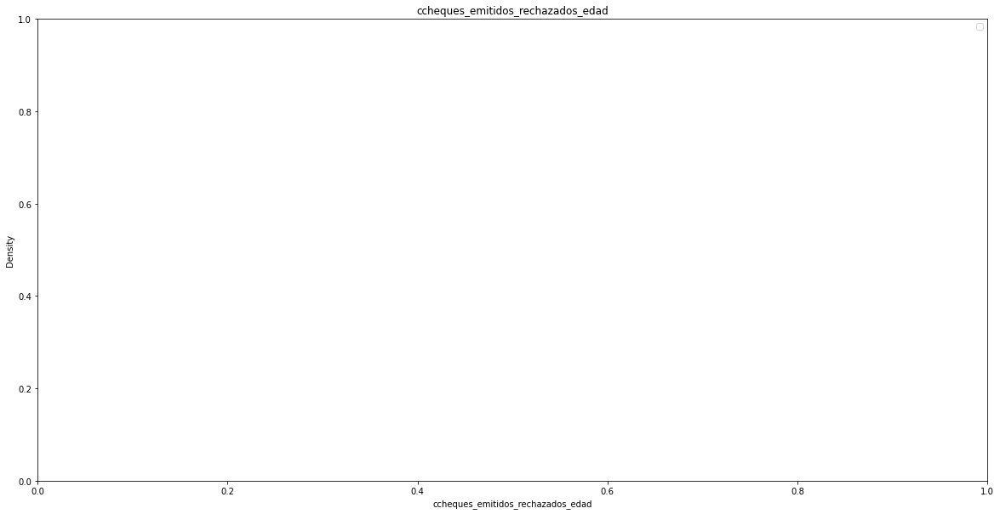

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

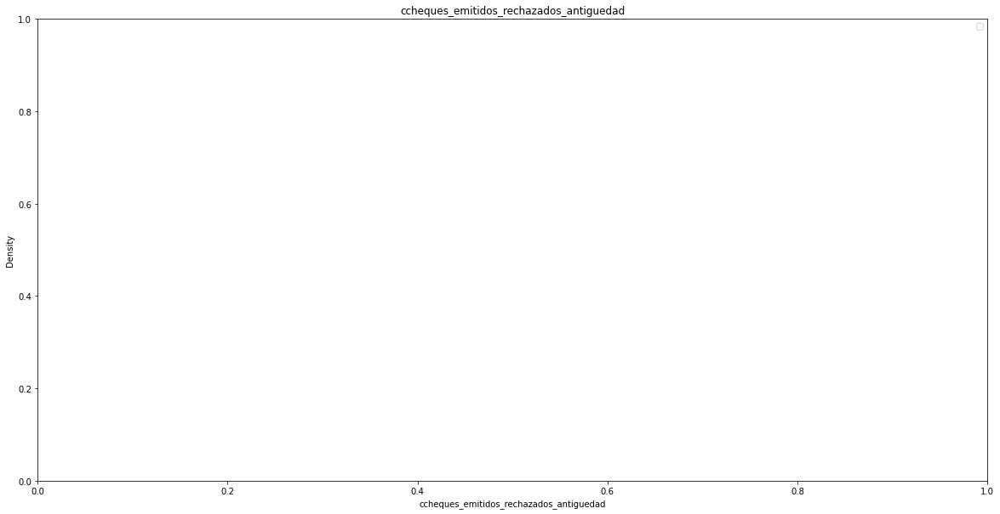

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

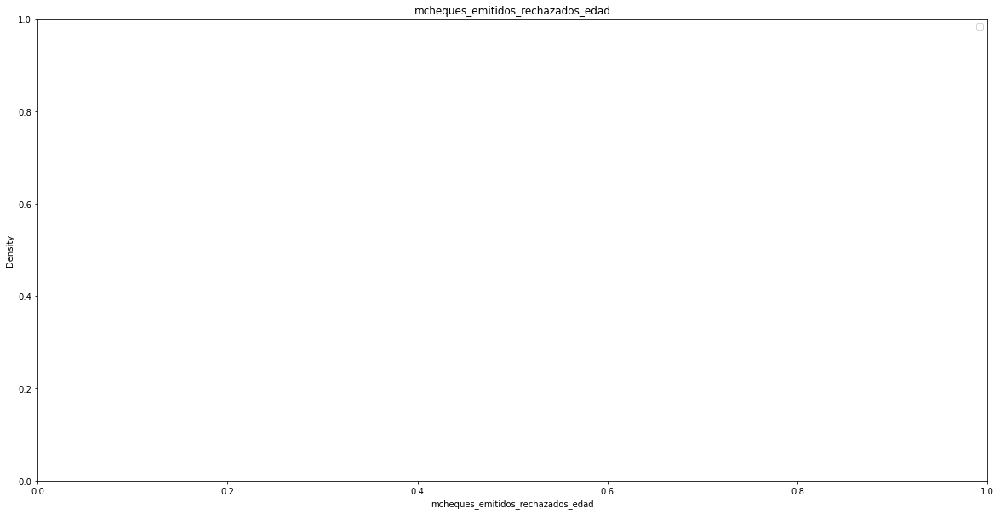

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

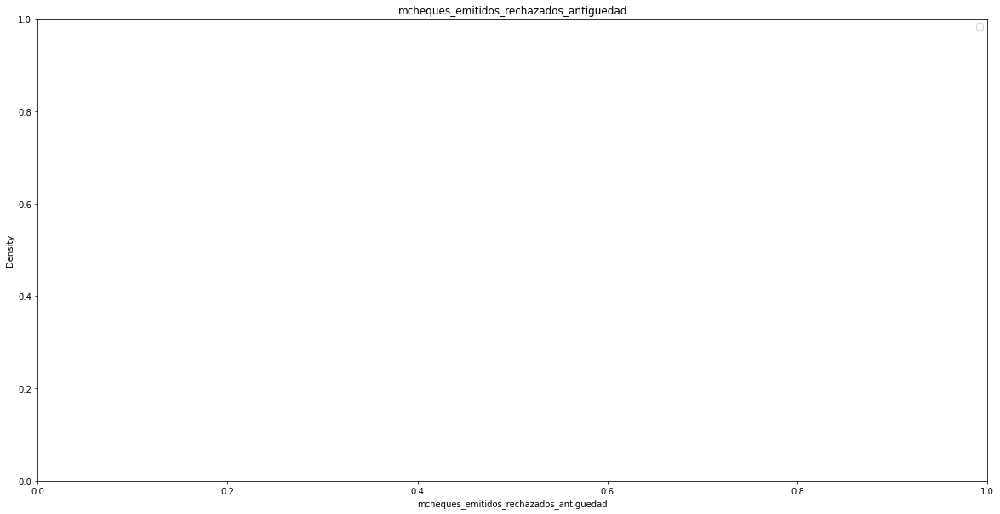

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

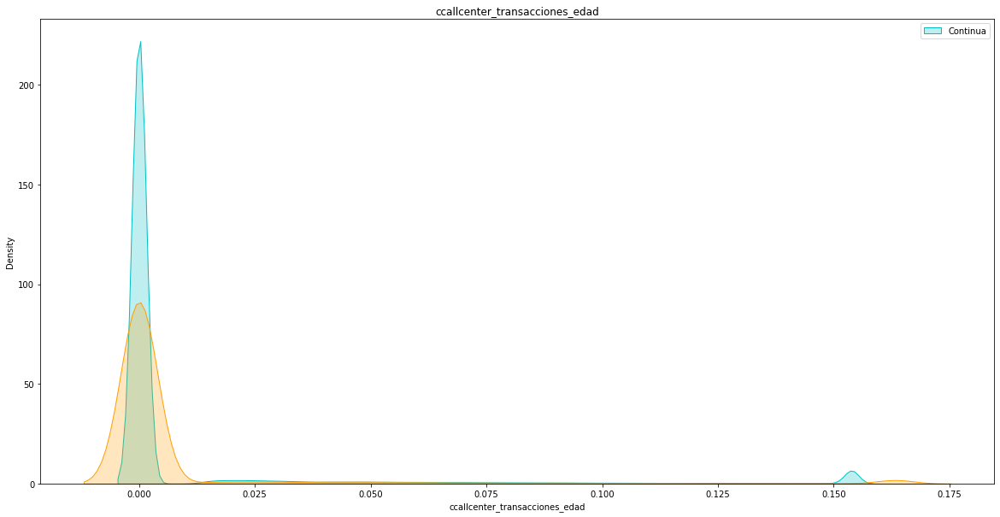

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

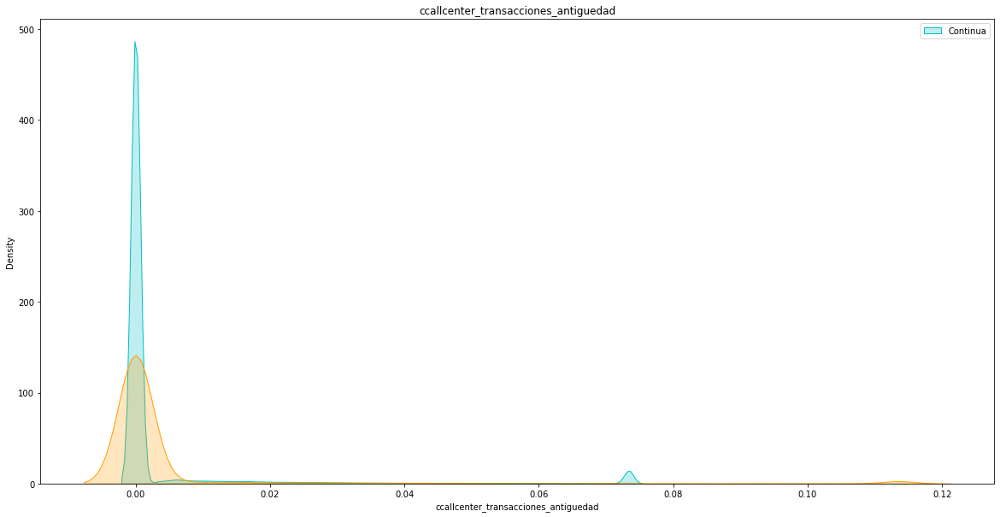

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

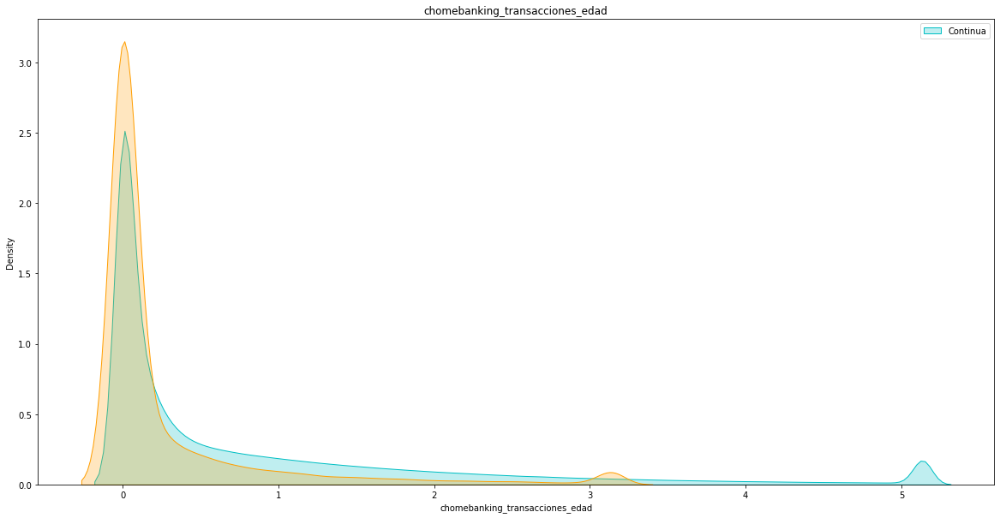

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

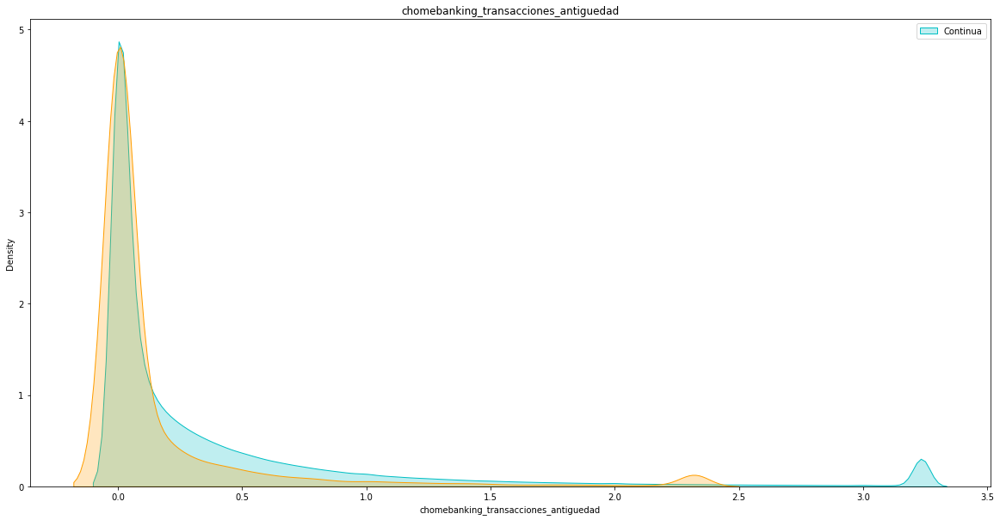

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

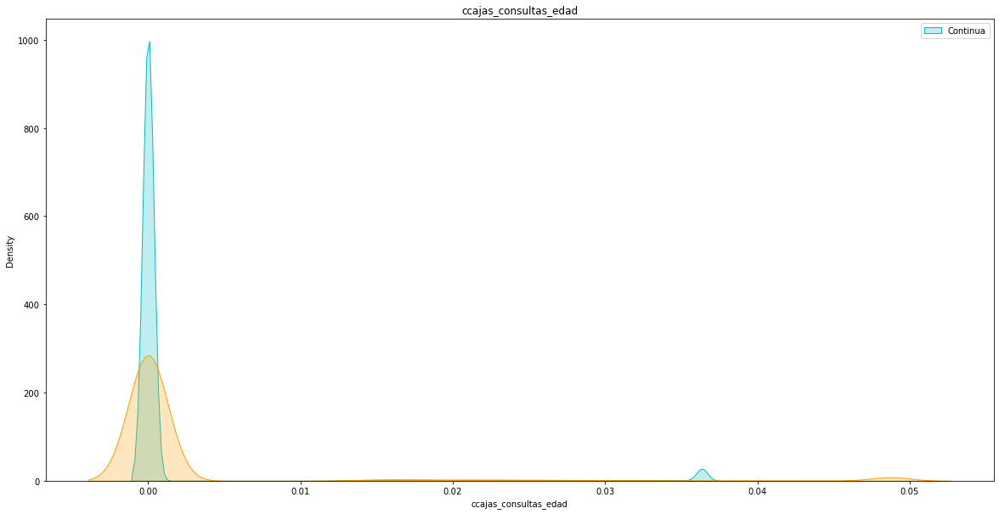

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

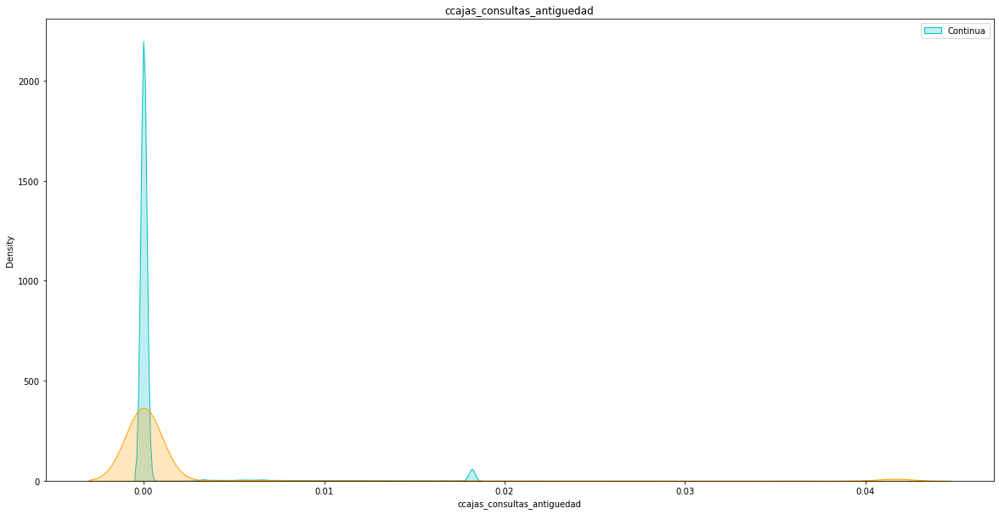

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

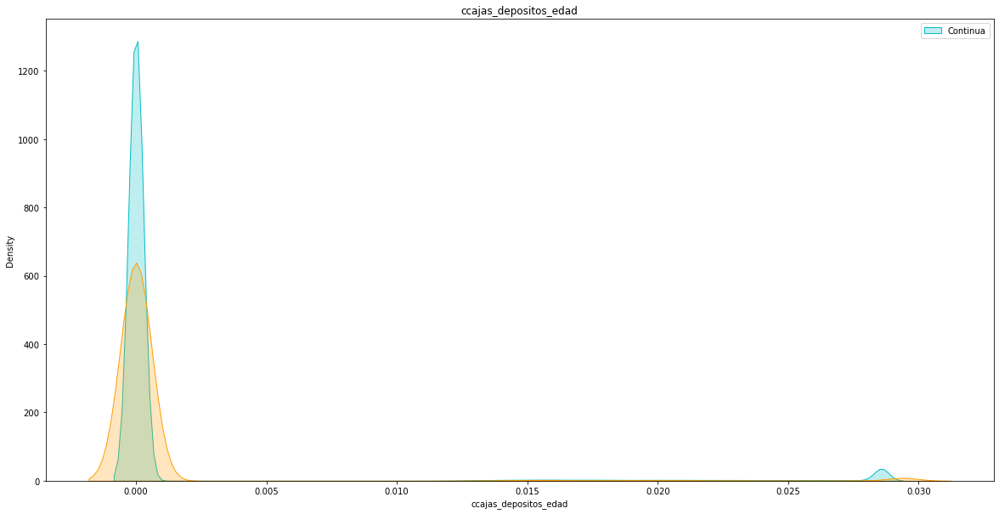

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

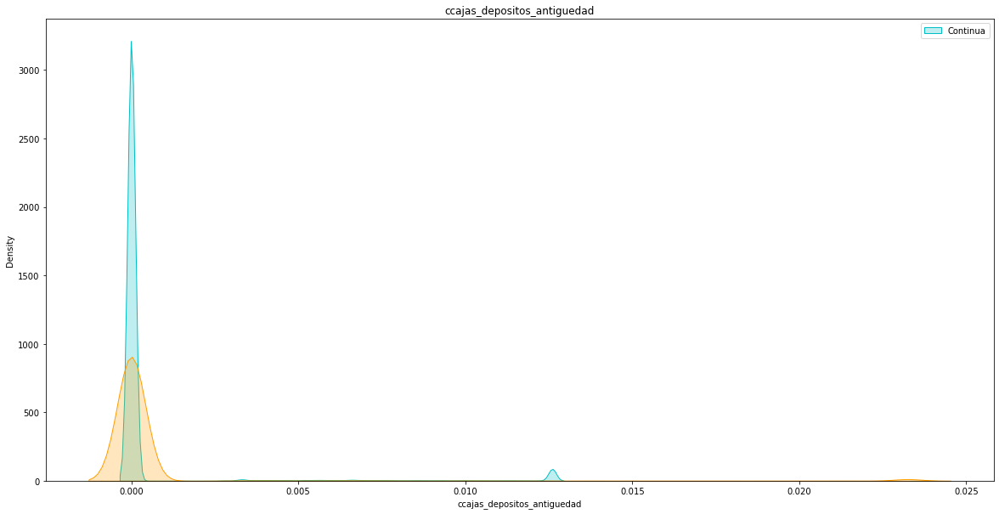

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

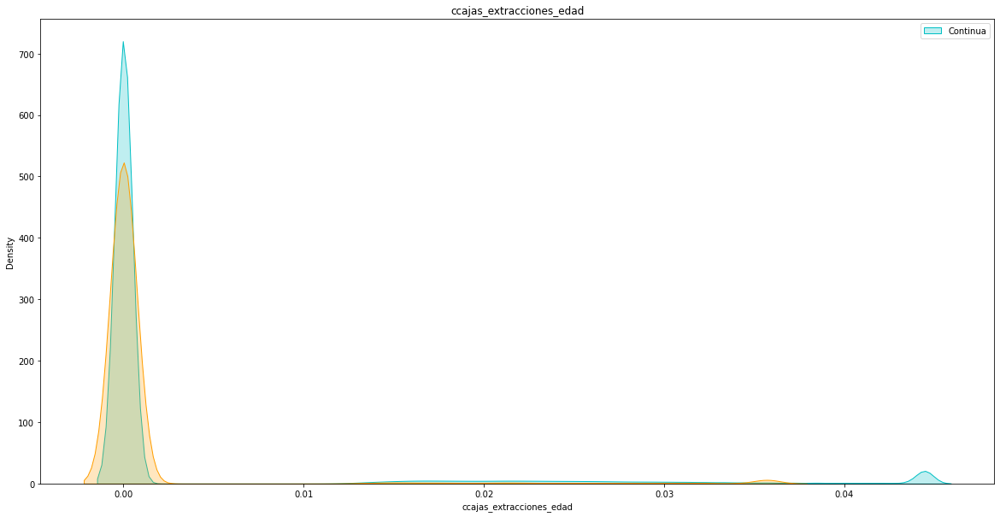

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

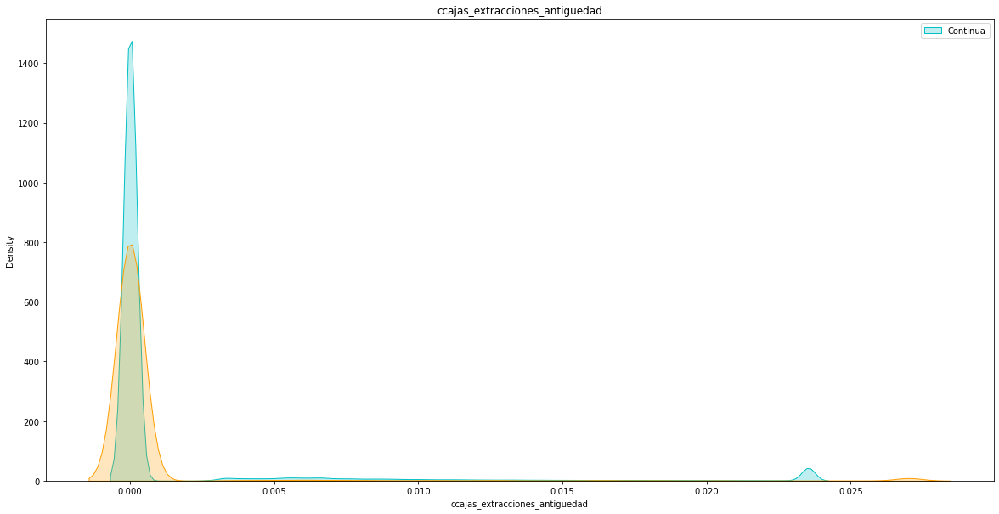

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

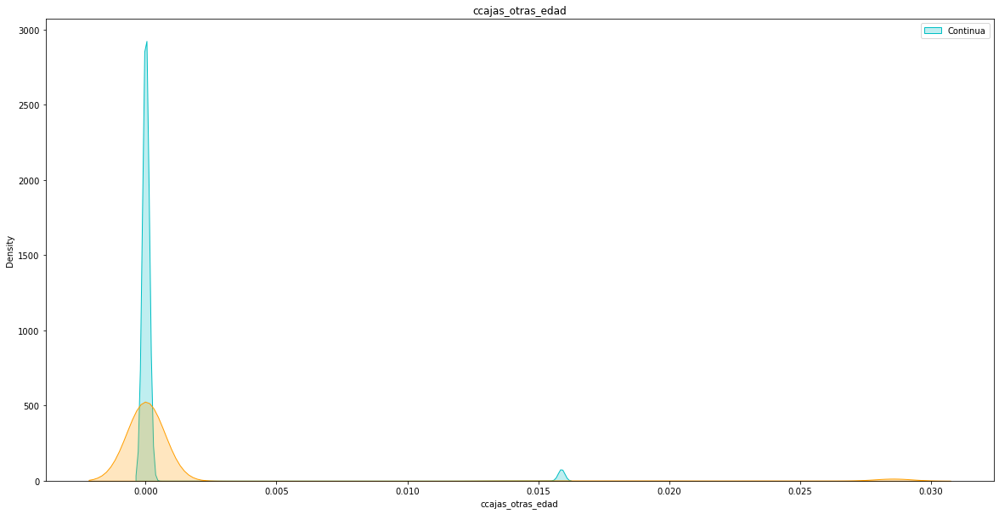

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

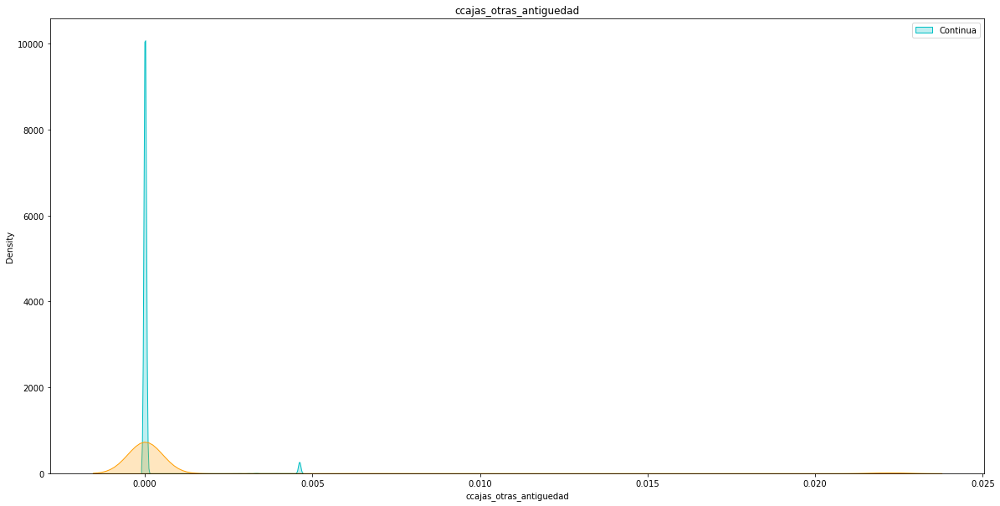

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

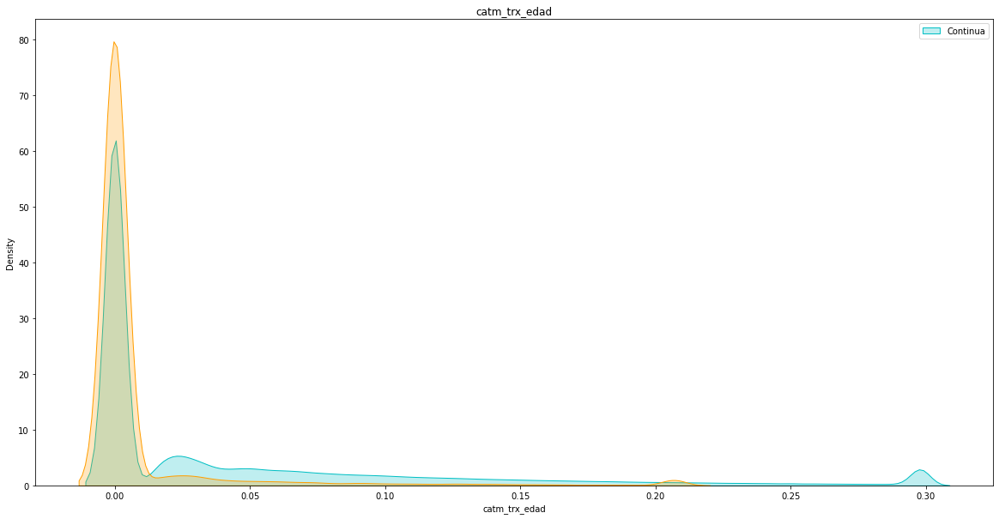

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

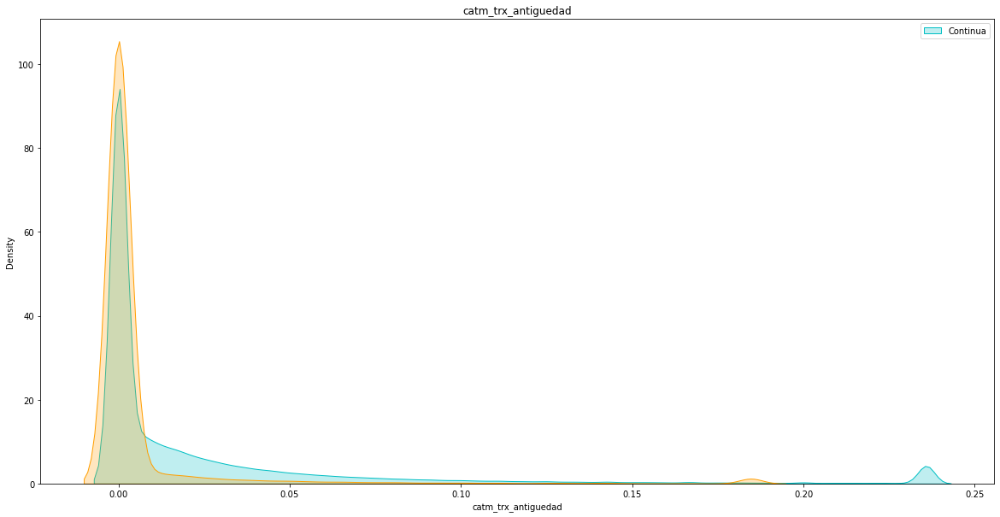

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

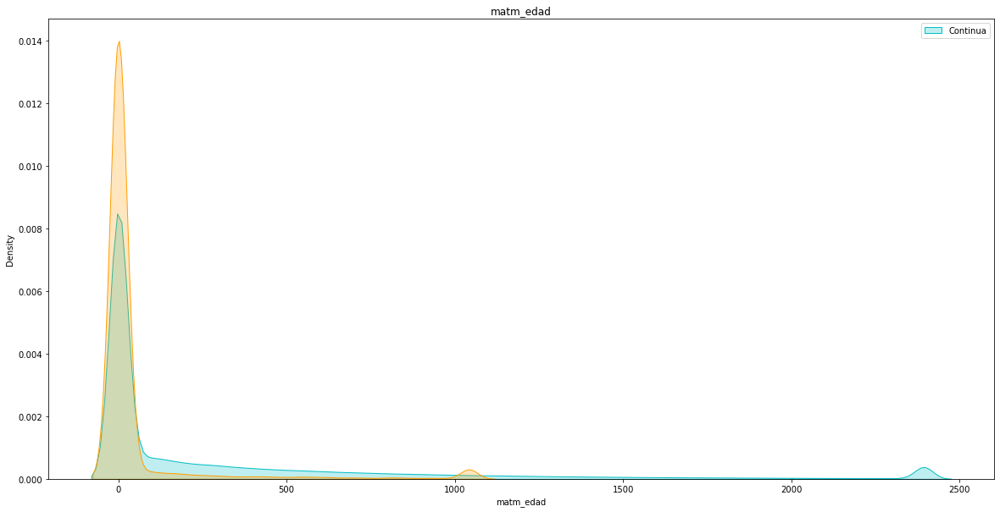

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

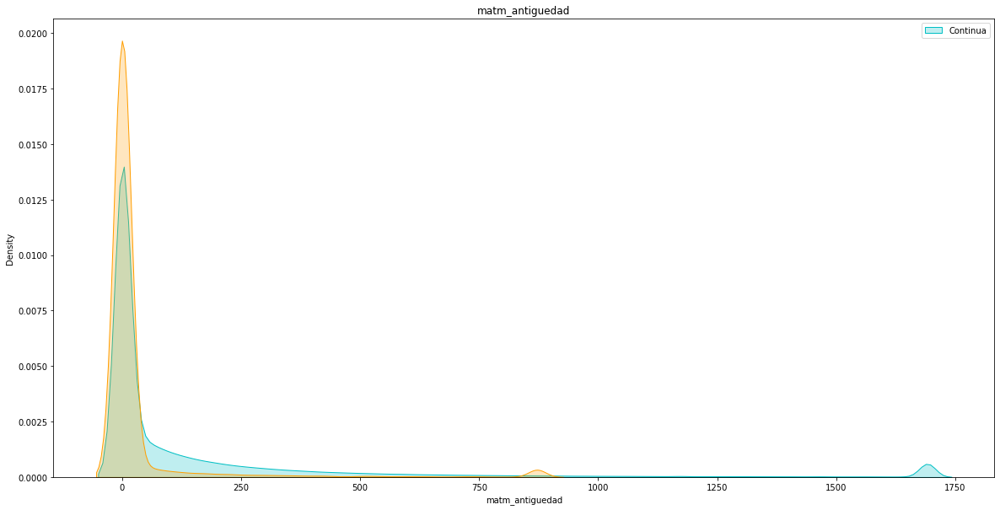

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

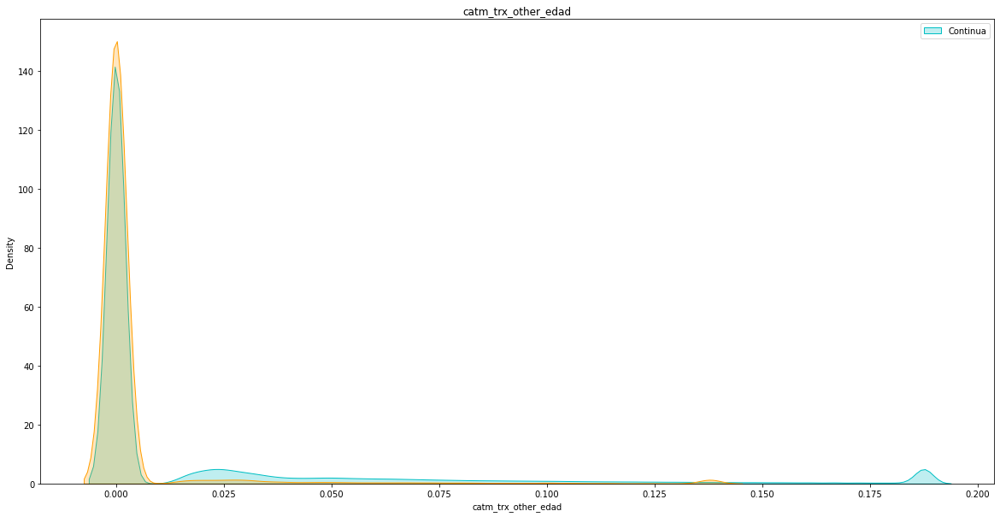

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

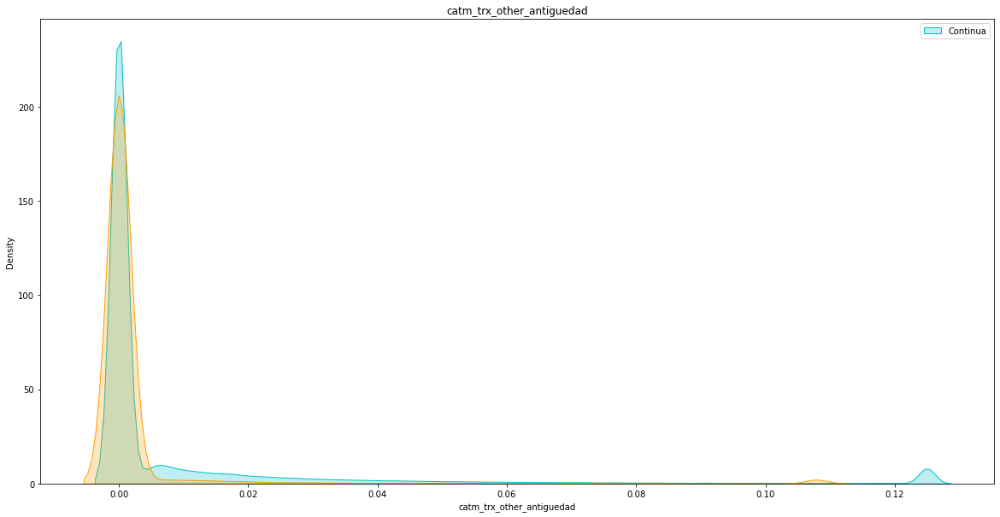

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

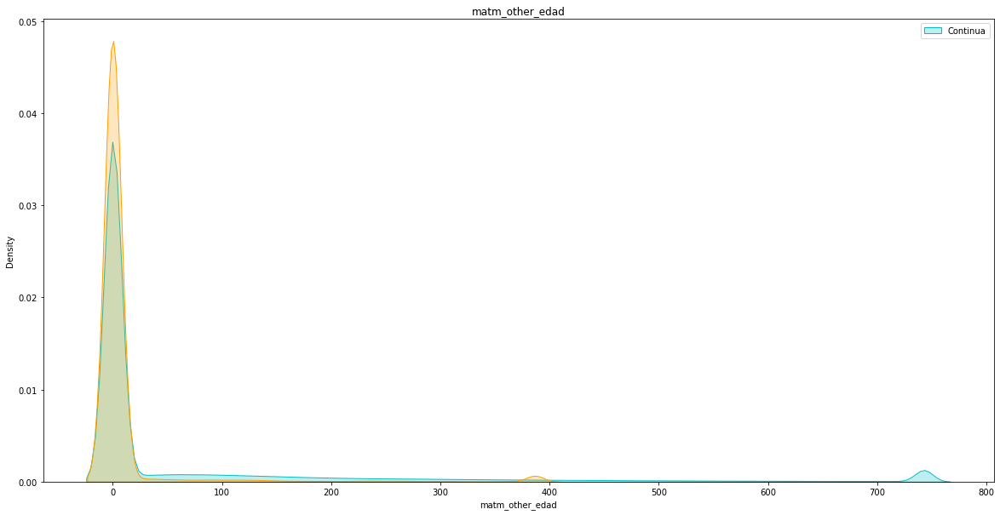

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

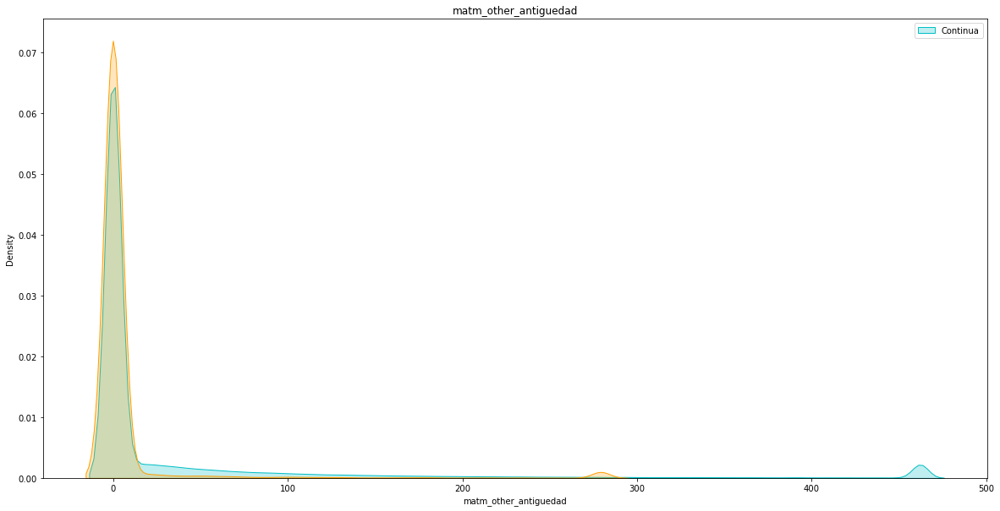

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

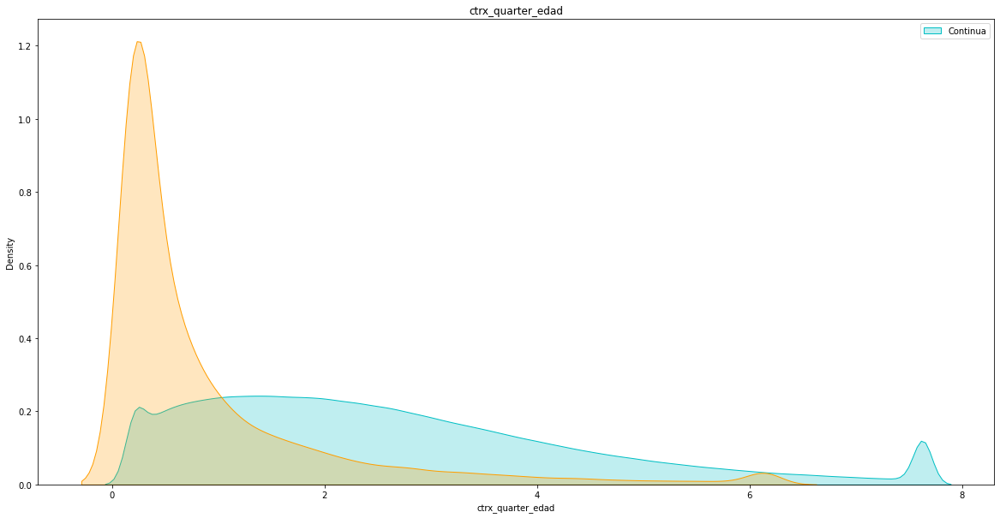

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

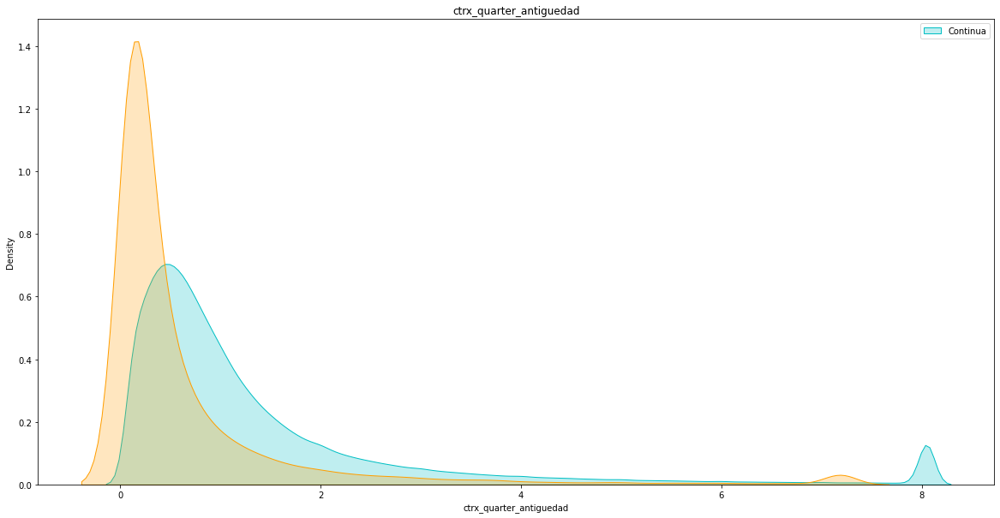

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

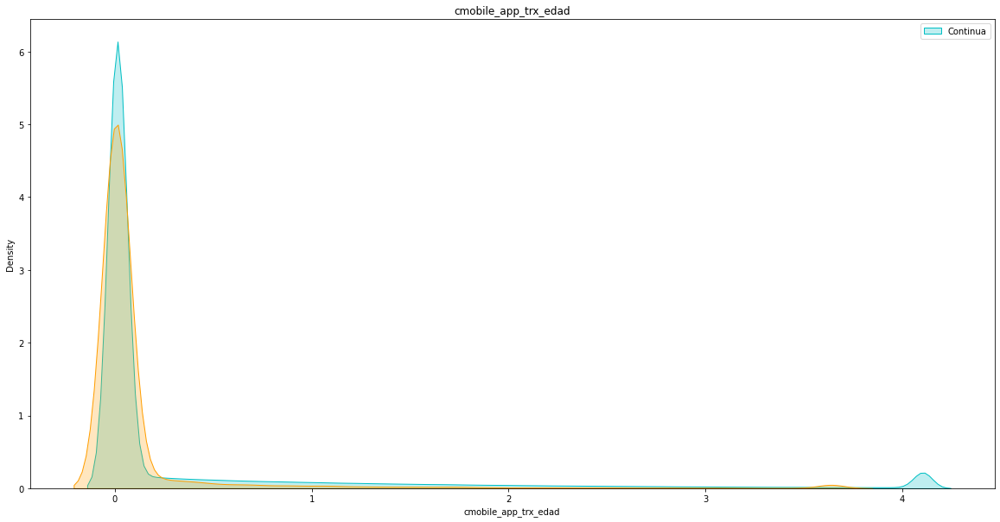

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

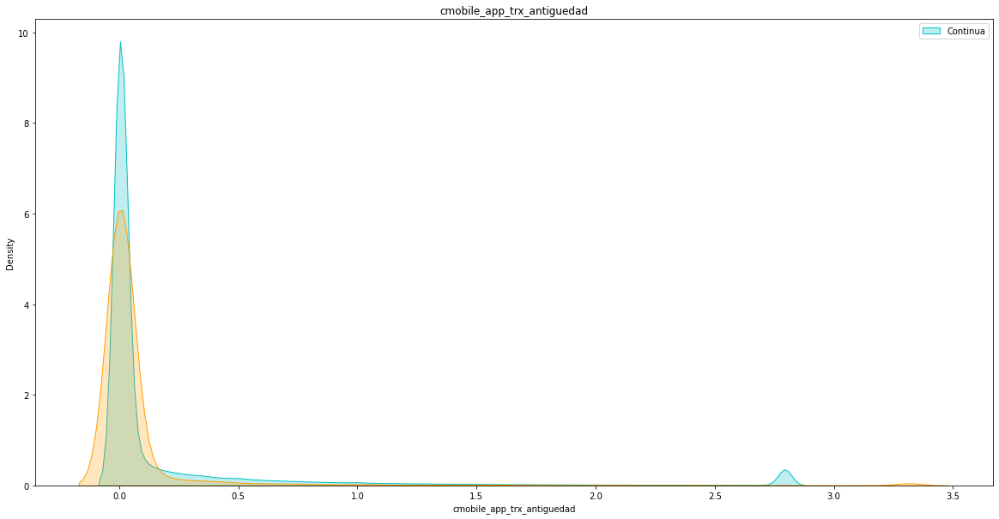

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

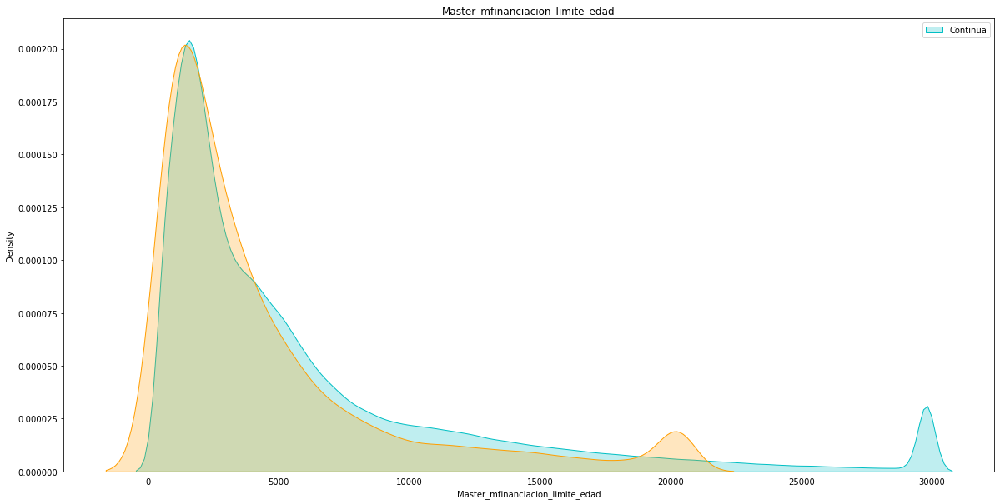

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

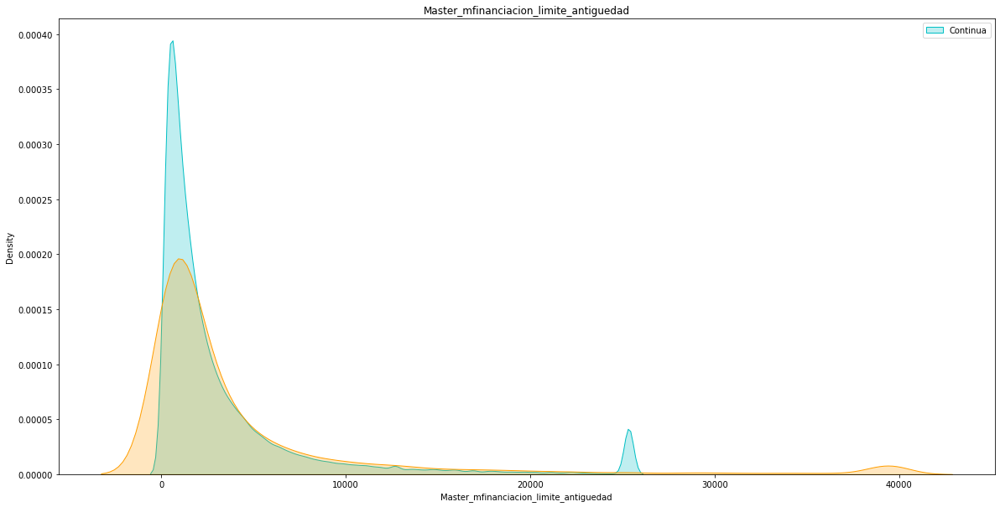

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

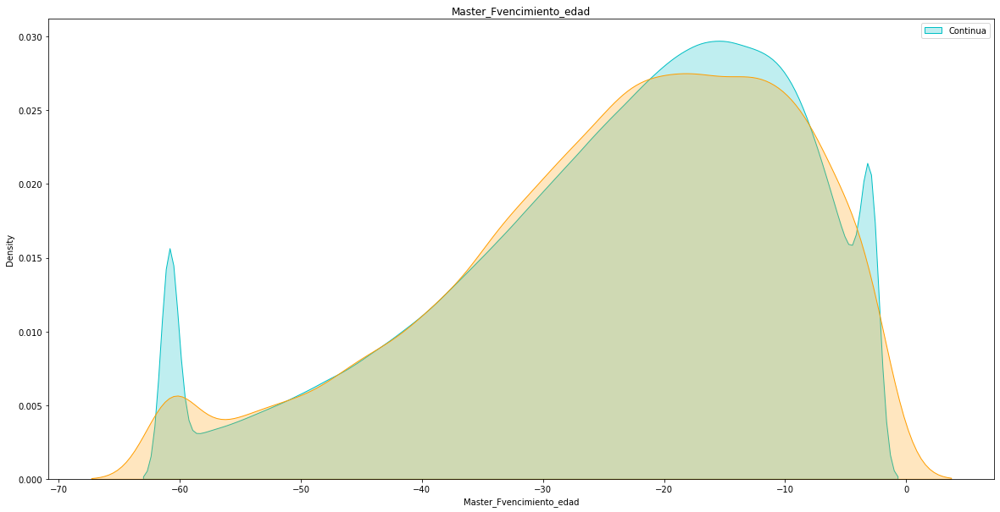

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

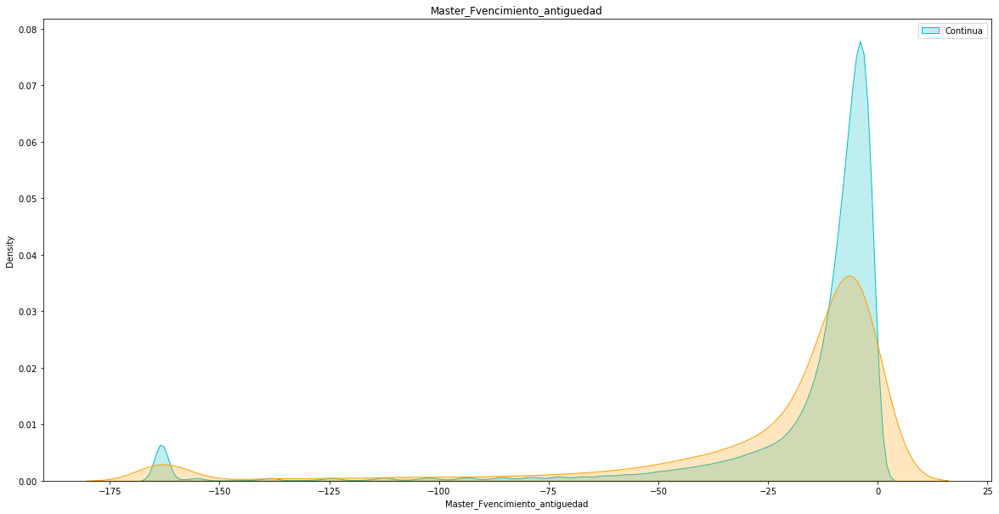

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

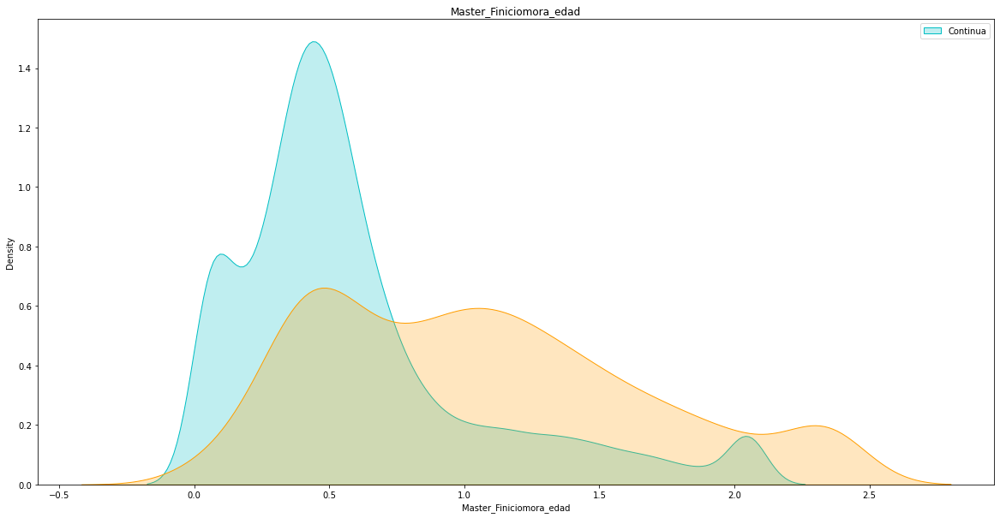

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

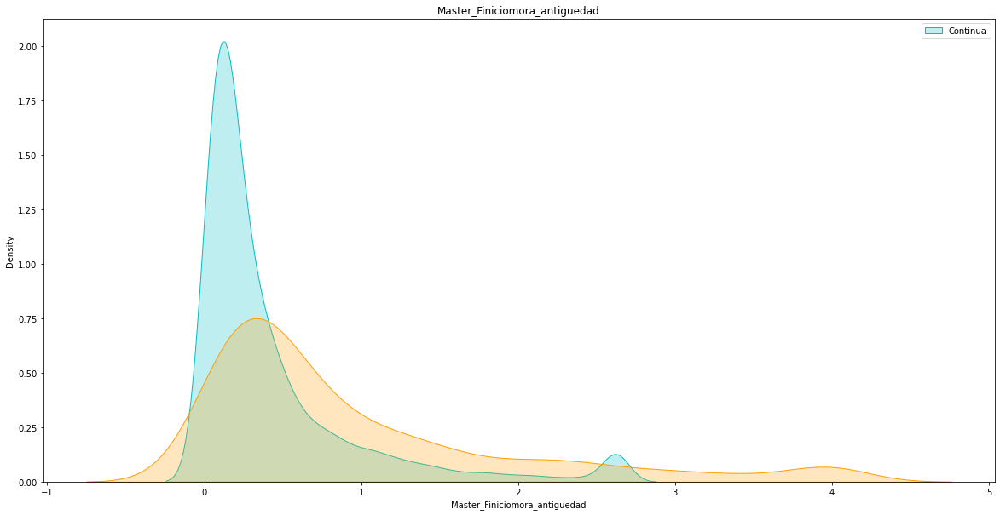

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

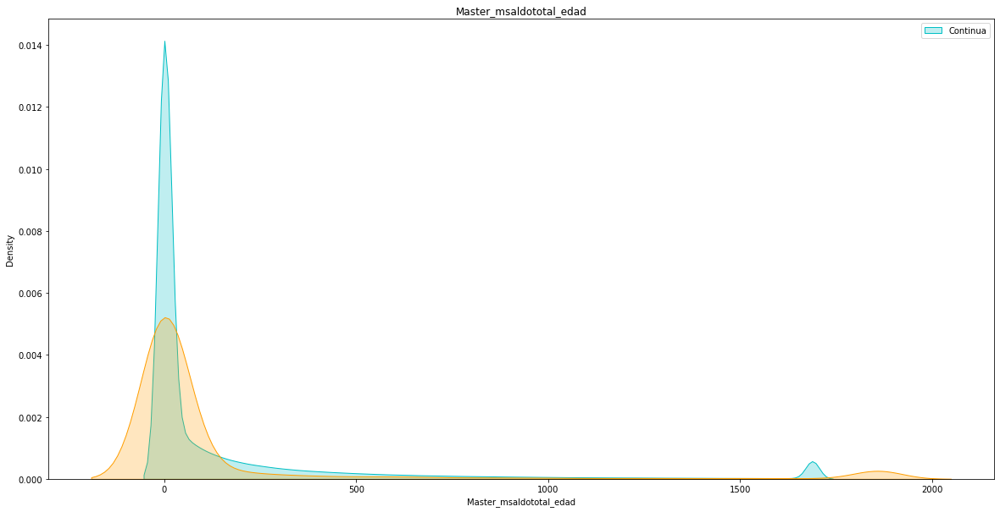

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

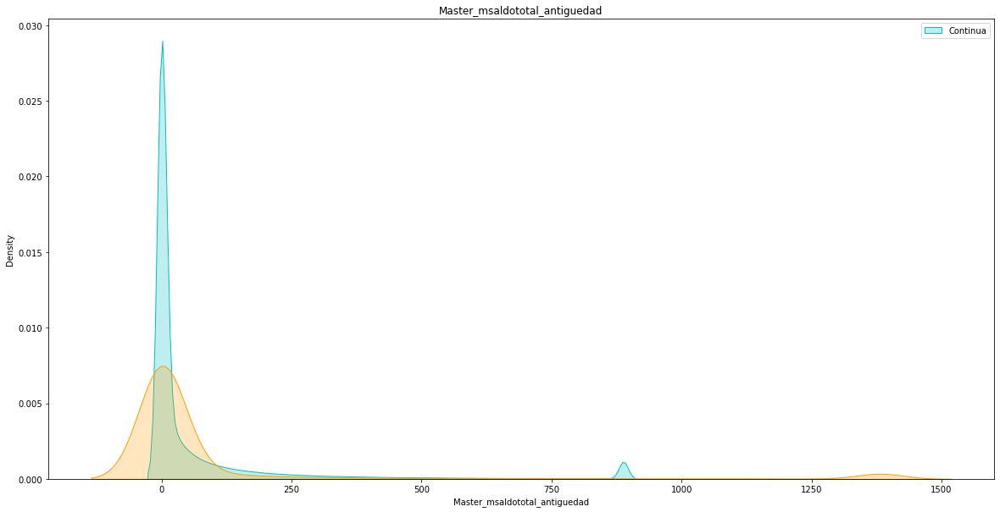

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

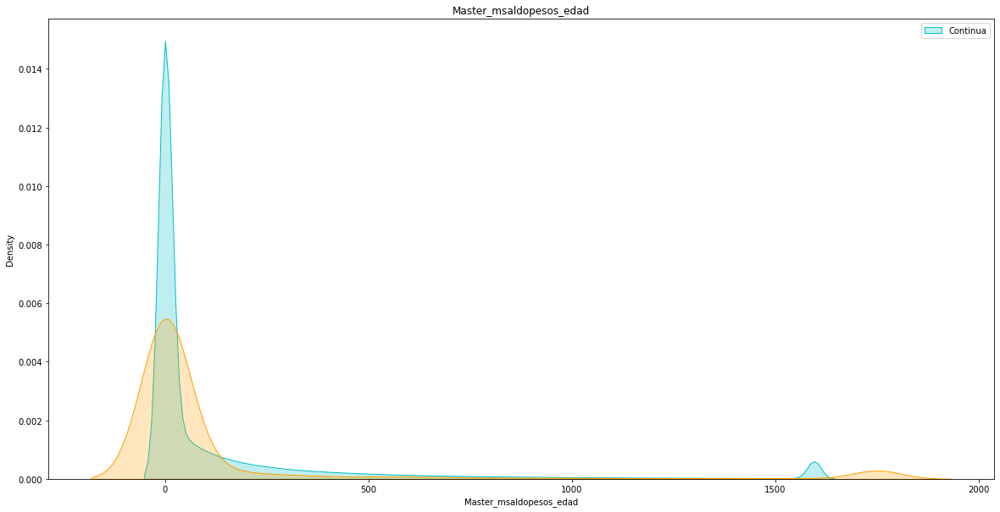

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

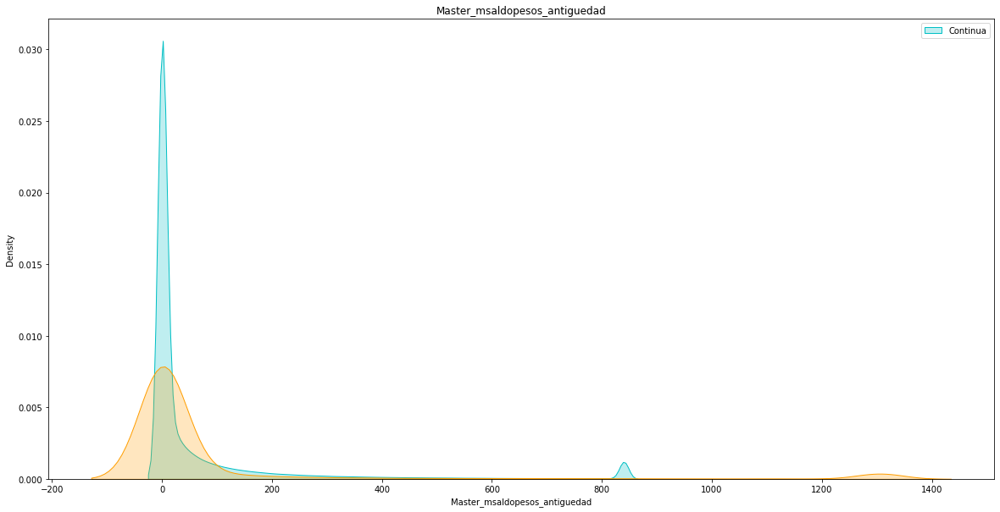

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

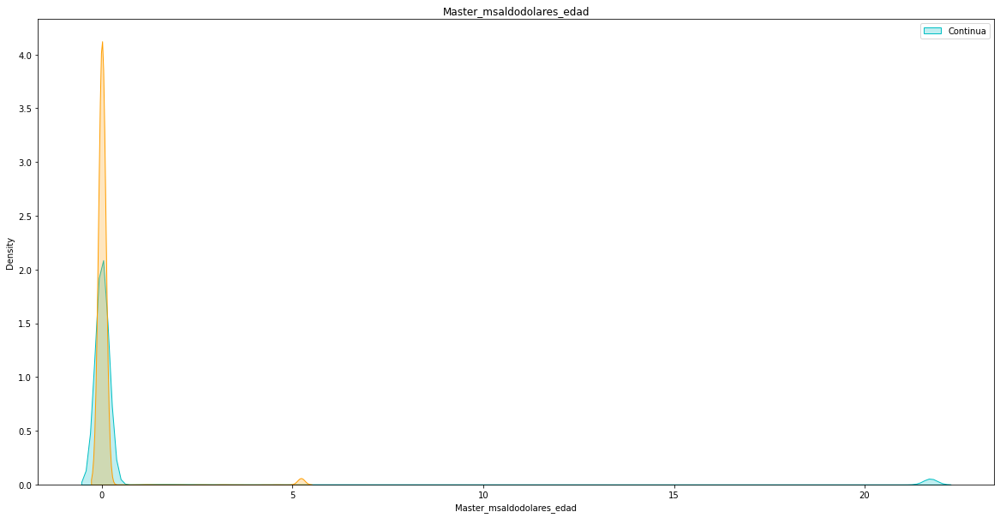

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

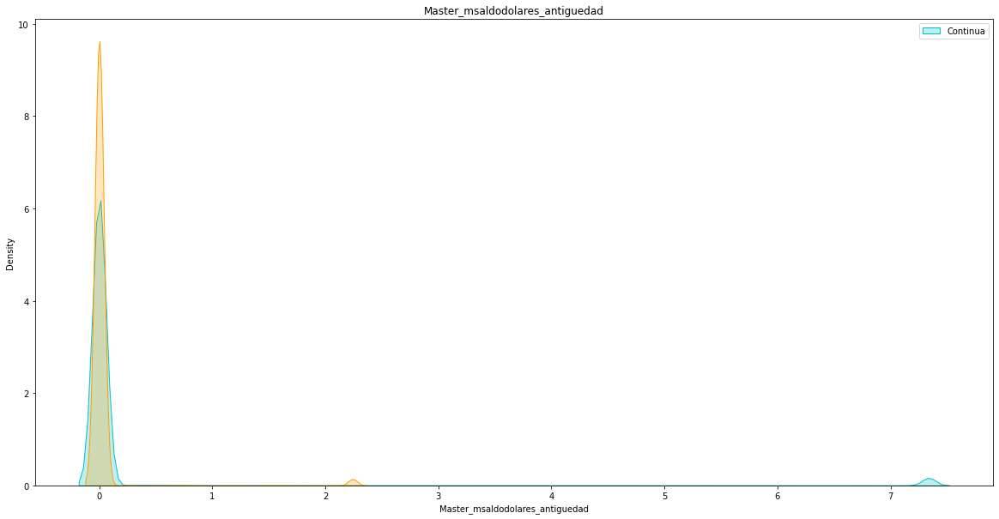

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

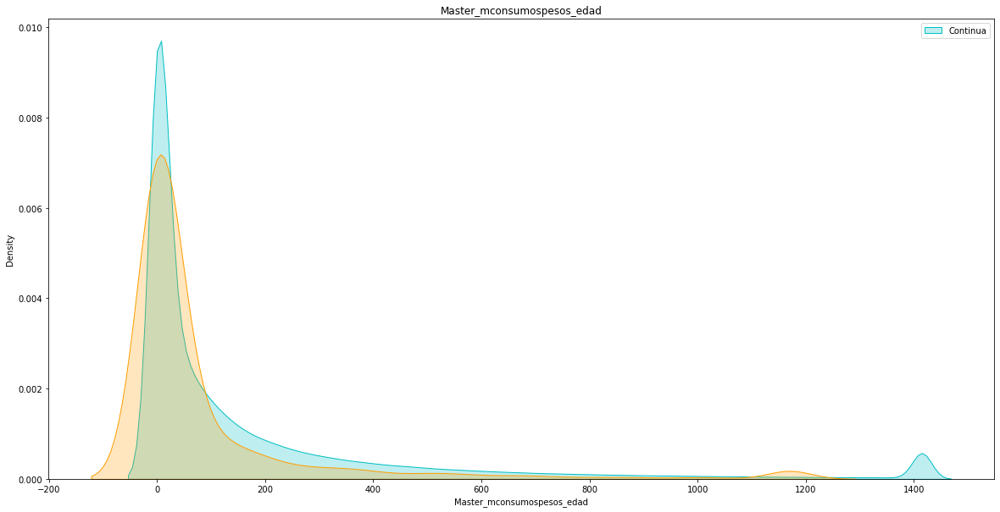

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

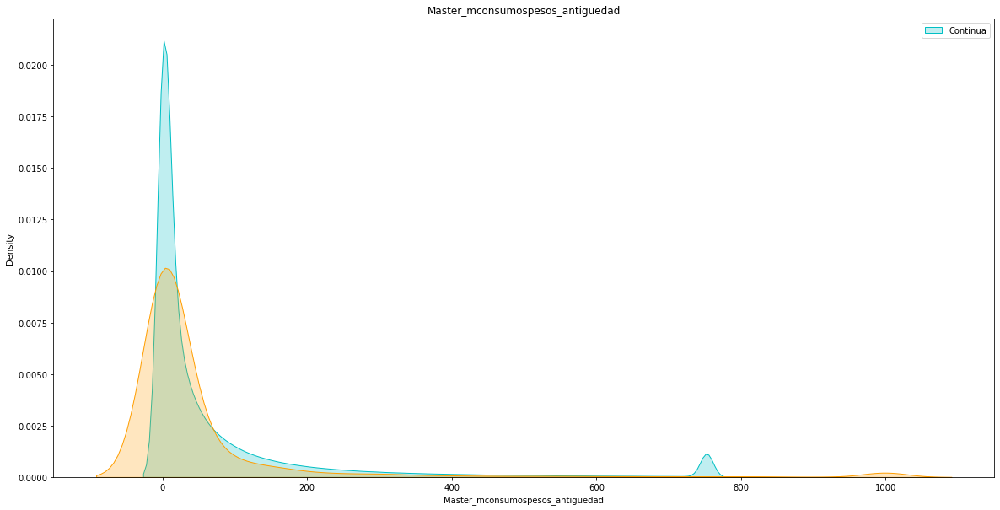

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

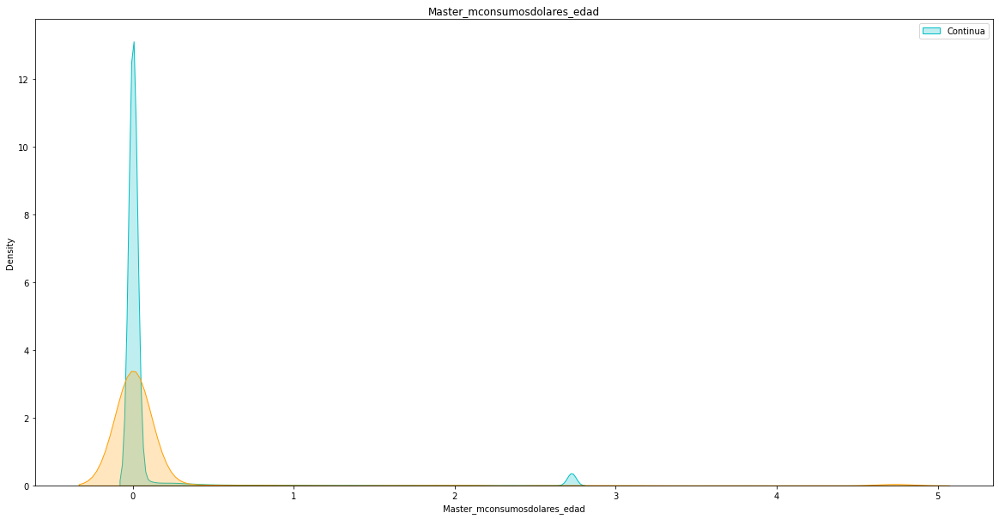

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

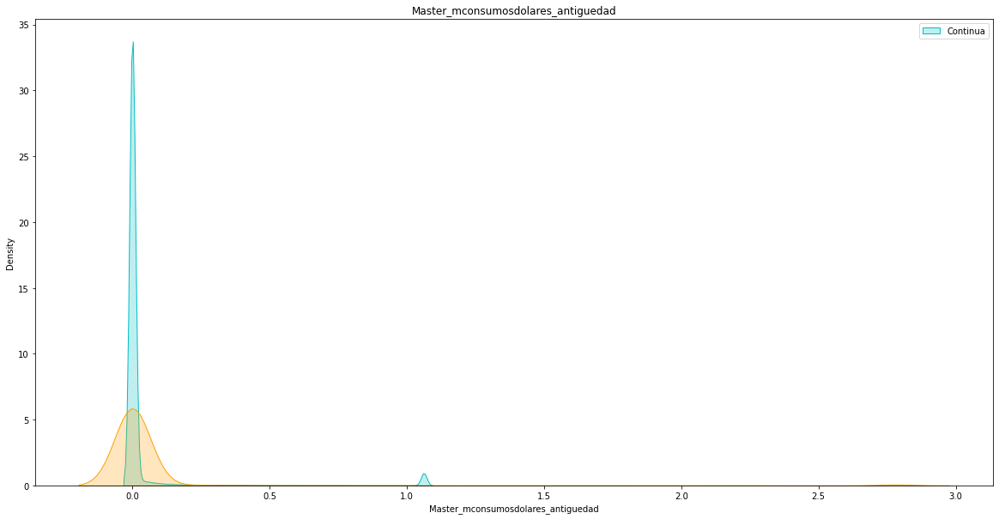

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

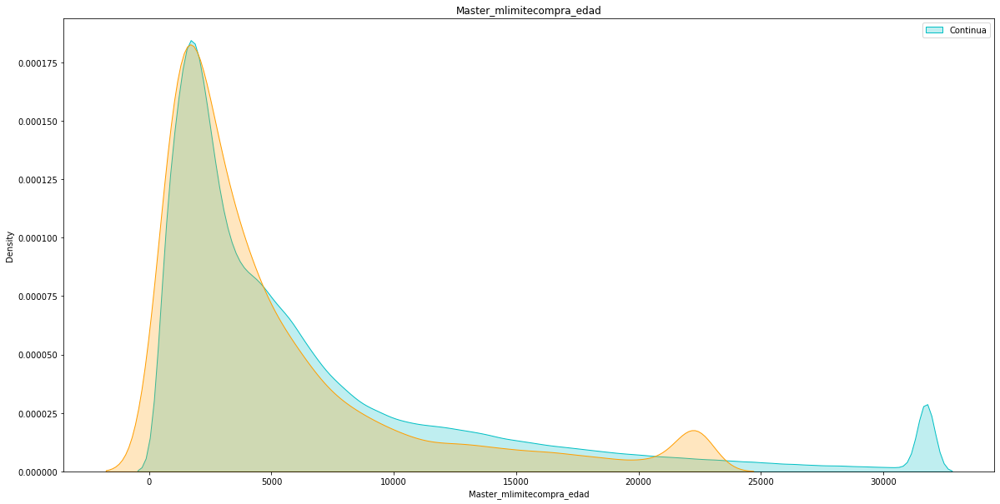

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

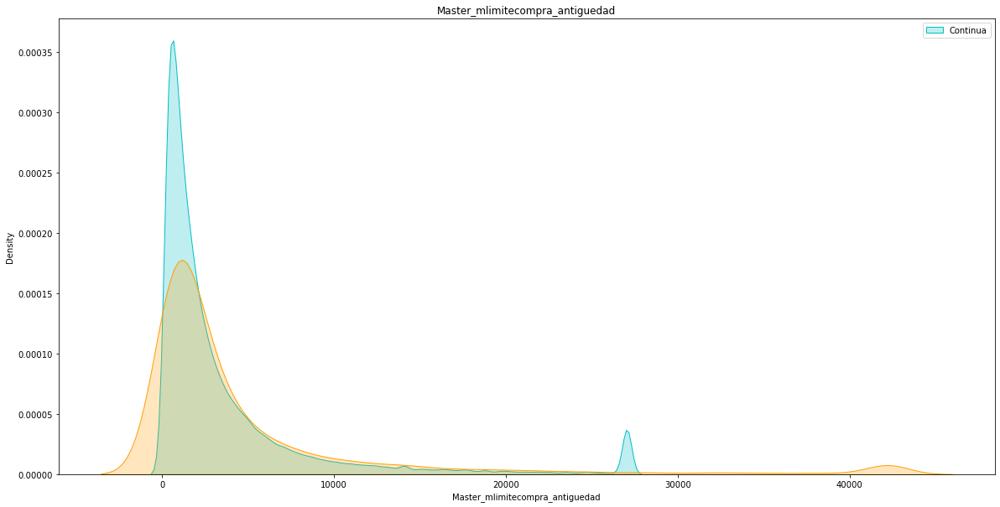

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

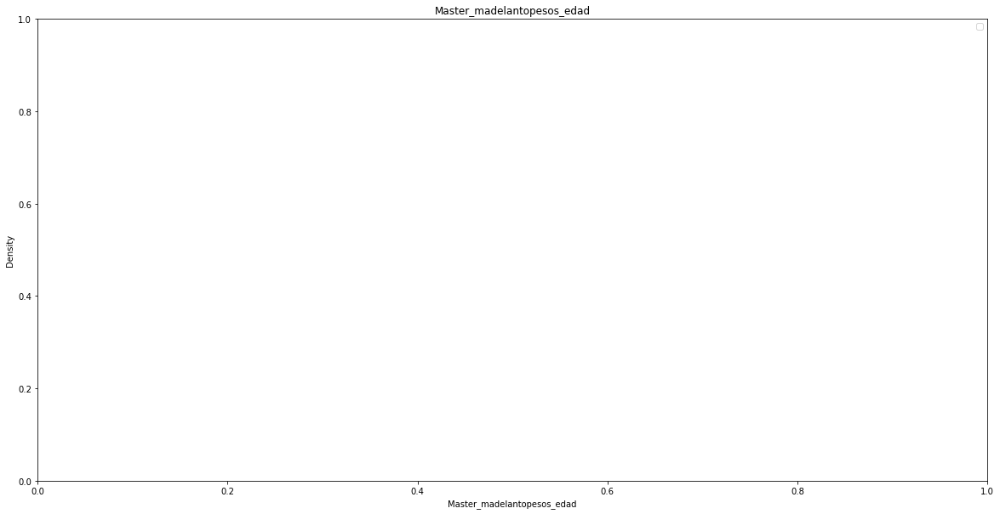

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

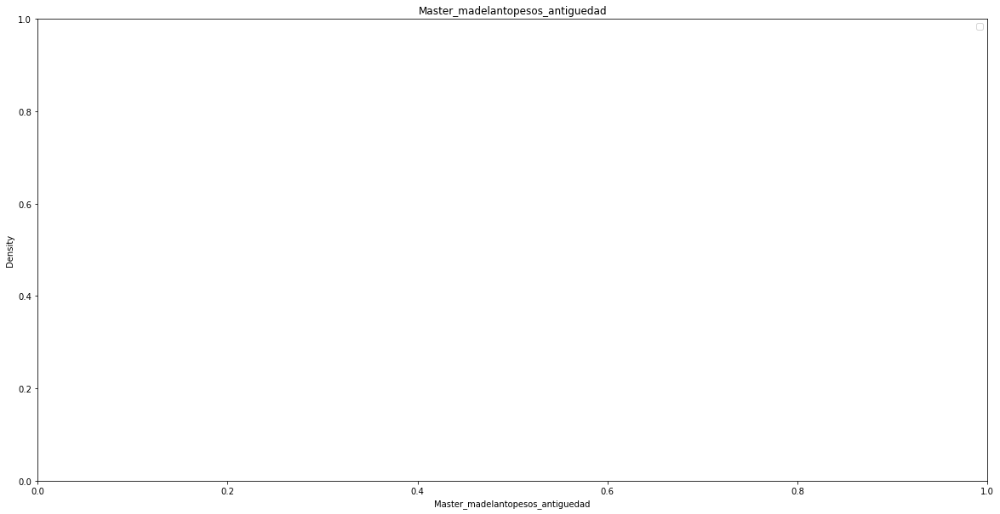

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

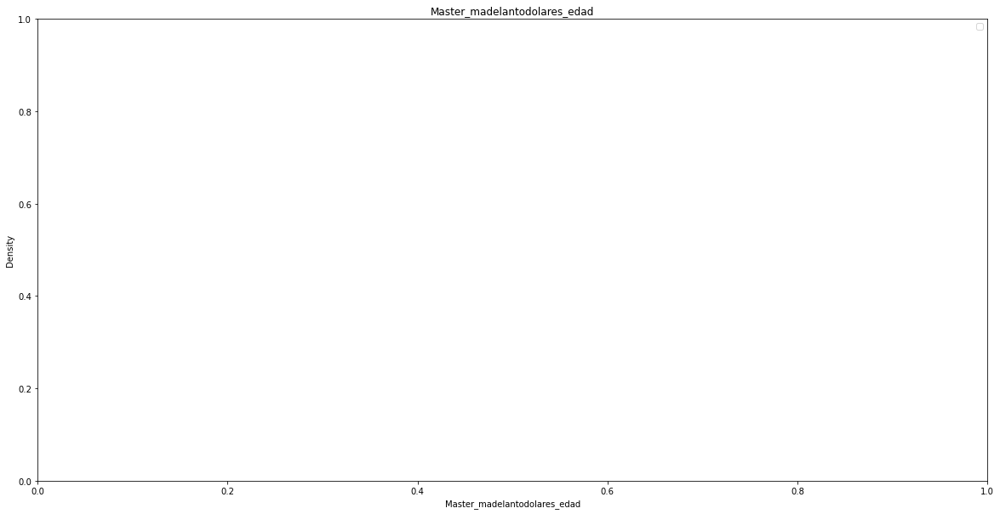

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

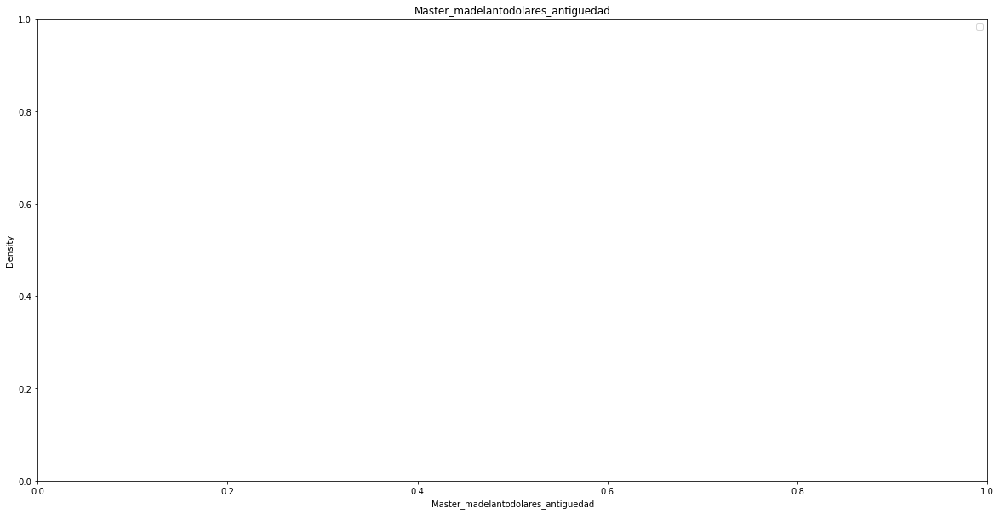

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

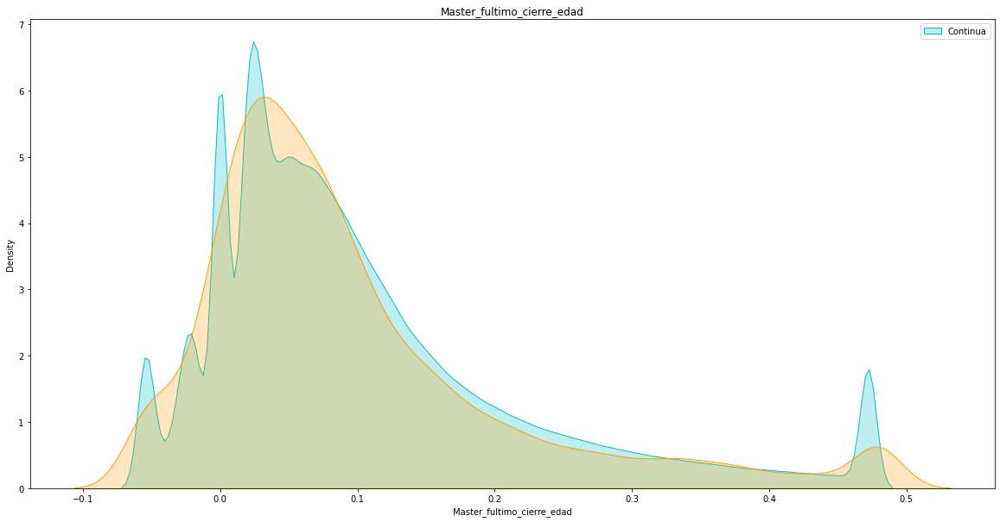

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

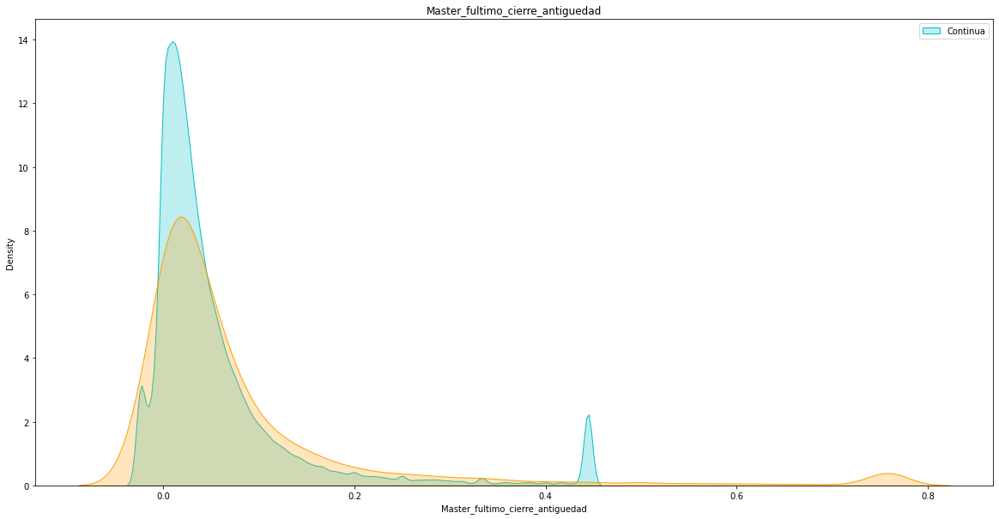

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

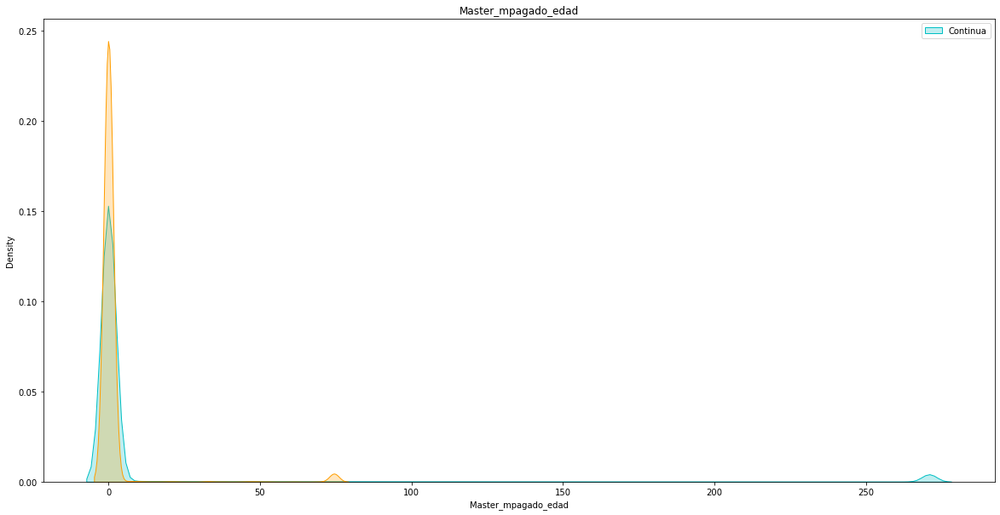

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

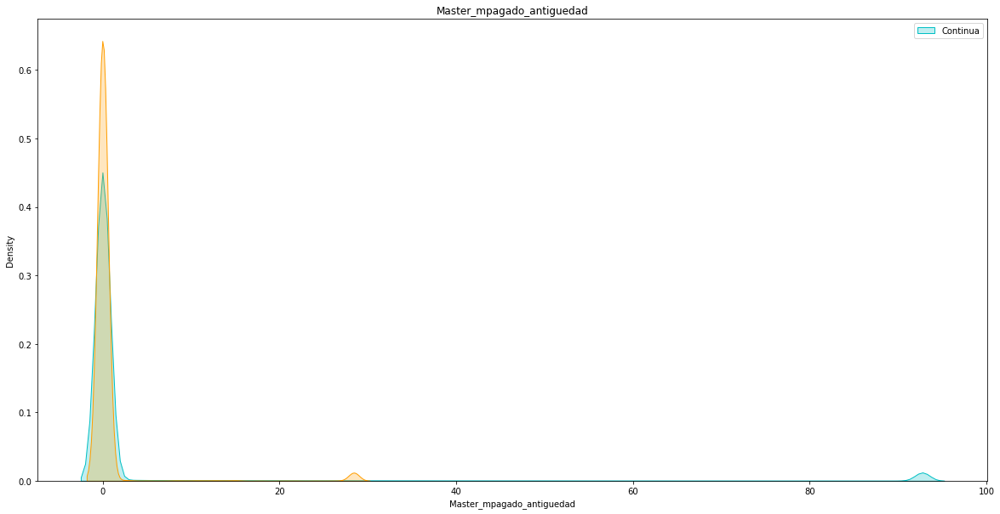

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

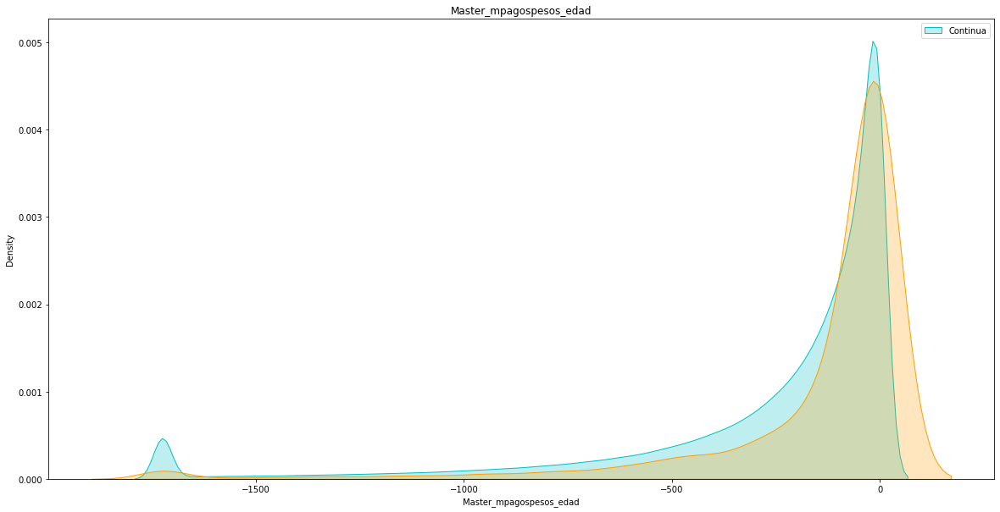

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

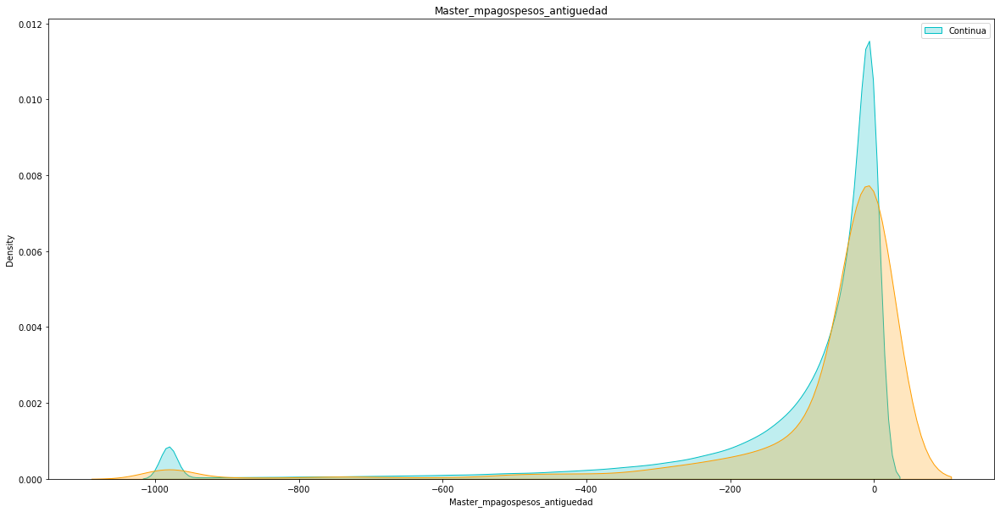

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

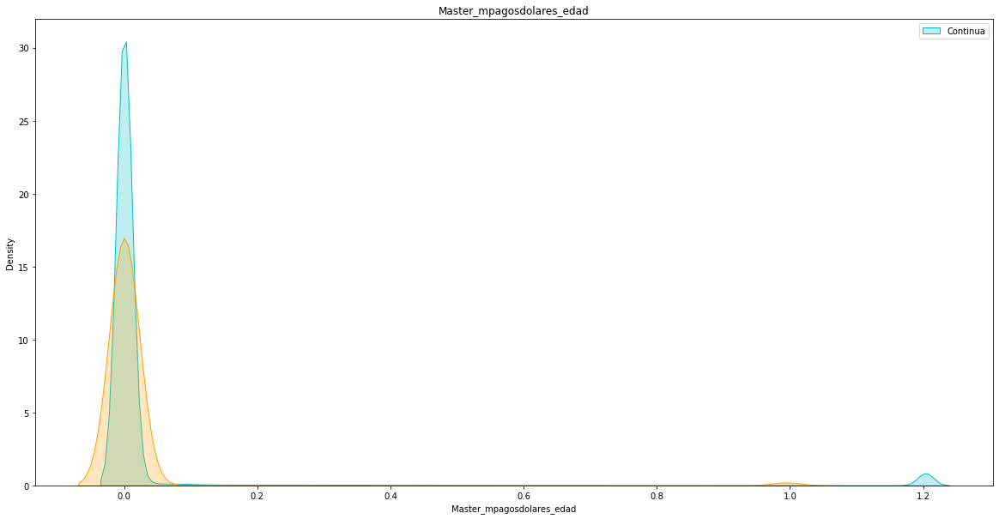

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

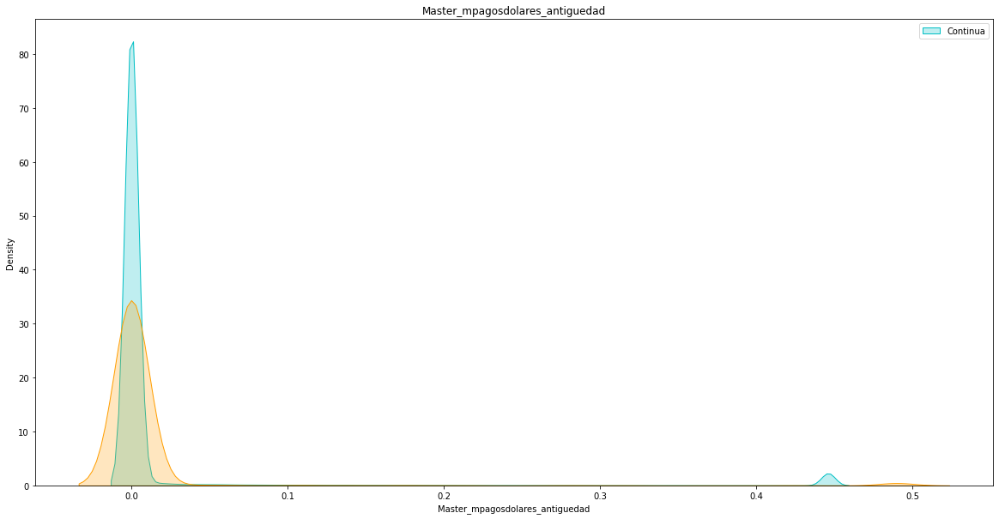

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

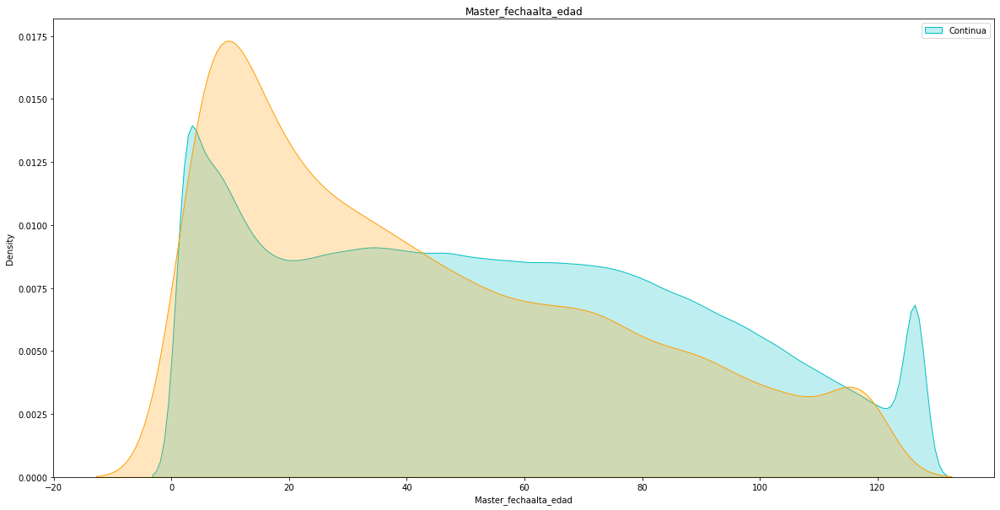

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

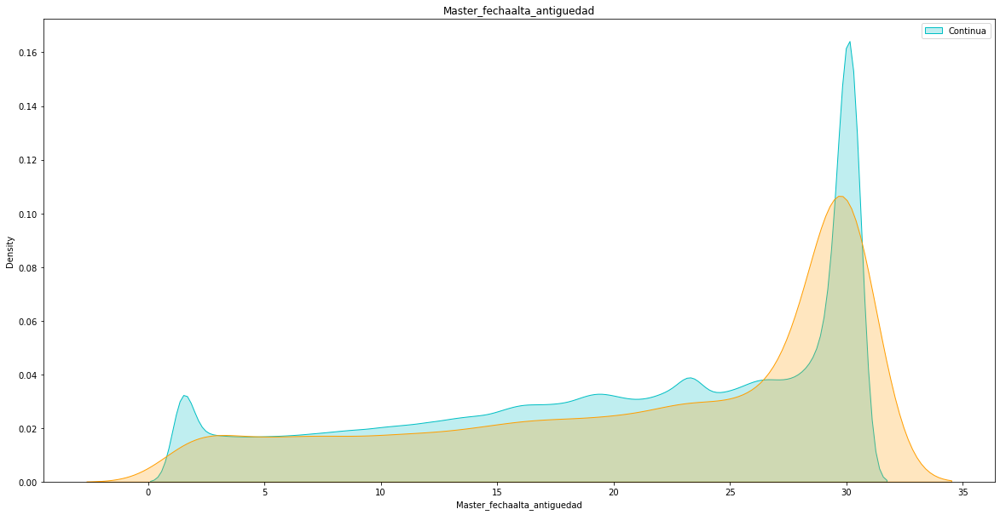

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

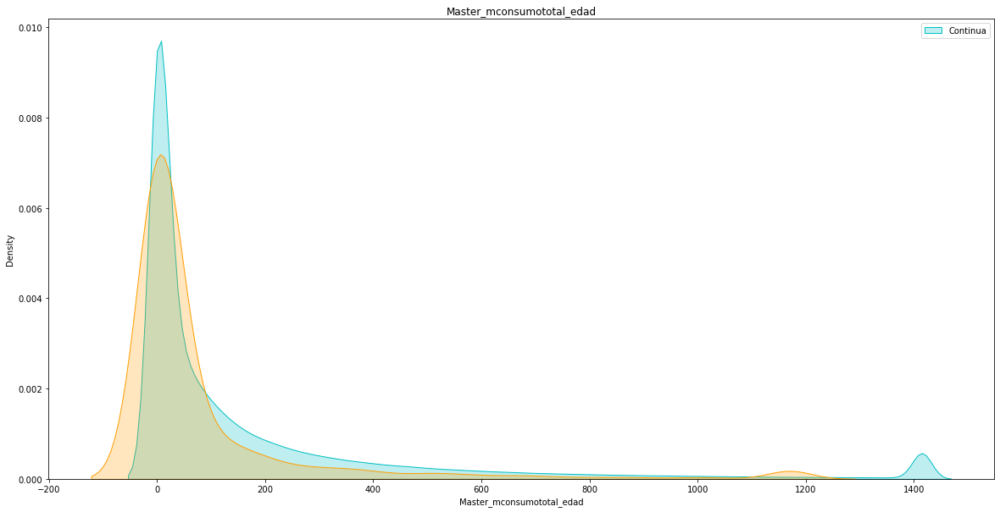

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

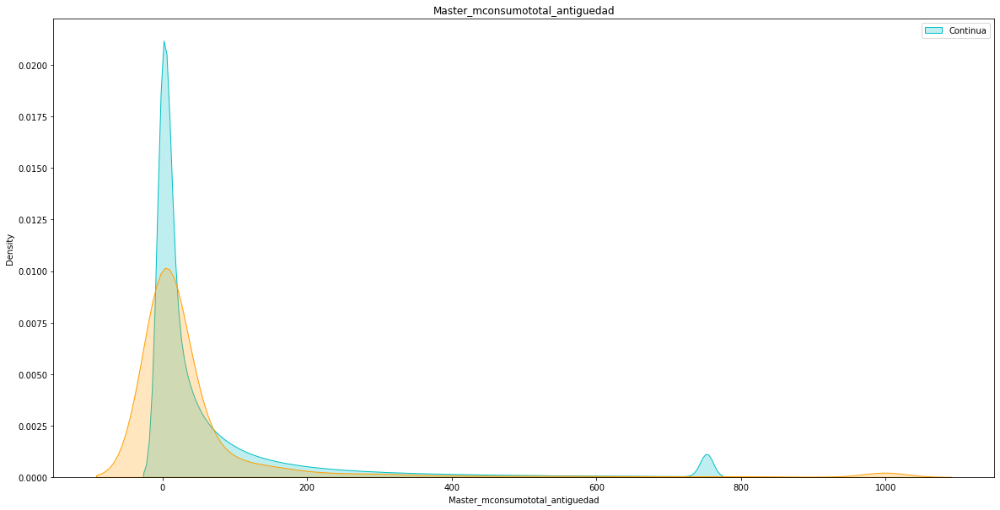

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

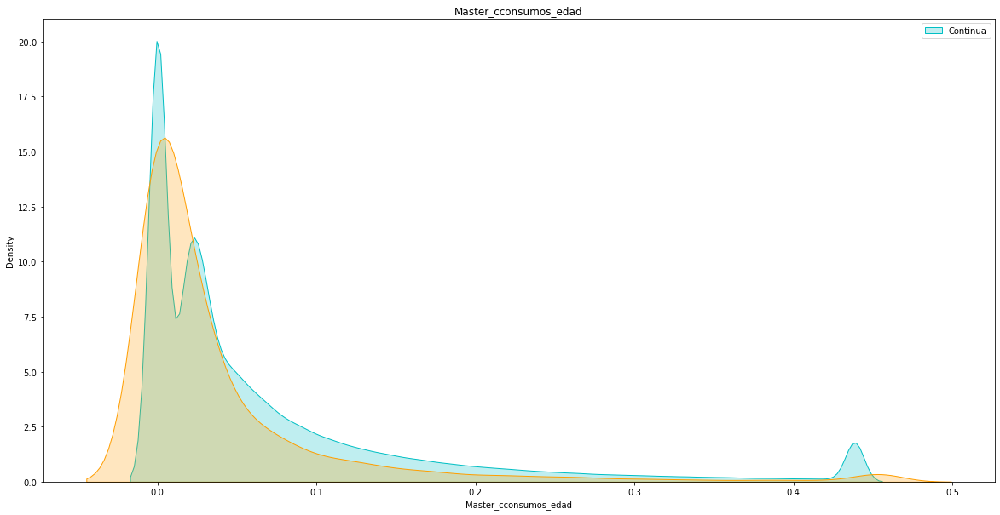

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

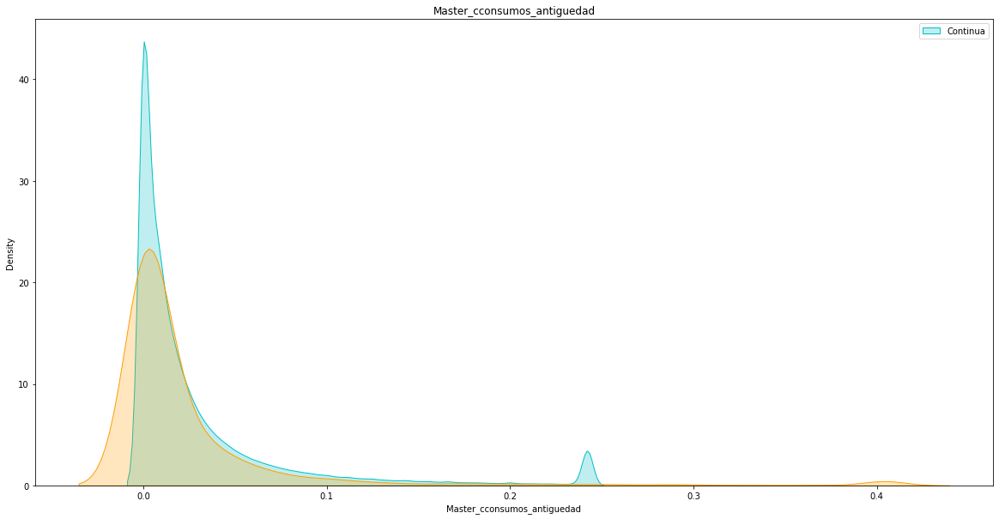

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

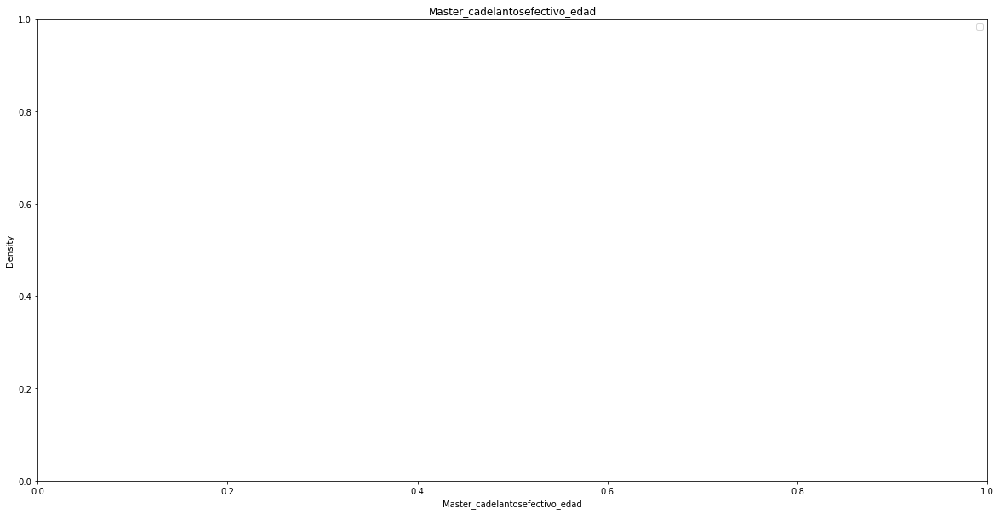

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

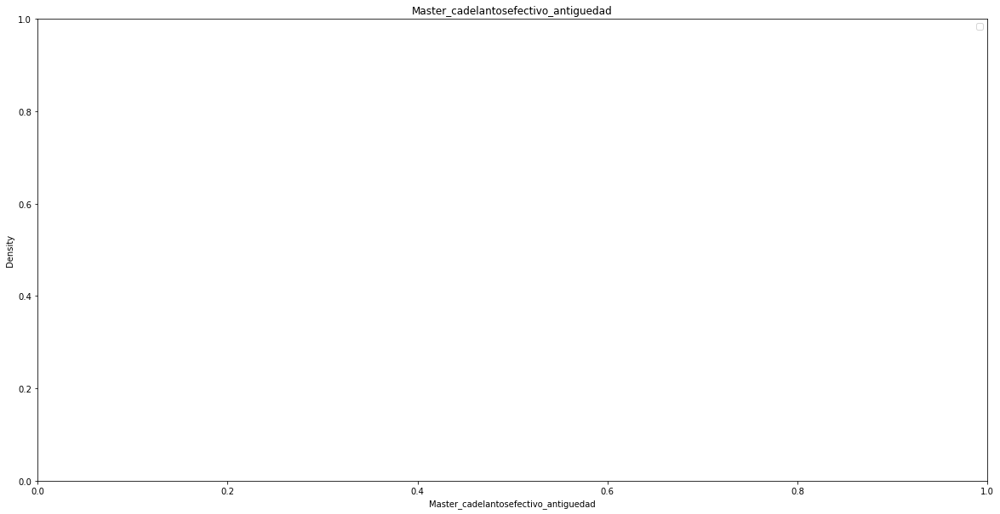

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

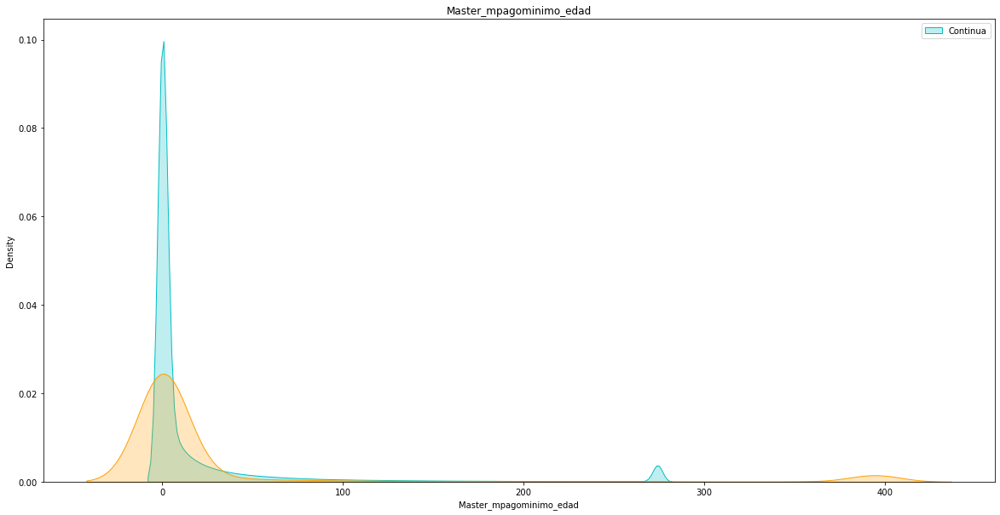

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

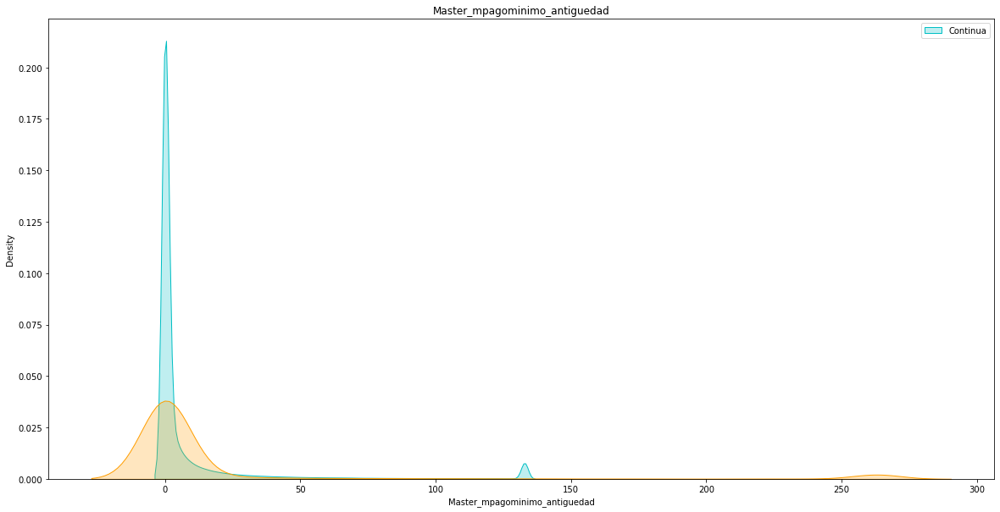

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

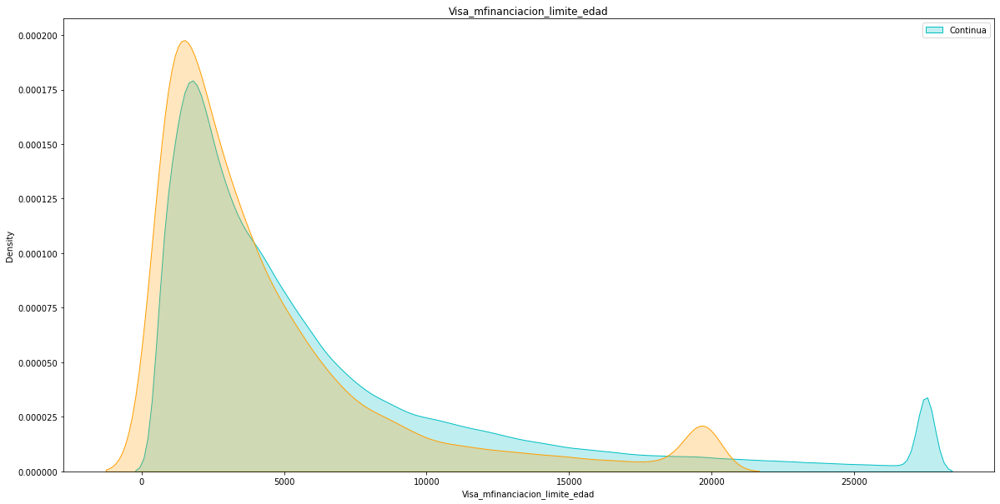

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

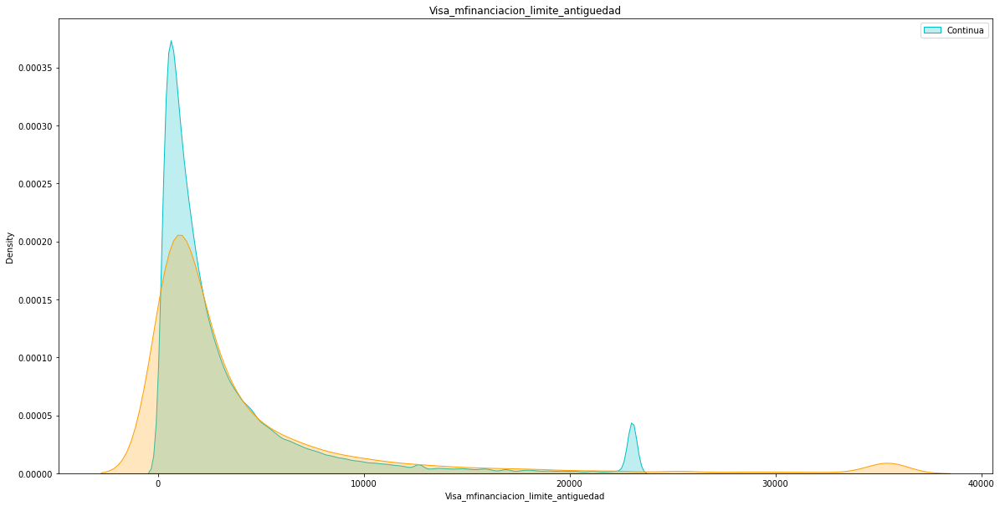

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

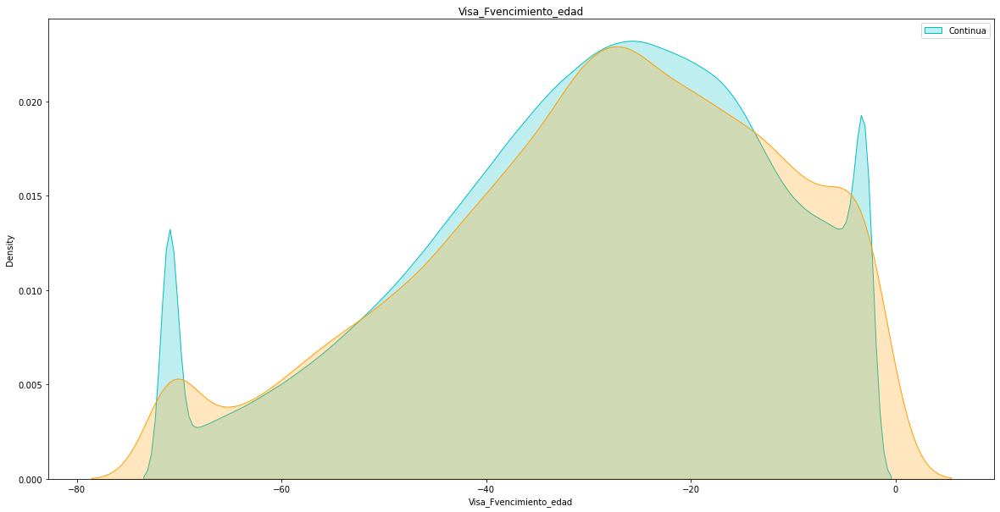

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

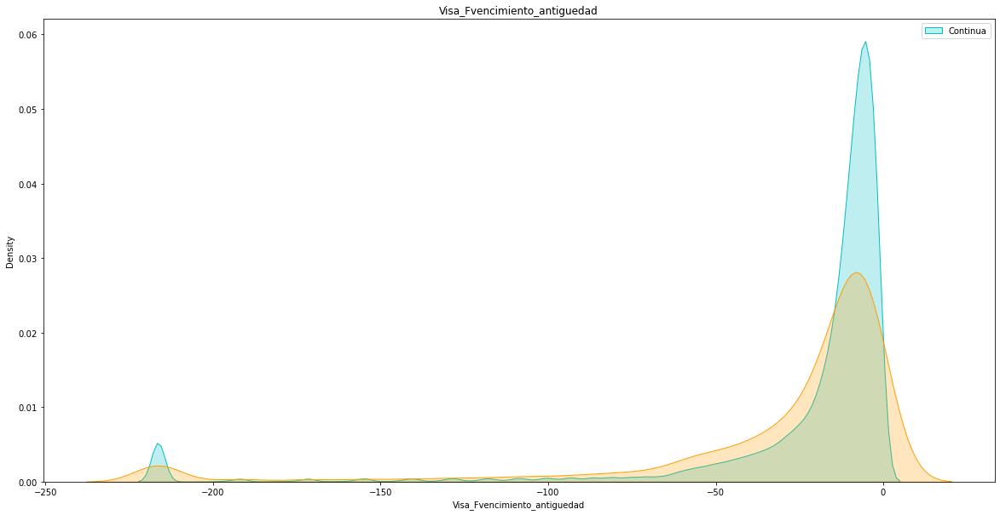

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

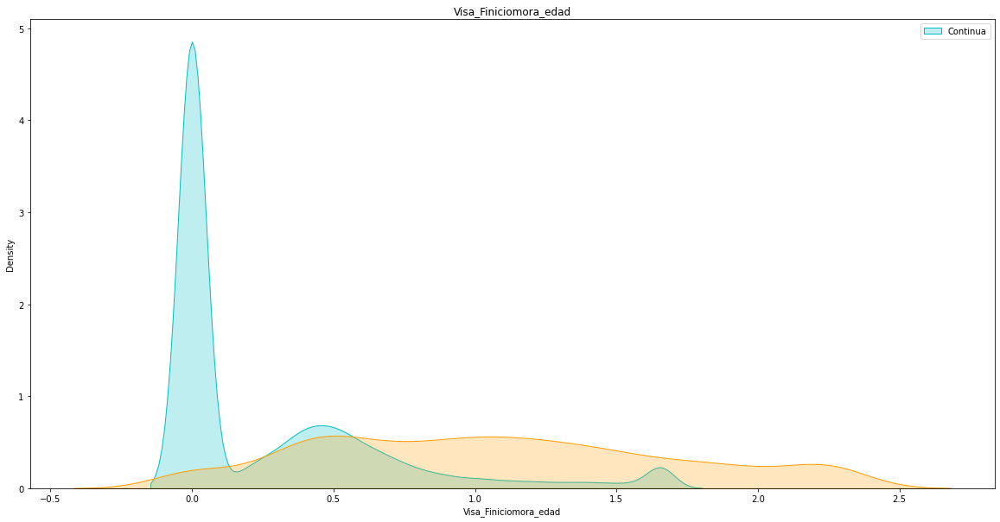

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

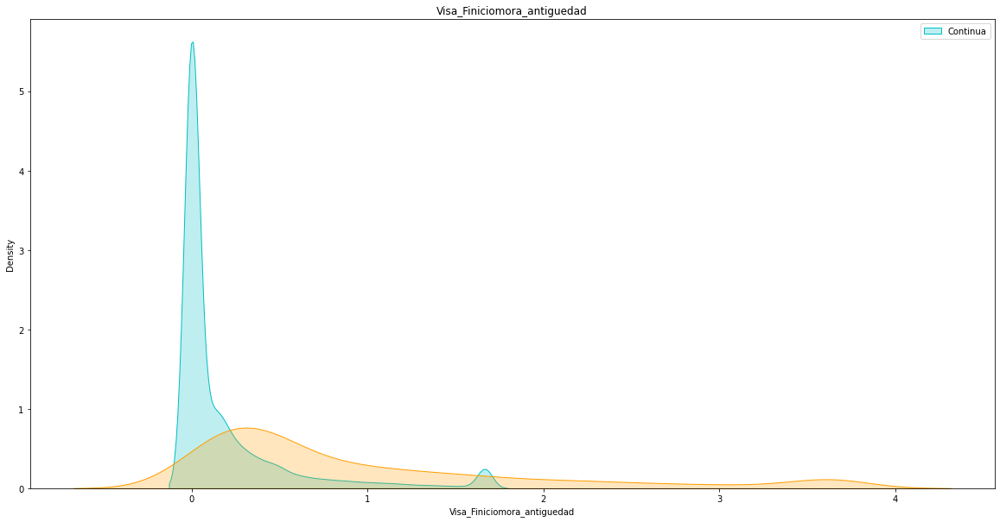

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

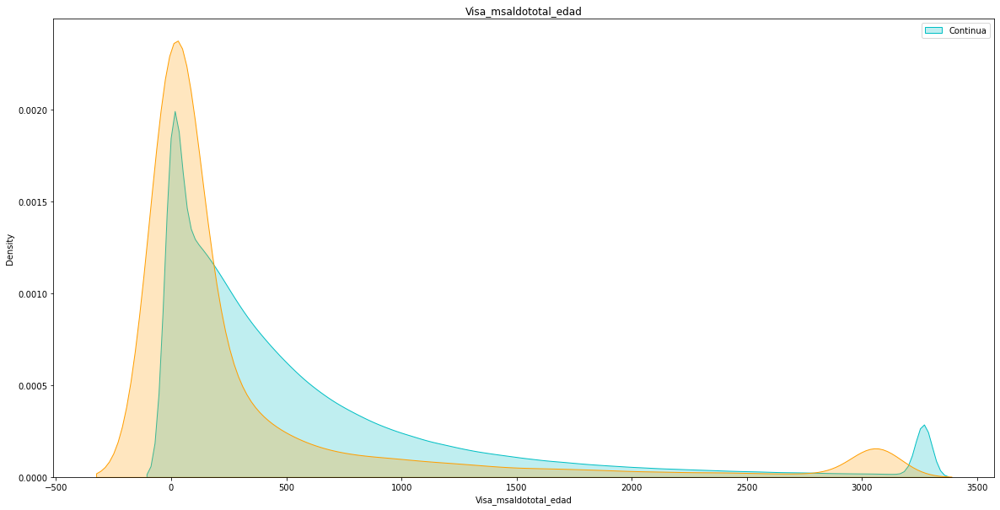

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

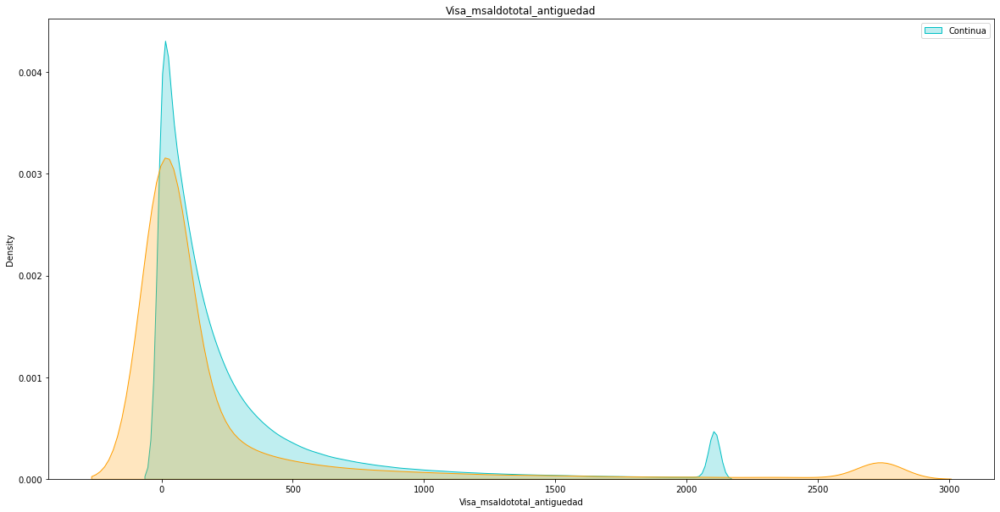

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

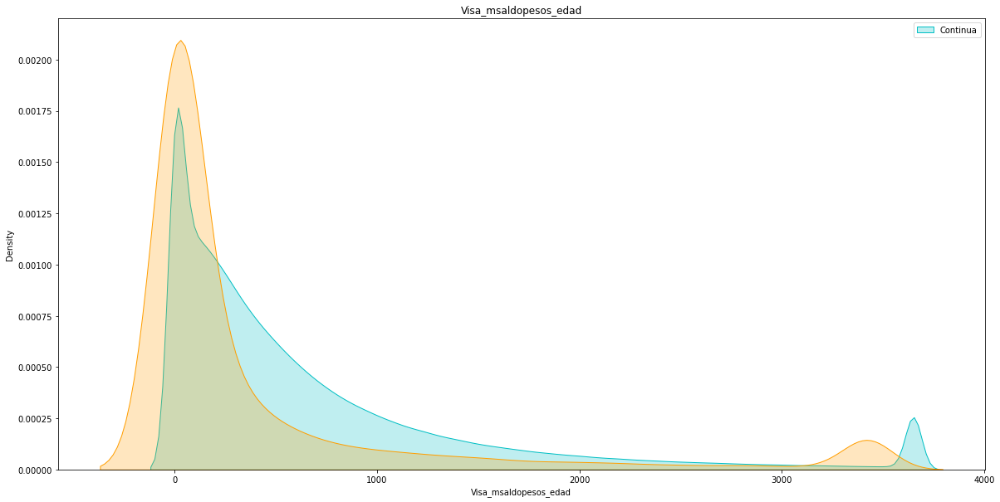

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

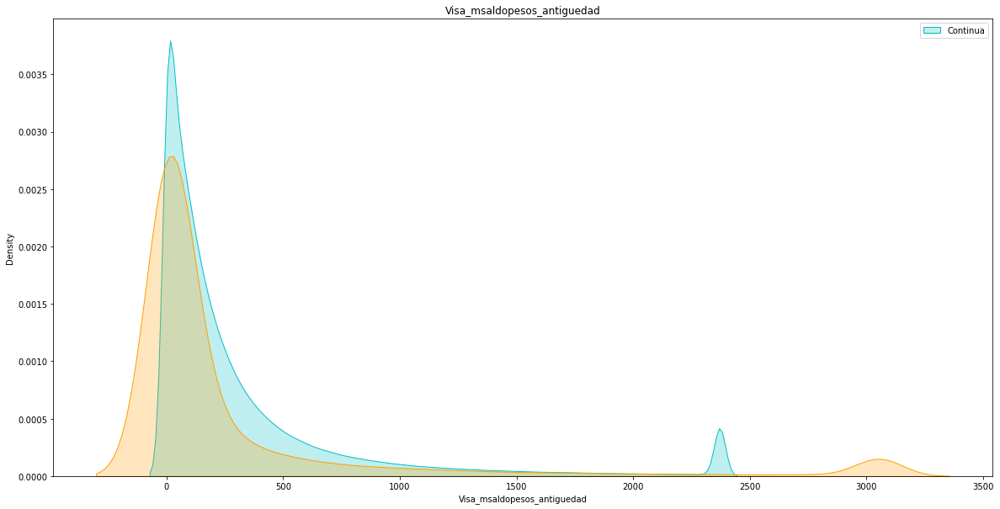

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

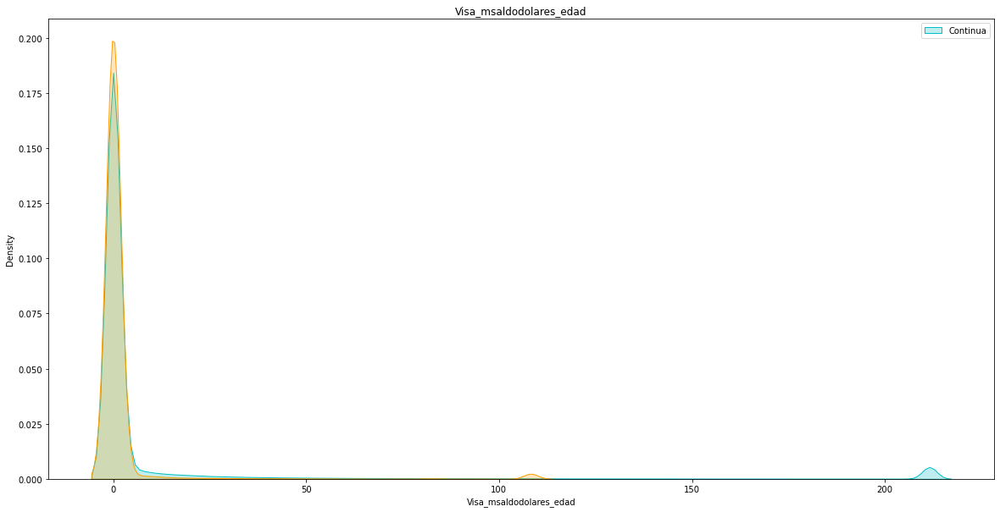

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

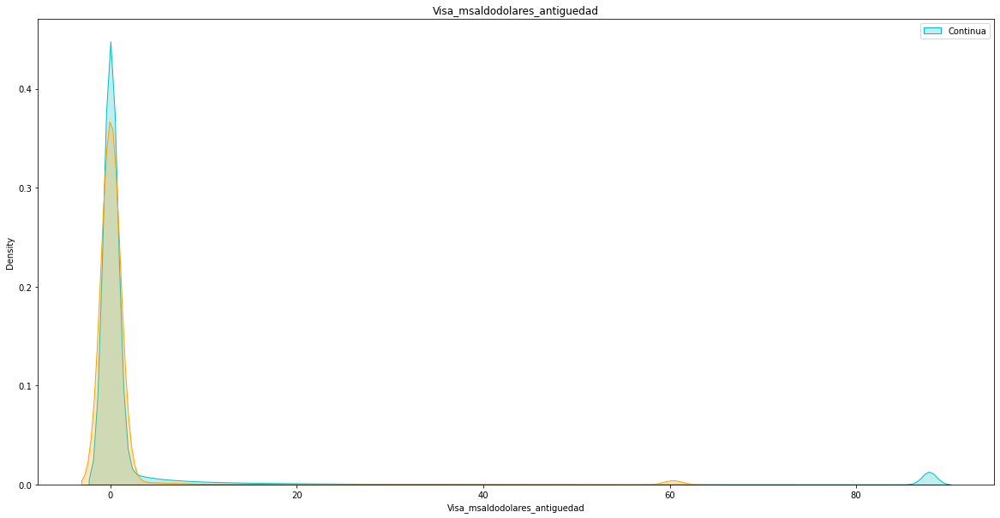

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

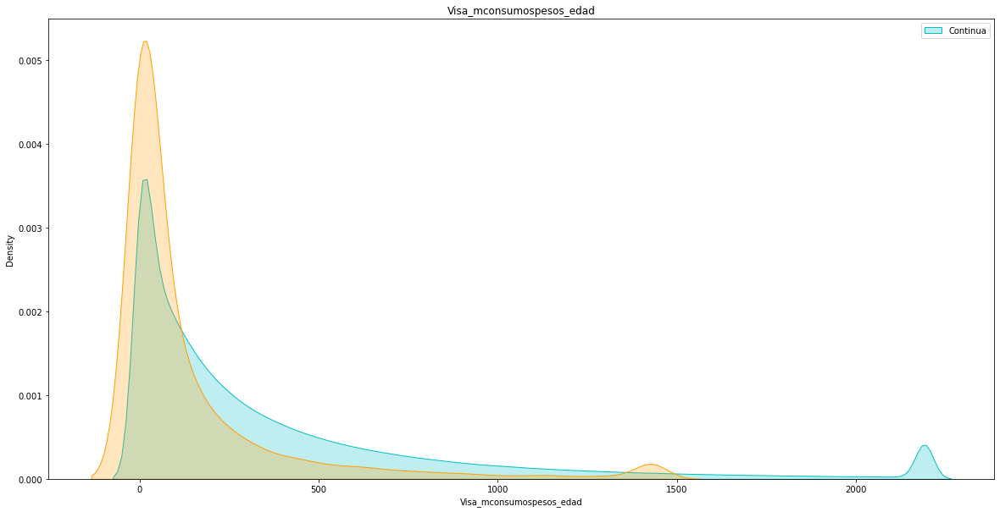

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

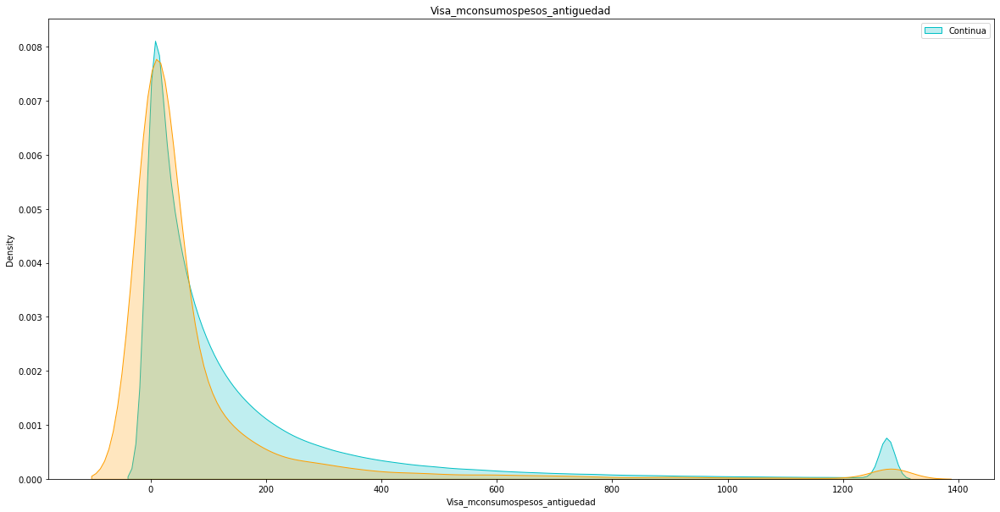

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

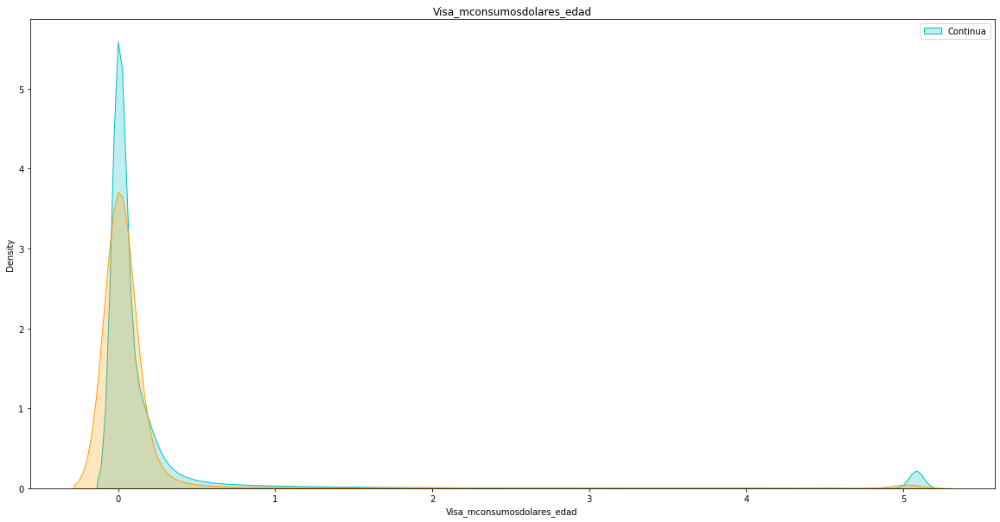

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

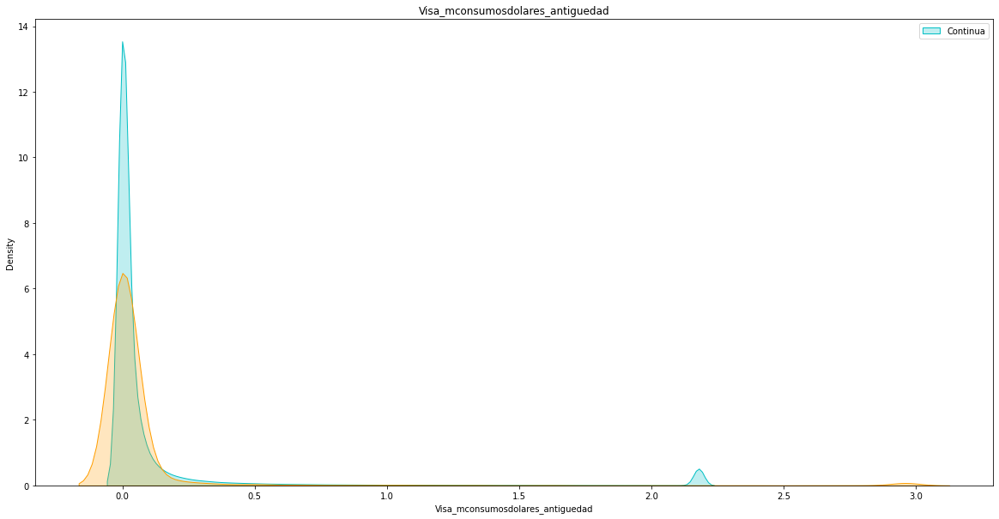

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

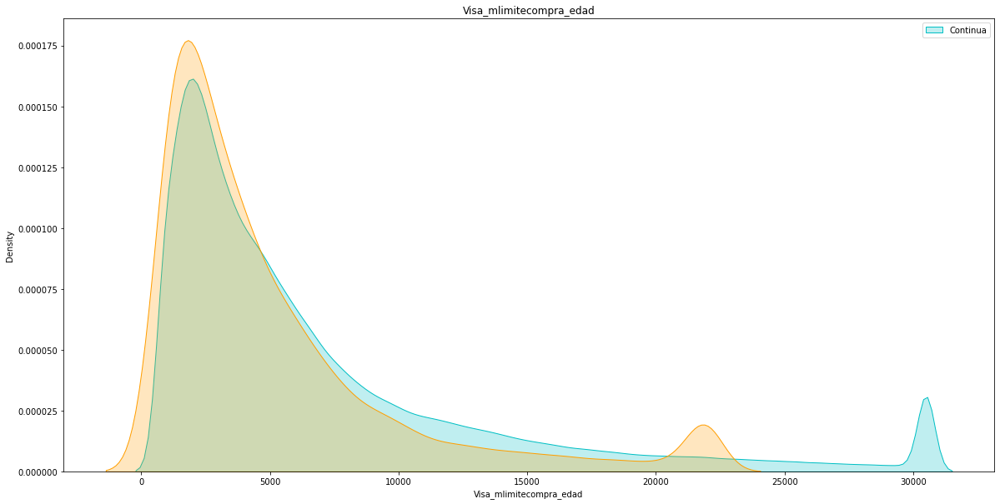

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

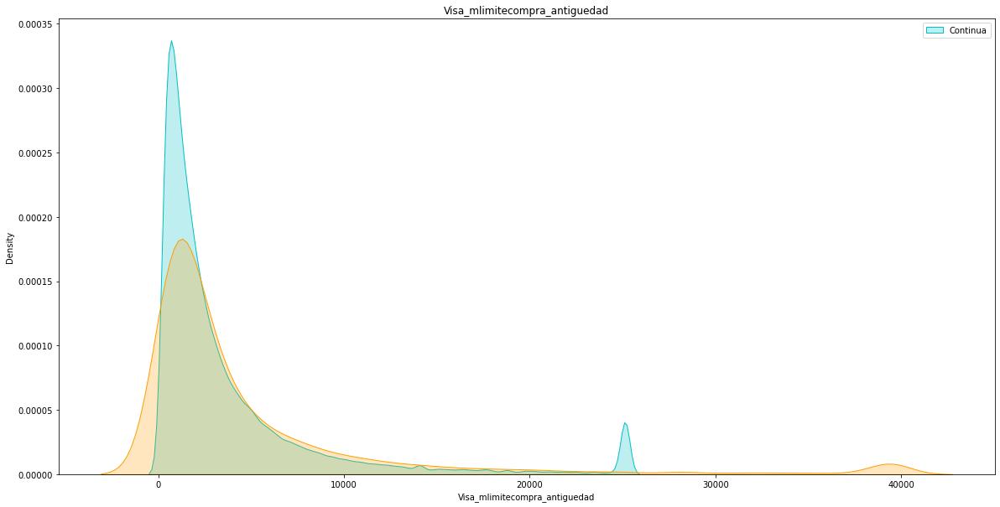

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

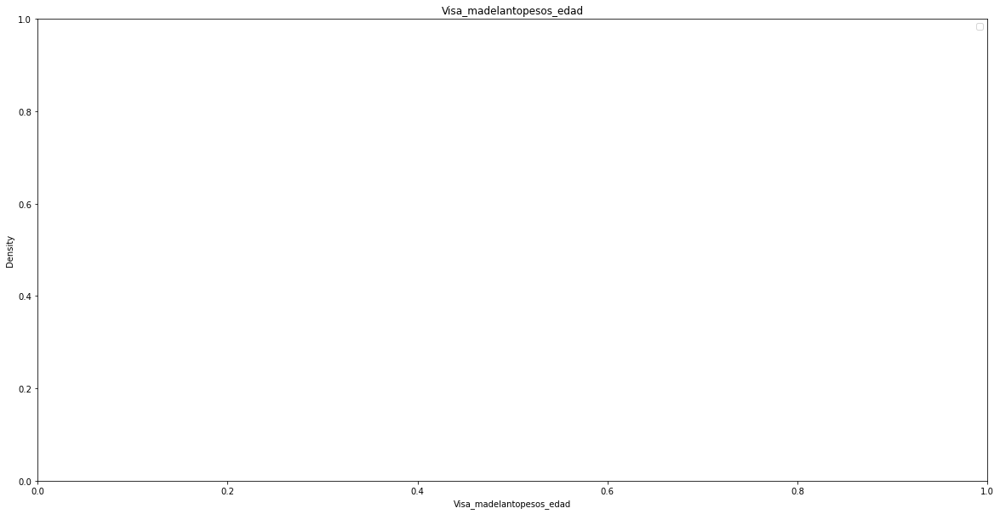

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

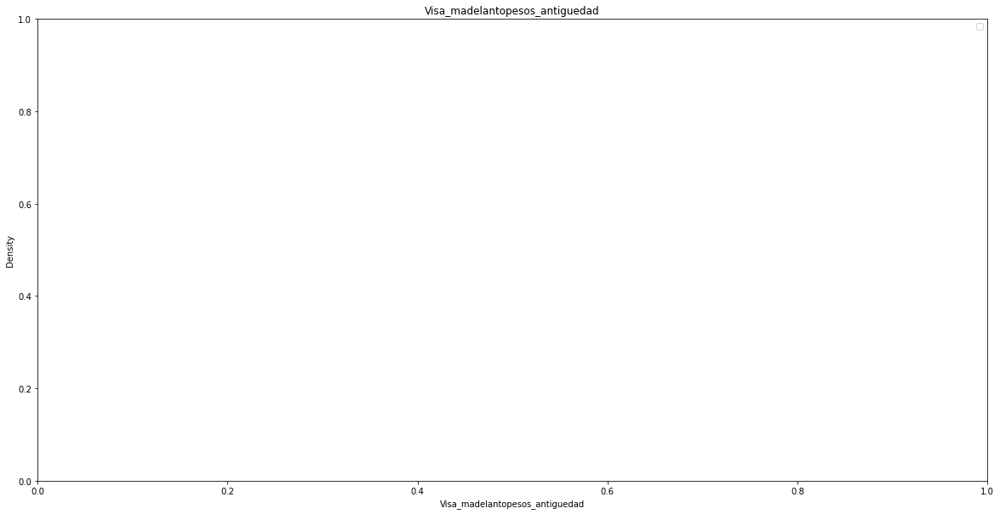

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

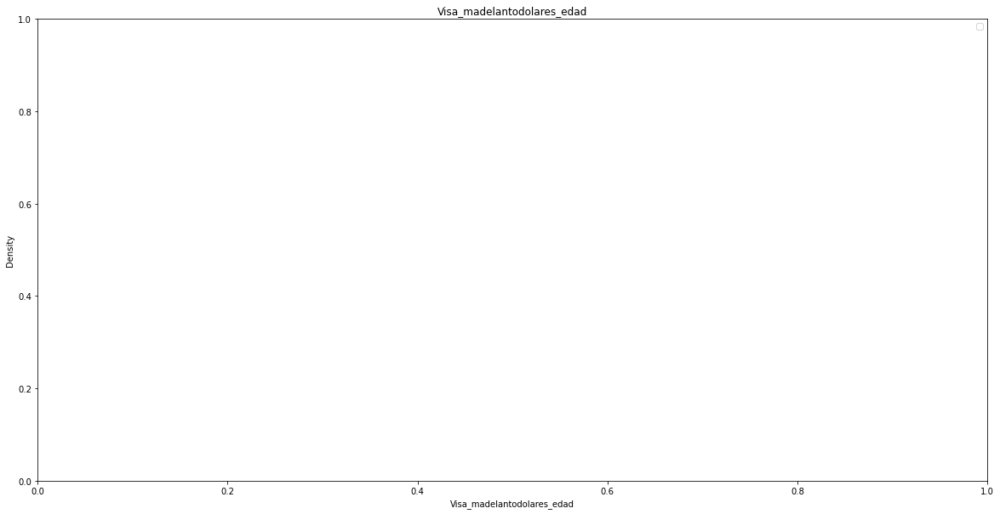

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

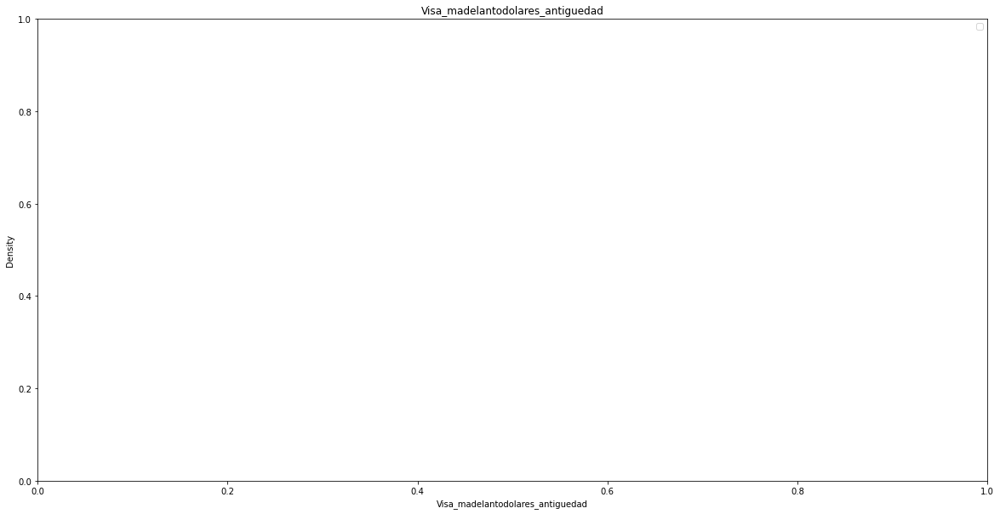

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

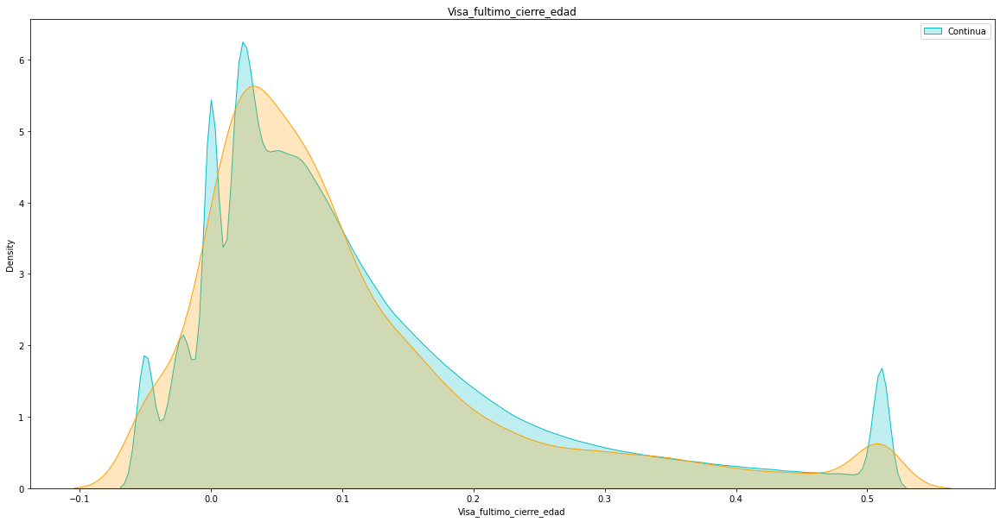

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

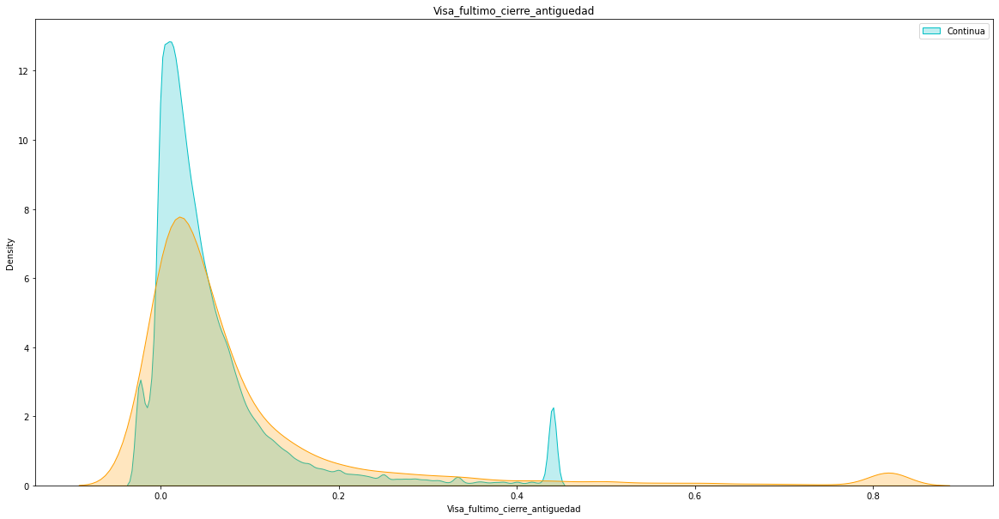

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

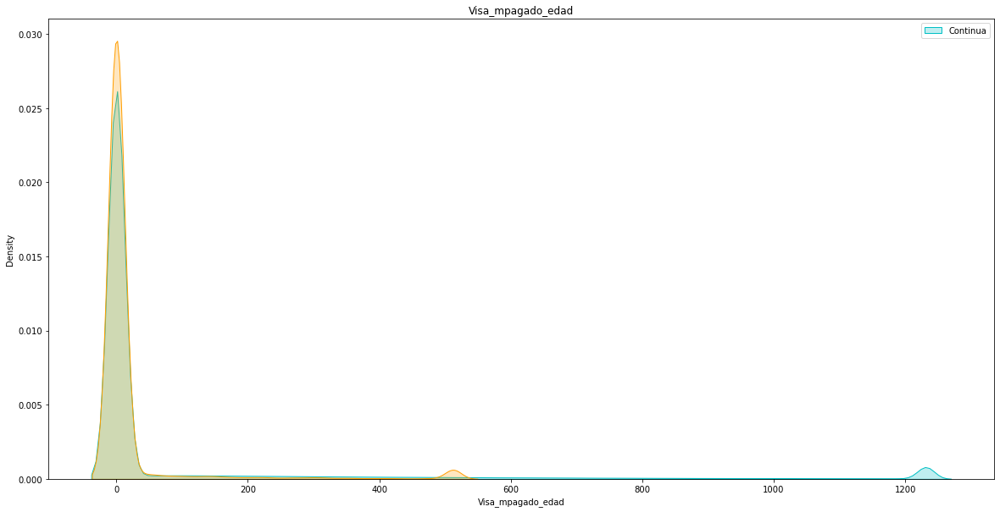

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

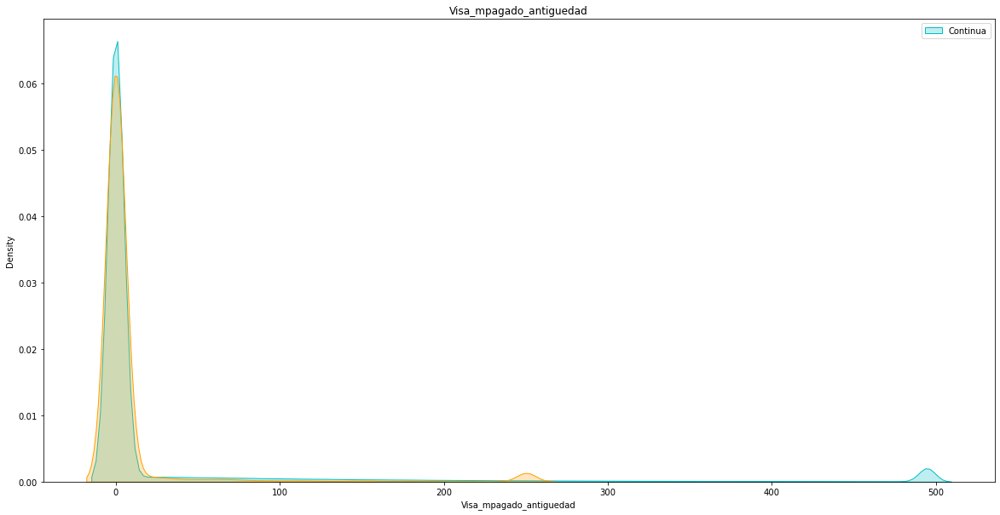

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

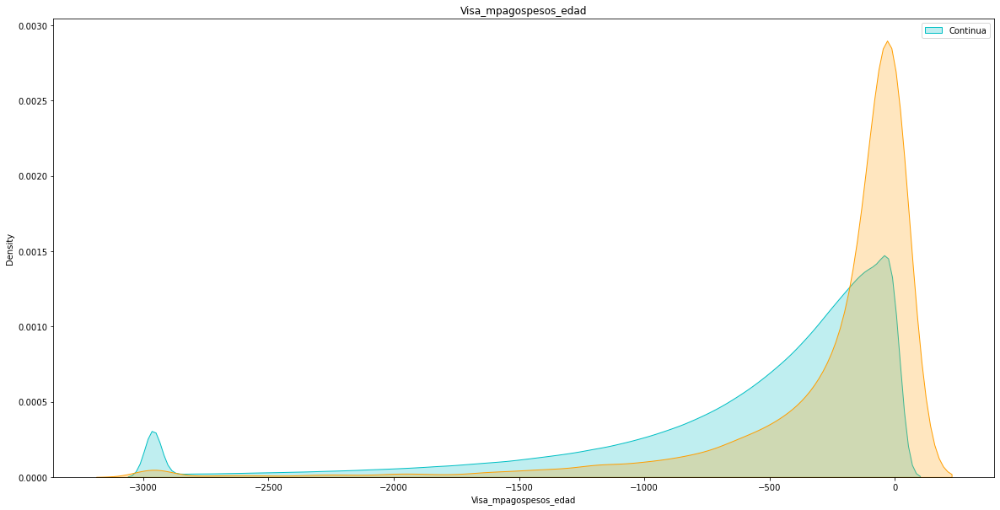

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

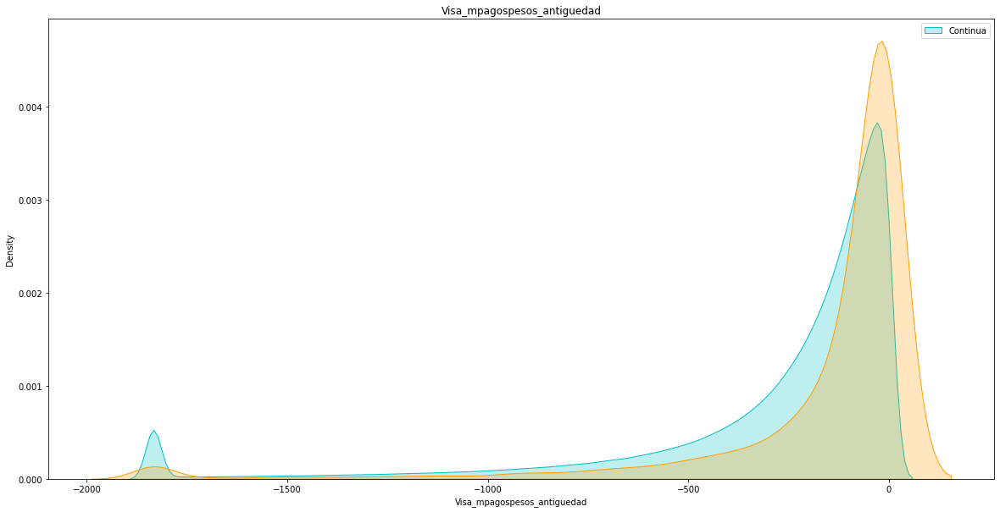

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

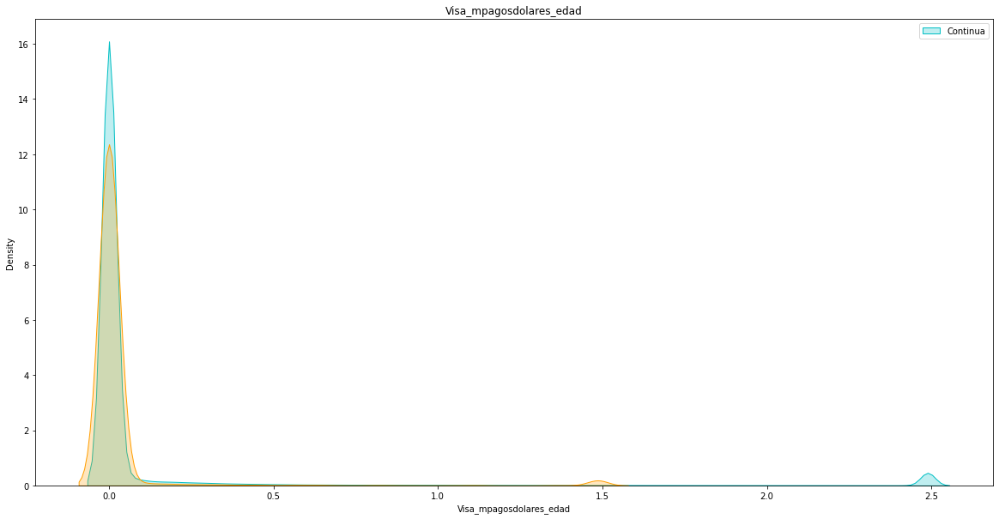

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

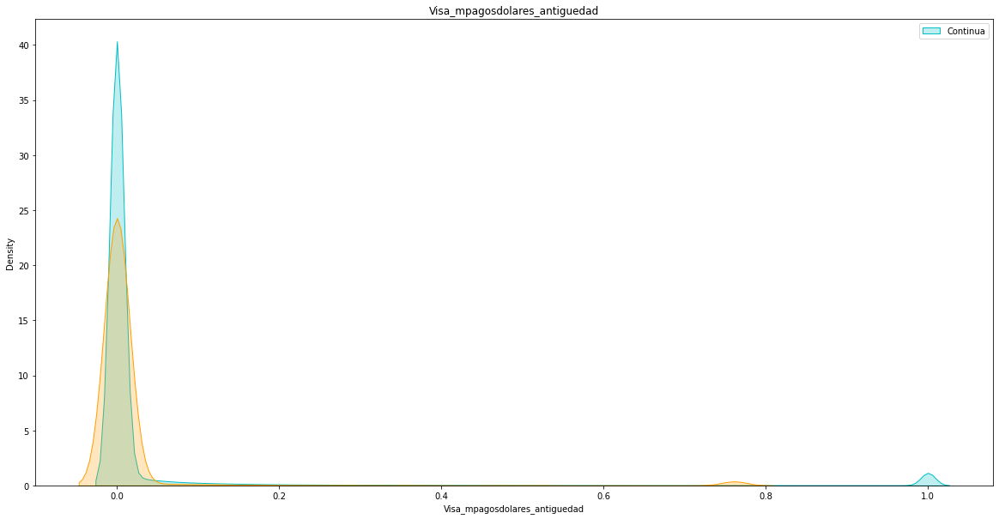

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

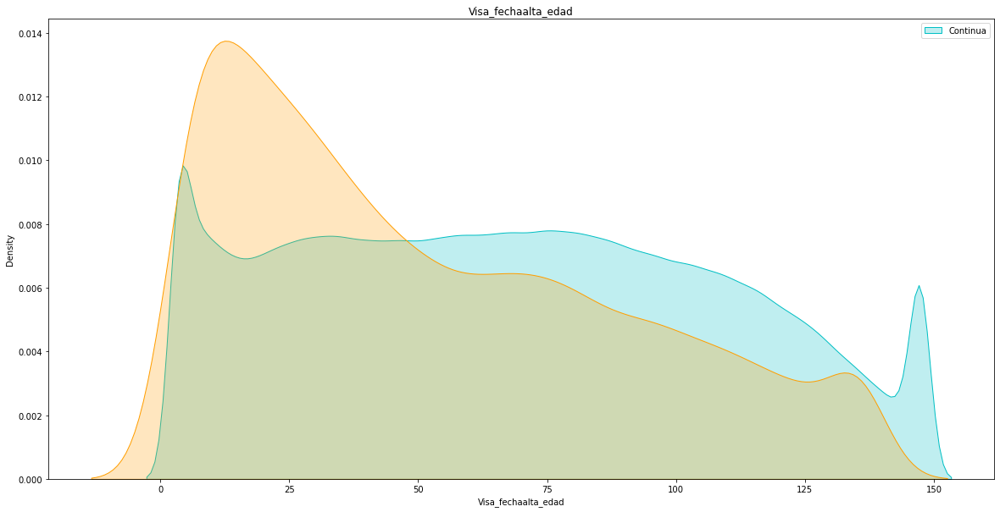

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

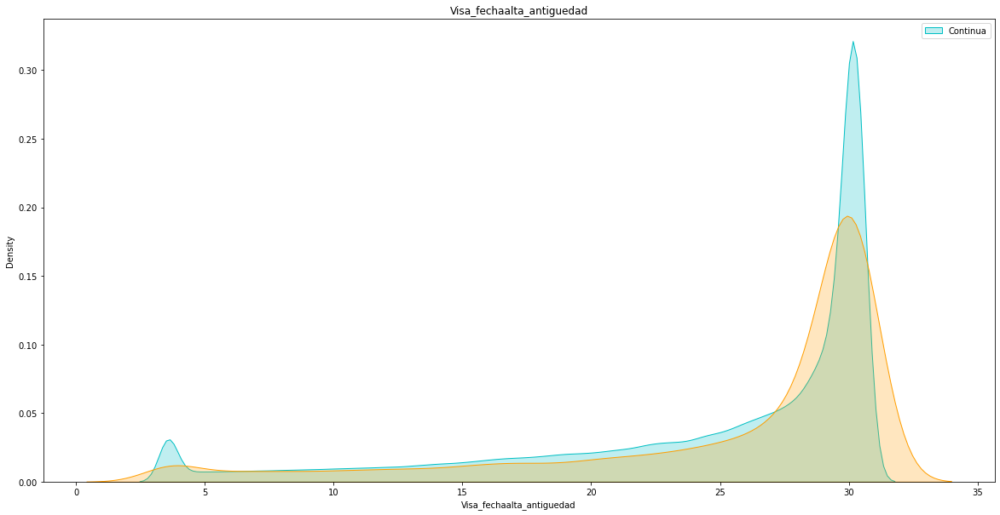

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

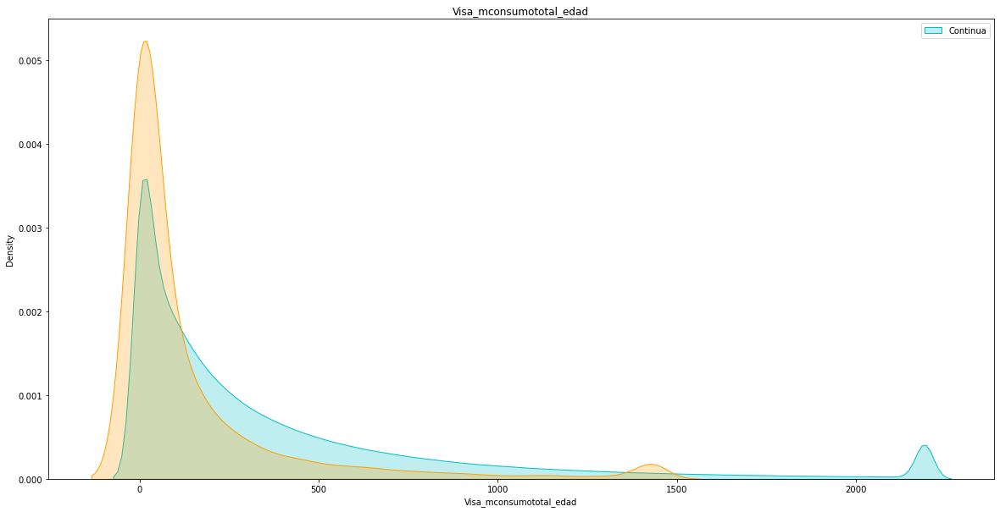

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

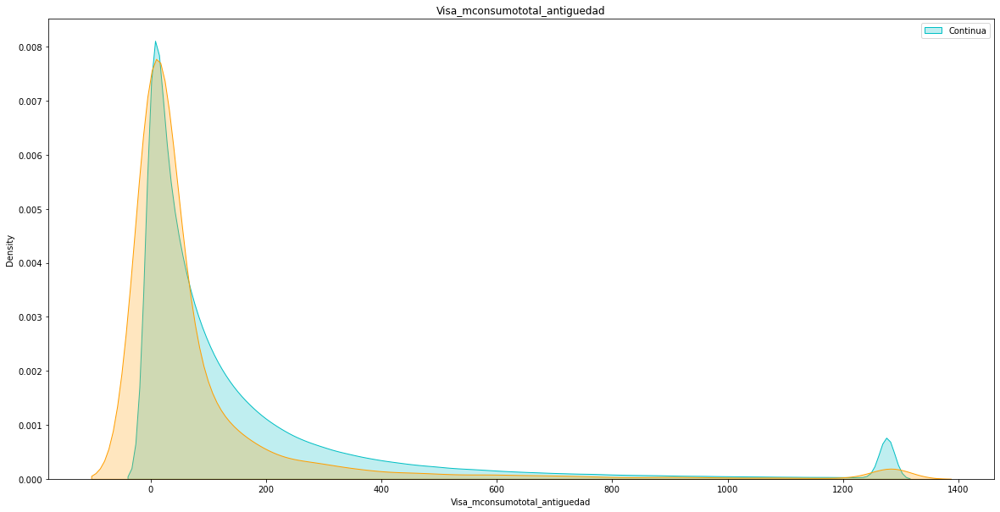

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

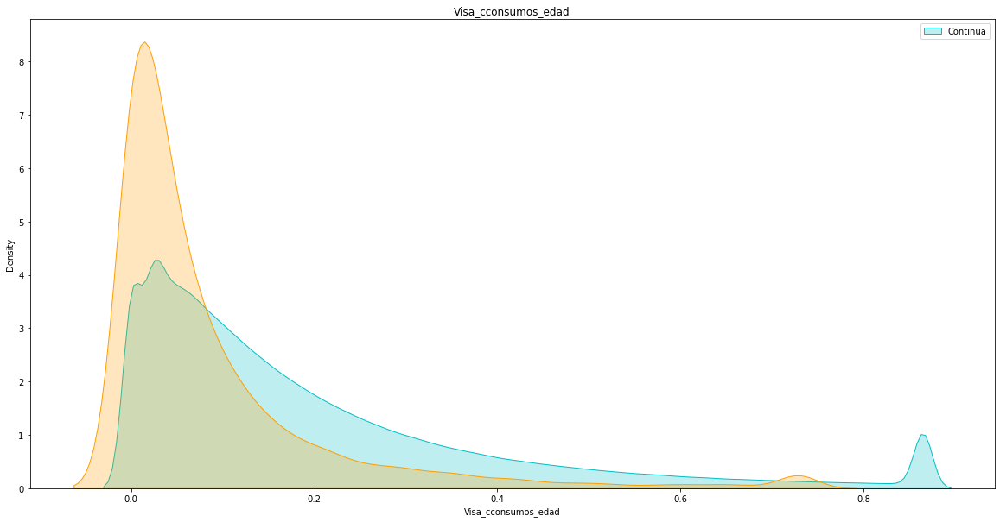

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

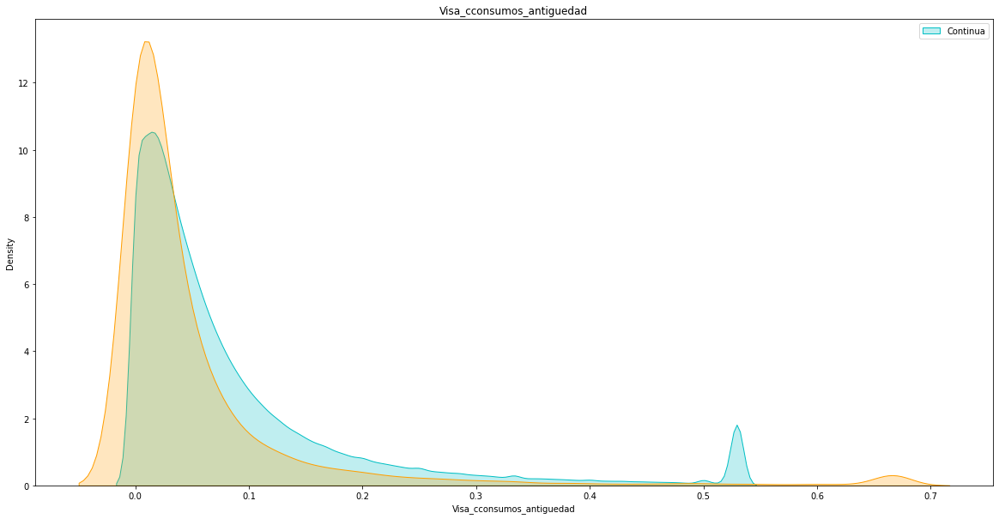

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

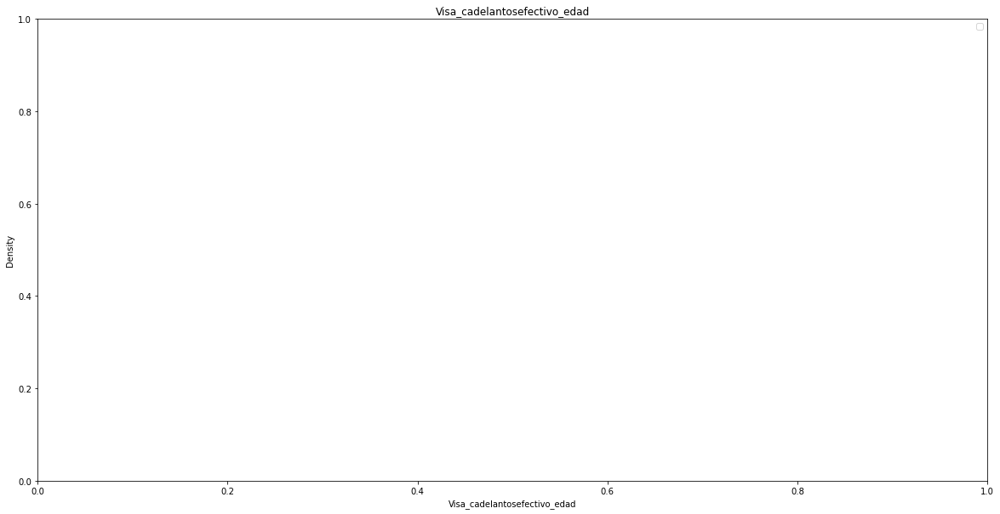

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

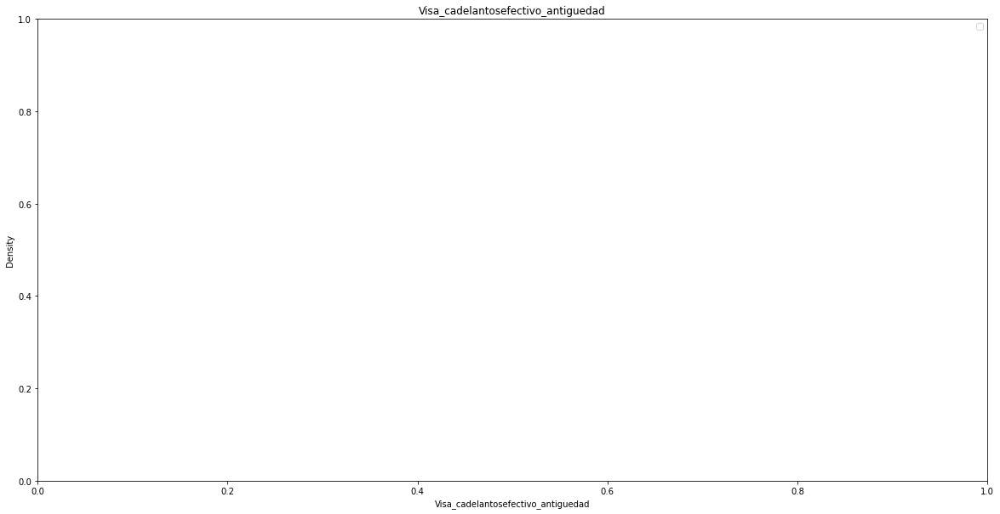

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

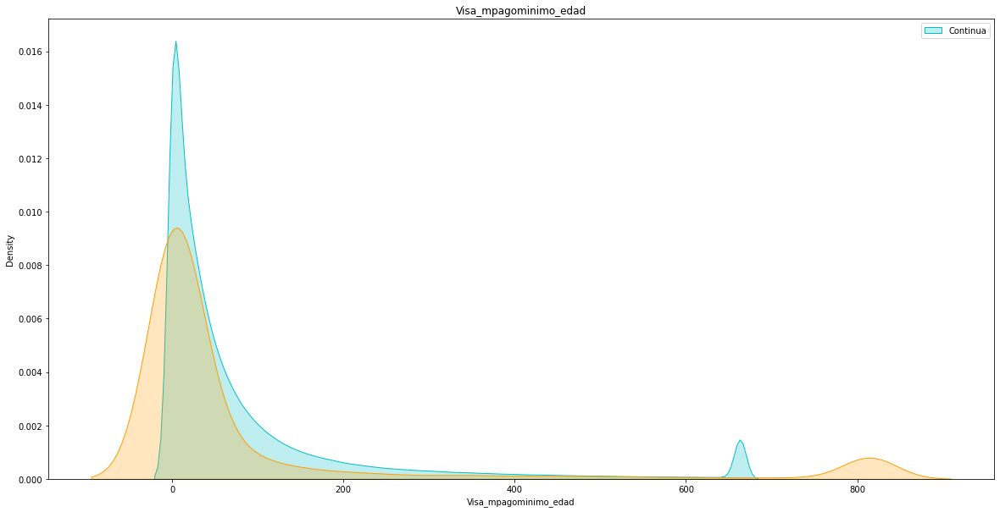

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

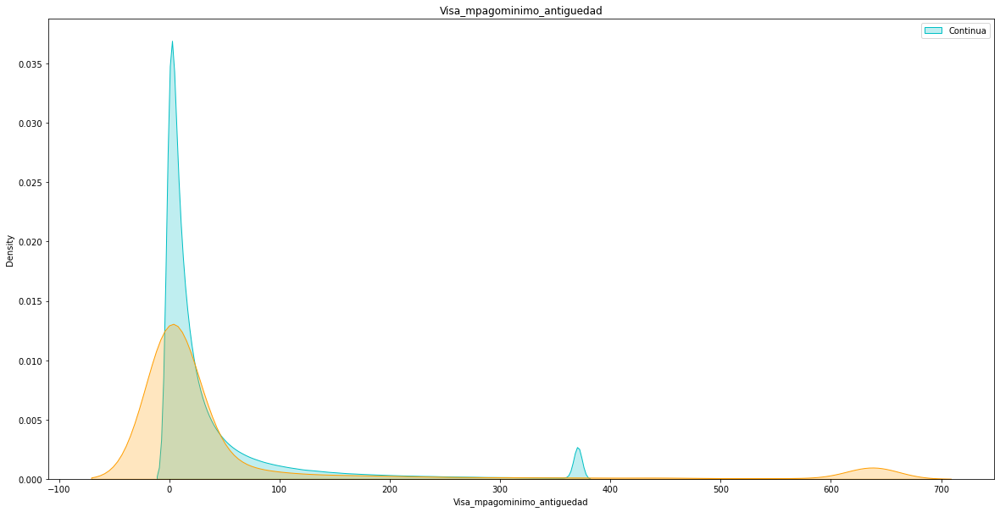

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

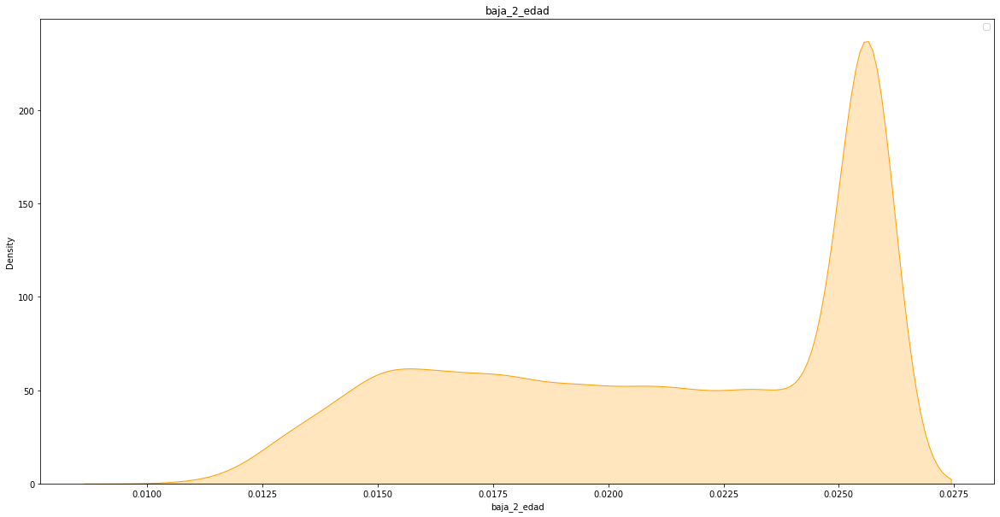

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/tmp/ipykernel_2345/2260139156.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are i

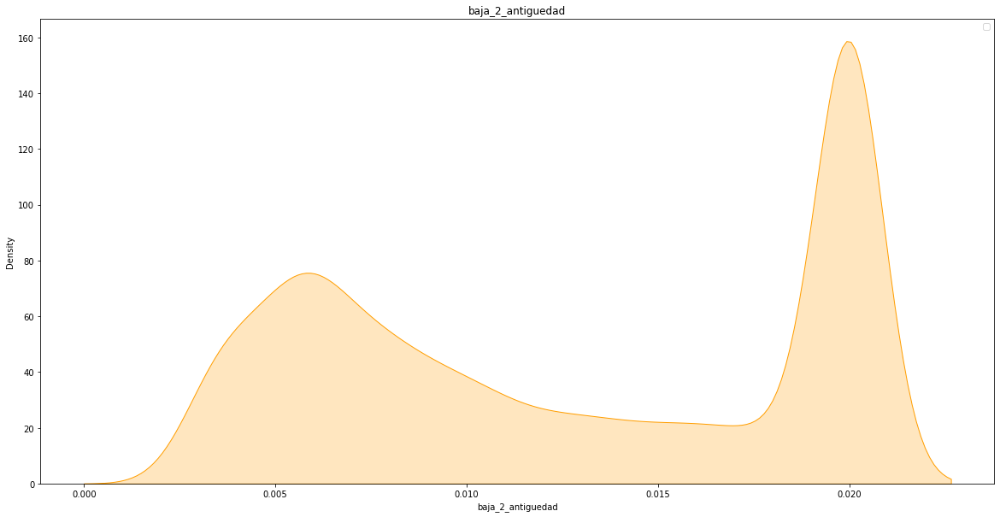

In [22]:
#plot te variables ending in _edad and _antiguedad

for i in df.columns:
    if i.endswith('_edad') or i.endswith('_antiguedad'):
        plt.figure(figsize=(20, 10))
        sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
        plt.xlabel(i)
        plt.ylabel('Density')
        plt.title(i)
        plt.legend()
        sns.kdeplot(x=df_bajas.loc[df_bajas['baja_2'] == 1, i].clip(upper=df_bajas[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#FF9E00', label='Baja', fill =True)
        plt.show()

/tmp/ipykernel_2345/1185719486.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_continua['total_consumos_edad'] = df_continua['total_consumos']/df_continua['cliente_edad']
/tmp/ipykernel_2345/1185719486.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_continua['total_consumos_edad'] = df_continua['total_consumos']/df_continua['cliente_edad']
/tmp/ipykernel_2345/1185719486.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has po

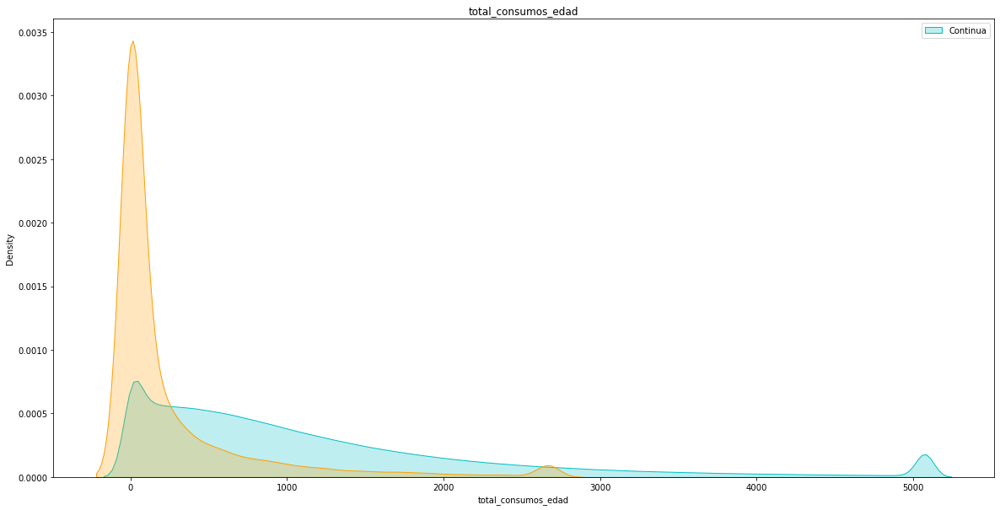

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

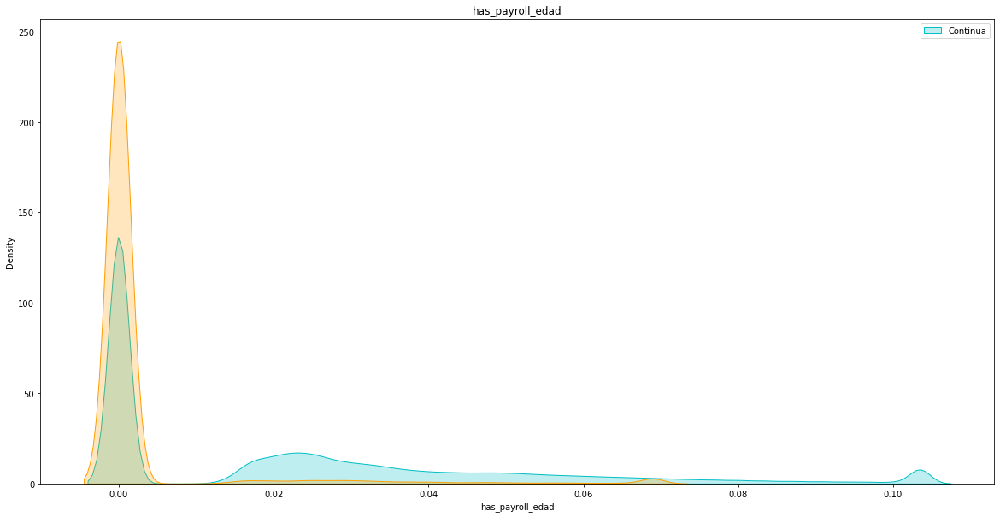

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

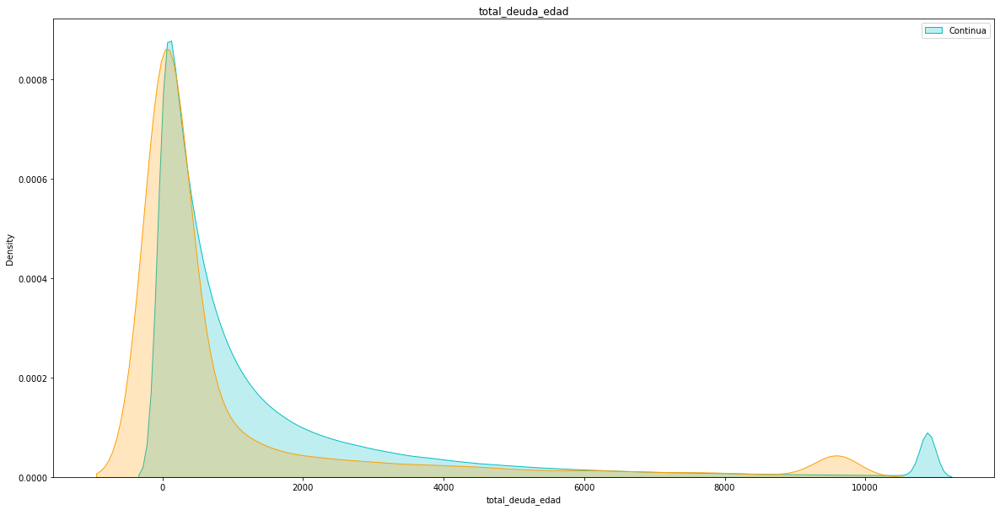

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

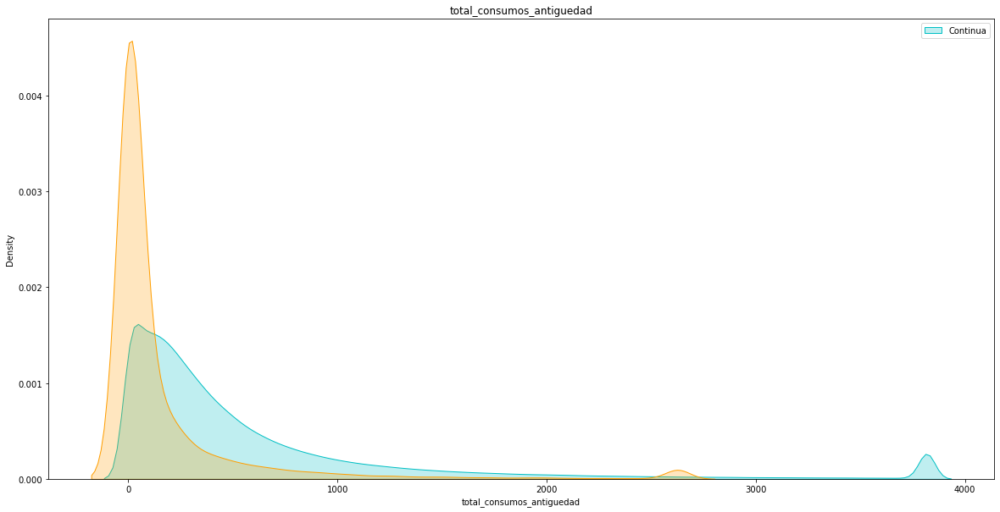

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

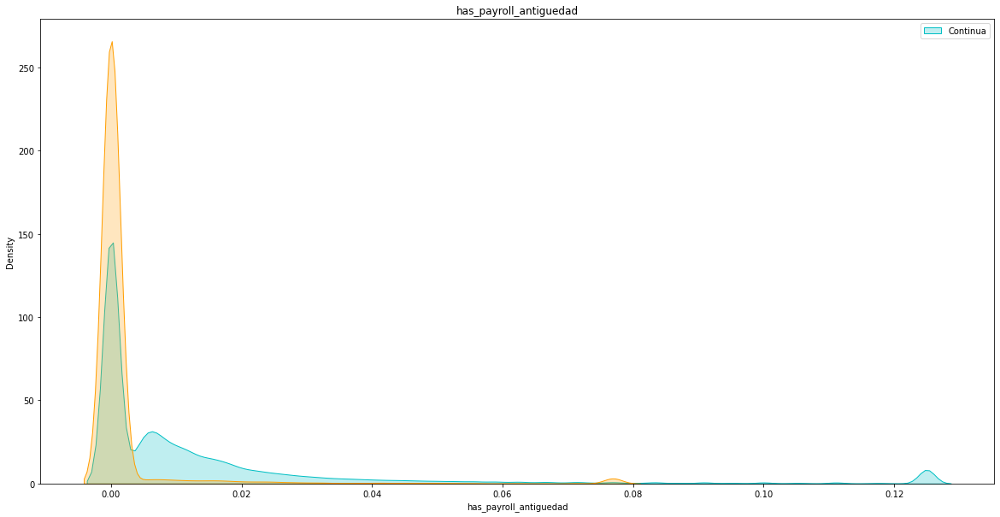

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

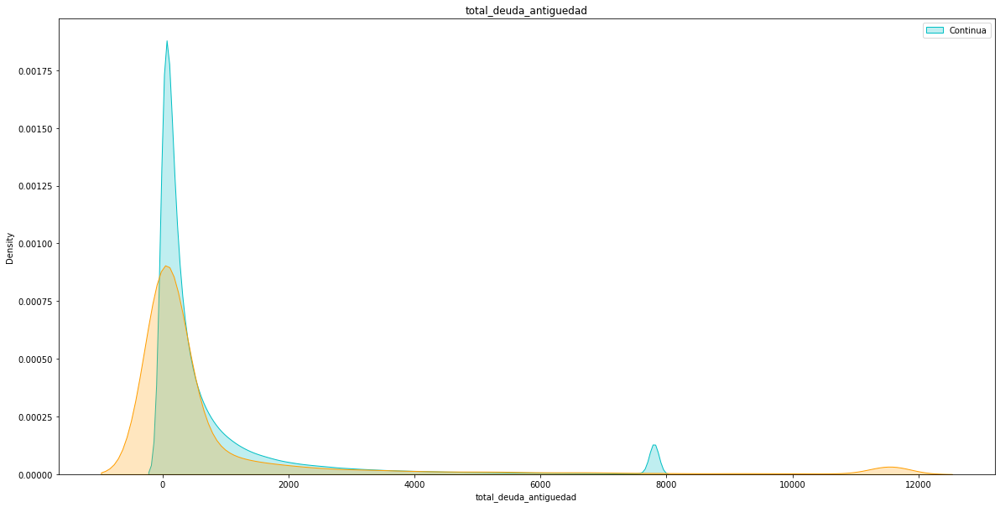

In [23]:
#total_consumos_edad, has_payroll_edad, total_deuda_edad, total_consumos_antiguedad, has_payroll_antiguedad, total_deuda_antiguedad
df_continua['total_consumos_edad'] = df_continua['total_consumos']/df_continua['cliente_edad']
df_continua['has_payroll_edad'] = df_continua['has_payroll']/df_continua['cliente_edad']
df_continua['total_deuda_edad'] = df_continua['total_deuda']/df_continua['cliente_edad']

df_continua['total_consumos_antiguedad'] = df_continua['total_consumos']/df_continua['cliente_antiguedad']
df_continua['has_payroll_antiguedad'] = df_continua['has_payroll']/df_continua['cliente_antiguedad']
df_continua['total_deuda_antiguedad'] = df_continua['total_deuda']/df_continua['cliente_antiguedad']

df_bajas['total_consumos_edad'] = df_bajas['total_consumos']/df_bajas['cliente_edad']
df_bajas['has_payroll_edad'] = df_bajas['has_payroll']/df_bajas['cliente_edad']
df_bajas['total_deuda_edad'] = df_bajas['total_deuda']/df_bajas['cliente_edad']

df_bajas['total_consumos_antiguedad'] = df_bajas['total_consumos']/df_bajas['cliente_antiguedad']
df_bajas['has_payroll_antiguedad'] = df_bajas['has_payroll']/df_bajas['cliente_antiguedad']
df_bajas['total_deuda_antiguedad'] = df_bajas['total_deuda']/df_bajas['cliente_antiguedad']

for i in ['total_consumos_edad', 'has_payroll_edad', 'total_deuda_edad', 'total_consumos_antiguedad', 'has_payroll_antiguedad', 'total_deuda_antiguedad']:
        plt.figure(figsize=(20, 10))
        sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
        plt.xlabel(i)
        plt.ylabel('Density')
        plt.title(i)
        plt.legend()
        sns.kdeplot(x=df_bajas.loc[df_bajas['baja_2'] == 1, i].clip(upper=df_bajas[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#FF9E00', label='Baja', fill =True)
        plt.show()

In [17]:
#Visa_limitecompra and Master_limitecompra in one variable
df['limitecompra'] = df['Visa_mlimitecompra'] + df['Master_mlimitecompra']

df_continua['limitecompra'] = df_continua['Visa_mlimitecompra'] + df_continua['Master_mlimitecompra']

df_bajas['limitecompra'] = df_bajas['Visa_mlimitecompra'] + df_bajas['Master_mlimitecompra']

/tmp/ipykernel_2813/3748459605.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df['limitecompra'] = df['Visa_mlimitecompra'] + df['Master_mlimitecompra']
/tmp/ipykernel_2813/3748459605.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_continua['limitecompra'] = df_continua['Visa_mlimitecompra'] + df_continua['Master_mlimitecompra']
/tmp/ipykernel_2813/3748459605.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

/tmp/ipykernel_2247/3691203920.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_continua['limitecompra'] = df_continua['Visa_mlimitecompra'] + df_continua['Master_mlimitecompra']
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local

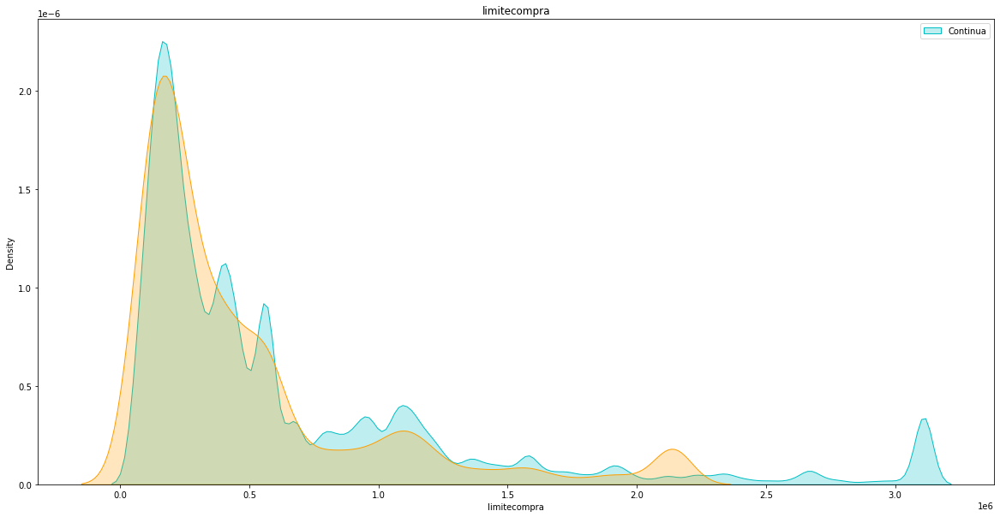

In [16]:
#Visa_limitecompra and Master_limitecompra in one variable
df['limitecompra'] = df['Visa_mlimitecompra'] + df['Master_mlimitecompra']

df_continua['limitecompra'] = df_continua['Visa_mlimitecompra'] + df_continua['Master_mlimitecompra']

df_bajas['limitecompra'] = df_bajas['Visa_mlimitecompra'] + df_bajas['Master_mlimitecompra']

for i in ['limitecompra']:
        plt.figure(figsize=(20, 10))
        sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
        plt.xlabel(i)
        plt.ylabel('Density')
        plt.title(i)
        plt.legend()
        sns.kdeplot(x=df_bajas.loc[df_bajas['baja_2'] == 1, i].clip(upper=df_bajas[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#FF9E00', label='Baja', fill =True)
        plt.show()

/tmp/ipykernel_2813/3227294767.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_continua['total_deuda_mes_anterior'] = df_continua.groupby('numero_de_cliente')['total_deuda'].shift(1)
/tmp/ipykernel_2813/3227294767.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_continua['diff_total_deuda'] = df_continua['total_deuda'] - df_continua['total_deuda_mes_anterior']
/tmp/ipykernel_2813/3227294767.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

<AxesSubplot:xlabel='foto_mes_date'>

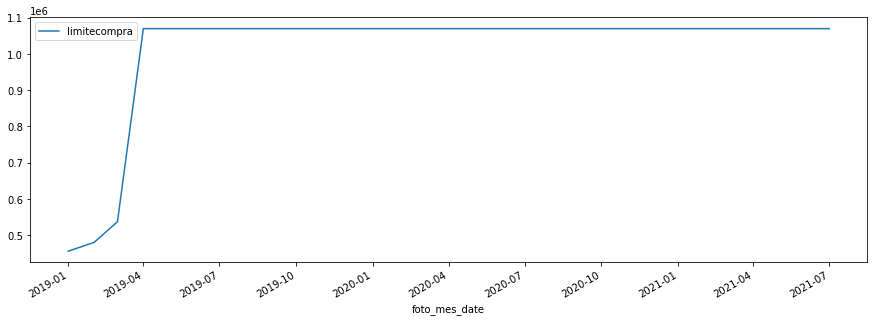

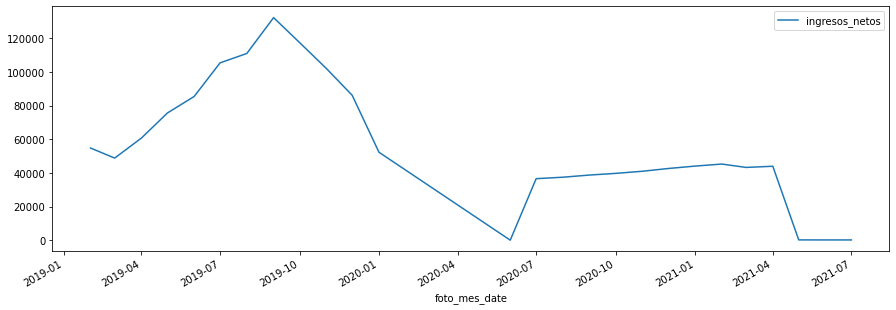

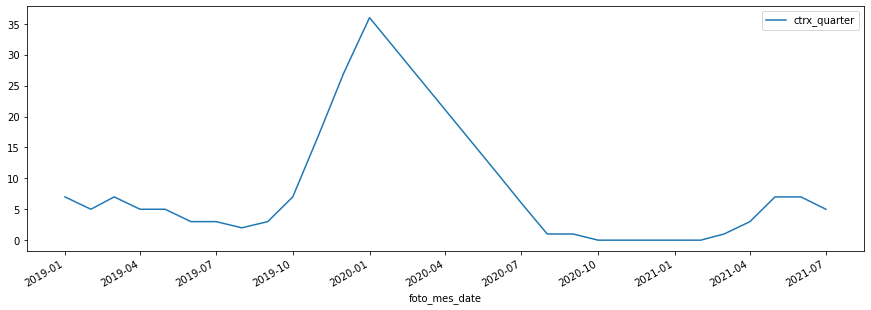

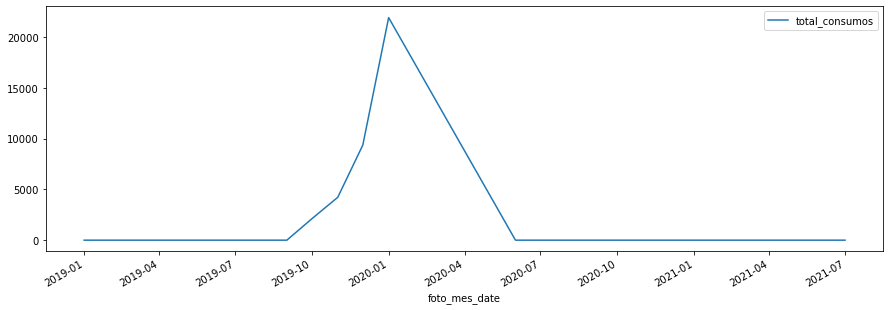

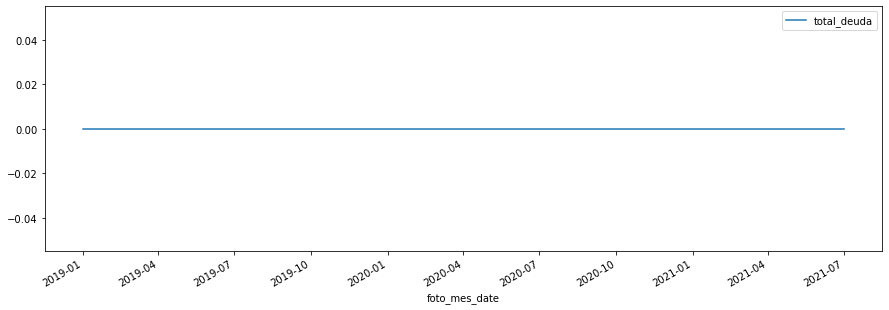

...

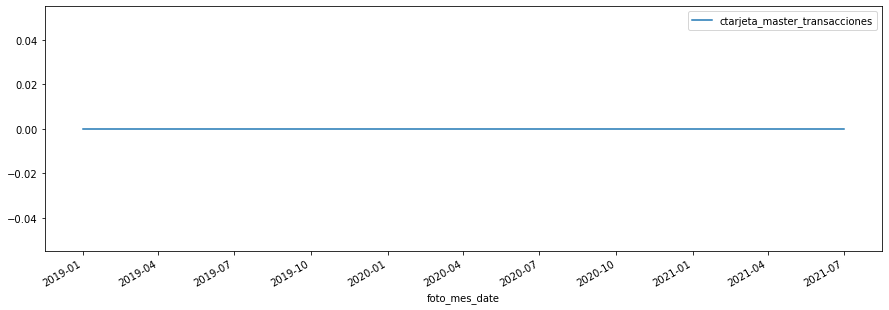

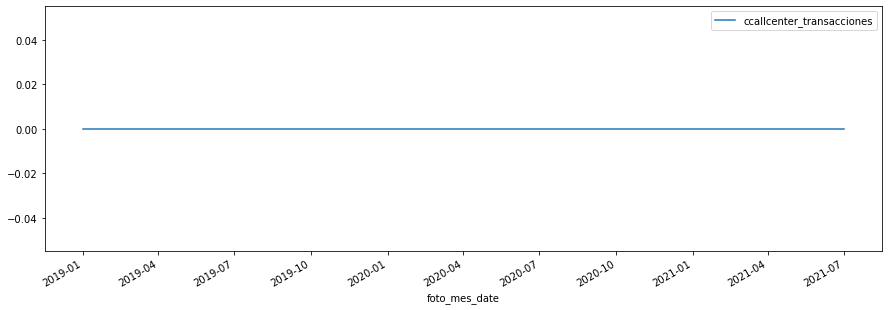

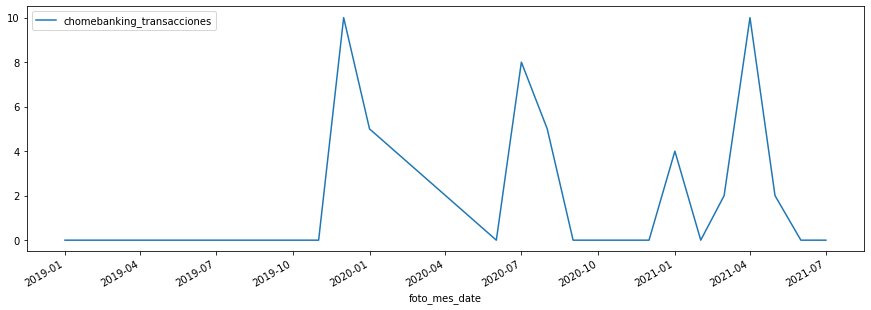

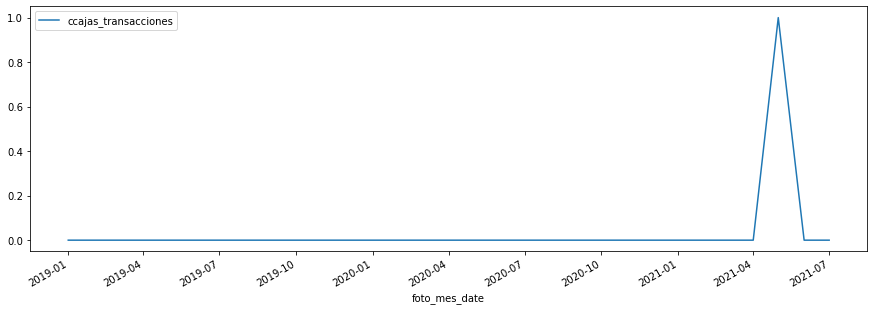

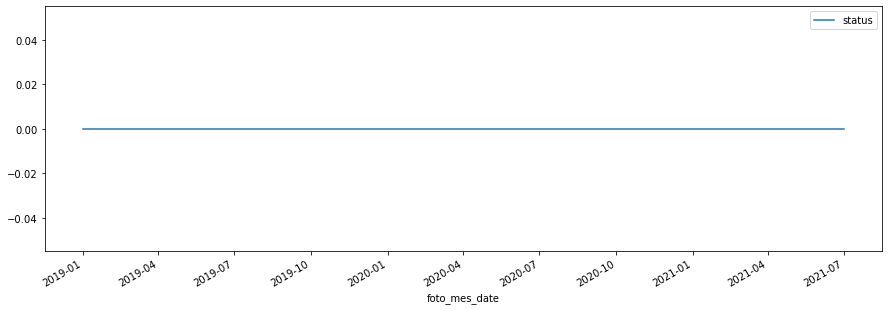

In [41]:
#new column diff total_deuda, which is total_deuda in current month minus total_deuda in previous month
df['total_deuda_mes_anterior'] = df.groupby('numero_de_cliente')['total_deuda'].shift(1)
df['diff_total_deuda'] = df['total_deuda'] - df['total_deuda_mes_anterior']
df['ingresos_netos'] =  df['mcuentas_saldo'] - df['diff_total_deuda']

df_bajas['total_deuda_mes_anterior'] = df_bajas.groupby('numero_de_cliente')['total_deuda'].shift(1)
df_bajas['diff_total_deuda'] = df_bajas['total_deuda'] - df_bajas['total_deuda_mes_anterior']
df_bajas['ingresos_netos'] =  df_bajas['mcuentas_saldo'] - df_bajas['diff_total_deuda']

df_continua['total_deuda_mes_anterior'] = df_continua.groupby('numero_de_cliente')['total_deuda'].shift(1)
df_continua['diff_total_deuda'] = df_continua['total_deuda'] - df_continua['total_deuda_mes_anterior']
df_continua['ingresos_netos'] =  df_continua['mcuentas_saldo'] - df_continua['diff_total_deuda']
#plot limitecompra for a random numero_de_cliente where baja_2 is 1, use foto_mes_date as x axis
cliente = df_bajas.sample()['numero_de_cliente'].values[0]
df_bajas.loc[df_bajas['numero_de_cliente'] == cliente].plot(x='foto_mes_date', y='limitecompra', figsize=(15, 5))
#plot ingresos_netos
df_bajas.loc[df_bajas['numero_de_cliente'] == cliente].plot(x='foto_mes_date', y='ingresos_netos', figsize=(15, 5))
#plot ctrx_quarter for a random numero_de_cliente where baja_2 is 1, use foto_mes_date as x axis
df_bajas.loc[df_bajas['numero_de_cliente'] == cliente].plot(x='foto_mes_date', y='ctrx_quarter', figsize=(15, 5))
#total_consumos
df_bajas.loc[df_bajas['numero_de_cliente'] == cliente].plot(x='foto_mes_date', y='total_consumos', figsize=(15, 5))
#total_deudas
df_bajas.loc[df_bajas['numero_de_cliente'] == cliente].plot(x='foto_mes_date', y='total_deuda', figsize=(15, 5))
#has_payroll
df_bajas.loc[df_bajas['numero_de_cliente'] == cliente].plot(x='foto_mes_date', y='has_payroll', figsize=(15, 5))
#Visa_Finciomora
df_bajas.loc[df_bajas['numero_de_cliente'] == cliente].plot(x='foto_mes_date', y='Visa_Finiciomora', figsize=(15, 5))
#Master_Finciomora
df_bajas.loc[df_bajas['numero_de_cliente'] == cliente].plot(x='foto_mes_date', y='Master_Finiciomora', figsize=(15, 5))
#mpayroll
df_bajas.loc[df_bajas['numero_de_cliente'] == cliente].plot(x='foto_mes_date', y='mpayroll', figsize=(15, 5))
#Visa_msaldopesos
df_bajas.loc[df_bajas['numero_de_cliente'] == cliente].plot(x='foto_mes_date', y='mcuentas_saldo', figsize=(15, 5))

#if variable ends in _transacciones, plot it
for i in df.columns:
    if i.endswith('_transacciones'):
        df_bajas.loc[df_bajas['numero_de_cliente'] == cliente].plot(x='foto_mes_date', y=i, figsize=(15, 5))

#Master_status + Visa_status /2
df['status'] = (df['Master_status'] + df['Visa_status'])/2
df_bajas['status'] = (df_bajas['Master_status'] + df_bajas['Visa_status'])/2
df_continua['status'] = (df_continua['Master_status'] + df_continua['Visa_status'])/2

#plot status
df_bajas.loc[df_bajas['numero_de_cliente'] == cliente].plot(x='foto_mes_date', y='status', figsize=(15, 5))

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

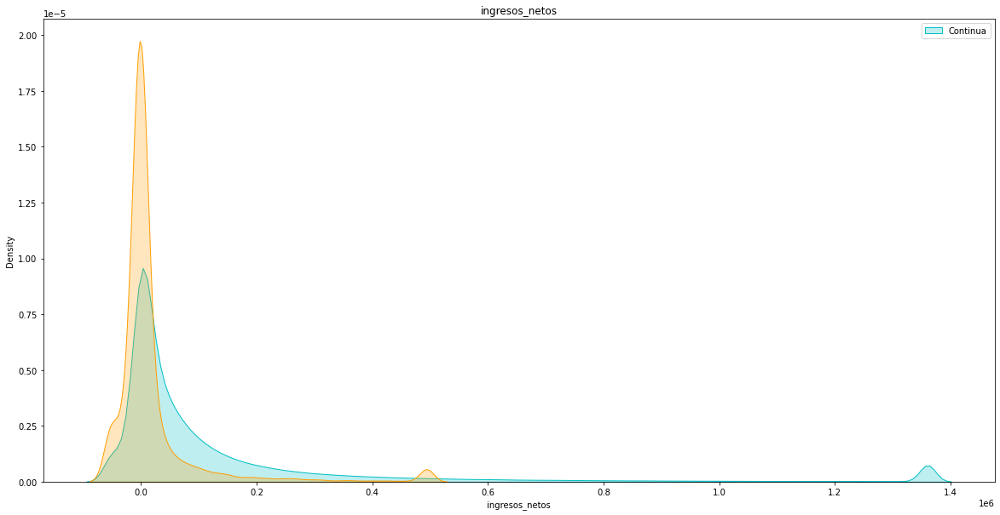

In [29]:
for i in ['ingresos_netos']:
        plt.figure(figsize=(20, 10))
        sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
        plt.xlabel(i)
        plt.ylabel('Density')
        plt.title(i)
        plt.legend()
        sns.kdeplot(x=df_bajas.loc[df_bajas['baja_2'] == 1, i].clip(upper=df_bajas[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#FF9E00', label='Baja', fill =True)
        plt.show()

/tmp/ipykernel_2813/833976176.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_continua['ingresos_netos_edad'] = df_continua['ingresos_netos']/df_continua['cliente_edad']
/tmp/ipykernel_2813/833976176.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_continua['ingresos_netos_edad'] = df_continua['ingresos_netos']/df_continua['cliente_edad']
/tmp/ipykernel_2813/833976176.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor 

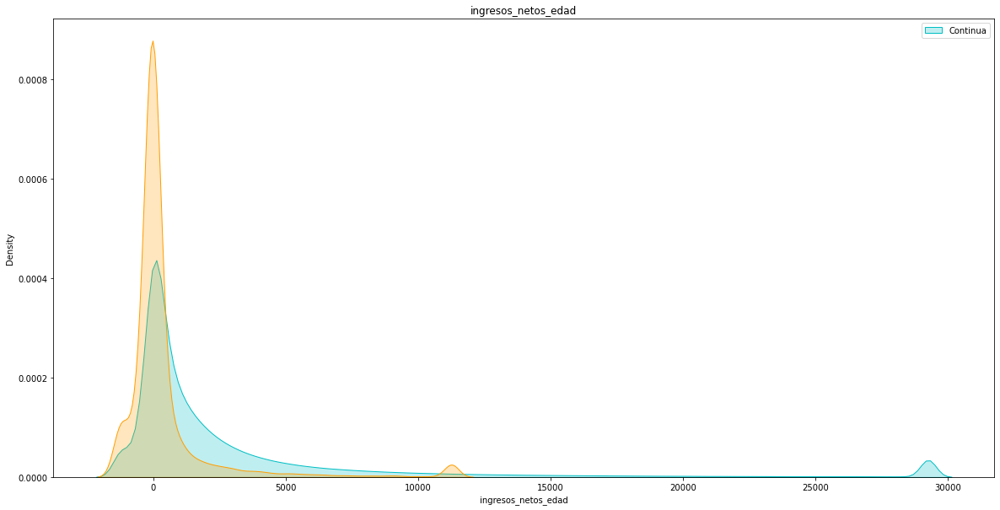

/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/ailicicisely/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf va

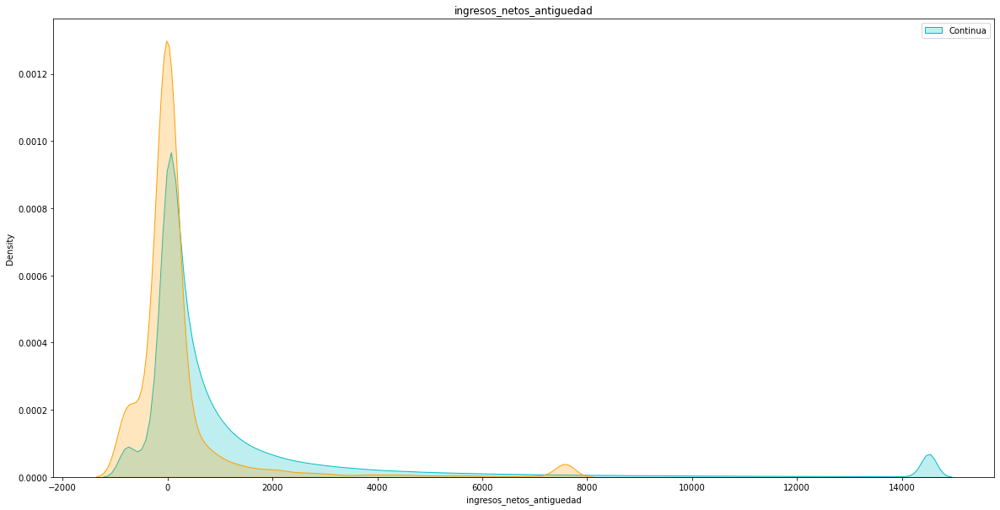

In [36]:
#ingresos_netos_edad, ingresos_netos_antiguedad
df_continua['ingresos_netos_edad'] = df_continua['ingresos_netos']/df_continua['cliente_edad']
df_continua['ingresos_netos_antiguedad'] = df_continua['ingresos_netos']/df_continua['cliente_antiguedad']

df_bajas['ingresos_netos_edad'] = df_bajas['ingresos_netos']/df_bajas['cliente_edad']
df_bajas['ingresos_netos_antiguedad'] = df_bajas['ingresos_netos']/df_bajas['cliente_antiguedad']

for i in ['ingresos_netos_edad', 'ingresos_netos_antiguedad']:
        plt.figure(figsize=(20, 10))
        sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
        plt.xlabel(i)
        plt.ylabel('Density')
        plt.title(i)
        plt.legend()
        sns.kdeplot(x=df_bajas.loc[df_bajas['baja_2'] == 1, i].clip(upper=df_bajas[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#FF9E00', label='Baja', fill =True)
        plt.show()

/tmp/ipykernel_2813/2836845196.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df['ingresos_netos_mes_anterior'] = df.groupby('numero_de_cliente')['ingresos_netos'].shift(1)
/tmp/ipykernel_2813/2836845196.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df['diff_ingresos_netos'] = df['ingresos_netos'] - df['ingresos_netos_mes_anterior']
/tmp/ipykernel_2813/2836845196.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Cons

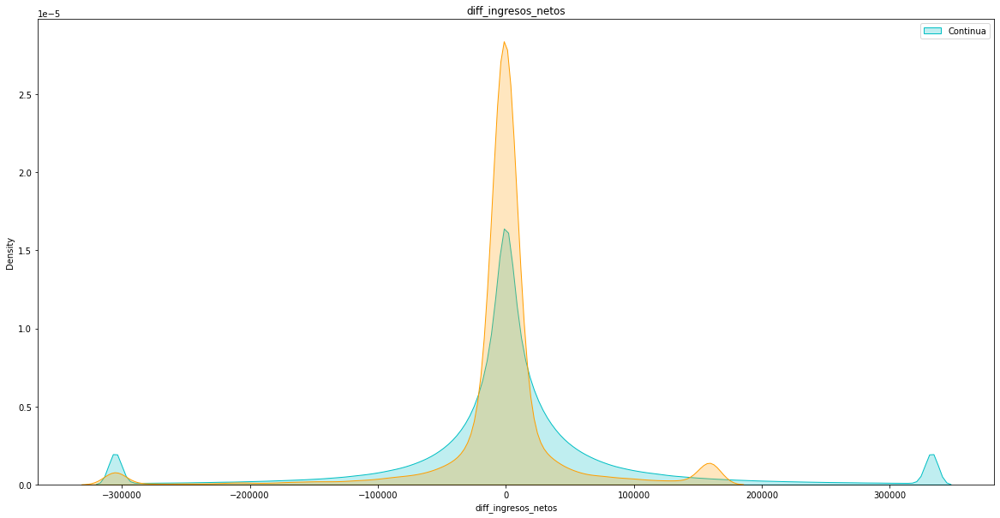

In [35]:
#ingresos_netos diff
df['ingresos_netos_mes_anterior'] = df.groupby('numero_de_cliente')['ingresos_netos'].shift(1)
df['diff_ingresos_netos'] = df['ingresos_netos'] - df['ingresos_netos_mes_anterior']

df_bajas['ingresos_netos_mes_anterior'] = df_bajas.groupby('numero_de_cliente')['ingresos_netos'].shift(1)
df_bajas['diff_ingresos_netos'] = df_bajas['ingresos_netos'] - df_bajas['ingresos_netos_mes_anterior']

df_continua['ingresos_netos_mes_anterior'] = df_continua.groupby('numero_de_cliente')['ingresos_netos'].shift(1)
df_continua['diff_ingresos_netos'] = df_continua['ingresos_netos'] - df_continua['ingresos_netos_mes_anterior']

for i in ['diff_ingresos_netos']:
        plt.figure(figsize=(20, 10))
        sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
        plt.xlabel(i)
        plt.ylabel('Density')
        plt.title(i)
        plt.legend()
        sns.kdeplot(x=df_bajas.loc[df_bajas['baja_2'] == 1, i].clip(upper=df_bajas[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#FF9E00', label='Baja', fill =True)
        plt.show()

/tmp/ipykernel_2813/930603152.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df['has_payroll_ma'] = df.groupby('numero_de_cliente')['has_payroll'].rolling(3).mean().reset_index(0, drop=True)
/tmp/ipykernel_2813/930603152.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_bajas['has_payroll_ma'] = df_bajas.groupby('numero_de_cliente')['has_payroll'].rolling(3).mean().reset_index(0, drop=True)
/tmp/ipykernel_2813/930603152.py:6: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `fr

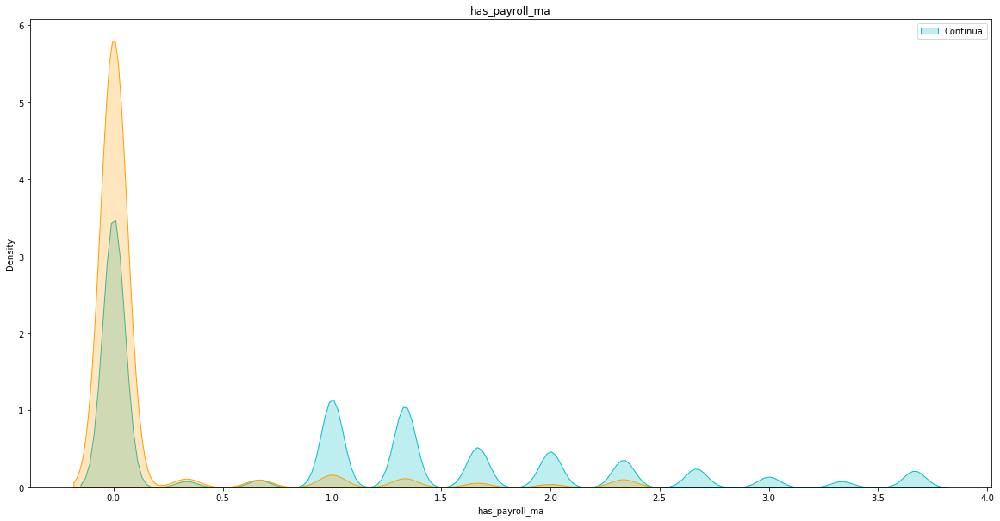

In [31]:
#create a moving average of 3 months for has_payroll
df['has_payroll_ma'] = df.groupby('numero_de_cliente')['has_payroll'].rolling(3).mean().reset_index(0, drop=True)

df_bajas['has_payroll_ma'] = df_bajas.groupby('numero_de_cliente')['has_payroll'].rolling(3).mean().reset_index(0, drop=True)

df_continua['has_payroll_ma'] = df_continua.groupby('numero_de_cliente')['has_payroll'].rolling(3).mean().reset_index(0, drop=True)

for i in ['has_payroll_ma']:
        plt.figure(figsize=(20, 10))
        sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
        plt.xlabel(i)
        plt.ylabel('Density')
        plt.title(i)
        plt.legend()
        sns.kdeplot(x=df_bajas.loc[df_bajas['baja_2'] == 1, i].clip(upper=df_bajas[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#FF9E00', label='Baja', fill =True)
        plt.show()

/tmp/ipykernel_2813/1776208249.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df['mpagominimo'] = df['Visa_mpagominimo'] + df['Master_mpagominimo']
/tmp/ipykernel_2813/1776208249.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_bajas['mpagominimo'] = df_bajas['Visa_mpagominimo'] + df_bajas['Master_mpagominimo']
/tmp/ipykernel_2813/1776208249.py:6: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all colum

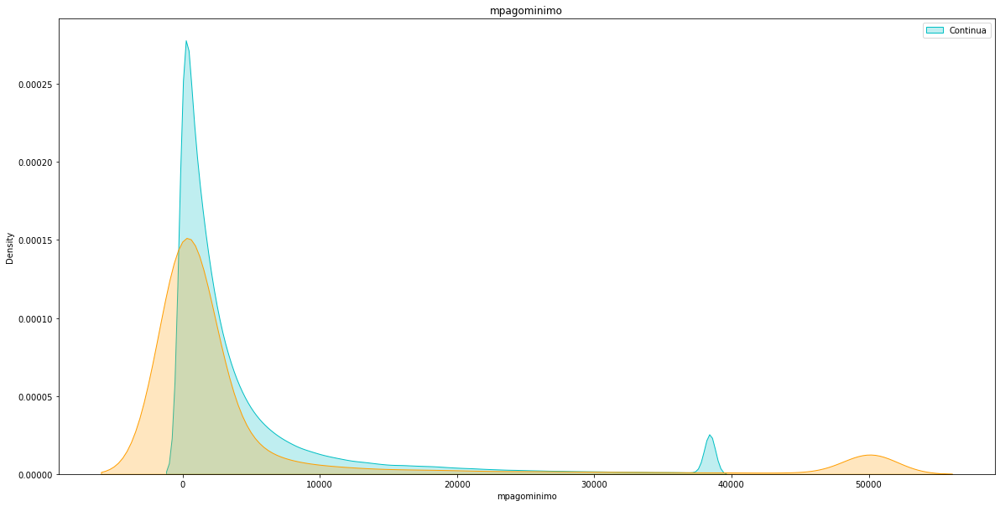

In [42]:
#Visa_mpagominimo + Master_mpagominimo
df['mpagominimo'] = df['Visa_mpagominimo'] + df['Master_mpagominimo']

df_bajas['mpagominimo'] = df_bajas['Visa_mpagominimo'] + df_bajas['Master_mpagominimo']

df_continua['mpagominimo'] = df_continua['Visa_mpagominimo'] + df_continua['Master_mpagominimo']

for i in ['mpagominimo']:
        plt.figure(figsize=(20, 10))
        sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
        plt.xlabel(i)
        plt.ylabel('Density')
        plt.title(i)
        plt.legend()
        sns.kdeplot(x=df_bajas.loc[df_bajas['baja_2'] == 1, i].clip(upper=df_bajas[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#FF9E00', label='Baja', fill =True)
        plt.show()

In [44]:
#describe
print(df_bajas['mpagominimo'].describe())
print(df_continua['mpagominimo'].describe())

count    192410.000
mean       6581.582
std       43871.539
min           0.000
25%           0.000
50%         434.010
75%        2299.080
max     3887110.860
Name: mpagominimo, dtype: float64
count   3295038.000
mean       6043.646
std       21511.801
min           0.000
25%         516.120
50%        1818.150
75%        4914.870
max     4771764.000
Name: mpagominimo, dtype: float64


/tmp/ipykernel_2987/3873379250.py:67: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_continua['vm_mfinanciacion_limite'] = df_continua[['Master_mfinanciacion_limite', 'Visa_mfinanciacion_limite']].sum(axis=1)
/tmp/ipykernel_2987/3873379250.py:68: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_continua['vm_Fvencimiento'] = df_continua[['Master_Fvencimiento', 'Visa_Fvencimiento']].min(axis=1)
/tmp/ipykernel_2987/3873379250.py:69: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice fr

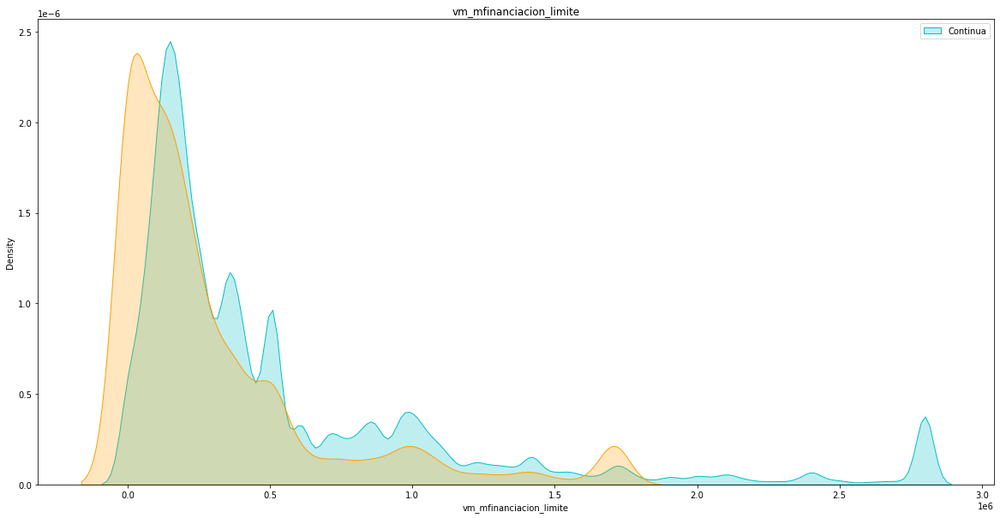

count      261081.000
mean       415723.441
std       2848286.722
min             0.000
25%         82344.600
50%        177357.600
75%        410527.400
max     219150405.030
Name: vm_mfinanciacion_limite, dtype: float64
count      3686828.000
mean        729163.374
std        4466654.769
min              0.000
25%         152020.800
50%         304041.600
75%         709430.400
max     1061019292.240
Name: vm_mfinanciacion_limite, dtype: float64


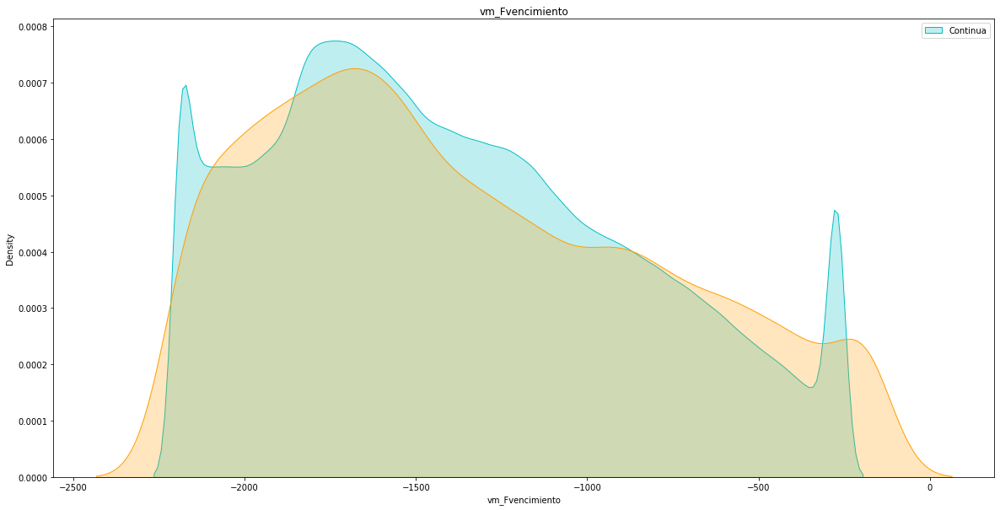

count     230894.000
mean      -11577.164
std       172146.041
min     -2914968.000
25%        -1826.000
50%        -1490.000
75%         -944.000
max         4626.000
Name: vm_Fvencimiento, dtype: float64
count    3579361.000
mean      -12262.821
std       177663.297
min     -2914968.000
25%        -1796.000
50%        -1460.000
75%        -1033.000
max         6790.000
Name: vm_Fvencimiento, dtype: float64


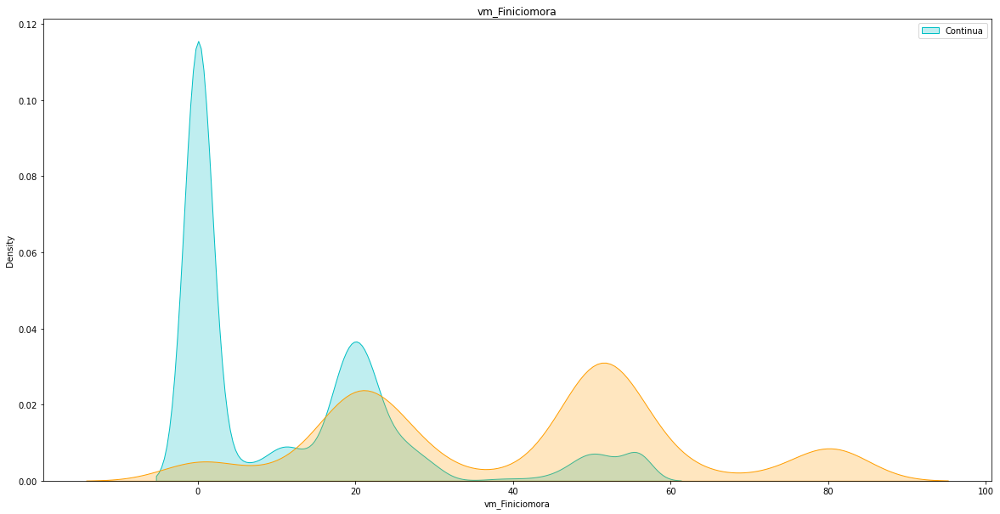

count   11653.000
mean       26.513
std        23.277
min        -1.000
25%        14.000
50%        21.000
75%        46.000
max       261.000
Name: vm_Finiciomora, dtype: float64
count   52113.000
mean       12.799
std        19.498
min        -1.000
25%         0.000
50%         0.000
75%        21.000
max       323.000
Name: vm_Finiciomora, dtype: float64


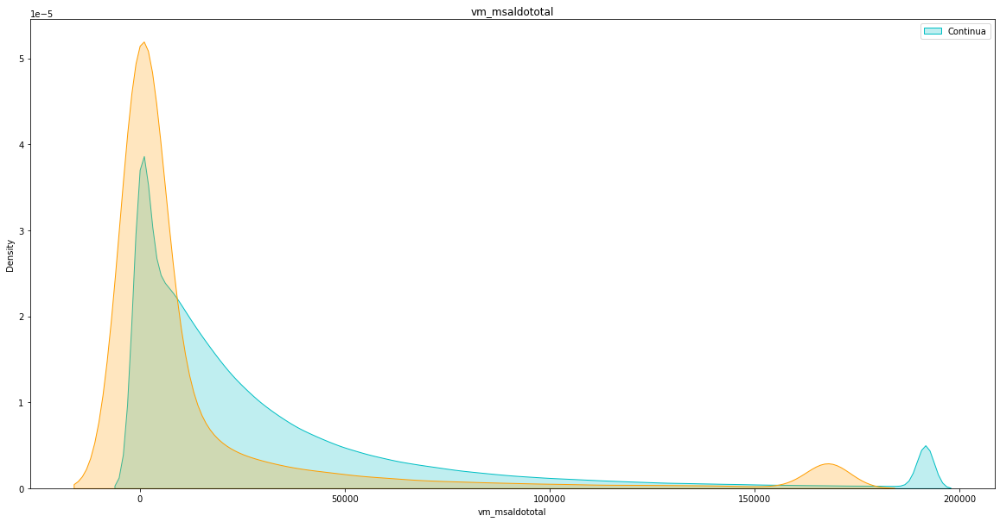

count     261081.000
mean       23040.724
std        85724.460
min     -1079817.350
25%            0.000
50%         2445.100
75%        16944.500
max      6302363.500
Name: vm_msaldototal, dtype: float64
count    3686828.000
mean       36397.678
std        78992.860
min     -1952267.650
25%         5081.662
50%        17230.835
75%        40944.480
max      9506846.110
Name: vm_msaldototal, dtype: float64


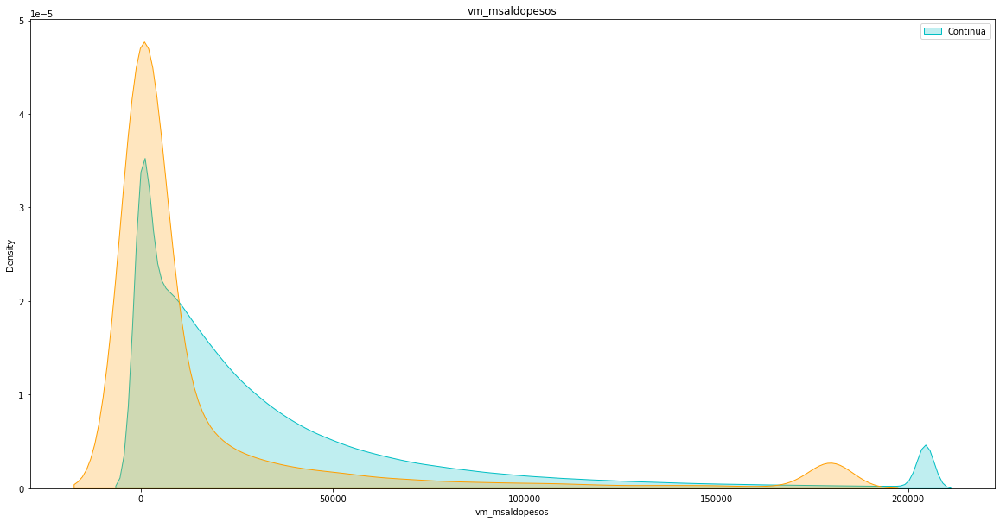

count     261081.000
mean       24707.381
std        89787.386
min     -1227014.280
25%            0.000
50%         2683.260
75%        18563.180
max      7392672.380
Name: vm_msaldopesos, dtype: float64
count    3686828.000
mean       39640.601
std        82838.874
min     -1901000.970
25%         5740.010
50%        19294.380
75%        45307.773
max     10208918.870
Name: vm_msaldopesos, dtype: float64


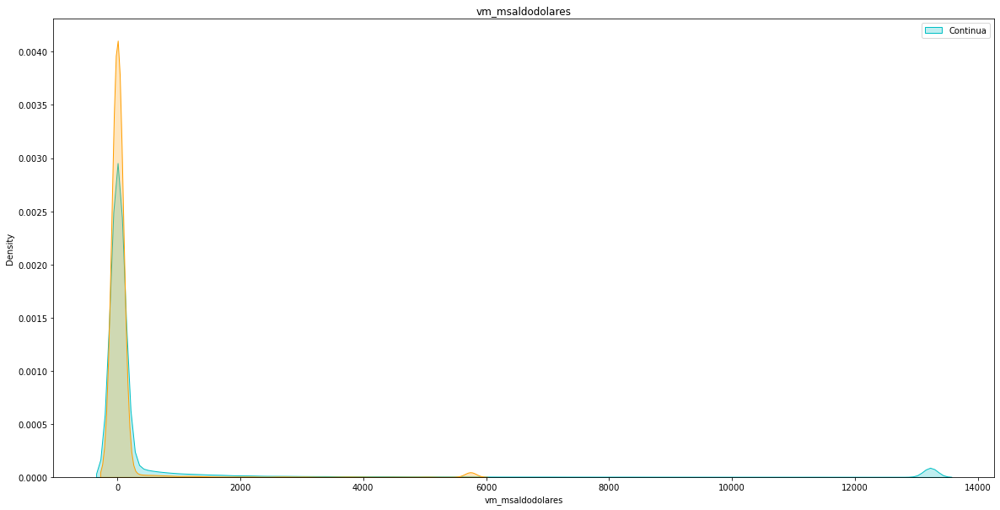

count     261081.000
mean        1174.755
std        17955.071
min     -1060335.820
25%            0.000
50%            0.000
75%            0.000
max      2699810.930
Name: vm_msaldodolares, dtype: float64
count    3686828.000
mean        1636.393
std        18818.476
min     -1383833.480
25%            0.000
50%            0.000
75%            0.000
max      4875765.410
Name: vm_msaldodolares, dtype: float64


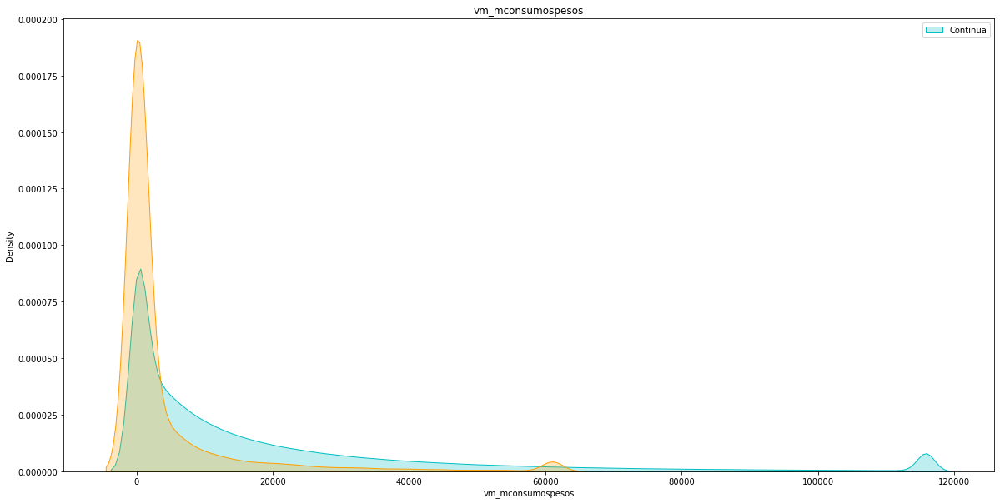

count    261081.000
mean       8611.589
std       28902.555
min      -93516.270
25%           0.000
50%         442.030
75%        7207.190
max     2703071.680
Name: vm_mconsumospesos, dtype: float64
count   3686828.000
mean      20779.041
std       43797.511
min     -182425.240
25%         969.078
50%        8002.435
75%       24044.615
max     6481235.560
Name: vm_mconsumospesos, dtype: float64


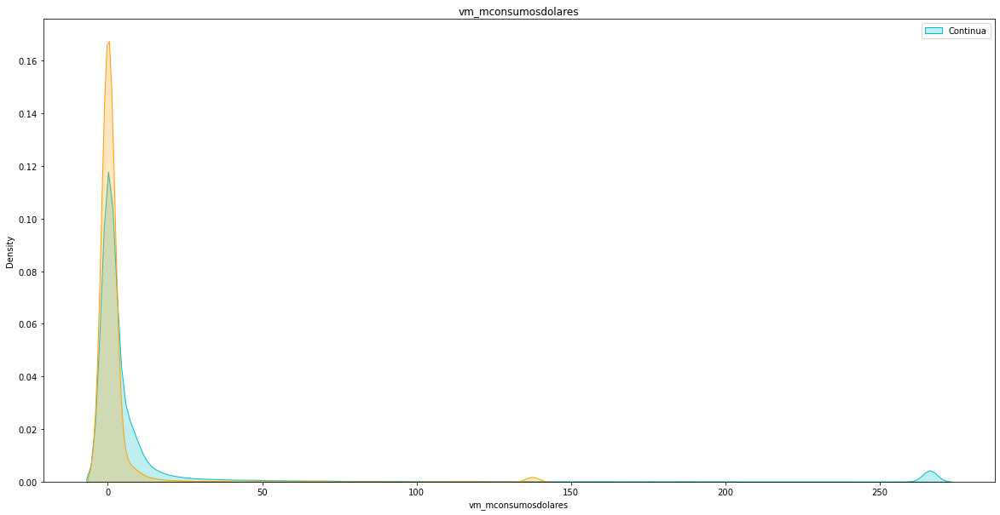

count   261081.000
mean        26.843
std        303.281
min          0.000
25%          0.000
50%          0.000
75%          0.000
max      34604.820
Name: vm_mconsumosdolares, dtype: float64
count   3686828.000
mean         36.458
std         303.314
min           0.000
25%           0.000
50%           0.000
75%           5.520
max       64144.400
Name: vm_mconsumosdolares, dtype: float64


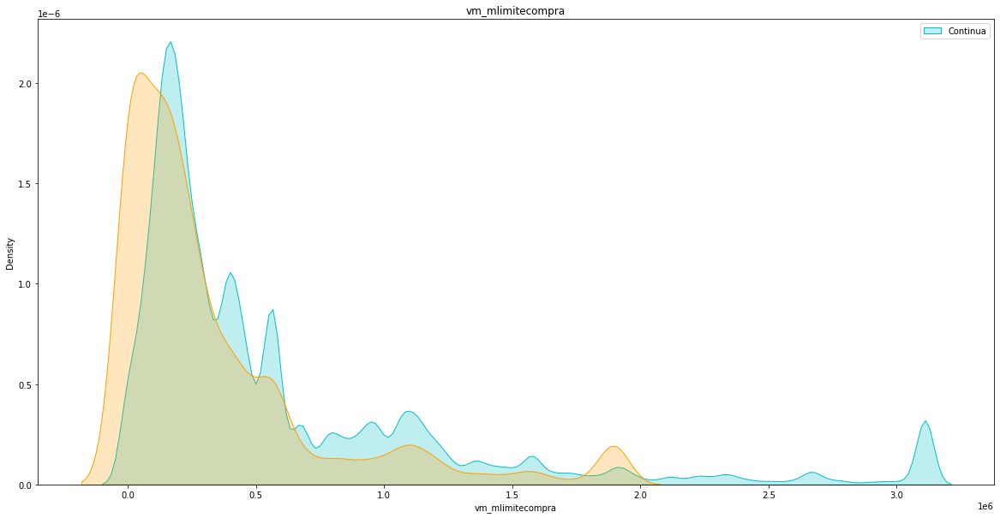

count     261081.000
mean      390009.559
std       587210.412
min            0.000
25%        98532.000
50%       197064.000
75%       456141.560
max     20353896.000
Name: vm_mlimitecompra, dtype: float64
count    3686828.000
mean      634473.659
std       881303.558
min            0.000
25%       168912.000
50%       337824.000
75%       788256.000
max     54347436.000
Name: vm_mlimitecompra, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


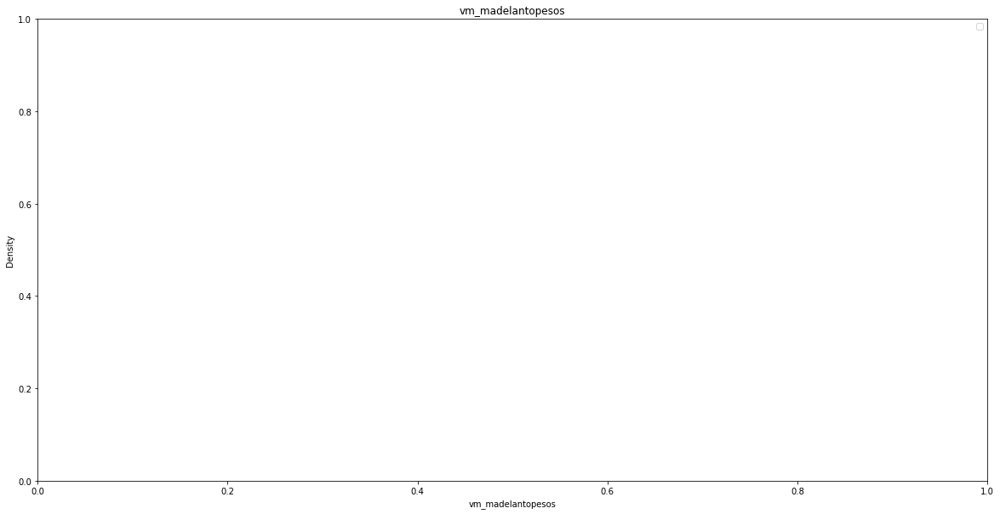

count   261081.000
mean       110.439
std       1587.696
min          0.000
25%          0.000
50%          0.000
75%          0.000
max     134921.320
Name: vm_madelantopesos, dtype: float64
count   3686828.000
mean         62.479
std        1155.090
min           0.000
25%           0.000
50%           0.000
75%           0.000
max      328398.150
Name: vm_madelantopesos, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


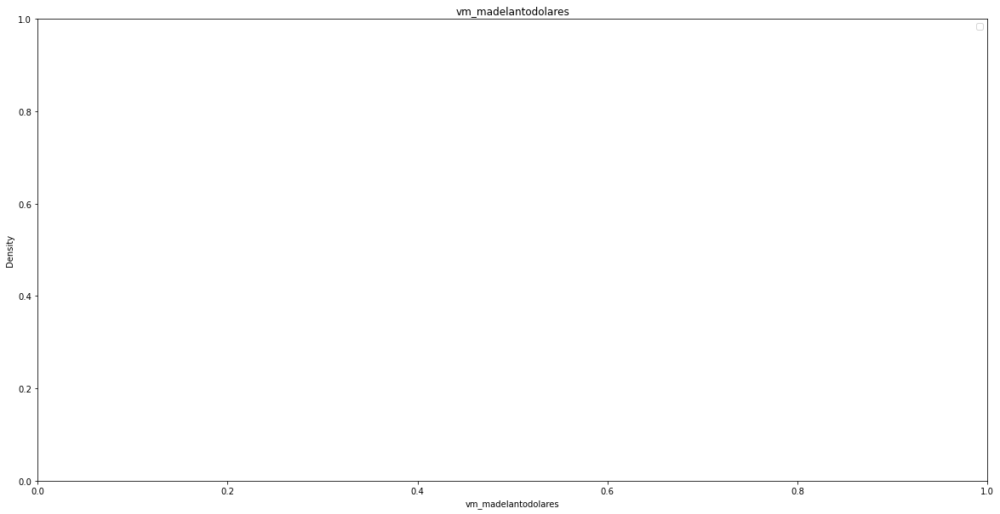

count   261081.000
mean         0.239
std         14.710
min          0.000
25%          0.000
50%          0.000
75%          0.000
max       2449.100
Name: vm_madelantodolares, dtype: float64
count   3686828.000
mean          0.108
std           8.228
min           0.000
25%           0.000
50%           0.000
75%           0.000
max        5523.930
Name: vm_madelantodolares, dtype: float64


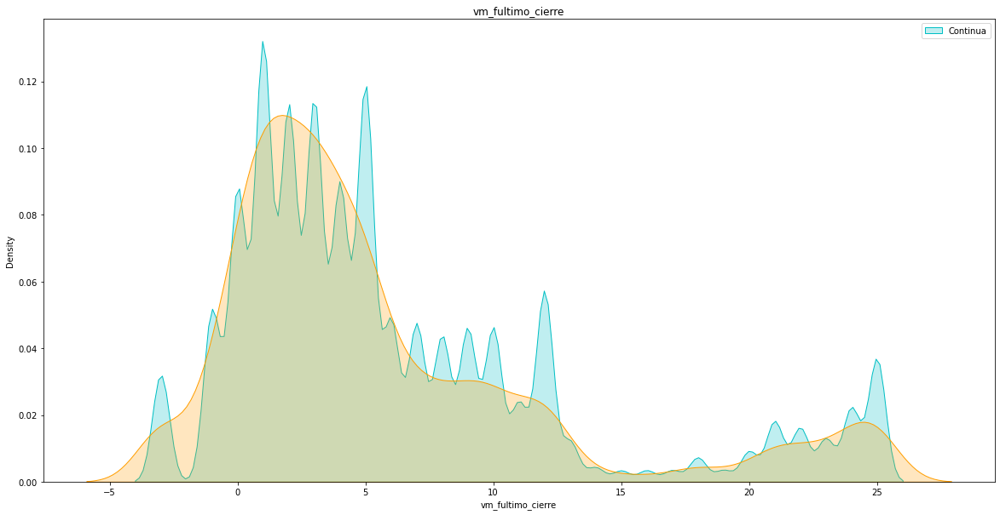

count   230775.000
mean         9.265
std         93.788
min         -3.000
25%          1.000
50%          4.000
75%          8.000
max       4728.000
Name: vm_fultimo_cierre, dtype: float64
count   3578099.000
mean          7.920
std          60.806
min          -3.000
25%           1.000
50%           4.000
75%           9.000
max        5092.000
Name: vm_fultimo_cierre, dtype: float64


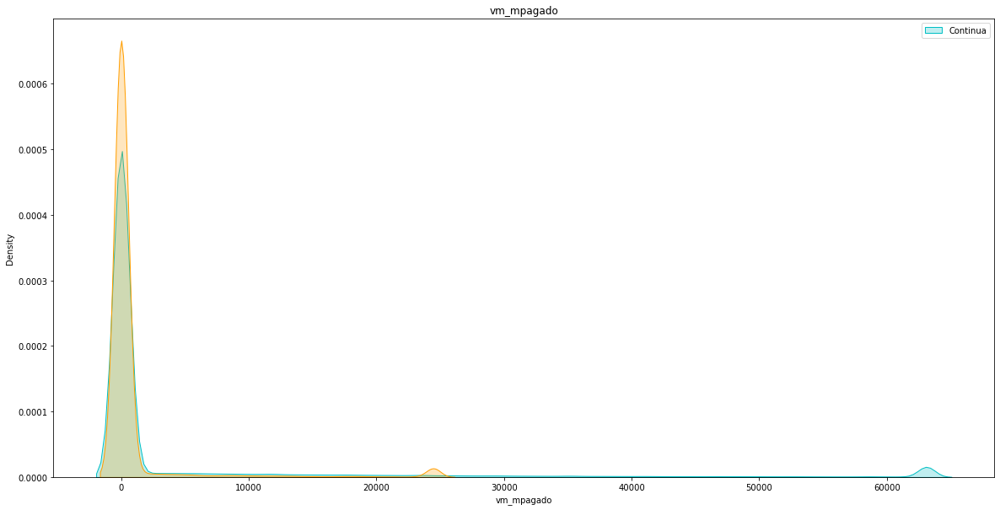

count    261081.000
mean       2171.584
std       14783.341
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     1704737.710
Name: vm_mpagado, dtype: float64
count   3686828.000
mean       6316.814
std       27022.624
min           0.000
25%           0.000
50%           0.000
75%           0.000
max     3455121.350
Name: vm_mpagado, dtype: float64


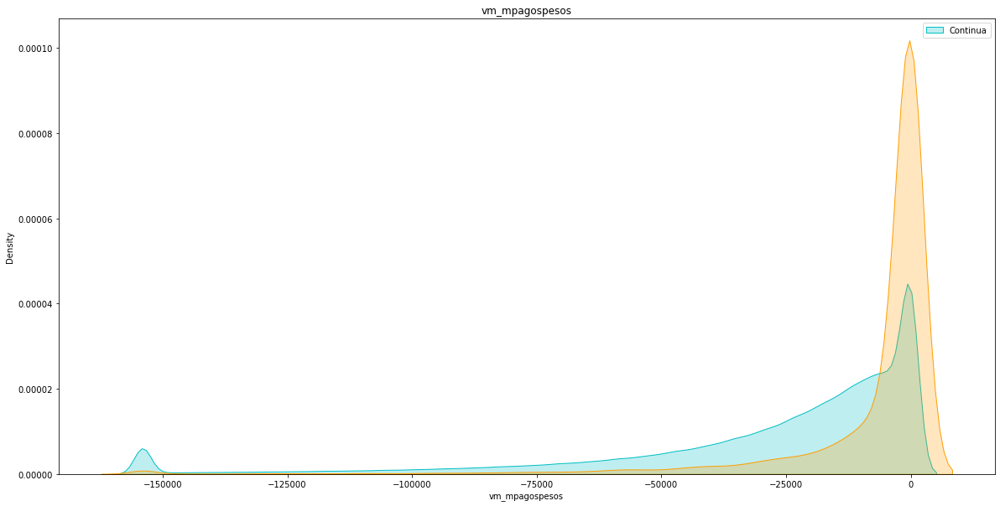

count     261081.000
mean      -12064.731
std        31600.989
min     -2987880.900
25%       -12846.690
50%        -1771.230
75%            0.000
max       361157.120
Name: vm_mpagospesos, dtype: float64
count    3686828.000
mean      -31524.676
std        54569.853
min     -6648362.330
25%       -38225.690
50%       -16746.700
75%        -4908.020
max      1003606.740
Name: vm_mpagospesos, dtype: float64


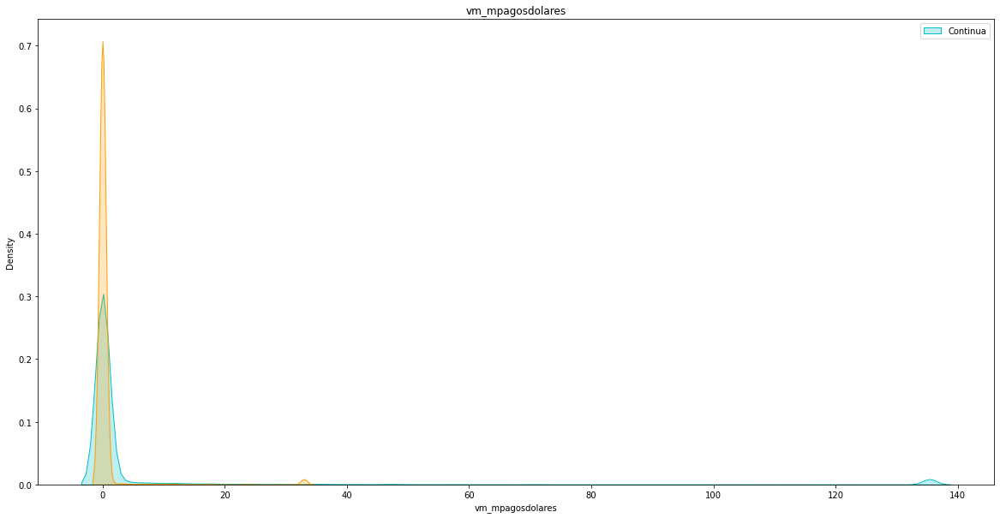

count   261081.000
mean        13.404
std        184.423
min          0.000
25%          0.000
50%          0.000
75%          0.000
max      22391.040
Name: vm_mpagosdolares, dtype: float64
count   3686828.000
mean         23.661
std         247.135
min           0.000
25%           0.000
50%           0.000
75%           0.000
max       37164.390
Name: vm_mpagosdolares, dtype: float64


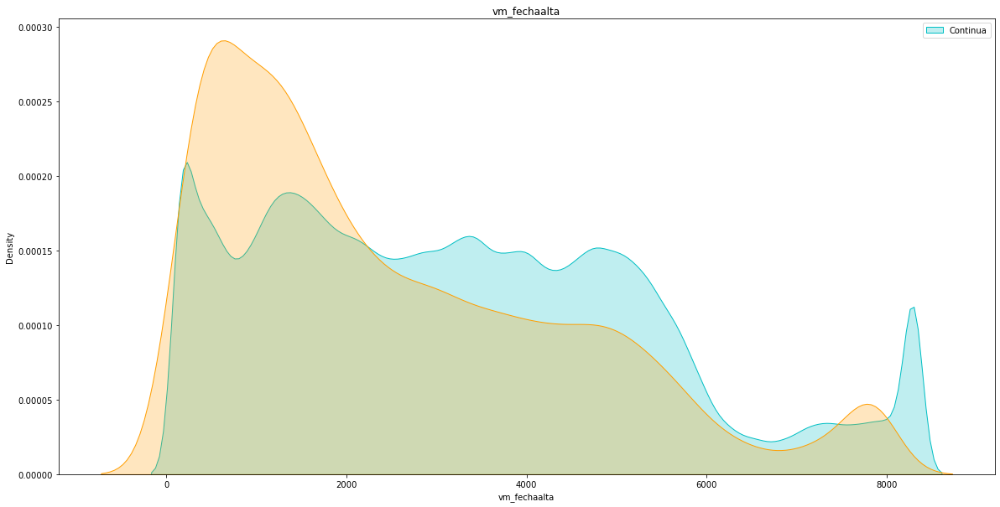

count   230894.000
mean      2546.205
std       2066.478
min          1.000
25%        867.000
50%       1977.000
75%       3912.000
max      11546.000
Name: vm_fechaalta, dtype: float64
count   3579361.000
mean       3261.296
std        2168.357
min           1.000
25%        1469.000
50%        3057.000
75%        4739.000
max       12767.000
Name: vm_fechaalta, dtype: float64


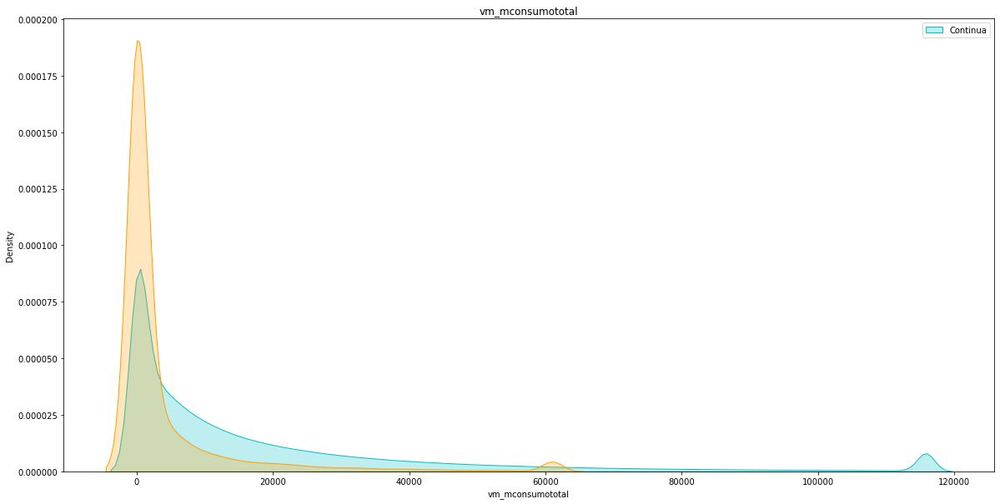

count    261081.000
mean       8611.589
std       28902.555
min      -93516.270
25%           0.000
50%         442.030
75%        7207.190
max     2703071.680
Name: vm_mconsumototal, dtype: float64
count   3686828.000
mean      20779.041
std       43797.511
min     -182425.240
25%         969.078
50%        8002.435
75%       24044.615
max     6481235.560
Name: vm_mconsumototal, dtype: float64


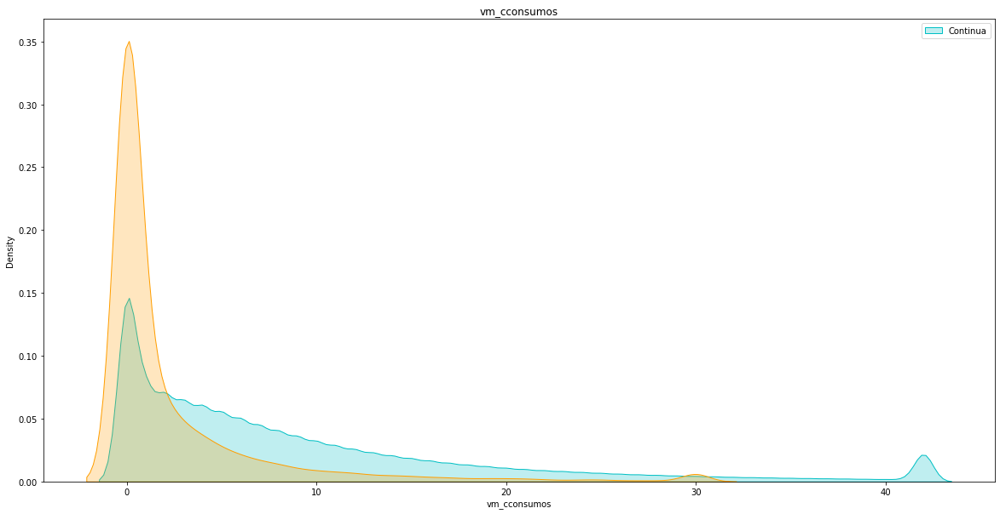

count   261081.000
mean         4.848
std          9.092
min          0.000
25%          0.000
50%          1.000
75%          6.000
max        242.000
Name: vm_cconsumos, dtype: float64
count   3686828.000
mean          9.418
std          12.136
min           0.000
25%           2.000
50%           6.000
75%          13.000
max         768.000
Name: vm_cconsumos, dtype: float64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


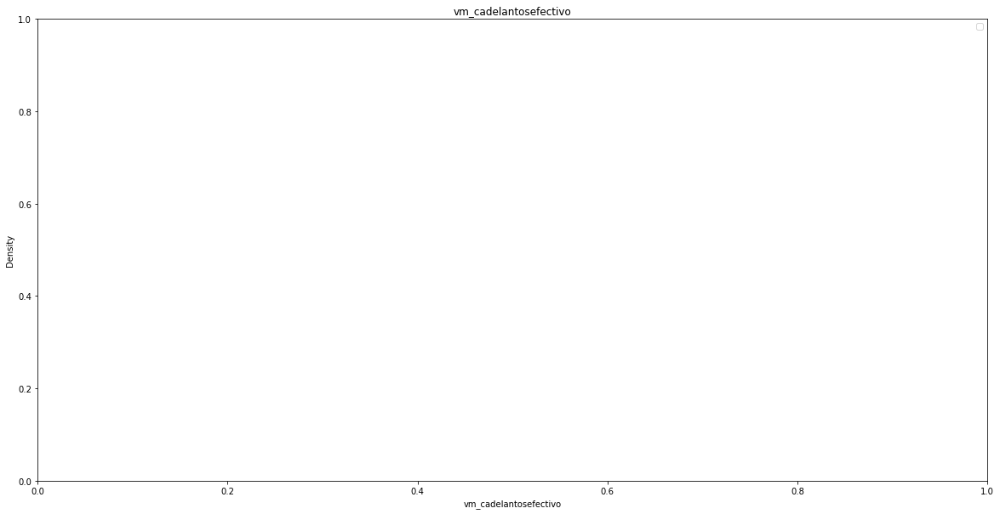

count   261081.000
mean         0.046
std          0.641
min          0.000
25%          0.000
50%          0.000
75%          0.000
max         28.000
Name: vm_cadelantosefectivo, dtype: float64
count   3686828.000
mean          0.025
std           0.441
min           0.000
25%           0.000
50%           0.000
75%           0.000
max          48.000
Name: vm_cadelantosefectivo, dtype: float64


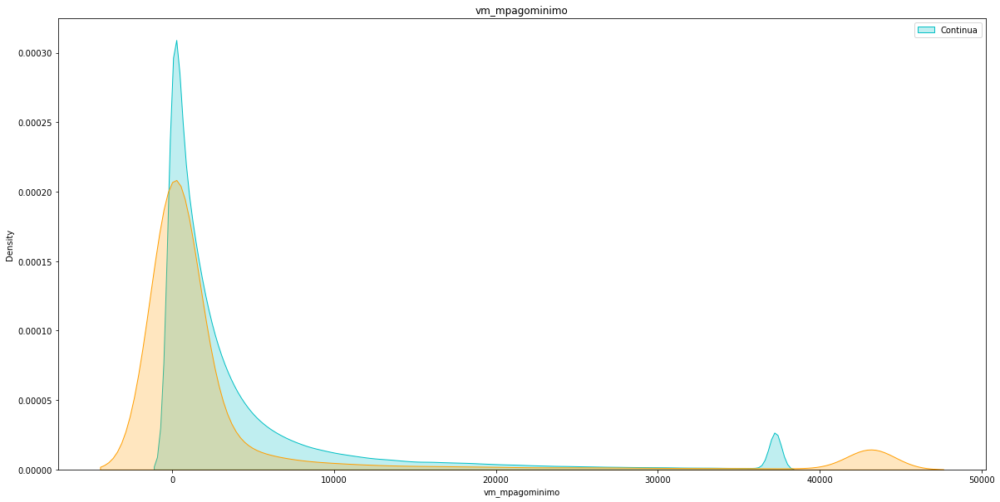

count    261081.000
mean       5674.874
std       42135.280
min           0.000
25%           0.000
50%         175.950
75%        1724.310
max     6471100.830
Name: vm_mpagominimo, dtype: float64
count   3686828.000
mean       5795.630
std       21874.290
min           0.000
25%         387.090
50%        1653.930
75%        4645.080
max     5537298.990
Name: vm_mpagominimo, dtype: float64


In [14]:
#   dataset[ , vm_mfinanciacion_limite := rowSums( cbind( Master_mfinanciacion_limite,  Visa_mfinanciacion_limite) , na.rm=TRUE ) ]

#   dataset[ , vm_Fvencimiento         := pmin( Master_Fvencimiento, Visa_Fvencimiento, na.rm = TRUE) ]
#   dataset[ , vm_Finiciomora          := pmin( Master_Finiciomora, Visa_Finiciomora, na.rm = TRUE) ]
#   dataset[ , vm_msaldototal          := rowSums( cbind( Master_msaldototal,  Visa_msaldototal) , na.rm=TRUE ) ]
#   dataset[ , vm_msaldopesos          := rowSums( cbind( Master_msaldopesos,  Visa_msaldopesos) , na.rm=TRUE ) ]
#   dataset[ , vm_msaldodolares        := rowSums( cbind( Master_msaldodolares,  Visa_msaldodolares) , na.rm=TRUE ) ]
#   dataset[ , vm_mconsumospesos       := rowSums( cbind( Master_mconsumospesos,  Visa_mconsumospesos) , na.rm=TRUE ) ]
#   dataset[ , vm_mconsumosdolares     := rowSums( cbind( Master_mconsumosdolares,  Visa_mconsumosdolares) , na.rm=TRUE ) ]
#   dataset[ , vm_mlimitecompra        := rowSums( cbind( Master_mlimitecompra,  Visa_mlimitecompra) , na.rm=TRUE ) ]
#   dataset[ , vm_madelantopesos       := rowSums( cbind( Master_madelantopesos,  Visa_madelantopesos) , na.rm=TRUE ) ]
#   dataset[ , vm_madelantodolares     := rowSums( cbind( Master_madelantodolares,  Visa_madelantodolares) , na.rm=TRUE ) ]
#   dataset[ , vm_fultimo_cierre       := pmax( Master_fultimo_cierre, Visa_fultimo_cierre, na.rm = TRUE) ]
#   dataset[ , vm_mpagado              := rowSums( cbind( Master_mpagado,  Visa_mpagado) , na.rm=TRUE ) ]
#   dataset[ , vm_mpagospesos          := rowSums( cbind( Master_mpagospesos,  Visa_mpagospesos) , na.rm=TRUE ) ]
#   dataset[ , vm_mpagosdolares        := rowSums( cbind( Master_mpagosdolares,  Visa_mpagosdolares) , na.rm=TRUE ) ]
#   dataset[ , vm_fechaalta            := pmax( Master_fechaalta, Visa_fechaalta, na.rm = TRUE) ]
#   dataset[ , vm_mconsumototal        := rowSums( cbind( Master_mconsumototal,  Visa_mconsumototal) , na.rm=TRUE ) ]
#   dataset[ , vm_cconsumos            := rowSums( cbind( Master_cconsumos,  Visa_cconsumos) , na.rm=TRUE ) ]
#   dataset[ , vm_cadelantosefectivo   := rowSums( cbind( Master_cadelantosefectivo,  Visa_cadelantosefectivo) , na.rm=TRUE ) ]
#   dataset[ , vm_mpagominimo          := rowSums( cbind( Master_mpagominimo,  Visa_mpagominimo) , na.rm=TRUE ) ]

df['vm_mfinanciacion_limite'] = df[['Master_mfinanciacion_limite', 'Visa_mfinanciacion_limite']].sum(axis=1)
df['vm_Fvencimiento'] = df[['Master_Fvencimiento', 'Visa_Fvencimiento']].min(axis=1)
df['vm_Finiciomora'] = df[['Master_Finiciomora', 'Visa_Finiciomora']].min(axis=1)
df['vm_msaldototal'] = df[['Master_msaldototal', 'Visa_msaldototal']].sum(axis=1)
df['vm_msaldopesos'] = df[['Master_msaldopesos', 'Visa_msaldopesos']].sum(axis=1)
df['vm_msaldodolares'] = df[['Master_msaldodolares', 'Visa_msaldodolares']].sum(axis=1)
df['vm_mconsumospesos'] = df[['Master_mconsumospesos', 'Visa_mconsumospesos']].sum(axis=1)
df['vm_mconsumosdolares'] = df[['Master_mconsumosdolares', 'Visa_mconsumosdolares']].sum(axis=1)
df['vm_mlimitecompra'] = df[['Master_mlimitecompra', 'Visa_mlimitecompra']].sum(axis=1)
df['vm_madelantopesos'] = df[['Master_madelantopesos', 'Visa_madelantopesos']].sum(axis=1)
df['vm_madelantodolares'] = df[['Master_madelantodolares', 'Visa_madelantodolares']].sum(axis=1)
df['vm_fultimo_cierre'] = df[['Master_fultimo_cierre', 'Visa_fultimo_cierre']].max(axis=1)
df['vm_mpagado'] = df[['Master_mpagado', 'Visa_mpagado']].sum(axis=1)
df['vm_mpagospesos'] = df[['Master_mpagospesos', 'Visa_mpagospesos']].sum(axis=1)
df['vm_mpagosdolares'] = df[['Master_mpagosdolares', 'Visa_mpagosdolares']].sum(axis=1)
df['vm_fechaalta'] = df[['Master_fechaalta', 'Visa_fechaalta']].max(axis=1)
df['vm_mconsumototal'] = df[['Master_mconsumototal', 'Visa_mconsumototal']].sum(axis=1)
df['vm_cconsumos'] = df[['Master_cconsumos', 'Visa_cconsumos']].sum(axis=1)
df['vm_cadelantosefectivo'] = df[['Master_cadelantosefectivo', 'Visa_cadelantosefectivo']].sum(axis=1)
df['vm_mpagominimo'] = df[['Master_mpagominimo', 'Visa_mpagominimo']].sum(axis=1)

# combino MasterCard y Visa para df_bajas
df_bajas['vm_mfinanciacion_limite'] = df_bajas[['Master_mfinanciacion_limite', 'Visa_mfinanciacion_limite']].sum(axis=1)
df_bajas['vm_Fvencimiento'] = df_bajas[['Master_Fvencimiento', 'Visa_Fvencimiento']].min(axis=1)
df_bajas['vm_Finiciomora'] = df_bajas[['Master_Finiciomora', 'Visa_Finiciomora']].min(axis=1)
df_bajas['vm_msaldototal'] = df_bajas[['Master_msaldototal', 'Visa_msaldototal']].sum(axis=1)
df_bajas['vm_msaldopesos'] = df_bajas[['Master_msaldopesos', 'Visa_msaldopesos']].sum(axis=1)
df_bajas['vm_msaldodolares'] = df_bajas[['Master_msaldodolares', 'Visa_msaldodolares']].sum(axis=1)
df_bajas['vm_mconsumospesos'] = df_bajas[['Master_mconsumospesos', 'Visa_mconsumospesos']].sum(axis=1)
df_bajas['vm_mconsumosdolares'] = df_bajas[['Master_mconsumosdolares', 'Visa_mconsumosdolares']].sum(axis=1)
df_bajas['vm_mlimitecompra'] = df_bajas[['Master_mlimitecompra', 'Visa_mlimitecompra']].sum(axis=1)
df_bajas['vm_madelantopesos'] = df_bajas[['Master_madelantopesos', 'Visa_madelantopesos']].sum(axis=1)
df_bajas['vm_madelantodolares'] = df_bajas[['Master_madelantodolares', 'Visa_madelantodolares']].sum(axis=1)
df_bajas['vm_fultimo_cierre'] = df_bajas[['Master_fultimo_cierre', 'Visa_fultimo_cierre']].max(axis=1)
df_bajas['vm_mpagado'] = df_bajas[['Master_mpagado', 'Visa_mpagado']].sum(axis=1)
df_bajas['vm_mpagospesos'] = df_bajas[['Master_mpagospesos', 'Visa_mpagospesos']].sum(axis=1)
df_bajas['vm_mpagosdolares'] = df_bajas[['Master_mpagosdolares', 'Visa_mpagosdolares']].sum(axis=1)
df_bajas['vm_fechaalta'] = df_bajas[['Master_fechaalta', 'Visa_fechaalta']].max(axis=1)
df_bajas['vm_mconsumototal'] = df_bajas[['Master_mconsumototal', 'Visa_mconsumototal']].sum(axis=1)
df_bajas['vm_cconsumos'] = df_bajas[['Master_cconsumos', 'Visa_cconsumos']].sum(axis=1)
df_bajas['vm_cadelantosefectivo'] = df_bajas[['Master_cadelantosefectivo', 'Visa_cadelantosefectivo']].sum(axis=1)
df_bajas['vm_mpagominimo'] = df_bajas[['Master_mpagominimo', 'Visa_mpagominimo']].sum(axis=1)

# combino MasterCard y Visa para df_continua
df_continua['vm_mfinanciacion_limite'] = df_continua[['Master_mfinanciacion_limite', 'Visa_mfinanciacion_limite']].sum(axis=1)
df_continua['vm_Fvencimiento'] = df_continua[['Master_Fvencimiento', 'Visa_Fvencimiento']].min(axis=1)
df_continua['vm_Finiciomora'] = df_continua[['Master_Finiciomora', 'Visa_Finiciomora']].min(axis=1)
df_continua['vm_msaldototal'] = df_continua[['Master_msaldototal', 'Visa_msaldototal']].sum(axis=1)
df_continua['vm_msaldopesos'] = df_continua[['Master_msaldopesos', 'Visa_msaldopesos']].sum(axis=1)
df_continua['vm_msaldodolares'] = df_continua[['Master_msaldodolares', 'Visa_msaldodolares']].sum(axis=1)
df_continua['vm_mconsumospesos'] = df_continua[['Master_mconsumospesos', 'Visa_mconsumospesos']].sum(axis=1)
df_continua['vm_mconsumosdolares'] = df_continua[['Master_mconsumosdolares', 'Visa_mconsumosdolares']].sum(axis=1)
df_continua['vm_mlimitecompra'] = df_continua[['Master_mlimitecompra', 'Visa_mlimitecompra']].sum(axis=1)
df_continua['vm_madelantopesos'] = df_continua[['Master_madelantopesos', 'Visa_madelantopesos']].sum(axis=1)
df_continua['vm_madelantodolares'] = df_continua[['Master_madelantodolares', 'Visa_madelantodolares']].sum(axis=1)
df_continua['vm_fultimo_cierre'] = df_continua[['Master_fultimo_cierre', 'Visa_fultimo_cierre']].max(axis=1)
df_continua['vm_mpagado'] = df_continua[['Master_mpagado', 'Visa_mpagado']].sum(axis=1)
df_continua['vm_mpagospesos'] = df_continua[['Master_mpagospesos', 'Visa_mpagospesos']].sum(axis=1)
df_continua['vm_mpagosdolares'] = df_continua[['Master_mpagosdolares', 'Visa_mpagosdolares']].sum(axis=1)
df_continua['vm_fechaalta'] = df_continua[['Master_fechaalta', 'Visa_fechaalta']].max(axis=1)
df_continua['vm_mconsumototal'] = df_continua[['Master_mconsumototal', 'Visa_mconsumototal']].sum(axis=1)
df_continua['vm_cconsumos'] = df_continua[['Master_cconsumos', 'Visa_cconsumos']].sum(axis=1)
df_continua['vm_cadelantosefectivo'] = df_continua[['Master_cadelantosefectivo', 'Visa_cadelantosefectivo']].sum(axis=1)
df_continua['vm_mpagominimo'] = df_continua[['Master_mpagominimo', 'Visa_mpagominimo']].sum(axis=1)
import warnings
warnings.filterwarnings('ignore')
#Avoid scientific notation
pd.set_option('display.float_format', lambda x: '%.3f' % x)
for i in ['vm_mfinanciacion_limite', 'vm_Fvencimiento', 'vm_Finiciomora', 'vm_msaldototal', 'vm_msaldopesos', 'vm_msaldodolares', 'vm_mconsumospesos', 'vm_mconsumosdolares', 'vm_mlimitecompra', 'vm_madelantopesos', 'vm_madelantodolares', 'vm_fultimo_cierre', 'vm_mpagado', 'vm_mpagospesos', 'vm_mpagosdolares', 'vm_fechaalta', 'vm_mconsumototal', 'vm_cconsumos', 'vm_cadelantosefectivo', 'vm_mpagominimo']:
        plt.figure(figsize=(20, 10))
        sns.kdeplot(x=df_continua.loc[df_continua['baja_2'] == 0, i].clip(upper=df_continua[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#00BFC4', label='Continua', fill =True)
        plt.xlabel(i)
        plt.ylabel('Density')
        plt.title(i)
        plt.legend()
        sns.kdeplot(x=df_bajas.loc[df_bajas['baja_2'] == 1, i].clip(upper=df_bajas[i].quantile(0.975), lower= df_continua[i].quantile(0.025)), color='#FF9E00', label='Baja', fill =True)
        plt.show()      
        #print describes
        print(df_bajas[i].describe())
        print(df_continua[i].describe())
